# The Performance of LSTM and BiLSTM in Forecasting Time Series

### Importing Libraries

In [1]:
!pip install --quiet yfinance
!pip install --quiet mplfinance

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import glob
import tqdm
from datetime import datetime
import yfinance as yf
import mplfinance as mpf
import random

from keras import utils
import tensorflow as tf
from sklearn import model_selection
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import confusion_matrix
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.preprocessing import MinMaxScaler

from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import GRU, Dense, LSTM, Bidirectional, Flatten, Conv1D, MaxPooling1D, ConvLSTM2D

import torch

### Setting up the GPU

In [3]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(device)

cpu


## Importing Dataset

In [4]:
table = pd.read_html('https://en.wikipedia.org/wiki/List_of_S%26P_500_companies')
table[0]

,Symbol,Security,GICS Sector,GICS Sub-Industry,Headquarters Location,Date added,CIK,Founded
0,MMM,3M,Industrials,Industrial Conglomerates,"Saint Paul, Minnesota",1957-03-04,66740,1902
1,AOS,A. O. Smith,Industrials,Building Products,"Milwaukee, Wisconsin",2017-07-26,91142,1916
2,ABT,Abbott,Health Care,Health Care Equipment,"North Chicago, Illinois",1957-03-04,1800,1888
3,ABBV,AbbVie,Health Care,Biotechnology,"North Chicago, Illinois",2012-12-31,1551152,2013 (1888)
4,ACN,Accenture,Information Technology,IT Consulting & Other Services,"Dublin, Ireland",2011-07-06,1467373,1989
...,...,...,...,...,...,...,...,...
498,YUM,Yum! Brands,Consumer Discretionary,Restaurants,"Louisville, Kentucky",1997-10-06,1041061,1997
499,ZBRA,Zebra Technologies,Information Technology,Electronic Equipment & Instruments,"Lincolnshire, Illinois",2019-12-23,877212,1969
500,ZBH,Zimmer Biomet,Health Care,Health Care Equipment,"Warsaw, Indiana",2001-08-07,1136869,1927
501,ZION,Zions Bancorporation,Financials,Regional Banks,"Salt Lake City, Utah",2001-06-22,109380,1873


In [5]:
New_table = table[0]
New_table

,Symbol,Security,GICS Sector,GICS Sub-Industry,Headquarters Location,Date added,CIK,Founded
0,MMM,3M,Industrials,Industrial Conglomerates,"Saint Paul, Minnesota",1957-03-04,66740,1902
1,AOS,A. O. Smith,Industrials,Building Products,"Milwaukee, Wisconsin",2017-07-26,91142,1916
2,ABT,Abbott,Health Care,Health Care Equipment,"North Chicago, Illinois",1957-03-04,1800,1888
3,ABBV,AbbVie,Health Care,Biotechnology,"North Chicago, Illinois",2012-12-31,1551152,2013 (1888)
4,ACN,Accenture,Information Technology,IT Consulting & Other Services,"Dublin, Ireland",2011-07-06,1467373,1989
...,...,...,...,...,...,...,...,...
498,YUM,Yum! Brands,Consumer Discretionary,Restaurants,"Louisville, Kentucky",1997-10-06,1041061,1997
499,ZBRA,Zebra Technologies,Information Technology,Electronic Equipment & Instruments,"Lincolnshire, Illinois",2019-12-23,877212,1969
500,ZBH,Zimmer Biomet,Health Care,Health Care Equipment,"Warsaw, Indiana",2001-08-07,1136869,1927
501,ZION,Zions Bancorporation,Financials,Regional Banks,"Salt Lake City, Utah",2001-06-22,109380,1873


### Stocks that Have Data Available from 2010

In [6]:
New_table_2 = New_table[ [ datetime.strptime(dt, '%Y-%m-%d') < datetime(2010, 1, 1) for dt in New_table['Date added'] ] ]
New_table_2

,Symbol,Security,GICS Sector,GICS Sub-Industry,Headquarters Location,Date added,CIK,Founded
0,MMM,3M,Industrials,Industrial Conglomerates,"Saint Paul, Minnesota",1957-03-04,66740,1902
2,ABT,Abbott,Health Care,Health Care Equipment,"North Chicago, Illinois",1957-03-04,1800,1888
5,ADBE,Adobe Inc.,Information Technology,Application Software,"San Jose, California",1997-05-05,796343,1982
7,AES,AES Corporation,Utilities,Independent Power Producers & Energy Traders,"Arlington, Virginia",1998-10-02,874761,1981
8,AFL,Aflac,Financials,Life & Health Insurance,"Columbus, Georgia",1999-05-28,4977,1955
...,...,...,...,...,...,...,...,...
495,WYNN,Wynn Resorts,Consumer Discretionary,Casinos & Gaming,"Paradise, Nevada",2008-11-14,1174922,2002
496,XEL,Xcel Energy,Utilities,Multi-Utilities,"Minneapolis, Minnesota",1957-03-04,72903,1909
498,YUM,Yum! Brands,Consumer Discretionary,Restaurants,"Louisville, Kentucky",1997-10-06,1041061,1997
500,ZBH,Zimmer Biomet,Health Care,Health Care Equipment,"Warsaw, Indiana",2001-08-07,1136869,1927


In [7]:
My_Tickers = New_table_2['Symbol'].tolist()

### Downloading dataset with Yahoo Financial library

In [8]:
Raw_Price_For_My_Tickers = yf.download(tickers=My_Tickers, start="2010-01-04", interval="1d", group_by='ticker')
Raw_Price_For_My_Tickers

[*********************100%%**********************]  290 of 290 completed


MCHP                                                        \
                 Open       High        Low      Close  Adj Close    Volume   
Date                                                                          
2010-01-04  14.730000  14.740000  14.550000  14.590000  10.115971   3037400   
2010-01-05  14.610000  14.655000  14.315000  14.360000   9.956503  15591000   
2010-01-06  14.350000  14.460000  14.215000  14.240000   9.873301   5567600   
2010-01-07  14.345000  14.345000  14.060000  14.165000   9.821298   3577000   
2010-01-08  14.150000  14.305000  14.040000  14.250000   9.880230   4100200   
...               ...        ...        ...        ...        ...       ...   
2023-12-18  92.599998  92.629997  90.800003  91.309998  91.309998   4291800   
2023-12-19  91.639999  92.059998  91.089996  91.389999  91.389999   3941500   
2023-12-20  90.529999  91.160004  88.470001  88.550003  88.550003   5762500   
2023-12-21  89.949997  90.360001  88.889999  89.879997  89.879997   5001900   
2023-12-22  90.580002  91.410004  89.660004  90.190002  90.190002   2388000   

                   AXP                                      ...   PARA         \
                  Open        High         Low       Close  ...    Low  Close   
Date                                                        ...                 
2010-01-04   40.810001   41.099998   40.389999   40.919998  ...  13.98  14.25   
2010-01-05   40.830002   41.230000   40.369999   40.830002  ...  14.05  14.18   
2010-01-06   41.230000   41.669998   41.169998   41.490002  ...  13.67  13.73   
2010-01-07   41.259998   42.240002   41.110001   41.980000  ...  13.59  14.00   
2010-01-08   41.759998   42.480000   41.400002   41.950001  ...  13.88  14.15   
...                ...         ...         ...         ...  ...    ...    ...   
2023-12-18  181.380005  182.839996  181.029999  182.759995  ...  15.45  15.51   
2023-12-19  183.210007  185.770004  183.190002  185.750000  ...  15.40  15.82   
2023-12-20  185.350006  185.649994  180.539993  180.649994  ...  15.17  15.50   
2023-12-21  181.830002  185.210007  181.830002  184.789993  ...  14.79  15.07   
2023-12-22  185.639999  186.369995  184.630005  185.570007  ...  14.95  15.00   

                                        VLO                          \
            Adj Close    Volume        Open        High         Low   
Date                                                                  
2010-01-04  11.162679   6710900   15.767824   16.398537   15.639854   
2010-01-05  11.107844   5441000   16.563070   16.974405   16.425961   
2010-01-06  10.755334  14566200   16.809872   17.385740   16.599634   
2010-01-07  10.966834   9000300   17.166363   17.413162   16.800732   
2010-01-08  11.084344   6732900   17.303473   17.349176   16.937843   
...               ...       ...         ...         ...         ...   
2023-12-18  15.510000  14119800  130.520004  132.800003  130.100006   
2023-12-19  15.820000  14748900  131.929993  134.130005  130.740005   
2023-12-20  15.500000  36752800  134.229996  136.729996  132.050003   
2023-12-21  15.070000  30003100  132.649994  133.300003  130.270004   
2023-12-22  15.000000  17811200  133.100006  134.250000  132.089996   

                                              
                 Close   Adj Close    Volume  
Date                                          
2010-01-04   16.352835   10.356779  15454500  
2010-01-05   16.773310   10.623078  17087295  
2010-01-06   17.193785   10.889379  16896939  
2010-01-07   17.321754   10.970428  12077869  
2010-01-08   17.084095   10.819908  13914258  
...                ...         ...       ...  
2023-12-18  131.919998  131.919998   3621100  
2023-12-19  133.600006  133.600006   3741200  
2023-12-20  132.539993  132.539993   4492200  
2023-12-21  131.919998  131.919998   2977100  
2023-12-22  132.199997  132.199997   2279000  

[3518 rows x 1740 columns]

In [9]:
Raw_Price_For_My_Tickers.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3518 entries, 2010-01-04 00:00:00 to 2023-12-22 00:00:00
Columns: 1740 entries, ('MCHP', 'Open') to ('VLO', 'Volume')
dtypes: float64(1453), int64(287)
memory usage: 46.7+ MB


### Checking missing values

In [10]:
Raw_Price_For_My_Tickers.isnull()

MCHP                                          AXP                \
             Open   High    Low  Close Adj Close Volume   Open   High    Low   
Date                                                                           
2010-01-04  False  False  False  False     False  False  False  False  False   
2010-01-05  False  False  False  False     False  False  False  False  False   
2010-01-06  False  False  False  False     False  False  False  False  False   
2010-01-07  False  False  False  False     False  False  False  False  False   
2010-01-08  False  False  False  False     False  False  False  False  False   
...           ...    ...    ...    ...       ...    ...    ...    ...    ...   
2023-12-18  False  False  False  False     False  False  False  False  False   
2023-12-19  False  False  False  False     False  False  False  False  False   
2023-12-20  False  False  False  False     False  False  False  False  False   
2023-12-21  False  False  False  False     False  False  False  False  False   
2023-12-22  False  False  False  False     False  False  False  False  False   

                   ...   PARA                            VLO                \
            Close  ...    Low  Close Adj Close Volume   Open   High    Low   
Date               ...                                                       
2010-01-04  False  ...  False  False     False  False  False  False  False   
2010-01-05  False  ...  False  False     False  False  False  False  False   
2010-01-06  False  ...  False  False     False  False  False  False  False   
2010-01-07  False  ...  False  False     False  False  False  False  False   
2010-01-08  False  ...  False  False     False  False  False  False  False   
...           ...  ...    ...    ...       ...    ...    ...    ...    ...   
2023-12-18  False  ...  False  False     False  False  False  False  False   
2023-12-19  False  ...  False  False     False  False  False  False  False   
2023-12-20  False  ...  False  False     False  False  False  False  False   
2023-12-21  False  ...  False  False     False  False  False  False  False   
2023-12-22  False  ...  False  False     False  False  False  False  False   

                                    
            Close Adj Close Volume  
Date                                
2010-01-04  False     False  False  
2010-01-05  False     False  False  
2010-01-06  False     False  False  
2010-01-07  False     False  False  
2010-01-08  False     False  False  
...           ...       ...    ...  
2023-12-18  False     False  False  
2023-12-19  False     False  False  
2023-12-20  False     False  False  
2023-12-21  False     False  False  
2023-12-22  False     False  False  

[3518 rows x 1740 columns]

In [11]:
# Total number of missing values
Raw_Price_For_My_Tickers.isnull().sum().sum()

39690

In [12]:
missing_values_cols = [col for col in Raw_Price_For_My_Tickers.columns if Raw_Price_For_My_Tickers[col].isnull().sum() > 0]
missing_vals = Raw_Price_For_My_Tickers[missing_values_cols]
missing_vals

BF.B                                        HWM             \
           Open High Low Close Adj Close Volume       Open       High   
Date                                                                    
2010-01-04  NaN  NaN NaN   NaN       NaN    NaN        NaN        NaN   
2010-01-05  NaN  NaN NaN   NaN       NaN    NaN        NaN        NaN   
2010-01-06  NaN  NaN NaN   NaN       NaN    NaN        NaN        NaN   
2010-01-07  NaN  NaN NaN   NaN       NaN    NaN        NaN        NaN   
2010-01-08  NaN  NaN NaN   NaN       NaN    NaN        NaN        NaN   
...         ...  ...  ..   ...       ...    ...        ...        ...   
2023-12-18  NaN  NaN NaN   NaN       NaN    NaN  52.990002  53.480000   
2023-12-19  NaN  NaN NaN   NaN       NaN    NaN  53.360001  53.880001   
2023-12-20  NaN  NaN NaN   NaN       NaN    NaN  53.330002  53.730000   
2023-12-21  NaN  NaN NaN   NaN       NaN    NaN  53.310001  53.680000   
2023-12-22  NaN  NaN NaN   NaN       NaN    NaN  53.570000  53.910000   

                                                              WRK             \
                  Low      Close  Adj Close     Volume       Open       High   
Date                                                                           
2010-01-04        NaN        NaN        NaN        NaN        NaN        NaN   
2010-01-05        NaN        NaN        NaN        NaN        NaN        NaN   
2010-01-06        NaN        NaN        NaN        NaN        NaN        NaN   
2010-01-07        NaN        NaN        NaN        NaN        NaN        NaN   
2010-01-08        NaN        NaN        NaN        NaN        NaN        NaN   
...               ...        ...        ...        ...        ...        ...   
2023-12-18  52.900002  53.189999  53.189999  1922000.0  43.110001  43.209999   
2023-12-19  53.230000  53.650002  53.650002  2697000.0  43.240002  43.580002   
2023-12-20  52.680000  52.720001  52.720001  2075200.0  43.119999  43.500000   
2023-12-21  53.119999  53.470001  53.470001  1694800.0  43.119999  43.480000   
2023-12-22  53.430000  53.570000  53.570000  1352700.0  41.889999  42.169998   

                                                        
                  Low      Close  Adj Close     Volume  
Date                                                    
2010-01-04        NaN        NaN        NaN        NaN  
2010-01-05        NaN        NaN        NaN        NaN  
2010-01-06        NaN        NaN        NaN        NaN  
2010-01-07        NaN        NaN        NaN        NaN  
2010-01-08        NaN        NaN        NaN        NaN  
...               ...        ...        ...        ...  
2023-12-18  42.685001  42.810001  42.810001  2581100.0  
2023-12-19  42.965000  43.279999  43.279999  2903000.0  
2023-12-20  42.869999  42.919998  42.919998  2964100.0  
2023-12-21  41.740002  41.910000  41.910000  4772600.0  
2023-12-22  41.590000  41.750000  41.750000  2278300.0  

[3518 rows x 18 columns]

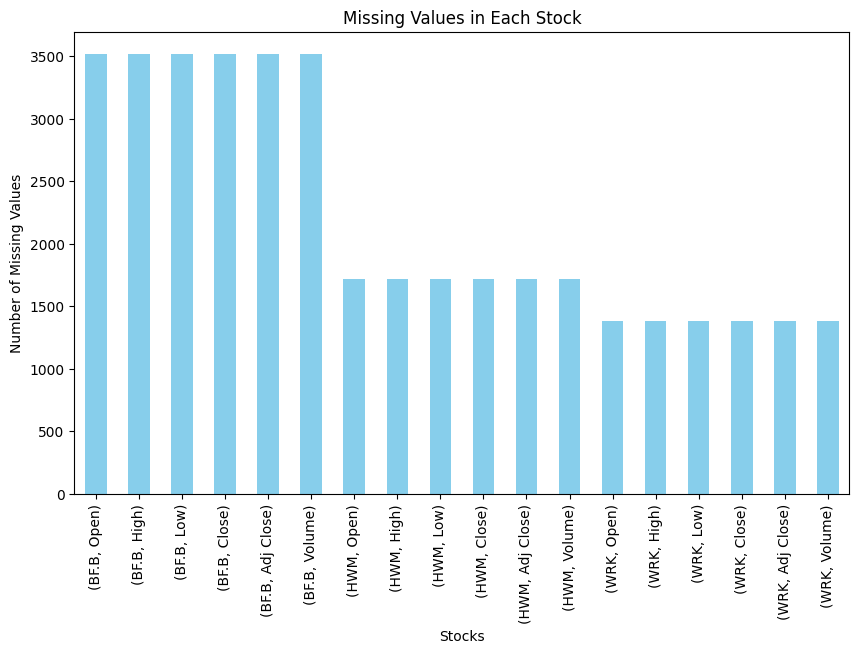

In [13]:
rows_with_missing_values = missing_vals.isnull().sum(axis=0)
rows_with_missing_values.plot(kind='bar', figsize=(10, 6), color='skyblue')
plt.title('Missing Values in Each Stock')
plt.xlabel('Stocks')
plt.ylabel('Number of Missing Values')
plt.show()

In [14]:
missing_vals.isnull().sum(axis=0)

BF.B  Open         3518
      High         3518
      Low          3518
      Close        3518
      Adj Close    3518
      Volume       3518
HWM   Open         1720
      High         1720
      Low          1720
      Close        1720
      Adj Close    1720
      Volume       1720
WRK   Open         1377
      High         1377
      Low          1377
      Close        1377
      Adj Close    1377
      Volume       1377
dtype: int64

In [15]:
missing_vals.isnull().sum(axis=1)

Date
2010-01-04    18
2010-01-05    18
2010-01-06    18
2010-01-07    18
2010-01-08    18
              ..
2023-12-18     6
2023-12-19     6
2023-12-20     6
2023-12-21     6
2023-12-22     6
Length: 3518, dtype: int64

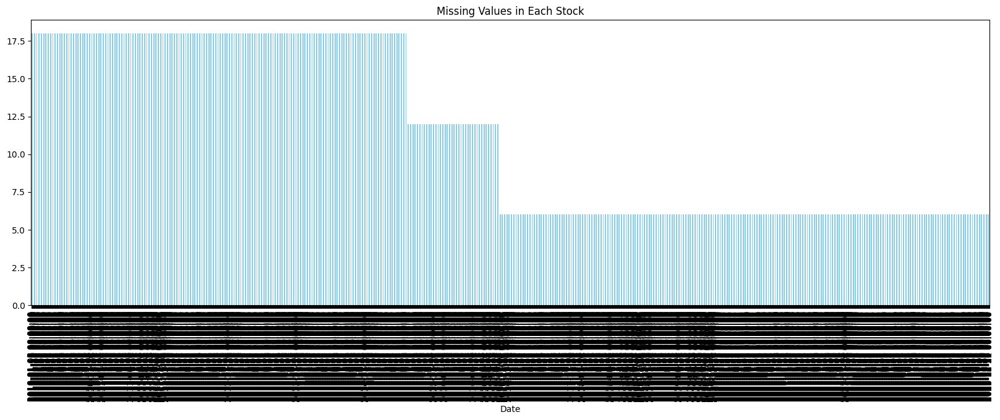

In [16]:
rows_with_missing_values = missing_vals.isnull().sum(axis=1)
rows_with_missing_values.plot(kind='bar', figsize=(20, 6), color='skyblue')
plt.title('Missing Values in Each Stock')
plt.xlabel('Date')
plt.show()

In [17]:
# Fill missing values with backward fill and forward fill
Raw_Price_For_My_Tickers = Raw_Price_For_My_Tickers.fillna(method='ffill')
Raw_Price_For_My_Tickers

MCHP                                                        \
                 Open       High        Low      Close  Adj Close    Volume   
Date                                                                          
2010-01-04  14.730000  14.740000  14.550000  14.590000  10.115971   3037400   
2010-01-05  14.610000  14.655000  14.315000  14.360000   9.956503  15591000   
2010-01-06  14.350000  14.460000  14.215000  14.240000   9.873301   5567600   
2010-01-07  14.345000  14.345000  14.060000  14.165000   9.821298   3577000   
2010-01-08  14.150000  14.305000  14.040000  14.250000   9.880230   4100200   
...               ...        ...        ...        ...        ...       ...   
2023-12-18  92.599998  92.629997  90.800003  91.309998  91.309998   4291800   
2023-12-19  91.639999  92.059998  91.089996  91.389999  91.389999   3941500   
2023-12-20  90.529999  91.160004  88.470001  88.550003  88.550003   5762500   
2023-12-21  89.949997  90.360001  88.889999  89.879997  89.879997   5001900   
2023-12-22  90.580002  91.410004  89.660004  90.190002  90.190002   2388000   

                   AXP                                      ...   PARA         \
                  Open        High         Low       Close  ...    Low  Close   
Date                                                        ...                 
2010-01-04   40.810001   41.099998   40.389999   40.919998  ...  13.98  14.25   
2010-01-05   40.830002   41.230000   40.369999   40.830002  ...  14.05  14.18   
2010-01-06   41.230000   41.669998   41.169998   41.490002  ...  13.67  13.73   
2010-01-07   41.259998   42.240002   41.110001   41.980000  ...  13.59  14.00   
2010-01-08   41.759998   42.480000   41.400002   41.950001  ...  13.88  14.15   
...                ...         ...         ...         ...  ...    ...    ...   
2023-12-18  181.380005  182.839996  181.029999  182.759995  ...  15.45  15.51   
2023-12-19  183.210007  185.770004  183.190002  185.750000  ...  15.40  15.82   
2023-12-20  185.350006  185.649994  180.539993  180.649994  ...  15.17  15.50   
2023-12-21  181.830002  185.210007  181.830002  184.789993  ...  14.79  15.07   
2023-12-22  185.639999  186.369995  184.630005  185.570007  ...  14.95  15.00   

                                        VLO                          \
            Adj Close    Volume        Open        High         Low   
Date                                                                  
2010-01-04  11.162679   6710900   15.767824   16.398537   15.639854   
2010-01-05  11.107844   5441000   16.563070   16.974405   16.425961   
2010-01-06  10.755334  14566200   16.809872   17.385740   16.599634   
2010-01-07  10.966834   9000300   17.166363   17.413162   16.800732   
2010-01-08  11.084344   6732900   17.303473   17.349176   16.937843   
...               ...       ...         ...         ...         ...   
2023-12-18  15.510000  14119800  130.520004  132.800003  130.100006   
2023-12-19  15.820000  14748900  131.929993  134.130005  130.740005   
2023-12-20  15.500000  36752800  134.229996  136.729996  132.050003   
2023-12-21  15.070000  30003100  132.649994  133.300003  130.270004   
2023-12-22  15.000000  17811200  133.100006  134.250000  132.089996   

                                              
                 Close   Adj Close    Volume  
Date                                          
2010-01-04   16.352835   10.356779  15454500  
2010-01-05   16.773310   10.623078  17087295  
2010-01-06   17.193785   10.889379  16896939  
2010-01-07   17.321754   10.970428  12077869  
2010-01-08   17.084095   10.819908  13914258  
...                ...         ...       ...  
2023-12-18  131.919998  131.919998   3621100  
2023-12-19  133.600006  133.600006   3741200  
2023-12-20  132.539993  132.539993   4492200  
2023-12-21  131.919998  131.919998   2977100  
2023-12-22  132.199997  132.199997   2279000  

[3518 rows x 1740 columns]

### Daily Return Of a Random Stocks on Average

In [19]:
rand_stock = Raw_Price_For_My_Tickers.columns[np.random.randint(Raw_Price_For_My_Tickers.shape[1])][0]
close_prices = Raw_Price_For_My_Tickers[(rand_stock, 'Adj Close')]

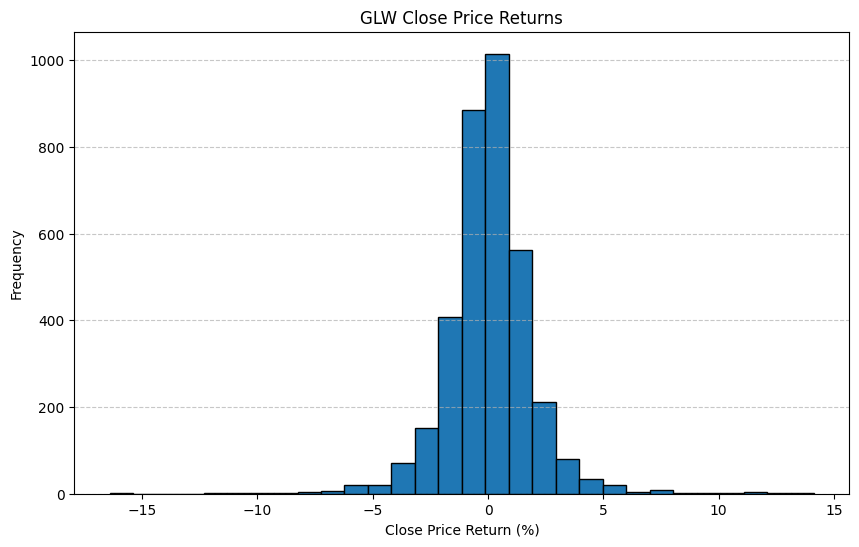

In [20]:
daily = (close_prices - close_prices.shift(1)) / close_prices.shift(1) * 100
daily = daily.dropna()

plt.figure(figsize=(10, 6))
plt.hist(daily, bins=30, edgecolor='black')
title = rand_stock + ' Close Price Returns'
plt.title(title)
plt.xlabel('Close Price Return (%)')
plt.ylabel('Frequency')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

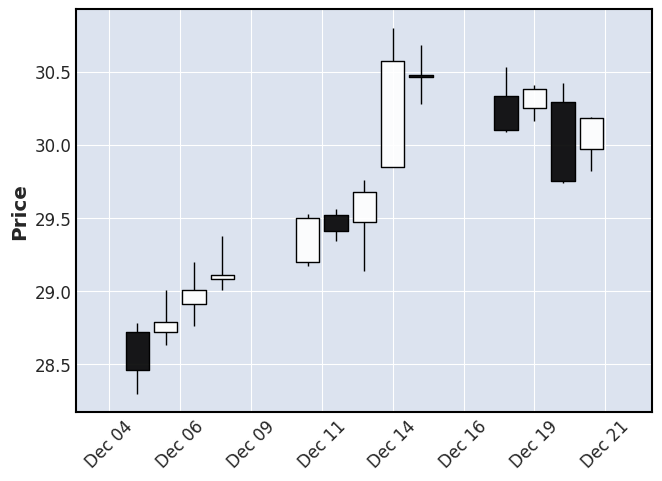

In [21]:
cols = [(rand_stock, 'Open'), (rand_stock, 'High'), (rand_stock, 'Low'), (rand_stock, 'Close'), (rand_stock, 'Adj Close'), (rand_stock, 'Volume')]
daily = Raw_Price_For_My_Tickers[cols]
daily = daily.iloc[-14:-1]
daily.index = pd.to_datetime(daily.index) 
daily.columns = ['Open','High', 'Low', 'Close', 'Adj Close', 'Volume']
mpf.plot(daily, type='candle', ylabel='Price', show_nontrading=True)

### Downloading dataset for five choosen stocks

In [22]:
selected_stocks =  ['AAPL','MSFT','AMZN', 'IBM', 'KO']
selected_stocks_data = New_table_2[New_table_2['Symbol'].isin(selected_stocks)]
My_selected_Tickers = selected_stocks_data['Symbol'].tolist()
My_Tickers_SP500 = yf.download(tickers=My_selected_Tickers, start="2010-01-04", end='2023-12-20', interval="1d", group_by='ticker', auto_adjust=True)
My_Tickers_SP500

[*********************100%%**********************]  5 of 5 completed


AMZN                                                 \
                  Open        High         Low       Close     Volume   
Date                                                                    
2010-01-04    6.812500    6.830500    6.657000    6.695000  151998000   
2010-01-05    6.671500    6.774000    6.590500    6.734500  177038000   
2010-01-06    6.730000    6.736500    6.582500    6.612500  143576000   
2010-01-07    6.600500    6.616000    6.440000    6.500000  220604000   
2010-01-08    6.528000    6.684000    6.451500    6.676000  196610000   
...                ...         ...         ...         ...        ...   
2023-12-13  148.119995  149.460007  146.820007  148.839996   52766200   
2023-12-14  149.929993  150.539993  145.520004  147.419998   58400800   
2023-12-15  148.380005  150.570007  147.880005  149.970001  110039100   
2023-12-18  150.559998  154.850006  150.050003  154.070007   62512800   
2023-12-19  154.399994  155.119995  152.690002  153.789993   43171300   

                  MSFT                                                ...  \
                  Open        High         Low       Close    Volume  ...   
Date                                                                  ...   
2010-01-04   23.224620   23.588690   23.201866   23.474918  38409100  ...   
2010-01-05   23.399065   23.588684   23.239783   23.482496  49749600  ...   
2010-01-06   23.421828   23.573524   23.148776   23.338396  58182400  ...   
2010-01-07   23.232201   23.285296   22.898472   23.095676  50559700  ...   
2010-01-08   22.966736   23.421822   22.936396   23.254957  51197400  ...   
...                ...         ...         ...         ...       ...  ...   
2023-12-13  376.019989  377.640015  370.769989  374.369995  30955500  ...   
2023-12-14  373.309998  373.760010  364.130005  365.929993  43277500  ...   
2023-12-15  366.850006  372.399994  366.279999  370.730011  78478200  ...   
2023-12-18  369.450012  373.000000  368.679993  372.649994  21802900  ...   
2023-12-19  371.489990  373.260010  369.839996  373.260010  20603700  ...   

                   KO                                                   AAPL  \
                 Open       High        Low      Close    Volume        Open   
Date                                                                           
2010-01-04  18.536930  18.556388  18.452613  18.498014  13870400    6.461438   
2010-01-05  18.436400  18.481802  18.206148  18.274250  23172400    6.496861   
2010-01-06  18.274250  18.303437  18.154260  18.267765  19264600    6.490197   
2010-01-07  18.267762  18.280733  18.079668  18.222359  13234600    6.410578   
2010-01-08  17.985628  18.044001  17.755375  17.885096  28712400    6.366680   
...               ...        ...        ...        ...       ...         ...   
2023-12-13  59.450001  60.020000  59.259998  59.930000  16196800  195.089996   
2023-12-14  59.970001  60.040001  58.770000  59.040001  22478300  198.020004   
2023-12-15  58.830002  59.169998  57.799999  58.599998  65172300  197.529999   
2023-12-18  58.799999  59.490002  58.619999  59.020000  16717700  196.089996   
2023-12-19  59.000000  59.200001  58.639999  58.830002  14612200  196.160004   

                                                           
                  High         Low       Close     Volume  
Date                                                       
2010-01-04    6.493832    6.429650    6.478997  493729600  
2010-01-05    6.526832    6.455990    6.490201  601904800  
2010-01-06    6.515930    6.380301    6.386962  552160000  
2010-01-07    6.418146    6.328837    6.375156  477131200  
2010-01-08    6.418146    6.329140    6.417541  447610800  
...                ...         ...         ...        ...  
2023-12-13  198.000000  194.850006  197.960007   70404200  
2023-12-14  199.619995  196.160004  198.110001   66831600  
2023-12-15  198.399994  197.000000  197.570007  128256700  
2023-12-18  196.630005  194.389999  195.889999   55751900  
2023-12-19  196

In [23]:
My_Tickers_SP500.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 3515 entries, 2010-01-04 to 2023-12-19
Data columns (total 25 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   (AMZN, Open)    3515 non-null   float64
 1   (AMZN, High)    3515 non-null   float64
 2   (AMZN, Low)     3515 non-null   float64
 3   (AMZN, Close)   3515 non-null   float64
 4   (AMZN, Volume)  3515 non-null   int64  
 5   (MSFT, Open)    3515 non-null   float64
 6   (MSFT, High)    3515 non-null   float64
 7   (MSFT, Low)     3515 non-null   float64
 8   (MSFT, Close)   3515 non-null   float64
 9   (MSFT, Volume)  3515 non-null   int64  
 10  (IBM, Open)     3515 non-null   float64
 11  (IBM, High)     3515 non-null   float64
 12  (IBM, Low)      3515 non-null   float64
 13  (IBM, Close)    3515 non-null   float64
 14  (IBM, Volume)   3515 non-null   int64  
 15  (KO, Open)      3515 non-null   float64
 16  (KO, High)      3515 non-null   float64
 17  (KO, Low)      

### Keep only the 'Close' column for each stock 

In [24]:
close_prices = [('AMZN', 'Close'), ('IBM', 'Close'), ('KO', 'Close'), ('AAPL', 'Close'), ('MSFT', 'Close')]
My_Tickers_SP500 = My_Tickers_SP500[close_prices]
My_Tickers_SP500.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 3515 entries, 2010-01-04 to 2023-12-19
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   (AMZN, Close)  3515 non-null   float64
 1   (IBM, Close)   3515 non-null   float64
 2   (KO, Close)    3515 non-null   float64
 3   (AAPL, Close)  3515 non-null   float64
 4   (MSFT, Close)  3515 non-null   float64
dtypes: float64(5)
memory usage: 164.8 KB


### TimeSeriesSplit

In [25]:
cv_n_splits = 3
test_size = int(len(My_Tickers_SP500) * 0.05)
tss = model_selection.TimeSeriesSplit(n_splits=cv_n_splits)
tss

TimeSeriesSplit(gap=0, max_train_size=None, n_splits=3, test_size=None)

### Data Preparation

In [26]:
scaler = MinMaxScaler()
data_full_scaled_sp500 = scaler.fit_transform(My_Tickers_SP500.values.reshape(-1, 1))

In [27]:
min_value = np.min(My_Tickers_SP500)
max_value = np.max(My_Tickers_SP500)
data_full_scaled_sp500 = (My_Tickers_SP500 - min_value) / (max_value - min_value)
data_full_scaled_sp500

,AMZN,IBM,KO,AAPL,MSFT
,Close,Close,Close,Close,Close
Date,,,,,
2010-01-04,0.003352,0.190943,0.034637,0.002779,0.047829
2010-01-05,0.003456,0.188462,0.034044,0.002809,0.047849
2010-01-06,0.003133,0.187144,0.034027,0.002535,0.047467
2010-01-07,0.002835,0.186447,0.033906,0.002504,0.046824
2010-01-08,0.003301,0.188462,0.033012,0.002616,0.047246
...,...,...,...,...,...
2023-12-13,0.380125,0.419301,0.144458,0.510324,0.977920
2023-12-14,0.376361,0.417419,0.142099,0.510721,0.955549


In [28]:
y_tickers_sp500 = []
x_tickers_sp500 = []
window_size = 30

for ticker_index, ticker_name in enumerate(My_Tickers_SP500):
    X_time_series = []
    Y_time_series = []
    for i in range(window_size, len(data_full_scaled_sp500[ticker_name])):
        X_time_series.append(data_full_scaled_sp500[ticker_name][i-window_size:i])
        Y_time_series.append(data_full_scaled_sp500[ticker_name][i])

    X_time_series = np.array(X_time_series)
    Y_time_series = np.array(Y_time_series)

    x_tickers_sp500.append(X_time_series)
    y_tickers_sp500.append(Y_time_series)

In [29]:
print(len(y_tickers_sp500[0]))
print(len(x_tickers_sp500[0]))

3485
3485


In [30]:
number_of_runs = 0
for ticker_index, ticker_name in enumerate(My_Tickers_SP500):
    full_data = data_full_scaled_sp500[ticker_name]
    print(ticker_name, len(full_data))
    # Time Series Split
    for j, (train_index, test_index) in enumerate(tss.split(full_data)):
        # Different Seeds
        for new_seed in range(5):
            seed_value = new_seed
            random.seed(seed_value)
            np.random. seed(seed_value)
            tf.random.set_seed(seed_value)
            utils.set_random_seed(seed_value)

            number_of_runs += 1

            train_data = full_data[train_index]
            test_data = full_data[test_index ]

('AMZN', 'Close') 3515
('IBM', 'Close') 3515
('KO', 'Close') 3515
('AAPL', 'Close') 3515
('MSFT', 'Close') 3515


## Neural Networks with Memory

In [31]:
class StockPredictionModel:
    def __init__(self, n_steps, model, neurons=64):
        if model == 'LSTM':
            self.model = Sequential([
            LSTM(units=neurons, input_shape=(n_steps, 1)),
            Dense(32, activation='relu'),
            Dense(1)
        ])
        elif model == 'Bi_LSTM':
            self.model = Sequential([
            Bidirectional(LSTM(units=neurons), input_shape=(n_steps, 1)),
            Dense(32, activation='relu'),
            Dense(1)
        ])
        elif model == 'GRU':
            self.model = Sequential([
            GRU(units=neurons, input_shape=(n_steps, 1)),
            Dense(32, activation='relu'),
            Dense(1)
        ])
        
        self.model.compile(
            loss='mean_squared_error',
            optimizer=Adam(learning_rate=0.001),
            metrics=['mae', 'mse', 'mape']
        )

    def fit(self, X, y, X_val, y_val, epoch):
        self.model.fit(X, y, validation_data=(X_val, y_val), epochs=epoch)

    def predict(self, X):
        return self.model.predict(X)
    def evaluate(self, X, y):
        return self.model.evaluate(X, y)

In [32]:
def plot_results(predictions, target, label):
    predictions = np.array(predictions).flatten()
    indices = np.arange(len(predictions))
    plt.plot(indices, target, label='True Prices', color='blue')
    plt.plot(indices, predictions, label='Predictions', color='red')
    plt.xlabel('Time Step')
    label += ' Close Price'
    plt.ylabel(label)
    plt.legend()
    plt.show()

### LSTM

#### Unscaled data

In [33]:
y_tickers_sp500_ = []
x_tickers_sp500_ = []
window_size = 100

for ticker_index, ticker_name in enumerate(My_Tickers_SP500):
    X_time_series = []
    Y_time_series = []
    for i in range(window_size, len(My_Tickers_SP500[ticker_name])):
        X_time_series.append(My_Tickers_SP500[ticker_name][i-window_size:i])
        Y_time_series.append(My_Tickers_SP500[ticker_name][i])

    X_time_series = np.array(X_time_series)
    Y_time_series = np.array(Y_time_series)

    x_tickers_sp500_.append(X_time_series)
    y_tickers_sp500_.append(Y_time_series)

ticker_name :  AMZN Close  , length =  3415
kth split :  0
seed :  0
Epoch 1/10
27/27 [==============================] - 5s 88ms/step - loss: 90.1719 - mae: 9.1058 - mse: 90.1719 - mape: 84.3385 - val_loss: 586.3366 - val_mae: 22.3135 - val_mse: 586.3366 - val_mape: 84.7728
Epoch 2/10
27/27 [==============================] - 2s 67ms/step - loss: 27.6883 - mae: 4.5089 - mse: 27.6883 - mape: 39.4623 - val_loss: 388.1789 - val_mae: 17.1713 - val_mse: 388.1789 - val_mape: 61.7930
Epoch 3/10
27/27 [==============================] - 2s 62ms/step - loss: 6.5192 - mae: 2.1117 - mse: 6.5192 - mape: 21.6188 - val_loss: 317.1890 - val_mae: 15.0227 - val_mse: 317.1890 - val_mape: 52.4800
Epoch 4/10
27/27 [==============================] - 2s 58ms/step - loss: 5.6625 - mae: 1.9778 - mse: 5.6625 - mape: 20.5536 - val_loss: 319.4039 - val_mae: 15.1565 - val_mse: 319.4039 - val_mape: 53.2094
Epoch 5/10
27/27 [==============================] - 2s 60ms/step - loss: 4.2886 - mae: 1.6492 - mse: 4.2886 - m

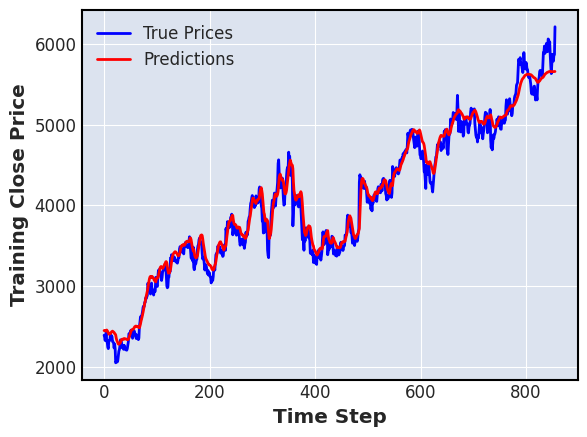

27/27 [==============================] - 0s 16ms/step


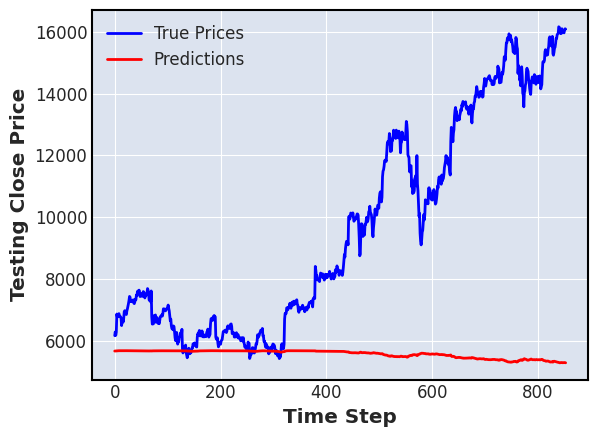

---------------------------------------------------------------
seed :  1
Epoch 1/10
27/27 [==============================] - 6s 90ms/step - loss: 83.7641 - mae: 8.7627 - mse: 83.7641 - mape: 80.9198 - val_loss: 571.9954 - val_mae: 22.0272 - val_mse: 571.9954 - val_mape: 83.6371
Epoch 2/10
27/27 [==============================] - 2s 70ms/step - loss: 27.1854 - mae: 4.4546 - mse: 27.1854 - mape: 38.7923 - val_loss: 386.9960 - val_mae: 17.1365 - val_mse: 386.9960 - val_mape: 61.6548
Epoch 3/10
27/27 [==============================] - 2s 67ms/step - loss: 6.6196 - mae: 2.1179 - mse: 6.6196 - mape: 21.5791 - val_loss: 310.4850 - val_mae: 14.8328 - val_mse: 310.4850 - val_mape: 51.7395
Epoch 4/10
27/27 [==============================] - 2s 59ms/step - loss: 5.6108 - mae: 1.9580 - mse: 5.6108 - mape: 20.0172 - val_loss: 317.0565 - val_mae: 15.1226 - val_mse: 317.0565 - val_mape: 53.1745
Epoch 5/10
27/27 [==============================] - 2s 60ms/step - loss: 4.2482 - mae: 1.6635 - mse: 4.248

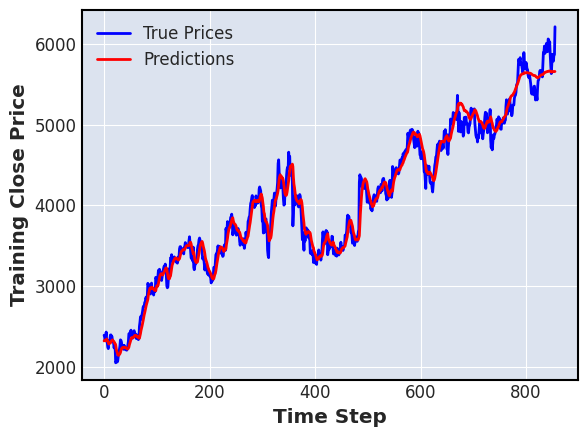

27/27 [==============================] - 0s 17ms/step


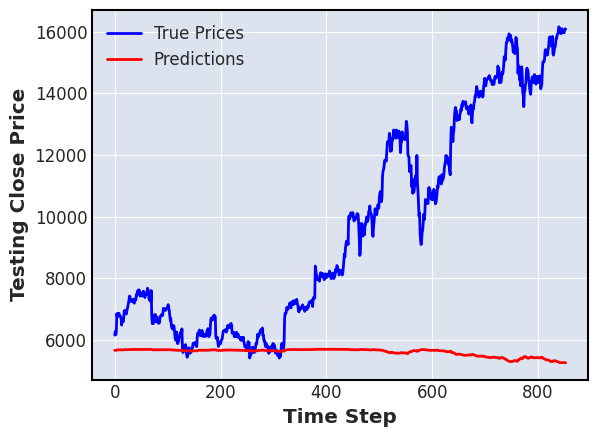

---------------------------------------------------------------
seed :  2
Epoch 1/10
27/27 [==============================] - 5s 86ms/step - loss: 103.7966 - mae: 9.8737 - mse: 103.7966 - mape: 91.8210 - val_loss: 660.2840 - val_mae: 23.9711 - val_mse: 660.2840 - val_mape: 92.2778
Epoch 2/10
27/27 [==============================] - 2s 62ms/step - loss: 53.6738 - mae: 6.7780 - mse: 53.6738 - mape: 61.0763 - val_loss: 490.7951 - val_mae: 19.9324 - val_mse: 490.7951 - val_mape: 73.9409
Epoch 3/10
27/27 [==============================] - 2s 69ms/step - loss: 12.0956 - mae: 2.7638 - mse: 12.0956 - mape: 24.8739 - val_loss: 337.1349 - val_mae: 15.4794 - val_mse: 337.1349 - val_mape: 54.1063
Epoch 4/10
27/27 [==============================] - 2s 67ms/step - loss: 5.9538 - mae: 2.0334 - mse: 5.9538 - mape: 21.3486 - val_loss: 325.5100 - val_mae: 15.2391 - val_mse: 325.5100 - val_mape: 53.3638
Epoch 5/10
27/27 [==============================] - 2s 61ms/step - loss: 4.5397 - mae: 1.7149 - mse: 4

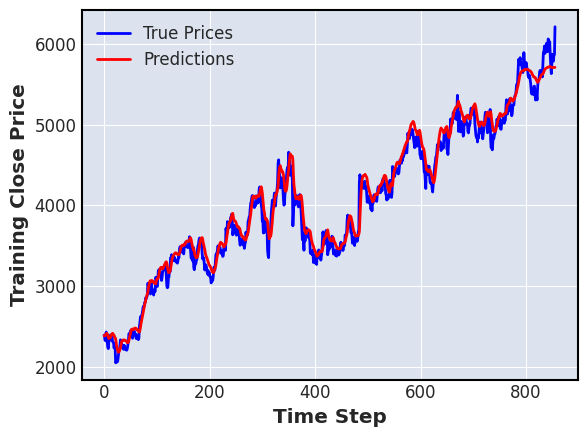

27/27 [==============================] - 0s 15ms/step


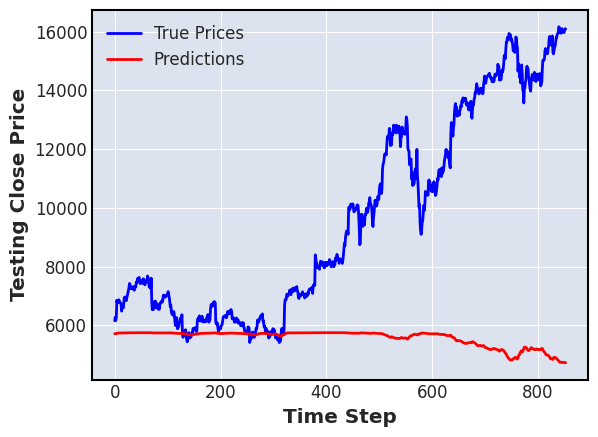

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
54/54 [==============================] - 6s 64ms/step - loss: 313.9562 - mae: 14.1844 - mse: 313.9562 - mape: 71.2070 - val_loss: 6175.1494 - val_mae: 74.6479 - val_mse: 6175.1494 - val_mape: 89.4924
Epoch 2/10
54/54 [==============================] - 3s 56ms/step - loss: 101.0479 - mae: 7.1669 - mse: 101.0479 - mape: 40.2728 - val_loss: 4636.8564 - val_mae: 63.2504 - val_mse: 4636.8564 - val_mape: 74.1472
Epoch 3/10
54/54 [==============================] - 3s 51ms/step - loss: 27.4534 - mae: 2.6501 - mse: 27.4534 - mape: 10.6119 - val_loss: 3519.6292 - val_mae: 53.5750 - val_mse: 3519.6292 - val_mape: 61.1868
Epoch 4/10
54/54 [==============================] - 3s 56ms/step - loss: 4.6206 - mae: 1.0130 - mse: 4.6206 - mape: 3.7939 - val_loss: 3021.7388 - val_mae: 48.6213 - val_mse: 3021.7388 - val_mape: 54.5325
Epoch 5/10
54/54 [==============================] - 3s 56ms/step - loss: 1.18

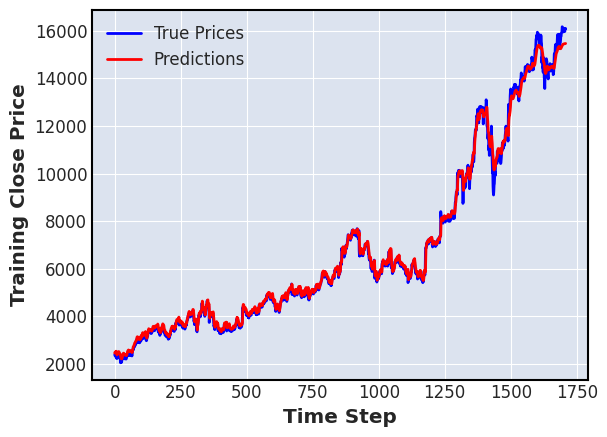

27/27 [==============================] - 0s 16ms/step


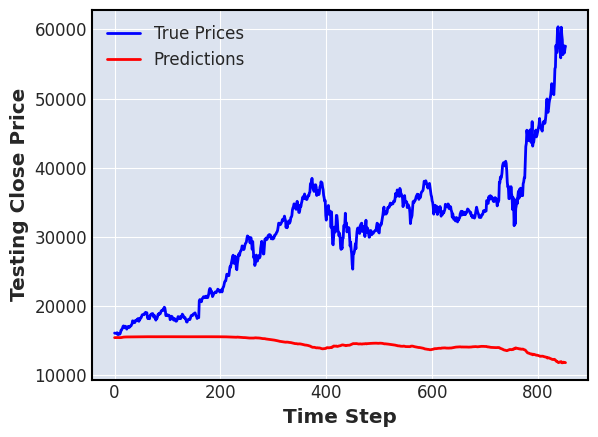

---------------------------------------------------------------
seed :  1
Epoch 1/10
54/54 [==============================] - 7s 71ms/step - loss: 304.1621 - mae: 13.8456 - mse: 304.1621 - mape: 68.9215 - val_loss: 6265.1968 - val_mae: 75.1068 - val_mse: 6265.1968 - val_mape: 89.8930
Epoch 2/10
54/54 [==============================] - 3s 51ms/step - loss: 97.0673 - mae: 7.1527 - mse: 97.0673 - mape: 41.2858 - val_loss: 4868.8682 - val_mae: 64.6888 - val_mse: 4868.8682 - val_mape: 75.6121
Epoch 3/10
54/54 [==============================] - 3s 50ms/step - loss: 21.1541 - mae: 2.2184 - mse: 21.1541 - mape: 8.2888 - val_loss: 3641.9856 - val_mae: 53.9823 - val_mse: 3641.9856 - val_mape: 61.0637
Epoch 4/10
54/54 [==============================] - 3s 55ms/step - loss: 2.4652 - mae: 0.7613 - mse: 2.4652 - mape: 3.1333 - val_loss: 3191.6257 - val_mae: 49.4691 - val_mse: 3191.6257 - val_mape: 54.9445
Epoch 5/10
54/54 [==============================] - 3s 53ms/step - loss: 0.6575 - mae: 0.4447 -

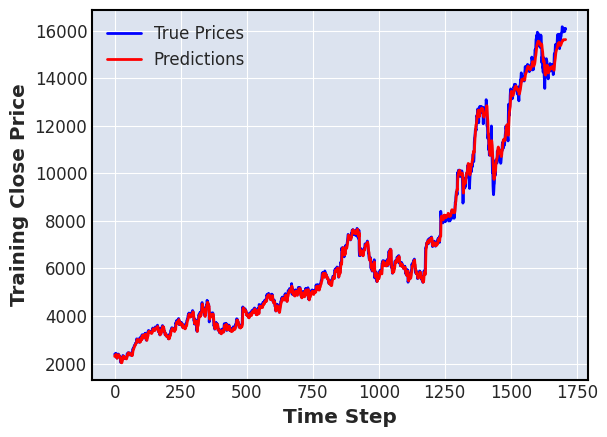

27/27 [==============================] - 0s 16ms/step


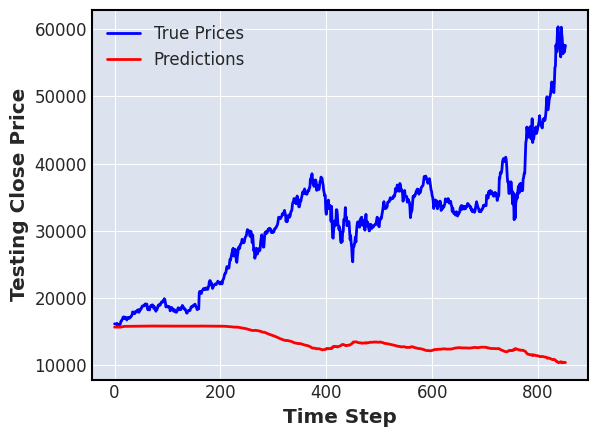

---------------------------------------------------------------
seed :  2
Epoch 1/10
54/54 [==============================] - 6s 69ms/step - loss: 361.5669 - mae: 15.9577 - mse: 361.5669 - mape: 83.7463 - val_loss: 6655.9790 - val_mae: 77.9219 - val_mse: 6655.9790 - val_mape: 94.0135
Epoch 2/10
54/54 [==============================] - 3s 61ms/step - loss: 145.9058 - mae: 8.5714 - mse: 145.9058 - mape: 43.7473 - val_loss: 5294.4819 - val_mae: 67.8781 - val_mse: 5294.4819 - val_mape: 79.8310
Epoch 3/10
54/54 [==============================] - 3s 52ms/step - loss: 54.3957 - mae: 4.6728 - mse: 54.3957 - mape: 24.0700 - val_loss: 4304.3750 - val_mae: 59.8922 - val_mse: 4304.3750 - val_mape: 69.0144
Epoch 4/10
54/54 [==============================] - 3s 56ms/step - loss: 10.1010 - mae: 1.5148 - mse: 10.1010 - mape: 5.5171 - val_loss: 3620.0759 - val_mae: 53.5377 - val_mse: 3620.0759 - val_mape: 60.2898
Epoch 5/10
54/54 [==============================] - 3s 56ms/step - loss: 2.3571 - mae: 0.7

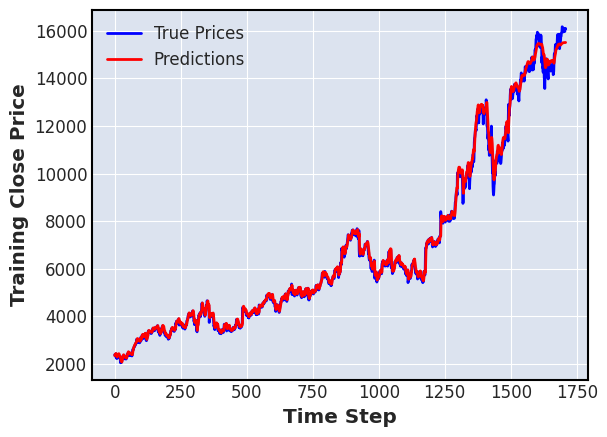

27/27 [==============================] - 0s 17ms/step


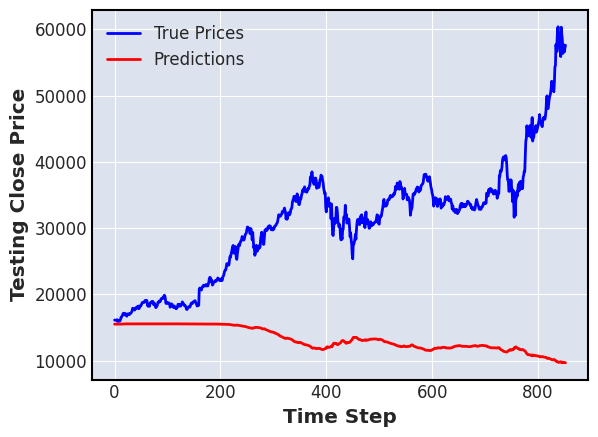

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
81/81 [==============================] - 7s 57ms/step - loss: 2283.8662 - mae: 33.2458 - mse: 2283.8662 - mape: 71.8661 - val_loss: 15367.7334 - val_mae: 120.8192 - val_mse: 15367.7334 - val_mape: 85.0149
Epoch 2/10
81/81 [==============================] - 4s 52ms/step - loss: 897.5526 - mae: 16.8613 - mse: 897.5526 - mape: 30.8316 - val_loss: 8074.4639 - val_mae: 85.7242 - val_mse: 8074.4639 - val_mape: 59.1596
Epoch 3/10
81/81 [==============================] - 4s 50ms/step - loss: 220.7122 - mae: 6.4062 - mse: 220.7122 - mape: 8.3180 - val_loss: 4025.7927 - val_mae: 57.3953 - val_mse: 4025.7927 - val_mape: 38.1721
Epoch 4/10
81/81 [==============================] - 4s 51ms/step - loss: 63.4792 - mae: 2.6316 - mse: 63.4792 - mape: 4.5254 - val_loss: 2701.3440 - val_mae: 45.1237 - val_mse: 2701.3440 - val_mape: 29.3577
Epoch 5/10
81/81 [==============================] - 4s 50ms/step - l

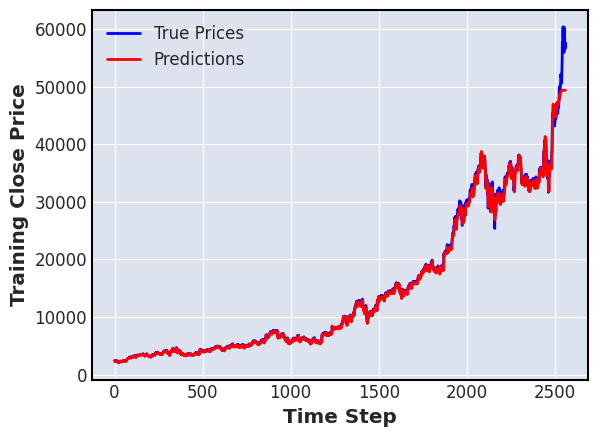

27/27 [==============================] - 0s 17ms/step


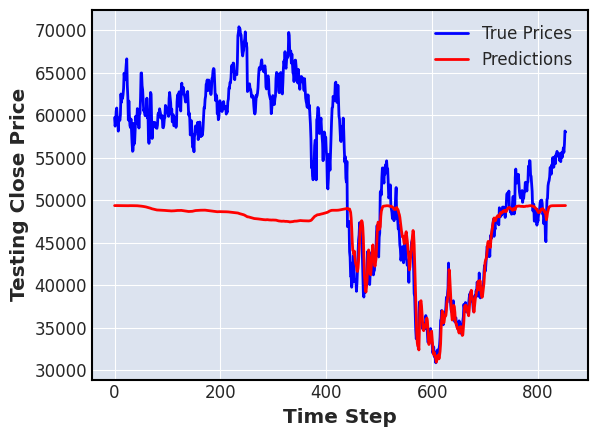

---------------------------------------------------------------
seed :  1
Epoch 1/10
81/81 [==============================] - 8s 61ms/step - loss: 2251.6589 - mae: 32.9905 - mse: 2251.6589 - mape: 71.0009 - val_loss: 15391.0977 - val_mae: 120.9389 - val_mse: 15391.0977 - val_mape: 85.1185
Epoch 2/10
81/81 [==============================] - 4s 52ms/step - loss: 845.7511 - mae: 15.6985 - mse: 845.7511 - mape: 25.2731 - val_loss: 7679.9268 - val_mae: 83.3680 - val_mse: 7679.9268 - val_mape: 57.4056
Epoch 3/10
81/81 [==============================] - 4s 50ms/step - loss: 201.8072 - mae: 6.0813 - mse: 201.8072 - mape: 7.7626 - val_loss: 4086.5933 - val_mae: 57.8115 - val_mse: 4086.5933 - val_mape: 38.4474
Epoch 4/10
81/81 [==============================] - 4s 52ms/step - loss: 67.9734 - mae: 2.8973 - mse: 67.9734 - mape: 4.6973 - val_loss: 2823.0156 - val_mae: 46.2965 - val_mse: 2823.0156 - val_mape: 30.1845
Epoch 5/10
81/81 [==============================] - 4s 51ms/step - loss: 40.1594 - 

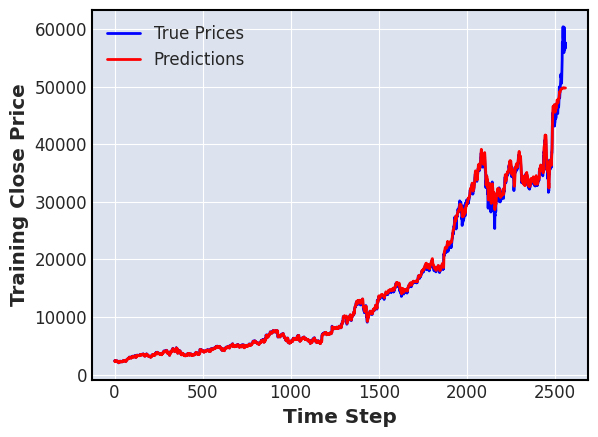

27/27 [==============================] - 0s 16ms/step


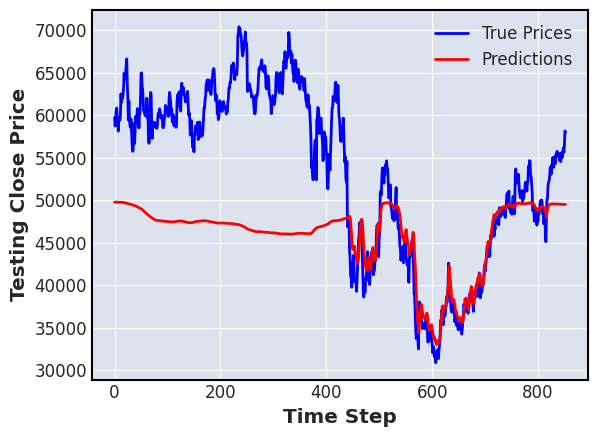

---------------------------------------------------------------
seed :  2
Epoch 1/10
81/81 [==============================] - 7s 59ms/step - loss: 2398.6240 - mae: 34.8086 - mse: 2398.6240 - mape: 76.9414 - val_loss: 17017.1250 - val_mae: 127.4559 - val_mse: 17017.1250 - val_mape: 89.9203
Epoch 2/10
81/81 [==============================] - 4s 50ms/step - loss: 1178.7161 - mae: 21.2995 - mse: 1178.7161 - mape: 46.5711 - val_loss: 10224.9199 - val_mae: 97.3492 - val_mse: 10224.9199 - val_mape: 67.7046
Epoch 3/10
81/81 [==============================] - 5s 56ms/step - loss: 389.7427 - mae: 9.2640 - mse: 389.7427 - mape: 11.2569 - val_loss: 5806.3457 - val_mae: 70.9888 - val_mse: 5806.3457 - val_mape: 48.1402
Epoch 4/10
81/81 [==============================] - 4s 49ms/step - loss: 120.7829 - mae: 4.1391 - mse: 120.7829 - mape: 5.3404 - val_loss: 3816.0571 - val_mae: 55.2573 - val_mse: 3816.0571 - val_mape: 36.5163
Epoch 5/10
81/81 [==============================] - 4s 52ms/step - loss: 64.

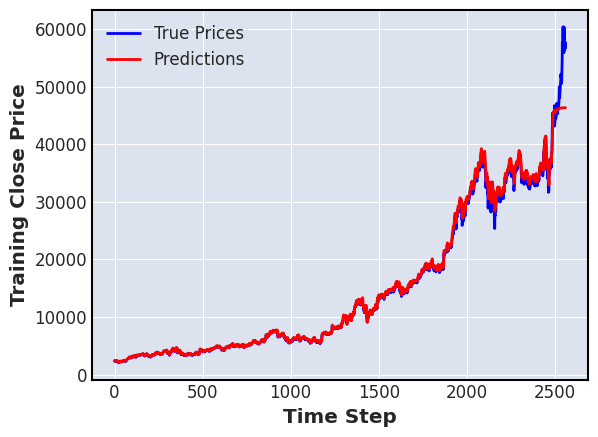

27/27 [==============================] - 0s 17ms/step


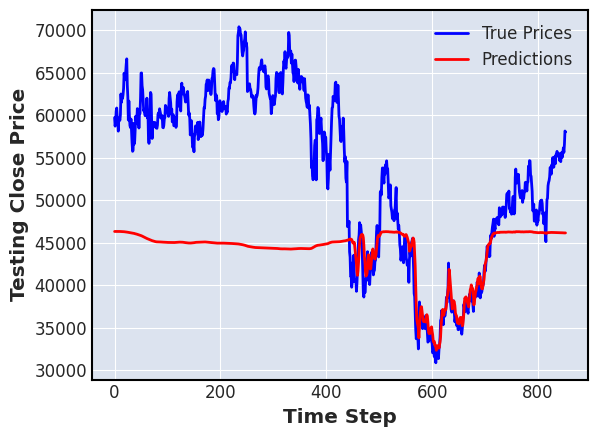

---------------------------------------------------------------
ticker_name :  IBM Close  , length =  3415
kth split :  0
seed :  0
Epoch 1/10
27/27 [==============================] - 5s 92ms/step - loss: 11874.8408 - mae: 107.6998 - mse: 11874.8408 - mape: 99.2230 - val_loss: 11261.5742 - val_mae: 105.6198 - val_mse: 11261.5742 - val_mape: 98.0082
Epoch 2/10
27/27 [==============================] - 2s 61ms/step - loss: 11236.2275 - mae: 104.6830 - mse: 11236.2275 - mape: 96.3613 - val_loss: 10434.2861 - val_mae: 101.6251 - val_mse: 10434.2861 - val_mape: 94.2622
Epoch 3/10
27/27 [==============================] - 2s 59ms/step - loss: 9951.1904 - mae: 98.3015 - mse: 9951.1904 - mape: 90.3008 - val_loss: 8579.4902 - val_mae: 92.0410 - val_mse: 8579.4902 - val_mape: 85.2759
Epoch 4/10
27/27 [==============================] - 2s 73ms/step - loss: 7918.8672 - mae: 87.2957 - mse: 7918.8672 - mape: 79.8421 - val_loss: 6548.6230 - val_mae: 80.2539 - val_mse: 6548.6230 - val_mape: 74.2310
Epoc

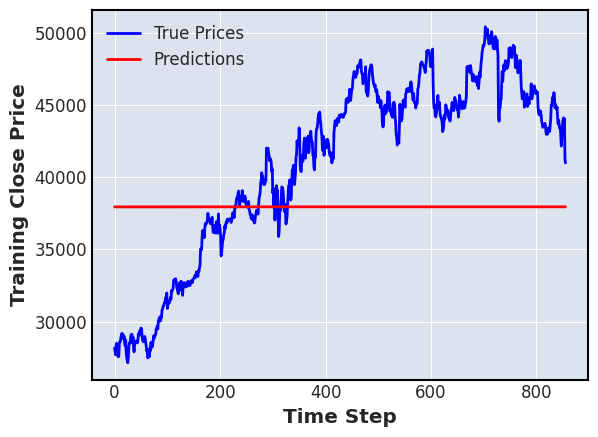

27/27 [==============================] - 0s 16ms/step


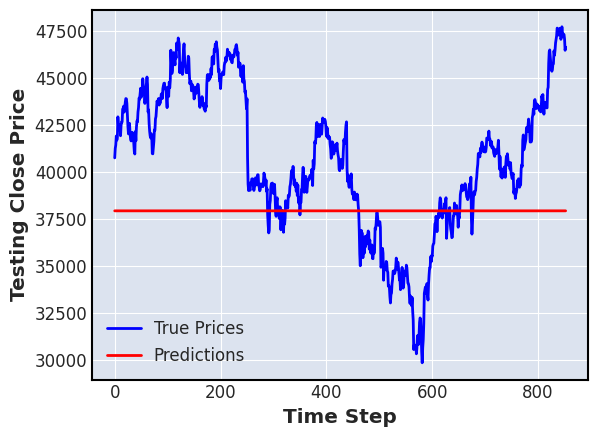

---------------------------------------------------------------
seed :  1
Epoch 1/10
27/27 [==============================] - 5s 90ms/step - loss: 11808.4707 - mae: 107.3922 - mse: 11808.4707 - mape: 98.9324 - val_loss: 11220.7441 - val_mae: 105.4292 - val_mse: 11220.7441 - val_mape: 97.8324
Epoch 2/10
27/27 [==============================] - 2s 64ms/step - loss: 11205.2100 - mae: 104.4969 - mse: 11205.2100 - mape: 96.1475 - val_loss: 10313.0645 - val_mae: 101.0232 - val_mse: 10313.0645 - val_mape: 93.6951
Epoch 3/10
27/27 [==============================] - 2s 68ms/step - loss: 9817.0781 - mae: 97.5488 - mse: 9817.0781 - mape: 89.5330 - val_loss: 8184.2344 - val_mae: 89.8601 - val_mse: 8184.2344 - val_mape: 83.2259
Epoch 4/10
27/27 [==============================] - 2s 68ms/step - loss: 7302.5171 - mae: 83.6815 - mse: 7302.5171 - mape: 76.4406 - val_loss: 5775.6836 - val_mae: 75.2904 - val_mse: 5775.6836 - val_mape: 69.5840
Epoch 5/10
27/27 [==============================] - 2s 62ms/st

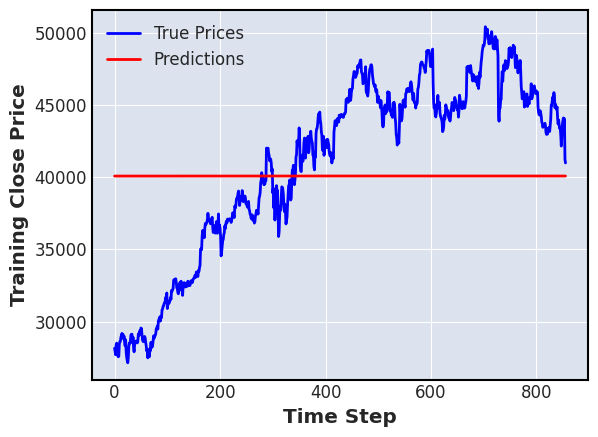

27/27 [==============================] - 1s 19ms/step


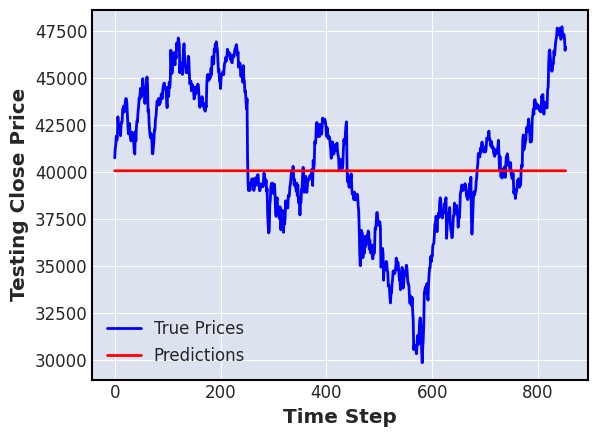

---------------------------------------------------------------
seed :  2
Epoch 1/10
27/27 [==============================] - 5s 85ms/step - loss: 11820.1768 - mae: 107.4515 - mse: 11820.1768 - mape: 98.9937 - val_loss: 11306.8086 - val_mae: 105.8390 - val_mse: 11306.8086 - val_mape: 98.2188
Epoch 2/10
27/27 [==============================] - 2s 70ms/step - loss: 11441.3018 - mae: 105.6634 - mse: 11441.3018 - mape: 97.2894 - val_loss: 10811.9551 - val_mae: 103.4694 - val_mse: 10811.9551 - val_mape: 95.9932
Epoch 3/10
27/27 [==============================] - 2s 61ms/step - loss: 10609.3457 - mae: 101.5729 - mse: 10609.3457 - mape: 93.3579 - val_loss: 9414.8281 - val_mae: 96.4763 - val_mse: 9414.8281 - val_mape: 89.4355
Epoch 4/10
27/27 [==============================] - 2s 60ms/step - loss: 8857.3467 - mae: 92.5671 - mse: 8857.3467 - mape: 84.8696 - val_loss: 7467.9346 - val_mae: 85.7861 - val_mse: 7467.9346 - val_mape: 79.4114
Epoch 5/10
27/27 [==============================] - 2s 72ms

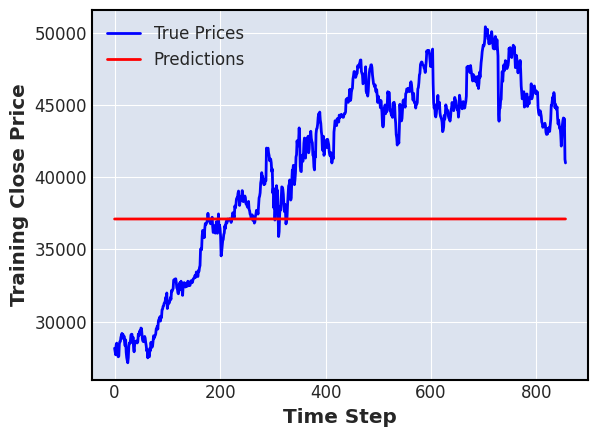

27/27 [==============================] - 0s 16ms/step


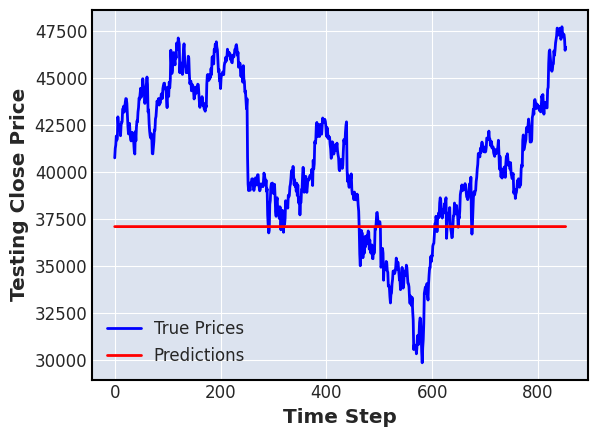

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
54/54 [==============================] - 6s 63ms/step - loss: 11399.6689 - mae: 105.8436 - mse: 11399.6689 - mape: 97.8298 - val_loss: 9882.3896 - val_mae: 99.0923 - val_mse: 9882.3896 - val_mape: 94.1974
Epoch 2/10
54/54 [==============================] - 3s 50ms/step - loss: 8802.9209 - mae: 92.5405 - mse: 8802.9209 - mape: 85.2635 - val_loss: 6090.5771 - val_mae: 77.6297 - val_mse: 6090.5771 - val_mape: 73.6576
Epoch 3/10
54/54 [==============================] - 3s 52ms/step - loss: 4570.9404 - mae: 65.5770 - mse: 4570.9404 - mape: 59.9100 - val_loss: 2261.3728 - val_mae: 46.8932 - val_mse: 2261.3728 - val_mape: 44.2596
Epoch 4/10
54/54 [==============================] - 3s 51ms/step - loss: 1570.2939 - mae: 36.6465 - mse: 1570.2939 - mape: 32.7643 - val_loss: 486.5347 - val_mae: 20.7011 - val_mse: 486.5347 - val_mape: 19.2339
Epoch 5/10
54/54 [==============================] - 3s 56m

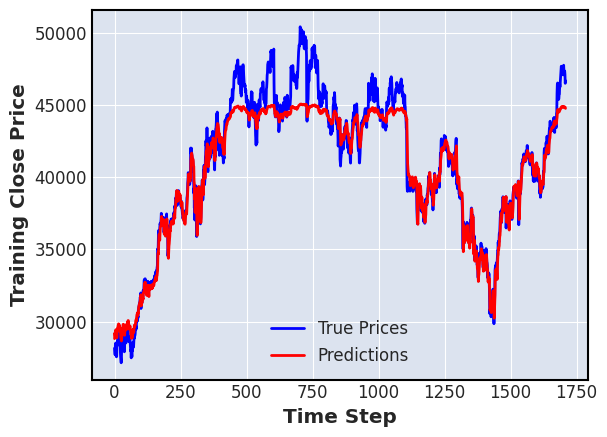

27/27 [==============================] - 0s 16ms/step


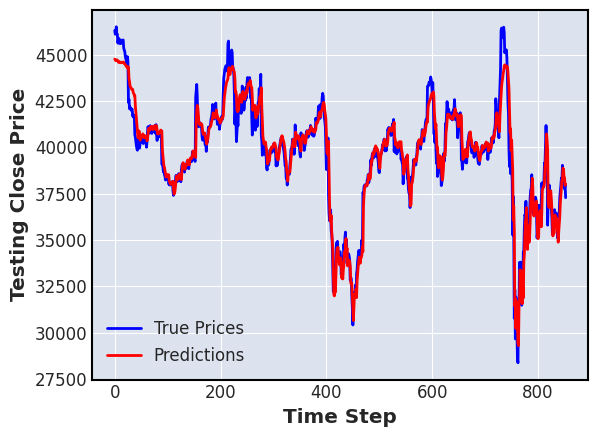

---------------------------------------------------------------
seed :  1
Epoch 1/10
54/54 [==============================] - 7s 71ms/step - loss: 11348.4170 - mae: 105.6086 - mse: 11348.4170 - mape: 97.6129 - val_loss: 9750.9951 - val_mae: 98.4263 - val_mse: 9750.9951 - val_mape: 93.5596
Epoch 2/10
54/54 [==============================] - 3s 52ms/step - loss: 8456.7119 - mae: 90.5806 - mse: 8456.7119 - mape: 83.4570 - val_loss: 5392.3984 - val_mae: 73.0003 - val_mse: 5392.3984 - val_mape: 69.2327
Epoch 3/10
54/54 [==============================] - 3s 56ms/step - loss: 3682.7153 - mae: 58.0374 - mse: 3682.7153 - mape: 52.7822 - val_loss: 1368.9034 - val_mae: 36.1457 - val_mse: 1368.9034 - val_mape: 33.9769
Epoch 4/10
54/54 [==============================] - 3s 56ms/step - loss: 875.8057 - mae: 26.1940 - mse: 875.8057 - mape: 23.2182 - val_loss: 154.3445 - val_mae: 11.0500 - val_mse: 154.3445 - val_mape: 10.2676
Epoch 5/10
54/54 [==============================] - 3s 61ms/step - loss: 23

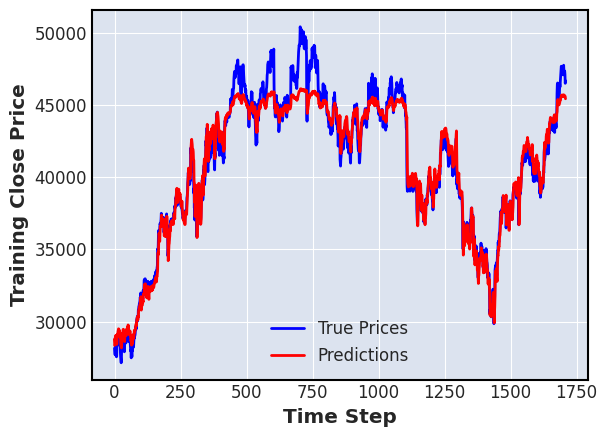

27/27 [==============================] - 0s 17ms/step


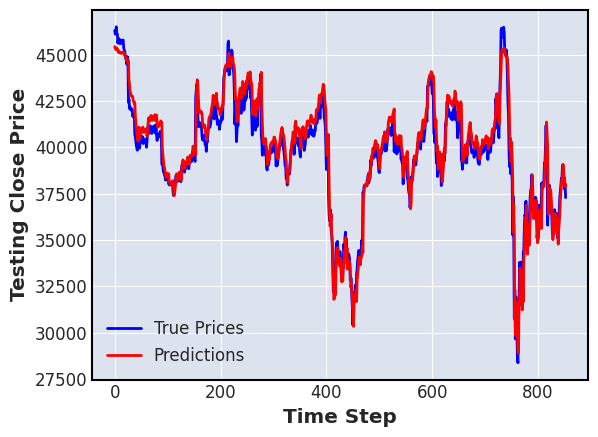

---------------------------------------------------------------
seed :  2
Epoch 1/10
54/54 [==============================] - 6s 70ms/step - loss: 11478.0518 - mae: 106.2402 - mse: 11478.0518 - mape: 98.2211 - val_loss: 10244.5664 - val_mae: 100.9050 - val_mse: 10244.5664 - val_mape: 95.9333
Epoch 2/10
54/54 [==============================] - 3s 56ms/step - loss: 9634.9961 - mae: 97.0189 - mse: 9634.9961 - mape: 89.4923 - val_loss: 7099.5830 - val_mae: 83.8839 - val_mse: 7099.5830 - val_mape: 79.6471
Epoch 3/10
54/54 [==============================] - 3s 51ms/step - loss: 5811.7905 - mae: 74.5162 - mse: 5811.7905 - mape: 68.2788 - val_loss: 3291.7046 - val_mae: 56.8236 - val_mse: 3291.7046 - val_mape: 53.7586
Epoch 4/10
54/54 [==============================] - 3s 52ms/step - loss: 2297.3538 - mae: 45.1639 - mse: 2297.3538 - mape: 40.7071 - val_loss: 826.1015 - val_mae: 27.6476 - val_mse: 826.1015 - val_mape: 25.8507
Epoch 5/10
54/54 [==============================] - 3s 57ms/step - los

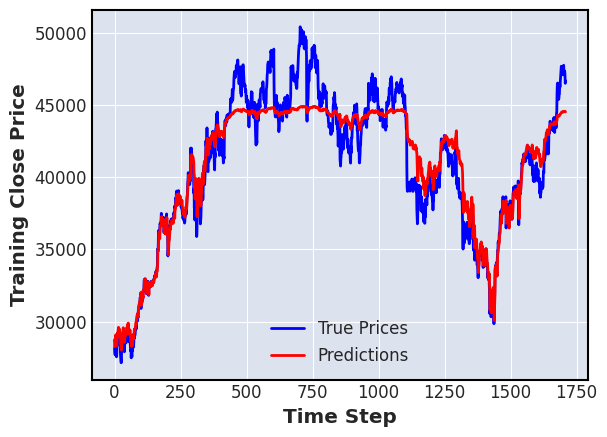

27/27 [==============================] - 0s 16ms/step


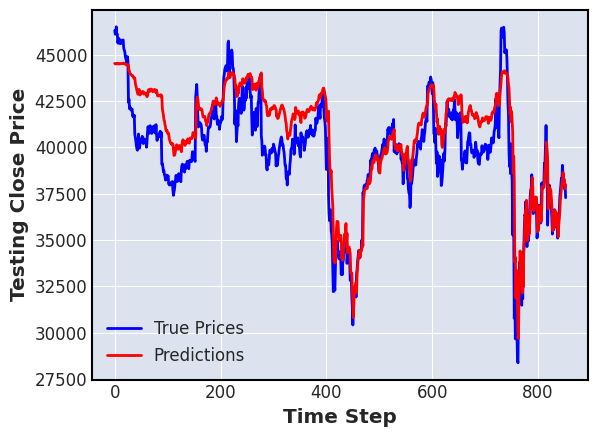

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
81/81 [==============================] - 7s 56ms/step - loss: 10643.2441 - mae: 102.3509 - mse: 10643.2441 - mape: 95.4602 - val_loss: 11474.8438 - val_mae: 106.1372 - val_mse: 11474.8438 - val_mape: 87.1686
Epoch 2/10
81/81 [==============================] - 4s 49ms/step - loss: 5524.6670 - mae: 72.2729 - mse: 5524.6670 - mape: 66.9799 - val_loss: 4244.2300 - val_mae: 63.5471 - val_mse: 4244.2300 - val_mape: 51.6343
Epoch 3/10
81/81 [==============================] - 4s 49ms/step - loss: 1182.3904 - mae: 30.9963 - mse: 1182.3904 - mape: 28.0635 - val_loss: 1041.5001 - val_mae: 28.9583 - val_mse: 1041.5001 - val_mape: 22.7790
Epoch 4/10
81/81 [==============================] - 4s 54ms/step - loss: 212.0089 - mae: 11.9175 - mse: 212.0089 - mape: 11.0559 - val_loss: 473.8384 - val_mae: 18.0686 - val_mse: 473.8384 - val_mape: 14.0001
Epoch 5/10
81/81 [==============================] - 4s 53

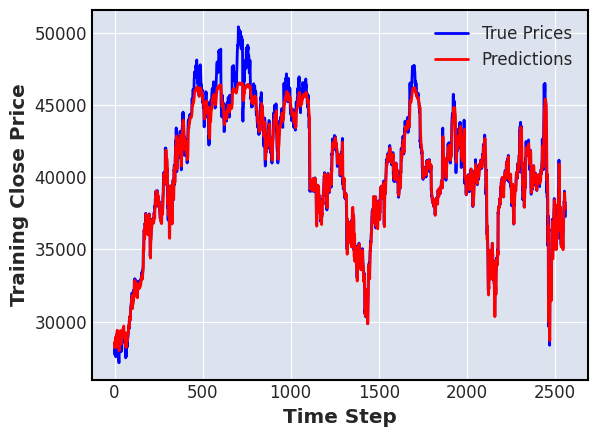

27/27 [==============================] - 0s 16ms/step


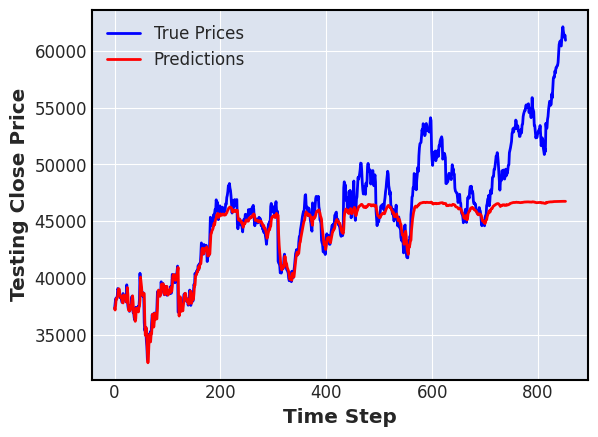

---------------------------------------------------------------
seed :  1
Epoch 1/10
81/81 [==============================] - 7s 57ms/step - loss: 10572.6807 - mae: 101.9614 - mse: 10572.6807 - mape: 95.0606 - val_loss: 11113.1455 - val_mae: 104.4010 - val_mse: 11113.1455 - val_mape: 85.7070
Epoch 2/10
81/81 [==============================] - 4s 50ms/step - loss: 4704.5093 - mae: 65.7927 - mse: 4704.5093 - mape: 60.8477 - val_loss: 3029.1802 - val_mae: 53.1096 - val_mse: 3029.1802 - val_mape: 42.9135
Epoch 3/10
81/81 [==============================] - 4s 49ms/step - loss: 618.5073 - mae: 21.1939 - mse: 618.5073 - mape: 19.1637 - val_loss: 589.4218 - val_mae: 20.3534 - val_mse: 589.4218 - val_mape: 15.7481
Epoch 4/10
81/81 [==============================] - 4s 52ms/step - loss: 150.3485 - mae: 9.6458 - mse: 150.3485 - mape: 9.2749 - val_loss: 409.4034 - val_mae: 16.6095 - val_mse: 409.4034 - val_mape: 12.8340
Epoch 5/10
81/81 [==============================] - 4s 52ms/step - loss: 74.84

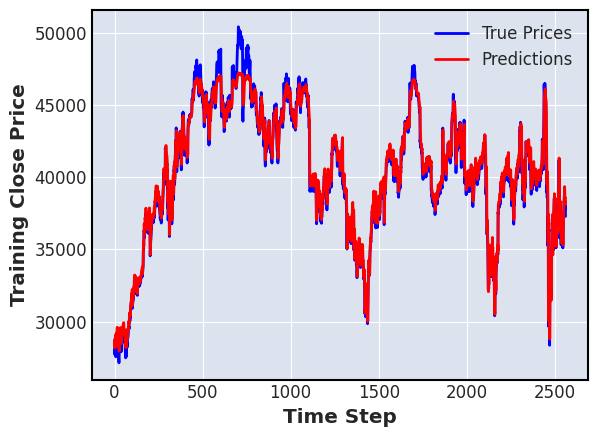

27/27 [==============================] - 1s 19ms/step


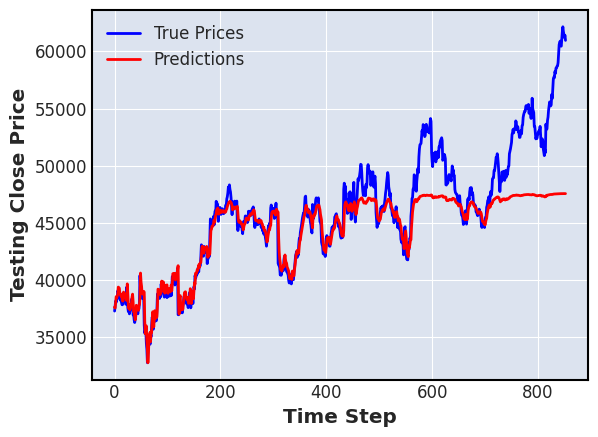

---------------------------------------------------------------
seed :  2
Epoch 1/10
81/81 [==============================] - 8s 61ms/step - loss: 10904.0020 - mae: 103.6612 - mse: 10904.0020 - mape: 96.6986 - val_loss: 12438.3379 - val_mae: 110.5851 - val_mse: 12438.3379 - val_mape: 90.8830
Epoch 2/10
81/81 [==============================] - 4s 50ms/step - loss: 6633.2832 - mae: 79.8397 - mse: 6633.2832 - mape: 74.1664 - val_loss: 5670.8535 - val_mae: 73.9164 - val_mse: 5670.8535 - val_mape: 60.2845
Epoch 3/10
81/81 [==============================] - 4s 50ms/step - loss: 1822.2933 - mae: 39.4243 - mse: 1822.2933 - mape: 35.9225 - val_loss: 1421.9160 - val_mae: 34.8812 - val_mse: 1421.9160 - val_mape: 27.7109
Epoch 4/10
81/81 [==============================] - 4s 53ms/step - loss: 273.3002 - mae: 13.7613 - mse: 273.3002 - mape: 12.5762 - val_loss: 505.6454 - val_mae: 18.7067 - val_mse: 505.6454 - val_mape: 14.4817
Epoch 5/10
81/81 [==============================] - 4s 50ms/step - loss:

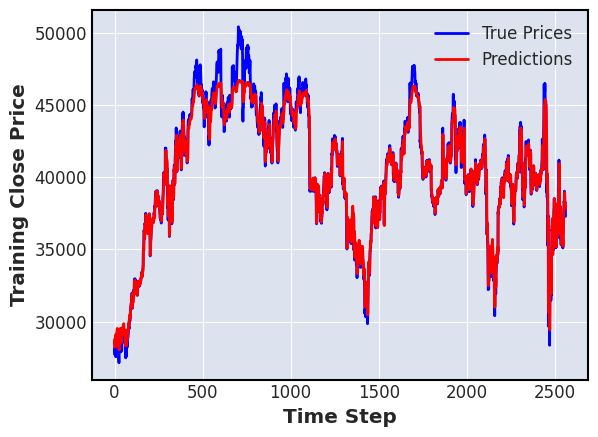

27/27 [==============================] - 1s 20ms/step


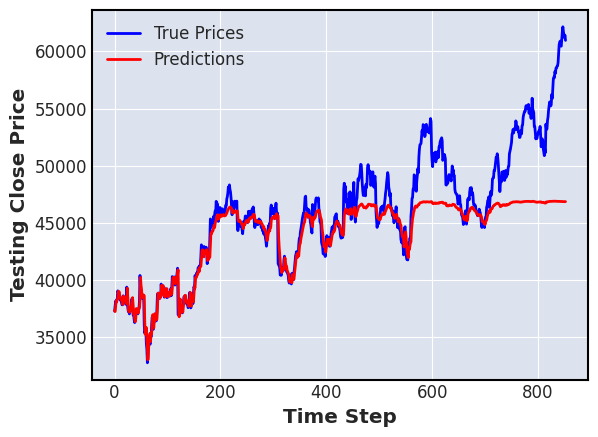

---------------------------------------------------------------
ticker_name :  KO Close  , length =  3415
kth split :  0
seed :  0
Epoch 1/10
27/27 [==============================] - 5s 100ms/step - loss: 537.5748 - mae: 22.9166 - mse: 537.5748 - mape: 94.2691 - val_loss: 815.1565 - val_mae: 28.4655 - val_mse: 815.1565 - val_mape: 89.4168
Epoch 2/10
27/27 [==============================] - 2s 60ms/step - loss: 330.7156 - mae: 17.7331 - mse: 330.7156 - mape: 72.4060 - val_loss: 452.1897 - val_mae: 21.1421 - val_mse: 452.1897 - val_mape: 66.2754
Epoch 3/10
27/27 [==============================] - 2s 60ms/step - loss: 90.2934 - mae: 8.5241 - mse: 90.2934 - mape: 33.8375 - val_loss: 137.6460 - val_mae: 11.5272 - val_mse: 137.6460 - val_mape: 35.9341
Epoch 4/10
27/27 [==============================] - 2s 68ms/step - loss: 15.2794 - mae: 3.2264 - mse: 15.2794 - mape: 13.3198 - val_loss: 56.8675 - val_mae: 7.2244 - val_mse: 56.8675 - val_mape: 22.3513
Epoch 5/10
27/27 [=======================

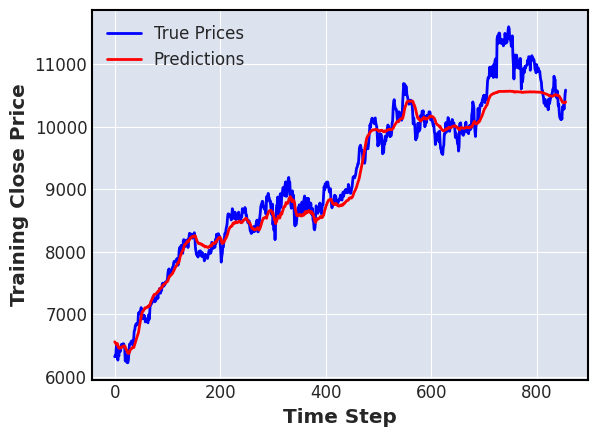

27/27 [==============================] - 0s 15ms/step


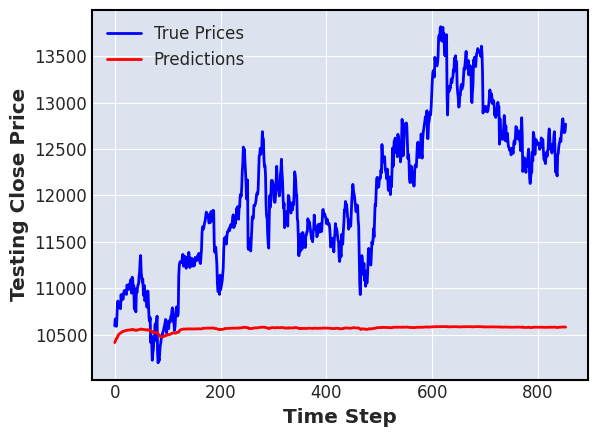

---------------------------------------------------------------
seed :  1
Epoch 1/10
27/27 [==============================] - 5s 83ms/step - loss: 514.5115 - mae: 22.4098 - mse: 514.5115 - mape: 92.1204 - val_loss: 805.6134 - val_mae: 28.2999 - val_mse: 805.6134 - val_mape: 88.9013
Epoch 2/10
27/27 [==============================] - 2s 64ms/step - loss: 346.5784 - mae: 18.2105 - mse: 346.5784 - mape: 74.4001 - val_loss: 518.0469 - val_mae: 22.6513 - val_mse: 518.0469 - val_mape: 71.0525
Epoch 3/10
27/27 [==============================] - 2s 59ms/step - loss: 143.7252 - mae: 11.2407 - mse: 143.7252 - mape: 45.0613 - val_loss: 225.8166 - val_mae: 14.8677 - val_mse: 225.8166 - val_mape: 46.4825
Epoch 4/10
27/27 [==============================] - 2s 69ms/step - loss: 30.3155 - mae: 4.5856 - mse: 30.3155 - mape: 18.1000 - val_loss: 70.1831 - val_mae: 8.0785 - val_mse: 70.1831 - val_mape: 25.0363
Epoch 5/10
27/27 [==============================] - 2s 68ms/step - loss: 11.7160 - mae: 2.9096 -

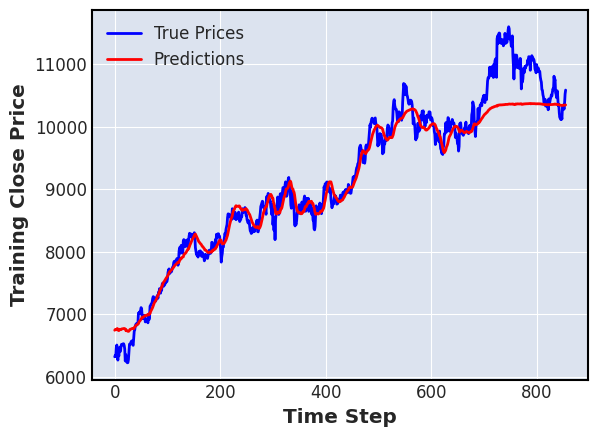

27/27 [==============================] - 0s 16ms/step


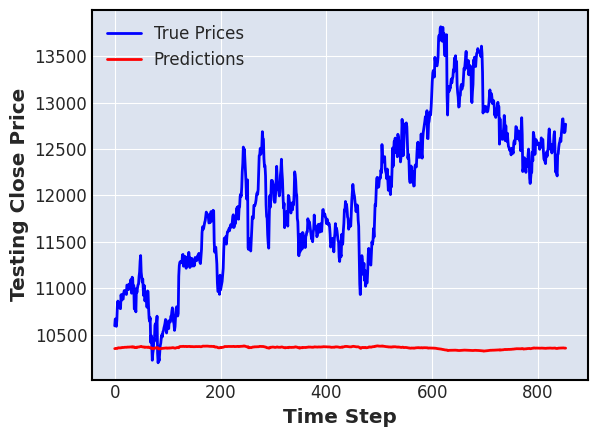

---------------------------------------------------------------
seed :  2
Epoch 1/10
27/27 [==============================] - 5s 87ms/step - loss: 570.2378 - mae: 23.6330 - mse: 570.2378 - mape: 97.2522 - val_loss: 934.3871 - val_mae: 30.4910 - val_mse: 934.3871 - val_mape: 95.8222
Epoch 2/10
27/27 [==============================] - 2s 62ms/step - loss: 477.6867 - mae: 21.5673 - mse: 477.6867 - mape: 88.5485 - val_loss: 750.3835 - val_mae: 27.3011 - val_mse: 750.3835 - val_mape: 85.7324
Epoch 3/10
27/27 [==============================] - 2s 69ms/step - loss: 286.4517 - mae: 16.4320 - mse: 286.4517 - mape: 66.8606 - val_loss: 422.2903 - val_mae: 20.4336 - val_mse: 422.2903 - val_mape: 64.0593
Epoch 4/10
27/27 [==============================] - 2s 66ms/step - loss: 97.3912 - mae: 9.0206 - mse: 97.3912 - mape: 35.8576 - val_loss: 163.3604 - val_mae: 12.5951 - val_mse: 163.3604 - val_mape: 39.3084
Epoch 5/10
27/27 [==============================] - 2s 69ms/step - loss: 19.5553 - mae: 3.639

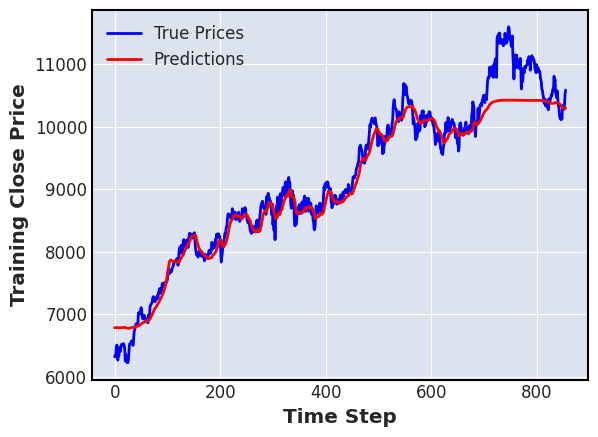

27/27 [==============================] - 0s 17ms/step


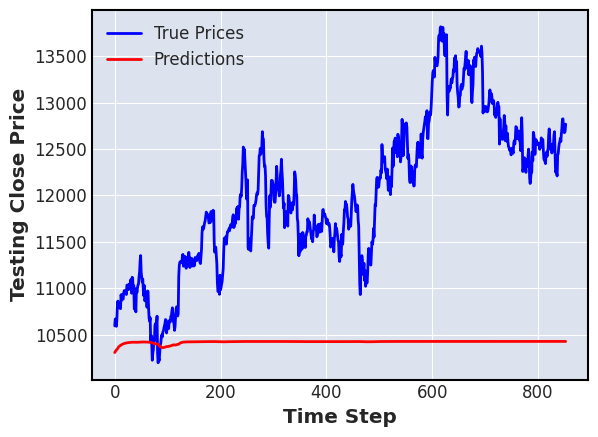

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
54/54 [==============================] - 8s 67ms/step - loss: 626.4990 - mae: 24.4047 - mse: 626.4990 - mape: 86.5211 - val_loss: 1001.9307 - val_mae: 31.3020 - val_mse: 1001.9307 - val_mape: 76.8562
Epoch 2/10
54/54 [==============================] - 3s 52ms/step - loss: 136.0524 - mae: 10.0368 - mse: 136.0524 - mape: 34.2988 - val_loss: 244.5061 - val_mae: 14.9745 - val_mse: 244.5061 - val_mape: 36.1939
Epoch 3/10
54/54 [==============================] - 3s 53ms/step - loss: 21.9864 - mae: 3.9426 - mse: 21.9864 - mape: 15.0955 - val_loss: 166.8810 - val_mae: 12.1244 - val_mse: 166.8810 - val_mape: 29.0982
Epoch 4/10
54/54 [==============================] - 3s 52ms/step - loss: 11.4068 - mae: 2.6514 - mse: 11.4068 - mape: 10.0431 - val_loss: 124.1417 - val_mae: 10.2279 - val_mse: 124.1417 - val_mape: 24.3795
Epoch 5/10
54/54 [==============================] - 3s 56ms/step - loss: 2.3478

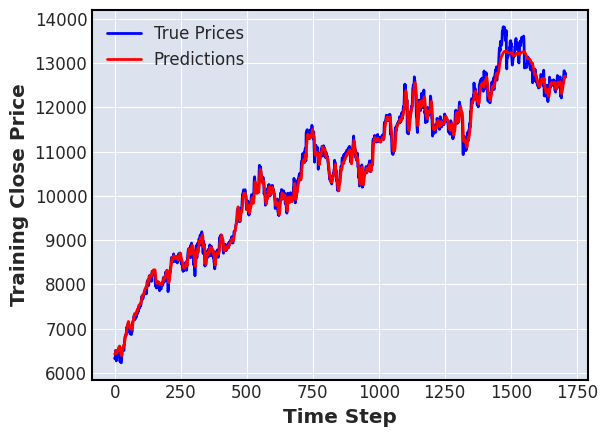

27/27 [==============================] - 0s 15ms/step


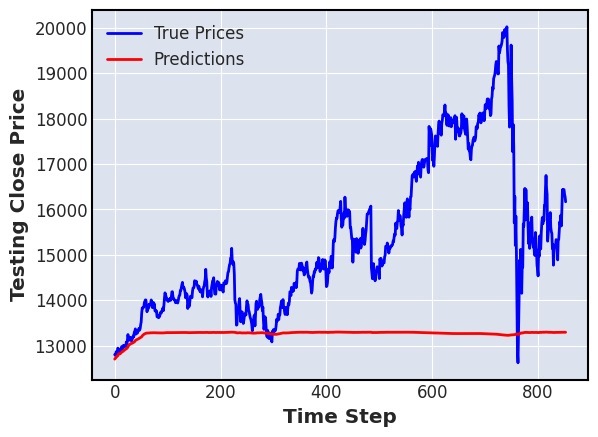

---------------------------------------------------------------
seed :  1
Epoch 1/10
54/54 [==============================] - 6s 66ms/step - loss: 612.1367 - mae: 24.1236 - mse: 612.1367 - mape: 85.4323 - val_loss: 1022.6685 - val_mae: 31.6351 - val_mse: 1022.6685 - val_mape: 77.6936
Epoch 2/10
54/54 [==============================] - 3s 51ms/step - loss: 154.9537 - mae: 10.7715 - mse: 154.9537 - mape: 36.8633 - val_loss: 239.5906 - val_mae: 14.7854 - val_mse: 239.5906 - val_mape: 35.7026
Epoch 3/10
54/54 [==============================] - 3s 52ms/step - loss: 22.6489 - mae: 3.9747 - mse: 22.6489 - mape: 15.3457 - val_loss: 175.2504 - val_mae: 12.4710 - val_mse: 175.2504 - val_mape: 29.9667
Epoch 4/10
54/54 [==============================] - 3s 56ms/step - loss: 21.0848 - mae: 3.8444 - mse: 21.0848 - mape: 14.8640 - val_loss: 167.0471 - val_mae: 12.1618 - val_mse: 167.0471 - val_mape: 29.2132
Epoch 5/10
54/54 [==============================] - 3s 51ms/step - loss: 12.8599 - mae: 2.9542

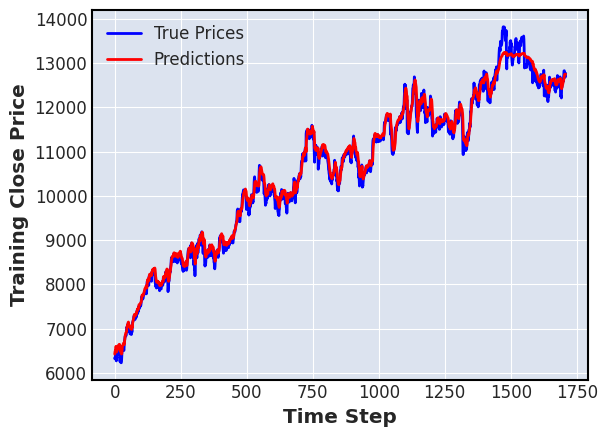

27/27 [==============================] - 0s 16ms/step


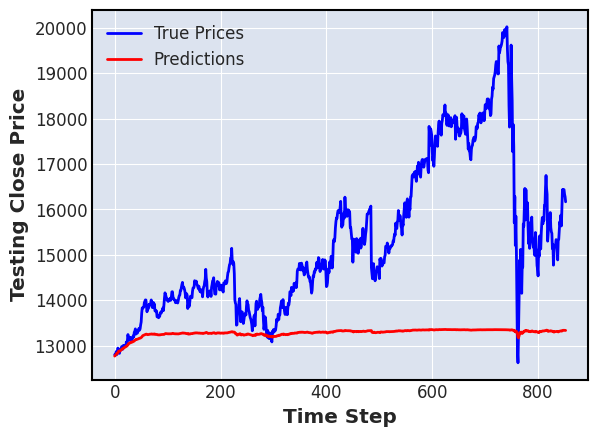

---------------------------------------------------------------
seed :  2
Epoch 1/10
54/54 [==============================] - 6s 69ms/step - loss: 722.3677 - mae: 26.4252 - mse: 722.3677 - mape: 94.0195 - val_loss: 1341.2035 - val_mae: 36.3327 - val_mse: 1341.2035 - val_mape: 89.4276
Epoch 2/10
54/54 [==============================] - 3s 53ms/step - loss: 314.7920 - mae: 16.4982 - mse: 314.7920 - mape: 57.3866 - val_loss: 455.8754 - val_mae: 20.8648 - val_mse: 455.8754 - val_mape: 50.8743
Epoch 3/10
54/54 [==============================] - 3s 51ms/step - loss: 37.0982 - mae: 5.0652 - mse: 37.0982 - mape: 17.9065 - val_loss: 168.3260 - val_mae: 12.1924 - val_mse: 168.3260 - val_mape: 29.2740
Epoch 4/10
54/54 [==============================] - 3s 59ms/step - loss: 9.7531 - mae: 2.4266 - mse: 9.7531 - mape: 9.2364 - val_loss: 117.3958 - val_mae: 9.8823 - val_mse: 117.3958 - val_mape: 23.5114
Epoch 5/10
54/54 [==============================] - 3s 53ms/step - loss: 2.7983 - mae: 1.1466 - ms

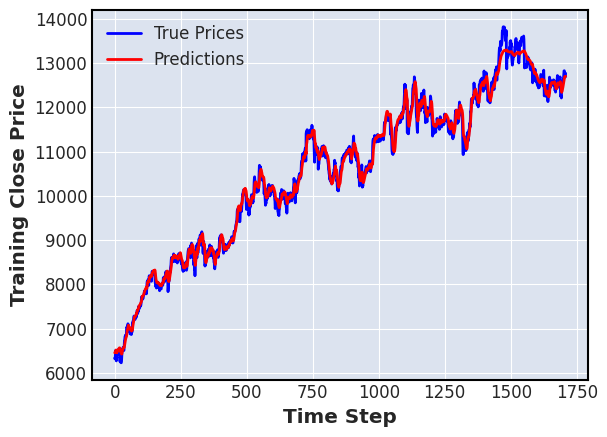

27/27 [==============================] - 0s 16ms/step


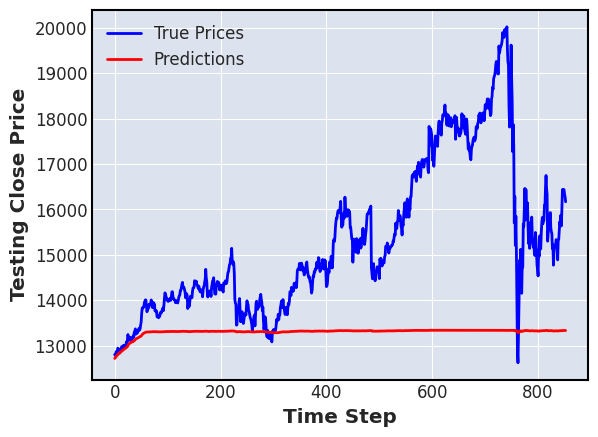

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
81/81 [==============================] - 7s 57ms/step - loss: 719.3218 - mae: 24.9559 - mse: 719.3218 - mape: 75.8884 - val_loss: 1256.8231 - val_mae: 34.9811 - val_mse: 1256.8231 - val_mape: 63.6275
Epoch 2/10
81/81 [==============================] - 4s 51ms/step - loss: 73.6492 - mae: 6.5215 - mse: 73.6492 - mape: 19.8351 - val_loss: 452.5689 - val_mae: 20.5112 - val_mse: 452.5689 - val_mape: 36.8468
Epoch 3/10
81/81 [==============================] - 4s 49ms/step - loss: 19.2329 - mae: 2.7783 - mse: 19.2329 - mape: 8.7991 - val_loss: 258.1723 - val_mae: 15.0622 - val_mse: 258.1723 - val_mape: 26.7633
Epoch 4/10
81/81 [==============================] - 4s 49ms/step - loss: 3.4604 - mae: 0.8873 - mse: 3.4604 - mape: 2.3357 - val_loss: 154.1461 - val_mae: 11.0884 - val_mse: 154.1461 - val_mape: 19.4063
Epoch 5/10
81/81 [==============================] - 4s 49ms/step - loss: 1.4979 - mae:

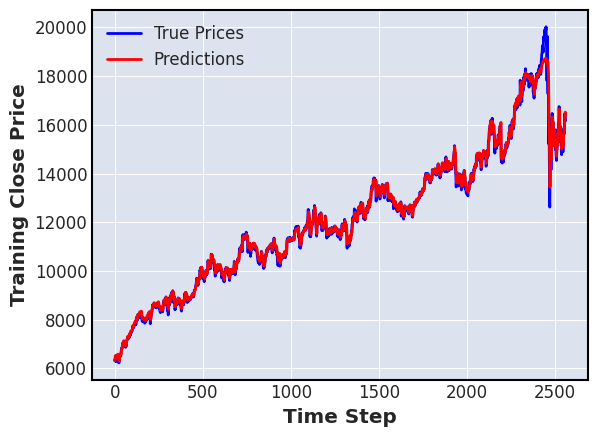

27/27 [==============================] - 0s 17ms/step


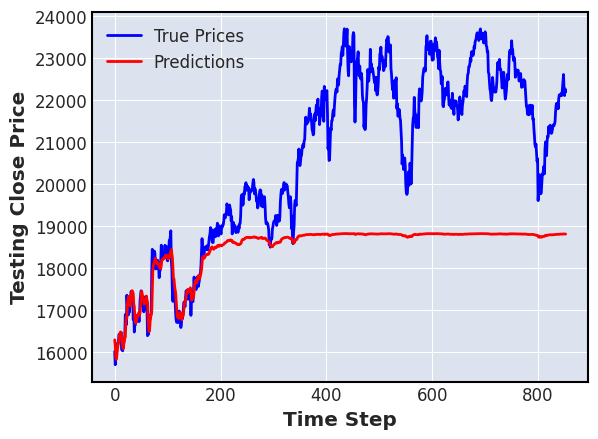

---------------------------------------------------------------
seed :  1
Epoch 1/10
81/81 [==============================] - 7s 58ms/step - loss: 697.3754 - mae: 24.6665 - mse: 697.3754 - mape: 75.1240 - val_loss: 1284.3574 - val_mae: 35.3533 - val_mse: 1284.3574 - val_mape: 64.2931
Epoch 2/10
81/81 [==============================] - 4s 51ms/step - loss: 77.0483 - mae: 6.8192 - mse: 77.0483 - mape: 21.0565 - val_loss: 478.3061 - val_mae: 21.1257 - val_mse: 478.3061 - val_mape: 37.9823
Epoch 3/10
81/81 [==============================] - 4s 49ms/step - loss: 17.6618 - mae: 2.5496 - mse: 17.6618 - mape: 7.7089 - val_loss: 243.3036 - val_mae: 14.5489 - val_mse: 243.3036 - val_mape: 25.8064
Epoch 4/10
81/81 [==============================] - 4s 48ms/step - loss: 3.2134 - mae: 0.8456 - mse: 3.2134 - mape: 2.2225 - val_loss: 147.5670 - val_mae: 10.8425 - val_mse: 147.5670 - val_mape: 18.9744
Epoch 5/10
81/81 [==============================] - 4s 49ms/step - loss: 1.4424 - mae: 0.6111 - mse: 

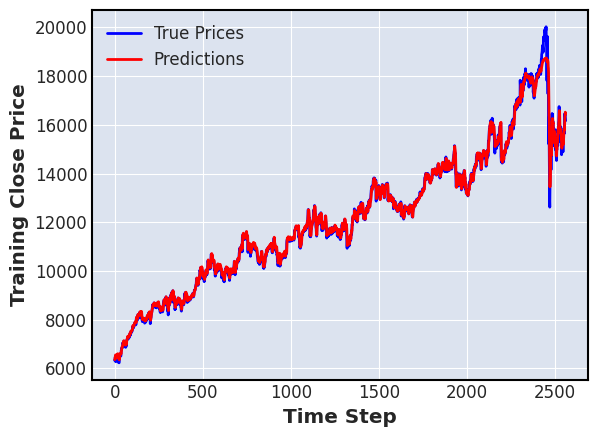

27/27 [==============================] - 0s 17ms/step


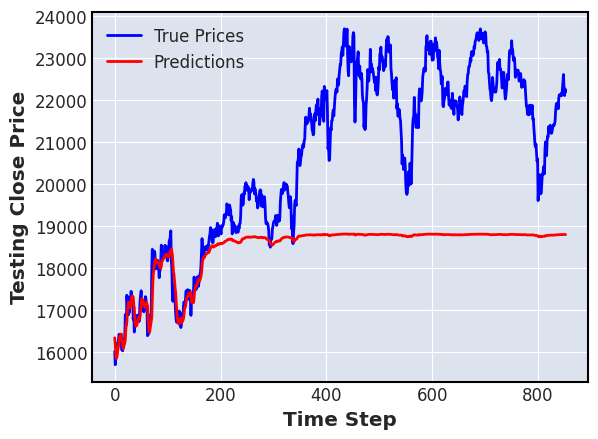

---------------------------------------------------------------
seed :  2
Epoch 1/10
81/81 [==============================] - 8s 57ms/step - loss: 888.1975 - mae: 28.6708 - mse: 888.1975 - mape: 88.3667 - val_loss: 1919.5981 - val_mae: 43.4327 - val_mse: 1919.5981 - val_mape: 79.2826
Epoch 2/10
81/81 [==============================] - 4s 51ms/step - loss: 168.4162 - mae: 10.4429 - mse: 168.4162 - mape: 30.7923 - val_loss: 530.6835 - val_mae: 22.3331 - val_mse: 530.6835 - val_mape: 40.2205
Epoch 3/10
81/81 [==============================] - 4s 52ms/step - loss: 27.8445 - mae: 3.7567 - mse: 27.8445 - mape: 12.0405 - val_loss: 335.9705 - val_mae: 17.4233 - val_mse: 335.9705 - val_mape: 31.1172
Epoch 4/10
81/81 [==============================] - 4s 49ms/step - loss: 7.2617 - mae: 1.4371 - mse: 7.2617 - mape: 3.8628 - val_loss: 203.0543 - val_mae: 13.0581 - val_mse: 203.0543 - val_mape: 23.0319
Epoch 5/10
81/81 [==============================] - 4s 53ms/step - loss: 2.7308 - mae: 0.8199 - m

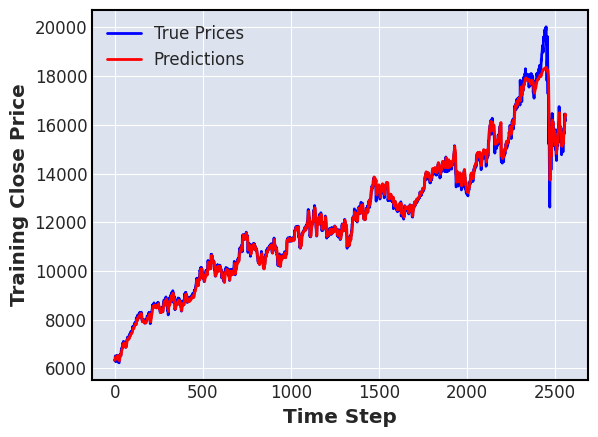

27/27 [==============================] - 0s 18ms/step


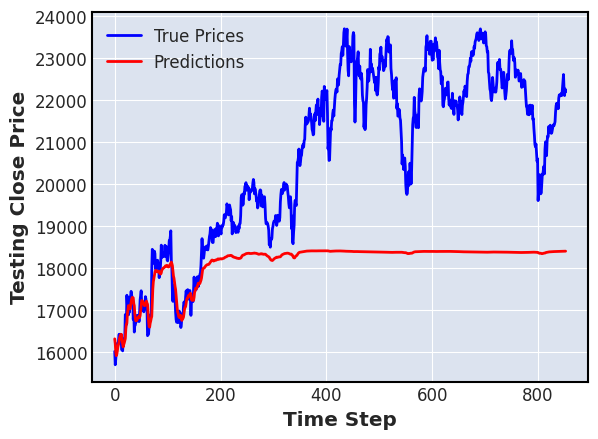

---------------------------------------------------------------
ticker_name :  AAPL Close  , length =  3415
kth split :  0
seed :  0
Epoch 1/10
27/27 [==============================] - 5s 85ms/step - loss: 149.3797 - mae: 11.6388 - mse: 149.3797 - mape: 87.3747 - val_loss: 434.2999 - val_mae: 20.4183 - val_mse: 434.2999 - val_mape: 85.1580
Epoch 2/10
27/27 [==============================] - 2s 61ms/step - loss: 62.9417 - mae: 6.8830 - mse: 62.9417 - mape: 48.5312 - val_loss: 233.4097 - val_mae: 14.6720 - val_mse: 233.4097 - val_mape: 60.1715
Epoch 3/10
27/27 [==============================] - 2s 59ms/step - loss: 15.6583 - mae: 3.1634 - mse: 15.6583 - mape: 23.7895 - val_loss: 124.1438 - val_mae: 10.3492 - val_mse: 124.1438 - val_mape: 41.5376
Epoch 4/10
27/27 [==============================] - 2s 60ms/step - loss: 11.0129 - mae: 2.7834 - mse: 11.0129 - mape: 23.3293 - val_loss: 121.6474 - val_mae: 10.2555 - val_mse: 121.6474 - val_mape: 41.1849
Epoch 5/10
27/27 [======================

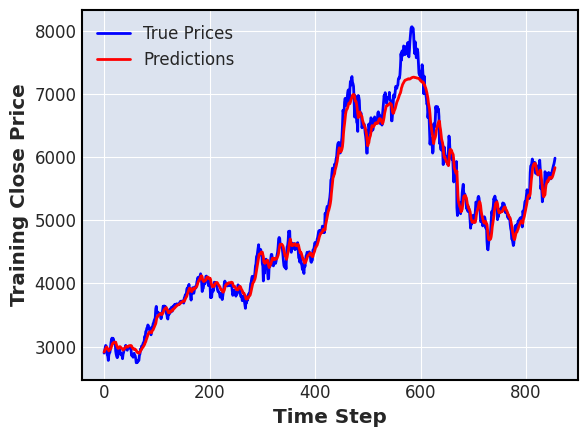

27/27 [==============================] - 0s 17ms/step


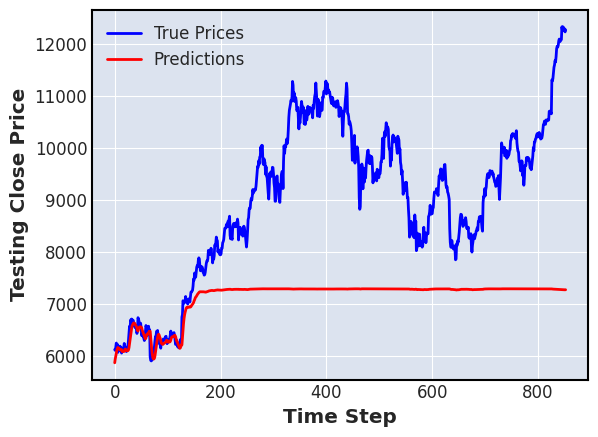

---------------------------------------------------------------
seed :  1
Epoch 1/10
27/27 [==============================] - 5s 92ms/step - loss: 139.4244 - mae: 11.2215 - mse: 139.4244 - mape: 84.0222 - val_loss: 419.5027 - val_mae: 20.0620 - val_mse: 419.5027 - val_mape: 83.6495
Epoch 2/10
27/27 [==============================] - 3s 98ms/step - loss: 61.6258 - mae: 6.8278 - mse: 61.6258 - mape: 48.1456 - val_loss: 231.1840 - val_mae: 14.6169 - val_mse: 231.1840 - val_mape: 59.9922
Epoch 3/10
27/27 [==============================] - 2s 69ms/step - loss: 16.3417 - mae: 3.2388 - mse: 16.3417 - mape: 24.2284 - val_loss: 124.2370 - val_mae: 10.3656 - val_mse: 124.2370 - val_mape: 41.6294
Epoch 4/10
27/27 [==============================] - 2s 65ms/step - loss: 12.0918 - mae: 2.9370 - mse: 12.0918 - mape: 24.5940 - val_loss: 125.9163 - val_mae: 10.4833 - val_mse: 125.9163 - val_mape: 42.2209
Epoch 5/10
27/27 [==============================] - 2s 61ms/step - loss: 8.8218 - mae: 2.3725 - mse

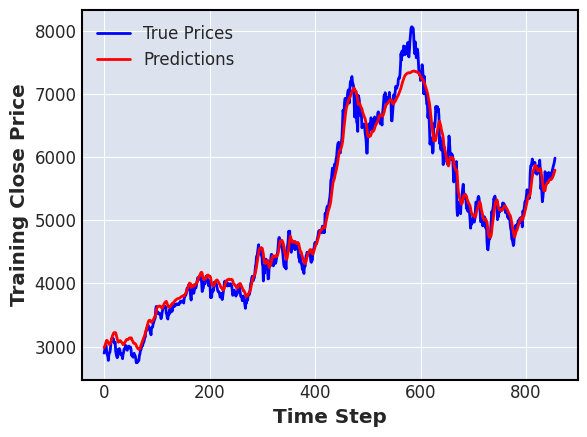

27/27 [==============================] - 0s 17ms/step


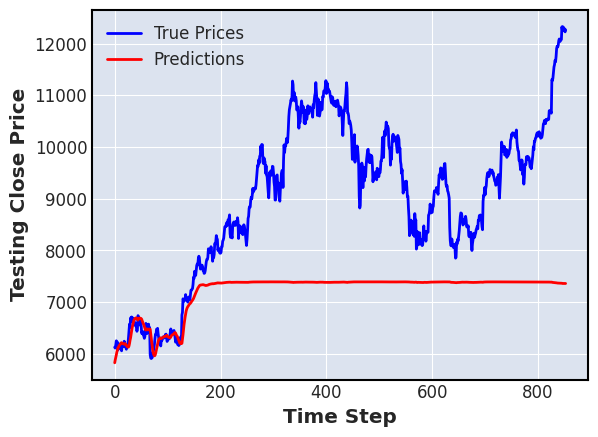

---------------------------------------------------------------
seed :  2
Epoch 1/10
27/27 [==============================] - 5s 90ms/step - loss: 167.0538 - mae: 12.4165 - mse: 167.0538 - mape: 93.6921 - val_loss: 509.8480 - val_mae: 22.2028 - val_mse: 509.8480 - val_mape: 92.9454
Epoch 2/10
27/27 [==============================] - 2s 64ms/step - loss: 104.2573 - mae: 9.4721 - mse: 104.2573 - mape: 69.5784 - val_loss: 338.1344 - val_mae: 17.9035 - val_mse: 338.1344 - val_mape: 74.2386
Epoch 3/10
27/27 [==============================] - 2s 63ms/step - loss: 34.4750 - mae: 4.7326 - mse: 34.4750 - mape: 32.3024 - val_loss: 170.1254 - val_mae: 12.3663 - val_mse: 170.1254 - val_mape: 50.2646
Epoch 4/10
27/27 [==============================] - 2s 73ms/step - loss: 12.9828 - mae: 2.9900 - mse: 12.9828 - mape: 24.2174 - val_loss: 121.6688 - val_mae: 10.2583 - val_mse: 121.6688 - val_mape: 41.1986
Epoch 5/10
27/27 [==============================] - 2s 61ms/step - loss: 11.7416 - mae: 2.8823 - 

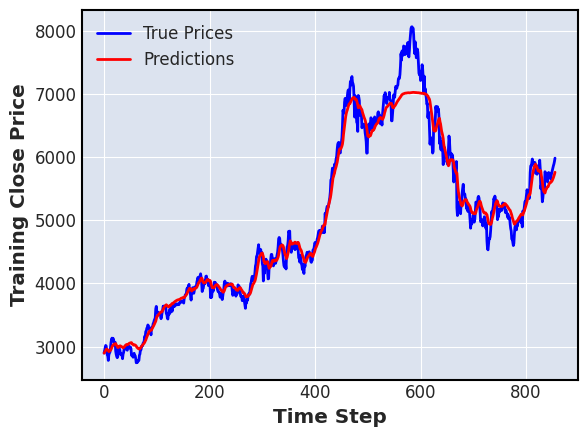

27/27 [==============================] - 0s 15ms/step


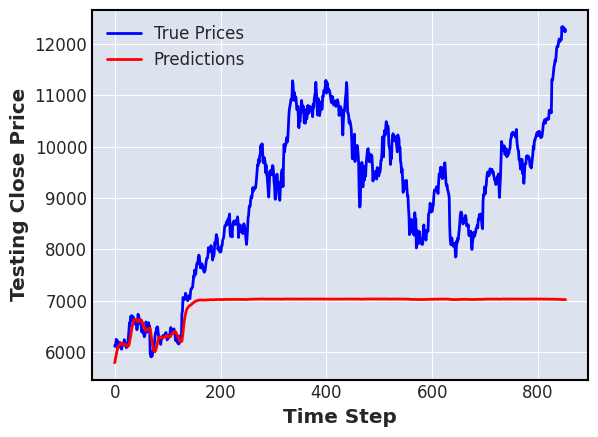

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
54/54 [==============================] - 6s 63ms/step - loss: 260.3027 - mae: 14.3575 - mse: 260.3027 - mape: 73.8470 - val_loss: 1883.4059 - val_mae: 40.4764 - val_mse: 1883.4059 - val_mape: 79.0844
Epoch 2/10
54/54 [==============================] - 3s 51ms/step - loss: 46.8027 - mae: 5.6525 - mse: 46.8027 - mape: 33.8359 - val_loss: 1171.6216 - val_mae: 30.4942 - val_mse: 1171.6216 - val_mape: 57.7569
Epoch 3/10
54/54 [==============================] - 3s 52ms/step - loss: 7.9857 - mae: 1.8242 - mse: 7.9857 - mape: 9.6194 - val_loss: 866.8469 - val_mae: 24.8224 - val_mse: 866.8469 - val_mape: 45.4412
Epoch 4/10
54/54 [==============================] - 3s 52ms/step - loss: 1.2991 - mae: 0.7111 - mse: 1.2991 - mape: 3.4041 - val_loss: 792.6496 - val_mae: 23.2053 - val_mse: 792.6496 - val_mape: 41.9155
Epoch 5/10
54/54 [==============================] - 3s 57ms/step - loss: 0.5824 - mae:

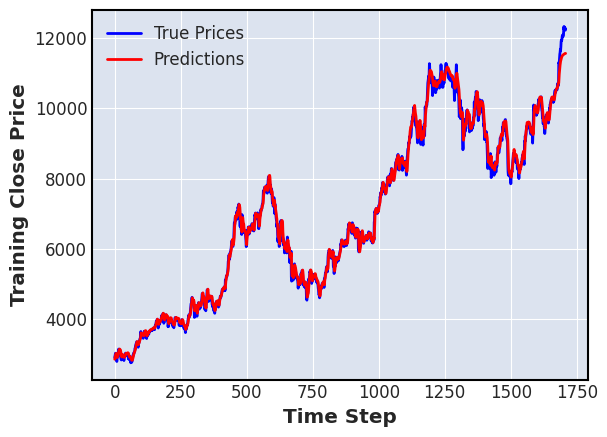

27/27 [==============================] - 0s 16ms/step


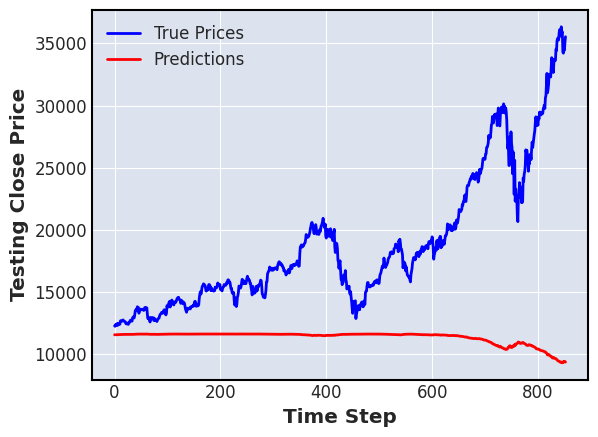

---------------------------------------------------------------
seed :  1
Epoch 1/10
54/54 [==============================] - 8s 67ms/step - loss: 257.2131 - mae: 14.3388 - mse: 257.2131 - mape: 73.6812 - val_loss: 1991.0659 - val_mae: 41.7237 - val_mse: 1991.0659 - val_mape: 81.6905
Epoch 2/10
54/54 [==============================] - 3s 51ms/step - loss: 56.3175 - mae: 6.1657 - mse: 56.3175 - mape: 35.0829 - val_loss: 1260.1844 - val_mae: 31.4287 - val_mse: 1260.1844 - val_mape: 59.3268
Epoch 3/10
54/54 [==============================] - 3s 54ms/step - loss: 11.1147 - mae: 2.2012 - mse: 11.1147 - mape: 12.0259 - val_loss: 938.7583 - val_mae: 25.6514 - val_mse: 938.7583 - val_mape: 46.8109
Epoch 4/10
54/54 [==============================] - 3s 63ms/step - loss: 0.8974 - mae: 0.5561 - mse: 0.8974 - mape: 2.6961 - val_loss: 822.4901 - val_mae: 23.2137 - val_mse: 822.4901 - val_mape: 41.5367
Epoch 5/10
54/54 [==============================] - 4s 65ms/step - loss: 0.4073 - mae: 0.4073 - ms

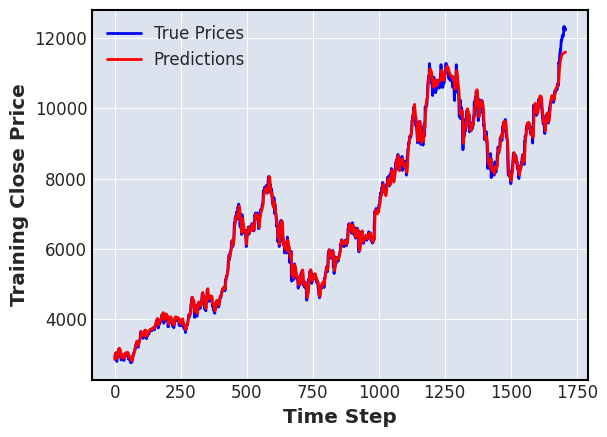

27/27 [==============================] - 1s 19ms/step


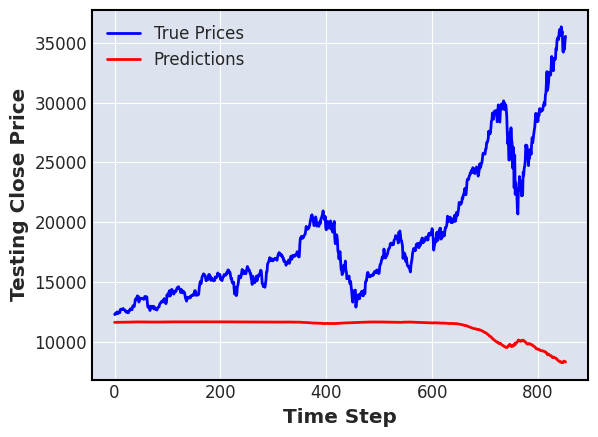

---------------------------------------------------------------
seed :  2
Epoch 1/10
54/54 [==============================] - 7s 79ms/step - loss: 316.3160 - mae: 16.4234 - mse: 316.3160 - mape: 86.8883 - val_loss: 2267.3323 - val_mae: 45.1060 - val_mse: 2267.3323 - val_mape: 89.2259
Epoch 2/10
54/54 [==============================] - 4s 68ms/step - loss: 93.2047 - mae: 7.8085 - mse: 93.2047 - mape: 40.3593 - val_loss: 1356.4362 - val_mae: 32.8884 - val_mse: 1356.4362 - val_mape: 62.4201
Epoch 3/10
54/54 [==============================] - 4s 71ms/step - loss: 25.4255 - mae: 3.9025 - mse: 25.4255 - mape: 23.2268 - val_loss: 1103.6831 - val_mae: 28.5723 - val_mse: 1103.6831 - val_mape: 52.9903
Epoch 4/10
54/54 [==============================] - 4s 65ms/step - loss: 2.4947 - mae: 0.9235 - mse: 2.4947 - mape: 4.2108 - val_loss: 906.8342 - val_mae: 24.6596 - val_mse: 906.8342 - val_mape: 44.4481
Epoch 5/10
54/54 [==============================] - 3s 65ms/step - loss: 0.7311 - mae: 0.5435 - 

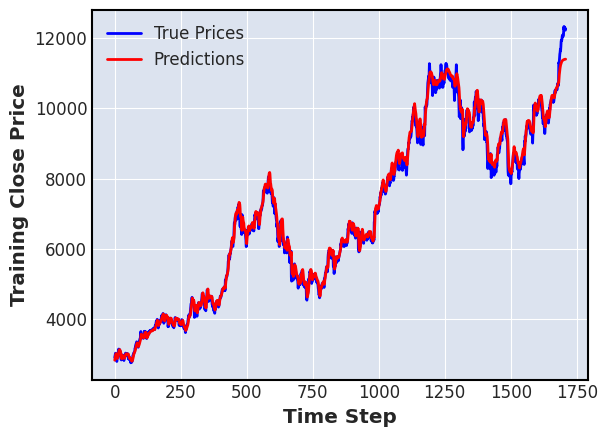

27/27 [==============================] - 1s 20ms/step


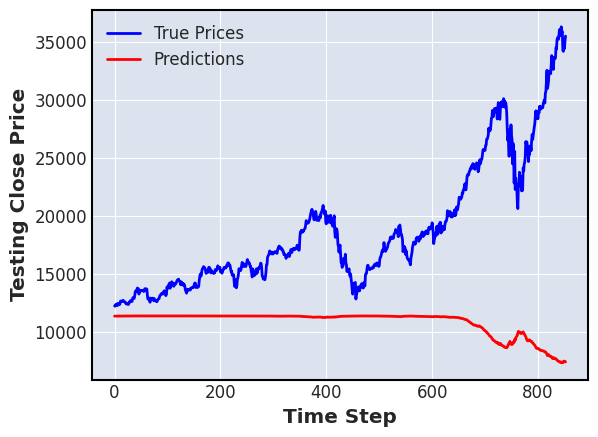

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
81/81 [==============================] - 9s 70ms/step - loss: 834.2917 - mae: 22.1045 - mse: 834.2917 - mape: 68.7952 - val_loss: 18417.8027 - val_mae: 133.5375 - val_mse: 18417.8027 - val_mape: 88.7854
Epoch 2/10
81/81 [==============================] - 5s 64ms/step - loss: 209.9107 - mae: 8.0004 - mse: 209.9107 - mape: 24.4788 - val_loss: 12745.2236 - val_mae: 110.1585 - val_mse: 12745.2236 - val_mape: 72.7441
Epoch 3/10
81/81 [==============================] - 5s 64ms/step - loss: 51.5788 - mae: 2.7052 - mse: 51.5788 - mape: 5.4312 - val_loss: 10352.7832 - val_mae: 98.5271 - val_mse: 10352.7832 - val_mape: 64.7126
Epoch 4/10
81/81 [==============================] - 5s 62ms/step - loss: 17.7135 - mae: 1.4486 - mse: 17.7135 - mape: 3.2110 - val_loss: 8796.5254 - val_mae: 90.0630 - val_mse: 8796.5254 - val_mape: 58.8430
Epoch 5/10
81/81 [==============================] - 5s 63ms/step - l

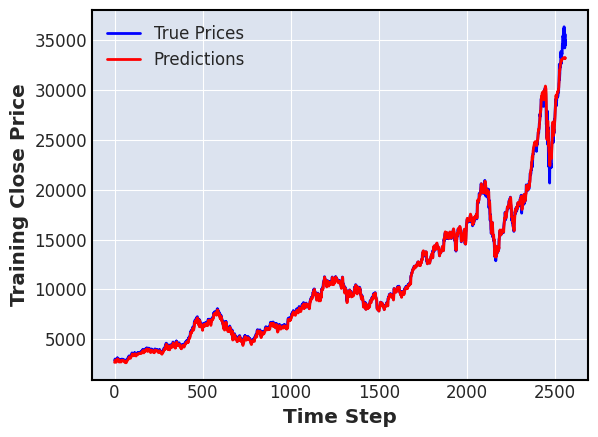

27/27 [==============================] - 1s 19ms/step


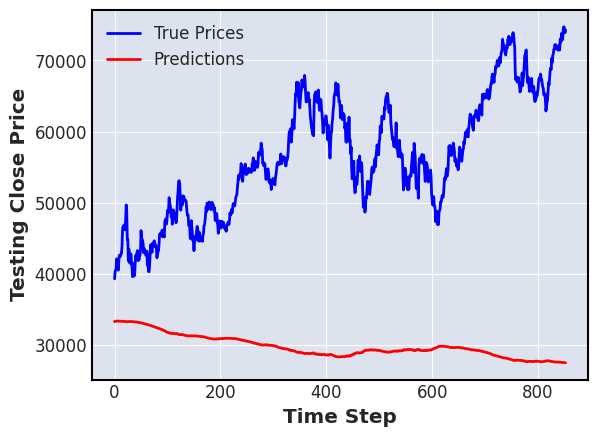

---------------------------------------------------------------
seed :  1
Epoch 1/10
81/81 [==============================] - 9s 75ms/step - loss: 805.5645 - mae: 21.7224 - mse: 805.5645 - mape: 67.8571 - val_loss: 18739.5918 - val_mae: 134.6824 - val_mse: 18739.5918 - val_mape: 89.5316
Epoch 2/10
81/81 [==============================] - 5s 64ms/step - loss: 189.9265 - mae: 7.2497 - mse: 189.9265 - mape: 21.6230 - val_loss: 13192.1777 - val_mae: 111.9067 - val_mse: 13192.1777 - val_mape: 73.8150
Epoch 3/10
81/81 [==============================] - 5s 63ms/step - loss: 44.3679 - mae: 2.3024 - mse: 44.3679 - mape: 4.4528 - val_loss: 10654.9463 - val_mae: 99.6746 - val_mse: 10654.9463 - val_mape: 65.3504
Epoch 4/10
81/81 [==============================] - 5s 65ms/step - loss: 15.1902 - mae: 1.2889 - mse: 15.1902 - mape: 2.8502 - val_loss: 8914.5225 - val_mae: 90.4804 - val_mse: 8914.5225 - val_mape: 59.0468
Epoch 5/10
81/81 [==============================] - 5s 65ms/step - loss: 6.4989 - m

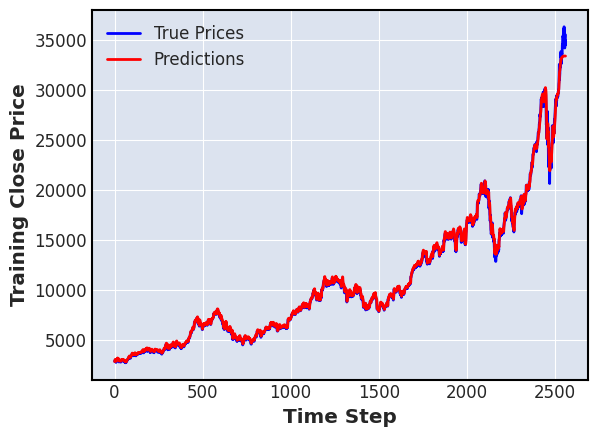

27/27 [==============================] - 1s 19ms/step


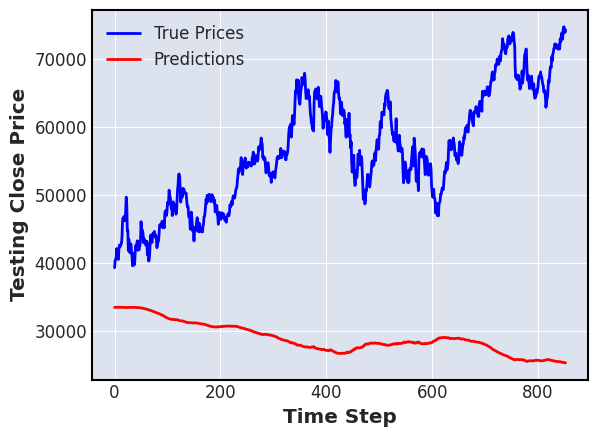

---------------------------------------------------------------
seed :  2
Epoch 1/10
81/81 [==============================] - 9s 72ms/step - loss: 924.9138 - mae: 24.1816 - mse: 924.9138 - mape: 77.2546 - val_loss: 20021.2559 - val_mae: 139.4670 - val_mse: 20021.2559 - val_mape: 92.8714
Epoch 2/10
81/81 [==============================] - 5s 64ms/step - loss: 269.1487 - mae: 10.1139 - mse: 269.1487 - mape: 33.3937 - val_loss: 14584.4541 - val_mae: 117.8942 - val_mse: 14584.4541 - val_mape: 77.8786
Epoch 3/10
81/81 [==============================] - 5s 61ms/step - loss: 66.2556 - mae: 2.8981 - mse: 66.2556 - mape: 5.4399 - val_loss: 11556.0771 - val_mae: 103.9986 - val_mse: 11556.0771 - val_mape: 68.2701
Epoch 4/10
81/81 [==============================] - 5s 63ms/step - loss: 24.9511 - mae: 1.5486 - mse: 24.9511 - mape: 3.0271 - val_loss: 9786.9775 - val_mae: 94.9782 - val_mse: 9786.9775 - val_mape: 62.0548
Epoch 5/10
81/81 [==============================] - 5s 66ms/step - loss: 11.0321 

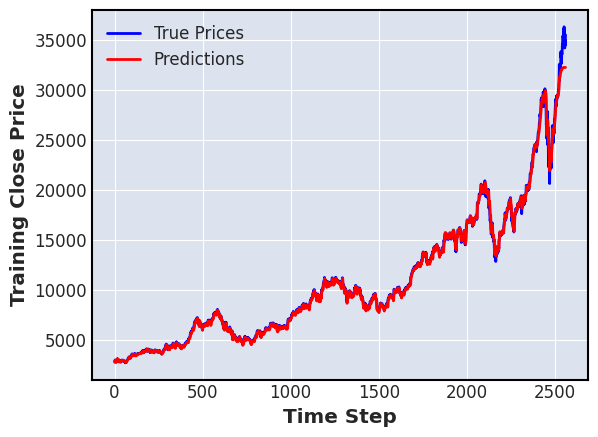

27/27 [==============================] - 1s 20ms/step


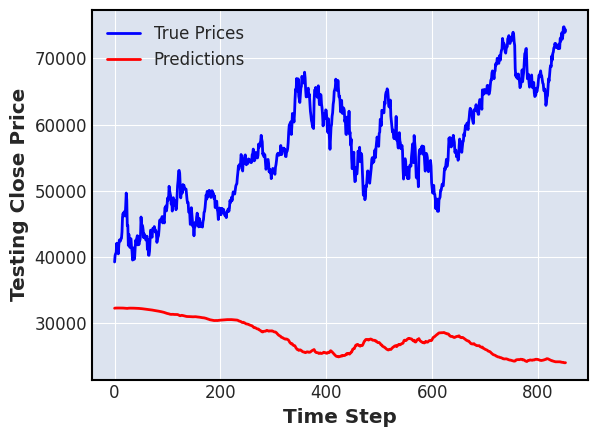

---------------------------------------------------------------
ticker_name :  MSFT Close  , length =  3415
kth split :  0
seed :  0
Epoch 1/10
27/27 [==============================] - 6s 101ms/step - loss: 464.8780 - mae: 21.3371 - mse: 464.8780 - mape: 94.1164 - val_loss: 1647.0868 - val_mae: 39.7677 - val_mse: 1647.0868 - val_mape: 93.0735
Epoch 2/10
27/27 [==============================] - 2s 81ms/step - loss: 284.9733 - mae: 16.5109 - mse: 284.9733 - mape: 72.4366 - val_loss: 1192.2874 - val_mae: 33.5189 - val_mse: 1192.2874 - val_mape: 77.8104
Epoch 3/10
27/27 [==============================] - 2s 82ms/step - loss: 86.0690 - mae: 8.4054 - mse: 86.0690 - mape: 36.0857 - val_loss: 669.8350 - val_mae: 24.5011 - val_mse: 669.8350 - val_mape: 55.8858
Epoch 4/10
27/27 [==============================] - 2s 76ms/step - loss: 11.5580 - mae: 2.7086 - mse: 11.5580 - mape: 11.5685 - val_loss: 452.6794 - val_mae: 19.6253 - val_mse: 452.6794 - val_mape: 44.0975
Epoch 5/10
27/27 [==============

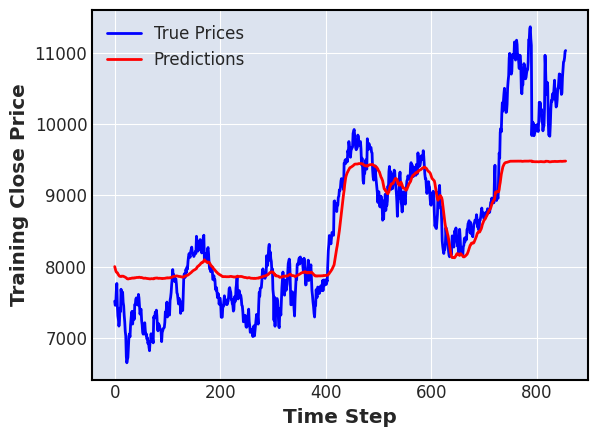

27/27 [==============================] - 1s 20ms/step


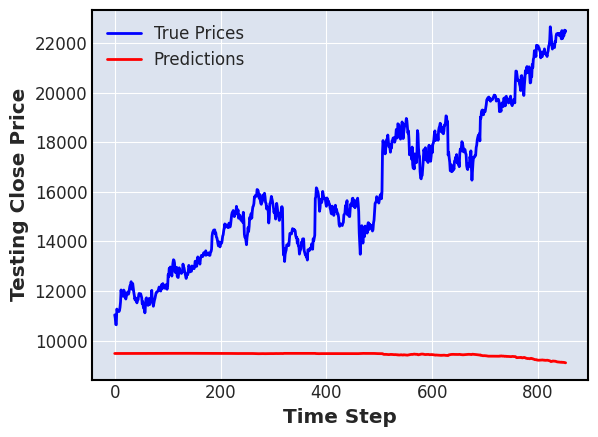

---------------------------------------------------------------
seed :  1
Epoch 1/10
27/27 [==============================] - 6s 105ms/step - loss: 441.0093 - mae: 20.7719 - mse: 441.0093 - mape: 91.5690 - val_loss: 1612.4283 - val_mae: 39.3285 - val_mse: 1612.4283 - val_mape: 92.0092
Epoch 2/10
27/27 [==============================] - 2s 81ms/step - loss: 287.0061 - mae: 16.5927 - mse: 287.0061 - mape: 72.7914 - val_loss: 1237.7499 - val_mae: 34.1509 - val_mse: 1237.7498 - val_mape: 79.2832
Epoch 3/10
27/27 [==============================] - 2s 76ms/step - loss: 108.7897 - mae: 9.7176 - mse: 108.7897 - mape: 41.8916 - val_loss: 766.4582 - val_mae: 26.3827 - val_mse: 766.4582 - val_mape: 60.4437
Epoch 4/10
27/27 [==============================] - 2s 81ms/step - loss: 19.4809 - mae: 3.4684 - mse: 19.4809 - mape: 14.4035 - val_loss: 495.6771 - val_mae: 20.6045 - val_mse: 495.6771 - val_mape: 46.3875
Epoch 5/10
27/27 [==============================] - 2s 79ms/step - loss: 8.8774 - mae: 2.

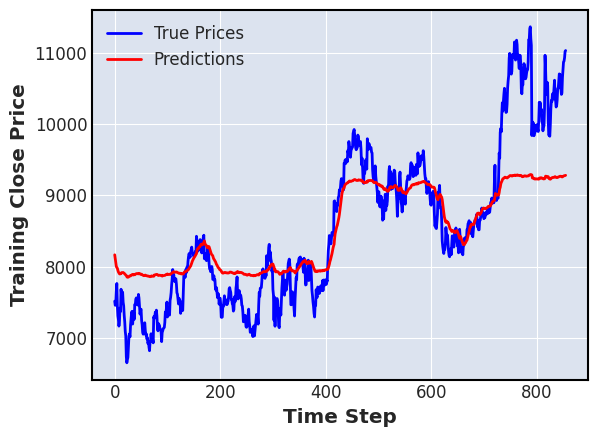

27/27 [==============================] - 1s 20ms/step


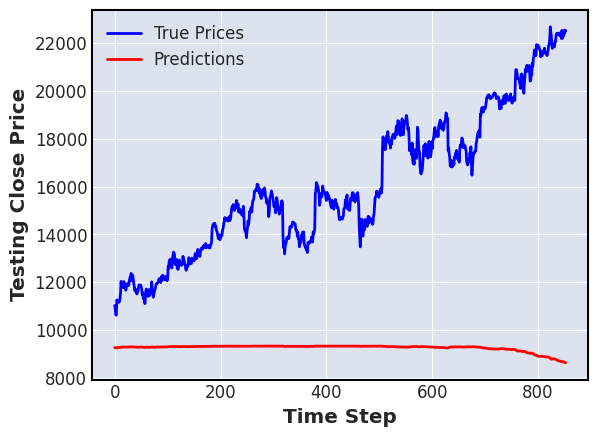

---------------------------------------------------------------
seed :  2
Epoch 1/10
27/27 [==============================] - 6s 105ms/step - loss: 492.5501 - mae: 21.9938 - mse: 492.5501 - mape: 97.0463 - val_loss: 1772.7823 - val_mae: 41.3462 - val_mse: 1772.7823 - val_mape: 96.9729
Epoch 2/10
27/27 [==============================] - 2s 78ms/step - loss: 407.6385 - mae: 19.9576 - mse: 407.6385 - mape: 87.9301 - val_loss: 1557.9211 - val_mae: 38.6133 - val_mse: 1557.9211 - val_mape: 90.2355
Epoch 3/10
27/27 [==============================] - 2s 82ms/step - loss: 238.2493 - mae: 14.9969 - mse: 238.2493 - mape: 65.5588 - val_loss: 1078.9606 - val_mae: 31.7927 - val_mse: 1078.9606 - val_mape: 73.6431
Epoch 4/10
27/27 [==============================] - 2s 75ms/step - loss: 72.2949 - mae: 7.6568 - mse: 72.2949 - mape: 32.7159 - val_loss: 652.5938 - val_mae: 24.1888 - val_mse: 652.5938 - val_mape: 55.1852
Epoch 5/10
27/27 [==============================] - 2s 77ms/step - loss: 12.5237 - mae

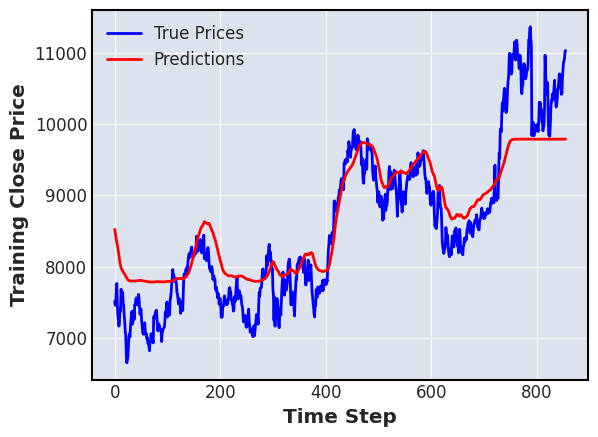

27/27 [==============================] - 1s 20ms/step


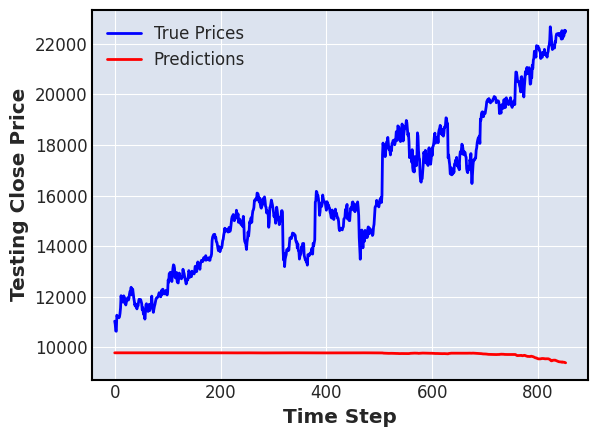

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
54/54 [==============================] - 7s 79ms/step - loss: 985.1968 - mae: 28.9308 - mse: 985.1968 - mape: 87.0303 - val_loss: 12042.8828 - val_mae: 103.1387 - val_mse: 12042.8828 - val_mape: 92.1533
Epoch 2/10
54/54 [==============================] - 4s 67ms/step - loss: 308.9658 - mae: 13.5907 - mse: 308.9658 - mape: 36.5071 - val_loss: 8712.7070 - val_mae: 84.4130 - val_mse: 8712.7070 - val_mape: 72.6828
Epoch 3/10
54/54 [==============================] - 4s 66ms/step - loss: 128.1877 - mae: 9.7146 - mse: 128.1877 - mape: 31.7565 - val_loss: 7990.5171 - val_mae: 80.0502 - val_mse: 7990.5171 - val_mape: 68.3253
Epoch 4/10
54/54 [==============================] - 4s 71ms/step - loss: 60.3932 - mae: 5.5376 - mse: 60.3932 - mape: 16.2723 - val_loss: 6983.5562 - val_mae: 72.9073 - val_mse: 6983.5562 - val_mape: 60.8105
Epoch 5/10
54/54 [==============================] - 4s 70ms/step - l

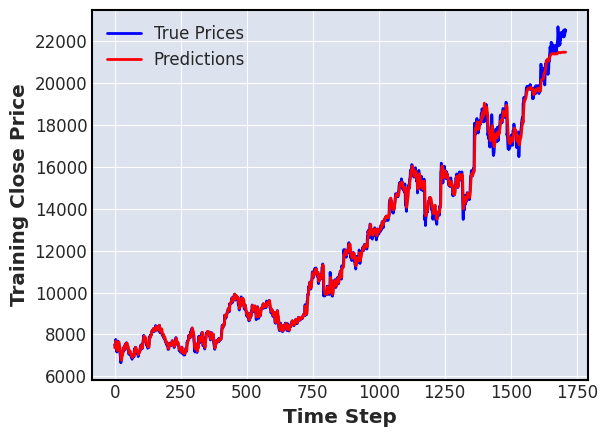

27/27 [==============================] - 1s 20ms/step


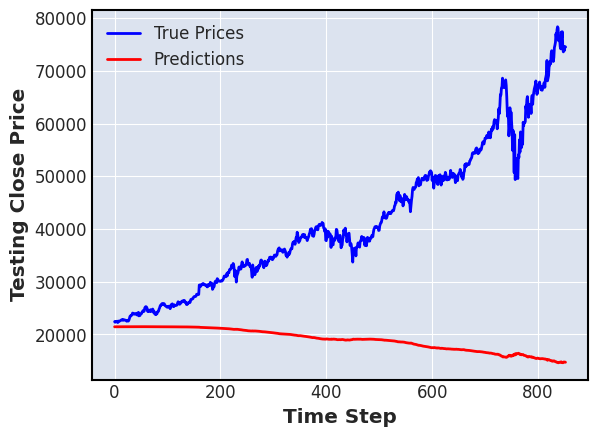

---------------------------------------------------------------
seed :  1
Epoch 1/10
54/54 [==============================] - 7s 79ms/step - loss: 966.1664 - mae: 28.5537 - mse: 966.1664 - mape: 85.5551 - val_loss: 12264.7207 - val_mae: 104.1263 - val_mse: 12264.7207 - val_mape: 93.0459
Epoch 2/10
54/54 [==============================] - 4s 68ms/step - loss: 331.3336 - mae: 14.2728 - mse: 331.3336 - mape: 38.7016 - val_loss: 9186.3555 - val_mae: 86.6450 - val_mse: 9186.3555 - val_mape: 74.4809
Epoch 3/10
54/54 [==============================] - 4s 69ms/step - loss: 128.3903 - mae: 9.7535 - mse: 128.3903 - mape: 32.1390 - val_loss: 8541.3291 - val_mae: 82.6482 - val_mse: 8541.3291 - val_mape: 70.3668
Epoch 4/10
54/54 [==============================] - 4s 69ms/step - loss: 50.9478 - mae: 4.7699 - mse: 50.9478 - mape: 13.4012 - val_loss: 7323.0410 - val_mae: 74.3218 - val_mse: 7323.0410 - val_mape: 61.6809
Epoch 5/10
54/54 [==============================] - 4s 69ms/step - loss: 8.1891 - m

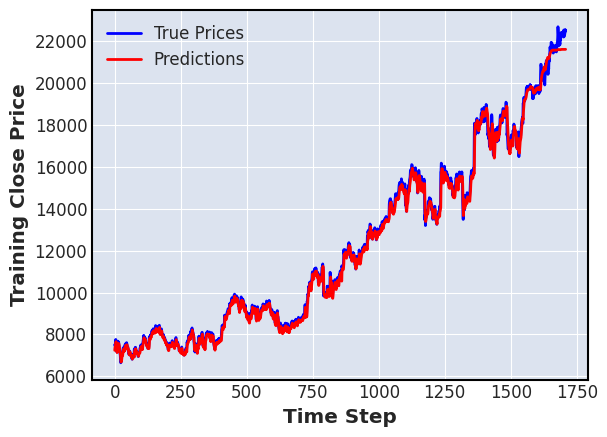

27/27 [==============================] - 1s 20ms/step


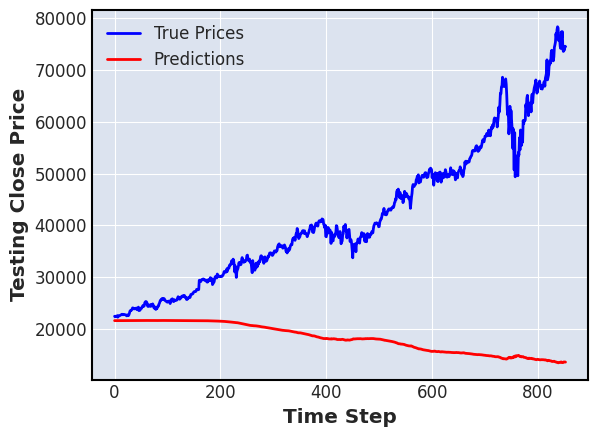

---------------------------------------------------------------
seed :  2
Epoch 1/10
54/54 [==============================] - 7s 82ms/step - loss: 1091.7079 - mae: 30.8688 - mse: 1091.7079 - mape: 93.9115 - val_loss: 12863.7607 - val_mae: 107.1842 - val_mse: 12863.7607 - val_mape: 96.3559
Epoch 2/10
54/54 [==============================] - 4s 67ms/step - loss: 549.1821 - mae: 19.4454 - mse: 549.1821 - mape: 54.2275 - val_loss: 10301.4502 - val_mae: 92.8548 - val_mse: 10301.4502 - val_mape: 80.7095
Epoch 3/10
54/54 [==============================] - 4s 66ms/step - loss: 135.8314 - mae: 9.5012 - mse: 135.8314 - mape: 29.3778 - val_loss: 8742.1318 - val_mae: 83.2846 - val_mse: 8742.1318 - val_mape: 70.6991
Epoch 4/10
54/54 [==============================] - 4s 71ms/step - loss: 82.8847 - mae: 7.1688 - mse: 82.8847 - mape: 22.5890 - val_loss: 8093.9912 - val_mae: 78.6606 - val_mse: 8093.9912 - val_mape: 65.7027
Epoch 5/10
54/54 [==============================] - 4s 66ms/step - loss: 16.174

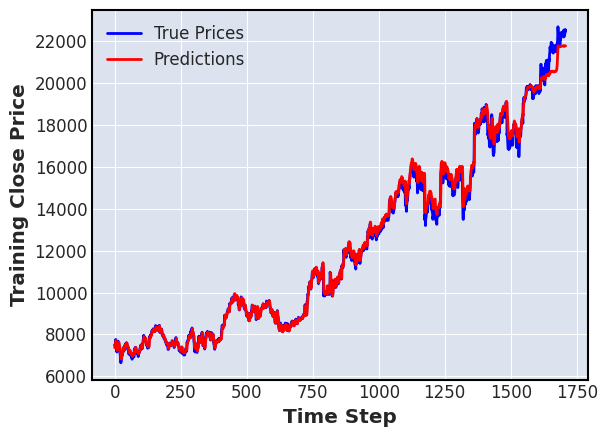

27/27 [==============================] - 1s 19ms/step


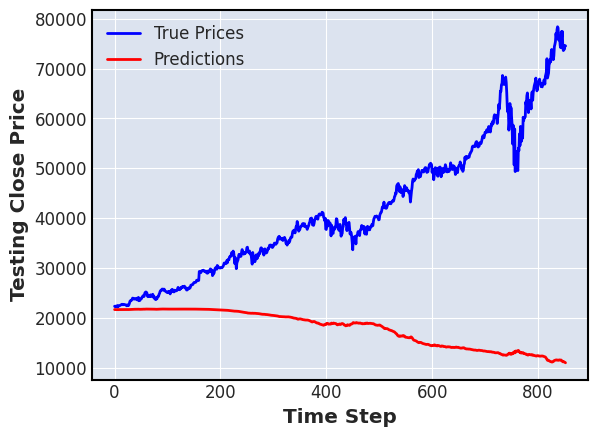

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
81/81 [==============================] - 9s 70ms/step - loss: 4633.0747 - mae: 51.1886 - mse: 4633.0747 - mape: 79.2325 - val_loss: 66606.4609 - val_mae: 253.9216 - val_mse: 66606.4609 - val_mape: 92.9494
Epoch 2/10
81/81 [==============================] - 5s 62ms/step - loss: 2320.1707 - mae: 31.6498 - mse: 2320.1707 - mape: 48.9892 - val_loss: 49865.5664 - val_mae: 218.6655 - val_mse: 49865.5664 - val_mape: 79.7067
Epoch 3/10
81/81 [==============================] - 5s 63ms/step - loss: 1020.9162 - mae: 15.4746 - mse: 1020.9162 - mape: 16.1597 - val_loss: 35595.3359 - val_mae: 183.0924 - val_mse: 35595.3359 - val_mape: 66.2754
Epoch 4/10
81/81 [==============================] - 5s 62ms/step - loss: 389.0538 - mae: 7.5776 - mse: 389.0538 - mape: 6.2693 - val_loss: 28129.3125 - val_mae: 161.5479 - val_mse: 28129.3125 - val_mape: 58.1729
Epoch 5/10
81/81 [==============================] -

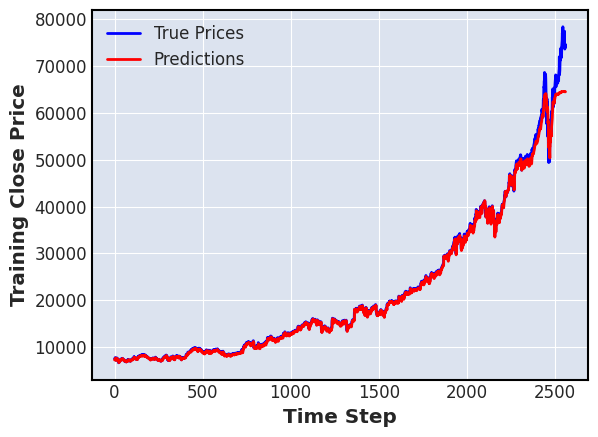

27/27 [==============================] - 1s 19ms/step


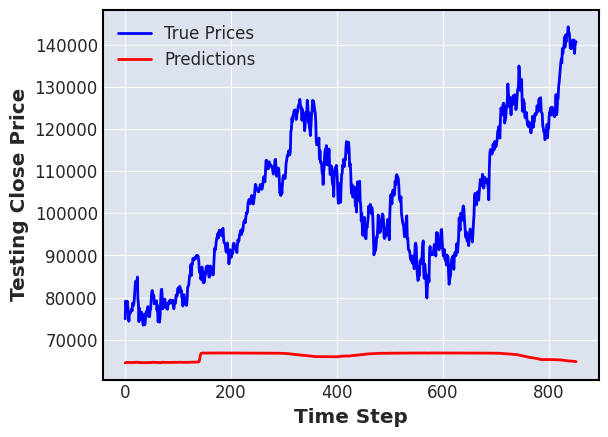

---------------------------------------------------------------
seed :  1
Epoch 1/10
81/81 [==============================] - 8s 69ms/step - loss: 4599.2734 - mae: 51.0333 - mse: 4599.2734 - mape: 79.0416 - val_loss: 67015.7031 - val_mae: 254.6776 - val_mse: 67015.7031 - val_mape: 93.2188
Epoch 2/10
81/81 [==============================] - 5s 63ms/step - loss: 2261.5403 - mae: 31.0164 - mse: 2261.5403 - mape: 48.3823 - val_loss: 48091.5234 - val_mae: 214.4364 - val_mse: 48091.5234 - val_mape: 78.0753
Epoch 3/10
81/81 [==============================] - 5s 62ms/step - loss: 845.7572 - mae: 14.1565 - mse: 845.7572 - mape: 16.5560 - val_loss: 33528.2578 - val_mae: 177.0561 - val_mse: 33528.2578 - val_mape: 63.9317
Epoch 4/10
81/81 [==============================] - 5s 62ms/step - loss: 290.1941 - mae: 6.3689 - mse: 290.1941 - mape: 5.5615 - val_loss: 26626.9082 - val_mae: 155.3694 - val_mse: 26626.9082 - val_mape: 55.5644
Epoch 5/10
81/81 [==============================] - 5s 62ms/step - l

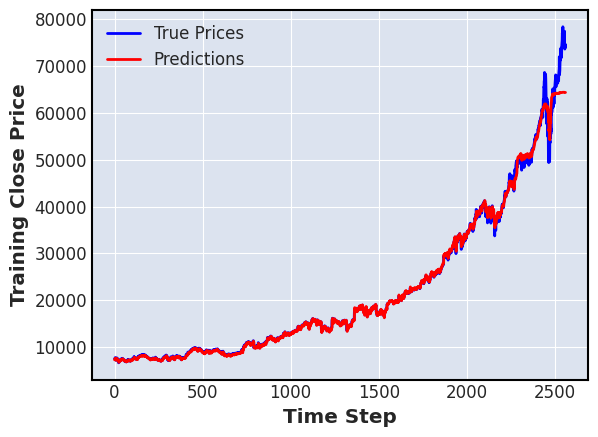

27/27 [==============================] - 1s 20ms/step


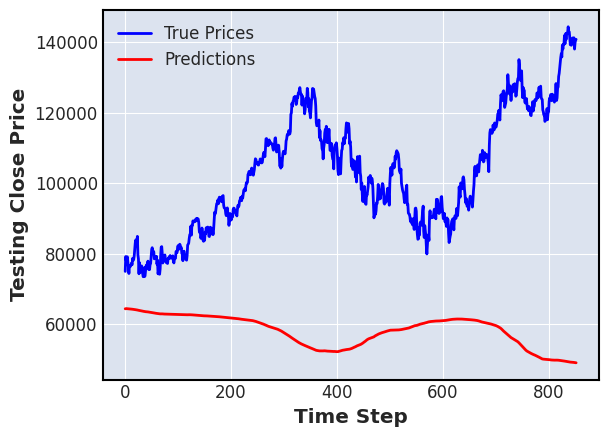

---------------------------------------------------------------
seed :  2
Epoch 1/10
81/81 [==============================] - 8s 70ms/step - loss: 4878.4712 - mae: 54.1888 - mse: 4878.4712 - mape: 87.8113 - val_loss: 71036.4531 - val_mae: 262.6272 - val_mse: 71036.4531 - val_mape: 96.2777
Epoch 2/10
81/81 [==============================] - 5s 63ms/step - loss: 2736.7649 - mae: 33.9189 - mse: 2736.7649 - mape: 45.7042 - val_loss: 52921.1211 - val_mae: 225.4892 - val_mse: 52921.1211 - val_mape: 82.2652
Epoch 3/10
81/81 [==============================] - 5s 63ms/step - loss: 1290.1163 - mae: 19.2714 - mse: 1290.1163 - mape: 24.1642 - val_loss: 40317.8398 - val_mae: 195.4159 - val_mse: 40317.8398 - val_mape: 70.8890
Epoch 4/10
81/81 [==============================] - 5s 63ms/step - loss: 543.5510 - mae: 9.2393 - mse: 543.5510 - mape: 7.2952 - val_loss: 31161.9141 - val_mae: 170.1026 - val_mse: 31161.9141 - val_mape: 61.2841
Epoch 5/10
81/81 [==============================] - 5s 61ms/step -

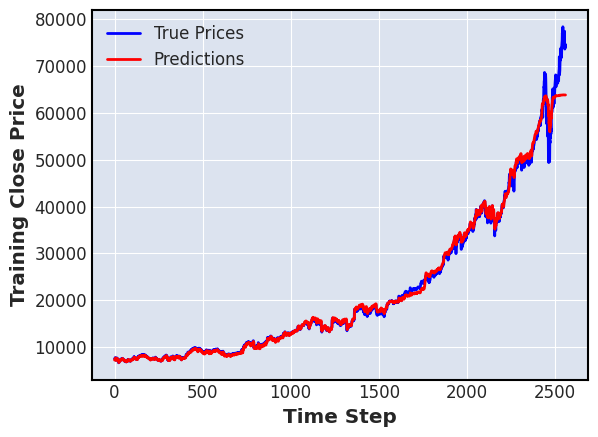

27/27 [==============================] - 1s 21ms/step


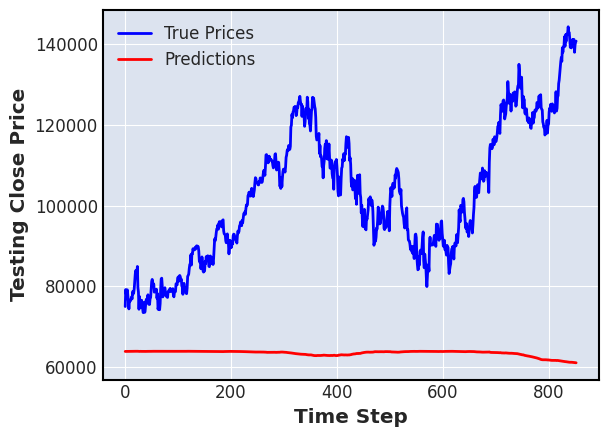

---------------------------------------------------------------


In [34]:
number_of_runs = 0
for ticker_index, ticker_name in enumerate(My_Tickers_SP500):
    full_data = x_tickers_sp500_[ticker_index]
    target = y_tickers_sp500_[ticker_index]
    print('ticker_name : ' ,ticker_name[0], ticker_name[1] , ' , length = ', len(full_data))
    # Time Series Split
    for j, (train_index, test_index) in enumerate(tss.split(full_data)):
        print('kth split : ', j)
        # Different Seeds
        for new_seed in range(3):
            print('seed : ', new_seed)
            seed_value = new_seed
            random.seed(seed_value)
            np.random.seed(seed_value)
            tf.random.set_seed(seed_value)
            utils.set_random_seed(seed_value)

            number_of_runs += 1
            full_data = np.reshape(full_data, (full_data.shape[0], full_data.shape[1], 1))
        
            X_train, X_val = full_data[train_index], full_data[test_index]
            y_train, y_val = target[train_index], target[test_index]

            lstm_model = StockPredictionModel(n_steps=full_data.shape[1], model='LSTM')
            lstm_model.fit(X_train, y_train, X_val, y_val, epoch=10)
            
            train_pred = lstm_model.predict(X_train)
            train_pred = scaler.inverse_transform(train_pred.reshape(-1, 1))
            y_train_ = scaler.inverse_transform(y_train.reshape(-1, 1))
            plot_results(train_pred, y_train_, 'Training')
            test_pred = lstm_model.predict(X_val)
            test_pred = scaler.inverse_transform(test_pred.reshape(-1, 1))
            y_val_ = scaler.inverse_transform(y_val.reshape(-1, 1))
            plot_results(test_pred, y_val_, 'Testing')  
            print('---------------------------------------------------------------')

#### Scales data

ticker_name :  AMZN Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 4s 45ms/step - loss: 3.8841e-05 - mae: 0.0048 - mse: 3.8841e-05 - mape: 7727.7075 - val_loss: 5.7232e-04 - val_mae: 0.0201 - val_mse: 5.7232e-04 - val_mape: 36.2949
Epoch 2/10
28/28 [==============================] - 1s 28ms/step - loss: 6.8174e-06 - mae: 0.0021 - mse: 6.8174e-06 - mape: 7086.1436 - val_loss: 3.1870e-05 - val_mae: 0.0040 - val_mse: 3.1870e-05 - val_mape: 6.9436
Epoch 3/10
28/28 [==============================] - 1s 23ms/step - loss: 1.5045e-06 - mae: 9.7040e-04 - mse: 1.5045e-06 - mape: 2828.9661 - val_loss: 3.4305e-05 - val_mae: 0.0040 - val_mse: 3.4305e-05 - val_mape: 6.7240
Epoch 4/10
28/28 [==============================] - 1s 23ms/step - loss: 1.2583e-06 - mae: 8.7167e-04 - mse: 1.2583e-06 - mape: 2341.1514 - val_loss: 4.6268e-05 - val_mae: 0.0048 - val_mse: 4.6268e-05 - val_mape: 7.9817
Epoch 5/10
28/28 [==============================] - 1s 22m

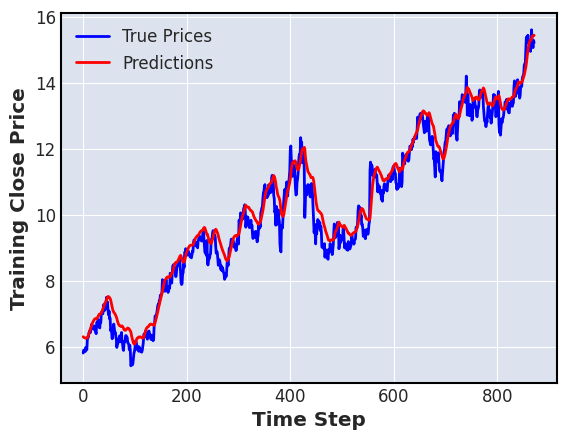

28/28 [==============================] - 0s 6ms/step


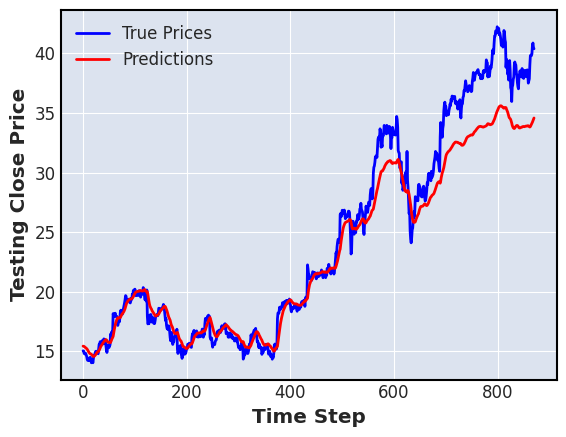

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 4s 48ms/step - loss: 4.6295e-05 - mae: 0.0054 - mse: 4.6295e-05 - mape: 10575.7314 - val_loss: 8.6575e-04 - val_mae: 0.0249 - val_mse: 8.6575e-04 - val_mape: 45.5105
Epoch 2/10
28/28 [==============================] - 1s 22ms/step - loss: 1.1709e-05 - mae: 0.0027 - mse: 1.1709e-05 - mape: 7709.9478 - val_loss: 1.6747e-04 - val_mae: 0.0099 - val_mse: 1.6747e-04 - val_mape: 16.6023
Epoch 3/10
28/28 [==============================] - 1s 23ms/step - loss: 2.4879e-06 - mae: 0.0013 - mse: 2.4879e-06 - mape: 1243.3958 - val_loss: 9.8337e-05 - val_mae: 0.0067 - val_mse: 9.8337e-05 - val_mape: 10.2697
Epoch 4/10
28/28 [==============================] - 1s 22ms/step - loss: 1.4713e-06 - mae: 9.6049e-04 - mse: 1.4713e-06 - mape: 2710.1812 - val_loss: 9.6191e-05 - val_mae: 0.0067 - val_mse: 9.6191e-05 - val_mape: 10.1622
Epoch 5/10
28/28 [==============================] - 1

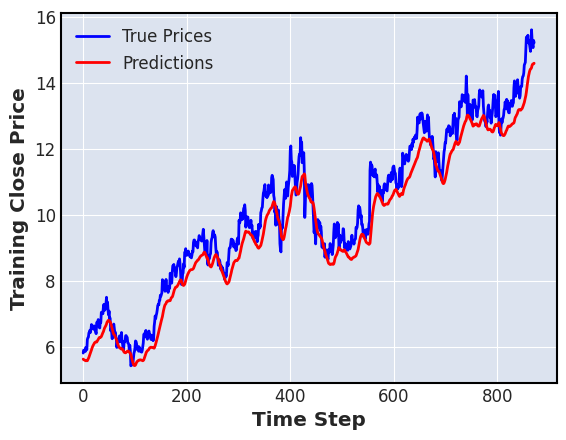

28/28 [==============================] - 0s 5ms/step


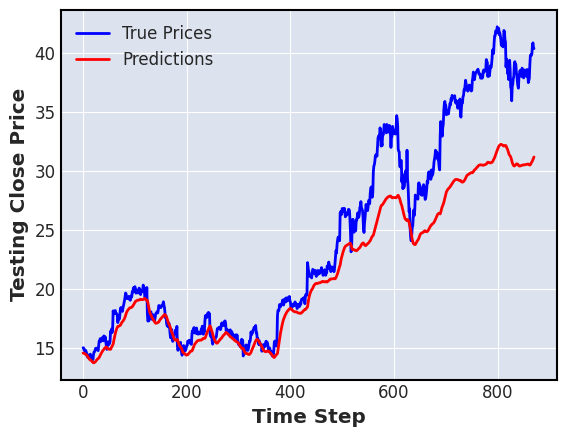

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 4s 44ms/step - loss: 5.0814e-05 - mae: 0.0056 - mse: 5.0814e-05 - mape: 16090.3203 - val_loss: 0.0015 - val_mae: 0.0334 - val_mse: 0.0015 - val_mape: 62.6777
Epoch 2/10
28/28 [==============================] - 1s 28ms/step - loss: 2.1900e-05 - mae: 0.0038 - mse: 2.1900e-05 - mape: 12727.5137 - val_loss: 4.5914e-04 - val_mae: 0.0177 - val_mse: 4.5914e-04 - val_mape: 31.6189
Epoch 3/10
28/28 [==============================] - 1s 23ms/step - loss: 4.5115e-06 - mae: 0.0017 - mse: 4.5115e-06 - mape: 2739.1467 - val_loss: 1.2519e-05 - val_mae: 0.0028 - val_mse: 1.2519e-05 - val_mape: 6.6918
Epoch 4/10
28/28 [==============================] - 1s 22ms/step - loss: 2.2869e-06 - mae: 0.0012 - mse: 2.2869e-06 - mape: 3281.8994 - val_loss: 2.8579e-05 - val_mae: 0.0041 - val_mse: 2.8579e-05 - val_mape: 7.3717
Epoch 5/10
28/28 [==============================] - 1s 28ms/step -

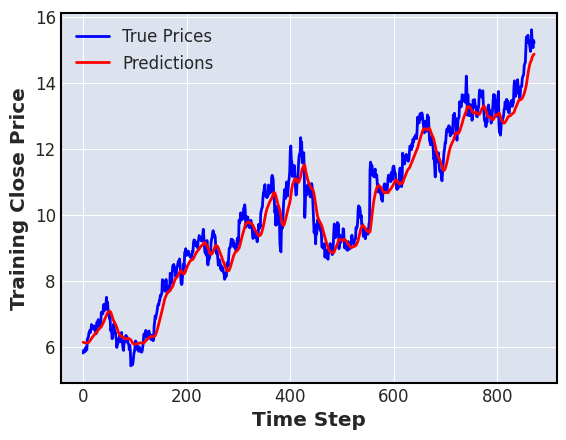

28/28 [==============================] - 0s 6ms/step


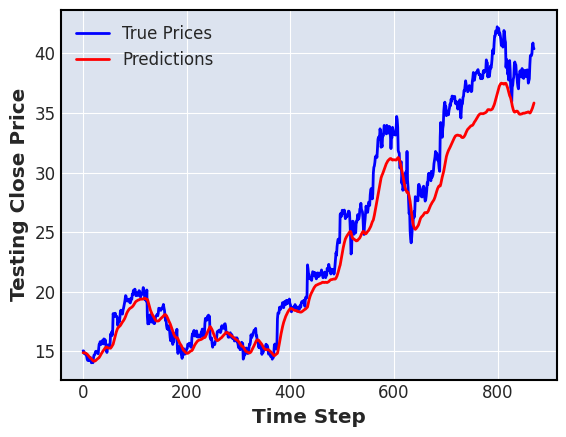

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 4s 30ms/step - loss: 1.7491e-04 - mae: 0.0075 - mse: 1.7491e-04 - mape: 1732.2703 - val_loss: 5.3813e-04 - val_mae: 0.0171 - val_mse: 5.3813e-04 - val_mape: 7.4032
Epoch 2/10
55/55 [==============================] - 1s 19ms/step - loss: 3.8658e-06 - mae: 0.0014 - mse: 3.8658e-06 - mape: 1348.9084 - val_loss: 4.4505e-04 - val_mae: 0.0151 - val_mse: 4.4505e-04 - val_mape: 6.5326
Epoch 3/10
55/55 [==============================] - 1s 18ms/step - loss: 3.8812e-06 - mae: 0.0014 - mse: 3.8812e-06 - mape: 1135.4015 - val_loss: 5.5576e-04 - val_mae: 0.0174 - val_mse: 5.5576e-04 - val_mape: 7.4899
Epoch 4/10
55/55 [==============================] - 1s 19ms/step - loss: 3.9976e-06 - mae: 0.0014 - mse: 3.9976e-06 - mape: 937.0517 - val_loss: 5.8550e-04 - val_mae: 0.0180 - val_mse: 5.8550e-04 - val_mape: 7.7646
Epoch 5/10
55/55 [==============================

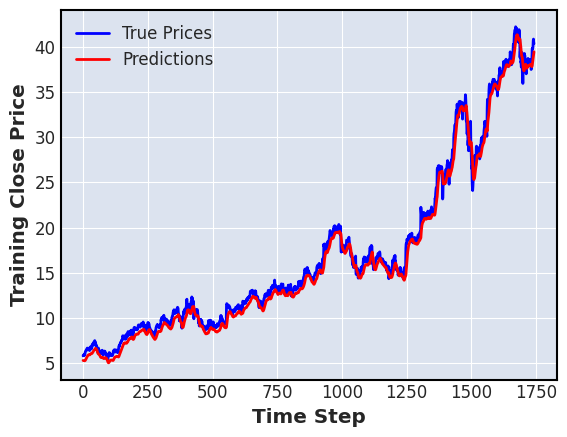

28/28 [==============================] - 0s 6ms/step


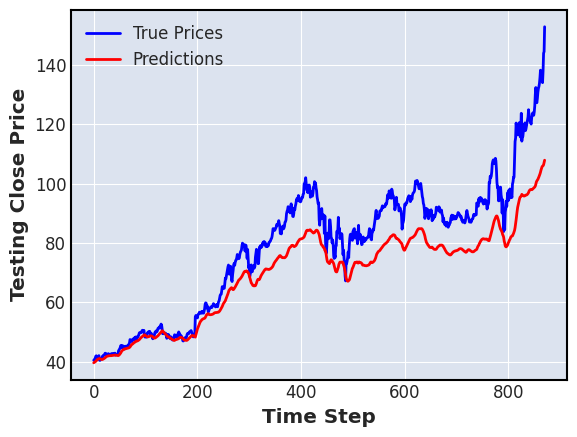

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 4s 32ms/step - loss: 1.6531e-04 - mae: 0.0076 - mse: 1.6531e-04 - mape: 16038.4941 - val_loss: 3.8530e-04 - val_mae: 0.0145 - val_mse: 3.8530e-04 - val_mape: 6.4704
Epoch 2/10
55/55 [==============================] - 1s 18ms/step - loss: 4.7069e-06 - mae: 0.0015 - mse: 4.7069e-06 - mape: 20.3240 - val_loss: 6.0568e-04 - val_mae: 0.0186 - val_mse: 6.0568e-04 - val_mape: 8.0711
Epoch 3/10
55/55 [==============================] - 1s 22ms/step - loss: 4.3819e-06 - mae: 0.0015 - mse: 4.3819e-06 - mape: 1784.5850 - val_loss: 6.1113e-04 - val_mae: 0.0188 - val_mse: 6.1113e-04 - val_mape: 8.2013
Epoch 4/10
55/55 [==============================] - 1s 18ms/step - loss: 4.7921e-06 - mae: 0.0016 - mse: 4.7921e-06 - mape: 2915.4487 - val_loss: 7.3701e-04 - val_mae: 0.0210 - val_mse: 7.3701e-04 - val_mape: 9.1723
Epoch 5/10
55/55 [==============================] - 1s 18ms/ste

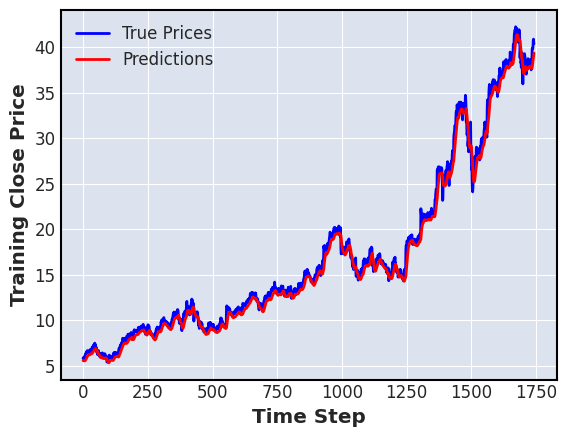

28/28 [==============================] - 0s 5ms/step


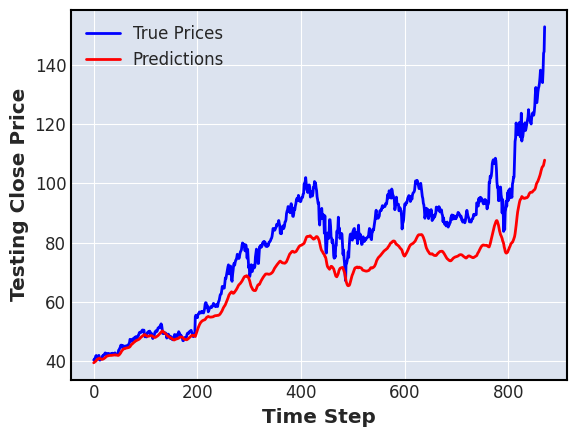

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 5s 30ms/step - loss: 2.6720e-04 - mae: 0.0106 - mse: 2.6720e-04 - mape: 16287.9297 - val_loss: 3.9671e-04 - val_mae: 0.0163 - val_mse: 3.9671e-04 - val_mape: 7.8380
Epoch 2/10
55/55 [==============================] - 1s 19ms/step - loss: 7.2818e-06 - mae: 0.0020 - mse: 7.2818e-06 - mape: 2378.0793 - val_loss: 1.9668e-04 - val_mae: 0.0104 - val_mse: 1.9668e-04 - val_mape: 4.8051
Epoch 3/10
55/55 [==============================] - 1s 22ms/step - loss: 5.4069e-06 - mae: 0.0016 - mse: 5.4069e-06 - mape: 1446.4772 - val_loss: 1.3932e-04 - val_mae: 0.0084 - val_mse: 1.3932e-04 - val_mape: 3.8942
Epoch 4/10
55/55 [==============================] - 1s 18ms/step - loss: 5.8760e-06 - mae: 0.0017 - mse: 5.8760e-06 - mape: 1599.6696 - val_loss: 1.2651e-04 - val_mae: 0.0080 - val_mse: 1.2651e-04 - val_mape: 3.8158
Epoch 5/10
55/55 [==============================] - 1s 25ms/s

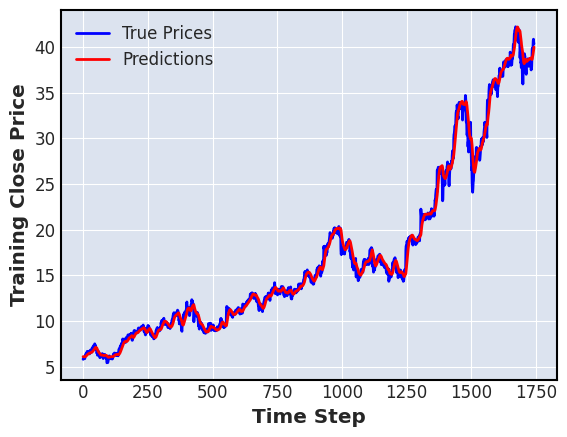

28/28 [==============================] - 0s 6ms/step


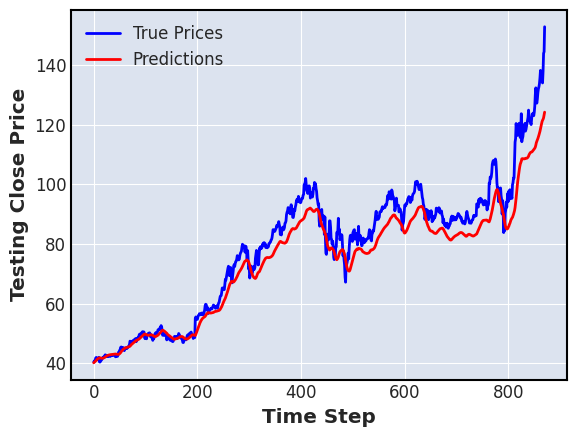

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 5s 25ms/step - loss: 0.0019 - mae: 0.0198 - mse: 0.0019 - mape: 17946.9277 - val_loss: 8.3373e-04 - val_mae: 0.0236 - val_mse: 8.3373e-04 - val_mape: 6.6111
Epoch 2/10
82/82 [==============================] - 1s 18ms/step - loss: 3.5380e-05 - mae: 0.0039 - mse: 3.5380e-05 - mape: 1705.0543 - val_loss: 5.0355e-04 - val_mae: 0.0176 - val_mse: 5.0355e-04 - val_mape: 5.0221
Epoch 3/10
82/82 [==============================] - 1s 17ms/step - loss: 2.6764e-05 - mae: 0.0031 - mse: 2.6764e-05 - mape: 77.9573 - val_loss: 2.8354e-04 - val_mae: 0.0128 - val_mse: 2.8354e-04 - val_mape: 3.7418
Epoch 4/10
82/82 [==============================] - 2s 19ms/step - loss: 2.8283e-05 - mae: 0.0033 - mse: 2.8283e-05 - mape: 1555.0826 - val_loss: 2.9172e-04 - val_mae: 0.0131 - val_mse: 2.9172e-04 - val_mape: 3.7964
Epoch 5/10
82/82 [==============================] - 2s 1

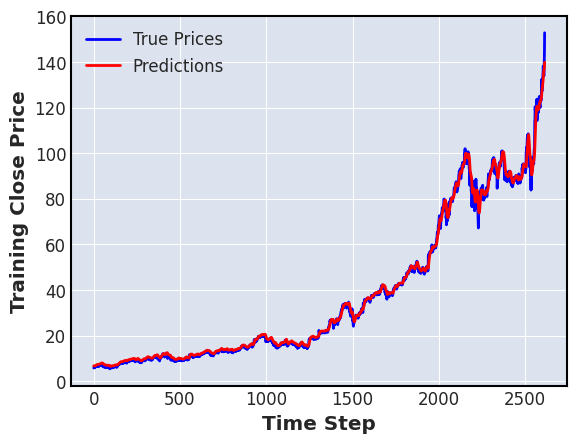

28/28 [==============================] - 0s 6ms/step


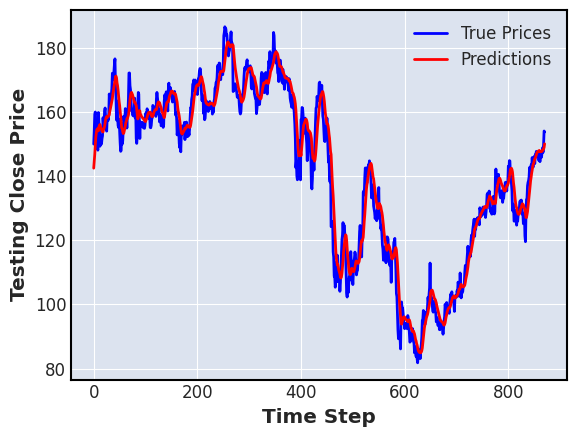

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 5s 26ms/step - loss: 0.0018 - mae: 0.0215 - mse: 0.0018 - mape: 32335.7832 - val_loss: 7.2185e-04 - val_mae: 0.0211 - val_mse: 7.2185e-04 - val_mape: 5.9161
Epoch 2/10
82/82 [==============================] - 1s 18ms/step - loss: 3.1845e-05 - mae: 0.0033 - mse: 3.1845e-05 - mape: 1634.9763 - val_loss: 5.7449e-04 - val_mae: 0.0186 - val_mse: 5.7449e-04 - val_mape: 5.2703
Epoch 3/10
82/82 [==============================] - 1s 18ms/step - loss: 3.0350e-05 - mae: 0.0032 - mse: 3.0350e-05 - mape: 877.2209 - val_loss: 6.9222e-04 - val_mae: 0.0208 - val_mse: 6.9222e-04 - val_mape: 5.8155
Epoch 4/10
82/82 [==============================] - 1s 18ms/step - loss: 2.9180e-05 - mae: 0.0031 - mse: 2.9180e-05 - mape: 1100.1045 - val_loss: 6.0256e-04 - val_mae: 0.0193 - val_mse: 6.0256e-04 - val_mape: 5.4199
Epoch 5/10
82/82 [==============================] - 2s 20ms/step - los

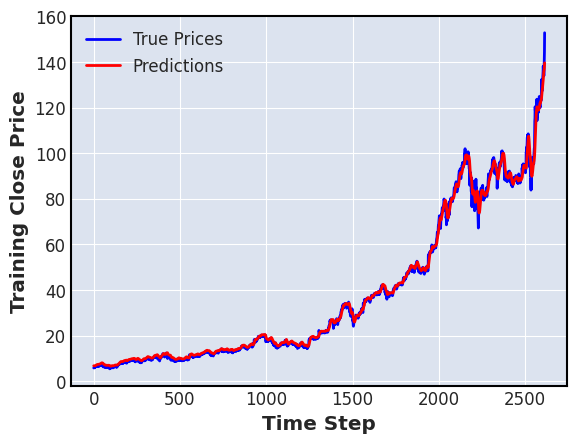

28/28 [==============================] - 0s 7ms/step


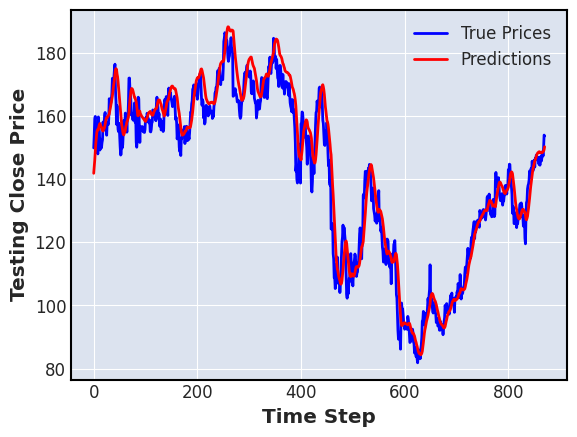

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 5s 25ms/step - loss: 0.0018 - mae: 0.0225 - mse: 0.0018 - mape: 3938.4102 - val_loss: 7.1000e-04 - val_mae: 0.0208 - val_mse: 7.1000e-04 - val_mape: 5.9083
Epoch 2/10
82/82 [==============================] - 1s 18ms/step - loss: 4.5892e-05 - mae: 0.0045 - mse: 4.5892e-05 - mape: 3294.8291 - val_loss: 7.0862e-04 - val_mae: 0.0210 - val_mse: 7.0862e-04 - val_mape: 6.0352
Epoch 3/10
82/82 [==============================] - 2s 19ms/step - loss: 4.0089e-05 - mae: 0.0039 - mse: 4.0089e-05 - mape: 2818.7434 - val_loss: 3.5710e-04 - val_mae: 0.0144 - val_mse: 3.5710e-04 - val_mape: 4.2171
Epoch 4/10
82/82 [==============================] - 2s 20ms/step - loss: 3.7858e-05 - mae: 0.0038 - mse: 3.7858e-05 - mape: 2222.0640 - val_loss: 3.7908e-04 - val_mae: 0.0148 - val_mse: 3.7908e-04 - val_mape: 4.3527
Epoch 5/10
82/82 [==============================] - 2s 19ms/step - los

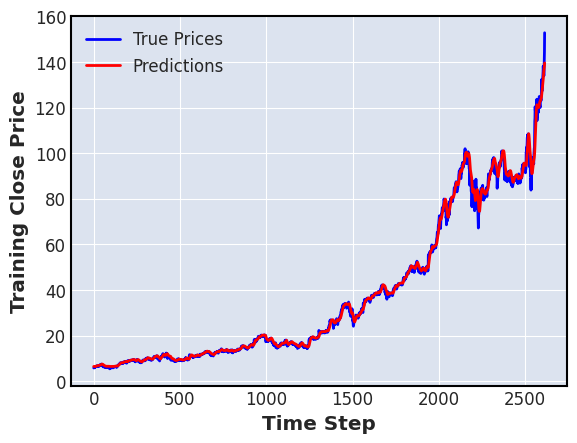

28/28 [==============================] - 0s 5ms/step


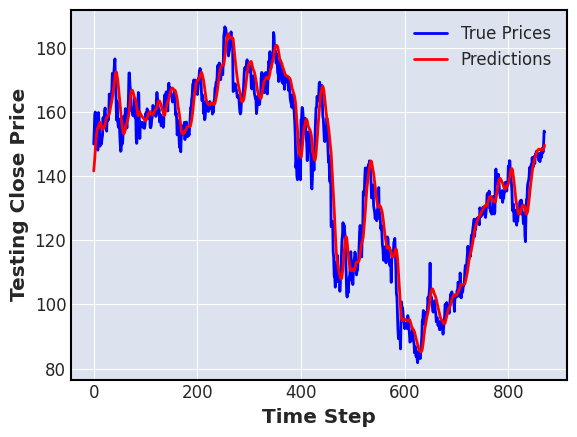

---------------------------------------------------------------
ticker_name :  IBM Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 4s 48ms/step - loss: 0.0236 - mae: 0.1168 - mse: 0.0236 - mape: 44.2439 - val_loss: 9.7891e-04 - val_mae: 0.0286 - val_mse: 9.7891e-04 - val_mape: 10.1946
Epoch 2/10
28/28 [==============================] - 1s 24ms/step - loss: 7.4778e-04 - mae: 0.0223 - mse: 7.4778e-04 - mape: 8.9064 - val_loss: 1.7721e-04 - val_mae: 0.0109 - val_mse: 1.7721e-04 - val_mape: 4.0053
Epoch 3/10
28/28 [==============================] - 1s 28ms/step - loss: 4.1354e-04 - mae: 0.0173 - mse: 4.1354e-04 - mape: 7.2343 - val_loss: 1.2470e-04 - val_mae: 0.0090 - val_mse: 1.2470e-04 - val_mape: 3.4221
Epoch 4/10
28/28 [==============================] - 1s 22ms/step - loss: 3.2102e-04 - mae: 0.0152 - mse: 3.2102e-04 - mape: 6.4166 - val_loss: 1.0161e-04 - val_mae: 0.0080 - val_mse: 1.0161e-04 - val_mape: 3.0464
Epoch 5/10
28/28 [====

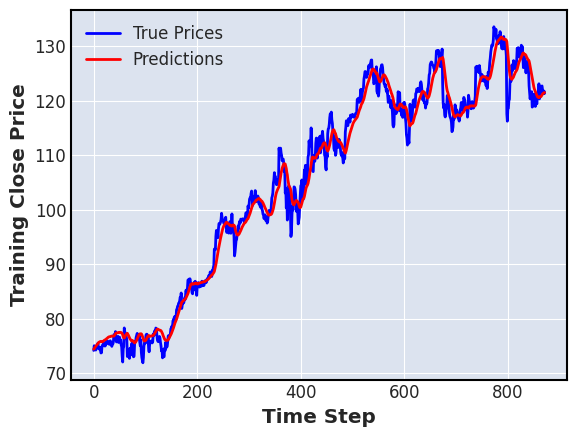

28/28 [==============================] - 0s 5ms/step


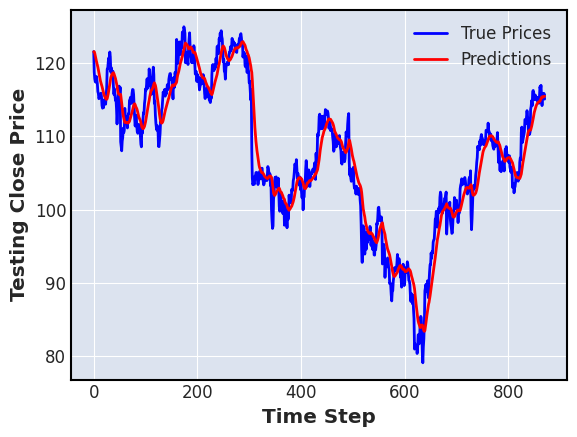

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 4s 43ms/step - loss: 0.0190 - mae: 0.1059 - mse: 0.0190 - mape: 40.2557 - val_loss: 0.0020 - val_mae: 0.0422 - val_mse: 0.0020 - val_mape: 15.1694
Epoch 2/10
28/28 [==============================] - 1s 22ms/step - loss: 9.9309e-04 - mae: 0.0259 - mse: 9.9309e-04 - mape: 10.4211 - val_loss: 3.3006e-04 - val_mae: 0.0154 - val_mse: 3.3006e-04 - val_mape: 5.4960
Epoch 3/10
28/28 [==============================] - 1s 21ms/step - loss: 5.5786e-04 - mae: 0.0202 - mse: 5.5786e-04 - mape: 8.3942 - val_loss: 1.5734e-04 - val_mae: 0.0100 - val_mse: 1.5734e-04 - val_mape: 3.8990
Epoch 4/10
28/28 [==============================] - 1s 22ms/step - loss: 3.5228e-04 - mae: 0.0157 - mse: 3.5228e-04 - mape: 6.6717 - val_loss: 9.2223e-05 - val_mae: 0.0076 - val_mse: 9.2223e-05 - val_mape: 2.8837
Epoch 5/10
28/28 [==============================] - 1s 22ms/step - loss: 1.5621e-04 - m

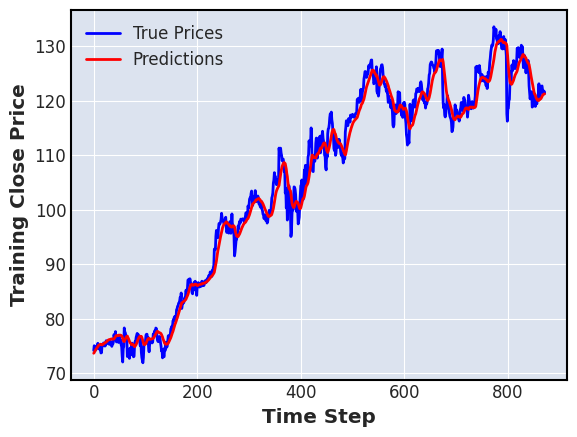

28/28 [==============================] - 0s 6ms/step


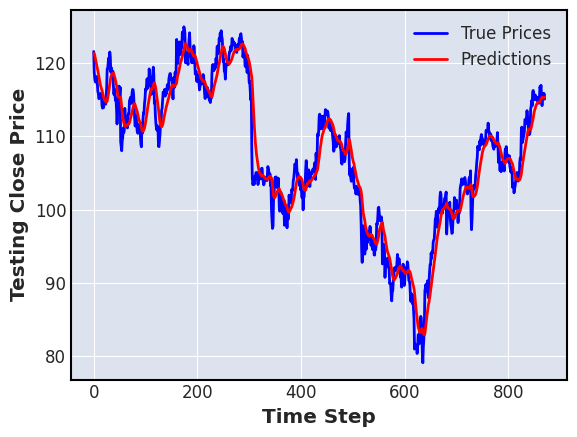

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 4s 49ms/step - loss: 0.0214 - mae: 0.1145 - mse: 0.0214 - mape: 43.3173 - val_loss: 0.0025 - val_mae: 0.0472 - val_mse: 0.0025 - val_mape: 17.0174
Epoch 2/10
28/28 [==============================] - 1s 22ms/step - loss: 0.0010 - mae: 0.0259 - mse: 0.0010 - mape: 10.3588 - val_loss: 2.6876e-04 - val_mae: 0.0136 - val_mse: 2.6876e-04 - val_mape: 4.9160
Epoch 3/10
28/28 [==============================] - 1s 23ms/step - loss: 5.4042e-04 - mae: 0.0196 - mse: 5.4042e-04 - mape: 8.2975 - val_loss: 1.6343e-04 - val_mae: 0.0102 - val_mse: 1.6343e-04 - val_mape: 3.9668
Epoch 4/10
28/28 [==============================] - 1s 23ms/step - loss: 4.0537e-04 - mae: 0.0171 - mse: 4.0537e-04 - mape: 7.2064 - val_loss: 1.2944e-04 - val_mae: 0.0091 - val_mse: 1.2944e-04 - val_mape: 3.4432
Epoch 5/10
28/28 [==============================] - 1s 27ms/step - loss: 2.9386e-04 - mae: 0.01

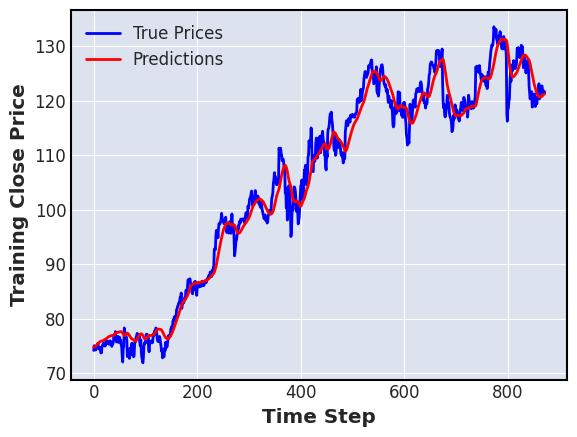

28/28 [==============================] - 0s 6ms/step


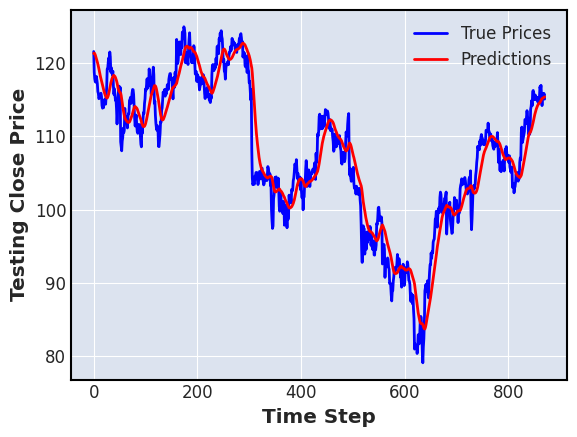

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 4s 30ms/step - loss: 0.0122 - mae: 0.0705 - mse: 0.0122 - mape: 26.5092 - val_loss: 1.7284e-04 - val_mae: 0.0098 - val_mse: 1.7284e-04 - val_mape: 3.7188
Epoch 2/10
55/55 [==============================] - 1s 20ms/step - loss: 3.1315e-04 - mae: 0.0144 - mse: 3.1315e-04 - mape: 5.8106 - val_loss: 1.4180e-04 - val_mae: 0.0086 - val_mse: 1.4180e-04 - val_mape: 3.2829
Epoch 3/10
55/55 [==============================] - 1s 21ms/step - loss: 2.2289e-04 - mae: 0.0120 - mse: 2.2289e-04 - mape: 4.8917 - val_loss: 1.2565e-04 - val_mae: 0.0078 - val_mse: 1.2565e-04 - val_mape: 3.0694
Epoch 4/10
55/55 [==============================] - 1s 21ms/step - loss: 1.4208e-04 - mae: 0.0095 - mse: 1.4208e-04 - mape: 3.8690 - val_loss: 1.0256e-04 - val_mae: 0.0071 - val_mse: 1.0256e-04 - val_mape: 2.7283
Epoch 5/10
55/55 [==============================] - 1s 19ms/step -

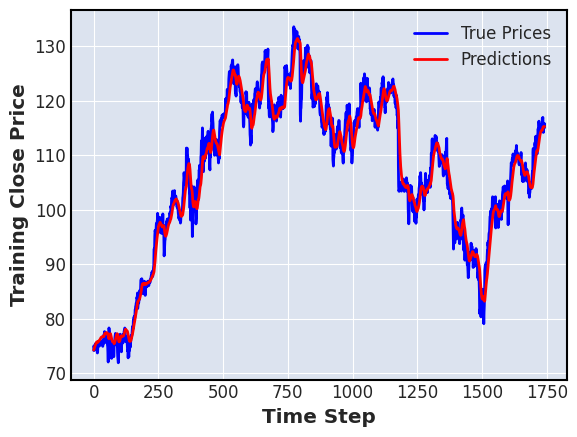

28/28 [==============================] - 0s 6ms/step


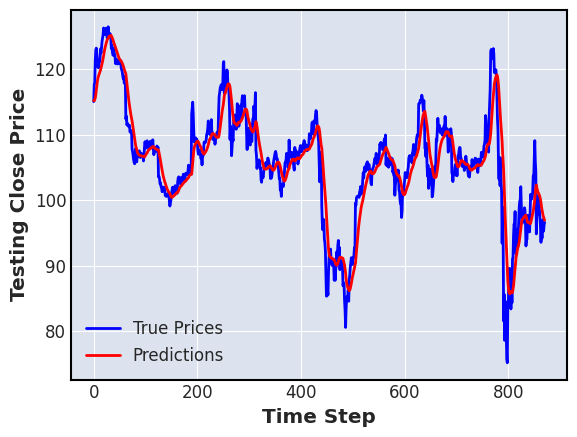

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 4s 30ms/step - loss: 0.0100 - mae: 0.0644 - mse: 0.0100 - mape: 24.2414 - val_loss: 2.4661e-04 - val_mae: 0.0125 - val_mse: 2.4661e-04 - val_mape: 4.6406
Epoch 2/10
55/55 [==============================] - 1s 19ms/step - loss: 3.5698e-04 - mae: 0.0153 - mse: 3.5698e-04 - mape: 6.1963 - val_loss: 2.0542e-04 - val_mae: 0.0107 - val_mse: 2.0542e-04 - val_mape: 4.2515
Epoch 3/10
55/55 [==============================] - 1s 21ms/step - loss: 2.1550e-04 - mae: 0.0117 - mse: 2.1550e-04 - mape: 4.7579 - val_loss: 1.3219e-04 - val_mae: 0.0081 - val_mse: 1.3219e-04 - val_mape: 3.2025
Epoch 4/10
55/55 [==============================] - 1s 19ms/step - loss: 8.8680e-05 - mae: 0.0075 - mse: 8.8680e-05 - mape: 2.9517 - val_loss: 1.0481e-04 - val_mae: 0.0078 - val_mse: 1.0481e-04 - val_mape: 2.9601
Epoch 5/10
55/55 [==============================] - 1s 22ms/step - loss: 4.6916e-

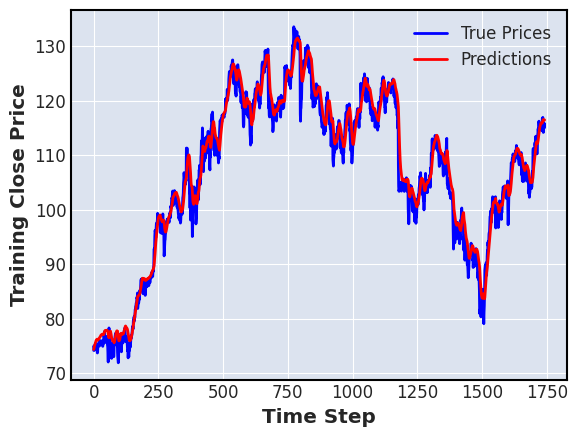

28/28 [==============================] - 0s 6ms/step


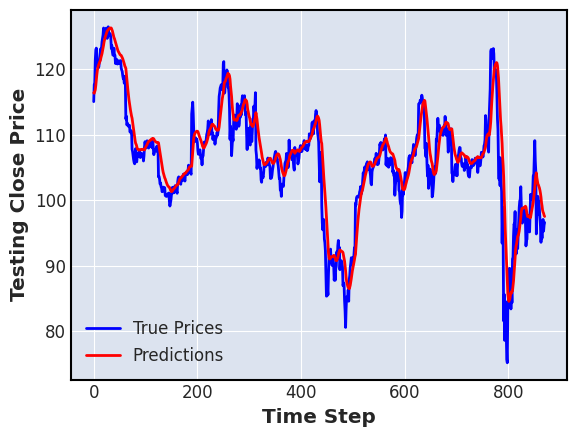

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 4s 30ms/step - loss: 0.0115 - mae: 0.0712 - mse: 0.0115 - mape: 26.8463 - val_loss: 2.8922e-04 - val_mae: 0.0137 - val_mse: 2.8922e-04 - val_mape: 5.0885
Epoch 2/10
55/55 [==============================] - 1s 19ms/step - loss: 3.7415e-04 - mae: 0.0156 - mse: 3.7415e-04 - mape: 6.3492 - val_loss: 2.2259e-04 - val_mae: 0.0110 - val_mse: 2.2259e-04 - val_mape: 4.3837
Epoch 3/10
55/55 [==============================] - 1s 22ms/step - loss: 2.7323e-04 - mae: 0.0133 - mse: 2.7323e-04 - mape: 5.4222 - val_loss: 1.8728e-04 - val_mae: 0.0098 - val_mse: 1.8728e-04 - val_mape: 3.9002
Epoch 4/10
55/55 [==============================] - 1s 19ms/step - loss: 1.7750e-04 - mae: 0.0106 - mse: 1.7750e-04 - mape: 4.3298 - val_loss: 1.3380e-04 - val_mae: 0.0081 - val_mse: 1.3380e-04 - val_mape: 3.1348
Epoch 5/10
55/55 [==============================] - 1s 22ms/step - loss: 1.0211e-

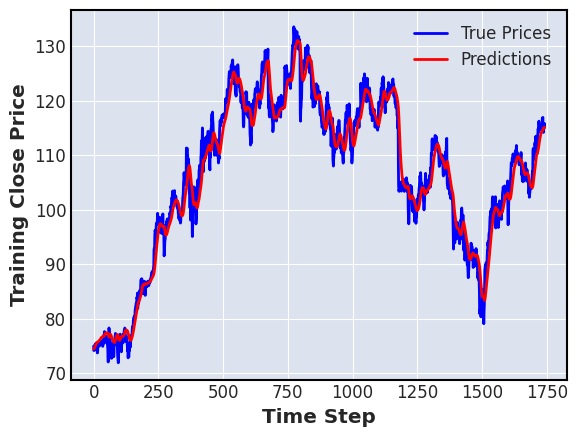

28/28 [==============================] - 0s 5ms/step


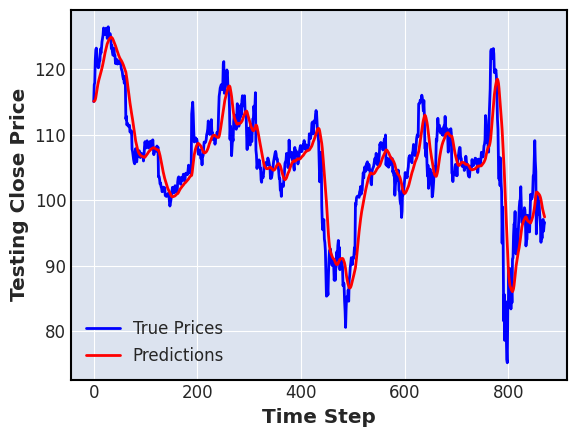

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 5s 25ms/step - loss: 0.0082 - mae: 0.0510 - mse: 0.0082 - mape: 19.1883 - val_loss: 7.8444e-04 - val_mae: 0.0229 - val_mse: 7.8444e-04 - val_mape: 7.0013
Epoch 2/10
82/82 [==============================] - 2s 19ms/step - loss: 2.2718e-04 - mae: 0.0117 - mse: 2.2718e-04 - mape: 4.6950 - val_loss: 3.3162e-04 - val_mae: 0.0143 - val_mse: 3.3162e-04 - val_mape: 4.4685
Epoch 3/10
82/82 [==============================] - 2s 19ms/step - loss: 1.5362e-04 - mae: 0.0096 - mse: 1.5362e-04 - mape: 3.8268 - val_loss: 2.3650e-04 - val_mae: 0.0121 - val_mse: 2.3650e-04 - val_mape: 3.7494
Epoch 4/10
82/82 [==============================] - 2s 19ms/step - loss: 9.2708e-05 - mae: 0.0073 - mse: 9.2708e-05 - mape: 2.8948 - val_loss: 1.2827e-04 - val_mae: 0.0088 - val_mse: 1.2827e-04 - val_mape: 2.7978
Epoch 5/10
82/82 [==============================] - 2s 19ms/step -

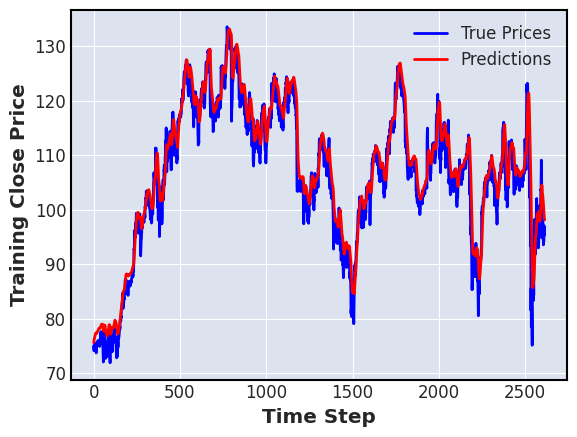

28/28 [==============================] - 0s 6ms/step


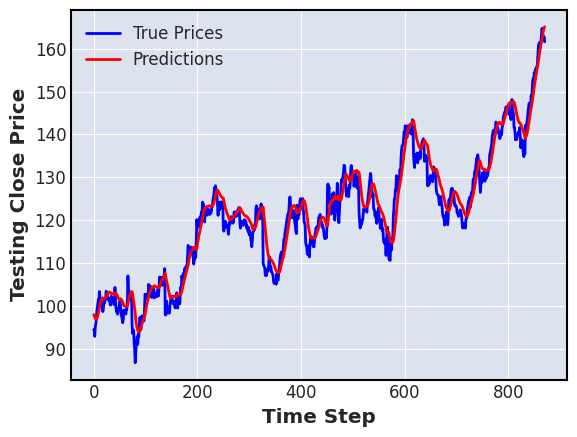

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 5s 25ms/step - loss: 0.0068 - mae: 0.0481 - mse: 0.0068 - mape: 18.2083 - val_loss: 7.4878e-04 - val_mae: 0.0221 - val_mse: 7.4878e-04 - val_mape: 6.7771
Epoch 2/10
82/82 [==============================] - 2s 19ms/step - loss: 2.6028e-04 - mae: 0.0125 - mse: 2.6028e-04 - mape: 5.0236 - val_loss: 4.0613e-04 - val_mae: 0.0159 - val_mse: 4.0613e-04 - val_mape: 4.9387
Epoch 3/10
82/82 [==============================] - 1s 18ms/step - loss: 1.5282e-04 - mae: 0.0095 - mse: 1.5282e-04 - mape: 3.8003 - val_loss: 1.3998e-04 - val_mae: 0.0091 - val_mse: 1.3998e-04 - val_mape: 2.9270
Epoch 4/10
82/82 [==============================] - 1s 18ms/step - loss: 8.2008e-05 - mae: 0.0068 - mse: 8.2008e-05 - mape: 2.6656 - val_loss: 9.9671e-05 - val_mae: 0.0078 - val_mse: 9.9671e-05 - val_mape: 2.5263
Epoch 5/10
82/82 [==============================] - 1s 18ms/step - loss: 7.0027e-

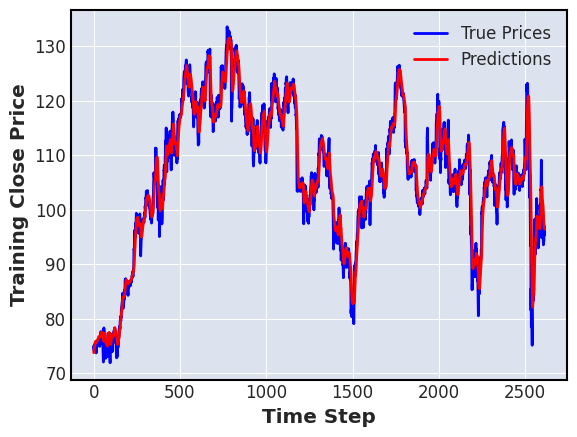

28/28 [==============================] - 0s 6ms/step


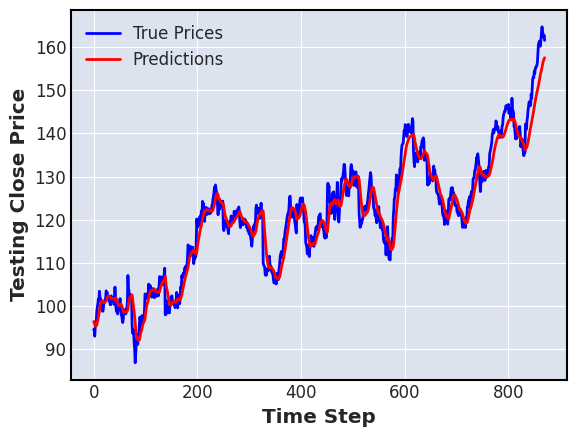

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 5s 25ms/step - loss: 0.0075 - mae: 0.0510 - mse: 0.0075 - mape: 19.3831 - val_loss: 7.7701e-04 - val_mae: 0.0225 - val_mse: 7.7701e-04 - val_mape: 6.8891
Epoch 2/10
82/82 [==============================] - 1s 18ms/step - loss: 2.7076e-04 - mae: 0.0127 - mse: 2.7076e-04 - mape: 5.1103 - val_loss: 3.8415e-04 - val_mae: 0.0153 - val_mse: 3.8415e-04 - val_mape: 4.7896
Epoch 3/10
82/82 [==============================] - 2s 19ms/step - loss: 1.8174e-04 - mae: 0.0104 - mse: 1.8174e-04 - mape: 4.1610 - val_loss: 2.8009e-04 - val_mae: 0.0130 - val_mse: 2.8009e-04 - val_mape: 4.0495
Epoch 4/10
82/82 [==============================] - 2s 20ms/step - loss: 1.1245e-04 - mae: 0.0081 - mse: 1.1245e-04 - mape: 3.1931 - val_loss: 1.9852e-04 - val_mae: 0.0110 - val_mse: 1.9852e-04 - val_mape: 3.4780
Epoch 5/10
82/82 [==============================] - 1s 18ms/step - loss: 8.5151e-

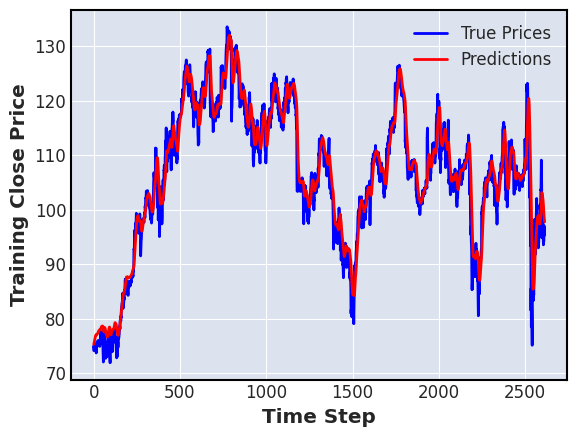

28/28 [==============================] - 0s 6ms/step


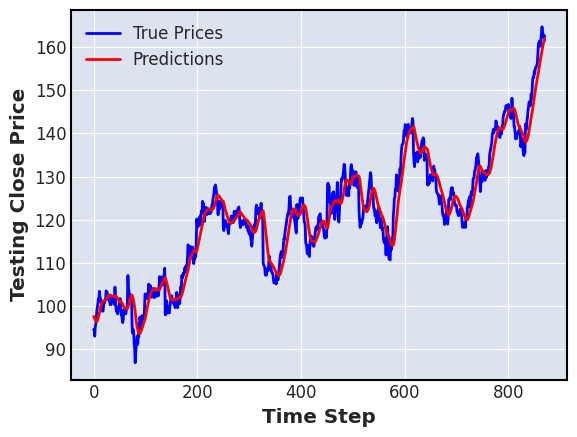

---------------------------------------------------------------
ticker_name :  KO Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 4s 48ms/step - loss: 4.1183e-04 - mae: 0.0144 - mse: 4.1183e-04 - mape: 30.9111 - val_loss: 1.6617e-04 - val_mae: 0.0120 - val_mse: 1.6617e-04 - val_mape: 16.9301
Epoch 2/10
28/28 [==============================] - 1s 28ms/step - loss: 6.2699e-05 - mae: 0.0065 - mse: 6.2699e-05 - mape: 15.0648 - val_loss: 2.1190e-04 - val_mae: 0.0139 - val_mse: 2.1190e-04 - val_mape: 19.6920
Epoch 3/10
28/28 [==============================] - 1s 23ms/step - loss: 4.2370e-05 - mae: 0.0054 - mse: 4.2370e-05 - mape: 12.1196 - val_loss: 1.5614e-04 - val_mae: 0.0119 - val_mse: 1.5614e-04 - val_mape: 16.8761
Epoch 4/10
28/28 [==============================] - 1s 27ms/step - loss: 2.7230e-05 - mae: 0.0043 - mse: 2.7230e-05 - mape: 9.8120 - val_loss: 9.3053e-05 - val_mae: 0.0092 - val_mse: 9.3053e-05 - val_mape: 13.1065
Epoch 5/10

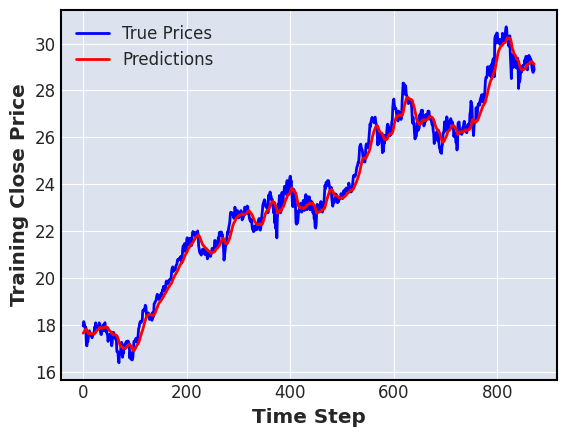

28/28 [==============================] - 0s 6ms/step


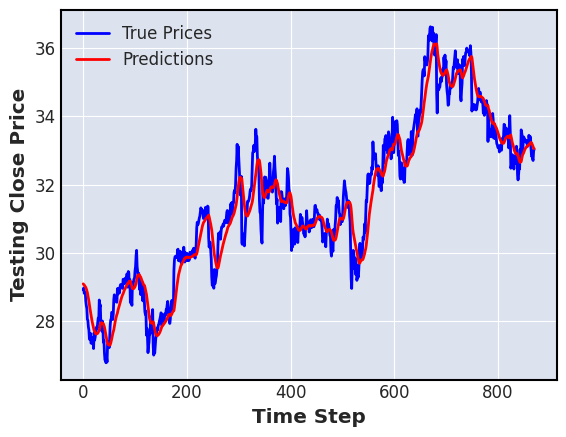

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 4s 44ms/step - loss: 3.9255e-04 - mae: 0.0146 - mse: 3.9255e-04 - mape: 31.2957 - val_loss: 2.8694e-04 - val_mae: 0.0162 - val_mse: 2.8694e-04 - val_mape: 22.9686
Epoch 2/10
28/28 [==============================] - 1s 22ms/step - loss: 5.2822e-05 - mae: 0.0060 - mse: 5.2822e-05 - mape: 13.7931 - val_loss: 2.3504e-04 - val_mae: 0.0148 - val_mse: 2.3504e-04 - val_mape: 20.9895
Epoch 3/10
28/28 [==============================] - 1s 29ms/step - loss: 3.3975e-05 - mae: 0.0048 - mse: 3.3975e-05 - mape: 10.8854 - val_loss: 3.6613e-05 - val_mae: 0.0053 - val_mse: 3.6613e-05 - val_mape: 7.4147
Epoch 4/10
28/28 [==============================] - 1s 22ms/step - loss: 1.3732e-05 - mae: 0.0029 - mse: 1.3732e-05 - mape: 6.6432 - val_loss: 1.3896e-05 - val_mae: 0.0031 - val_mse: 1.3896e-05 - val_mape: 4.2641
Epoch 5/10
28/28 [==============================] - 1s 28ms/step - lo

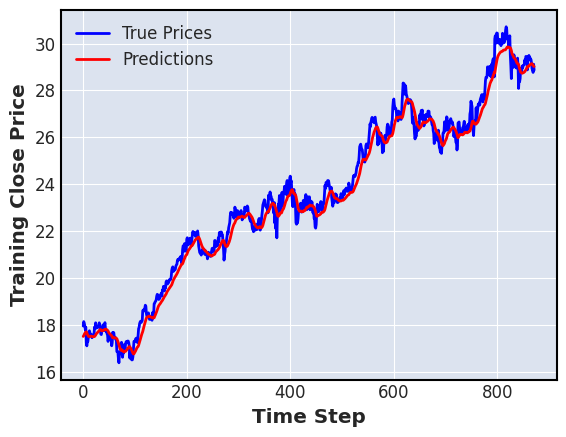

28/28 [==============================] - 0s 6ms/step


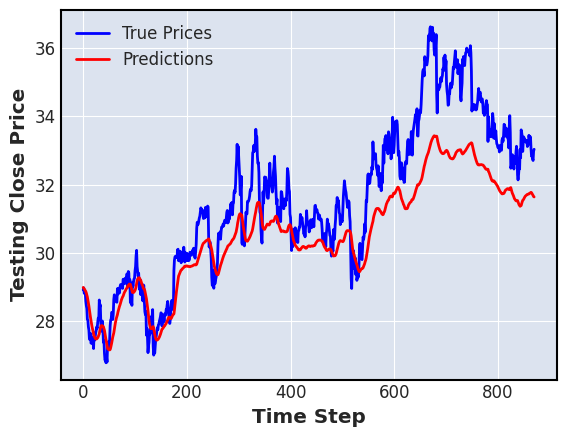

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 4s 44ms/step - loss: 4.3101e-04 - mae: 0.0154 - mse: 4.3101e-04 - mape: 32.9865 - val_loss: 2.3272e-04 - val_mae: 0.0143 - val_mse: 2.3272e-04 - val_mape: 20.2374
Epoch 2/10
28/28 [==============================] - 1s 22ms/step - loss: 6.9418e-05 - mae: 0.0069 - mse: 6.9418e-05 - mape: 15.9012 - val_loss: 3.1708e-04 - val_mae: 0.0171 - val_mse: 3.1708e-04 - val_mape: 24.3364
Epoch 3/10
28/28 [==============================] - 1s 28ms/step - loss: 5.3103e-05 - mae: 0.0061 - mse: 5.3103e-05 - mape: 13.8764 - val_loss: 2.2574e-04 - val_mae: 0.0144 - val_mse: 2.2574e-04 - val_mape: 20.4540
Epoch 4/10
28/28 [==============================] - 1s 27ms/step - loss: 3.6804e-05 - mae: 0.0050 - mse: 3.6804e-05 - mape: 11.3686 - val_loss: 1.4298e-04 - val_mae: 0.0115 - val_mse: 1.4298e-04 - val_mape: 16.4011
Epoch 5/10
28/28 [==============================] - 1s 28ms/step -

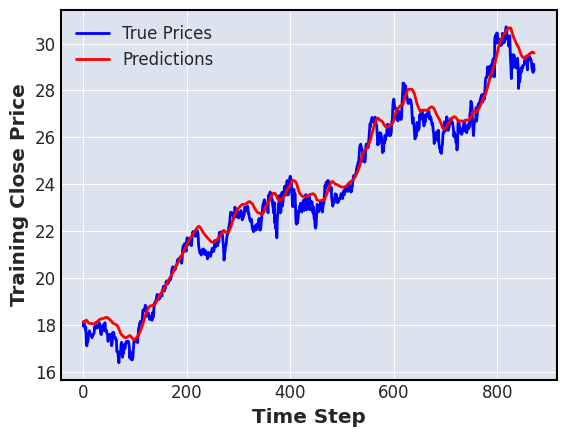

28/28 [==============================] - 0s 6ms/step


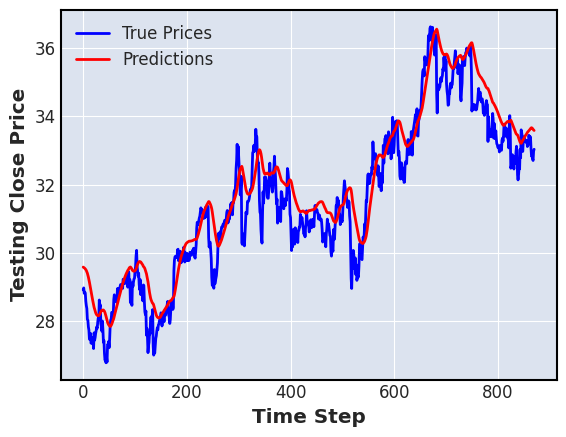

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 4s 29ms/step - loss: 3.8240e-04 - mae: 0.0135 - mse: 3.8240e-04 - mape: 24.9887 - val_loss: 5.0741e-04 - val_mae: 0.0210 - val_mse: 5.0741e-04 - val_mape: 22.0387
Epoch 2/10
55/55 [==============================] - 1s 21ms/step - loss: 4.6531e-05 - mae: 0.0055 - mse: 4.6531e-05 - mape: 10.9873 - val_loss: 6.8409e-05 - val_mae: 0.0075 - val_mse: 6.8409e-05 - val_mape: 7.9364
Epoch 3/10
55/55 [==============================] - 1s 19ms/step - loss: 2.9316e-06 - mae: 0.0013 - mse: 2.9316e-06 - mape: 2.3822 - val_loss: 1.1441e-05 - val_mae: 0.0018 - val_mse: 1.1441e-05 - val_mape: 1.9983
Epoch 4/10
55/55 [==============================] - 1s 22ms/step - loss: 2.3063e-06 - mae: 0.0012 - mse: 2.3063e-06 - mape: 2.1022 - val_loss: 1.0256e-05 - val_mae: 0.0018 - val_mse: 1.0256e-05 - val_mape: 1.9554
Epoch 5/10
55/55 [==============================] - 1s 2

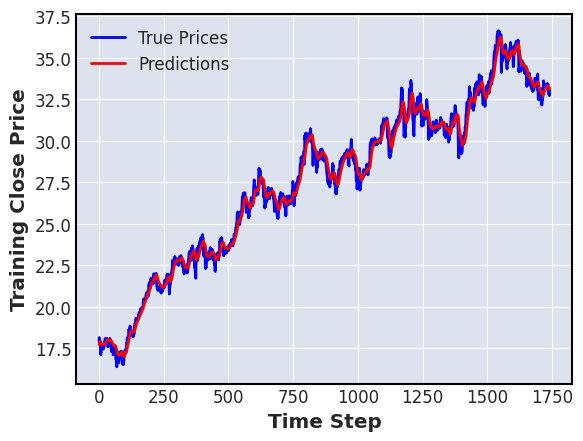

28/28 [==============================] - 0s 6ms/step


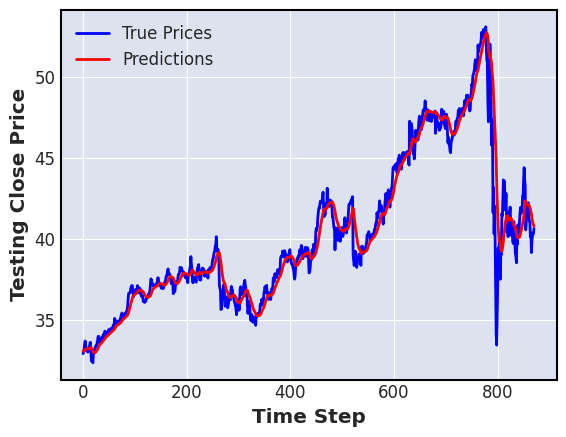

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 4s 30ms/step - loss: 3.7165e-04 - mae: 0.0139 - mse: 3.7165e-04 - mape: 25.9448 - val_loss: 5.5782e-04 - val_mae: 0.0219 - val_mse: 5.5782e-04 - val_mape: 22.9708
Epoch 2/10
55/55 [==============================] - 1s 19ms/step - loss: 5.7128e-05 - mae: 0.0062 - mse: 5.7128e-05 - mape: 12.2462 - val_loss: 5.3183e-05 - val_mae: 0.0061 - val_mse: 5.3183e-05 - val_mape: 6.2091
Epoch 3/10
55/55 [==============================] - 1s 19ms/step - loss: 3.2384e-06 - mae: 0.0014 - mse: 3.2384e-06 - mape: 2.4914 - val_loss: 1.6669e-05 - val_mae: 0.0030 - val_mse: 1.6669e-05 - val_mape: 3.1566
Epoch 4/10
55/55 [==============================] - 1s 18ms/step - loss: 2.1187e-06 - mae: 0.0011 - mse: 2.1187e-06 - mape: 1.9782 - val_loss: 1.5039e-05 - val_mae: 0.0028 - val_mse: 1.5039e-05 - val_mape: 2.8608
Epoch 5/10
55/55 [==============================] - 1s 21ms/step - loss

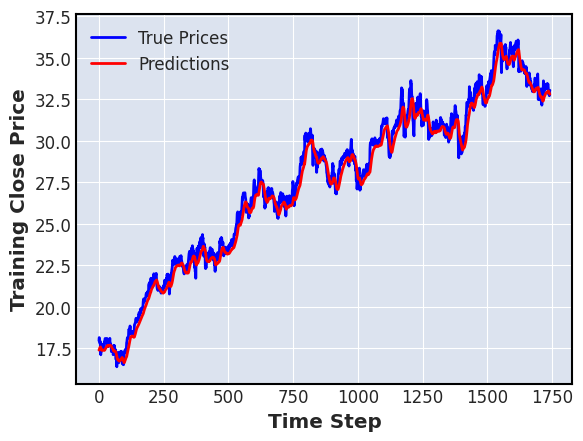

28/28 [==============================] - 0s 6ms/step


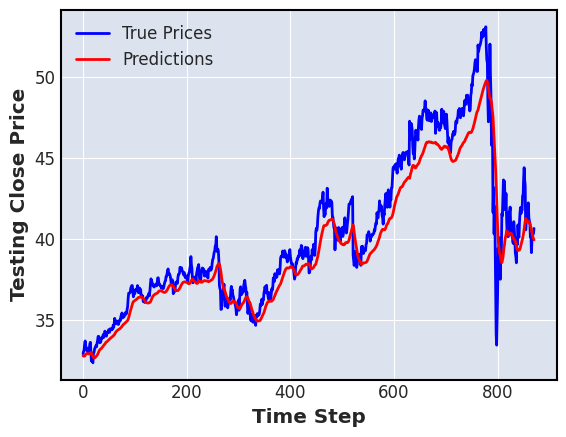

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 4s 30ms/step - loss: 4.1462e-04 - mae: 0.0145 - mse: 4.1462e-04 - mape: 26.6670 - val_loss: 5.7383e-04 - val_mae: 0.0221 - val_mse: 5.7383e-04 - val_mape: 23.1017
Epoch 2/10
55/55 [==============================] - 1s 19ms/step - loss: 6.7266e-05 - mae: 0.0067 - mse: 6.7266e-05 - mape: 13.3521 - val_loss: 1.2347e-04 - val_mae: 0.0102 - val_mse: 1.2347e-04 - val_mape: 10.7481
Epoch 3/10
55/55 [==============================] - 1s 20ms/step - loss: 5.0567e-06 - mae: 0.0017 - mse: 5.0567e-06 - mape: 3.1852 - val_loss: 1.6147e-05 - val_mae: 0.0028 - val_mse: 1.6147e-05 - val_mape: 3.0167
Epoch 4/10
55/55 [==============================] - 1s 19ms/step - loss: 2.8715e-06 - mae: 0.0013 - mse: 2.8715e-06 - mape: 2.3282 - val_loss: 1.3660e-05 - val_mae: 0.0022 - val_mse: 1.3660e-05 - val_mape: 2.3207
Epoch 5/10
55/55 [==============================] - 1s 19ms/step - los

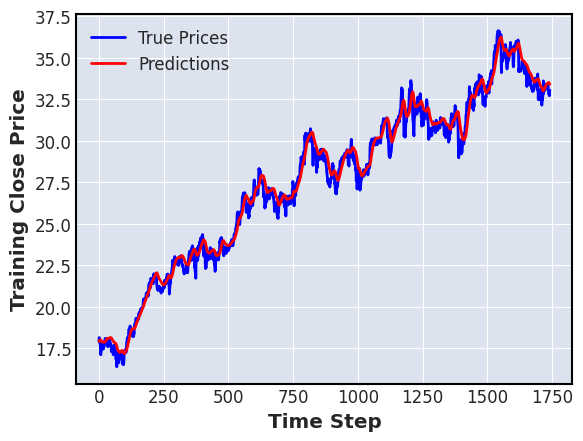

28/28 [==============================] - 0s 5ms/step


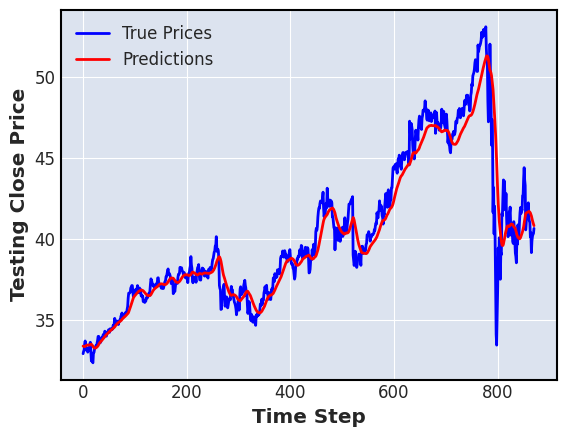

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 5s 26ms/step - loss: 4.6734e-04 - mae: 0.0136 - mse: 4.6734e-04 - mape: 21.5103 - val_loss: 9.3943e-05 - val_mae: 0.0090 - val_mse: 9.3943e-05 - val_mape: 6.8483
Epoch 2/10
82/82 [==============================] - 2s 19ms/step - loss: 5.4711e-06 - mae: 0.0015 - mse: 5.4711e-06 - mape: 2.3020 - val_loss: 1.3092e-05 - val_mae: 0.0027 - val_mse: 1.3092e-05 - val_mape: 2.0950
Epoch 3/10
82/82 [==============================] - 2s 20ms/step - loss: 4.7007e-06 - mae: 0.0014 - mse: 4.7007e-06 - mape: 1.9710 - val_loss: 1.0567e-05 - val_mae: 0.0026 - val_mse: 1.0567e-05 - val_mape: 2.0145
Epoch 4/10
82/82 [==============================] - 2s 20ms/step - loss: 5.3923e-06 - mae: 0.0015 - mse: 5.3923e-06 - mape: 2.2748 - val_loss: 1.2248e-05 - val_mae: 0.0029 - val_mse: 1.2248e-05 - val_mape: 2.2253
Epoch 5/10
82/82 [==============================] - 2s 19m

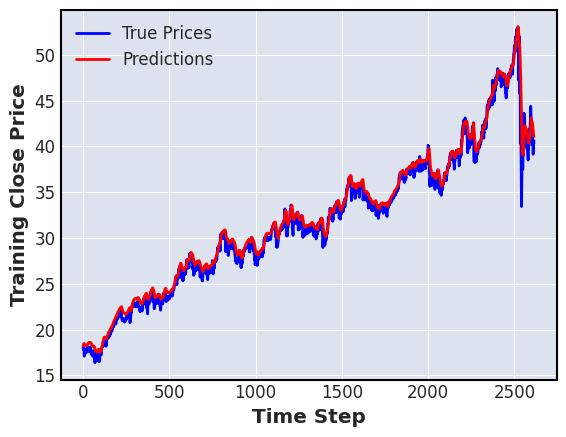

28/28 [==============================] - 0s 5ms/step


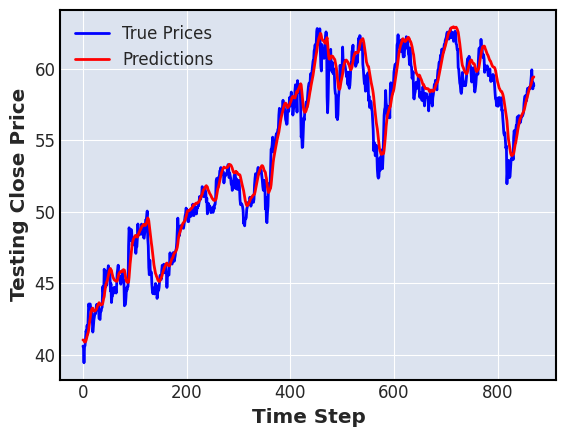

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 5s 25ms/step - loss: 4.7253e-04 - mae: 0.0148 - mse: 4.7253e-04 - mape: 23.4675 - val_loss: 1.9907e-04 - val_mae: 0.0132 - val_mse: 1.9907e-04 - val_mape: 9.8508
Epoch 2/10
82/82 [==============================] - 2s 20ms/step - loss: 6.2263e-06 - mae: 0.0017 - mse: 6.2263e-06 - mape: 2.4826 - val_loss: 3.2120e-05 - val_mae: 0.0047 - val_mse: 3.2120e-05 - val_mape: 3.4409
Epoch 3/10
82/82 [==============================] - 2s 21ms/step - loss: 5.5339e-06 - mae: 0.0015 - mse: 5.5339e-06 - mape: 2.2315 - val_loss: 2.1141e-05 - val_mae: 0.0037 - val_mse: 2.1141e-05 - val_mape: 2.7690
Epoch 4/10
82/82 [==============================] - 1s 18ms/step - loss: 5.0573e-06 - mae: 0.0015 - mse: 5.0573e-06 - mape: 2.1545 - val_loss: 4.5761e-05 - val_mae: 0.0058 - val_mse: 4.5761e-05 - val_mape: 4.3327
Epoch 5/10
82/82 [==============================] - 1s 18ms/step - loss: 

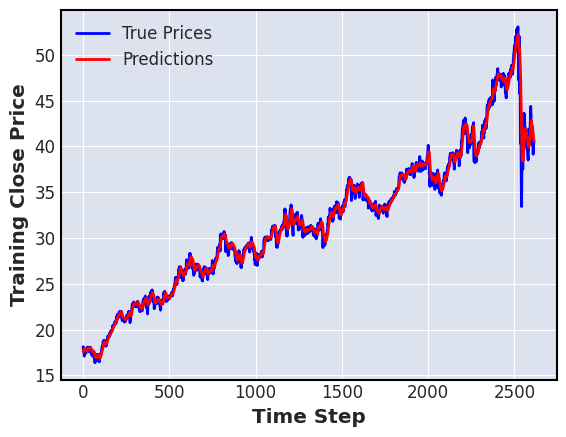

28/28 [==============================] - 0s 6ms/step


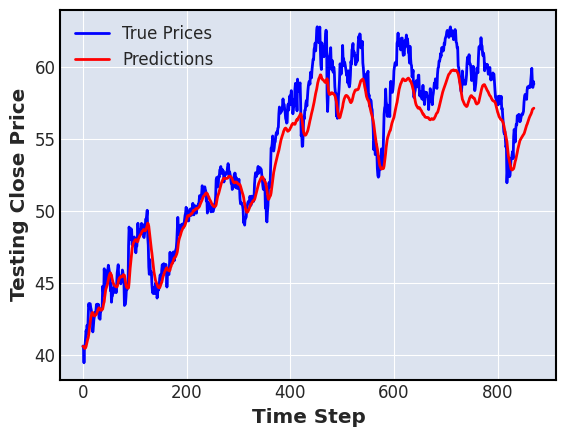

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 5s 25ms/step - loss: 5.0349e-04 - mae: 0.0154 - mse: 5.0349e-04 - mape: 24.6319 - val_loss: 1.9700e-04 - val_mae: 0.0132 - val_mse: 1.9700e-04 - val_mape: 9.9383
Epoch 2/10
82/82 [==============================] - 2s 20ms/step - loss: 9.5636e-06 - mae: 0.0021 - mse: 9.5636e-06 - mape: 3.2240 - val_loss: 1.5175e-05 - val_mae: 0.0030 - val_mse: 1.5175e-05 - val_mape: 2.3298
Epoch 3/10
82/82 [==============================] - 1s 18ms/step - loss: 6.9352e-06 - mae: 0.0017 - mse: 6.9352e-06 - mape: 2.5286 - val_loss: 1.4842e-05 - val_mae: 0.0030 - val_mse: 1.4842e-05 - val_mape: 2.2996
Epoch 4/10
82/82 [==============================] - 2s 20ms/step - loss: 6.6309e-06 - mae: 0.0017 - mse: 6.6309e-06 - mape: 2.4772 - val_loss: 1.9906e-05 - val_mae: 0.0037 - val_mse: 1.9906e-05 - val_mape: 2.8625
Epoch 5/10
82/82 [==============================] - 2s 20ms/step - loss: 

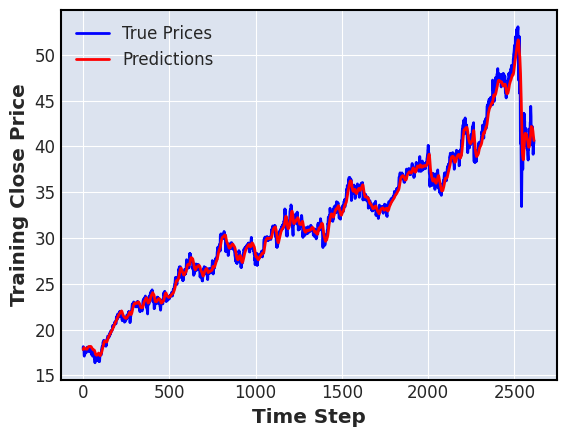

28/28 [==============================] - 0s 6ms/step


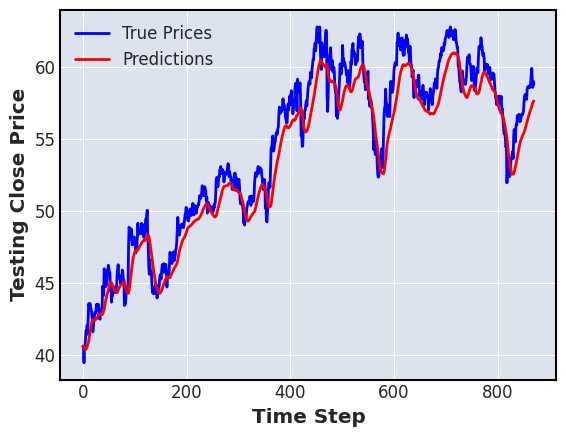

---------------------------------------------------------------
ticker_name :  AAPL Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 4s 46ms/step - loss: 8.1300e-05 - mae: 0.0064 - mse: 8.1300e-05 - mape: 53.3610 - val_loss: 7.0212e-05 - val_mae: 0.0079 - val_mse: 7.0212e-05 - val_mape: 16.7474
Epoch 2/10
28/28 [==============================] - 1s 22ms/step - loss: 3.4849e-06 - mae: 0.0015 - mse: 3.4849e-06 - mape: 10.6118 - val_loss: 1.1611e-05 - val_mae: 0.0030 - val_mse: 1.1611e-05 - val_mape: 6.3461
Epoch 3/10
28/28 [==============================] - 1s 27ms/step - loss: 2.5992e-06 - mae: 0.0013 - mse: 2.5992e-06 - mape: 8.7693 - val_loss: 3.5195e-06 - val_mae: 0.0014 - val_mse: 3.5195e-06 - val_mape: 3.1541
Epoch 4/10
28/28 [==============================] - 1s 22ms/step - loss: 2.2303e-06 - mae: 0.0012 - mse: 2.2303e-06 - mape: 7.6866 - val_loss: 6.3297e-06 - val_mae: 0.0021 - val_mse: 6.3297e-06 - val_mape: 4.4669
Epoch 5/10
2

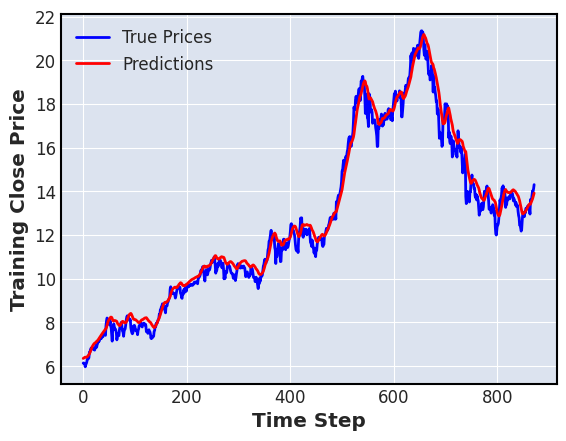

28/28 [==============================] - 0s 5ms/step


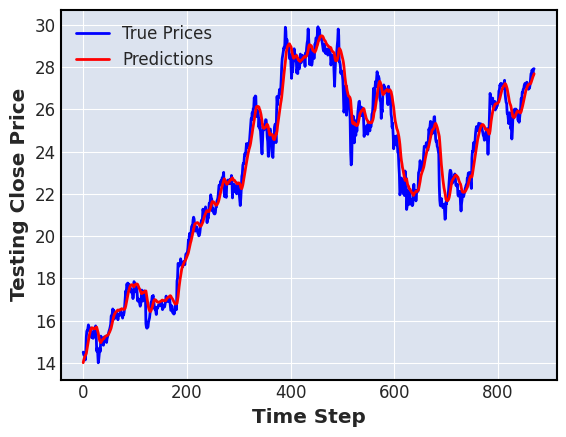

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 4s 48ms/step - loss: 9.9061e-05 - mae: 0.0075 - mse: 9.9061e-05 - mape: 63.4800 - val_loss: 2.0403e-04 - val_mae: 0.0132 - val_mse: 2.0403e-04 - val_mape: 26.7881
Epoch 2/10
28/28 [==============================] - 1s 23ms/step - loss: 7.6145e-06 - mae: 0.0021 - mse: 7.6145e-06 - mape: 18.2038 - val_loss: 8.8204e-06 - val_mae: 0.0025 - val_mse: 8.8204e-06 - val_mape: 5.3631
Epoch 3/10
28/28 [==============================] - 1s 22ms/step - loss: 2.9918e-06 - mae: 0.0014 - mse: 2.9918e-06 - mape: 9.7554 - val_loss: 6.2424e-06 - val_mae: 0.0020 - val_mse: 6.2424e-06 - val_mape: 4.4738
Epoch 4/10
28/28 [==============================] - 1s 23ms/step - loss: 2.6233e-06 - mae: 0.0013 - mse: 2.6233e-06 - mape: 8.2593 - val_loss: 9.4253e-06 - val_mae: 0.0026 - val_mse: 9.4253e-06 - val_mape: 5.6812
Epoch 5/10
28/28 [==============================] - 1s 23ms/step - loss

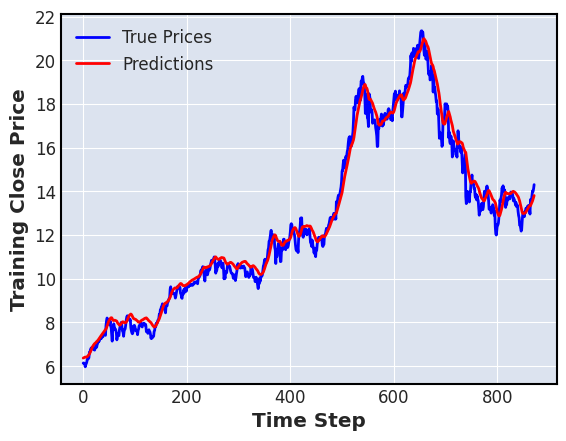

28/28 [==============================] - 0s 6ms/step


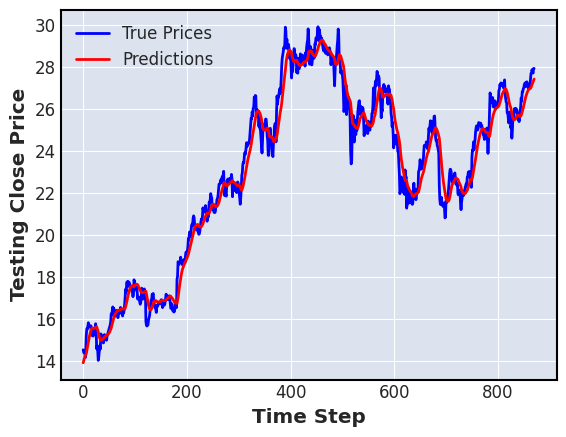

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 4s 44ms/step - loss: 1.2496e-04 - mae: 0.0089 - mse: 1.2496e-04 - mape: 78.9828 - val_loss: 6.2237e-04 - val_mae: 0.0233 - val_mse: 6.2237e-04 - val_mape: 48.0234
Epoch 2/10
28/28 [==============================] - 1s 28ms/step - loss: 3.7806e-05 - mae: 0.0049 - mse: 3.7806e-05 - mape: 43.8937 - val_loss: 6.8447e-06 - val_mae: 0.0020 - val_mse: 6.8447e-06 - val_mape: 4.4202
Epoch 3/10
28/28 [==============================] - 1s 24ms/step - loss: 4.9712e-06 - mae: 0.0018 - mse: 4.9712e-06 - mape: 14.5867 - val_loss: 6.4511e-06 - val_mae: 0.0020 - val_mse: 6.4511e-06 - val_mape: 4.2208
Epoch 4/10
28/28 [==============================] - 1s 28ms/step - loss: 3.7167e-06 - mae: 0.0015 - mse: 3.7167e-06 - mape: 11.1036 - val_loss: 6.2398e-06 - val_mae: 0.0020 - val_mse: 6.2398e-06 - val_mape: 4.2377
Epoch 5/10
28/28 [==============================] - 1s 22ms/step - lo

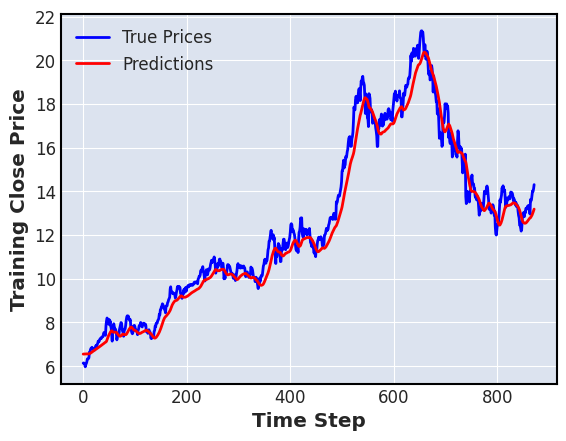

28/28 [==============================] - 0s 6ms/step


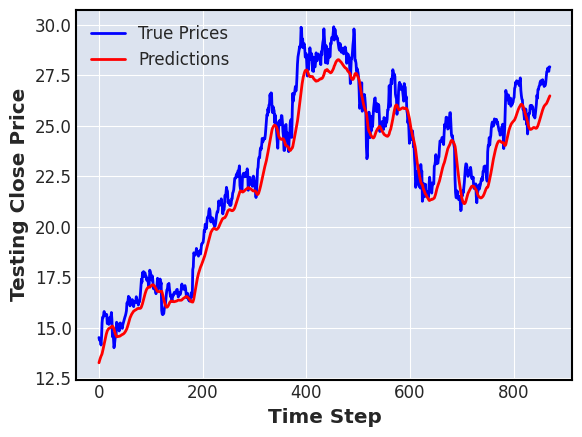

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 4s 30ms/step - loss: 1.2926e-04 - mae: 0.0068 - mse: 1.2926e-04 - mape: 35.4676 - val_loss: 1.5221e-04 - val_mae: 0.0078 - val_mse: 1.5221e-04 - val_mape: 5.6476
Epoch 2/10
55/55 [==============================] - 1s 19ms/step - loss: 2.7981e-06 - mae: 0.0013 - mse: 2.7981e-06 - mape: 5.2113 - val_loss: 1.2910e-04 - val_mae: 0.0068 - val_mse: 1.2910e-04 - val_mape: 4.8224
Epoch 3/10
55/55 [==============================] - 1s 18ms/step - loss: 2.8057e-06 - mae: 0.0013 - mse: 2.8057e-06 - mape: 5.3427 - val_loss: 1.4049e-04 - val_mae: 0.0072 - val_mse: 1.4049e-04 - val_mape: 5.1325
Epoch 4/10
55/55 [==============================] - 1s 22ms/step - loss: 2.8428e-06 - mae: 0.0013 - mse: 2.8428e-06 - mape: 5.4576 - val_loss: 1.3819e-04 - val_mae: 0.0069 - val_mse: 1.3819e-04 - val_mape: 4.8564
Epoch 5/10
55/55 [==============================] - 1s 22m

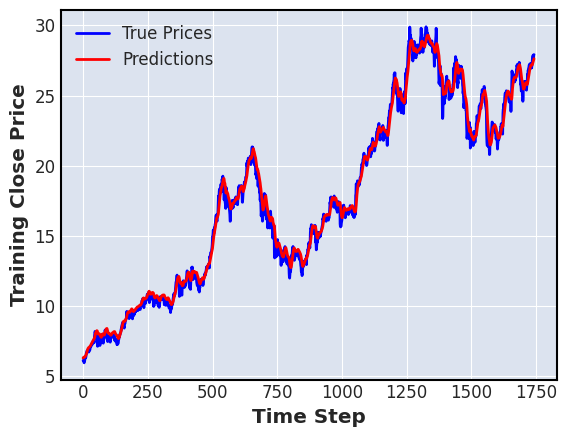

28/28 [==============================] - 0s 5ms/step


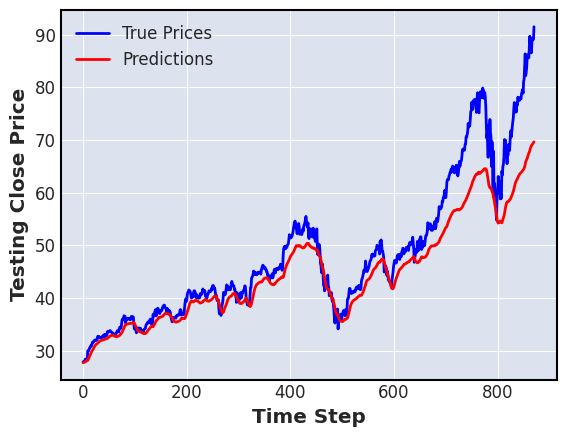

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 4s 32ms/step - loss: 1.8259e-04 - mae: 0.0098 - mse: 1.8259e-04 - mape: 58.0342 - val_loss: 6.7900e-05 - val_mae: 0.0060 - val_mse: 6.7900e-05 - val_mape: 5.6124
Epoch 2/10
55/55 [==============================] - 1s 20ms/step - loss: 4.2811e-06 - mae: 0.0016 - mse: 4.2811e-06 - mape: 7.7220 - val_loss: 5.9283e-05 - val_mae: 0.0059 - val_mse: 5.9283e-05 - val_mape: 4.8476
Epoch 3/10
55/55 [==============================] - 1s 22ms/step - loss: 3.3174e-06 - mae: 0.0014 - mse: 3.3174e-06 - mape: 5.9444 - val_loss: 5.0685e-05 - val_mae: 0.0053 - val_mse: 5.0685e-05 - val_mape: 4.2757
Epoch 4/10
55/55 [==============================] - 1s 22ms/step - loss: 3.1669e-06 - mae: 0.0014 - mse: 3.1669e-06 - mape: 5.7712 - val_loss: 5.8023e-05 - val_mae: 0.0057 - val_mse: 5.8023e-05 - val_mape: 4.5652
Epoch 5/10
55/55 [==============================] - 1s 22ms/step - loss: 

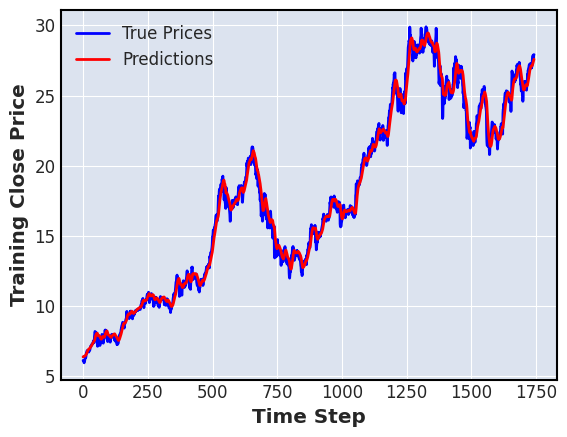

28/28 [==============================] - 0s 7ms/step


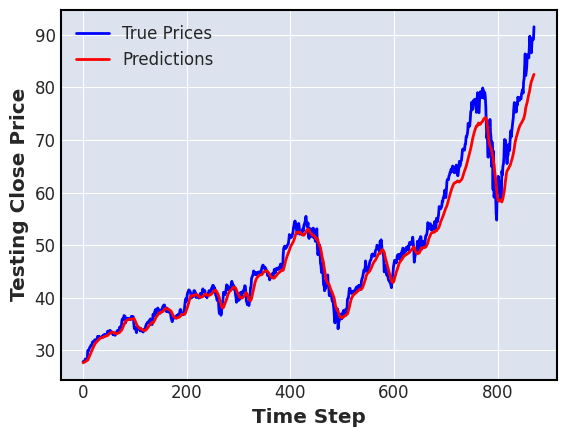

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 4s 30ms/step - loss: 1.8679e-04 - mae: 0.0099 - mse: 1.8679e-04 - mape: 56.2598 - val_loss: 4.9383e-05 - val_mae: 0.0048 - val_mse: 4.9383e-05 - val_mape: 4.1733
Epoch 2/10
55/55 [==============================] - 1s 19ms/step - loss: 5.0863e-06 - mae: 0.0018 - mse: 5.0863e-06 - mape: 8.3461 - val_loss: 5.8701e-05 - val_mae: 0.0055 - val_mse: 5.8701e-05 - val_mape: 4.3525
Epoch 3/10
55/55 [==============================] - 1s 19ms/step - loss: 3.9929e-06 - mae: 0.0015 - mse: 3.9929e-06 - mape: 6.3765 - val_loss: 9.0207e-05 - val_mae: 0.0072 - val_mse: 9.0207e-05 - val_mape: 5.7051
Epoch 4/10
55/55 [==============================] - 1s 21ms/step - loss: 7.8423e-06 - mae: 0.0022 - mse: 7.8423e-06 - mape: 10.3035 - val_loss: 6.7384e-05 - val_mae: 0.0058 - val_mse: 6.7384e-05 - val_mape: 4.4719
Epoch 5/10
55/55 [==============================] - 1s 19ms/step - loss:

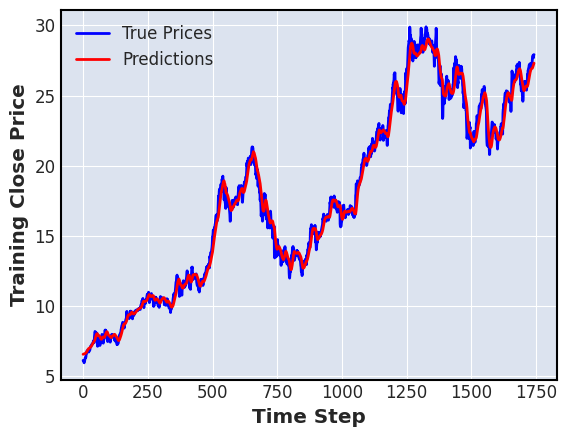

28/28 [==============================] - 0s 6ms/step


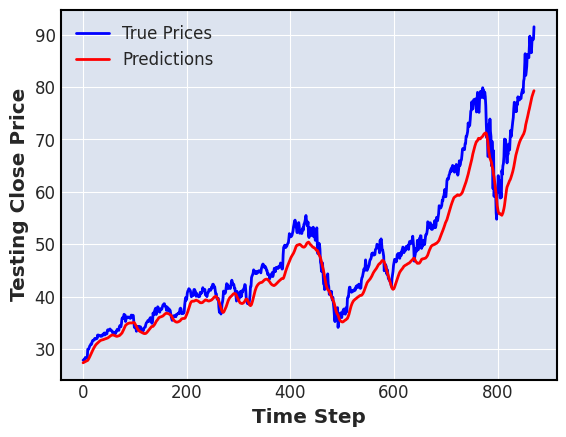

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 5s 26ms/step - loss: 5.5426e-04 - mae: 0.0103 - mse: 5.5426e-04 - mape: 31.2916 - val_loss: 2.2146e-04 - val_mae: 0.0119 - val_mse: 2.2146e-04 - val_mape: 3.2550
Epoch 2/10
82/82 [==============================] - 2s 20ms/step - loss: 1.1215e-05 - mae: 0.0022 - mse: 1.1215e-05 - mape: 5.6083 - val_loss: 2.1291e-04 - val_mae: 0.0118 - val_mse: 2.1291e-04 - val_mape: 3.2094
Epoch 3/10
82/82 [==============================] - 2s 19ms/step - loss: 1.0944e-05 - mae: 0.0022 - mse: 1.0944e-05 - mape: 5.4559 - val_loss: 2.4126e-04 - val_mae: 0.0126 - val_mse: 2.4126e-04 - val_mape: 3.2665
Epoch 4/10
82/82 [==============================] - 2s 19ms/step - loss: 1.0778e-05 - mae: 0.0023 - mse: 1.0778e-05 - mape: 6.2906 - val_loss: 2.7893e-04 - val_mae: 0.0135 - val_mse: 2.7893e-04 - val_mape: 3.4580
Epoch 5/10
82/82 [==============================] - 1s 18m

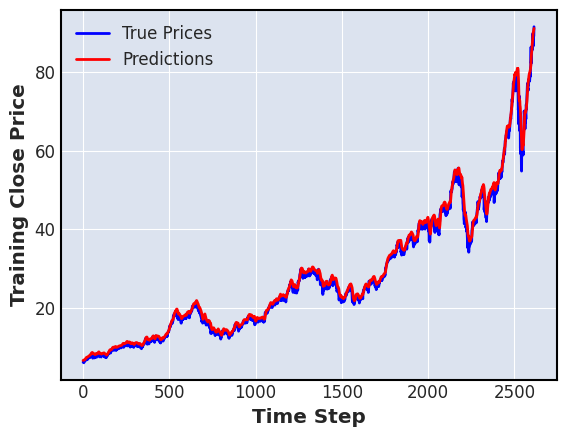

28/28 [==============================] - 0s 6ms/step


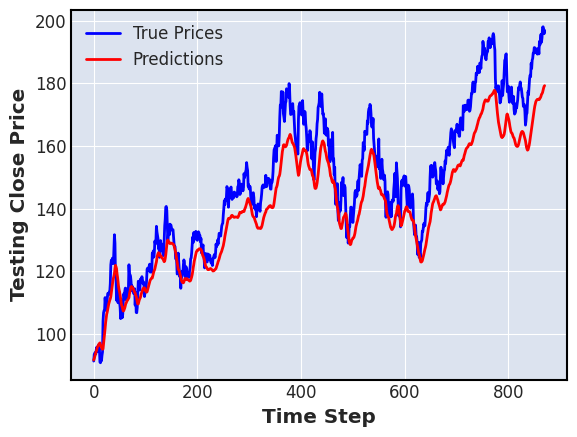

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 5s 25ms/step - loss: 5.2578e-04 - mae: 0.0119 - mse: 5.2578e-04 - mape: 39.7857 - val_loss: 2.9636e-04 - val_mae: 0.0134 - val_mse: 2.9636e-04 - val_mape: 3.6804
Epoch 2/10
82/82 [==============================] - 1s 18ms/step - loss: 1.2255e-05 - mae: 0.0023 - mse: 1.2255e-05 - mape: 5.2664 - val_loss: 2.2983e-04 - val_mae: 0.0124 - val_mse: 2.2983e-04 - val_mape: 3.3411
Epoch 3/10
82/82 [==============================] - 2s 19ms/step - loss: 1.1254e-05 - mae: 0.0021 - mse: 1.1254e-05 - mape: 5.1682 - val_loss: 2.2470e-04 - val_mae: 0.0123 - val_mse: 2.2470e-04 - val_mape: 3.2836
Epoch 4/10
82/82 [==============================] - 1s 18ms/step - loss: 1.2394e-05 - mae: 0.0024 - mse: 1.2394e-05 - mape: 6.3604 - val_loss: 2.6107e-04 - val_mae: 0.0131 - val_mse: 2.6107e-04 - val_mape: 3.4124
Epoch 5/10
82/82 [==============================] - 2s 20ms/step - loss: 

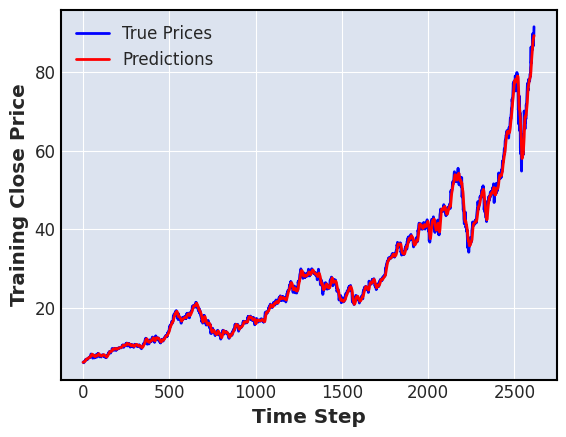

28/28 [==============================] - 0s 6ms/step


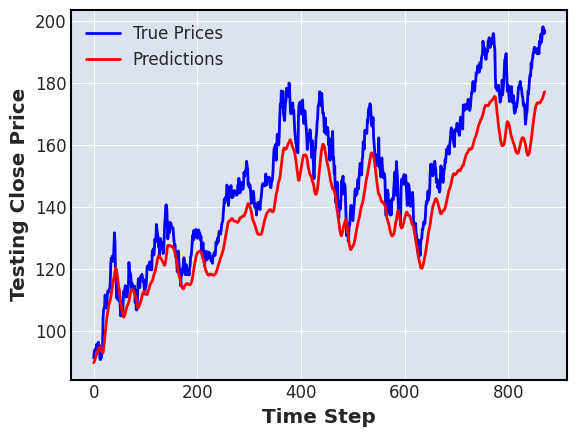

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 5s 25ms/step - loss: 6.1550e-04 - mae: 0.0138 - mse: 6.1550e-04 - mape: 50.6957 - val_loss: 5.6632e-04 - val_mae: 0.0190 - val_mse: 5.6632e-04 - val_mape: 5.1151
Epoch 2/10
82/82 [==============================] - 1s 18ms/step - loss: 2.0118e-05 - mae: 0.0031 - mse: 2.0118e-05 - mape: 9.1175 - val_loss: 6.4913e-04 - val_mae: 0.0207 - val_mse: 6.4913e-04 - val_mape: 5.5596
Epoch 3/10
82/82 [==============================] - 2s 20ms/step - loss: 1.5798e-05 - mae: 0.0026 - mse: 1.5798e-05 - mape: 7.1567 - val_loss: 6.2099e-04 - val_mae: 0.0203 - val_mse: 6.2099e-04 - val_mape: 5.4242
Epoch 4/10
82/82 [==============================] - 1s 18ms/step - loss: 1.5986e-05 - mae: 0.0027 - mse: 1.5986e-05 - mape: 7.3454 - val_loss: 2.6646e-04 - val_mae: 0.0128 - val_mse: 2.6646e-04 - val_mape: 3.4839
Epoch 5/10
82/82 [==============================] - 1s 18ms/step - loss: 

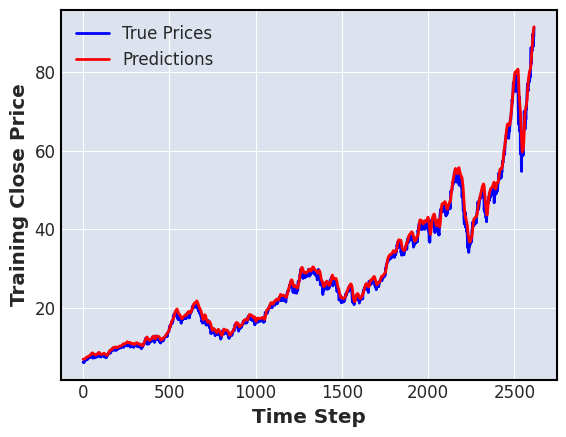

28/28 [==============================] - 0s 5ms/step


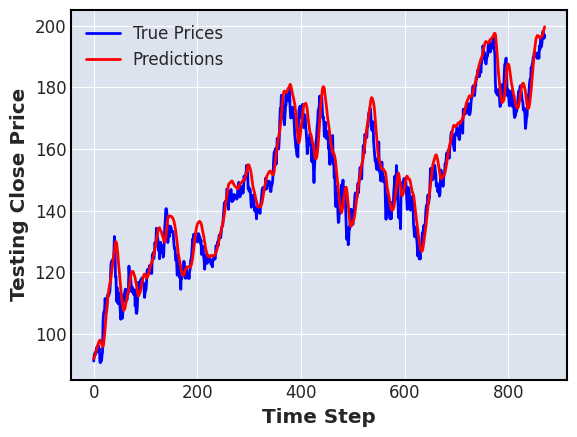

---------------------------------------------------------------
ticker_name :  MSFT Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 4s 50ms/step - loss: 3.2858e-04 - mae: 0.0126 - mse: 3.2858e-04 - mape: 28.0241 - val_loss: 0.0015 - val_mae: 0.0354 - val_mse: 0.0015 - val_mape: 35.4380
Epoch 2/10
28/28 [==============================] - 1s 28ms/step - loss: 3.6045e-05 - mae: 0.0048 - mse: 3.6045e-05 - mape: 11.0926 - val_loss: 0.0016 - val_mae: 0.0364 - val_mse: 0.0016 - val_mape: 36.6918
Epoch 3/10
28/28 [==============================] - 1s 28ms/step - loss: 2.7584e-05 - mae: 0.0042 - mse: 2.7584e-05 - mape: 9.2457 - val_loss: 0.0013 - val_mae: 0.0336 - val_mse: 0.0013 - val_mape: 33.8114
Epoch 4/10
28/28 [==============================] - 1s 22ms/step - loss: 2.4105e-05 - mae: 0.0040 - mse: 2.4105e-05 - mape: 9.0106 - val_loss: 0.0013 - val_mae: 0.0331 - val_mse: 0.0013 - val_mape: 33.5655
Epoch 5/10
28/28 [=======================

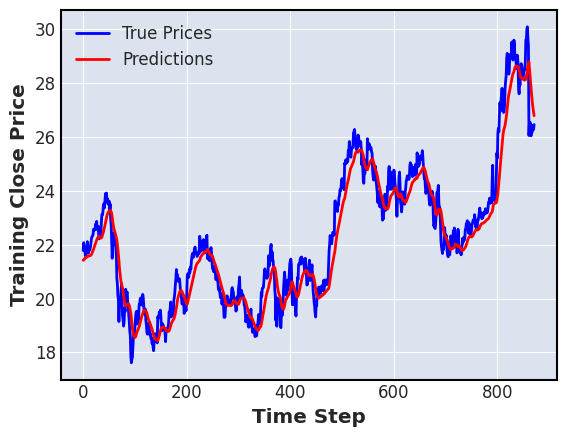

28/28 [==============================] - 0s 6ms/step


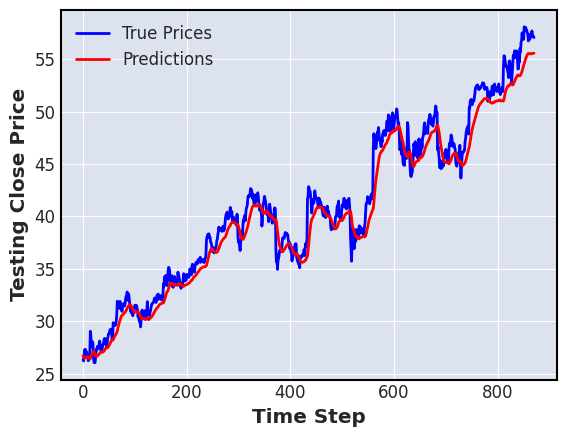

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 6s 47ms/step - loss: 3.1975e-04 - mae: 0.0130 - mse: 3.1975e-04 - mape: 28.9776 - val_loss: 0.0020 - val_mae: 0.0409 - val_mse: 0.0020 - val_mape: 41.2117
Epoch 2/10
28/28 [==============================] - 1s 22ms/step - loss: 3.5776e-05 - mae: 0.0049 - mse: 3.5776e-05 - mape: 11.0777 - val_loss: 0.0018 - val_mae: 0.0386 - val_mse: 0.0018 - val_mape: 38.8617
Epoch 3/10
28/28 [==============================] - 1s 23ms/step - loss: 3.1664e-05 - mae: 0.0045 - mse: 3.1664e-05 - mape: 10.2541 - val_loss: 0.0017 - val_mae: 0.0377 - val_mse: 0.0017 - val_mape: 38.1388
Epoch 4/10
28/28 [==============================] - 1s 22ms/step - loss: 2.7078e-05 - mae: 0.0042 - mse: 2.7078e-05 - mape: 9.3200 - val_loss: 0.0014 - val_mae: 0.0338 - val_mse: 0.0014 - val_mape: 34.0668
Epoch 5/10
28/28 [==============================] - 1s 28ms/step - loss: 2.3297e-05 - mae: 0.0039 -

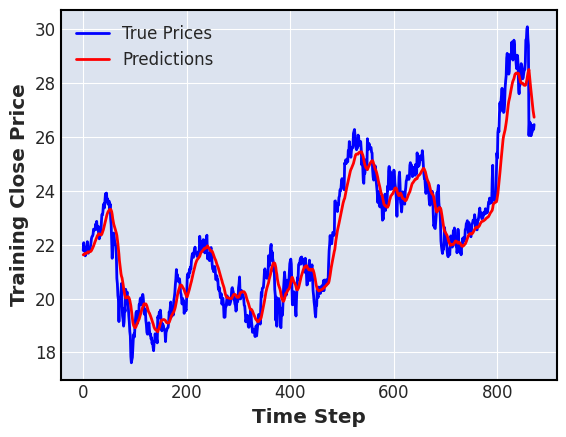

28/28 [==============================] - 0s 6ms/step


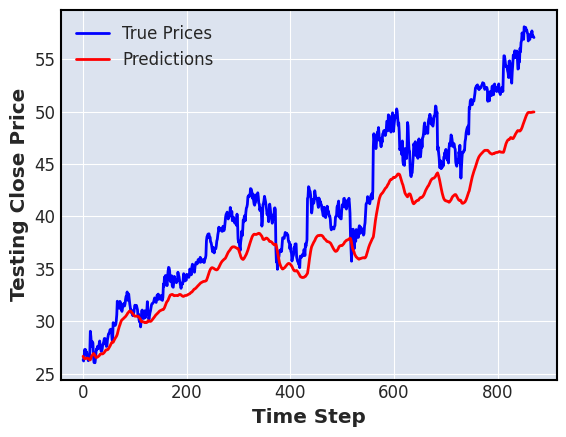

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 4s 45ms/step - loss: 3.3603e-04 - mae: 0.0134 - mse: 3.3603e-04 - mape: 29.7616 - val_loss: 0.0018 - val_mae: 0.0385 - val_mse: 0.0018 - val_mape: 38.5050
Epoch 2/10
28/28 [==============================] - 1s 23ms/step - loss: 4.2864e-05 - mae: 0.0053 - mse: 4.2864e-05 - mape: 12.1683 - val_loss: 0.0021 - val_mae: 0.0422 - val_mse: 0.0021 - val_mape: 42.7243
Epoch 3/10
28/28 [==============================] - 1s 23ms/step - loss: 3.4197e-05 - mae: 0.0047 - mse: 3.4197e-05 - mape: 10.5208 - val_loss: 0.0019 - val_mae: 0.0400 - val_mse: 0.0019 - val_mape: 40.4049
Epoch 4/10
28/28 [==============================] - 1s 23ms/step - loss: 3.0820e-05 - mae: 0.0045 - mse: 3.0820e-05 - mape: 9.9942 - val_loss: 0.0015 - val_mae: 0.0360 - val_mse: 0.0015 - val_mape: 36.3236
Epoch 5/10
28/28 [==============================] - 1s 22ms/step - loss: 2.5921e-05 - mae: 0.0041 -

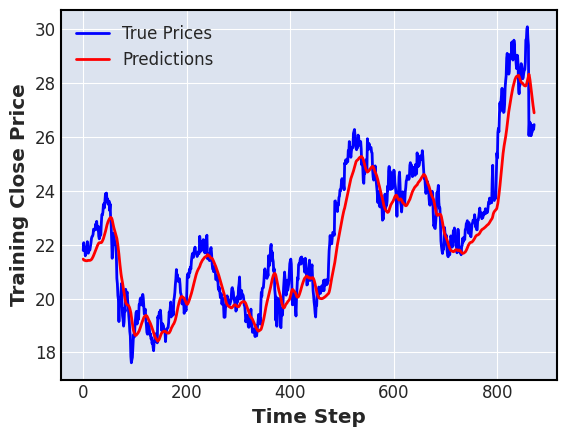

28/28 [==============================] - 0s 6ms/step


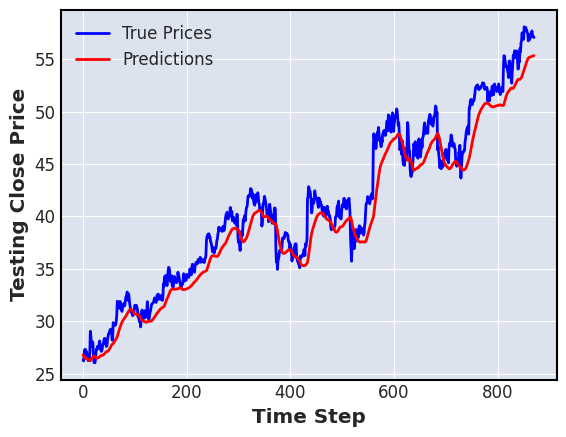

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 4s 31ms/step - loss: 7.5071e-04 - mae: 0.0187 - mse: 7.5071e-04 - mape: 29.3985 - val_loss: 0.0011 - val_mae: 0.0277 - val_mse: 0.0011 - val_mape: 9.3490
Epoch 2/10
55/55 [==============================] - 1s 19ms/step - loss: 1.0065e-05 - mae: 0.0023 - mse: 1.0065e-05 - mape: 3.5854 - val_loss: 6.4425e-04 - val_mae: 0.0194 - val_mse: 6.4425e-04 - val_mape: 6.1924
Epoch 3/10
55/55 [==============================] - 1s 20ms/step - loss: 6.3657e-06 - mae: 0.0018 - mse: 6.3657e-06 - mape: 2.7453 - val_loss: 7.6343e-04 - val_mae: 0.0215 - val_mse: 7.6343e-04 - val_mape: 6.9227
Epoch 4/10
55/55 [==============================] - 1s 22ms/step - loss: 6.8190e-06 - mae: 0.0019 - mse: 6.8190e-06 - mape: 2.8639 - val_loss: 7.4964e-04 - val_mae: 0.0210 - val_mse: 7.4964e-04 - val_mape: 6.6774
Epoch 5/10
55/55 [==============================] - 1s 19ms/step -

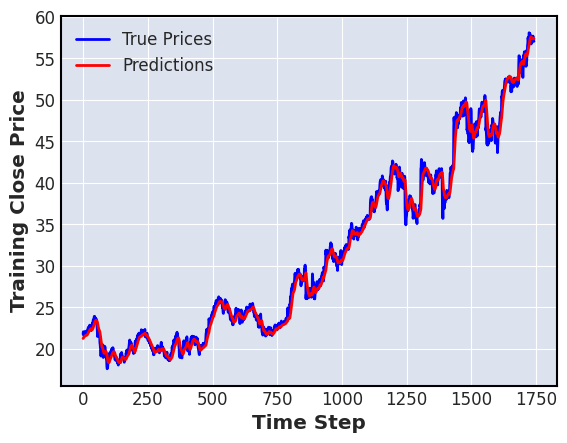

28/28 [==============================] - 0s 6ms/step


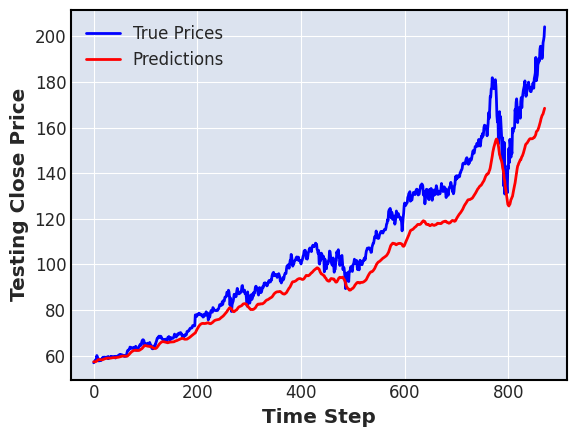

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 4s 33ms/step - loss: 6.9965e-04 - mae: 0.0187 - mse: 6.9965e-04 - mape: 29.8799 - val_loss: 0.0018 - val_mae: 0.0328 - val_mse: 0.0018 - val_mape: 10.3162
Epoch 2/10
55/55 [==============================] - 1s 19ms/step - loss: 1.1081e-05 - mae: 0.0025 - mse: 1.1081e-05 - mape: 3.8947 - val_loss: 0.0024 - val_mae: 0.0391 - val_mse: 0.0024 - val_mape: 12.6777
Epoch 3/10
55/55 [==============================] - 1s 19ms/step - loss: 7.1277e-06 - mae: 0.0019 - mse: 7.1277e-06 - mape: 2.9931 - val_loss: 0.0025 - val_mae: 0.0400 - val_mse: 0.0025 - val_mape: 12.9563
Epoch 4/10
55/55 [==============================] - 1s 19ms/step - loss: 7.3859e-06 - mae: 0.0020 - mse: 7.3859e-06 - mape: 3.1329 - val_loss: 0.0022 - val_mae: 0.0363 - val_mse: 0.0022 - val_mape: 11.4573
Epoch 5/10
55/55 [==============================] - 1s 21ms/step - loss: 7.5210e-06 - mae: 0.0020 - m

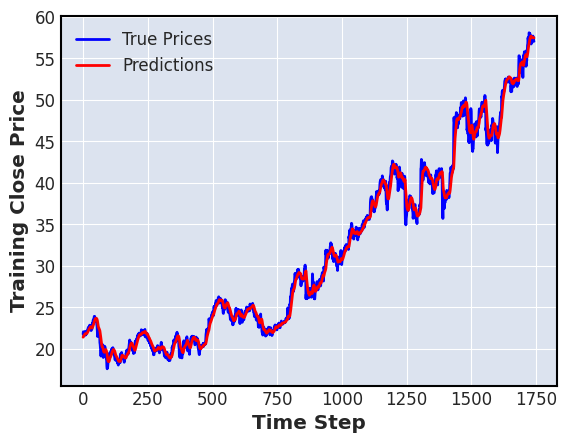

28/28 [==============================] - 0s 6ms/step


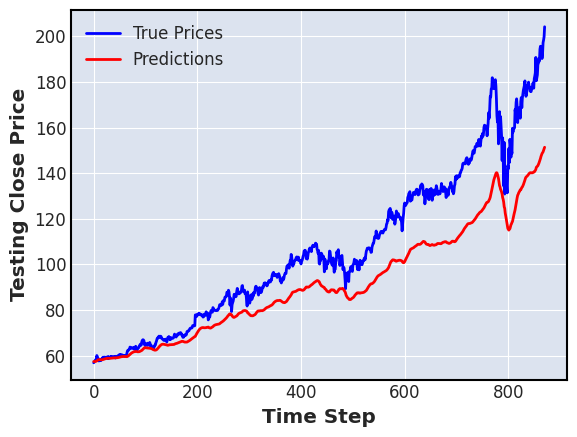

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 4s 33ms/step - loss: 8.7789e-04 - mae: 0.0223 - mse: 8.7789e-04 - mape: 35.6189 - val_loss: 0.0040 - val_mae: 0.0559 - val_mse: 0.0040 - val_mape: 19.5820
Epoch 2/10
55/55 [==============================] - 1s 19ms/step - loss: 2.2508e-05 - mae: 0.0034 - mse: 2.2508e-05 - mape: 5.5554 - val_loss: 4.8497e-04 - val_mae: 0.0155 - val_mse: 4.8497e-04 - val_mape: 5.1644
Epoch 3/10
55/55 [==============================] - 1s 22ms/step - loss: 8.9226e-06 - mae: 0.0021 - mse: 8.9226e-06 - mape: 3.2817 - val_loss: 2.6425e-04 - val_mae: 0.0100 - val_mse: 2.6425e-04 - val_mape: 3.3312
Epoch 4/10
55/55 [==============================] - 1s 19ms/step - loss: 8.6654e-06 - mae: 0.0021 - mse: 8.6654e-06 - mape: 3.2468 - val_loss: 3.8338e-04 - val_mae: 0.0134 - val_mse: 3.8338e-04 - val_mape: 4.4757
Epoch 5/10
55/55 [==============================] - 1s 22ms/step - loss: 9.2436e

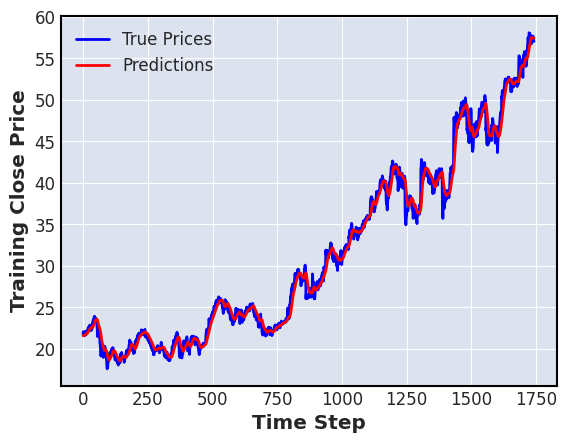

28/28 [==============================] - 0s 7ms/step


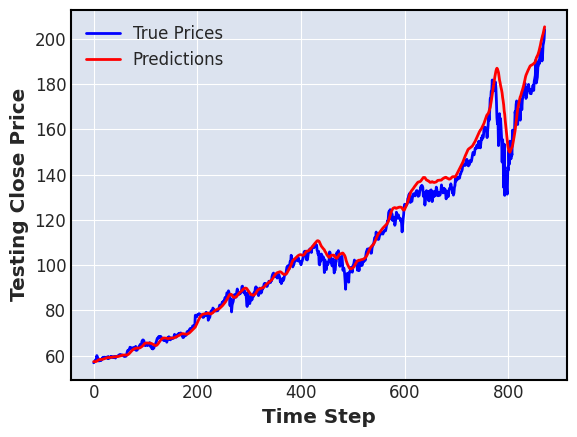

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 5s 26ms/step - loss: 0.0043 - mae: 0.0307 - mse: 0.0043 - mape: 28.0037 - val_loss: 0.0057 - val_mae: 0.0679 - val_mse: 0.0057 - val_mape: 9.5123
Epoch 2/10
82/82 [==============================] - 2s 20ms/step - loss: 4.1126e-05 - mae: 0.0035 - mse: 4.1126e-05 - mape: 2.9942 - val_loss: 0.0014 - val_mae: 0.0293 - val_mse: 0.0014 - val_mape: 4.1780
Epoch 3/10
82/82 [==============================] - 2s 18ms/step - loss: 4.0138e-05 - mae: 0.0035 - mse: 4.0138e-05 - mape: 2.8979 - val_loss: 9.2656e-04 - val_mae: 0.0236 - val_mse: 9.2656e-04 - val_mape: 3.4043
Epoch 4/10
82/82 [==============================] - 2s 20ms/step - loss: 3.8874e-05 - mae: 0.0037 - mse: 3.8874e-05 - mape: 3.4793 - val_loss: 0.0015 - val_mae: 0.0317 - val_mse: 0.0015 - val_mape: 4.5437
Epoch 5/10
82/82 [==============================] - 2s 18ms/step - loss: 3.8822e-05 - mae:

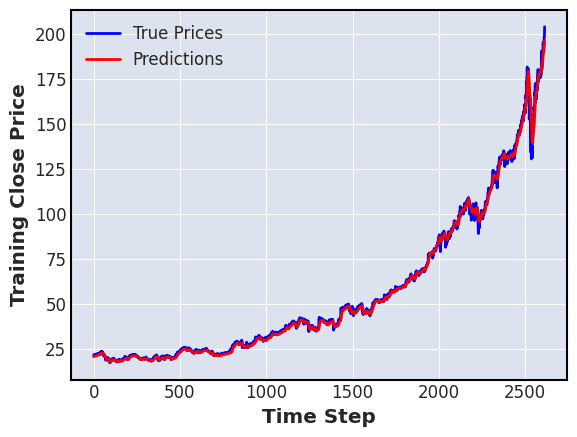

28/28 [==============================] - 0s 6ms/step


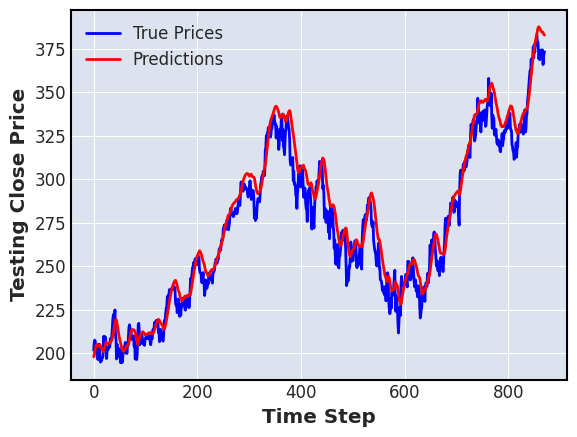

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 5s 26ms/step - loss: 0.0034 - mae: 0.0294 - mse: 0.0034 - mape: 28.6526 - val_loss: 0.0029 - val_mae: 0.0449 - val_mse: 0.0029 - val_mape: 6.2716
Epoch 2/10
82/82 [==============================] - 2s 19ms/step - loss: 5.0287e-05 - mae: 0.0041 - mse: 5.0287e-05 - mape: 3.4805 - val_loss: 0.0012 - val_mae: 0.0265 - val_mse: 0.0012 - val_mape: 3.7766
Epoch 3/10
82/82 [==============================] - 2s 19ms/step - loss: 4.1051e-05 - mae: 0.0035 - mse: 4.1051e-05 - mape: 2.9153 - val_loss: 0.0014 - val_mae: 0.0301 - val_mse: 0.0014 - val_mape: 4.3045
Epoch 4/10
82/82 [==============================] - 2s 19ms/step - loss: 4.8067e-05 - mae: 0.0040 - mse: 4.8067e-05 - mape: 3.4565 - val_loss: 0.0027 - val_mae: 0.0445 - val_mse: 0.0027 - val_mape: 6.4162
Epoch 5/10
82/82 [==============================] - 1s 18ms/step - loss: 4.7575e-05 - mae: 0.0044 - mse: 4.7575e-

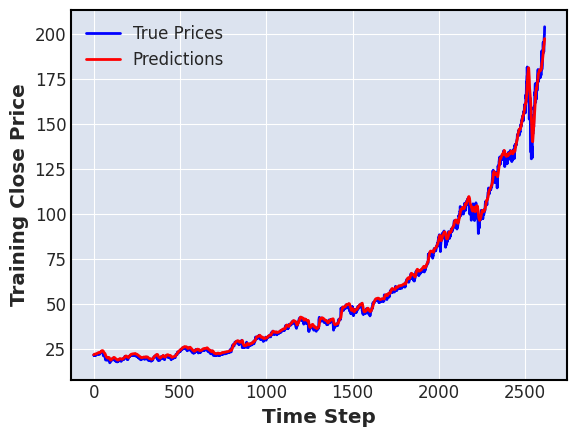

28/28 [==============================] - 0s 5ms/step


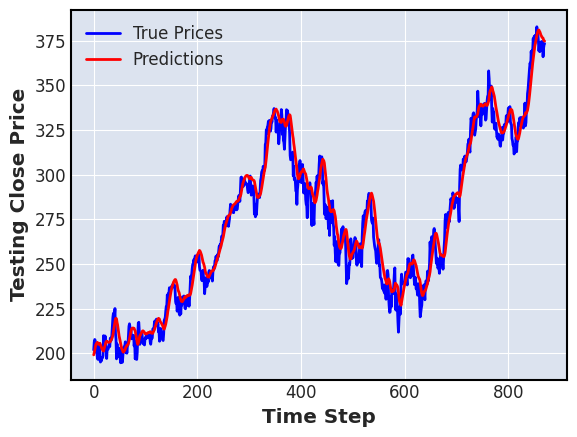

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 5s 25ms/step - loss: 0.0036 - mae: 0.0316 - mse: 0.0036 - mape: 32.2006 - val_loss: 0.0018 - val_mae: 0.0339 - val_mse: 0.0018 - val_mape: 4.9346
Epoch 2/10
82/82 [==============================] - 2s 20ms/step - loss: 6.9568e-05 - mae: 0.0051 - mse: 6.9568e-05 - mape: 4.9146 - val_loss: 8.8095e-04 - val_mae: 0.0239 - val_mse: 8.8095e-04 - val_mape: 3.4174
Epoch 3/10
82/82 [==============================] - 1s 18ms/step - loss: 5.2553e-05 - mae: 0.0042 - mse: 5.2553e-05 - mape: 3.5466 - val_loss: 0.0013 - val_mae: 0.0290 - val_mse: 0.0013 - val_mape: 3.8979
Epoch 4/10
82/82 [==============================] - 2s 20ms/step - loss: 4.8580e-05 - mae: 0.0041 - mse: 4.8580e-05 - mape: 3.6523 - val_loss: 0.0012 - val_mae: 0.0271 - val_mse: 0.0012 - val_mape: 3.6764
Epoch 5/10
82/82 [==============================] - 2s 18ms/step - loss: 4.8503e-05 - mae: 0.0039 - mse: 

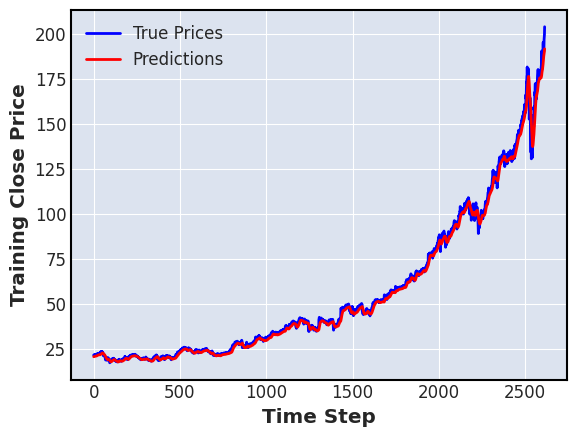

28/28 [==============================] - 0s 6ms/step


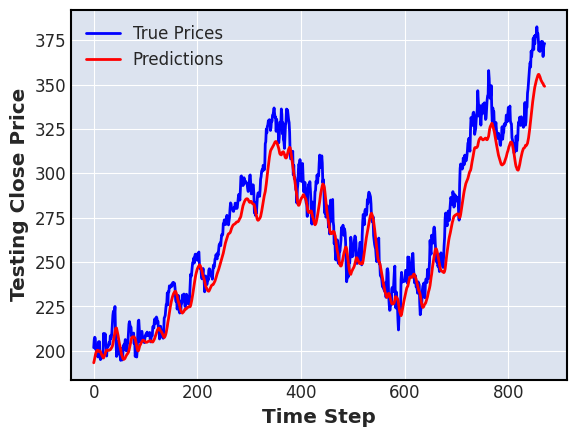

---------------------------------------------------------------


In [ ]:
number_of_runs = 0
for ticker_index, ticker_name in enumerate(My_Tickers_SP500):
    full_data = x_tickers_sp500[ticker_index]
    target = y_tickers_sp500[ticker_index]
    print('ticker_name : ' ,ticker_name[0], ticker_name[1] , ' , length = ', len(full_data))
    # Time Series Split
    for j, (train_index, test_index) in enumerate(tss.split(full_data)):
        print('kth split : ', j)
        # Different Seeds
        for new_seed in range(3):
            print('seed : ', new_seed)
            seed_value = new_seed
            random.seed(seed_value)
            np.random.seed(seed_value)
            tf.random.set_seed(seed_value)
            utils.set_random_seed(seed_value)

            number_of_runs += 1
            full_data = np.reshape(full_data, (full_data.shape[0], full_data.shape[1], 1))
        
            X_train, X_val = full_data[train_index], full_data[test_index]
            y_train, y_val = target[train_index], target[test_index]

            lstm_model = StockPredictionModel(n_steps=full_data.shape[1], model='LSTM')
            lstm_model.fit(X_train, y_train, X_val, y_val, epoch=10)
            
            train_pred = lstm_model.predict(X_train)
            train_pred = scaler.inverse_transform(train_pred.reshape(-1, 1))
            y_train_ = scaler.inverse_transform(y_train.reshape(-1, 1))
            plot_results(train_pred, y_train_, 'Training')
            test_pred = lstm_model.predict(X_val)
            test_pred = scaler.inverse_transform(test_pred.reshape(-1, 1))
            y_val_ = scaler.inverse_transform(y_val.reshape(-1, 1))
            plot_results(test_pred, y_val_, 'Testing')  
            print('---------------------------------------------------------------')

### Bi_LSTM

ticker_name :  AMZN Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 7s 71ms/step - loss: 2.6470e-05 - mae: 0.0039 - mse: 2.6470e-05 - mape: 10514.3037 - val_loss: 2.3101e-04 - val_mae: 0.0129 - val_mse: 2.3101e-04 - val_mape: 24.0328
Epoch 2/10
28/28 [==============================] - 1s 31ms/step - loss: 4.2948e-06 - mae: 0.0016 - mse: 4.2948e-06 - mape: 6506.8364 - val_loss: 2.1069e-05 - val_mae: 0.0035 - val_mse: 2.1069e-05 - val_mape: 8.3392
Epoch 3/10
28/28 [==============================] - 1s 31ms/step - loss: 2.8431e-06 - mae: 0.0013 - mse: 2.8431e-06 - mape: 2480.0264 - val_loss: 1.9754e-05 - val_mae: 0.0034 - val_mse: 1.9754e-05 - val_mape: 6.9430
Epoch 4/10
28/28 [==============================] - 1s 32ms/step - loss: 2.2221e-06 - mae: 0.0012 - mse: 2.2221e-06 - mape: 2032.6284 - val_loss: 1.9229e-05 - val_mae: 0.0034 - val_mse: 1.9229e-05 - val_mape: 6.8961
Epoch 5/10
28/28 [==============================] - 1s 33ms/step 

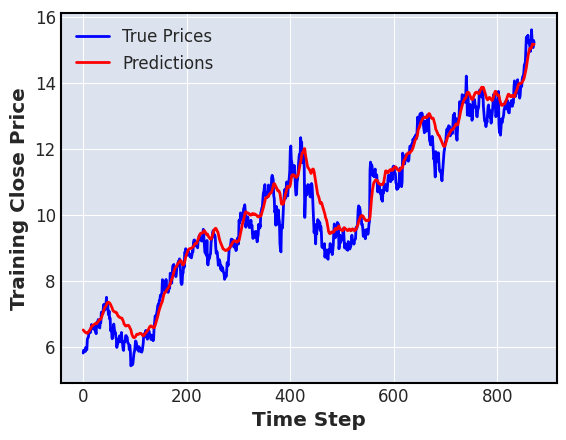

28/28 [==============================] - 0s 9ms/step


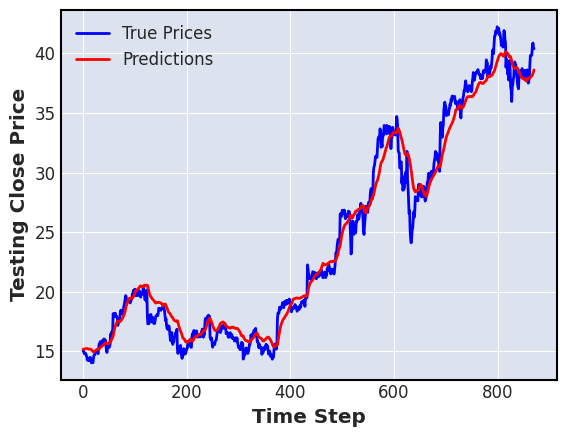

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 9s 73ms/step - loss: 3.7051e-05 - mae: 0.0048 - mse: 3.7051e-05 - mape: 7863.6699 - val_loss: 5.8367e-04 - val_mae: 0.0206 - val_mse: 5.8367e-04 - val_mape: 37.9610
Epoch 2/10
28/28 [==============================] - 1s 32ms/step - loss: 8.7238e-06 - mae: 0.0024 - mse: 8.7238e-06 - mape: 6024.6812 - val_loss: 6.5955e-05 - val_mae: 0.0065 - val_mse: 6.5955e-05 - val_mape: 11.7315
Epoch 3/10
28/28 [==============================] - 1s 32ms/step - loss: 2.2771e-06 - mae: 0.0012 - mse: 2.2771e-06 - mape: 3502.7576 - val_loss: 1.4633e-05 - val_mae: 0.0029 - val_mse: 1.4633e-05 - val_mape: 6.2880
Epoch 4/10
28/28 [==============================] - 1s 36ms/step - loss: 1.9690e-06 - mae: 0.0011 - mse: 1.9690e-06 - mape: 2013.0002 - val_loss: 2.4988e-05 - val_mae: 0.0039 - val_mse: 2.4988e-05 - val_mape: 7.3200
Epoch 5/10
28/28 [==============================] - 1s 37ms/

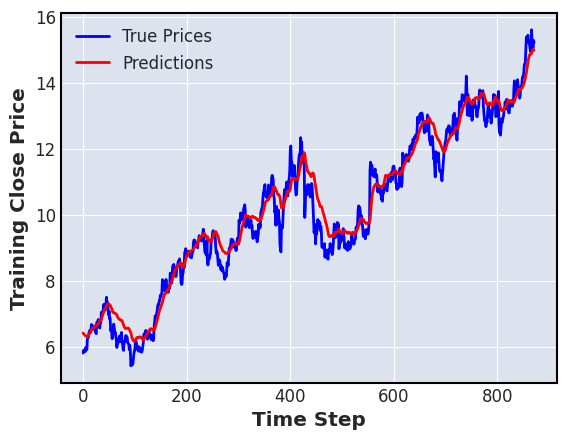

28/28 [==============================] - 0s 8ms/step


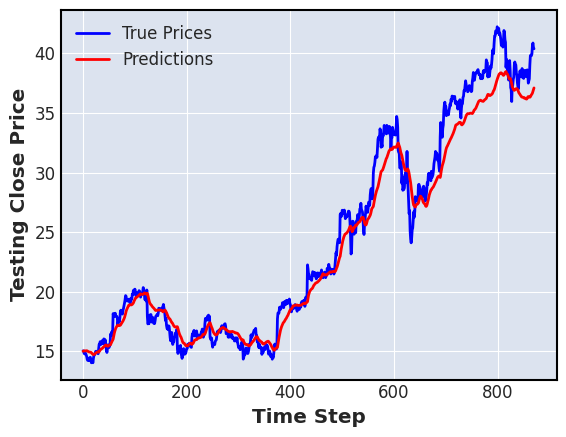

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 7s 77ms/step - loss: 2.1476e-05 - mae: 0.0034 - mse: 2.1476e-05 - mape: 7770.8081 - val_loss: 1.3142e-04 - val_mae: 0.0095 - val_mse: 1.3142e-04 - val_mape: 17.5187
Epoch 2/10
28/28 [==============================] - 1s 34ms/step - loss: 4.9242e-06 - mae: 0.0018 - mse: 4.9242e-06 - mape: 2665.6123 - val_loss: 1.6887e-05 - val_mae: 0.0031 - val_mse: 1.6887e-05 - val_mape: 6.9331
Epoch 3/10
28/28 [==============================] - 1s 31ms/step - loss: 2.5035e-06 - mae: 0.0013 - mse: 2.5035e-06 - mape: 2054.3657 - val_loss: 2.0345e-05 - val_mae: 0.0035 - val_mse: 2.0345e-05 - val_mape: 7.0499
Epoch 4/10
28/28 [==============================] - 1s 34ms/step - loss: 2.5657e-06 - mae: 0.0013 - mse: 2.5657e-06 - mape: 1846.2634 - val_loss: 2.0652e-05 - val_mae: 0.0035 - val_mse: 2.0652e-05 - val_mape: 7.0344
Epoch 5/10
28/28 [==============================] - 1s 35ms/s

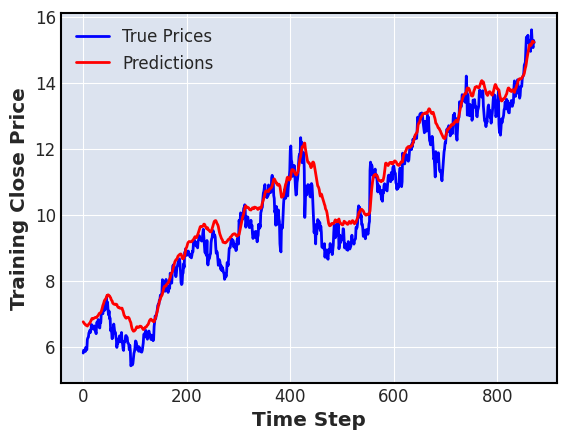

28/28 [==============================] - 0s 8ms/step


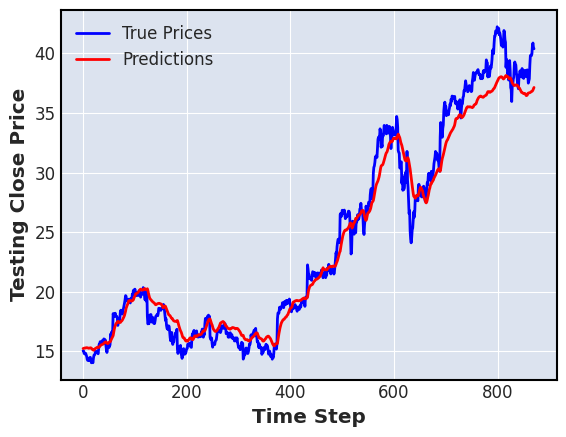

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 7s 47ms/step - loss: 8.2317e-05 - mae: 0.0054 - mse: 8.2317e-05 - mape: 4120.3188 - val_loss: 2.2439e-04 - val_mae: 0.0107 - val_mse: 2.2439e-04 - val_mape: 5.3506
Epoch 2/10
55/55 [==============================] - 2s 29ms/step - loss: 9.8098e-06 - mae: 0.0022 - mse: 9.8098e-06 - mape: 1874.6991 - val_loss: 1.8444e-04 - val_mae: 0.0096 - val_mse: 1.8444e-04 - val_mape: 4.7968
Epoch 3/10
55/55 [==============================] - 2s 31ms/step - loss: 8.3617e-06 - mae: 0.0020 - mse: 8.3617e-06 - mape: 1195.5121 - val_loss: 1.3400e-04 - val_mae: 0.0082 - val_mse: 1.3400e-04 - val_mape: 3.9937
Epoch 4/10
55/55 [==============================] - 2s 28ms/step - loss: 7.6120e-06 - mae: 0.0019 - mse: 7.6120e-06 - mape: 1129.4619 - val_loss: 1.1961e-04 - val_mae: 0.0076 - val_mse: 1.1961e-04 - val_mape: 3.6660
Epoch 5/10
55/55 [=============================

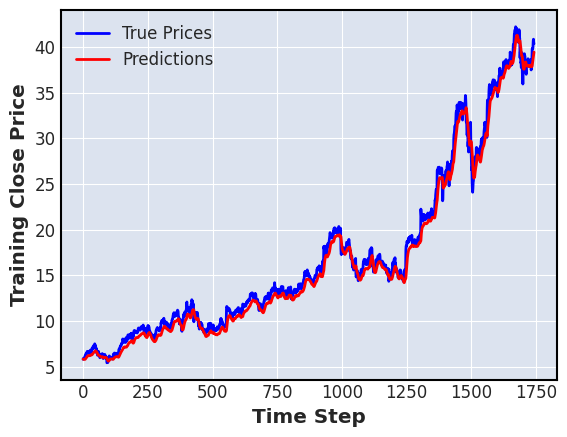

28/28 [==============================] - 0s 8ms/step


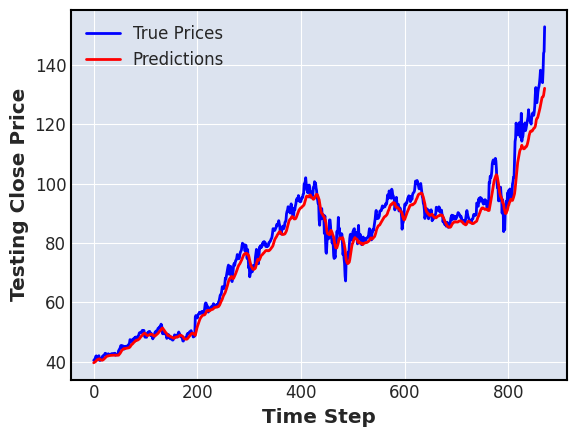

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 9s 47ms/step - loss: 1.0738e-04 - mae: 0.0064 - mse: 1.0738e-04 - mape: 12463.2832 - val_loss: 1.4706e-04 - val_mae: 0.0084 - val_mse: 1.4706e-04 - val_mape: 4.0418
Epoch 2/10
55/55 [==============================] - 1s 27ms/step - loss: 8.0476e-06 - mae: 0.0020 - mse: 8.0476e-06 - mape: 1934.2708 - val_loss: 1.9797e-04 - val_mae: 0.0101 - val_mse: 1.9797e-04 - val_mape: 4.7992
Epoch 3/10
55/55 [==============================] - 1s 27ms/step - loss: 7.4919e-06 - mae: 0.0019 - mse: 7.4919e-06 - mape: 831.3509 - val_loss: 1.6995e-04 - val_mae: 0.0091 - val_mse: 1.6995e-04 - val_mape: 4.2398
Epoch 4/10
55/55 [==============================] - 2s 32ms/step - loss: 6.9465e-06 - mae: 0.0019 - mse: 6.9465e-06 - mape: 1729.8524 - val_loss: 1.7144e-04 - val_mae: 0.0091 - val_mse: 1.7144e-04 - val_mape: 4.1860
Epoch 5/10
55/55 [==============================] - 1s 27ms/st

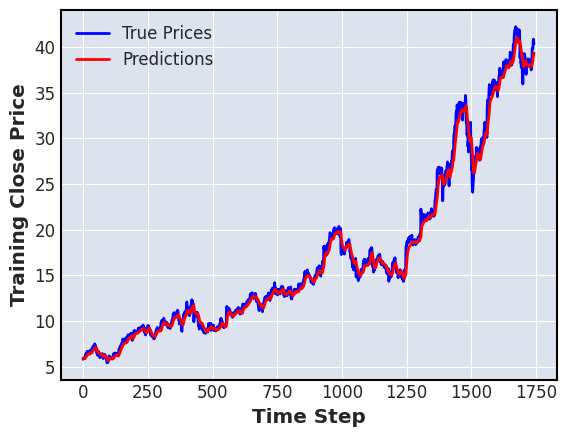

28/28 [==============================] - 0s 9ms/step


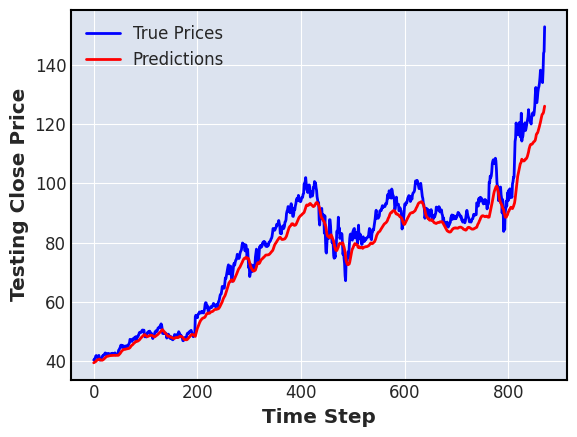

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 7s 48ms/step - loss: 9.9991e-05 - mae: 0.0056 - mse: 9.9991e-05 - mape: 9374.5371 - val_loss: 1.8170e-04 - val_mae: 0.0095 - val_mse: 1.8170e-04 - val_mape: 4.7396
Epoch 2/10
55/55 [==============================] - 2s 28ms/step - loss: 1.0511e-05 - mae: 0.0023 - mse: 1.0511e-05 - mape: 565.8580 - val_loss: 1.5569e-04 - val_mae: 0.0089 - val_mse: 1.5569e-04 - val_mape: 4.3318
Epoch 3/10
55/55 [==============================] - 2s 28ms/step - loss: 8.9299e-06 - mae: 0.0021 - mse: 8.9299e-06 - mape: 899.4563 - val_loss: 1.5618e-04 - val_mae: 0.0088 - val_mse: 1.5618e-04 - val_mape: 4.3165
Epoch 4/10
55/55 [==============================] - 2s 28ms/step - loss: 8.3497e-06 - mae: 0.0021 - mse: 8.3497e-06 - mape: 1607.6210 - val_loss: 1.4204e-04 - val_mae: 0.0082 - val_mse: 1.4204e-04 - val_mape: 3.9625
Epoch 5/10
55/55 [==============================] - 1s 27ms/step

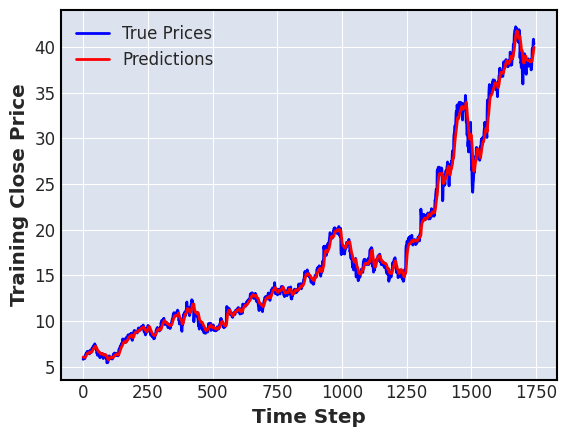

28/28 [==============================] - 0s 8ms/step


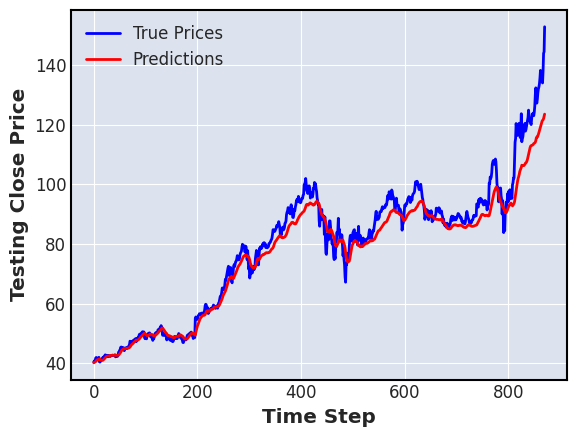

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 8s 45ms/step - loss: 6.0992e-04 - mae: 0.0134 - mse: 6.0992e-04 - mape: 15275.1221 - val_loss: 9.8352e-04 - val_mae: 0.0243 - val_mse: 9.8352e-04 - val_mape: 7.2083
Epoch 2/10
82/82 [==============================] - 2s 27ms/step - loss: 6.0091e-05 - mae: 0.0046 - mse: 6.0091e-05 - mape: 1388.1858 - val_loss: 7.3601e-04 - val_mae: 0.0209 - val_mse: 7.3601e-04 - val_mape: 6.2050
Epoch 3/10
82/82 [==============================] - 2s 26ms/step - loss: 4.9069e-05 - mae: 0.0043 - mse: 4.9069e-05 - mape: 904.1985 - val_loss: 4.9375e-04 - val_mae: 0.0170 - val_mse: 4.9375e-04 - val_mape: 5.0706
Epoch 4/10
82/82 [==============================] - 2s 28ms/step - loss: 4.3221e-05 - mae: 0.0042 - mse: 4.3221e-05 - mape: 1757.2490 - val_loss: 5.1390e-04 - val_mae: 0.0175 - val_mse: 5.1390e-04 - val_mape: 5.1467
Epoch 5/10
82/82 [=============================

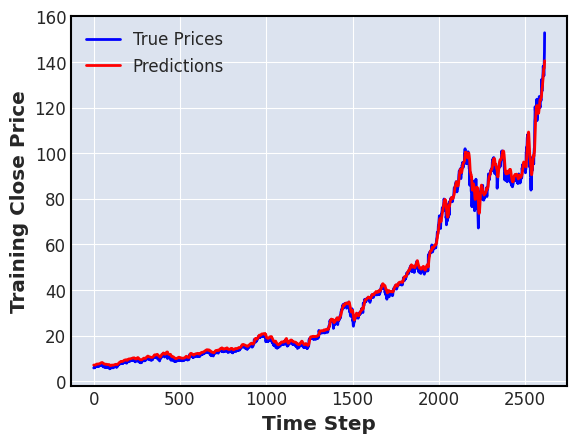

28/28 [==============================] - 0s 9ms/step


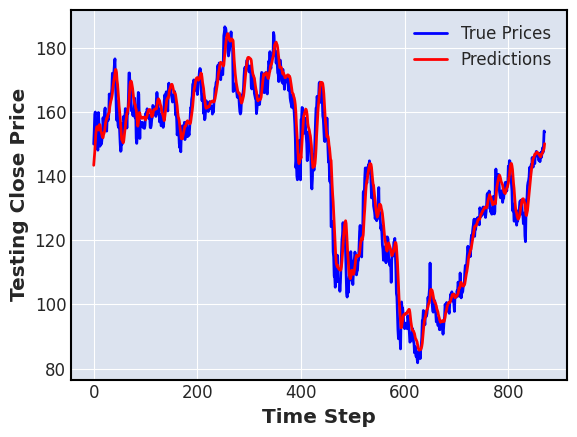

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 10s 59ms/step - loss: 8.4243e-04 - mae: 0.0141 - mse: 8.4243e-04 - mape: 23181.8594 - val_loss: 6.5089e-04 - val_mae: 0.0195 - val_mse: 6.5089e-04 - val_mape: 5.8110
Epoch 2/10
82/82 [==============================] - 2s 26ms/step - loss: 4.8391e-05 - mae: 0.0041 - mse: 4.8391e-05 - mape: 2277.9622 - val_loss: 6.8709e-04 - val_mae: 0.0202 - val_mse: 6.8709e-04 - val_mape: 5.9670
Epoch 3/10
82/82 [==============================] - 2s 26ms/step - loss: 4.5435e-05 - mae: 0.0041 - mse: 4.5435e-05 - mape: 156.8796 - val_loss: 5.9471e-04 - val_mae: 0.0188 - val_mse: 5.9471e-04 - val_mape: 5.5325
Epoch 4/10
82/82 [==============================] - 2s 26ms/step - loss: 3.9339e-05 - mae: 0.0038 - mse: 3.9339e-05 - mape: 1664.9231 - val_loss: 8.0729e-04 - val_mae: 0.0228 - val_mse: 8.0729e-04 - val_mape: 6.5762
Epoch 5/10
82/82 [==============================] - 2s 26ms/s

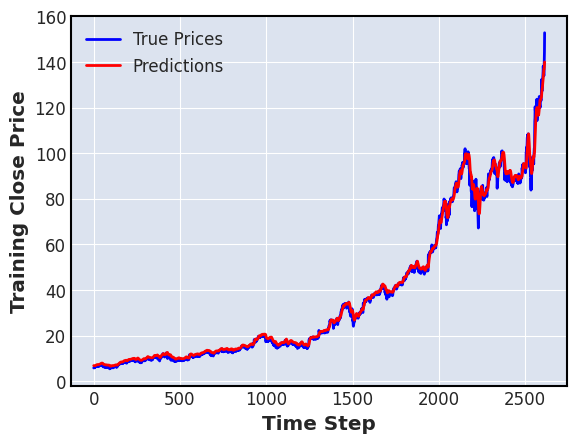

28/28 [==============================] - 0s 9ms/step


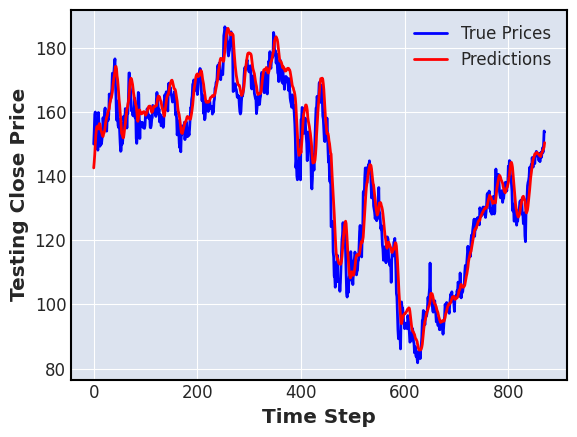

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 8s 39ms/step - loss: 7.7825e-04 - mae: 0.0137 - mse: 7.7825e-04 - mape: 7095.2202 - val_loss: 7.7563e-04 - val_mae: 0.0213 - val_mse: 7.7563e-04 - val_mape: 6.3373
Epoch 2/10
82/82 [==============================] - 2s 27ms/step - loss: 5.5720e-05 - mae: 0.0047 - mse: 5.5720e-05 - mape: 445.8832 - val_loss: 6.2056e-04 - val_mae: 0.0190 - val_mse: 6.2056e-04 - val_mape: 5.6503
Epoch 3/10
82/82 [==============================] - 2s 26ms/step - loss: 5.3386e-05 - mae: 0.0049 - mse: 5.3386e-05 - mape: 1072.8561 - val_loss: 7.6679e-04 - val_mae: 0.0218 - val_mse: 7.6679e-04 - val_mape: 6.3814
Epoch 4/10
82/82 [==============================] - 2s 25ms/step - loss: 4.0207e-05 - mae: 0.0040 - mse: 4.0207e-05 - mape: 1359.7946 - val_loss: 4.9874e-04 - val_mae: 0.0173 - val_mse: 4.9874e-04 - val_mape: 5.0269
Epoch 5/10
82/82 [==============================] - 2s 26ms/ste

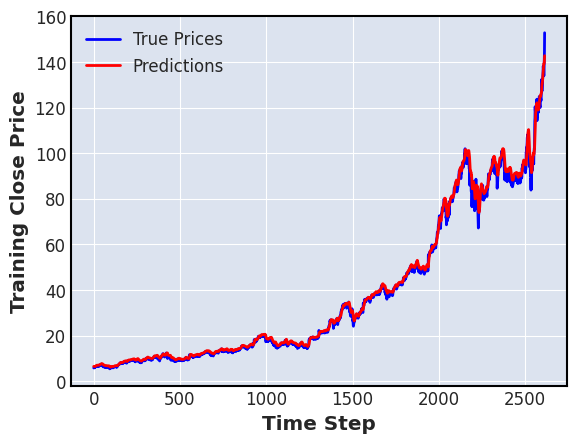

28/28 [==============================] - 0s 8ms/step


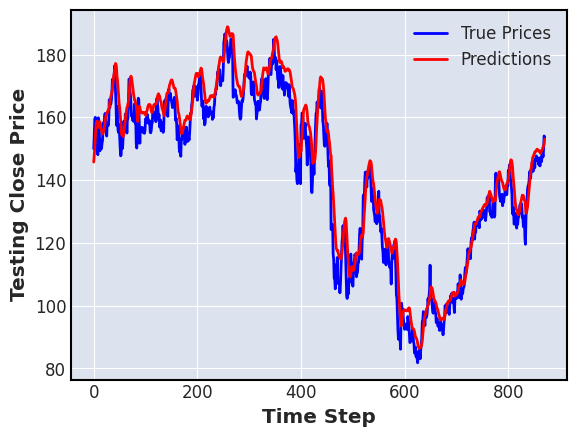

---------------------------------------------------------------
ticker_name :  IBM Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 7s 69ms/step - loss: 0.0063 - mae: 0.0576 - mse: 0.0063 - mape: 21.7823 - val_loss: 5.7724e-04 - val_mae: 0.0210 - val_mse: 5.7724e-04 - val_mape: 8.1748
Epoch 2/10
28/28 [==============================] - 1s 32ms/step - loss: 4.4760e-04 - mae: 0.0174 - mse: 4.4760e-04 - mape: 7.1628 - val_loss: 1.8616e-04 - val_mae: 0.0106 - val_mse: 1.8616e-04 - val_mape: 4.1569
Epoch 3/10
28/28 [==============================] - 1s 35ms/step - loss: 2.0734e-04 - mae: 0.0121 - mse: 2.0734e-04 - mape: 4.9468 - val_loss: 1.2552e-04 - val_mae: 0.0090 - val_mse: 1.2552e-04 - val_mape: 3.3980
Epoch 4/10
28/28 [==============================] - 1s 35ms/step - loss: 1.4596e-04 - mae: 0.0103 - mse: 1.4596e-04 - mape: 4.1812 - val_loss: 1.1469e-04 - val_mae: 0.0085 - val_mse: 1.1469e-04 - val_mape: 3.2534
Epoch 5/10
28/28 [=====

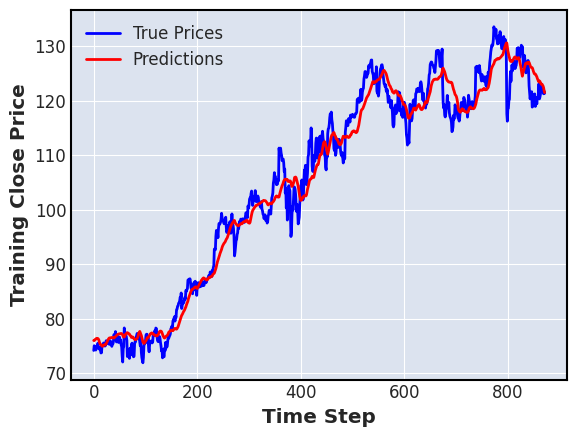

28/28 [==============================] - 0s 9ms/step


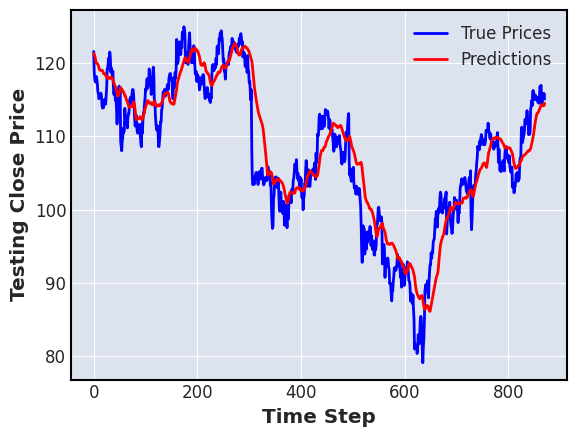

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 7s 99ms/step - loss: 0.0103 - mae: 0.0719 - mse: 0.0103 - mape: 27.3373 - val_loss: 7.6752e-04 - val_mae: 0.0250 - val_mse: 7.6752e-04 - val_mape: 8.9325
Epoch 2/10
28/28 [==============================] - 1s 38ms/step - loss: 4.3953e-04 - mae: 0.0173 - mse: 4.3953e-04 - mape: 7.0920 - val_loss: 1.6658e-04 - val_mae: 0.0100 - val_mse: 1.6658e-04 - val_mape: 3.9415
Epoch 3/10
28/28 [==============================] - 1s 32ms/step - loss: 2.2443e-04 - mae: 0.0126 - mse: 2.2443e-04 - mape: 5.2459 - val_loss: 1.2150e-04 - val_mae: 0.0086 - val_mse: 1.2150e-04 - val_mape: 3.3571
Epoch 4/10
28/28 [==============================] - 1s 33ms/step - loss: 1.5264e-04 - mae: 0.0105 - mse: 1.5264e-04 - mape: 4.3250 - val_loss: 9.8520e-05 - val_mae: 0.0079 - val_mse: 9.8520e-05 - val_mape: 3.0116
Epoch 5/10
28/28 [==============================] - 1s 35ms/step - loss: 1.0249e-

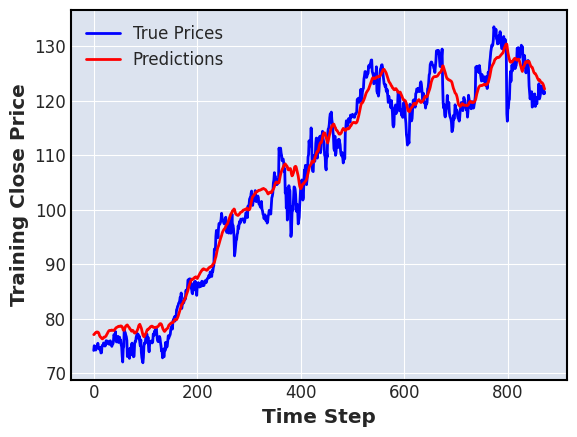

28/28 [==============================] - 0s 8ms/step


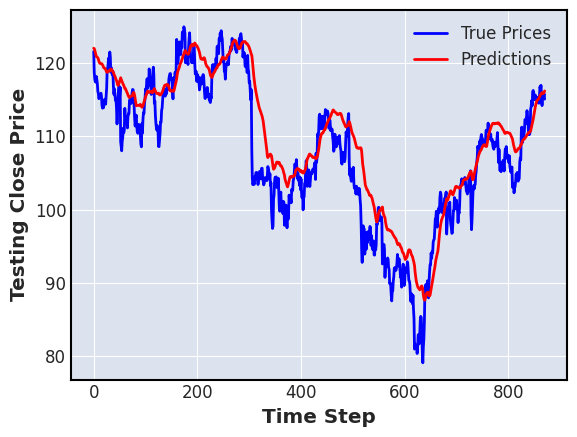

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 7s 72ms/step - loss: 0.0093 - mae: 0.0663 - mse: 0.0093 - mape: 25.2697 - val_loss: 8.8888e-04 - val_mae: 0.0274 - val_mse: 8.8888e-04 - val_mape: 10.5565
Epoch 2/10
28/28 [==============================] - 1s 34ms/step - loss: 3.9754e-04 - mae: 0.0164 - mse: 3.9754e-04 - mape: 6.7665 - val_loss: 1.5118e-04 - val_mae: 0.0100 - val_mse: 1.5118e-04 - val_mape: 3.7535
Epoch 3/10
28/28 [==============================] - 1s 32ms/step - loss: 2.0684e-04 - mae: 0.0122 - mse: 2.0684e-04 - mape: 5.0611 - val_loss: 1.3082e-04 - val_mae: 0.0092 - val_mse: 1.3082e-04 - val_mape: 3.4712
Epoch 4/10
28/28 [==============================] - 1s 34ms/step - loss: 1.5144e-04 - mae: 0.0104 - mse: 1.5144e-04 - mape: 4.2010 - val_loss: 1.1551e-04 - val_mae: 0.0085 - val_mse: 1.1551e-04 - val_mape: 3.2654
Epoch 5/10
28/28 [==============================] - 1s 31ms/step - loss: 1.1578e

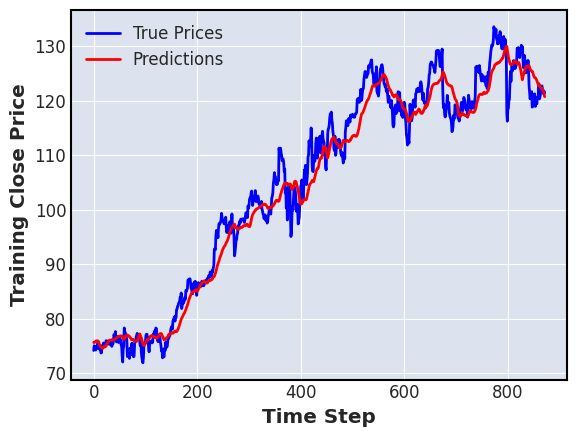

28/28 [==============================] - 0s 8ms/step


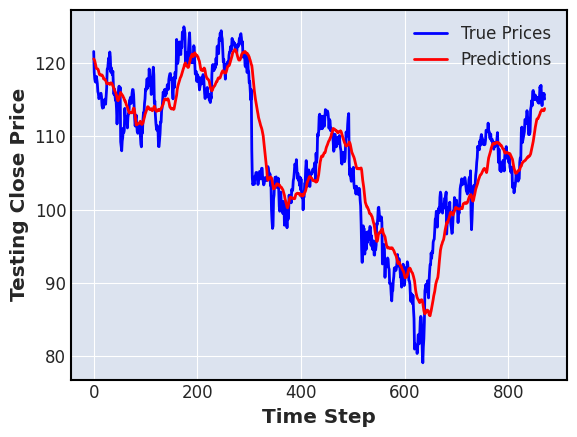

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 7s 46ms/step - loss: 0.0033 - mae: 0.0360 - mse: 0.0033 - mape: 13.6913 - val_loss: 2.7875e-04 - val_mae: 0.0116 - val_mse: 2.7875e-04 - val_mape: 4.6261
Epoch 2/10
55/55 [==============================] - 2s 28ms/step - loss: 1.7152e-04 - mae: 0.0108 - mse: 1.7152e-04 - mape: 4.2831 - val_loss: 2.2465e-04 - val_mae: 0.0105 - val_mse: 2.2465e-04 - val_mape: 4.0866
Epoch 3/10
55/55 [==============================] - 2s 28ms/step - loss: 1.2659e-04 - mae: 0.0092 - mse: 1.2659e-04 - mape: 3.6279 - val_loss: 2.1508e-04 - val_mae: 0.0100 - val_mse: 2.1508e-04 - val_mape: 3.9459
Epoch 4/10
55/55 [==============================] - 2s 28ms/step - loss: 1.0102e-04 - mae: 0.0082 - mse: 1.0102e-04 - mape: 3.1452 - val_loss: 2.0258e-04 - val_mae: 0.0099 - val_mse: 2.0258e-04 - val_mape: 3.8639
Epoch 5/10
55/55 [==============================] - 2s 28ms/step -

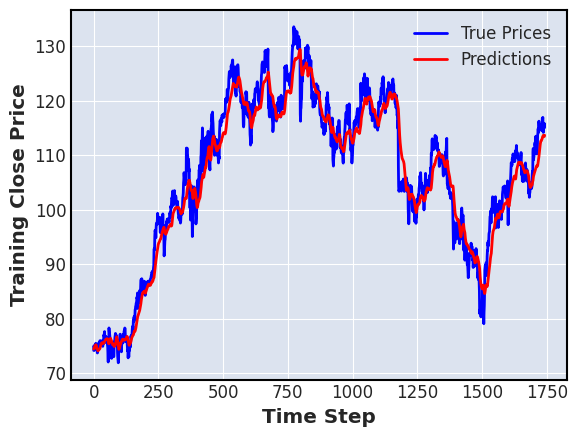

28/28 [==============================] - 0s 9ms/step


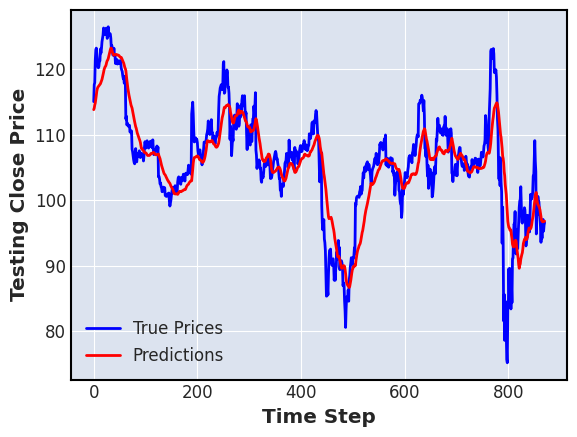

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 8s 57ms/step - loss: 0.0054 - mae: 0.0439 - mse: 0.0054 - mape: 16.5915 - val_loss: 2.4265e-04 - val_mae: 0.0109 - val_mse: 2.4265e-04 - val_mape: 4.3681
Epoch 2/10
55/55 [==============================] - 2s 28ms/step - loss: 1.7831e-04 - mae: 0.0109 - mse: 1.7831e-04 - mape: 4.3634 - val_loss: 2.6382e-04 - val_mae: 0.0118 - val_mse: 2.6382e-04 - val_mape: 4.7203
Epoch 3/10
55/55 [==============================] - 2s 28ms/step - loss: 1.2413e-04 - mae: 0.0091 - mse: 1.2413e-04 - mape: 3.5826 - val_loss: 2.2554e-04 - val_mae: 0.0106 - val_mse: 2.2554e-04 - val_mape: 4.2243
Epoch 4/10
55/55 [==============================] - 1s 27ms/step - loss: 9.4944e-05 - mae: 0.0079 - mse: 9.4944e-05 - mape: 3.0374 - val_loss: 1.7209e-04 - val_mae: 0.0090 - val_mse: 1.7209e-04 - val_mape: 3.5152
Epoch 5/10
55/55 [==============================] - 2s 28ms/step - loss: 7.6637e-

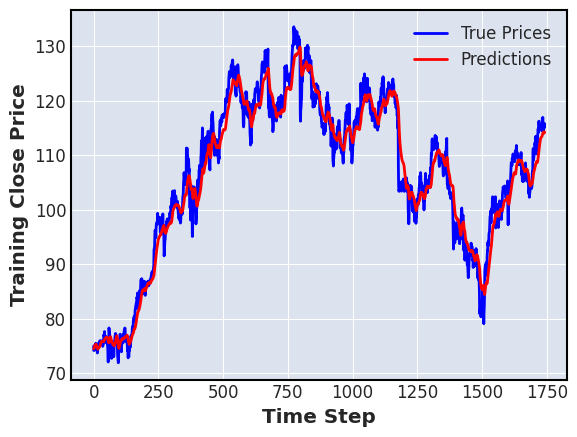

28/28 [==============================] - 0s 8ms/step


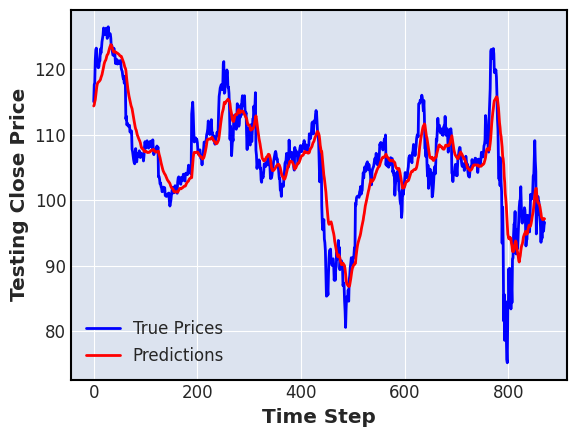

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 9s 50ms/step - loss: 0.0048 - mae: 0.0411 - mse: 0.0048 - mape: 15.5253 - val_loss: 2.5492e-04 - val_mae: 0.0117 - val_mse: 2.5492e-04 - val_mape: 4.5119
Epoch 2/10
55/55 [==============================] - 2s 32ms/step - loss: 1.9516e-04 - mae: 0.0114 - mse: 1.9516e-04 - mape: 4.5520 - val_loss: 2.4559e-04 - val_mae: 0.0107 - val_mse: 2.4559e-04 - val_mape: 4.2361
Epoch 3/10
55/55 [==============================] - 2s 31ms/step - loss: 1.3647e-04 - mae: 0.0096 - mse: 1.3647e-04 - mape: 3.7822 - val_loss: 2.2831e-04 - val_mae: 0.0103 - val_mse: 2.2831e-04 - val_mape: 4.0630
Epoch 4/10
55/55 [==============================] - 2s 29ms/step - loss: 1.0834e-04 - mae: 0.0085 - mse: 1.0834e-04 - mape: 3.2712 - val_loss: 2.0961e-04 - val_mae: 0.0099 - val_mse: 2.0961e-04 - val_mape: 3.8766
Epoch 5/10
55/55 [==============================] - 2s 28ms/step - loss: 8.9612e-

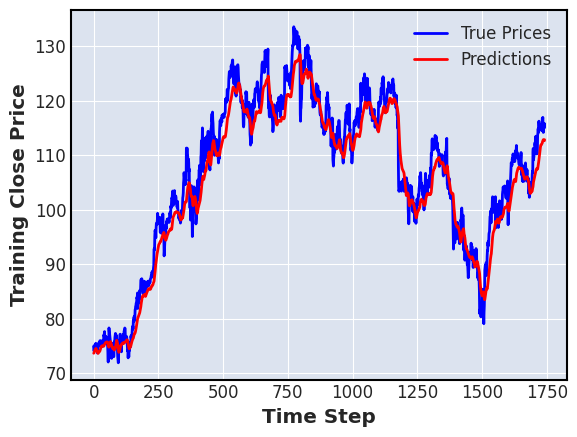

28/28 [==============================] - 0s 8ms/step


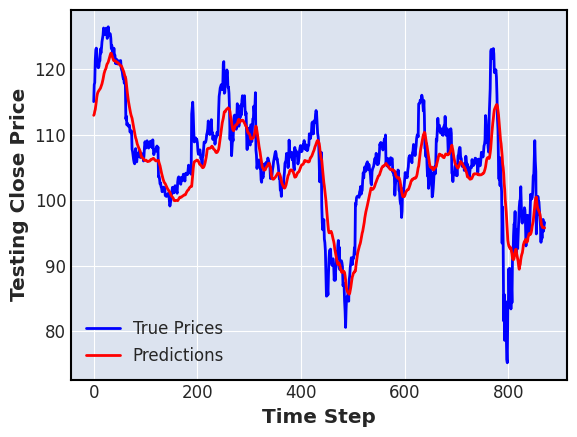

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 8s 40ms/step - loss: 0.0023 - mae: 0.0282 - mse: 0.0023 - mape: 10.6839 - val_loss: 5.7647e-04 - val_mae: 0.0190 - val_mse: 5.7647e-04 - val_mape: 5.8606
Epoch 2/10
82/82 [==============================] - 2s 25ms/step - loss: 1.8052e-04 - mae: 0.0104 - mse: 1.8052e-04 - mape: 4.0832 - val_loss: 3.1558e-04 - val_mae: 0.0137 - val_mse: 3.1558e-04 - val_mape: 4.2886
Epoch 3/10
82/82 [==============================] - 2s 26ms/step - loss: 1.4143e-04 - mae: 0.0090 - mse: 1.4143e-04 - mape: 3.5005 - val_loss: 2.8494e-04 - val_mae: 0.0132 - val_mse: 2.8494e-04 - val_mape: 4.1562
Epoch 4/10
82/82 [==============================] - 2s 28ms/step - loss: 1.1868e-04 - mae: 0.0081 - mse: 1.1868e-04 - mape: 3.1081 - val_loss: 1.5799e-04 - val_mae: 0.0100 - val_mse: 1.5799e-04 - val_mape: 3.2105
Epoch 5/10
82/82 [==============================] - 3s 31ms/step -

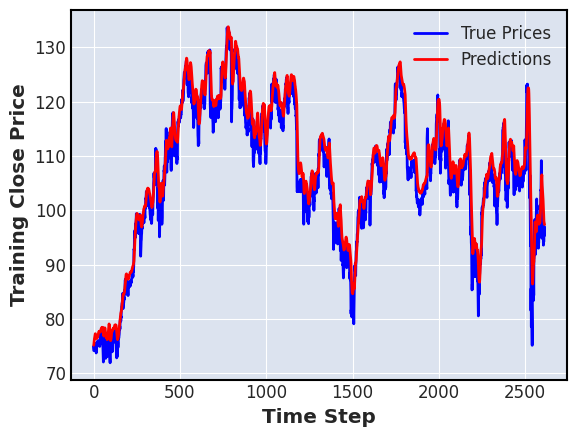

28/28 [==============================] - 0s 8ms/step


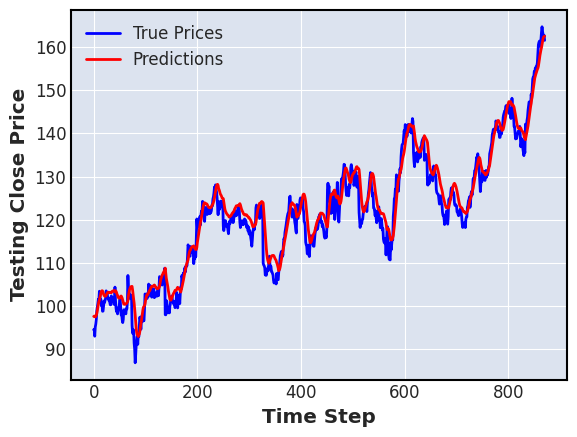

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 8s 39ms/step - loss: 0.0037 - mae: 0.0340 - mse: 0.0037 - mape: 12.9049 - val_loss: 4.7247e-04 - val_mae: 0.0169 - val_mse: 4.7247e-04 - val_mape: 5.2275
Epoch 2/10
82/82 [==============================] - 2s 25ms/step - loss: 1.9791e-04 - mae: 0.0109 - mse: 1.9791e-04 - mape: 4.3281 - val_loss: 3.6169e-04 - val_mae: 0.0147 - val_mse: 3.6169e-04 - val_mape: 4.5606
Epoch 3/10
82/82 [==============================] - 2s 25ms/step - loss: 1.5294e-04 - mae: 0.0095 - mse: 1.5294e-04 - mape: 3.7391 - val_loss: 3.0895e-04 - val_mae: 0.0137 - val_mse: 3.0895e-04 - val_mape: 4.2614
Epoch 4/10
82/82 [==============================] - 2s 27ms/step - loss: 1.2189e-04 - mae: 0.0083 - mse: 1.2189e-04 - mape: 3.2493 - val_loss: 1.8362e-04 - val_mae: 0.0105 - val_mse: 1.8362e-04 - val_mape: 3.3437
Epoch 5/10
82/82 [==============================] - 2s 28ms/step - loss: 1.0417e-

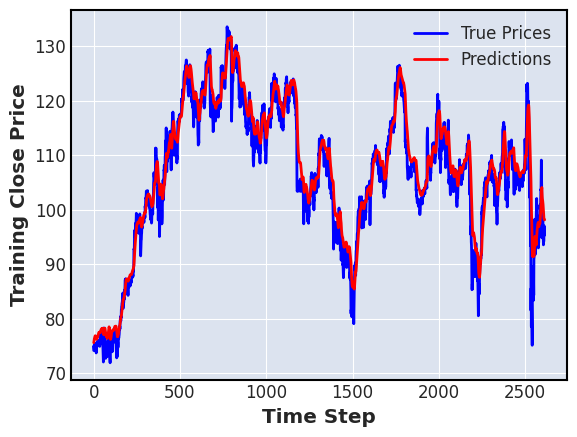

28/28 [==============================] - 0s 8ms/step


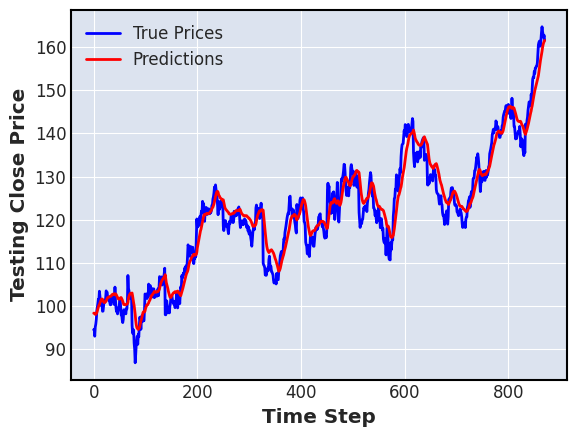

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 10s 39ms/step - loss: 0.0032 - mae: 0.0318 - mse: 0.0032 - mape: 12.1768 - val_loss: 4.7542e-04 - val_mae: 0.0169 - val_mse: 4.7542e-04 - val_mape: 5.2336
Epoch 2/10
82/82 [==============================] - 2s 29ms/step - loss: 1.8917e-04 - mae: 0.0106 - mse: 1.8917e-04 - mape: 4.1813 - val_loss: 2.8594e-04 - val_mae: 0.0129 - val_mse: 2.8594e-04 - val_mape: 4.0888
Epoch 3/10
82/82 [==============================] - 2s 22ms/step - loss: 1.4209e-04 - mae: 0.0090 - mse: 1.4209e-04 - mape: 3.5186 - val_loss: 1.9311e-04 - val_mae: 0.0108 - val_mse: 1.9311e-04 - val_mape: 3.4659
Epoch 4/10
82/82 [==============================] - 2s 24ms/step - loss: 1.1453e-04 - mae: 0.0079 - mse: 1.1453e-04 - mape: 3.0433 - val_loss: 2.0215e-04 - val_mae: 0.0112 - val_mse: 2.0215e-04 - val_mape: 3.5632
Epoch 5/10
82/82 [==============================] - 2s 24ms/step - loss: 1.0317e

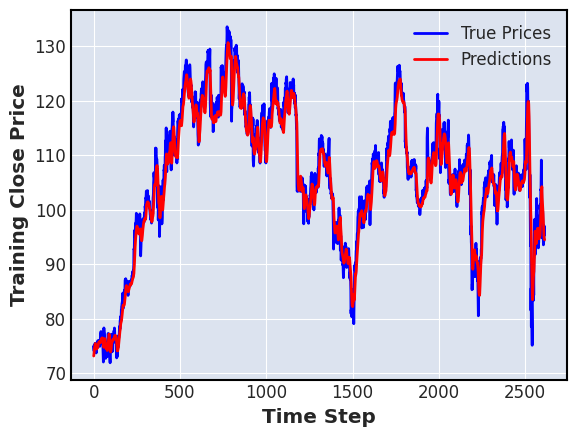

28/28 [==============================] - 0s 7ms/step


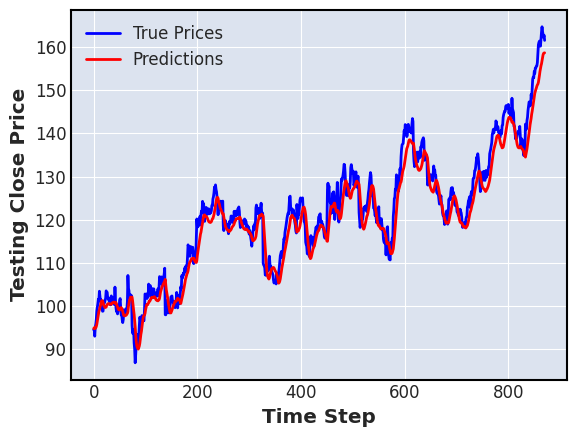

---------------------------------------------------------------
ticker_name :  KO Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 6s 66ms/step - loss: 1.9656e-04 - mae: 0.0105 - mse: 1.9656e-04 - mape: 22.6884 - val_loss: 1.1196e-04 - val_mae: 0.0099 - val_mse: 1.1196e-04 - val_mape: 13.9240
Epoch 2/10
28/28 [==============================] - 1s 29ms/step - loss: 3.3089e-05 - mae: 0.0047 - mse: 3.3089e-05 - mape: 10.6742 - val_loss: 3.7204e-05 - val_mae: 0.0054 - val_mse: 3.7204e-05 - val_mape: 7.6033
Epoch 3/10
28/28 [==============================] - 1s 26ms/step - loss: 1.0470e-05 - mae: 0.0026 - mse: 1.0470e-05 - mape: 5.8283 - val_loss: 2.1443e-05 - val_mae: 0.0041 - val_mse: 2.1443e-05 - val_mape: 5.8520
Epoch 4/10
28/28 [==============================] - 1s 26ms/step - loss: 3.8084e-06 - mae: 0.0016 - mse: 3.8084e-06 - mape: 3.3646 - val_loss: 4.1485e-06 - val_mae: 0.0016 - val_mse: 4.1485e-06 - val_mape: 2.3927
Epoch 5/10
28/

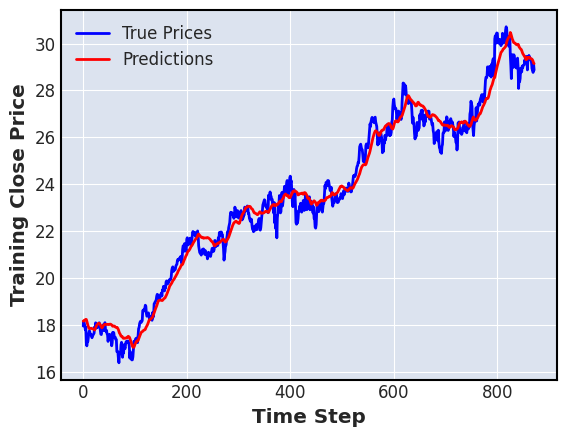

28/28 [==============================] - 0s 7ms/step


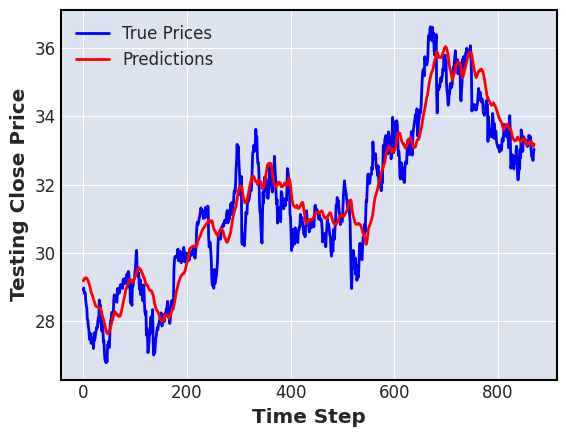

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 6s 63ms/step - loss: 2.4952e-04 - mae: 0.0114 - mse: 2.4952e-04 - mape: 25.0197 - val_loss: 2.9728e-04 - val_mae: 0.0168 - val_mse: 2.9728e-04 - val_mape: 23.9693
Epoch 2/10
28/28 [==============================] - 1s 28ms/step - loss: 4.0440e-05 - mae: 0.0052 - mse: 4.0440e-05 - mape: 11.7347 - val_loss: 1.0900e-04 - val_mae: 0.0099 - val_mse: 1.0900e-04 - val_mape: 13.9497
Epoch 3/10
28/28 [==============================] - 1s 31ms/step - loss: 2.2120e-05 - mae: 0.0039 - mse: 2.2120e-05 - mape: 8.7294 - val_loss: 6.1693e-05 - val_mae: 0.0074 - val_mse: 6.1693e-05 - val_mape: 10.4255
Epoch 4/10
28/28 [==============================] - 1s 31ms/step - loss: 8.8951e-06 - mae: 0.0024 - mse: 8.8951e-06 - mape: 5.4094 - val_loss: 9.2897e-06 - val_mae: 0.0026 - val_mse: 9.2897e-06 - val_mape: 3.6136
Epoch 5/10
28/28 [==============================] - 1s 27ms/step - lo

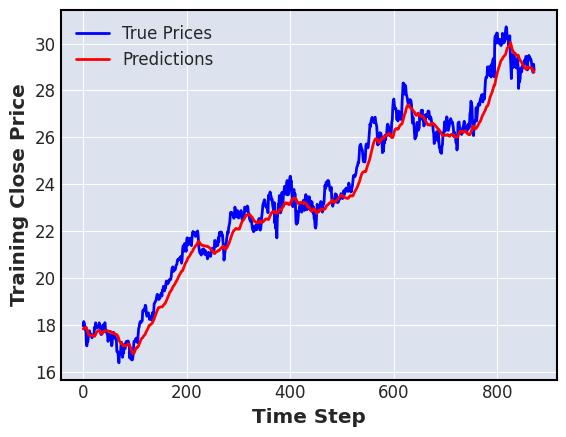

28/28 [==============================] - 0s 8ms/step


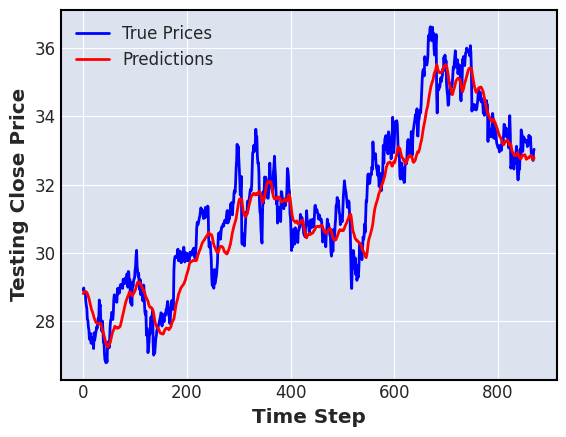

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 8s 68ms/step - loss: 2.2008e-04 - mae: 0.0106 - mse: 2.2008e-04 - mape: 22.7795 - val_loss: 1.8085e-04 - val_mae: 0.0129 - val_mse: 1.8085e-04 - val_mape: 18.3531
Epoch 2/10
28/28 [==============================] - 1s 27ms/step - loss: 3.0000e-05 - mae: 0.0044 - mse: 3.0000e-05 - mape: 10.1316 - val_loss: 4.2380e-05 - val_mae: 0.0058 - val_mse: 4.2380e-05 - val_mape: 8.0825
Epoch 3/10
28/28 [==============================] - 1s 27ms/step - loss: 1.5942e-05 - mae: 0.0032 - mse: 1.5942e-05 - mape: 7.2121 - val_loss: 3.2815e-05 - val_mae: 0.0052 - val_mse: 3.2815e-05 - val_mape: 7.3497
Epoch 4/10
28/28 [==============================] - 1s 43ms/step - loss: 6.5067e-06 - mae: 0.0020 - mse: 6.5067e-06 - mape: 4.4938 - val_loss: 4.7068e-06 - val_mae: 0.0017 - val_mse: 4.7068e-06 - val_mape: 2.4721
Epoch 5/10
28/28 [==============================] - 1s 35ms/step - loss

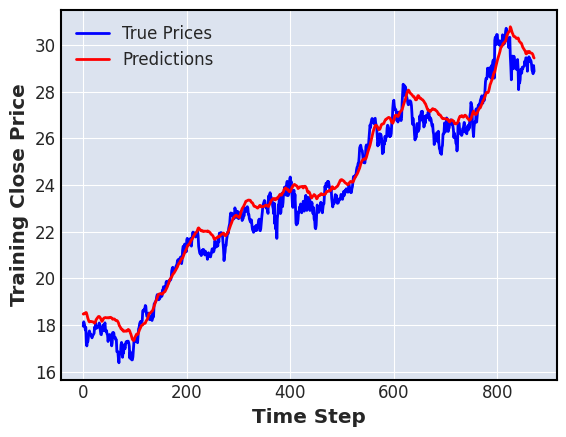

28/28 [==============================] - 0s 7ms/step


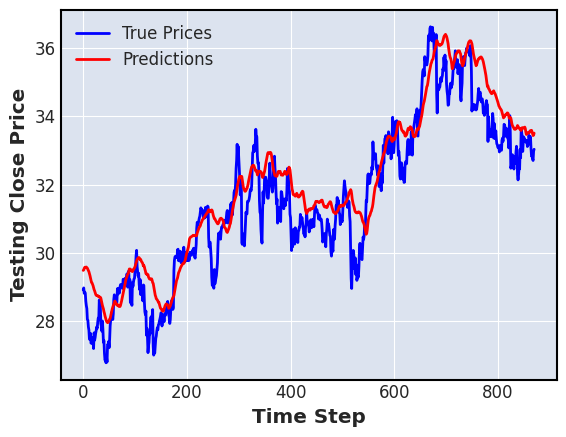

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 7s 41ms/step - loss: 1.6646e-04 - mae: 0.0092 - mse: 1.6646e-04 - mape: 17.2238 - val_loss: 1.5479e-04 - val_mae: 0.0113 - val_mse: 1.5479e-04 - val_mape: 11.8487
Epoch 2/10
55/55 [==============================] - 1s 22ms/step - loss: 8.8251e-06 - mae: 0.0023 - mse: 8.8251e-06 - mape: 4.3058 - val_loss: 2.0512e-05 - val_mae: 0.0027 - val_mse: 2.0512e-05 - val_mape: 2.9560
Epoch 3/10
55/55 [==============================] - 1s 25ms/step - loss: 3.4969e-06 - mae: 0.0015 - mse: 3.4969e-06 - mape: 2.6278 - val_loss: 1.9974e-05 - val_mae: 0.0026 - val_mse: 1.9974e-05 - val_mape: 2.8060
Epoch 4/10
55/55 [==============================] - 1s 22ms/step - loss: 3.4805e-06 - mae: 0.0015 - mse: 3.4805e-06 - mape: 2.5960 - val_loss: 1.9610e-05 - val_mae: 0.0028 - val_mse: 1.9610e-05 - val_mape: 2.9611
Epoch 5/10
55/55 [==============================] - 1s 23

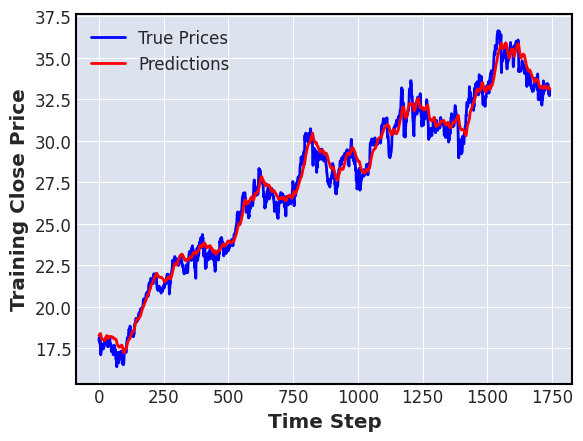

28/28 [==============================] - 0s 7ms/step


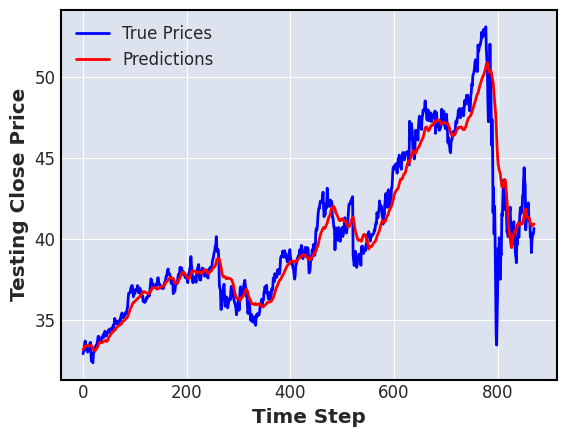

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 7s 43ms/step - loss: 2.0274e-04 - mae: 0.0096 - mse: 2.0274e-04 - mape: 18.0772 - val_loss: 2.0872e-04 - val_mae: 0.0132 - val_mse: 2.0872e-04 - val_mape: 13.8420
Epoch 2/10
55/55 [==============================] - 1s 22ms/step - loss: 1.2145e-05 - mae: 0.0027 - mse: 1.2145e-05 - mape: 5.1539 - val_loss: 1.8154e-05 - val_mae: 0.0028 - val_mse: 1.8154e-05 - val_mape: 2.9879
Epoch 3/10
55/55 [==============================] - 1s 26ms/step - loss: 3.0078e-06 - mae: 0.0014 - mse: 3.0078e-06 - mape: 2.4201 - val_loss: 1.7901e-05 - val_mae: 0.0028 - val_mse: 1.7901e-05 - val_mape: 2.9859
Epoch 4/10
55/55 [==============================] - 1s 22ms/step - loss: 3.0384e-06 - mae: 0.0014 - mse: 3.0384e-06 - mape: 2.4332 - val_loss: 1.7007e-05 - val_mae: 0.0023 - val_mse: 1.7007e-05 - val_mape: 2.5489
Epoch 5/10
55/55 [==============================] - 1s 24ms/step - loss:

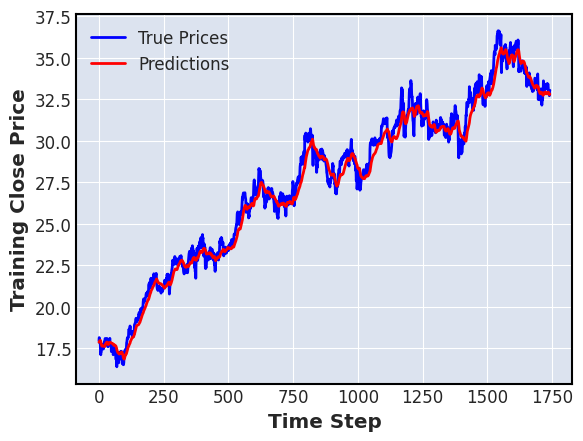

28/28 [==============================] - 0s 8ms/step


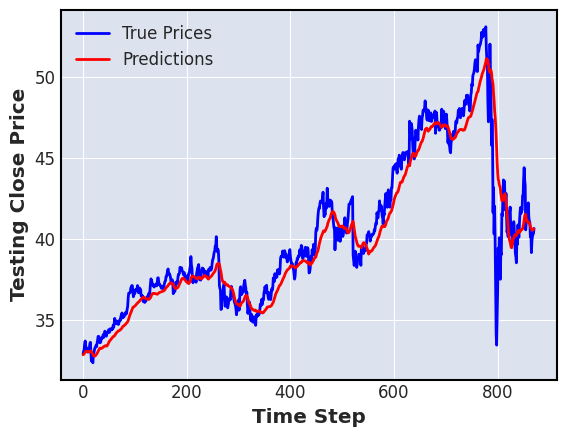

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 7s 43ms/step - loss: 1.8532e-04 - mae: 0.0088 - mse: 1.8532e-04 - mape: 16.2791 - val_loss: 1.0818e-04 - val_mae: 0.0092 - val_mse: 1.0818e-04 - val_mape: 9.6217
Epoch 2/10
55/55 [==============================] - 1s 24ms/step - loss: 8.7159e-06 - mae: 0.0023 - mse: 8.7159e-06 - mape: 4.2451 - val_loss: 2.0912e-05 - val_mae: 0.0028 - val_mse: 2.0912e-05 - val_mape: 3.0400
Epoch 3/10
55/55 [==============================] - 1s 23ms/step - loss: 3.7361e-06 - mae: 0.0015 - mse: 3.7361e-06 - mape: 2.7133 - val_loss: 2.0147e-05 - val_mae: 0.0027 - val_mse: 2.0147e-05 - val_mape: 2.9137
Epoch 4/10
55/55 [==============================] - 1s 25ms/step - loss: 3.6284e-06 - mae: 0.0015 - mse: 3.6284e-06 - mape: 2.6820 - val_loss: 1.9722e-05 - val_mae: 0.0026 - val_mse: 1.9722e-05 - val_mape: 2.7723
Epoch 5/10
55/55 [==============================] - 1s 27ms/step - loss: 

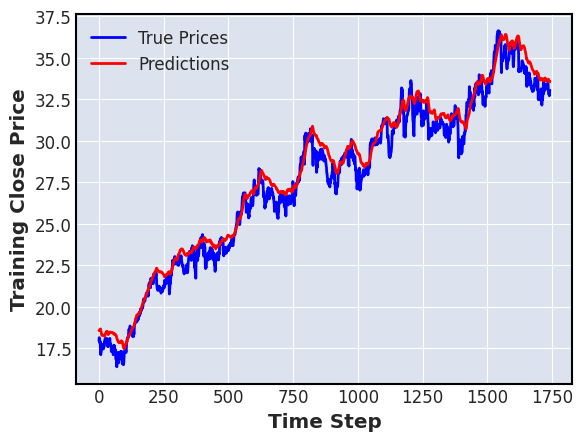

28/28 [==============================] - 0s 8ms/step


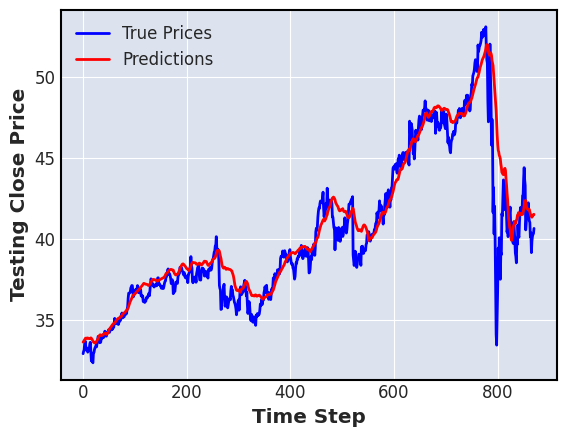

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 8s 41ms/step - loss: 1.9047e-04 - mae: 0.0085 - mse: 1.9047e-04 - mape: 13.3830 - val_loss: 2.2971e-05 - val_mae: 0.0039 - val_mse: 2.2971e-05 - val_mape: 2.9830
Epoch 2/10
82/82 [==============================] - 2s 28ms/step - loss: 9.3815e-06 - mae: 0.0019 - mse: 9.3815e-06 - mape: 2.7991 - val_loss: 2.1697e-05 - val_mae: 0.0038 - val_mse: 2.1697e-05 - val_mape: 2.9057
Epoch 3/10
82/82 [==============================] - 2s 26ms/step - loss: 8.8207e-06 - mae: 0.0019 - mse: 8.8207e-06 - mape: 2.7649 - val_loss: 3.1680e-05 - val_mae: 0.0048 - val_mse: 3.1680e-05 - val_mape: 3.6777
Epoch 4/10
82/82 [==============================] - 2s 26ms/step - loss: 9.3271e-06 - mae: 0.0020 - mse: 9.3271e-06 - mape: 2.9713 - val_loss: 2.2111e-05 - val_mae: 0.0039 - val_mse: 2.2111e-05 - val_mape: 2.9903
Epoch 5/10
82/82 [==============================] - 2s 27m

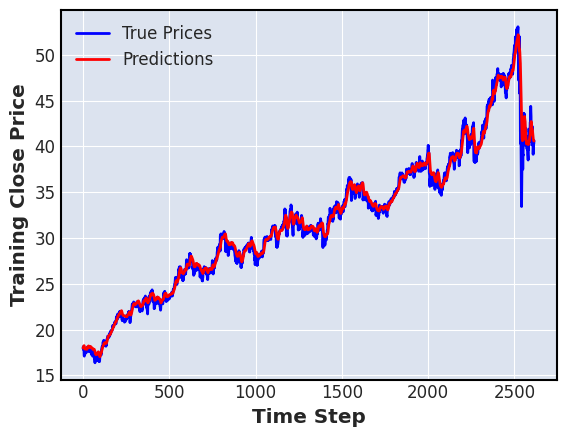

28/28 [==============================] - 0s 9ms/step


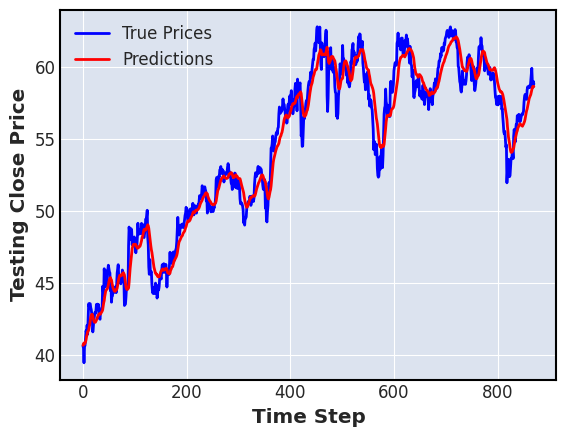

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 8s 39ms/step - loss: 2.4480e-04 - mae: 0.0097 - mse: 2.4480e-04 - mape: 15.3714 - val_loss: 2.8511e-05 - val_mae: 0.0045 - val_mse: 2.8511e-05 - val_mape: 3.4793
Epoch 2/10
82/82 [==============================] - 2s 25ms/step - loss: 8.1073e-06 - mae: 0.0018 - mse: 8.1073e-06 - mape: 2.6504 - val_loss: 1.7999e-05 - val_mae: 0.0034 - val_mse: 1.7999e-05 - val_mape: 2.6014
Epoch 3/10
82/82 [==============================] - 2s 26ms/step - loss: 7.7053e-06 - mae: 0.0018 - mse: 7.7053e-06 - mape: 2.5764 - val_loss: 1.7472e-05 - val_mae: 0.0033 - val_mse: 1.7472e-05 - val_mape: 2.5483
Epoch 4/10
82/82 [==============================] - 2s 28ms/step - loss: 7.3639e-06 - mae: 0.0018 - mse: 7.3639e-06 - mape: 2.5467 - val_loss: 1.9499e-05 - val_mae: 0.0036 - val_mse: 1.9499e-05 - val_mape: 2.8034
Epoch 5/10
82/82 [==============================] - 2s 27ms/step - loss: 

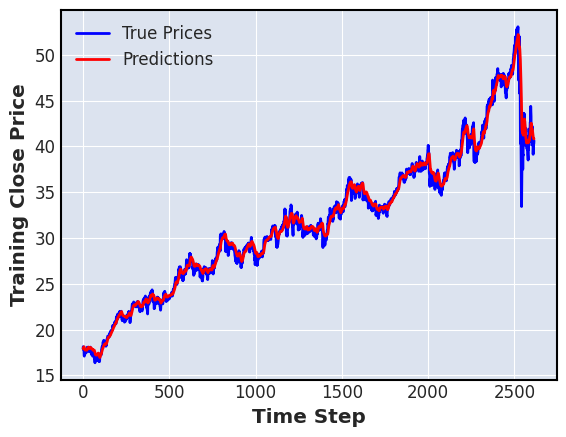

28/28 [==============================] - 0s 9ms/step


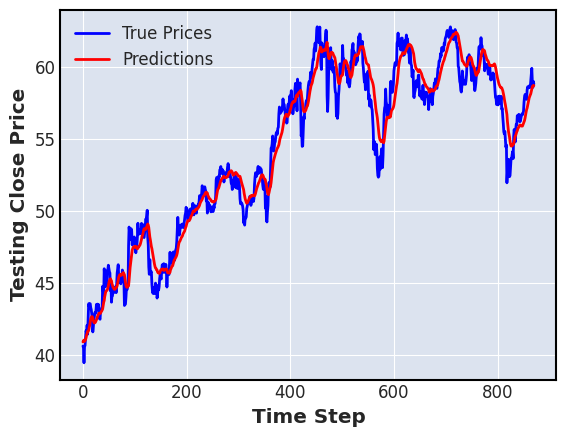

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 8s 40ms/step - loss: 1.9918e-04 - mae: 0.0078 - mse: 1.9918e-04 - mape: 12.2608 - val_loss: 2.6425e-05 - val_mae: 0.0040 - val_mse: 2.6425e-05 - val_mape: 3.0615
Epoch 2/10
82/82 [==============================] - 2s 25ms/step - loss: 9.5928e-06 - mae: 0.0020 - mse: 9.5928e-06 - mape: 2.8929 - val_loss: 2.1735e-05 - val_mae: 0.0037 - val_mse: 2.1735e-05 - val_mape: 2.8629
Epoch 3/10
82/82 [==============================] - 2s 26ms/step - loss: 1.0275e-05 - mae: 0.0021 - mse: 1.0275e-05 - mape: 3.1054 - val_loss: 1.9878e-05 - val_mae: 0.0035 - val_mse: 1.9878e-05 - val_mape: 2.7395
Epoch 4/10
82/82 [==============================] - 2s 27ms/step - loss: 8.1394e-06 - mae: 0.0018 - mse: 8.1394e-06 - mape: 2.6480 - val_loss: 2.7910e-05 - val_mae: 0.0045 - val_mse: 2.7910e-05 - val_mape: 3.4167
Epoch 5/10
82/82 [==============================] - 2s 26ms/step - loss: 

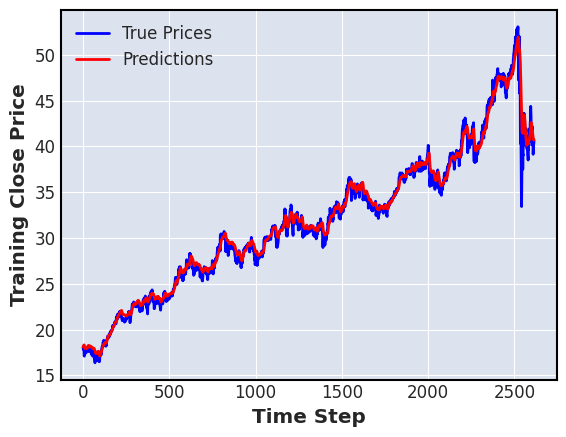

28/28 [==============================] - 0s 8ms/step


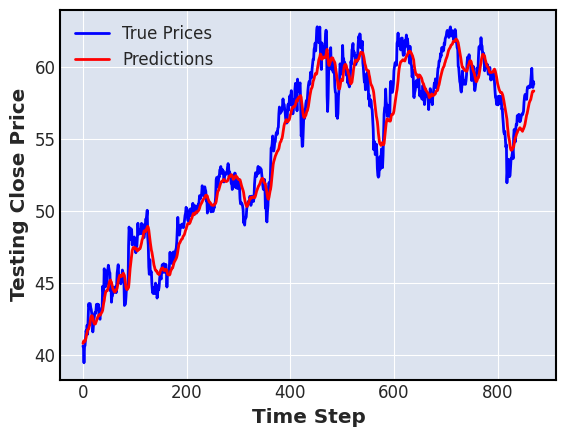

---------------------------------------------------------------
ticker_name :  AAPL Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 7s 71ms/step - loss: 5.0344e-05 - mae: 0.0051 - mse: 5.0344e-05 - mape: 44.4112 - val_loss: 1.0838e-05 - val_mae: 0.0026 - val_mse: 1.0838e-05 - val_mape: 5.5699
Epoch 2/10
28/28 [==============================] - 1s 32ms/step - loss: 7.8409e-06 - mae: 0.0022 - mse: 7.8409e-06 - mape: 14.7344 - val_loss: 1.0461e-05 - val_mae: 0.0026 - val_mse: 1.0461e-05 - val_mape: 5.6391
Epoch 3/10
28/28 [==============================] - 1s 34ms/step - loss: 5.2031e-06 - mae: 0.0017 - mse: 5.2031e-06 - mape: 11.0939 - val_loss: 8.2012e-06 - val_mae: 0.0022 - val_mse: 8.2012e-06 - val_mape: 4.8584
Epoch 4/10
28/28 [==============================] - 1s 35ms/step - loss: 4.2486e-06 - mae: 0.0015 - mse: 4.2486e-06 - mape: 9.3430 - val_loss: 1.5061e-05 - val_mae: 0.0033 - val_mse: 1.5061e-05 - val_mape: 7.0817
Epoch 5/10
2

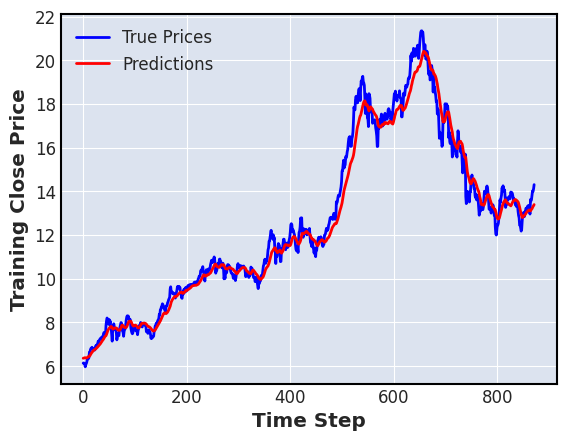

28/28 [==============================] - 0s 8ms/step


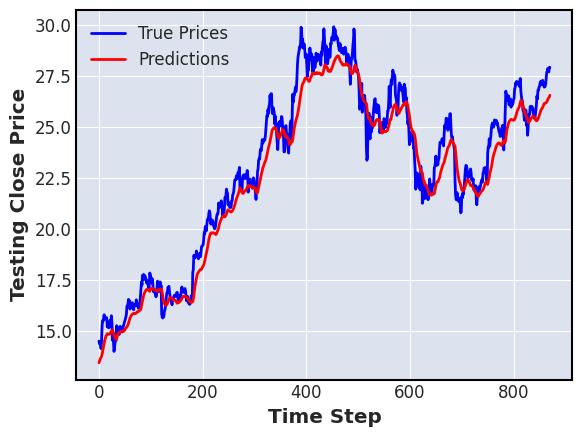

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 7s 73ms/step - loss: 7.9231e-05 - mae: 0.0067 - mse: 7.9231e-05 - mape: 55.3588 - val_loss: 1.3417e-04 - val_mae: 0.0106 - val_mse: 1.3417e-04 - val_mape: 21.5612
Epoch 2/10
28/28 [==============================] - 1s 33ms/step - loss: 7.1875e-06 - mae: 0.0020 - mse: 7.1875e-06 - mape: 16.4945 - val_loss: 9.1209e-06 - val_mae: 0.0023 - val_mse: 9.1209e-06 - val_mape: 5.0223
Epoch 3/10
28/28 [==============================] - 1s 41ms/step - loss: 4.1825e-06 - mae: 0.0016 - mse: 4.1825e-06 - mape: 10.4962 - val_loss: 6.6654e-06 - val_mae: 0.0020 - val_mse: 6.6654e-06 - val_mape: 4.3577
Epoch 4/10
28/28 [==============================] - 1s 34ms/step - loss: 5.0596e-06 - mae: 0.0018 - mse: 5.0596e-06 - mape: 12.1780 - val_loss: 2.5245e-05 - val_mae: 0.0045 - val_mse: 2.5245e-05 - val_mape: 9.7472
Epoch 5/10
28/28 [==============================] - 1s 34ms/step - lo

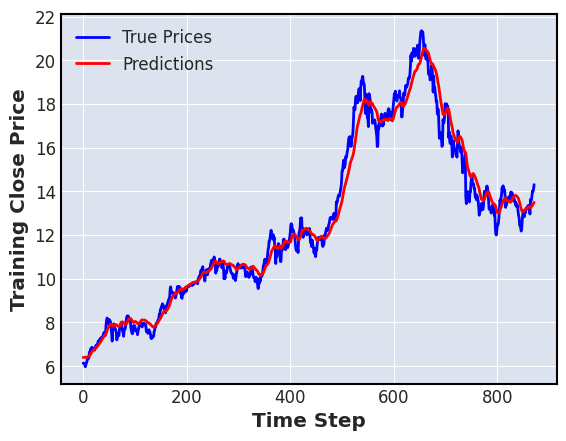

28/28 [==============================] - 0s 9ms/step


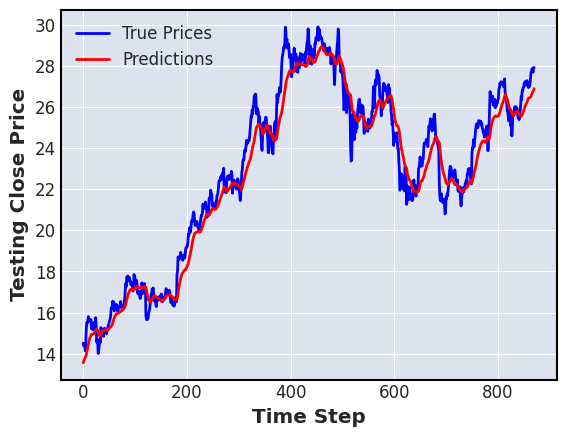

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 7s 70ms/step - loss: 4.8749e-05 - mae: 0.0050 - mse: 4.8749e-05 - mape: 40.7821 - val_loss: 3.6770e-05 - val_mae: 0.0054 - val_mse: 3.6770e-05 - val_mape: 11.5534
Epoch 2/10
28/28 [==============================] - 1s 34ms/step - loss: 6.1101e-06 - mae: 0.0019 - mse: 6.1101e-06 - mape: 12.1353 - val_loss: 1.0543e-05 - val_mae: 0.0026 - val_mse: 1.0543e-05 - val_mape: 5.6891
Epoch 3/10
28/28 [==============================] - 1s 36ms/step - loss: 5.4285e-06 - mae: 0.0018 - mse: 5.4285e-06 - mape: 11.8222 - val_loss: 1.3623e-05 - val_mae: 0.0031 - val_mse: 1.3623e-05 - val_mape: 7.0051
Epoch 4/10
28/28 [==============================] - 1s 31ms/step - loss: 5.6968e-06 - mae: 0.0018 - mse: 5.6968e-06 - mape: 12.3578 - val_loss: 1.5132e-05 - val_mae: 0.0033 - val_mse: 1.5132e-05 - val_mape: 7.0785
Epoch 5/10
28/28 [==============================] - 1s 35ms/step - lo

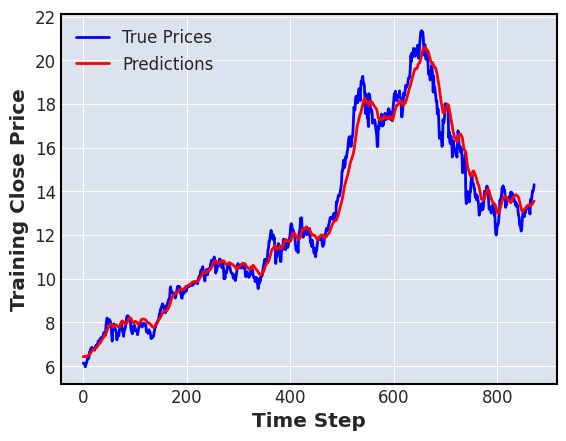

28/28 [==============================] - 0s 8ms/step


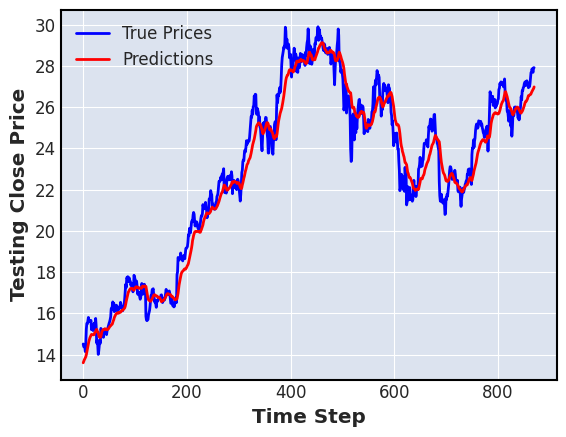

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 9s 46ms/step - loss: 7.5423e-05 - mae: 0.0058 - mse: 7.5423e-05 - mape: 28.9434 - val_loss: 1.3832e-04 - val_mae: 0.0091 - val_mse: 1.3832e-04 - val_mape: 7.4111
Epoch 2/10
55/55 [==============================] - 2s 28ms/step - loss: 6.8366e-06 - mae: 0.0019 - mse: 6.8366e-06 - mape: 7.6920 - val_loss: 1.4114e-04 - val_mae: 0.0092 - val_mse: 1.4114e-04 - val_mape: 7.4039
Epoch 3/10
55/55 [==============================] - 2s 29ms/step - loss: 6.4979e-06 - mae: 0.0019 - mse: 6.4979e-06 - mape: 7.9018 - val_loss: 1.5015e-04 - val_mae: 0.0094 - val_mse: 1.5015e-04 - val_mape: 7.4204
Epoch 4/10
55/55 [==============================] - 2s 31ms/step - loss: 5.5484e-06 - mae: 0.0018 - mse: 5.5484e-06 - mape: 7.1642 - val_loss: 1.1658e-04 - val_mae: 0.0079 - val_mse: 1.1658e-04 - val_mape: 6.1829
Epoch 5/10
55/55 [==============================] - 2s 32m

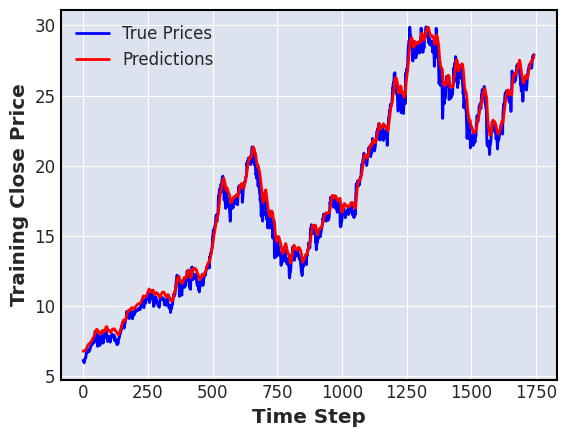

28/28 [==============================] - 0s 8ms/step


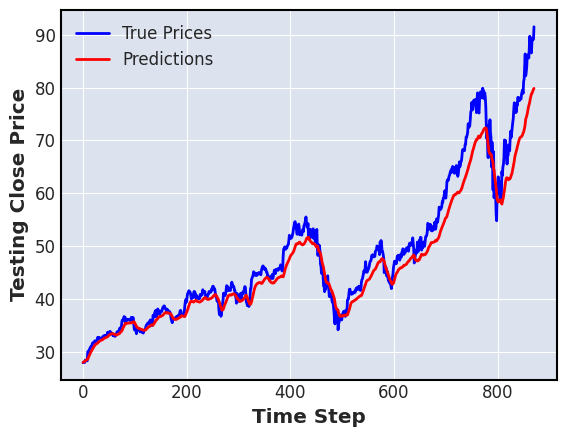

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 7s 49ms/step - loss: 8.5612e-05 - mae: 0.0058 - mse: 8.5612e-05 - mape: 33.2525 - val_loss: 1.0227e-04 - val_mae: 0.0077 - val_mse: 1.0227e-04 - val_mape: 6.2206
Epoch 2/10
55/55 [==============================] - 1s 27ms/step - loss: 6.2689e-06 - mae: 0.0019 - mse: 6.2689e-06 - mape: 8.1785 - val_loss: 8.7811e-05 - val_mae: 0.0072 - val_mse: 8.7811e-05 - val_mape: 5.8280
Epoch 3/10
55/55 [==============================] - 2s 28ms/step - loss: 5.2313e-06 - mae: 0.0017 - mse: 5.2313e-06 - mape: 6.9178 - val_loss: 8.1881e-05 - val_mae: 0.0069 - val_mse: 8.1881e-05 - val_mape: 5.6346
Epoch 4/10
55/55 [==============================] - 1s 27ms/step - loss: 5.0445e-06 - mae: 0.0017 - mse: 5.0445e-06 - mape: 7.0764 - val_loss: 7.4590e-05 - val_mae: 0.0066 - val_mse: 7.4590e-05 - val_mape: 5.3501
Epoch 5/10
55/55 [==============================] - 2s 28ms/step - loss: 

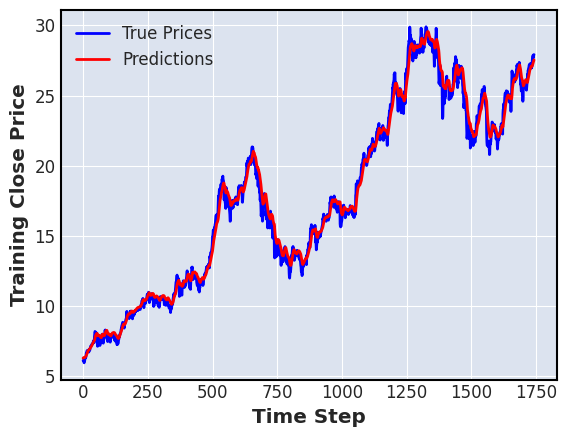

28/28 [==============================] - 0s 8ms/step


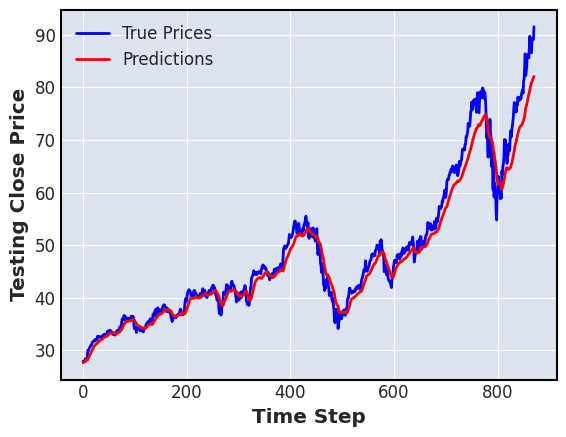

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 7s 46ms/step - loss: 6.7359e-05 - mae: 0.0050 - mse: 6.7359e-05 - mape: 25.5680 - val_loss: 1.1816e-04 - val_mae: 0.0083 - val_mse: 1.1816e-04 - val_mape: 6.7512
Epoch 2/10
55/55 [==============================] - 1s 27ms/step - loss: 8.4540e-06 - mae: 0.0022 - mse: 8.4540e-06 - mape: 9.2447 - val_loss: 1.0514e-04 - val_mae: 0.0080 - val_mse: 1.0514e-04 - val_mape: 6.5793
Epoch 3/10
55/55 [==============================] - 2s 28ms/step - loss: 7.2893e-06 - mae: 0.0021 - mse: 7.2893e-06 - mape: 8.8069 - val_loss: 1.0850e-04 - val_mae: 0.0083 - val_mse: 1.0850e-04 - val_mape: 6.8389
Epoch 4/10
55/55 [==============================] - 2s 32ms/step - loss: 9.4542e-06 - mae: 0.0024 - mse: 9.4542e-06 - mape: 11.2057 - val_loss: 8.0807e-05 - val_mae: 0.0063 - val_mse: 8.0807e-05 - val_mape: 5.0447
Epoch 5/10
55/55 [==============================] - 1s 27ms/step - loss:

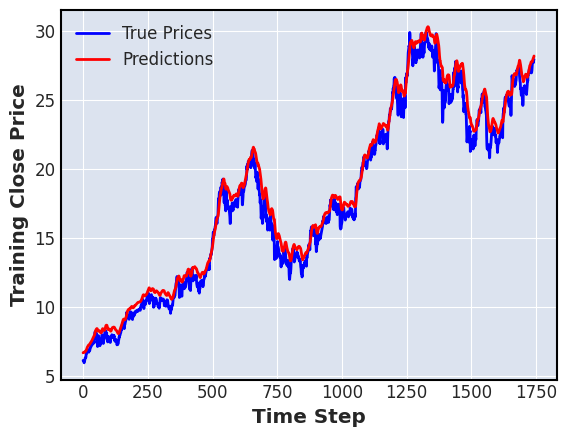

28/28 [==============================] - 0s 9ms/step


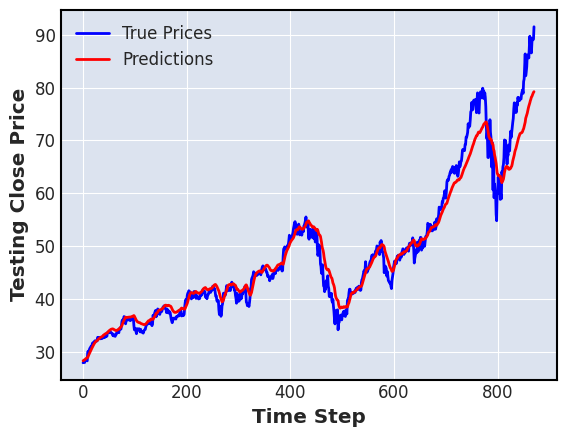

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 10s 41ms/step - loss: 2.3673e-04 - mae: 0.0084 - mse: 2.3673e-04 - mape: 26.4711 - val_loss: 7.3035e-04 - val_mae: 0.0212 - val_mse: 7.3035e-04 - val_mape: 5.7855
Epoch 2/10
82/82 [==============================] - 2s 26ms/step - loss: 3.0986e-05 - mae: 0.0036 - mse: 3.0986e-05 - mape: 8.8841 - val_loss: 6.0161e-04 - val_mae: 0.0193 - val_mse: 6.0161e-04 - val_mape: 5.2395
Epoch 3/10
82/82 [==============================] - 2s 29ms/step - loss: 2.3397e-05 - mae: 0.0031 - mse: 2.3397e-05 - mape: 7.6538 - val_loss: 2.7429e-04 - val_mae: 0.0130 - val_mse: 2.7429e-04 - val_mape: 3.5416
Epoch 4/10
82/82 [==============================] - 2s 28ms/step - loss: 1.7888e-05 - mae: 0.0028 - mse: 1.7888e-05 - mape: 7.3688 - val_loss: 7.9090e-04 - val_mae: 0.0239 - val_mse: 7.9090e-04 - val_mape: 6.3244
Epoch 5/10
82/82 [==============================] - 2s 27

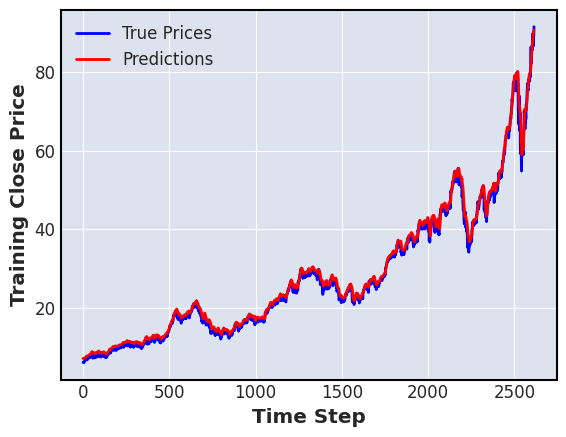

28/28 [==============================] - 0s 9ms/step


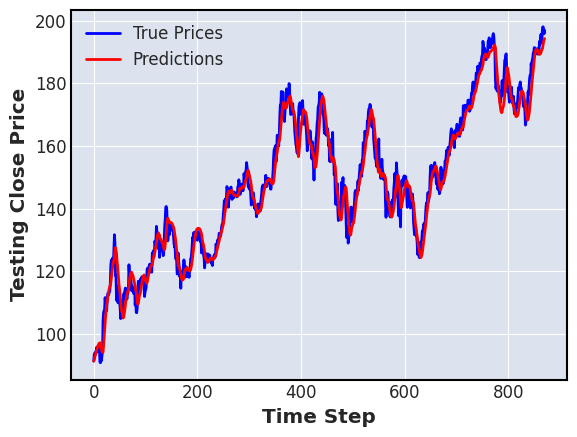

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 8s 39ms/step - loss: 3.0955e-04 - mae: 0.0096 - mse: 3.0955e-04 - mape: 30.7796 - val_loss: 4.4694e-04 - val_mae: 0.0164 - val_mse: 4.4694e-04 - val_mape: 4.4811
Epoch 2/10
82/82 [==============================] - 2s 26ms/step - loss: 2.5186e-05 - mae: 0.0032 - mse: 2.5186e-05 - mape: 7.1779 - val_loss: 5.1806e-04 - val_mae: 0.0177 - val_mse: 5.1806e-04 - val_mape: 4.8292
Epoch 3/10
82/82 [==============================] - 2s 27ms/step - loss: 2.2443e-05 - mae: 0.0031 - mse: 2.2443e-05 - mape: 7.5199 - val_loss: 4.4550e-04 - val_mae: 0.0164 - val_mse: 4.4550e-04 - val_mape: 4.4577
Epoch 4/10
82/82 [==============================] - 2s 26ms/step - loss: 1.7739e-05 - mae: 0.0027 - mse: 1.7739e-05 - mape: 6.4403 - val_loss: 7.1355e-04 - val_mae: 0.0222 - val_mse: 7.1355e-04 - val_mape: 5.9025
Epoch 5/10
82/82 [==============================] - 2s 26ms/step - loss: 

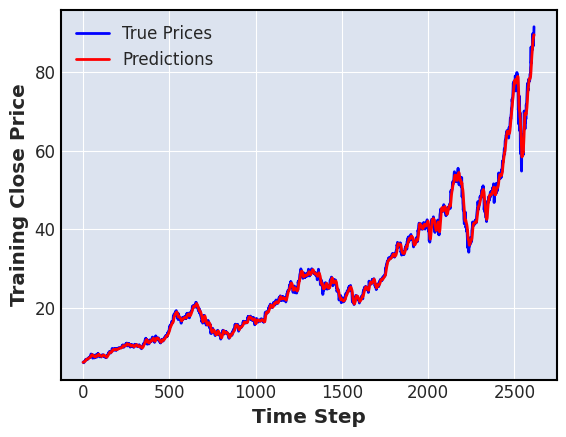

28/28 [==============================] - 0s 8ms/step


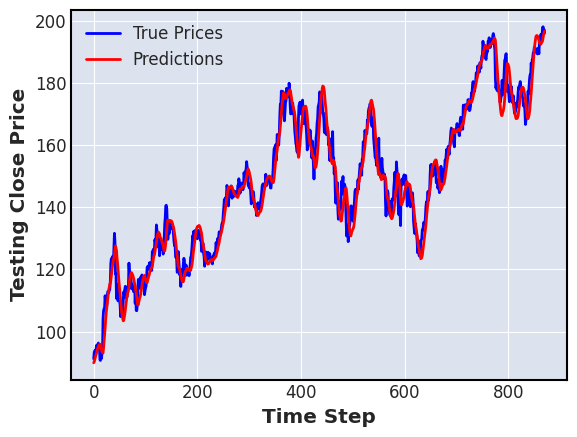

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 8s 39ms/step - loss: 2.4521e-04 - mae: 0.0080 - mse: 2.4521e-04 - mape: 24.5686 - val_loss: 6.7342e-04 - val_mae: 0.0203 - val_mse: 6.7342e-04 - val_mape: 5.5470
Epoch 2/10
82/82 [==============================] - 2s 27ms/step - loss: 2.8520e-05 - mae: 0.0035 - mse: 2.8520e-05 - mape: 8.8344 - val_loss: 5.7526e-04 - val_mae: 0.0190 - val_mse: 5.7526e-04 - val_mape: 5.1602
Epoch 3/10
82/82 [==============================] - 2s 26ms/step - loss: 2.8167e-05 - mae: 0.0037 - mse: 2.8167e-05 - mape: 10.0455 - val_loss: 5.5231e-04 - val_mae: 0.0190 - val_mse: 5.5231e-04 - val_mape: 5.1343
Epoch 4/10
82/82 [==============================] - 2s 27ms/step - loss: 1.7431e-05 - mae: 0.0027 - mse: 1.7431e-05 - mape: 7.2020 - val_loss: 2.3028e-04 - val_mae: 0.0117 - val_mse: 2.3028e-04 - val_mape: 3.1953
Epoch 5/10
82/82 [==============================] - 2s 27ms/step - loss:

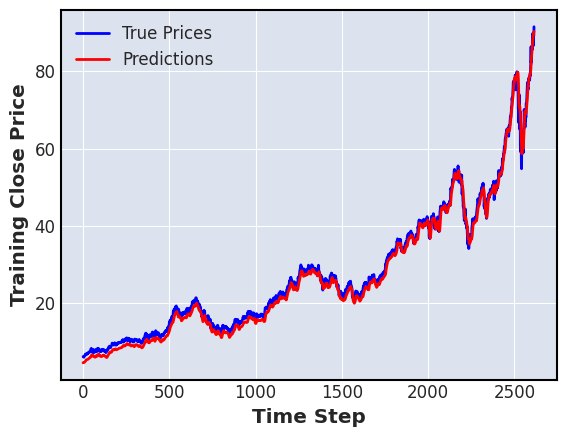

28/28 [==============================] - 0s 9ms/step


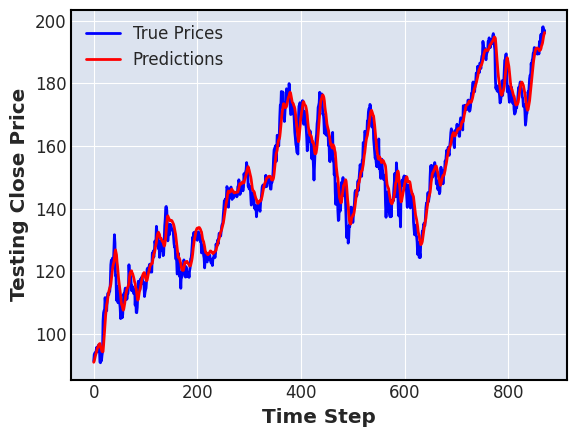

---------------------------------------------------------------
ticker_name :  MSFT Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 7s 88ms/step - loss: 1.6596e-04 - mae: 0.0096 - mse: 1.6596e-04 - mape: 21.6793 - val_loss: 0.0011 - val_mae: 0.0296 - val_mse: 0.0011 - val_mape: 29.5850
Epoch 2/10
28/28 [==============================] - 3s 121ms/step - loss: 2.8193e-05 - mae: 0.0042 - mse: 2.8193e-05 - mape: 9.4902 - val_loss: 8.3719e-04 - val_mae: 0.0264 - val_mse: 8.3719e-04 - val_mape: 26.5661
Epoch 3/10
28/28 [==============================] - 1s 35ms/step - loss: 1.7268e-05 - mae: 0.0032 - mse: 1.7268e-05 - mape: 7.2673 - val_loss: 4.6920e-04 - val_mae: 0.0196 - val_mse: 4.6920e-04 - val_mape: 19.6380
Epoch 4/10
28/28 [==============================] - 1s 34ms/step - loss: 1.2239e-05 - mae: 0.0027 - mse: 1.2239e-05 - mape: 6.1588 - val_loss: 2.3888e-04 - val_mae: 0.0140 - val_mse: 2.3888e-04 - val_mape: 14.1801
Epoch 5/10
28/28 

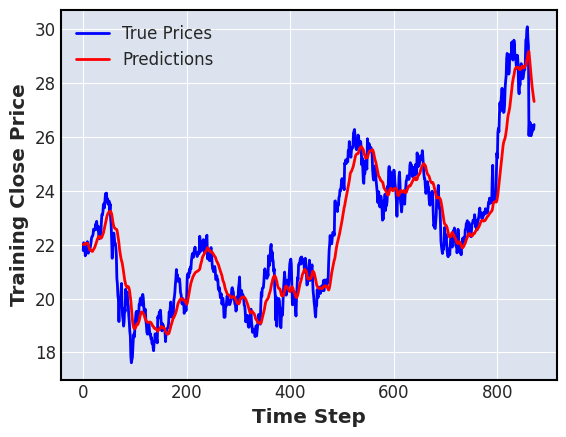

28/28 [==============================] - 0s 8ms/step


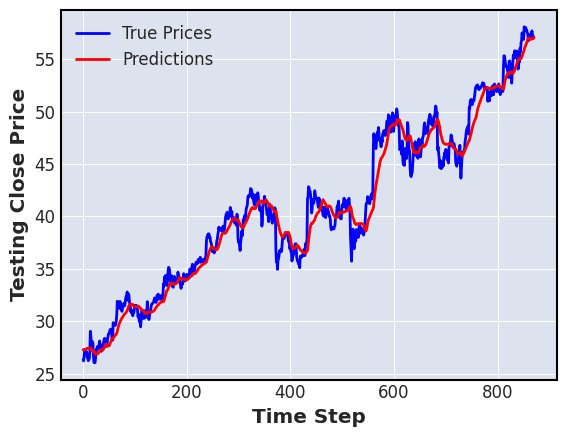

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 7s 74ms/step - loss: 1.9335e-04 - mae: 0.0096 - mse: 1.9335e-04 - mape: 21.5939 - val_loss: 0.0015 - val_mae: 0.0362 - val_mse: 0.0015 - val_mape: 36.9208
Epoch 2/10
28/28 [==============================] - 1s 35ms/step - loss: 2.3940e-05 - mae: 0.0039 - mse: 2.3940e-05 - mape: 8.8609 - val_loss: 0.0010 - val_mae: 0.0295 - val_mse: 0.0010 - val_mape: 29.8638
Epoch 3/10
28/28 [==============================] - 1s 35ms/step - loss: 1.9435e-05 - mae: 0.0035 - mse: 1.9435e-05 - mape: 7.8456 - val_loss: 5.9463e-04 - val_mae: 0.0220 - val_mse: 5.9463e-04 - val_mape: 21.9802
Epoch 4/10
28/28 [==============================] - 1s 32ms/step - loss: 1.4411e-05 - mae: 0.0030 - mse: 1.4411e-05 - mape: 6.7349 - val_loss: 3.5575e-04 - val_mae: 0.0169 - val_mse: 3.5575e-04 - val_mape: 16.8990
Epoch 5/10
28/28 [==============================] - 1s 36ms/step - loss: 1.0810e-05 -

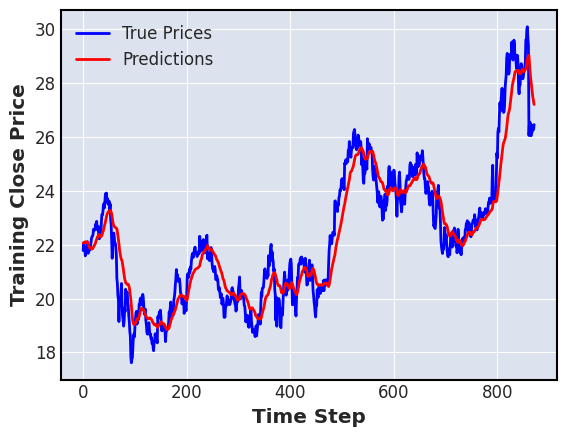

28/28 [==============================] - 0s 8ms/step


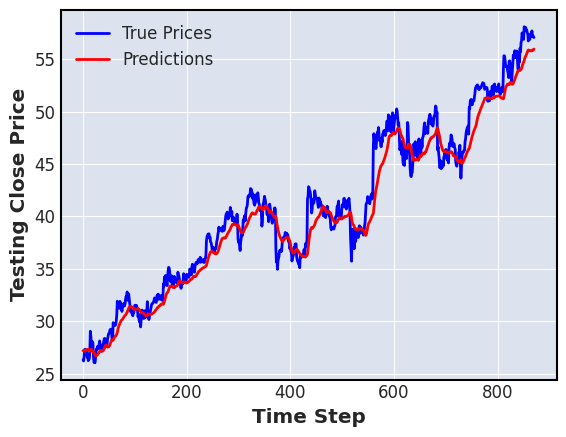

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 7s 72ms/step - loss: 1.7980e-04 - mae: 0.0095 - mse: 1.7980e-04 - mape: 21.4115 - val_loss: 0.0011 - val_mae: 0.0310 - val_mse: 0.0011 - val_mape: 31.3353
Epoch 2/10
28/28 [==============================] - 1s 35ms/step - loss: 2.5193e-05 - mae: 0.0040 - mse: 2.5193e-05 - mape: 9.0742 - val_loss: 8.3172e-04 - val_mae: 0.0263 - val_mse: 8.3172e-04 - val_mape: 26.4890
Epoch 3/10
28/28 [==============================] - 1s 33ms/step - loss: 1.8061e-05 - mae: 0.0034 - mse: 1.8061e-05 - mape: 7.5634 - val_loss: 6.1587e-04 - val_mae: 0.0227 - val_mse: 6.1587e-04 - val_mape: 22.9092
Epoch 4/10
28/28 [==============================] - 1s 41ms/step - loss: 1.4210e-05 - mae: 0.0029 - mse: 1.4210e-05 - mape: 6.6063 - val_loss: 3.4806e-04 - val_mae: 0.0169 - val_mse: 3.4806e-04 - val_mape: 17.0113
Epoch 5/10
28/28 [==============================] - 1s 38ms/step - loss: 1.08

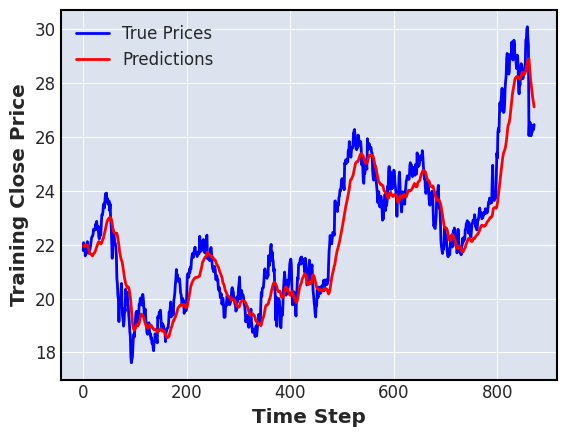

28/28 [==============================] - 0s 9ms/step


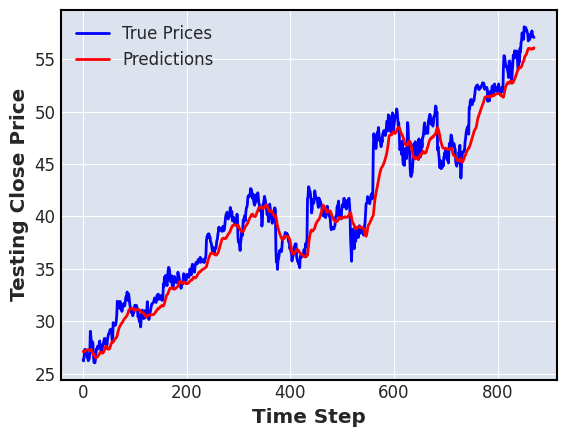

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 7s 47ms/step - loss: 2.8136e-04 - mae: 0.0111 - mse: 2.8136e-04 - mape: 18.1539 - val_loss: 2.2145e-04 - val_mae: 0.0082 - val_mse: 2.2145e-04 - val_mape: 2.7985
Epoch 2/10
55/55 [==============================] - 2s 31ms/step - loss: 1.5559e-05 - mae: 0.0030 - mse: 1.5559e-05 - mape: 4.4924 - val_loss: 2.0038e-04 - val_mae: 0.0083 - val_mse: 2.0038e-04 - val_mape: 2.7548
Epoch 3/10
55/55 [==============================] - 2s 31ms/step - loss: 1.3524e-05 - mae: 0.0027 - mse: 1.3524e-05 - mape: 4.1654 - val_loss: 1.9508e-04 - val_mae: 0.0085 - val_mse: 1.9508e-04 - val_mape: 2.7607
Epoch 4/10
55/55 [==============================] - 2s 32ms/step - loss: 1.4366e-05 - mae: 0.0028 - mse: 1.4366e-05 - mape: 4.3493 - val_loss: 1.9658e-04 - val_mae: 0.0089 - val_mse: 1.9658e-04 - val_mape: 2.9197
Epoch 5/10
55/55 [==============================] - 2s 28m

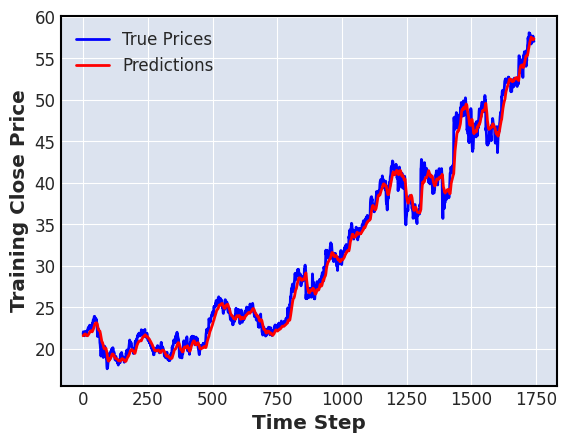

28/28 [==============================] - 0s 9ms/step


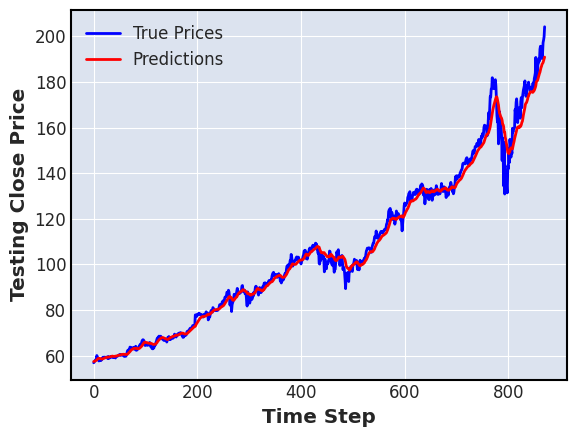

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 8s 47ms/step - loss: 3.4650e-04 - mae: 0.0118 - mse: 3.4650e-04 - mape: 19.1512 - val_loss: 4.2086e-04 - val_mae: 0.0153 - val_mse: 4.2086e-04 - val_mape: 5.6120
Epoch 2/10
55/55 [==============================] - 1s 27ms/step - loss: 1.3120e-05 - mae: 0.0027 - mse: 1.3120e-05 - mape: 4.0715 - val_loss: 1.7041e-04 - val_mae: 0.0075 - val_mse: 1.7041e-04 - val_mape: 2.5005
Epoch 3/10
55/55 [==============================] - 2s 27ms/step - loss: 1.1941e-05 - mae: 0.0026 - mse: 1.1941e-05 - mape: 3.9517 - val_loss: 1.7122e-04 - val_mae: 0.0079 - val_mse: 1.7122e-04 - val_mape: 2.5677
Epoch 4/10
55/55 [==============================] - 2s 28ms/step - loss: 1.1937e-05 - mae: 0.0026 - mse: 1.1937e-05 - mape: 3.9635 - val_loss: 1.6008e-04 - val_mae: 0.0075 - val_mse: 1.6008e-04 - val_mape: 2.5031
Epoch 5/10
55/55 [==============================] - 2s 32ms/step - loss: 

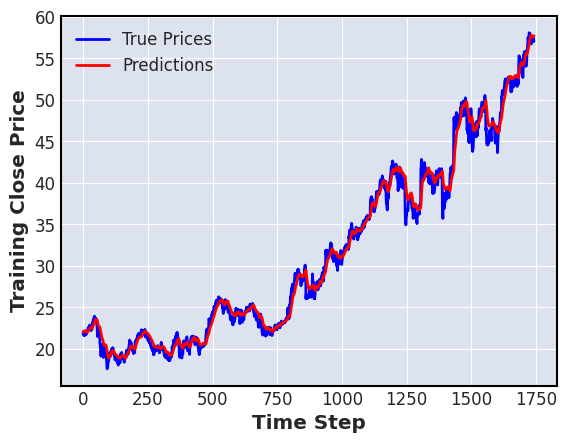

28/28 [==============================] - 0s 10ms/step


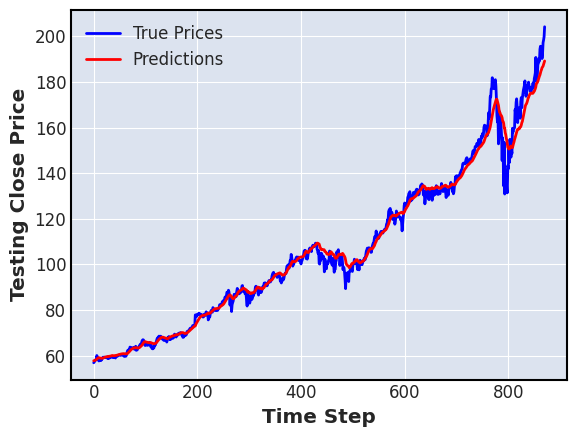

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 7s 47ms/step - loss: 3.2260e-04 - mae: 0.0109 - mse: 3.2260e-04 - mape: 17.0995 - val_loss: 3.7797e-04 - val_mae: 0.0136 - val_mse: 3.7797e-04 - val_mape: 5.0986
Epoch 2/10
55/55 [==============================] - 1s 27ms/step - loss: 1.6590e-05 - mae: 0.0031 - mse: 1.6590e-05 - mape: 4.7336 - val_loss: 1.9926e-04 - val_mae: 0.0083 - val_mse: 1.9926e-04 - val_mape: 2.8967
Epoch 3/10
55/55 [==============================] - 2s 30ms/step - loss: 1.6490e-05 - mae: 0.0031 - mse: 1.6490e-05 - mape: 4.8019 - val_loss: 1.8452e-04 - val_mae: 0.0082 - val_mse: 1.8452e-04 - val_mape: 2.7195
Epoch 4/10
55/55 [==============================] - 2s 28ms/step - loss: 1.3627e-05 - mae: 0.0027 - mse: 1.3627e-05 - mape: 4.2709 - val_loss: 1.7179e-04 - val_mae: 0.0079 - val_mse: 1.7179e-04 - val_mape: 2.6213
Epoch 5/10
55/55 [==============================] - 2s 28ms/step - loss: 

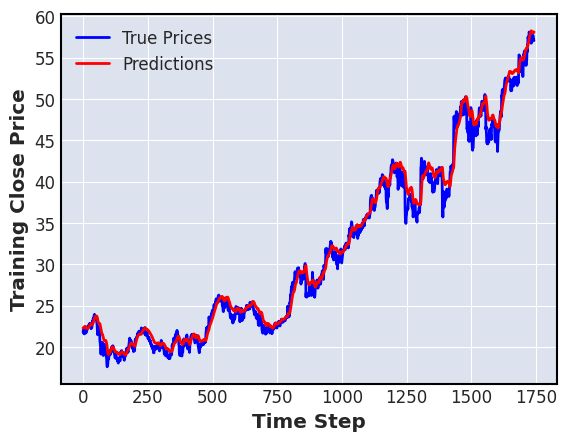

28/28 [==============================] - 0s 8ms/step


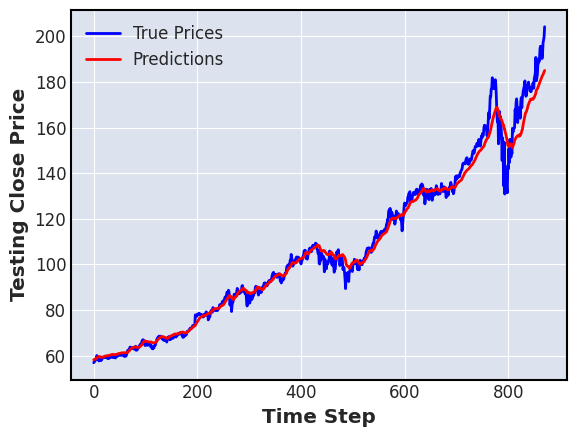

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 8s 40ms/step - loss: 0.0013 - mae: 0.0187 - mse: 0.0013 - mape: 18.7330 - val_loss: 0.0017 - val_mae: 0.0328 - val_mse: 0.0017 - val_mape: 4.7508
Epoch 2/10
82/82 [==============================] - 2s 26ms/step - loss: 7.3839e-05 - mae: 0.0048 - mse: 7.3839e-05 - mape: 4.0766 - val_loss: 0.0019 - val_mae: 0.0339 - val_mse: 0.0019 - val_mape: 4.9051
Epoch 3/10
82/82 [==============================] - 2s 26ms/step - loss: 6.7976e-05 - mae: 0.0047 - mse: 6.7976e-05 - mape: 4.0406 - val_loss: 0.0011 - val_mae: 0.0256 - val_mse: 0.0011 - val_mape: 3.6891
Epoch 4/10
82/82 [==============================] - 2s 25ms/step - loss: 6.0638e-05 - mae: 0.0046 - mse: 6.0638e-05 - mape: 4.2857 - val_loss: 0.0013 - val_mae: 0.0279 - val_mse: 0.0013 - val_mape: 4.0250
Epoch 5/10
82/82 [==============================] - 2s 27ms/step - loss: 5.5832e-05 - mae: 0.0043 

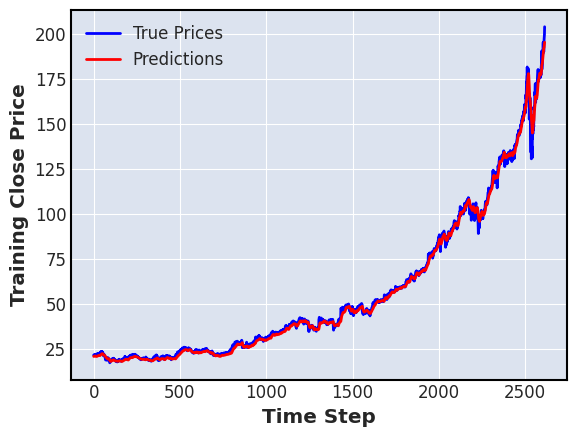

28/28 [==============================] - 0s 8ms/step


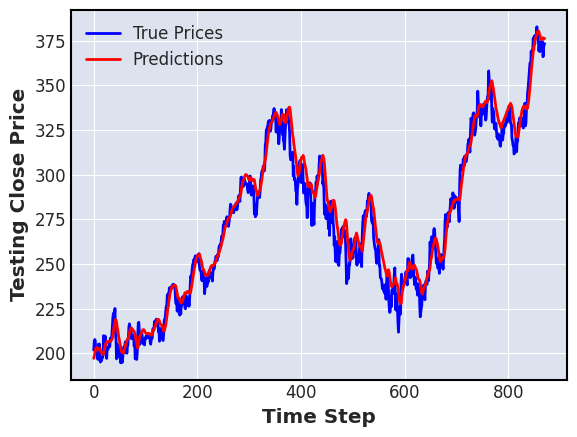

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 11s 49ms/step - loss: 0.0017 - mae: 0.0206 - mse: 0.0017 - mape: 20.5561 - val_loss: 0.0025 - val_mae: 0.0392 - val_mse: 0.0025 - val_mape: 5.6419
Epoch 2/10
82/82 [==============================] - 2s 28ms/step - loss: 6.9437e-05 - mae: 0.0047 - mse: 6.9437e-05 - mape: 3.9664 - val_loss: 9.5717e-04 - val_mae: 0.0245 - val_mse: 9.5717e-04 - val_mape: 3.4838
Epoch 3/10
82/82 [==============================] - 2s 27ms/step - loss: 5.7969e-05 - mae: 0.0042 - mse: 5.7969e-05 - mape: 3.5808 - val_loss: 0.0011 - val_mae: 0.0256 - val_mse: 0.0011 - val_mape: 3.6953
Epoch 4/10
82/82 [==============================] - 2s 26ms/step - loss: 5.9816e-05 - mae: 0.0045 - mse: 5.9816e-05 - mape: 3.8613 - val_loss: 0.0014 - val_mae: 0.0295 - val_mse: 0.0014 - val_mape: 4.2751
Epoch 5/10
82/82 [==============================] - 2s 27ms/step - loss: 6.1060e-05 - mae: 0.0048 - mse:

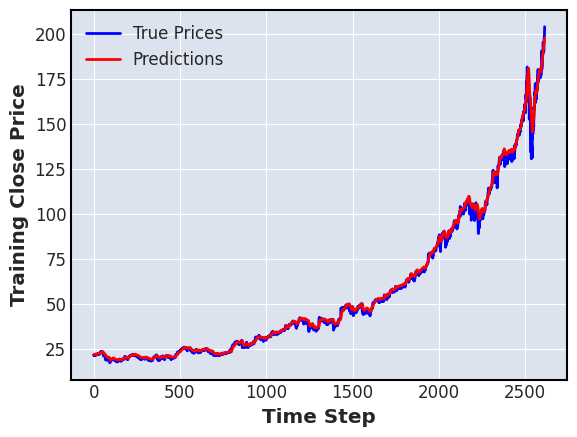

28/28 [==============================] - 0s 9ms/step


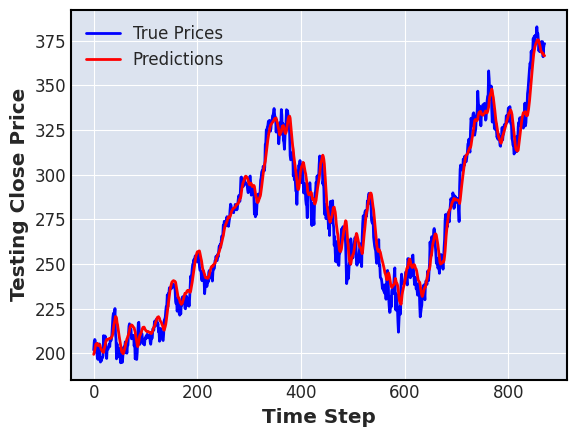

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 8s 43ms/step - loss: 0.0016 - mae: 0.0177 - mse: 0.0016 - mape: 17.0162 - val_loss: 0.0028 - val_mae: 0.0415 - val_mse: 0.0028 - val_mape: 5.9300
Epoch 2/10
82/82 [==============================] - 2s 30ms/step - loss: 1.0415e-04 - mae: 0.0064 - mse: 1.0415e-04 - mape: 5.9896 - val_loss: 0.0050 - val_mae: 0.0606 - val_mse: 0.0050 - val_mape: 8.6858
Epoch 3/10
82/82 [==============================] - 2s 28ms/step - loss: 8.2160e-05 - mae: 0.0054 - mse: 8.2160e-05 - mape: 5.0568 - val_loss: 0.0020 - val_mae: 0.0347 - val_mse: 0.0020 - val_mape: 4.9731
Epoch 4/10
82/82 [==============================] - 2s 27ms/step - loss: 6.7768e-05 - mae: 0.0050 - mse: 6.7768e-05 - mape: 4.7435 - val_loss: 9.5931e-04 - val_mae: 0.0241 - val_mse: 9.5931e-04 - val_mape: 3.4405
Epoch 5/10
82/82 [==============================] - 2s 27ms/step - loss: 6.0909e-05 - mae: 0.0046 - mse: 

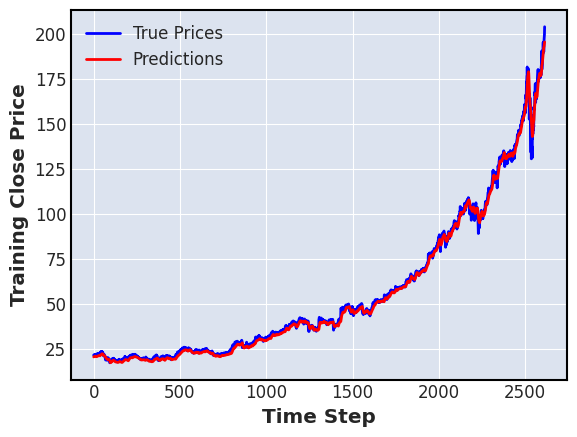

28/28 [==============================] - 0s 8ms/step


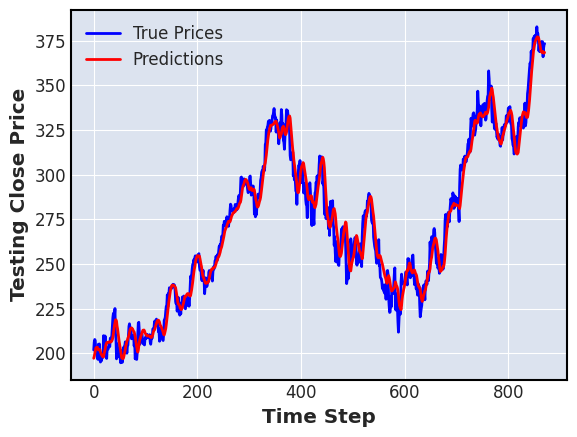

---------------------------------------------------------------


In [36]:
number_of_runs = 0
for ticker_index, ticker_name in enumerate(My_Tickers_SP500):
    full_data = x_tickers_sp500[ticker_index]
    target = y_tickers_sp500[ticker_index]
    print('ticker_name : ' ,ticker_name[0], ticker_name[1] , ' , length = ', len(full_data))
    
    # Time Series Split
    for j, (train_index, test_index) in enumerate(tss.split(full_data)):
        print('kth split : ', j)
        # Different Seeds
        for new_seed in range(3):
            print('seed : ', new_seed)
            seed_value = new_seed
            random.seed(seed_value)
            np.random.seed(seed_value)
            tf.random.set_seed(seed_value)
            utils.set_random_seed(seed_value)

            number_of_runs += 1
            full_data = np.reshape(full_data, (full_data.shape[0], full_data.shape[1], 1))
        
            X_train, X_val = full_data[train_index], full_data[test_index]
            y_train, y_val = target[train_index], target[test_index]

            bi_lstm_model = StockPredictionModel(n_steps=full_data.shape[1], model='Bi_LSTM')
            bi_lstm_model.fit(X_train, y_train, X_val, y_val, epoch=10)
            
            train_pred = bi_lstm_model.predict(X_train)
            train_pred = scaler.inverse_transform(train_pred.reshape(-1, 1))
            y_train = scaler.inverse_transform(y_train.reshape(-1, 1))
            plot_results(train_pred, y_train, 'Training')
            test_pred = bi_lstm_model.predict(X_val)
            test_pred = scaler.inverse_transform(test_pred.reshape(-1, 1))
            y_val = scaler.inverse_transform(y_val.reshape(-1, 1))
            plot_results(test_pred, y_val, 'Testing')
            print('---------------------------------------------------------------')

### GRU

ticker_name :  AMZN Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 4s 50ms/step - loss: 4.4369e-05 - mae: 0.0052 - mse: 4.4369e-05 - mape: 7482.7817 - val_loss: 8.7093e-04 - val_mae: 0.0253 - val_mse: 8.7093e-04 - val_mape: 46.9052
Epoch 2/10
28/28 [==============================] - 1s 28ms/step - loss: 1.4096e-05 - mae: 0.0031 - mse: 1.4096e-05 - mape: 10880.0332 - val_loss: 4.4472e-04 - val_mae: 0.0182 - val_mse: 4.4472e-04 - val_mape: 34.3441
Epoch 3/10
28/28 [==============================] - 1s 29ms/step - loss: 6.1429e-06 - mae: 0.0020 - mse: 6.1429e-06 - mape: 6457.3223 - val_loss: 1.3150e-04 - val_mae: 0.0086 - val_mse: 1.3150e-04 - val_mape: 14.2671
Epoch 4/10
28/28 [==============================] - 1s 28ms/step - loss: 1.0916e-06 - mae: 8.1839e-04 - mse: 1.0916e-06 - mape: 3485.9326 - val_loss: 5.1774e-05 - val_mae: 0.0046 - val_mse: 5.1774e-05 - val_mape: 6.7405
Epoch 5/10
28/28 [==============================] - 1s 33ms

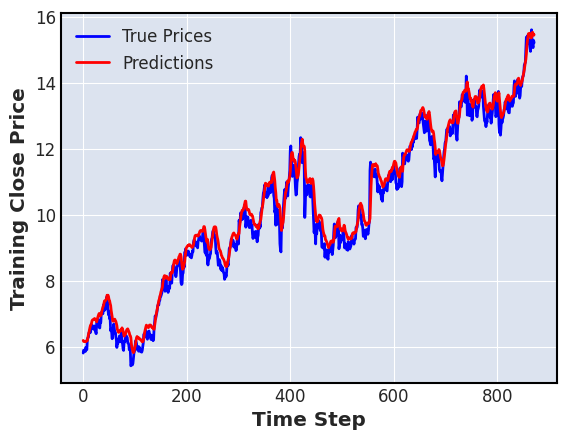

28/28 [==============================] - 0s 7ms/step


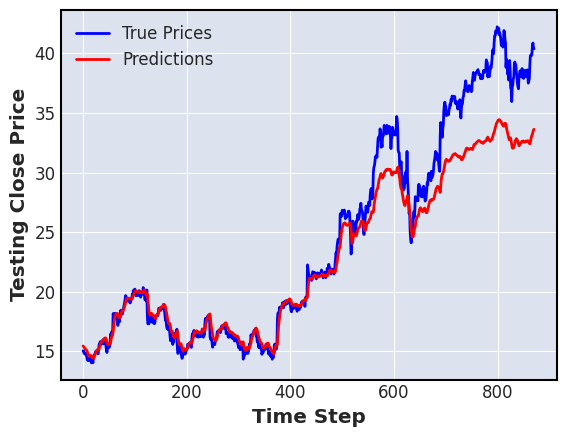

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 4s 50ms/step - loss: 4.7253e-05 - mae: 0.0055 - mse: 4.7253e-05 - mape: 9386.1797 - val_loss: 7.8603e-04 - val_mae: 0.0228 - val_mse: 7.8603e-04 - val_mape: 39.8634
Epoch 2/10
28/28 [==============================] - 1s 32ms/step - loss: 1.8938e-05 - mae: 0.0035 - mse: 1.8938e-05 - mape: 8568.1641 - val_loss: 4.0780e-04 - val_mae: 0.0168 - val_mse: 4.0780e-04 - val_mape: 30.2676
Epoch 3/10
28/28 [==============================] - 1s 34ms/step - loss: 5.5418e-06 - mae: 0.0019 - mse: 5.5418e-06 - mape: 6573.2832 - val_loss: 6.9128e-05 - val_mae: 0.0057 - val_mse: 6.9128e-05 - val_mape: 8.6145
Epoch 4/10
28/28 [==============================] - 1s 28ms/step - loss: 1.3195e-06 - mae: 8.8915e-04 - mse: 1.3195e-06 - mape: 1740.0748 - val_loss: 3.2601e-05 - val_mae: 0.0036 - val_mse: 3.2601e-05 - val_mape: 5.4660
Epoch 5/10
28/28 [==============================] - 1s 2

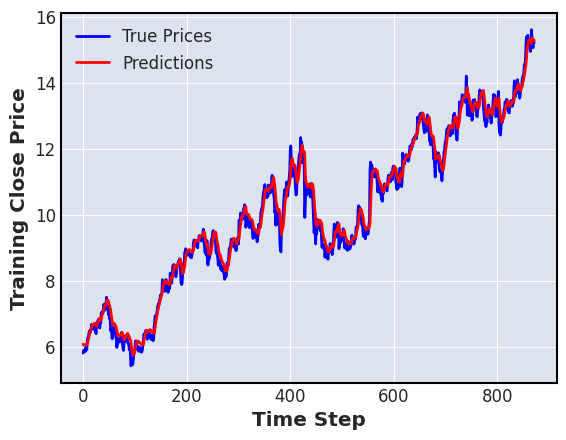

28/28 [==============================] - 0s 6ms/step


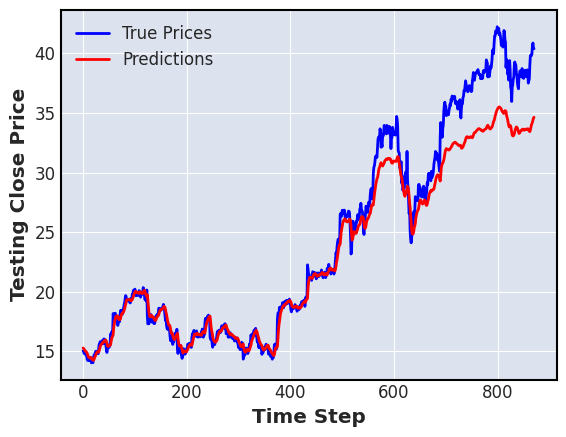

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 4s 53ms/step - loss: 5.1693e-05 - mae: 0.0057 - mse: 5.1693e-05 - mape: 16578.2539 - val_loss: 0.0017 - val_mae: 0.0359 - val_mse: 0.0017 - val_mape: 67.5743
Epoch 2/10
28/28 [==============================] - 1s 34ms/step - loss: 3.0259e-05 - mae: 0.0045 - mse: 3.0259e-05 - mape: 14183.3799 - val_loss: 0.0012 - val_mae: 0.0297 - val_mse: 0.0012 - val_mape: 54.3325
Epoch 3/10
28/28 [==============================] - 1s 29ms/step - loss: 2.2673e-05 - mae: 0.0040 - mse: 2.2673e-05 - mape: 10791.2520 - val_loss: 8.5217e-04 - val_mae: 0.0252 - val_mse: 8.5217e-04 - val_mape: 47.0195
Epoch 4/10
28/28 [==============================] - 1s 33ms/step - loss: 1.0172e-05 - mae: 0.0026 - mse: 1.0172e-05 - mape: 8233.9902 - val_loss: 1.0277e-04 - val_mae: 0.0081 - val_mse: 1.0277e-04 - val_mape: 14.1051
Epoch 5/10
28/28 [==============================] - 1s 29ms/step - loss

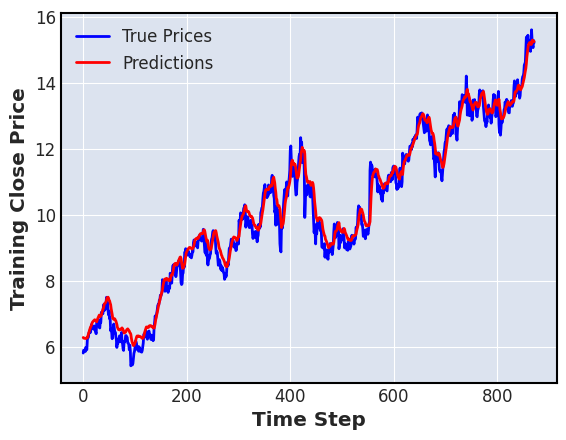

28/28 [==============================] - 0s 7ms/step


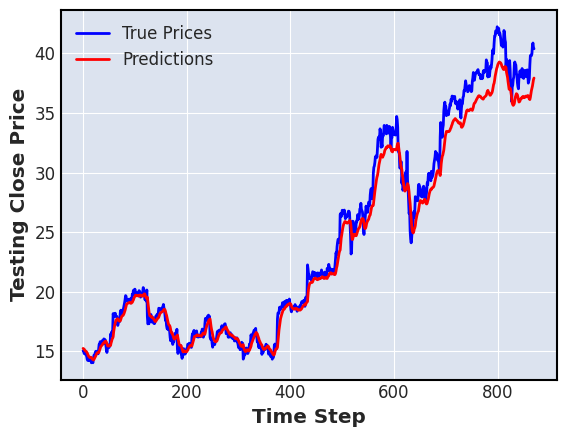

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 5s 37ms/step - loss: 1.7936e-04 - mae: 0.0079 - mse: 1.7936e-04 - mape: 255.0028 - val_loss: 5.0064e-04 - val_mae: 0.0155 - val_mse: 5.0064e-04 - val_mape: 6.5032
Epoch 2/10
55/55 [==============================] - 2s 33ms/step - loss: 2.6706e-06 - mae: 0.0012 - mse: 2.6706e-06 - mape: 1373.9458 - val_loss: 5.6409e-04 - val_mae: 0.0168 - val_mse: 5.6409e-04 - val_mape: 7.0497
Epoch 3/10
55/55 [==============================] - 2s 29ms/step - loss: 2.1454e-06 - mae: 0.0010 - mse: 2.1454e-06 - mape: 1246.1248 - val_loss: 5.8140e-04 - val_mae: 0.0171 - val_mse: 5.8140e-04 - val_mape: 7.1690
Epoch 4/10
55/55 [==============================] - 1s 25ms/step - loss: 2.2642e-06 - mae: 0.0011 - mse: 2.2642e-06 - mape: 942.8898 - val_loss: 5.7649e-04 - val_mae: 0.0170 - val_mse: 5.7649e-04 - val_mape: 7.1529
Epoch 5/10
55/55 [==============================]

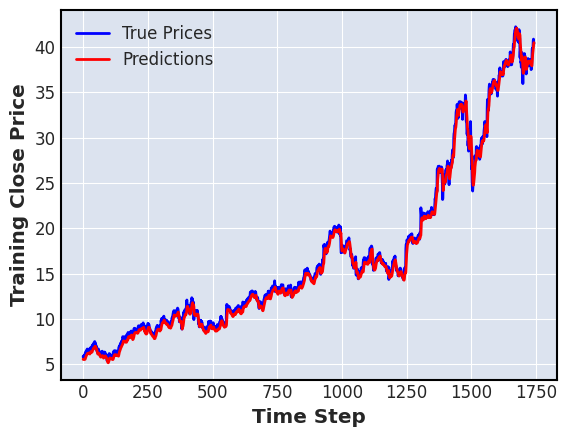

28/28 [==============================] - 0s 8ms/step


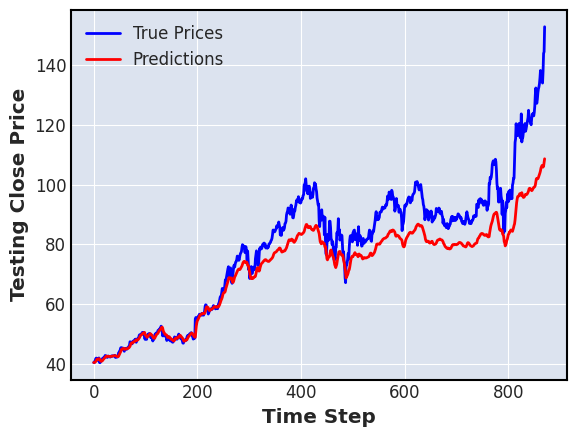

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 5s 36ms/step - loss: 1.9652e-04 - mae: 0.0085 - mse: 1.9652e-04 - mape: 17932.6191 - val_loss: 6.6207e-04 - val_mae: 0.0206 - val_mse: 6.6207e-04 - val_mape: 9.1007
Epoch 2/10
55/55 [==============================] - 2s 28ms/step - loss: 3.7358e-06 - mae: 0.0015 - mse: 3.7358e-06 - mape: 2452.1882 - val_loss: 3.9142e-04 - val_mae: 0.0150 - val_mse: 3.9142e-04 - val_mape: 6.4813
Epoch 3/10
55/55 [==============================] - 1s 27ms/step - loss: 2.2098e-06 - mae: 0.0010 - mse: 2.2098e-06 - mape: 1488.7410 - val_loss: 4.0199e-04 - val_mae: 0.0152 - val_mse: 4.0199e-04 - val_mape: 6.5870
Epoch 4/10
55/55 [==============================] - 2s 27ms/step - loss: 2.6908e-06 - mae: 0.0012 - mse: 2.6908e-06 - mape: 1526.5253 - val_loss: 4.3353e-04 - val_mae: 0.0159 - val_mse: 4.3353e-04 - val_mape: 6.8648
Epoch 5/10
55/55 [==============================] - 1s 27ms/s

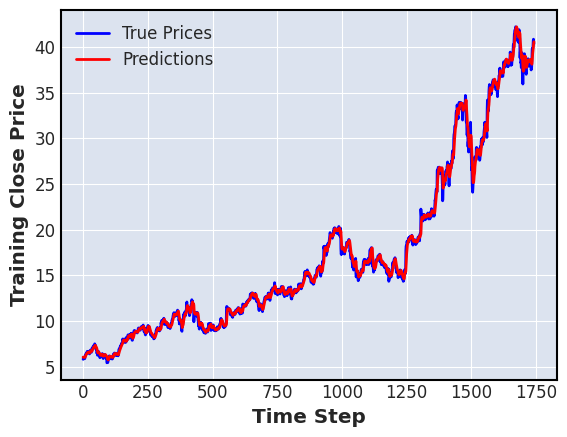

28/28 [==============================] - 0s 7ms/step


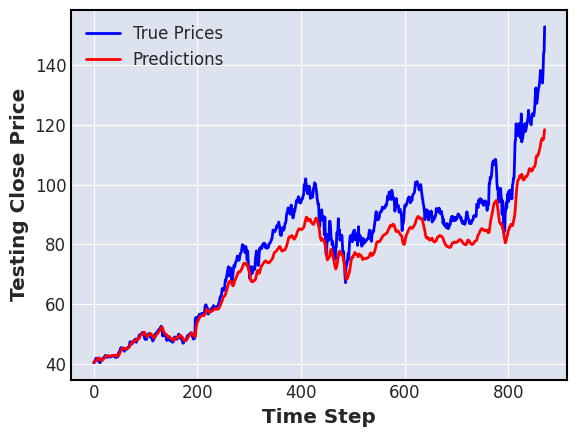

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 5s 36ms/step - loss: 3.3154e-04 - mae: 0.0127 - mse: 3.3154e-04 - mape: 17882.9688 - val_loss: 3.1235e-04 - val_mae: 0.0162 - val_mse: 3.1235e-04 - val_mape: 8.8468
Epoch 2/10
55/55 [==============================] - 1s 25ms/step - loss: 5.4354e-06 - mae: 0.0017 - mse: 5.4354e-06 - mape: 3259.3684 - val_loss: 2.3606e-04 - val_mae: 0.0125 - val_mse: 2.3606e-04 - val_mape: 5.8143
Epoch 3/10
55/55 [==============================] - 1s 24ms/step - loss: 2.9081e-06 - mae: 0.0012 - mse: 2.9081e-06 - mape: 1523.0339 - val_loss: 2.0151e-04 - val_mae: 0.0113 - val_mse: 2.0151e-04 - val_mape: 5.1864
Epoch 4/10
55/55 [==============================] - 1s 27ms/step - loss: 2.7006e-06 - mae: 0.0011 - mse: 2.7006e-06 - mape: 1431.8793 - val_loss: 1.9704e-04 - val_mae: 0.0111 - val_mse: 1.9704e-04 - val_mape: 5.0370
Epoch 5/10
55/55 [==============================] - 1s 24ms/s

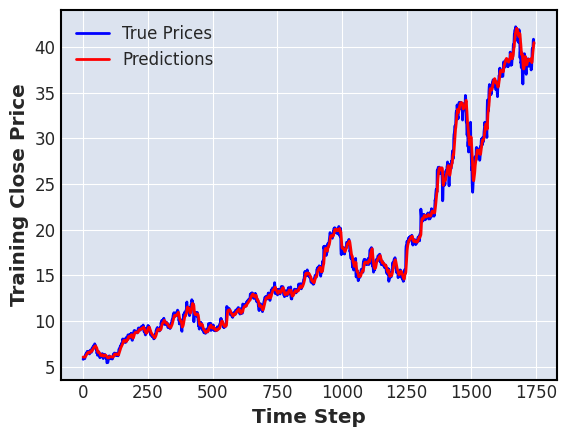

28/28 [==============================] - 0s 7ms/step


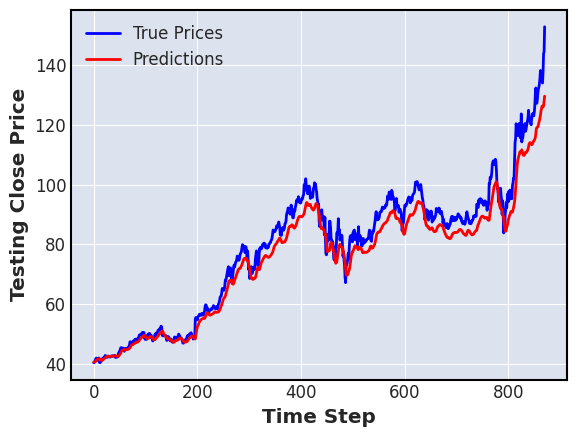

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 5s 31ms/step - loss: 0.0018 - mae: 0.0182 - mse: 0.0018 - mape: 21846.3457 - val_loss: 1.6759e-04 - val_mae: 0.0100 - val_mse: 1.6759e-04 - val_mape: 2.9176
Epoch 2/10
82/82 [==============================] - 2s 23ms/step - loss: 1.3561e-05 - mae: 0.0023 - mse: 1.3561e-05 - mape: 881.2776 - val_loss: 1.2461e-04 - val_mae: 0.0085 - val_mse: 1.2461e-04 - val_mape: 2.4809
Epoch 3/10
82/82 [==============================] - 2s 26ms/step - loss: 1.4580e-05 - mae: 0.0025 - mse: 1.4580e-05 - mape: 14.0773 - val_loss: 1.2183e-04 - val_mae: 0.0084 - val_mse: 1.2183e-04 - val_mape: 2.4418
Epoch 4/10
82/82 [==============================] - 2s 23ms/step - loss: 1.4255e-05 - mae: 0.0024 - mse: 1.4255e-05 - mape: 232.6068 - val_loss: 1.2219e-04 - val_mae: 0.0085 - val_mse: 1.2219e-04 - val_mape: 2.4412
Epoch 5/10
82/82 [==============================] - 2s 24m

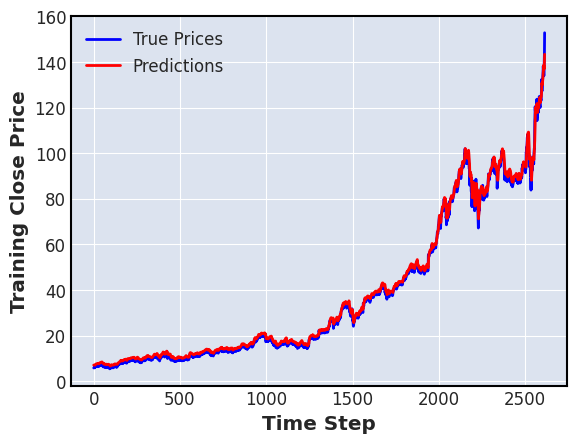

28/28 [==============================] - 0s 7ms/step


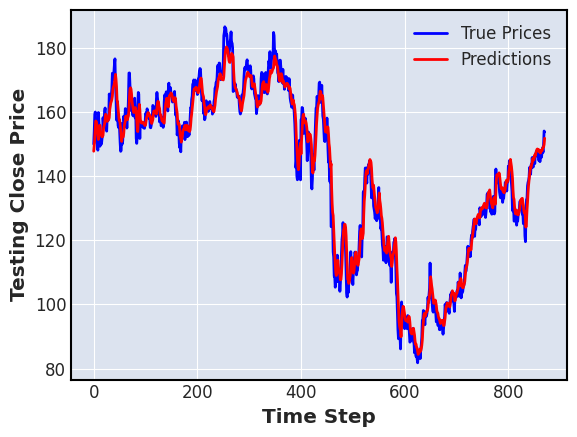

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 6s 32ms/step - loss: 0.0018 - mae: 0.0219 - mse: 0.0018 - mape: 31292.2910 - val_loss: 1.5036e-04 - val_mae: 0.0093 - val_mse: 1.5036e-04 - val_mape: 2.7042
Epoch 2/10
82/82 [==============================] - 2s 26ms/step - loss: 1.3885e-05 - mae: 0.0022 - mse: 1.3885e-05 - mape: 1315.4476 - val_loss: 1.4681e-04 - val_mae: 0.0092 - val_mse: 1.4681e-04 - val_mape: 2.6815
Epoch 3/10
82/82 [==============================] - 2s 23ms/step - loss: 1.3491e-05 - mae: 0.0022 - mse: 1.3491e-05 - mape: 593.7661 - val_loss: 1.7720e-04 - val_mae: 0.0103 - val_mse: 1.7720e-04 - val_mape: 3.0117
Epoch 4/10
82/82 [==============================] - 2s 24ms/step - loss: 1.7335e-05 - mae: 0.0027 - mse: 1.7335e-05 - mape: 266.8216 - val_loss: 1.3381e-04 - val_mae: 0.0088 - val_mse: 1.3381e-04 - val_mape: 2.5443
Epoch 5/10
82/82 [==============================] - 2s 24ms/step - loss

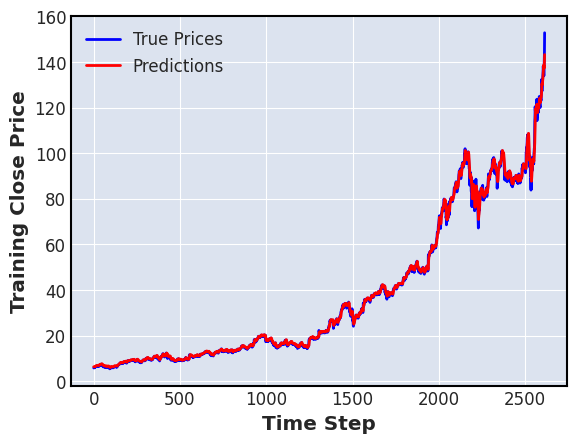

28/28 [==============================] - 0s 7ms/step


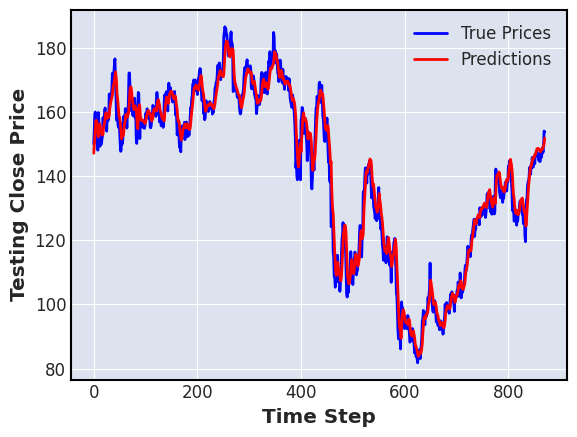

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 8s 31ms/step - loss: 0.0024 - mae: 0.0278 - mse: 0.0024 - mape: 14160.5322 - val_loss: 2.6807e-04 - val_mae: 0.0127 - val_mse: 2.6807e-04 - val_mape: 3.6281
Epoch 2/10
82/82 [==============================] - 2s 23ms/step - loss: 2.4297e-05 - mae: 0.0034 - mse: 2.4297e-05 - mape: 2970.8586 - val_loss: 2.0320e-04 - val_mae: 0.0109 - val_mse: 2.0320e-04 - val_mape: 3.1745
Epoch 3/10
82/82 [==============================] - 2s 23ms/step - loss: 1.8955e-05 - mae: 0.0026 - mse: 1.8955e-05 - mape: 2216.7969 - val_loss: 1.9413e-04 - val_mae: 0.0107 - val_mse: 1.9413e-04 - val_mape: 3.1074
Epoch 4/10
82/82 [==============================] - 2s 23ms/step - loss: 1.9158e-05 - mae: 0.0027 - mse: 1.9158e-05 - mape: 1658.7150 - val_loss: 1.9051e-04 - val_mae: 0.0106 - val_mse: 1.9051e-04 - val_mape: 3.0807
Epoch 5/10
82/82 [==============================] - 2s 23ms/step - lo

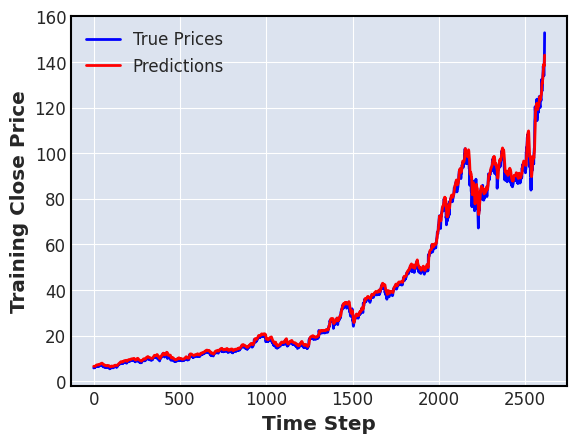

28/28 [==============================] - 0s 6ms/step


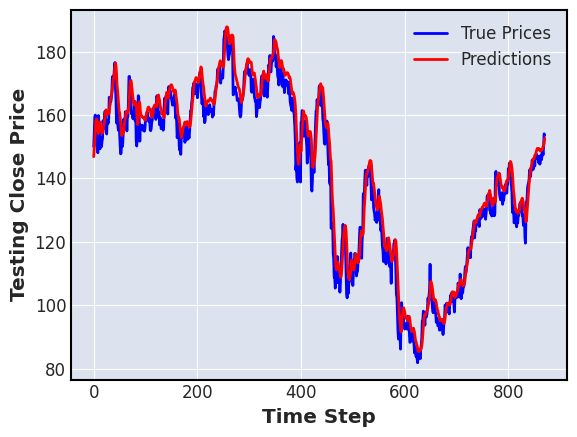

---------------------------------------------------------------
ticker_name :  IBM Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 5s 54ms/step - loss: 0.0231 - mae: 0.1155 - mse: 0.0231 - mape: 43.8547 - val_loss: 5.7655e-04 - val_mae: 0.0204 - val_mse: 5.7655e-04 - val_mape: 8.0708
Epoch 2/10
28/28 [==============================] - 1s 31ms/step - loss: 7.5209e-04 - mae: 0.0232 - mse: 7.5209e-04 - mape: 9.2321 - val_loss: 1.3074e-04 - val_mae: 0.0093 - val_mse: 1.3074e-04 - val_mape: 3.5531
Epoch 3/10
28/28 [==============================] - 1s 31ms/step - loss: 3.7064e-04 - mae: 0.0165 - mse: 3.7064e-04 - mape: 6.8494 - val_loss: 9.6993e-05 - val_mae: 0.0080 - val_mse: 9.6993e-05 - val_mape: 2.9955
Epoch 4/10
28/28 [==============================] - 1s 33ms/step - loss: 2.1899e-04 - mae: 0.0127 - mse: 2.1899e-04 - mape: 5.3111 - val_loss: 6.0443e-05 - val_mae: 0.0063 - val_mse: 6.0443e-05 - val_mape: 2.3361
Epoch 5/10
28/28 [=====

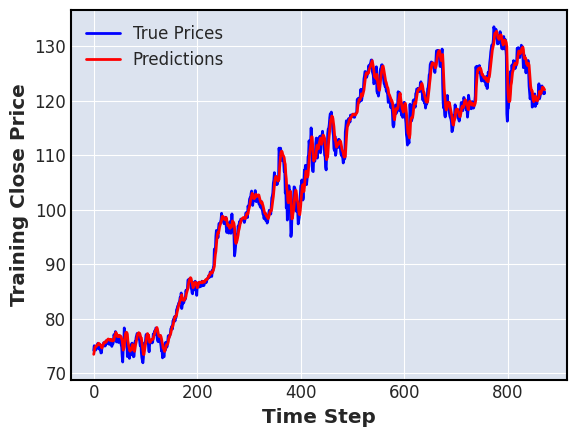

28/28 [==============================] - 0s 7ms/step


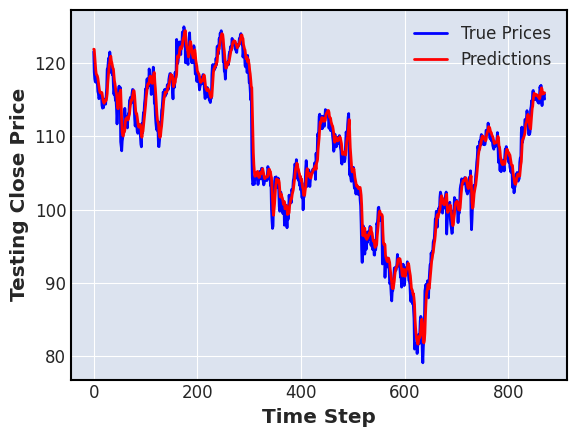

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 4s 55ms/step - loss: 0.0215 - mae: 0.1178 - mse: 0.0215 - mape: 45.2320 - val_loss: 4.8113e-04 - val_mae: 0.0174 - val_mse: 4.8113e-04 - val_mape: 6.9779
Epoch 2/10
28/28 [==============================] - 1s 33ms/step - loss: 0.0011 - mae: 0.0282 - mse: 0.0011 - mape: 11.2185 - val_loss: 2.3200e-04 - val_mae: 0.0124 - val_mse: 2.3200e-04 - val_mape: 4.7843
Epoch 3/10
28/28 [==============================] - 1s 28ms/step - loss: 7.2636e-04 - mae: 0.0236 - mse: 7.2636e-04 - mape: 9.7878 - val_loss: 1.9037e-04 - val_mae: 0.0113 - val_mse: 1.9037e-04 - val_mape: 4.3148
Epoch 4/10
28/28 [==============================] - 1s 33ms/step - loss: 5.7429e-04 - mae: 0.0205 - mse: 5.7429e-04 - mape: 8.6653 - val_loss: 1.4933e-04 - val_mae: 0.0100 - val_mse: 1.4933e-04 - val_mape: 3.7665
Epoch 5/10
28/28 [==============================] - 1s 28ms/step - loss: 4.1019e-04 - ma

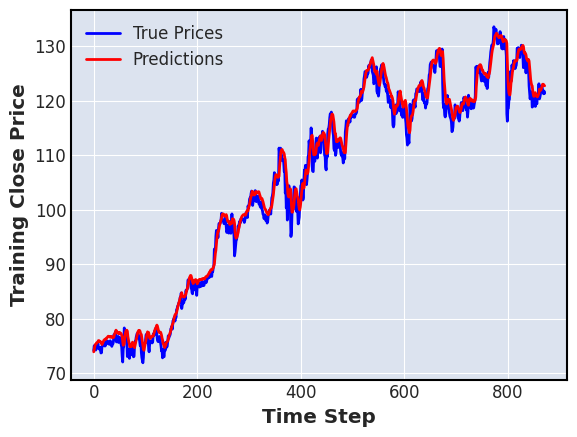

28/28 [==============================] - 0s 6ms/step


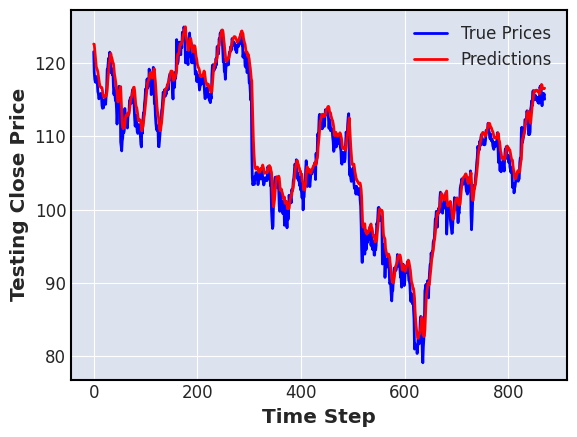

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 4s 56ms/step - loss: 0.0263 - mae: 0.1363 - mse: 0.0263 - mape: 52.1456 - val_loss: 0.0012 - val_mae: 0.0318 - val_mse: 0.0012 - val_mape: 12.4398
Epoch 2/10
28/28 [==============================] - 1s 29ms/step - loss: 0.0014 - mae: 0.0311 - mse: 0.0014 - mape: 12.3625 - val_loss: 3.7686e-04 - val_mae: 0.0151 - val_mse: 3.7686e-04 - val_mape: 6.0681
Epoch 3/10
28/28 [==============================] - 1s 27ms/step - loss: 8.4452e-04 - mae: 0.0249 - mse: 8.4452e-04 - mape: 10.4526 - val_loss: 2.2515e-04 - val_mae: 0.0122 - val_mse: 2.2515e-04 - val_mape: 4.7127
Epoch 4/10
28/28 [==============================] - 1s 28ms/step - loss: 7.1151e-04 - mae: 0.0229 - mse: 7.1151e-04 - mape: 9.6691 - val_loss: 1.9255e-04 - val_mae: 0.0114 - val_mse: 1.9255e-04 - val_mape: 4.3041
Epoch 5/10
28/28 [==============================] - 1s 36ms/step - loss: 5.8642e-04 - mae: 0.0

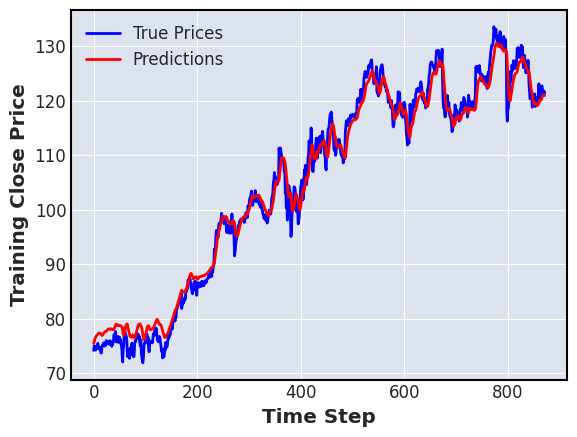

28/28 [==============================] - 0s 7ms/step


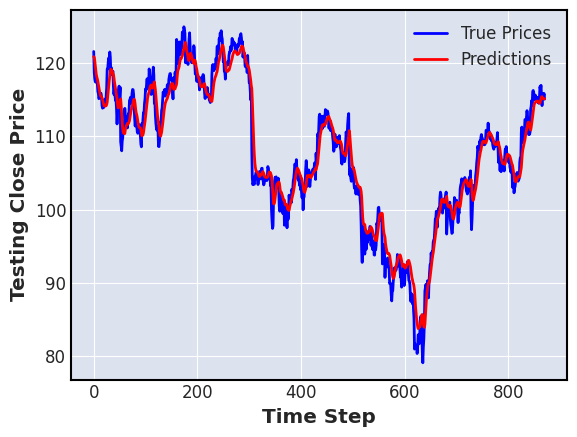

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 5s 38ms/step - loss: 0.0119 - mae: 0.0695 - mse: 0.0119 - mape: 26.2398 - val_loss: 2.3423e-04 - val_mae: 0.0123 - val_mse: 2.3423e-04 - val_mape: 4.9175
Epoch 2/10
55/55 [==============================] - 1s 24ms/step - loss: 3.4933e-04 - mae: 0.0152 - mse: 3.4933e-04 - mape: 6.1849 - val_loss: 1.1790e-04 - val_mae: 0.0077 - val_mse: 1.1790e-04 - val_mape: 2.9736
Epoch 3/10
55/55 [==============================] - 1s 27ms/step - loss: 2.5134e-04 - mae: 0.0129 - mse: 2.5134e-04 - mape: 5.2308 - val_loss: 9.5253e-05 - val_mae: 0.0070 - val_mse: 9.5253e-05 - val_mape: 2.7524
Epoch 4/10
55/55 [==============================] - 1s 26ms/step - loss: 1.5783e-04 - mae: 0.0101 - mse: 1.5783e-04 - mape: 4.1055 - val_loss: 6.1633e-05 - val_mae: 0.0055 - val_mse: 6.1633e-05 - val_mape: 2.1216
Epoch 5/10
55/55 [==============================] - 1s 26ms/step -

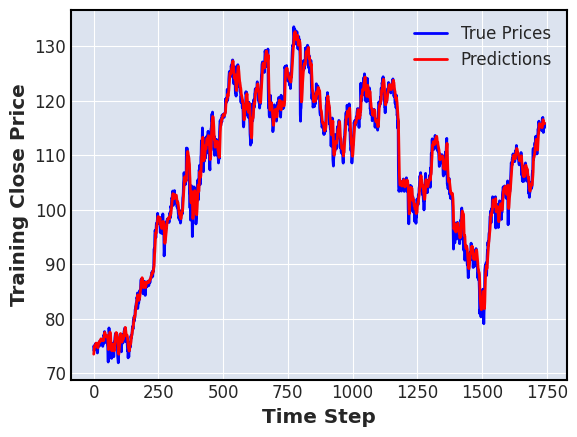

28/28 [==============================] - 0s 6ms/step


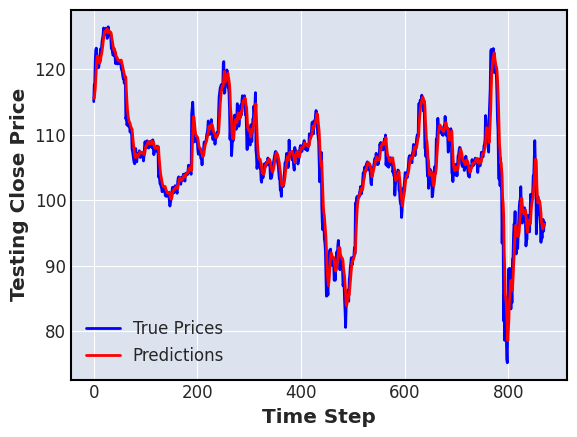

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 5s 39ms/step - loss: 0.0112 - mae: 0.0711 - mse: 0.0112 - mape: 26.7489 - val_loss: 2.5093e-04 - val_mae: 0.0121 - val_mse: 2.5093e-04 - val_mape: 4.8190
Epoch 2/10
55/55 [==============================] - 1s 24ms/step - loss: 4.8284e-04 - mae: 0.0179 - mse: 4.8284e-04 - mape: 7.2836 - val_loss: 1.8358e-04 - val_mae: 0.0101 - val_mse: 1.8358e-04 - val_mape: 4.0238
Epoch 3/10
55/55 [==============================] - 1s 24ms/step - loss: 3.4181e-04 - mae: 0.0149 - mse: 3.4181e-04 - mape: 6.0991 - val_loss: 1.0851e-04 - val_mae: 0.0073 - val_mse: 1.0851e-04 - val_mape: 2.8618
Epoch 4/10
55/55 [==============================] - 1s 27ms/step - loss: 1.8656e-04 - mae: 0.0110 - mse: 1.8656e-04 - mape: 4.4702 - val_loss: 6.4583e-05 - val_mae: 0.0057 - val_mse: 6.4583e-05 - val_mape: 2.1800
Epoch 5/10
55/55 [==============================] - 1s 27ms/step - loss: 7.4655e-

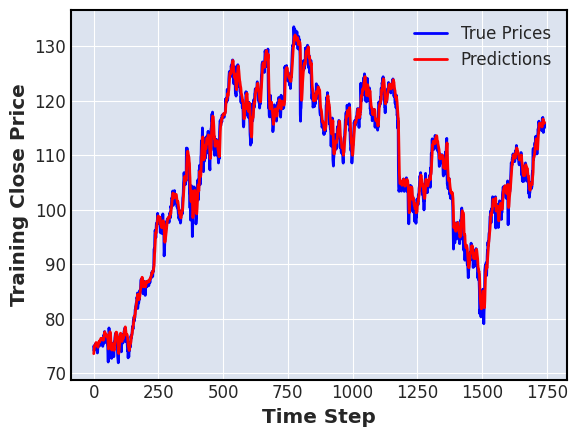

28/28 [==============================] - 0s 7ms/step


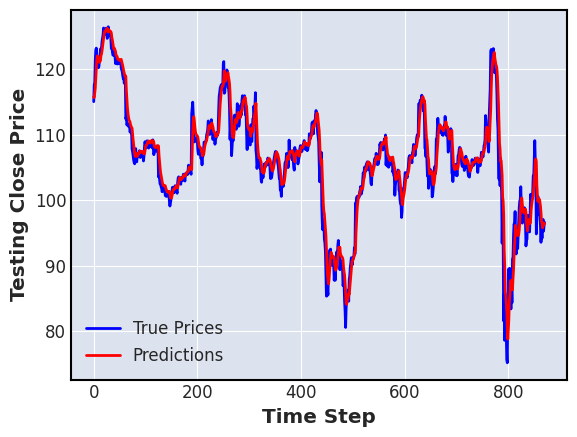

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 7s 37ms/step - loss: 0.0139 - mae: 0.0821 - mse: 0.0139 - mape: 30.9365 - val_loss: 4.4291e-04 - val_mae: 0.0176 - val_mse: 4.4291e-04 - val_mape: 7.0033
Epoch 2/10
55/55 [==============================] - 1s 25ms/step - loss: 5.6380e-04 - mae: 0.0191 - mse: 5.6380e-04 - mape: 7.8041 - val_loss: 2.2957e-04 - val_mae: 0.0115 - val_mse: 2.2957e-04 - val_mape: 4.5816
Epoch 3/10
55/55 [==============================] - 1s 26ms/step - loss: 4.5412e-04 - mae: 0.0172 - mse: 4.5412e-04 - mape: 7.0442 - val_loss: 1.5428e-04 - val_mae: 0.0088 - val_mse: 1.5428e-04 - val_mape: 3.4435
Epoch 4/10
55/55 [==============================] - 1s 27ms/step - loss: 3.2877e-04 - mae: 0.0146 - mse: 3.2877e-04 - mape: 5.9691 - val_loss: 1.1527e-04 - val_mae: 0.0076 - val_mse: 1.1527e-04 - val_mape: 2.9330
Epoch 5/10
55/55 [==============================] - 1s 27ms/step - loss: 2.1239e-

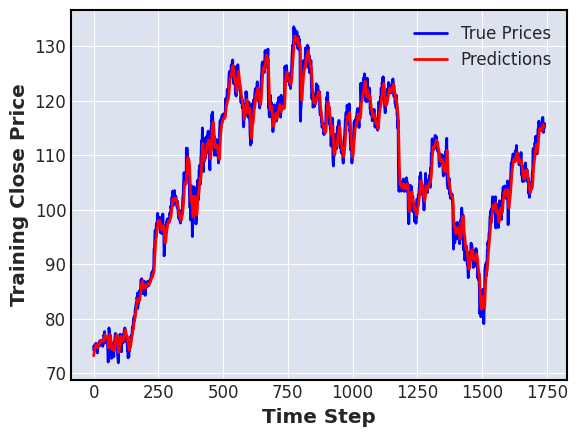

28/28 [==============================] - 0s 6ms/step


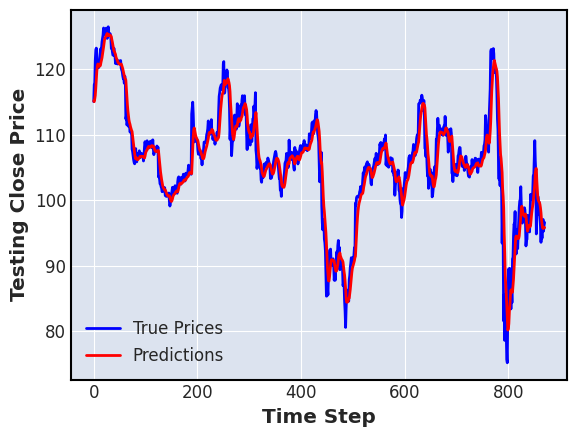

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 6s 32ms/step - loss: 0.0080 - mae: 0.0496 - mse: 0.0080 - mape: 18.7048 - val_loss: 6.7348e-04 - val_mae: 0.0214 - val_mse: 6.7348e-04 - val_mape: 6.5455
Epoch 2/10
82/82 [==============================] - 2s 23ms/step - loss: 1.5097e-04 - mae: 0.0094 - mse: 1.5097e-04 - mape: 3.7919 - val_loss: 2.0825e-04 - val_mae: 0.0116 - val_mse: 2.0825e-04 - val_mape: 3.5765
Epoch 3/10
82/82 [==============================] - 2s 23ms/step - loss: 5.5274e-05 - mae: 0.0057 - mse: 5.5274e-05 - mape: 2.2457 - val_loss: 7.7698e-05 - val_mae: 0.0069 - val_mse: 7.7698e-05 - val_mape: 2.1473
Epoch 4/10
82/82 [==============================] - 2s 26ms/step - loss: 2.6032e-05 - mae: 0.0037 - mse: 2.6032e-05 - mape: 1.4132 - val_loss: 4.7202e-05 - val_mae: 0.0051 - val_mse: 4.7202e-05 - val_mape: 1.6180
Epoch 5/10
82/82 [==============================] - 2s 25ms/step -

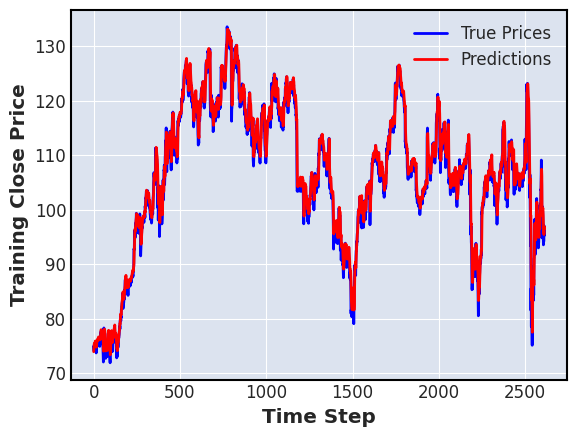

28/28 [==============================] - 0s 6ms/step


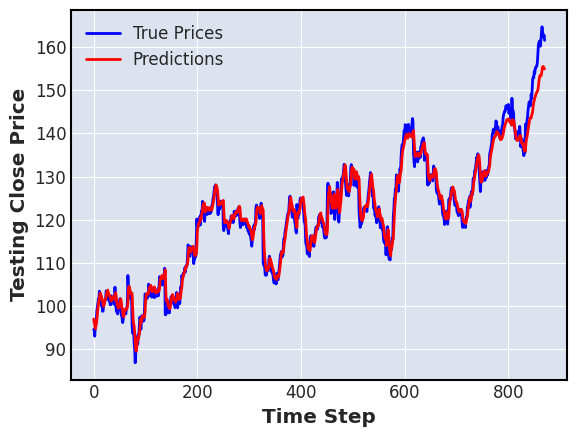

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 6s 32ms/step - loss: 0.0075 - mae: 0.0520 - mse: 0.0075 - mape: 19.7689 - val_loss: 8.4416e-04 - val_mae: 0.0237 - val_mse: 8.4416e-04 - val_mape: 7.3151
Epoch 2/10
82/82 [==============================] - 2s 23ms/step - loss: 3.2769e-04 - mae: 0.0140 - mse: 3.2769e-04 - mape: 5.6334 - val_loss: 4.8958e-04 - val_mae: 0.0179 - val_mse: 4.8958e-04 - val_mape: 5.5508
Epoch 3/10
82/82 [==============================] - 2s 23ms/step - loss: 1.7477e-04 - mae: 0.0102 - mse: 1.7477e-04 - mape: 4.0859 - val_loss: 2.4118e-04 - val_mae: 0.0119 - val_mse: 2.4118e-04 - val_mape: 3.6617
Epoch 4/10
82/82 [==============================] - 2s 24ms/step - loss: 5.8384e-05 - mae: 0.0058 - mse: 5.8384e-05 - mape: 2.2954 - val_loss: 9.1676e-05 - val_mae: 0.0068 - val_mse: 9.1676e-05 - val_mape: 2.1107
Epoch 5/10
82/82 [==============================] - 2s 25ms/step - loss: 2.6542e-

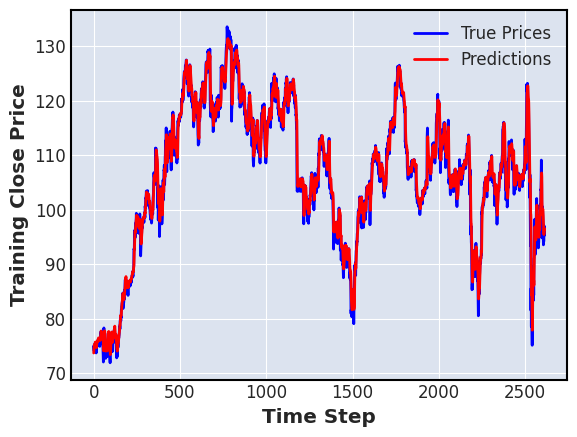

28/28 [==============================] - 0s 6ms/step


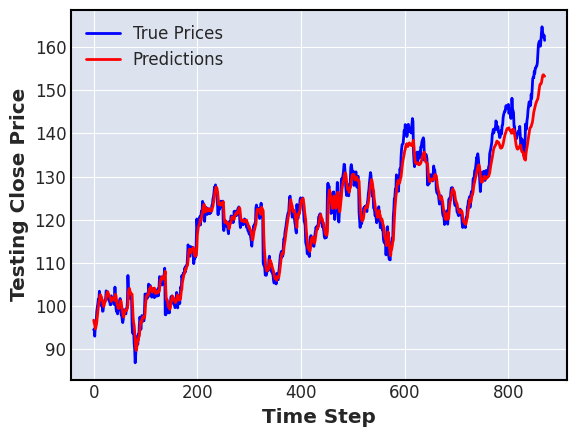

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 6s 33ms/step - loss: 0.0091 - mae: 0.0593 - mse: 0.0091 - mape: 22.5537 - val_loss: 9.1130e-04 - val_mae: 0.0246 - val_mse: 9.1130e-04 - val_mape: 7.6069
Epoch 2/10
82/82 [==============================] - 2s 25ms/step - loss: 4.0057e-04 - mae: 0.0155 - mse: 4.0057e-04 - mape: 6.2393 - val_loss: 7.7358e-04 - val_mae: 0.0227 - val_mse: 7.7358e-04 - val_mape: 6.9784
Epoch 3/10
82/82 [==============================] - 2s 26ms/step - loss: 2.9077e-04 - mae: 0.0131 - mse: 2.9077e-04 - mape: 5.3095 - val_loss: 5.7973e-04 - val_mae: 0.0196 - val_mse: 5.7973e-04 - val_mape: 6.0147
Epoch 4/10
82/82 [==============================] - 2s 24ms/step - loss: 1.7622e-04 - mae: 0.0103 - mse: 1.7622e-04 - mape: 4.1330 - val_loss: 2.6597e-04 - val_mae: 0.0131 - val_mse: 2.6597e-04 - val_mape: 4.0369
Epoch 5/10
82/82 [==============================] - 2s 23ms/step - loss: 8.4623e-

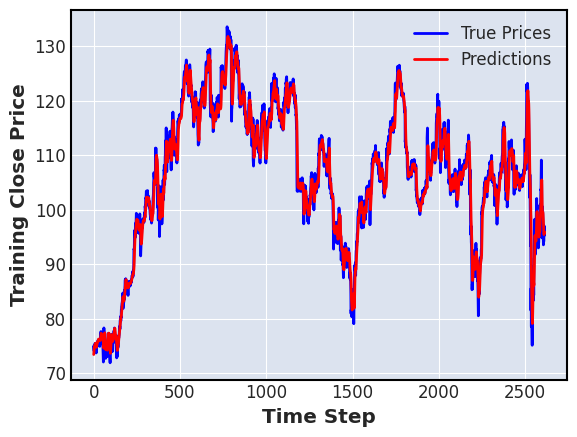

28/28 [==============================] - 0s 7ms/step


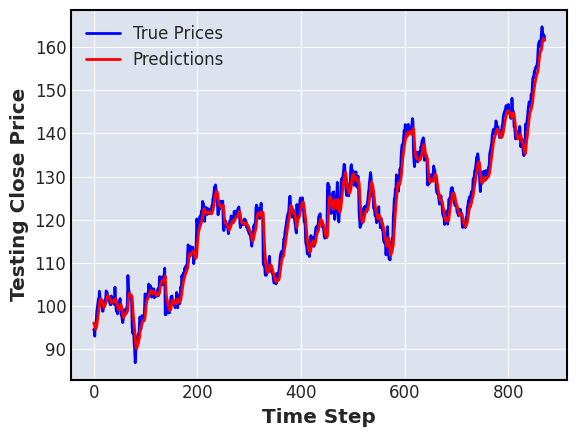

---------------------------------------------------------------
ticker_name :  KO Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 4s 54ms/step - loss: 3.4853e-04 - mae: 0.0125 - mse: 3.4853e-04 - mape: 27.1242 - val_loss: 2.8806e-04 - val_mae: 0.0164 - val_mse: 2.8806e-04 - val_mape: 23.4267
Epoch 2/10
28/28 [==============================] - 1s 29ms/step - loss: 4.0261e-05 - mae: 0.0052 - mse: 4.0261e-05 - mape: 11.8743 - val_loss: 1.4349e-04 - val_mae: 0.0115 - val_mse: 1.4349e-04 - val_mape: 16.2582
Epoch 3/10
28/28 [==============================] - 1s 33ms/step - loss: 2.4402e-05 - mae: 0.0040 - mse: 2.4402e-05 - mape: 9.1679 - val_loss: 1.0314e-04 - val_mae: 0.0098 - val_mse: 1.0314e-04 - val_mape: 13.9678
Epoch 4/10
28/28 [==============================] - 1s 28ms/step - loss: 1.2565e-05 - mae: 0.0029 - mse: 1.2565e-05 - mape: 6.5104 - val_loss: 3.4990e-05 - val_mae: 0.0057 - val_mse: 3.4990e-05 - val_mape: 8.0474
Epoch 5/10
2

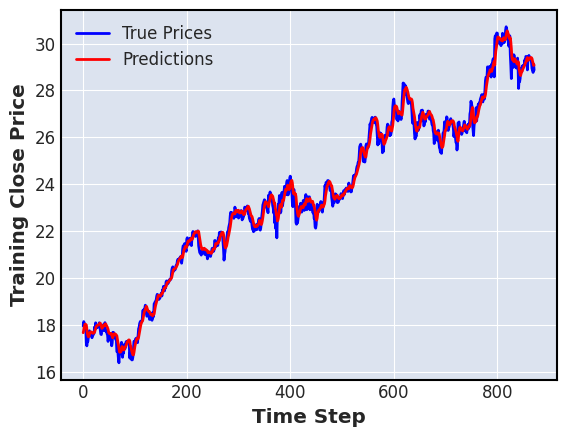

28/28 [==============================] - 0s 7ms/step


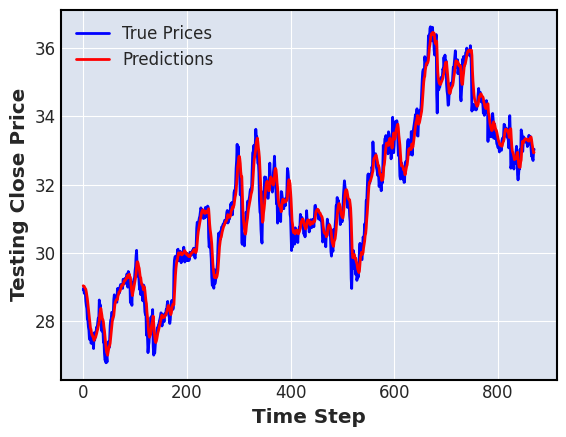

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 4s 51ms/step - loss: 3.6414e-04 - mae: 0.0140 - mse: 3.6414e-04 - mape: 30.5567 - val_loss: 1.9040e-04 - val_mae: 0.0129 - val_mse: 1.9040e-04 - val_mape: 18.1041
Epoch 2/10
28/28 [==============================] - 1s 33ms/step - loss: 6.1639e-05 - mae: 0.0065 - mse: 6.1639e-05 - mape: 14.6809 - val_loss: 2.5872e-04 - val_mae: 0.0154 - val_mse: 2.5872e-04 - val_mape: 21.8752
Epoch 3/10
28/28 [==============================] - 1s 30ms/step - loss: 4.9553e-05 - mae: 0.0058 - mse: 4.9553e-05 - mape: 13.2899 - val_loss: 2.1498e-04 - val_mae: 0.0141 - val_mse: 2.1498e-04 - val_mape: 20.0399
Epoch 4/10
28/28 [==============================] - 1s 32ms/step - loss: 3.4009e-05 - mae: 0.0048 - mse: 3.4009e-05 - mape: 10.9637 - val_loss: 1.3008e-04 - val_mae: 0.0109 - val_mse: 1.3008e-04 - val_mape: 15.5311
Epoch 5/10
28/28 [==============================] - 1s 32ms/step -

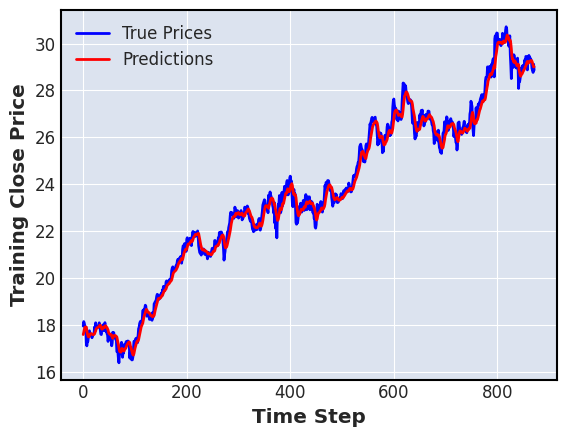

28/28 [==============================] - 0s 7ms/step


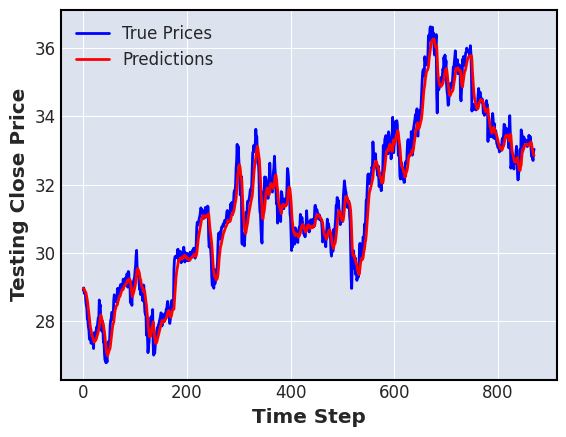

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 7s 58ms/step - loss: 4.4375e-04 - mae: 0.0158 - mse: 4.4375e-04 - mape: 33.7993 - val_loss: 3.1993e-04 - val_mae: 0.0171 - val_mse: 3.1993e-04 - val_mape: 24.2216
Epoch 2/10
28/28 [==============================] - 1s 35ms/step - loss: 7.2969e-05 - mae: 0.0071 - mse: 7.2969e-05 - mape: 16.3385 - val_loss: 3.0754e-04 - val_mae: 0.0168 - val_mse: 3.0754e-04 - val_mape: 23.8294
Epoch 3/10
28/28 [==============================] - 1s 35ms/step - loss: 6.0846e-05 - mae: 0.0065 - mse: 6.0846e-05 - mape: 14.7961 - val_loss: 2.7547e-04 - val_mae: 0.0159 - val_mse: 2.7547e-04 - val_mape: 22.5977
Epoch 4/10
28/28 [==============================] - 1s 33ms/step - loss: 5.2998e-05 - mae: 0.0060 - mse: 5.2998e-05 - mape: 13.5974 - val_loss: 1.9294e-04 - val_mae: 0.0132 - val_mse: 1.9294e-04 - val_mape: 18.7472
Epoch 5/10
28/28 [==============================] - 1s 35ms/step -

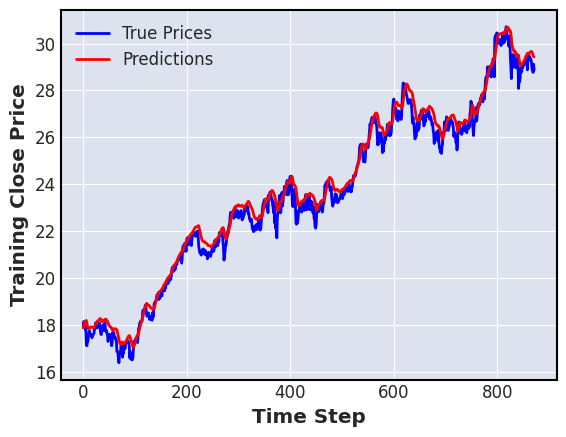

28/28 [==============================] - 0s 7ms/step


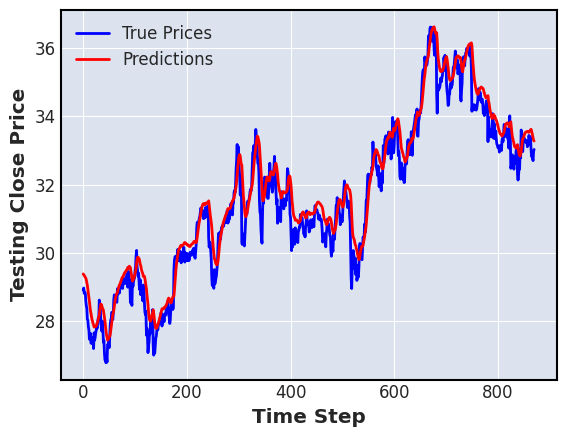

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 5s 38ms/step - loss: 3.2105e-04 - mae: 0.0116 - mse: 3.2105e-04 - mape: 21.7905 - val_loss: 3.1034e-04 - val_mae: 0.0165 - val_mse: 3.1034e-04 - val_mape: 17.3586
Epoch 2/10
55/55 [==============================] - 1s 27ms/step - loss: 1.8287e-05 - mae: 0.0033 - mse: 1.8287e-05 - mape: 6.5695 - val_loss: 4.1234e-05 - val_mae: 0.0054 - val_mse: 4.1234e-05 - val_mape: 5.5728
Epoch 3/10
55/55 [==============================] - 2s 28ms/step - loss: 1.0598e-06 - mae: 7.9825e-04 - mse: 1.0598e-06 - mape: 1.4289 - val_loss: 1.5695e-05 - val_mae: 0.0029 - val_mse: 1.5695e-05 - val_mape: 2.9305
Epoch 4/10
55/55 [==============================] - 1s 25ms/step - loss: 1.0006e-06 - mae: 7.6774e-04 - mse: 1.0006e-06 - mape: 1.3546 - val_loss: 1.7948e-05 - val_mae: 0.0032 - val_mse: 1.7948e-05 - val_mape: 3.2526
Epoch 5/10
55/55 [==============================]

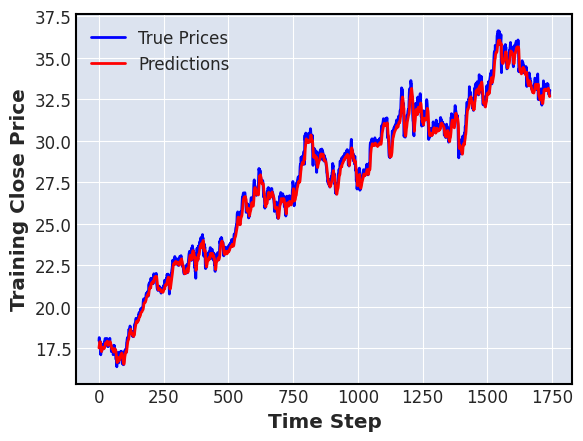

28/28 [==============================] - 0s 8ms/step


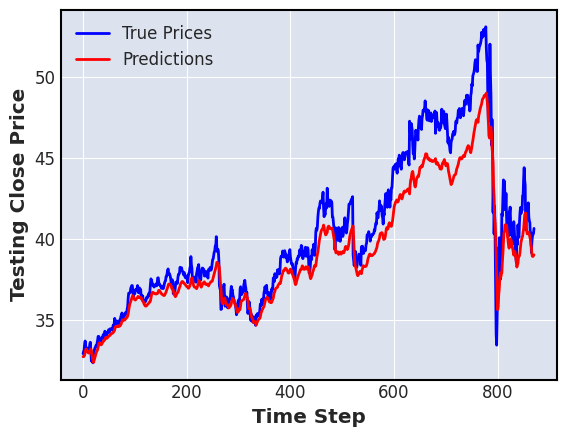

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 5s 36ms/step - loss: 3.5003e-04 - mae: 0.0135 - mse: 3.5003e-04 - mape: 25.5435 - val_loss: 8.0221e-04 - val_mae: 0.0269 - val_mse: 8.0221e-04 - val_mape: 28.4471
Epoch 2/10
55/55 [==============================] - 1s 25ms/step - loss: 6.8337e-05 - mae: 0.0068 - mse: 6.8337e-05 - mape: 13.4377 - val_loss: 1.8889e-04 - val_mae: 0.0126 - val_mse: 1.8889e-04 - val_mape: 13.1537
Epoch 3/10
55/55 [==============================] - 1s 25ms/step - loss: 1.3501e-05 - mae: 0.0027 - mse: 1.3501e-05 - mape: 5.2290 - val_loss: 5.1045e-06 - val_mae: 0.0013 - val_mse: 5.1045e-06 - val_mape: 1.4242
Epoch 4/10
55/55 [==============================] - 1s 25ms/step - loss: 1.1898e-06 - mae: 8.3390e-04 - mse: 1.1898e-06 - mape: 1.4711 - val_loss: 5.1046e-06 - val_mae: 0.0013 - val_mse: 5.1046e-06 - val_mape: 1.4371
Epoch 5/10
55/55 [==============================] - 1s 25ms/step -

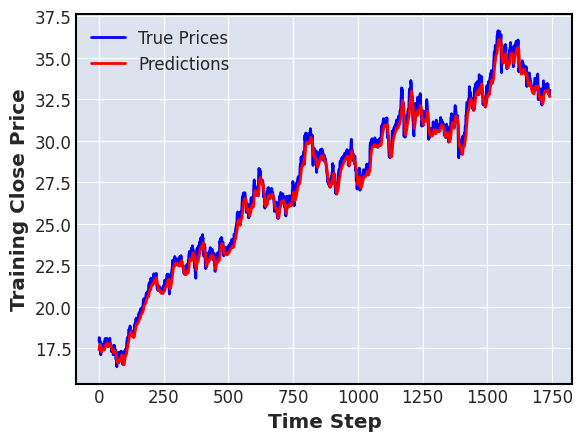

28/28 [==============================] - 0s 7ms/step


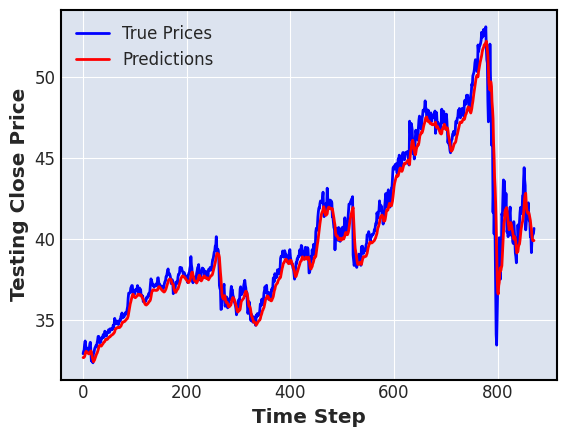

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 5s 37ms/step - loss: 4.4247e-04 - mae: 0.0151 - mse: 4.4247e-04 - mape: 27.9197 - val_loss: 7.1570e-04 - val_mae: 0.0249 - val_mse: 7.1570e-04 - val_mape: 26.1063
Epoch 2/10
55/55 [==============================] - 1s 27ms/step - loss: 9.5424e-05 - mae: 0.0081 - mse: 9.5424e-05 - mape: 16.1837 - val_loss: 6.0024e-04 - val_mae: 0.0232 - val_mse: 6.0024e-04 - val_mape: 24.5101
Epoch 3/10
55/55 [==============================] - 2s 27ms/step - loss: 4.2622e-05 - mae: 0.0053 - mse: 4.2622e-05 - mape: 10.4565 - val_loss: 4.3207e-05 - val_mae: 0.0058 - val_mse: 4.3207e-05 - val_mape: 6.0947
Epoch 4/10
55/55 [==============================] - 2s 28ms/step - loss: 2.6347e-06 - mae: 0.0012 - mse: 2.6347e-06 - mape: 2.2018 - val_loss: 6.0994e-06 - val_mae: 0.0015 - val_mse: 6.0994e-06 - val_mape: 1.5825
Epoch 5/10
55/55 [==============================] - 1s 26ms/step - lo

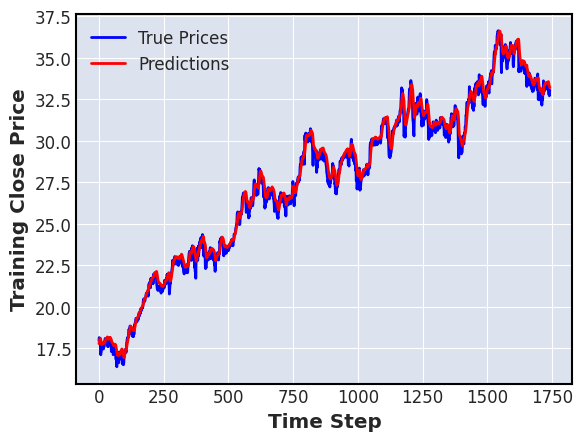

28/28 [==============================] - 0s 7ms/step


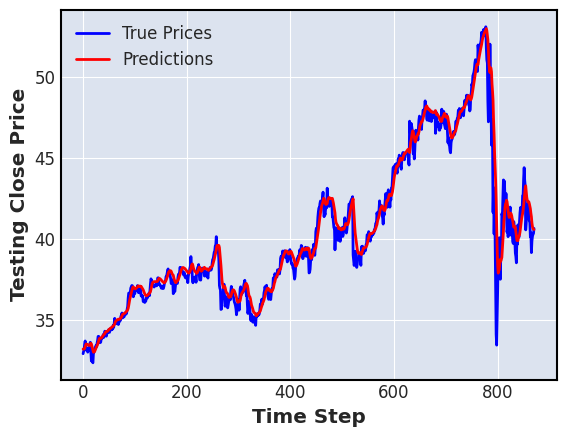

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 6s 31ms/step - loss: 3.8027e-04 - mae: 0.0111 - mse: 3.8027e-04 - mape: 17.4332 - val_loss: 4.4278e-05 - val_mae: 0.0058 - val_mse: 4.4278e-05 - val_mape: 4.2944
Epoch 2/10
82/82 [==============================] - 2s 24ms/step - loss: 2.2901e-06 - mae: 0.0010 - mse: 2.2901e-06 - mape: 1.5140 - val_loss: 1.5656e-05 - val_mae: 0.0033 - val_mse: 1.5656e-05 - val_mape: 2.4171
Epoch 3/10
82/82 [==============================] - 2s 25ms/step - loss: 2.0864e-06 - mae: 9.3559e-04 - mse: 2.0864e-06 - mape: 1.3550 - val_loss: 1.1808e-05 - val_mae: 0.0028 - val_mse: 1.1808e-05 - val_mape: 2.0617
Epoch 4/10
82/82 [==============================] - 2s 23ms/step - loss: 2.0471e-06 - mae: 9.5576e-04 - mse: 2.0471e-06 - mape: 1.3989 - val_loss: 1.0609e-05 - val_mae: 0.0026 - val_mse: 1.0609e-05 - val_mape: 1.9365
Epoch 5/10
82/82 [==============================] 

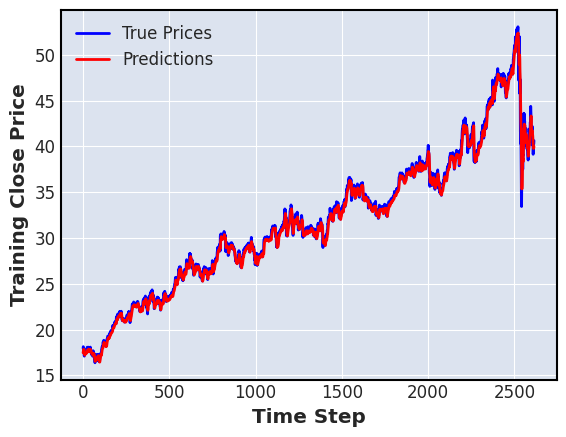

28/28 [==============================] - 0s 7ms/step


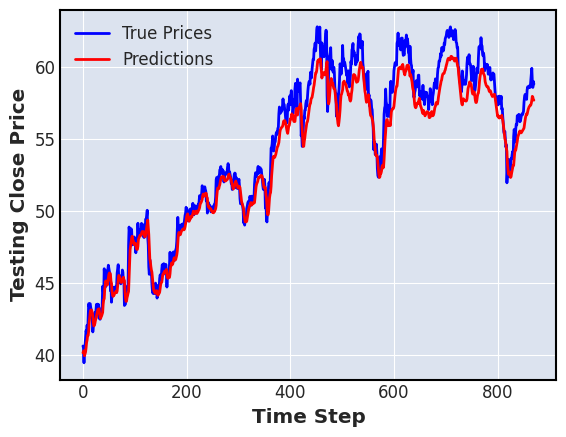

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 6s 32ms/step - loss: 4.6039e-04 - mae: 0.0150 - mse: 4.6039e-04 - mape: 24.0330 - val_loss: 5.0399e-04 - val_mae: 0.0216 - val_mse: 5.0399e-04 - val_mape: 16.2680
Epoch 2/10
82/82 [==============================] - 2s 27ms/step - loss: 1.3139e-05 - mae: 0.0023 - mse: 1.3139e-05 - mape: 3.6557 - val_loss: 5.1623e-06 - val_mae: 0.0017 - val_mse: 5.1623e-06 - val_mape: 1.3255
Epoch 3/10
82/82 [==============================] - 2s 25ms/step - loss: 2.5519e-06 - mae: 0.0010 - mse: 2.5519e-06 - mape: 1.5297 - val_loss: 5.9463e-06 - val_mae: 0.0019 - val_mse: 5.9463e-06 - val_mape: 1.4377
Epoch 4/10
82/82 [==============================] - 2s 25ms/step - loss: 2.4396e-06 - mae: 0.0010 - mse: 2.4396e-06 - mape: 1.5152 - val_loss: 8.0953e-06 - val_mae: 0.0023 - val_mse: 8.0953e-06 - val_mape: 1.7408
Epoch 5/10
82/82 [==============================] - 2s 24ms/step - loss:

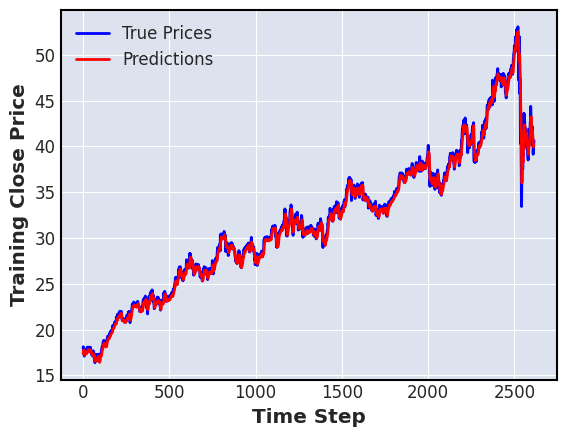

28/28 [==============================] - 0s 7ms/step


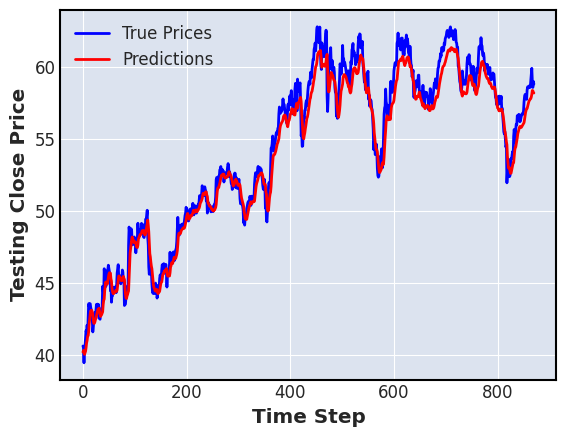

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 8s 32ms/step - loss: 5.6789e-04 - mae: 0.0171 - mse: 5.6789e-04 - mape: 27.3696 - val_loss: 0.0011 - val_mae: 0.0326 - val_mse: 0.0011 - val_mape: 24.6519
Epoch 2/10
82/82 [==============================] - 2s 25ms/step - loss: 3.9652e-05 - mae: 0.0041 - mse: 3.9652e-05 - mape: 6.7493 - val_loss: 6.8152e-06 - val_mae: 0.0020 - val_mse: 6.8152e-06 - val_mape: 1.5637
Epoch 3/10
82/82 [==============================] - 2s 25ms/step - loss: 3.0894e-06 - mae: 0.0012 - mse: 3.0894e-06 - mape: 1.7007 - val_loss: 6.1385e-06 - val_mae: 0.0019 - val_mse: 6.1385e-06 - val_mape: 1.4393
Epoch 4/10
82/82 [==============================] - 2s 26ms/step - loss: 2.8957e-06 - mae: 0.0011 - mse: 2.8957e-06 - mape: 1.6199 - val_loss: 6.7375e-06 - val_mae: 0.0020 - val_mse: 6.7375e-06 - val_mape: 1.5597
Epoch 5/10
82/82 [==============================] - 2s 25ms/step - loss: 2.9895e

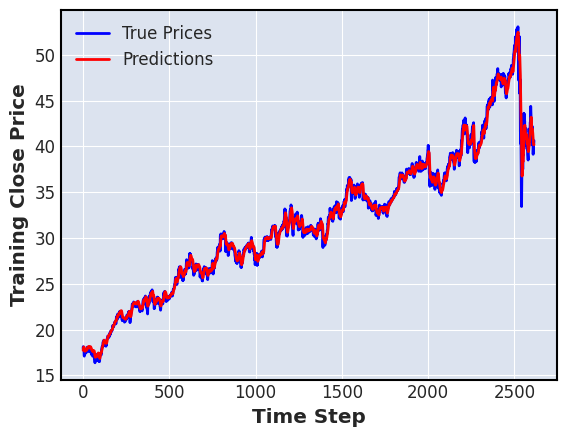

28/28 [==============================] - 0s 7ms/step


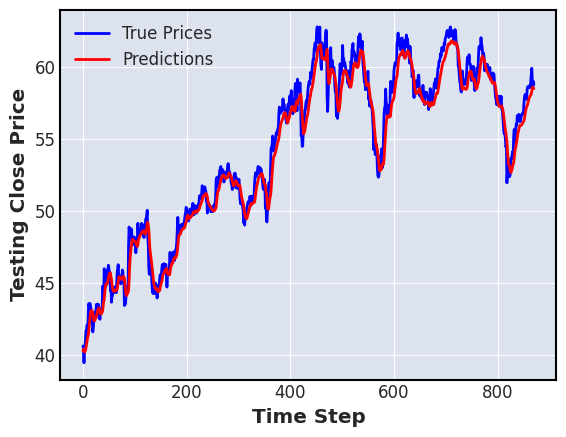

---------------------------------------------------------------
ticker_name :  AAPL Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 5s 57ms/step - loss: 9.1946e-05 - mae: 0.0072 - mse: 9.1946e-05 - mape: 61.5110 - val_loss: 2.5910e-04 - val_mae: 0.0151 - val_mse: 2.5910e-04 - val_mape: 31.0957
Epoch 2/10
28/28 [==============================] - 1s 32ms/step - loss: 1.2707e-05 - mae: 0.0027 - mse: 1.2707e-05 - mape: 23.8203 - val_loss: 4.4015e-06 - val_mae: 0.0017 - val_mse: 4.4015e-06 - val_mape: 3.3615
Epoch 3/10
28/28 [==============================] - 1s 36ms/step - loss: 1.2380e-06 - mae: 8.7320e-04 - mse: 1.2380e-06 - mape: 6.3924 - val_loss: 1.7562e-06 - val_mae: 9.8695e-04 - val_mse: 1.7562e-06 - val_mape: 2.2075
Epoch 4/10
28/28 [==============================] - 1s 35ms/step - loss: 9.9199e-07 - mae: 7.6952e-04 - mse: 9.9199e-07 - mape: 5.1983 - val_loss: 3.3953e-06 - val_mae: 0.0015 - val_mse: 3.3953e-06 - val_mape: 3.2141


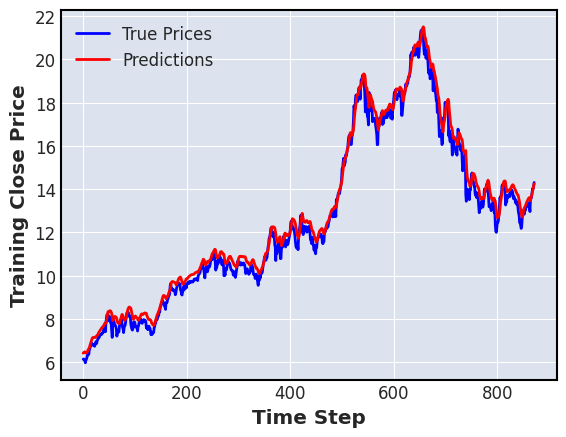

28/28 [==============================] - 0s 7ms/step


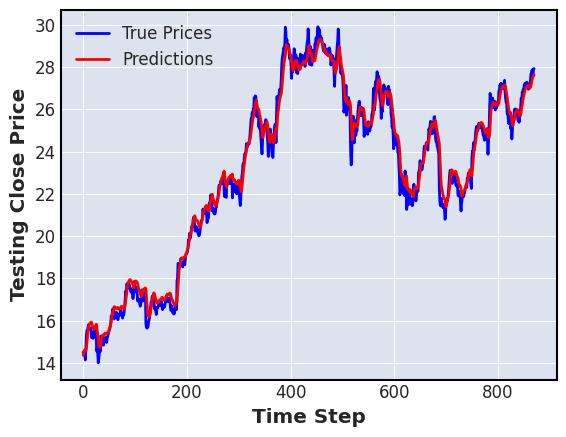

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 5s 53ms/step - loss: 1.0775e-04 - mae: 0.0081 - mse: 1.0775e-04 - mape: 67.8925 - val_loss: 4.4083e-04 - val_mae: 0.0198 - val_mse: 4.4083e-04 - val_mape: 41.1647
Epoch 2/10
28/28 [==============================] - 1s 35ms/step - loss: 2.6029e-05 - mae: 0.0041 - mse: 2.6029e-05 - mape: 37.4528 - val_loss: 1.7908e-05 - val_mae: 0.0036 - val_mse: 1.7908e-05 - val_mape: 7.0592
Epoch 3/10
28/28 [==============================] - 1s 32ms/step - loss: 2.3905e-06 - mae: 0.0012 - mse: 2.3905e-06 - mape: 8.9640 - val_loss: 2.2733e-06 - val_mae: 0.0011 - val_mse: 2.2733e-06 - val_mape: 2.4419
Epoch 4/10
28/28 [==============================] - 1s 34ms/step - loss: 1.0374e-06 - mae: 7.8524e-04 - mse: 1.0374e-06 - mape: 5.3629 - val_loss: 1.9018e-06 - val_mae: 0.0011 - val_mse: 1.9018e-06 - val_mape: 2.3106
Epoch 5/10
28/28 [==============================] - 1s 30ms/step - 

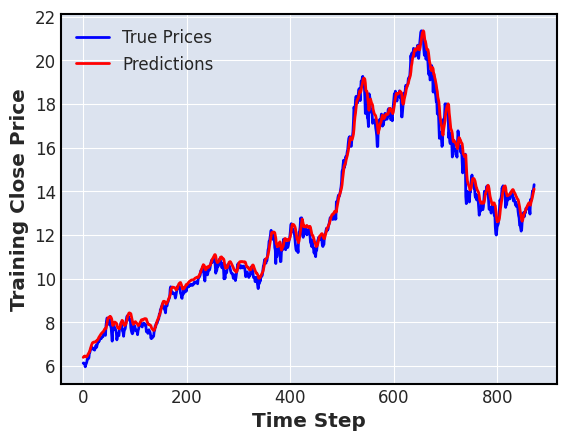

28/28 [==============================] - 0s 6ms/step


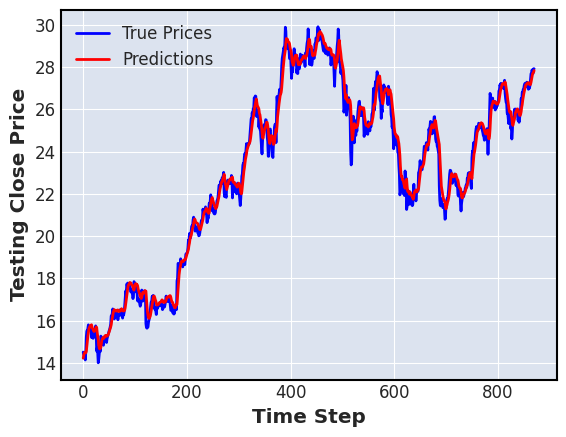

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 5s 55ms/step - loss: 1.3226e-04 - mae: 0.0092 - mse: 1.3226e-04 - mape: 81.1578 - val_loss: 6.5673e-04 - val_mae: 0.0237 - val_mse: 6.5673e-04 - val_mape: 48.4273
Epoch 2/10
28/28 [==============================] - 1s 31ms/step - loss: 6.2256e-05 - mae: 0.0065 - mse: 6.2256e-05 - mape: 58.1468 - val_loss: 2.7463e-04 - val_mae: 0.0151 - val_mse: 2.7463e-04 - val_mape: 30.4494
Epoch 3/10
28/28 [==============================] - 1s 31ms/step - loss: 1.8657e-05 - mae: 0.0034 - mse: 1.8657e-05 - mape: 30.2940 - val_loss: 2.1299e-05 - val_mae: 0.0037 - val_mse: 2.1299e-05 - val_mape: 7.0679
Epoch 4/10
28/28 [==============================] - 1s 34ms/step - loss: 1.7939e-06 - mae: 0.0010 - mse: 1.7939e-06 - mape: 7.4289 - val_loss: 2.2554e-05 - val_mae: 0.0037 - val_mse: 2.2554e-05 - val_mape: 7.0610
Epoch 5/10
28/28 [==============================] - 1s 33ms/step - lo

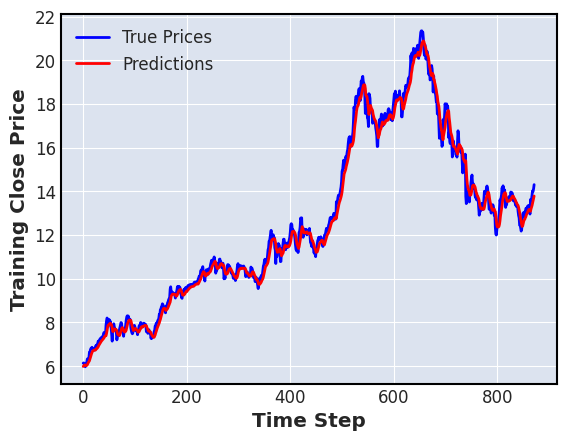

28/28 [==============================] - 0s 7ms/step


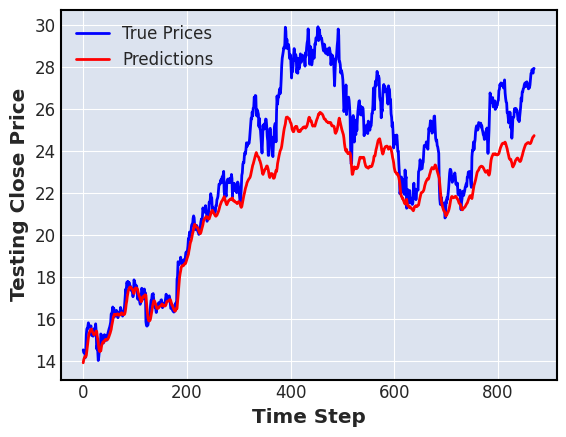

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 5s 37ms/step - loss: 1.3471e-04 - mae: 0.0073 - mse: 1.3471e-04 - mape: 40.2990 - val_loss: 5.5231e-05 - val_mae: 0.0048 - val_mse: 5.5231e-05 - val_mape: 3.7042
Epoch 2/10
55/55 [==============================] - 1s 24ms/step - loss: 1.6196e-06 - mae: 9.6539e-04 - mse: 1.6196e-06 - mape: 4.4487 - val_loss: 6.7235e-05 - val_mae: 0.0045 - val_mse: 6.7235e-05 - val_mape: 3.1101
Epoch 3/10
55/55 [==============================] - 1s 25ms/step - loss: 1.3694e-06 - mae: 8.6911e-04 - mse: 1.3694e-06 - mape: 3.6431 - val_loss: 6.7877e-05 - val_mae: 0.0046 - val_mse: 6.7877e-05 - val_mape: 3.1851
Epoch 4/10
55/55 [==============================] - 1s 27ms/step - loss: 1.3655e-06 - mae: 8.7834e-04 - mse: 1.3655e-06 - mape: 3.6278 - val_loss: 7.1886e-05 - val_mae: 0.0047 - val_mse: 7.1886e-05 - val_mape: 3.3038
Epoch 5/10
55/55 [============================

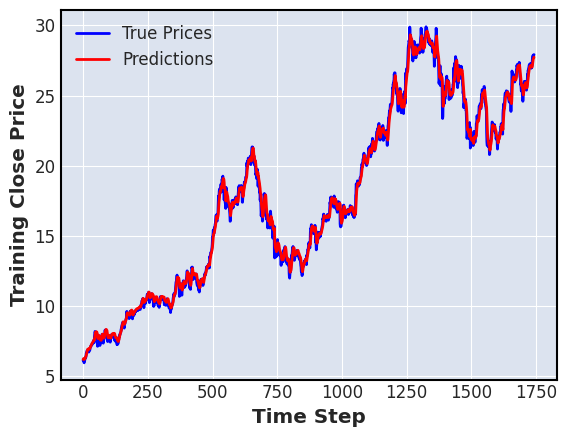

28/28 [==============================] - 0s 7ms/step


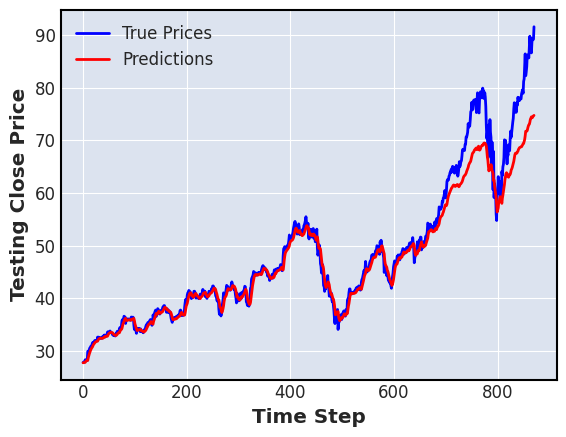

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 5s 37ms/step - loss: 1.6804e-04 - mae: 0.0095 - mse: 1.6804e-04 - mape: 58.3685 - val_loss: 2.2228e-05 - val_mae: 0.0034 - val_mse: 2.2228e-05 - val_mape: 2.9594
Epoch 2/10
55/55 [==============================] - 1s 27ms/step - loss: 2.8881e-06 - mae: 0.0013 - mse: 2.8881e-06 - mape: 6.3013 - val_loss: 2.5254e-05 - val_mae: 0.0033 - val_mse: 2.5254e-05 - val_mape: 2.5226
Epoch 3/10
55/55 [==============================] - 1s 24ms/step - loss: 1.7397e-06 - mae: 0.0010 - mse: 1.7397e-06 - mape: 4.3465 - val_loss: 2.7542e-05 - val_mae: 0.0034 - val_mse: 2.7542e-05 - val_mape: 2.5781
Epoch 4/10
55/55 [==============================] - 1s 25ms/step - loss: 1.5673e-06 - mae: 9.5138e-04 - mse: 1.5673e-06 - mape: 4.0312 - val_loss: 2.9852e-05 - val_mae: 0.0036 - val_mse: 2.9852e-05 - val_mape: 2.7737
Epoch 5/10
55/55 [==============================] - 2s 27ms/step - lo

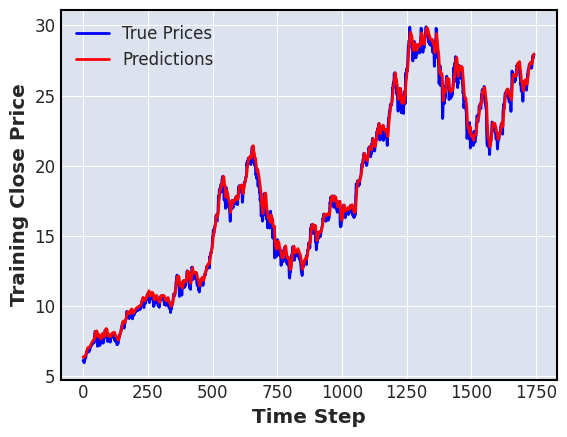

28/28 [==============================] - 0s 7ms/step


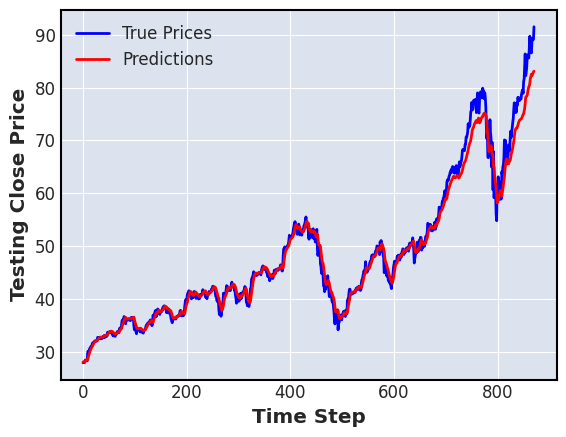

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 7s 38ms/step - loss: 2.3088e-04 - mae: 0.0121 - mse: 2.3088e-04 - mape: 72.2287 - val_loss: 8.3443e-04 - val_mae: 0.0252 - val_mse: 8.3443e-04 - val_mape: 20.7961
Epoch 2/10
55/55 [==============================] - 1s 25ms/step - loss: 5.4990e-06 - mae: 0.0018 - mse: 5.4990e-06 - mape: 9.7081 - val_loss: 8.5866e-05 - val_mae: 0.0071 - val_mse: 8.5866e-05 - val_mape: 5.4982
Epoch 3/10
55/55 [==============================] - 1s 27ms/step - loss: 2.1145e-06 - mae: 0.0011 - mse: 2.1145e-06 - mape: 5.3974 - val_loss: 1.2529e-04 - val_mae: 0.0089 - val_mse: 1.2529e-04 - val_mape: 7.0001
Epoch 4/10
55/55 [==============================] - 1s 25ms/step - loss: 3.3976e-06 - mae: 0.0015 - mse: 3.3976e-06 - mape: 6.8608 - val_loss: 1.0128e-04 - val_mae: 0.0076 - val_mse: 1.0128e-04 - val_mape: 5.7974
Epoch 5/10
55/55 [==============================] - 2s 28ms/step - loss:

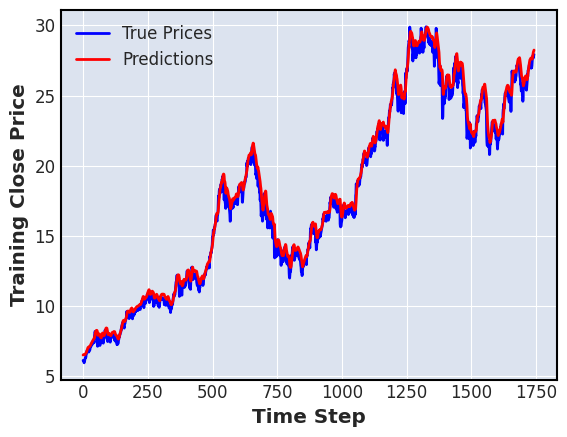

28/28 [==============================] - 0s 7ms/step


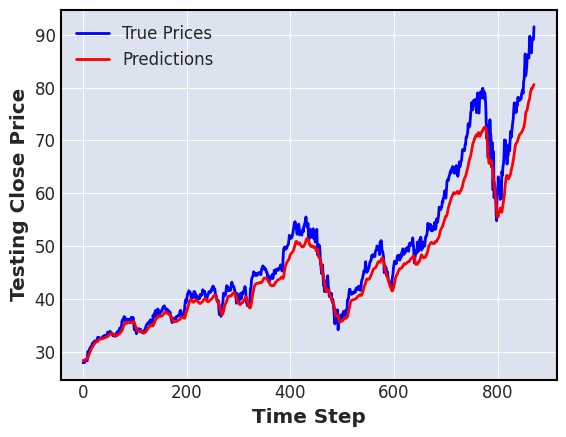

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 6s 31ms/step - loss: 5.7910e-04 - mae: 0.0111 - mse: 5.7910e-04 - mape: 35.3311 - val_loss: 5.9734e-04 - val_mae: 0.0199 - val_mse: 5.9734e-04 - val_mape: 4.8899
Epoch 2/10
82/82 [==============================] - 2s 25ms/step - loss: 5.3082e-06 - mae: 0.0015 - mse: 5.3082e-06 - mape: 3.8963 - val_loss: 5.6313e-04 - val_mae: 0.0191 - val_mse: 5.6313e-04 - val_mape: 4.6815
Epoch 3/10
82/82 [==============================] - 2s 24ms/step - loss: 5.4037e-06 - mae: 0.0015 - mse: 5.4037e-06 - mape: 3.8427 - val_loss: 5.8728e-04 - val_mae: 0.0195 - val_mse: 5.8728e-04 - val_mape: 4.7744
Epoch 4/10
82/82 [==============================] - 2s 24ms/step - loss: 5.1288e-06 - mae: 0.0015 - mse: 5.1288e-06 - mape: 3.9403 - val_loss: 6.7809e-04 - val_mae: 0.0214 - val_mse: 6.7809e-04 - val_mape: 5.2492
Epoch 5/10
82/82 [==============================] - 2s 24m

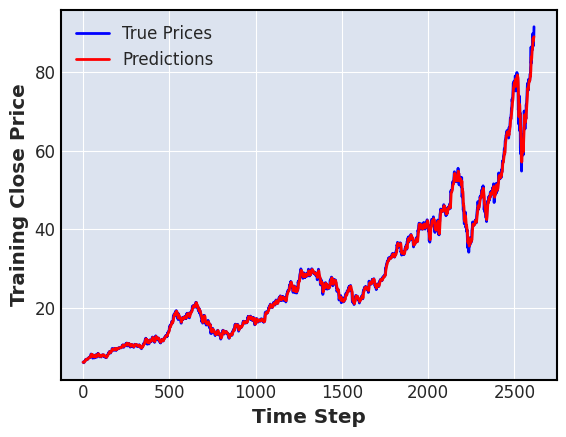

28/28 [==============================] - 0s 7ms/step


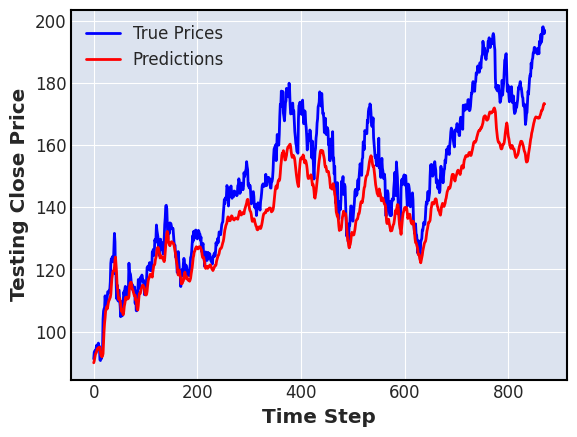

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 6s 33ms/step - loss: 5.9897e-04 - mae: 0.0135 - mse: 5.9897e-04 - mape: 49.2081 - val_loss: 5.2923e-04 - val_mae: 0.0195 - val_mse: 5.2923e-04 - val_mape: 4.8573
Epoch 2/10
82/82 [==============================] - 2s 26ms/step - loss: 6.0631e-06 - mae: 0.0016 - mse: 6.0631e-06 - mape: 4.2562 - val_loss: 7.4844e-04 - val_mae: 0.0237 - val_mse: 7.4844e-04 - val_mape: 5.9280
Epoch 3/10
82/82 [==============================] - 2s 24ms/step - loss: 5.6452e-06 - mae: 0.0015 - mse: 5.6452e-06 - mape: 4.0700 - val_loss: 7.5351e-04 - val_mae: 0.0238 - val_mse: 7.5351e-04 - val_mape: 5.9439
Epoch 4/10
82/82 [==============================] - 2s 25ms/step - loss: 6.2469e-06 - mae: 0.0017 - mse: 6.2469e-06 - mape: 4.8389 - val_loss: 7.4117e-04 - val_mae: 0.0236 - val_mse: 7.4117e-04 - val_mape: 5.8795
Epoch 5/10
82/82 [==============================] - 2s 25ms/step - loss: 

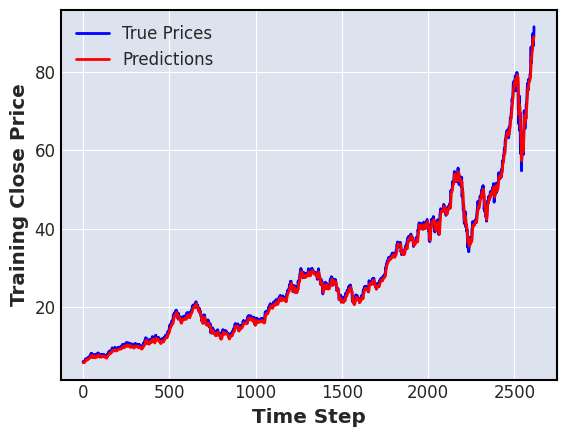

28/28 [==============================] - 0s 7ms/step


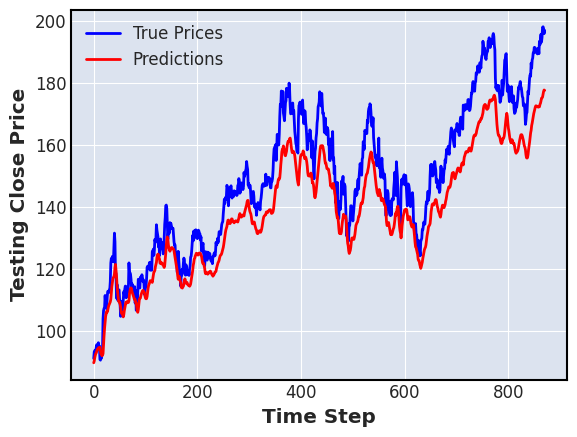

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 6s 31ms/step - loss: 7.7364e-04 - mae: 0.0167 - mse: 7.7364e-04 - mape: 66.3325 - val_loss: 2.0116e-04 - val_mae: 0.0117 - val_mse: 2.0116e-04 - val_mape: 3.0574
Epoch 2/10
82/82 [==============================] - 2s 25ms/step - loss: 8.8461e-06 - mae: 0.0021 - mse: 8.8461e-06 - mape: 9.1691 - val_loss: 2.0213e-04 - val_mae: 0.0117 - val_mse: 2.0213e-04 - val_mape: 3.0583
Epoch 3/10
82/82 [==============================] - 2s 24ms/step - loss: 6.8426e-06 - mae: 0.0017 - mse: 6.8426e-06 - mape: 5.3854 - val_loss: 1.2725e-04 - val_mae: 0.0091 - val_mse: 1.2725e-04 - val_mape: 2.4289
Epoch 4/10
82/82 [==============================] - 2s 26ms/step - loss: 6.7193e-06 - mae: 0.0017 - mse: 6.7193e-06 - mape: 4.7015 - val_loss: 1.6229e-04 - val_mae: 0.0104 - val_mse: 1.6229e-04 - val_mape: 2.7248
Epoch 5/10
82/82 [==============================] - 2s 27ms/step - loss: 

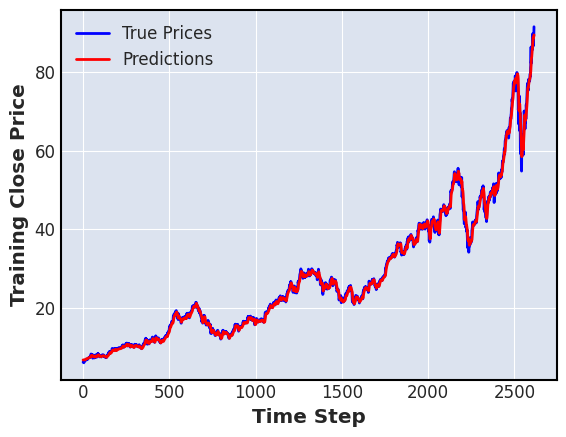

28/28 [==============================] - 0s 6ms/step


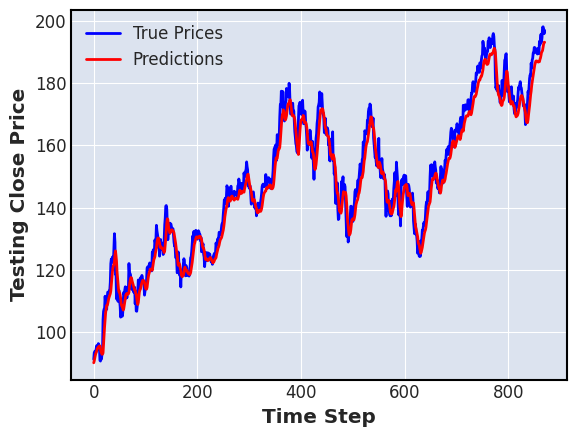

---------------------------------------------------------------
ticker_name :  MSFT Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 4s 53ms/step - loss: 2.8028e-04 - mae: 0.0110 - mse: 2.8028e-04 - mape: 24.6665 - val_loss: 0.0018 - val_mae: 0.0391 - val_mse: 0.0018 - val_mape: 39.8897
Epoch 2/10
28/28 [==============================] - 1s 29ms/step - loss: 2.6933e-05 - mae: 0.0042 - mse: 2.6933e-05 - mape: 9.4778 - val_loss: 0.0012 - val_mae: 0.0318 - val_mse: 0.0012 - val_mape: 32.1912
Epoch 3/10
28/28 [==============================] - 1s 29ms/step - loss: 1.7170e-05 - mae: 0.0033 - mse: 1.7170e-05 - mape: 7.3598 - val_loss: 8.2355e-04 - val_mae: 0.0262 - val_mse: 8.2355e-04 - val_mape: 26.2817
Epoch 4/10
28/28 [==============================] - 1s 33ms/step - loss: 1.1778e-05 - mae: 0.0027 - mse: 1.1778e-05 - mape: 6.1265 - val_loss: 5.6181e-04 - val_mae: 0.0216 - val_mse: 5.6181e-04 - val_mape: 21.6408
Epoch 5/10
28/28 [========

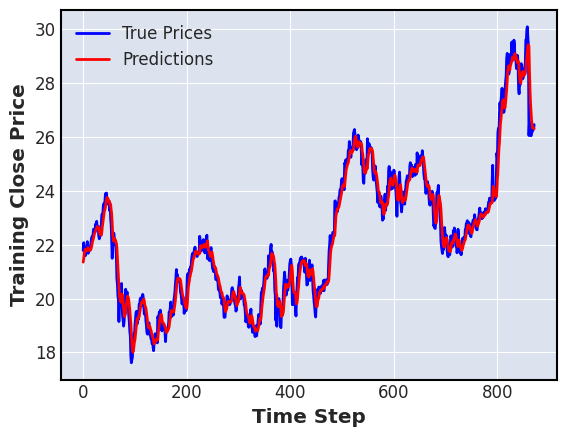

28/28 [==============================] - 0s 7ms/step


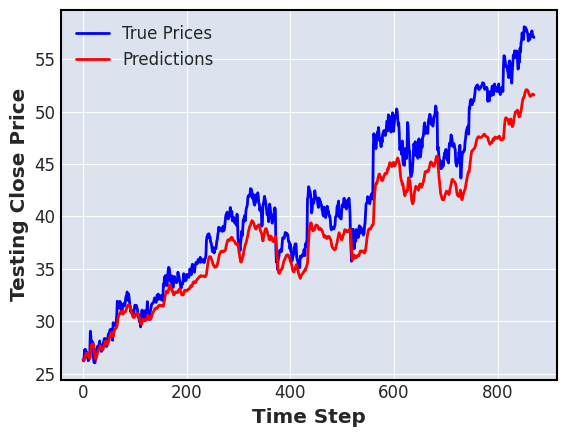

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 4s 58ms/step - loss: 2.9124e-04 - mae: 0.0124 - mse: 2.9124e-04 - mape: 27.8808 - val_loss: 0.0017 - val_mae: 0.0371 - val_mse: 0.0017 - val_mape: 36.9848
Epoch 2/10
28/28 [==============================] - 1s 35ms/step - loss: 3.9647e-05 - mae: 0.0050 - mse: 3.9647e-05 - mape: 11.1124 - val_loss: 0.0018 - val_mae: 0.0389 - val_mse: 0.0018 - val_mape: 39.1676
Epoch 3/10
28/28 [==============================] - 1s 34ms/step - loss: 3.2079e-05 - mae: 0.0046 - mse: 3.2079e-05 - mape: 10.3283 - val_loss: 0.0018 - val_mae: 0.0389 - val_mse: 0.0018 - val_mape: 39.4797
Epoch 4/10
28/28 [==============================] - 1s 35ms/step - loss: 2.6750e-05 - mae: 0.0042 - mse: 2.6750e-05 - mape: 9.3206 - val_loss: 0.0014 - val_mae: 0.0340 - val_mse: 0.0014 - val_mape: 34.3210
Epoch 5/10
28/28 [==============================] - 1s 34ms/step - loss: 2.3541e-05 - mae: 0.0039 -

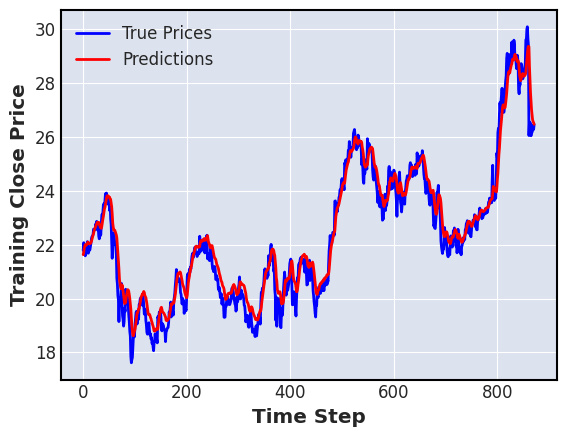

28/28 [==============================] - 0s 7ms/step


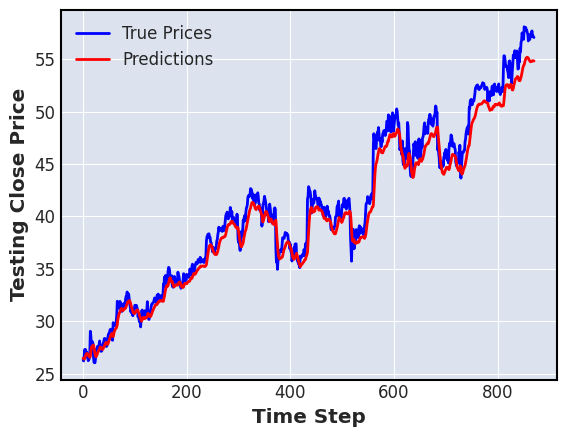

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 6s 53ms/step - loss: 3.5131e-04 - mae: 0.0138 - mse: 3.5131e-04 - mape: 31.0598 - val_loss: 0.0020 - val_mae: 0.0407 - val_mse: 0.0020 - val_mape: 40.6497
Epoch 2/10
28/28 [==============================] - 1s 28ms/step - loss: 4.5272e-05 - mae: 0.0055 - mse: 4.5272e-05 - mape: 12.3148 - val_loss: 0.0024 - val_mae: 0.0456 - val_mse: 0.0024 - val_mape: 46.2897
Epoch 3/10
28/28 [==============================] - 1s 28ms/step - loss: 3.7379e-05 - mae: 0.0049 - mse: 3.7379e-05 - mape: 11.1333 - val_loss: 0.0021 - val_mae: 0.0426 - val_mse: 0.0021 - val_mape: 43.1573
Epoch 4/10
28/28 [==============================] - 1s 33ms/step - loss: 3.2665e-05 - mae: 0.0046 - mse: 3.2665e-05 - mape: 10.4071 - val_loss: 0.0017 - val_mae: 0.0385 - val_mse: 0.0017 - val_mape: 38.9494
Epoch 5/10
28/28 [==============================] - 1s 34ms/step - loss: 2.7348e-05 - mae: 0.0042 

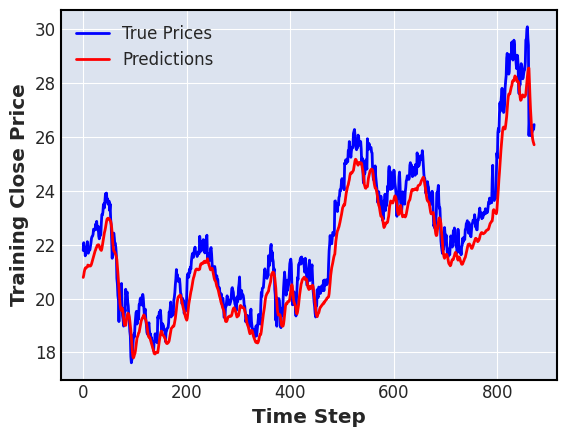

28/28 [==============================] - 0s 7ms/step


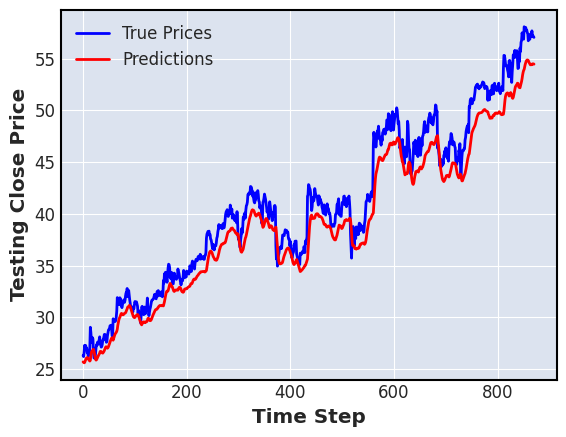

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 5s 37ms/step - loss: 6.1156e-04 - mae: 0.0156 - mse: 6.1156e-04 - mape: 24.3708 - val_loss: 0.0015 - val_mae: 0.0281 - val_mse: 0.0015 - val_mape: 8.5847
Epoch 2/10
55/55 [==============================] - 1s 25ms/step - loss: 4.7509e-06 - mae: 0.0016 - mse: 4.7509e-06 - mape: 2.5499 - val_loss: 0.0013 - val_mae: 0.0243 - val_mse: 0.0013 - val_mape: 7.1826
Epoch 3/10
55/55 [==============================] - 1s 24ms/step - loss: 3.1471e-06 - mae: 0.0012 - mse: 3.1471e-06 - mape: 1.9055 - val_loss: 0.0012 - val_mae: 0.0233 - val_mse: 0.0012 - val_mape: 6.8206
Epoch 4/10
55/55 [==============================] - 1s 25ms/step - loss: 4.3281e-06 - mae: 0.0016 - mse: 4.3281e-06 - mape: 2.4628 - val_loss: 0.0013 - val_mae: 0.0247 - val_mse: 0.0013 - val_mape: 7.3219
Epoch 5/10
55/55 [==============================] - 2s 28ms/step - loss: 4.1057e-06 - mae:

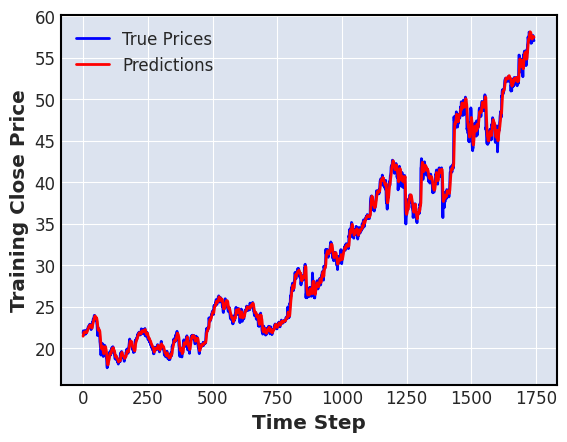

28/28 [==============================] - 0s 7ms/step


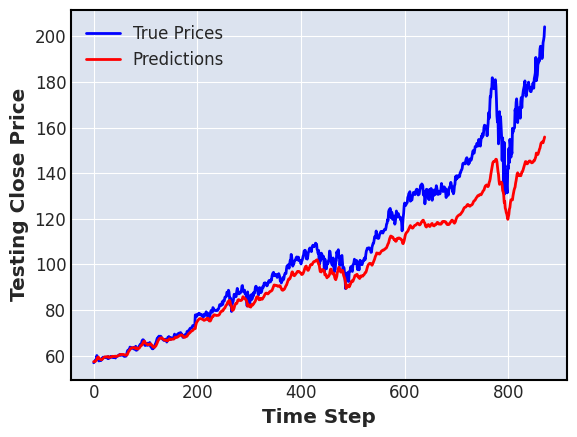

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 5s 36ms/step - loss: 7.3752e-04 - mae: 0.0208 - mse: 7.3752e-04 - mape: 33.9417 - val_loss: 0.0079 - val_mae: 0.0801 - val_mse: 0.0079 - val_mape: 28.5920
Epoch 2/10
55/55 [==============================] - 1s 24ms/step - loss: 2.4457e-05 - mae: 0.0033 - mse: 2.4457e-05 - mape: 5.1814 - val_loss: 4.3056e-04 - val_mae: 0.0143 - val_mse: 4.3056e-04 - val_mape: 4.2871
Epoch 3/10
55/55 [==============================] - 1s 27ms/step - loss: 3.7190e-06 - mae: 0.0013 - mse: 3.7190e-06 - mape: 2.0694 - val_loss: 3.7718e-04 - val_mae: 0.0131 - val_mse: 3.7718e-04 - val_mape: 3.9035
Epoch 4/10
55/55 [==============================] - 1s 25ms/step - loss: 3.6969e-06 - mae: 0.0014 - mse: 3.6969e-06 - mape: 2.0808 - val_loss: 3.3829e-04 - val_mae: 0.0122 - val_mse: 3.3829e-04 - val_mape: 3.6288
Epoch 5/10
55/55 [==============================] - 1s 27ms/step - loss: 3.9928e

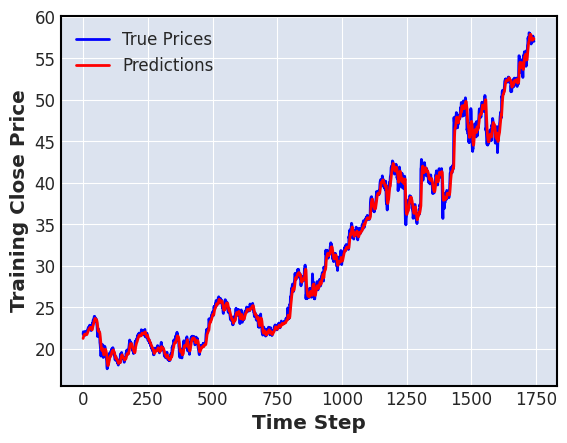

28/28 [==============================] - 0s 7ms/step


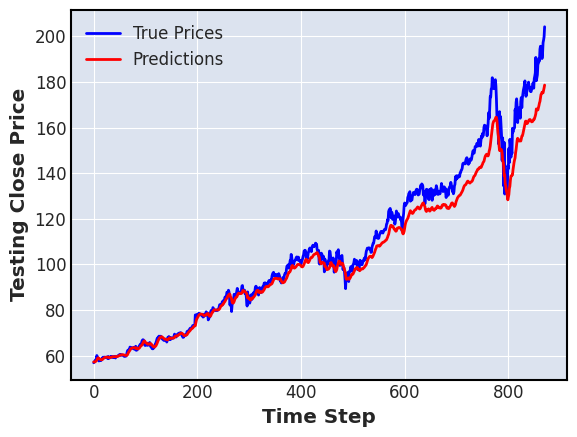

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 5s 37ms/step - loss: 0.0010 - mae: 0.0249 - mse: 0.0010 - mape: 39.8926 - val_loss: 0.0179 - val_mae: 0.1206 - val_mse: 0.0179 - val_mape: 42.8617
Epoch 2/10
55/55 [==============================] - 1s 24ms/step - loss: 1.0724e-04 - mae: 0.0076 - mse: 1.0724e-04 - mape: 12.7321 - val_loss: 1.0008e-04 - val_mae: 0.0072 - val_mse: 1.0008e-04 - val_mape: 2.7864
Epoch 3/10
55/55 [==============================] - 1s 24ms/step - loss: 4.5665e-06 - mae: 0.0015 - mse: 4.5665e-06 - mape: 2.3206 - val_loss: 1.2920e-04 - val_mae: 0.0080 - val_mse: 1.2920e-04 - val_mape: 2.5888
Epoch 4/10
55/55 [==============================] - 1s 24ms/step - loss: 4.2536e-06 - mae: 0.0014 - mse: 4.2536e-06 - mape: 2.2093 - val_loss: 7.8807e-05 - val_mae: 0.0058 - val_mse: 7.8807e-05 - val_mape: 1.9393
Epoch 5/10
55/55 [==============================] - 1s 27ms/step - loss: 4.5075e-06 - m

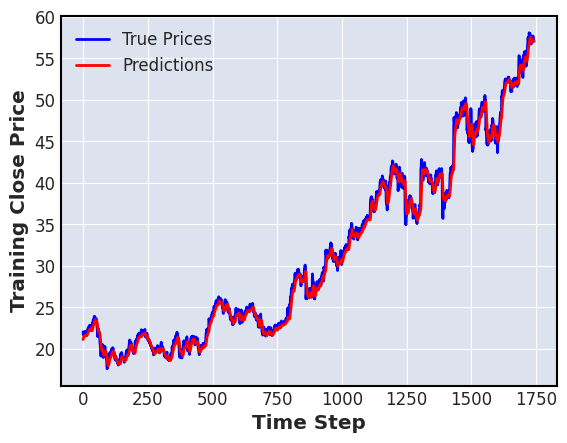

28/28 [==============================] - 0s 7ms/step


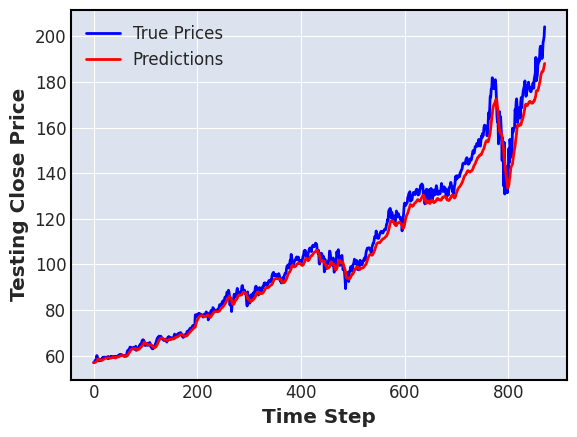

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 6s 32ms/step - loss: 0.0042 - mae: 0.0292 - mse: 0.0042 - mape: 26.8848 - val_loss: 4.3668e-04 - val_mae: 0.0163 - val_mse: 4.3668e-04 - val_mape: 2.2485
Epoch 2/10
82/82 [==============================] - 2s 26ms/step - loss: 1.9194e-05 - mae: 0.0025 - mse: 1.9194e-05 - mape: 2.2770 - val_loss: 5.5425e-04 - val_mae: 0.0186 - val_mse: 5.5425e-04 - val_mape: 2.5126
Epoch 3/10
82/82 [==============================] - 2s 26ms/step - loss: 1.9903e-05 - mae: 0.0028 - mse: 1.9903e-05 - mape: 2.5566 - val_loss: 6.4603e-04 - val_mae: 0.0201 - val_mse: 6.4603e-04 - val_mape: 2.7002
Epoch 4/10
82/82 [==============================] - 2s 26ms/step - loss: 1.9163e-05 - mae: 0.0026 - mse: 1.9163e-05 - mape: 2.3871 - val_loss: 5.2789e-04 - val_mae: 0.0180 - val_mse: 5.2789e-04 - val_mape: 2.4338
Epoch 5/10
82/82 [==============================] - 2s 25ms/step -

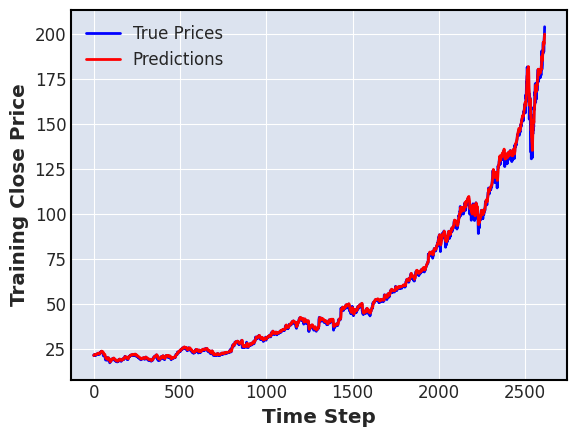

28/28 [==============================] - 0s 7ms/step


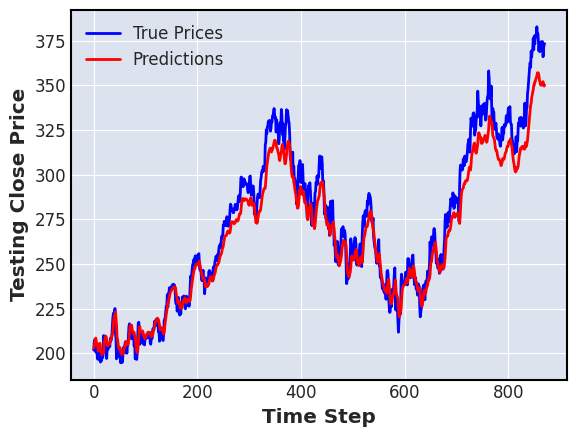

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 5s 30ms/step - loss: 0.0039 - mae: 0.0339 - mse: 0.0039 - mape: 34.9187 - val_loss: 8.7978e-04 - val_mae: 0.0248 - val_mse: 8.7978e-04 - val_mape: 3.6037
Epoch 2/10
82/82 [==============================] - 2s 23ms/step - loss: 2.2565e-05 - mae: 0.0028 - mse: 2.2565e-05 - mape: 2.5748 - val_loss: 3.3571e-04 - val_mae: 0.0141 - val_mse: 3.3571e-04 - val_mape: 2.0674
Epoch 3/10
82/82 [==============================] - 2s 23ms/step - loss: 1.9757e-05 - mae: 0.0025 - mse: 1.9757e-05 - mape: 2.2205 - val_loss: 3.1389e-04 - val_mae: 0.0138 - val_mse: 3.1389e-04 - val_mape: 2.0014
Epoch 4/10
82/82 [==============================] - 2s 25ms/step - loss: 2.1352e-05 - mae: 0.0028 - mse: 2.1352e-05 - mape: 2.5158 - val_loss: 3.4453e-04 - val_mae: 0.0145 - val_mse: 3.4453e-04 - val_mape: 2.1421
Epoch 5/10
82/82 [==============================] - 2s 23ms/step - loss: 2.1059e-

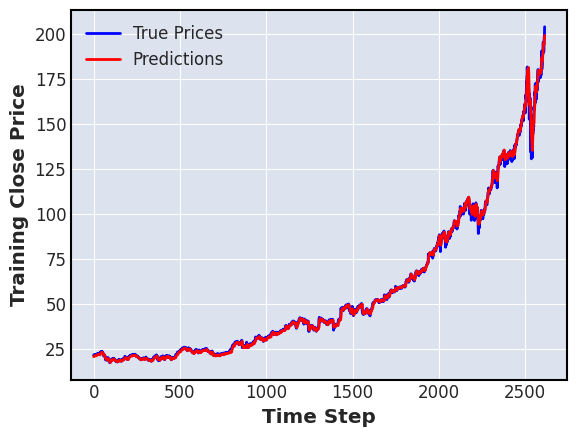

28/28 [==============================] - 0s 6ms/step


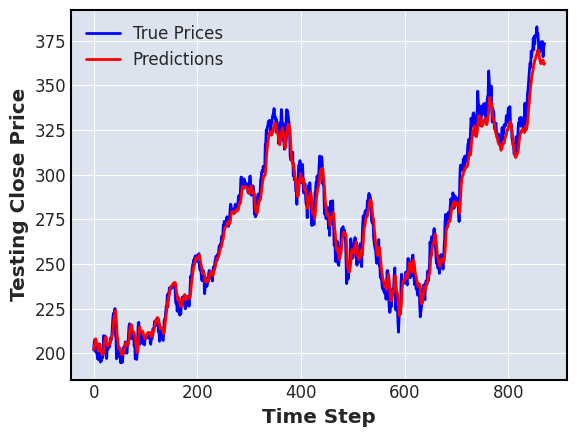

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 7s 51ms/step - loss: 0.0049 - mae: 0.0403 - mse: 0.0049 - mape: 42.4293 - val_loss: 6.9703e-04 - val_mae: 0.0205 - val_mse: 6.9703e-04 - val_mape: 2.9024
Epoch 2/10
82/82 [==============================] - 2s 24ms/step - loss: 3.2498e-05 - mae: 0.0036 - mse: 3.2498e-05 - mape: 3.7236 - val_loss: 6.3867e-04 - val_mae: 0.0198 - val_mse: 6.3867e-04 - val_mape: 2.8612
Epoch 3/10
82/82 [==============================] - 2s 24ms/step - loss: 2.4450e-05 - mae: 0.0029 - mse: 2.4450e-05 - mape: 2.5423 - val_loss: 4.1038e-04 - val_mae: 0.0156 - val_mse: 4.1038e-04 - val_mape: 2.2811
Epoch 4/10
82/82 [==============================] - 2s 28ms/step - loss: 2.3409e-05 - mae: 0.0028 - mse: 2.3409e-05 - mape: 2.4816 - val_loss: 4.9165e-04 - val_mae: 0.0173 - val_mse: 4.9165e-04 - val_mape: 2.5466
Epoch 5/10
82/82 [==============================] - 2s 26ms/step - loss: 2.2338e-

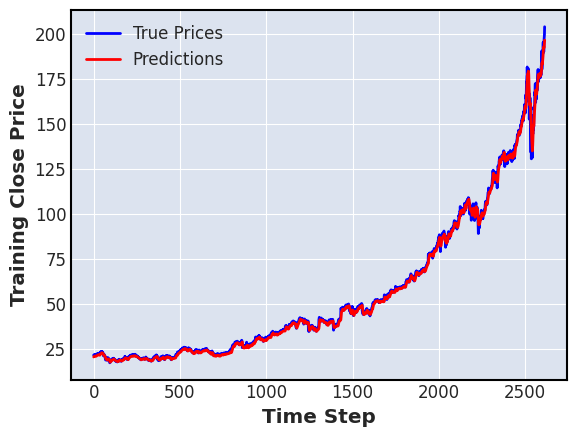

28/28 [==============================] - 0s 7ms/step


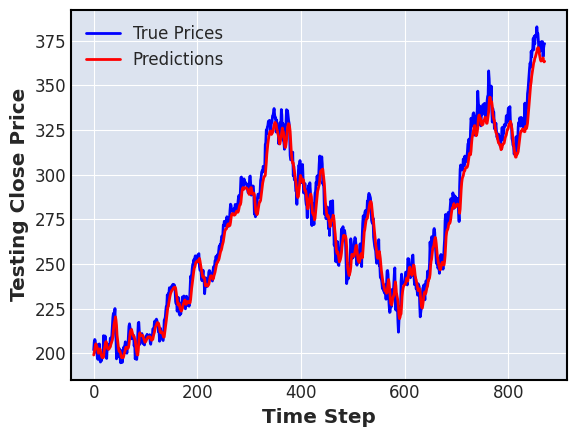

---------------------------------------------------------------


In [37]:
number_of_runs = 0
for ticker_index, ticker_name in enumerate(My_Tickers_SP500):
    full_data = x_tickers_sp500[ticker_index]
    target = y_tickers_sp500[ticker_index]
    print('ticker_name : ' ,ticker_name[0], ticker_name[1] , ' , length = ', len(full_data))
    
    # Time Series Split
    for j, (train_index, test_index) in enumerate(tss.split(full_data)):
        print('kth split : ', j)
        # Different Seeds
        for new_seed in range(3):
            print('seed : ', new_seed)
            seed_value = new_seed
            random.seed(seed_value)
            np.random.seed(seed_value)
            tf.random.set_seed(seed_value)
            utils.set_random_seed(seed_value)

            number_of_runs += 1
            full_data = np.reshape(full_data, (full_data.shape[0], full_data.shape[1], 1))
        
            X_train, X_val = full_data[train_index], full_data[test_index]
            y_train, y_val = target[train_index], target[test_index]

            gru_model = StockPredictionModel(n_steps=full_data.shape[1], model='GRU')
            gru_model.fit(X_train, y_train, X_val, y_val, epoch=10)

            train_pred = gru_model.predict(X_train)
            train_pred = scaler.inverse_transform(train_pred.reshape(-1, 1))
            y_train = scaler.inverse_transform(y_train.reshape(-1, 1))
            plot_results(train_pred, y_train, 'Training')
            test_pred = gru_model.predict(X_val)
            test_pred = scaler.inverse_transform(test_pred.reshape(-1, 1))
            y_val = scaler.inverse_transform(y_val.reshape(-1, 1))
            plot_results(test_pred, y_val, 'Testing')
            print('---------------------------------------------------------------')

## Other Neural Networks

In [38]:
class StockPredictionMLPandCNN:
    def __init__(self, input_size, model, n_step=100):
        self.model = model
        if model == 'MLP':
            self.model = Sequential([
                Dense(64, activation='relu', input_dim=input_size),
                Dense(64, activation='relu'),
                Dense(32, activation='relu'),
                Dense(1)
            ])
        elif model == 'CNN':
            self.model = Sequential([
                Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=(input_size, 1)),
                MaxPooling1D(pool_size=2),
                Flatten(),
                Dense(32, activation='relu'),
                Dense(1)
            ])
        elif model == 'Conv_LSTM':
            self.model = Sequential([
                ConvLSTM2D(filters=64, kernel_size=(1, 1) ,input_shape=input_size, activation='relu'),
                Flatten(),
                Dense(50, activation='relu'),
                Dense(1)
            ])
            
        self.model.compile(
            loss='mean_squared_error',
            optimizer=Adam(learning_rate=0.001),
            metrics=['mae', 'mse', 'mape']
        )

    def fit(self, X, y, X_val, y_val, epoch):
        if self.model == 'MLP':
            self.model.fit(X, y, validation_data=(X_val, y_val), batch_size=1, epochs=epoch)
        else:
            self.model.fit(X, y, validation_data=(X_val, y_val), epochs=epoch)

    def predict(self, X):
        return self.model.predict(X)
    def evaluate(self, X, y):
        return self.model.evaluate(X, y)

### MLP

ticker_name :  AMZN Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 2s 17ms/step - loss: 1.9864e-05 - mae: 0.0030 - mse: 1.9864e-05 - mape: 4335.1987 - val_loss: 8.6978e-05 - val_mae: 0.0067 - val_mse: 8.6978e-05 - val_mape: 11.2200
Epoch 2/10
28/28 [==============================] - 0s 6ms/step - loss: 2.2964e-06 - mae: 0.0012 - mse: 2.2964e-06 - mape: 2085.9346 - val_loss: 7.5934e-05 - val_mae: 0.0062 - val_mse: 7.5934e-05 - val_mape: 10.4063
Epoch 3/10
28/28 [==============================] - 0s 7ms/step - loss: 2.2121e-06 - mae: 0.0012 - mse: 2.2121e-06 - mape: 3406.1123 - val_loss: 7.4651e-05 - val_mae: 0.0061 - val_mse: 7.4651e-05 - val_mape: 10.0846
Epoch 4/10
28/28 [==============================] - 0s 6ms/step - loss: 1.9070e-06 - mae: 0.0011 - mse: 1.9070e-06 - mape: 1658.1771 - val_loss: 7.4717e-05 - val_mae: 0.0061 - val_mse: 7.4717e-05 - val_mape: 9.7879
Epoch 5/10
28/28 [==============================] - 0s 7ms/step - l

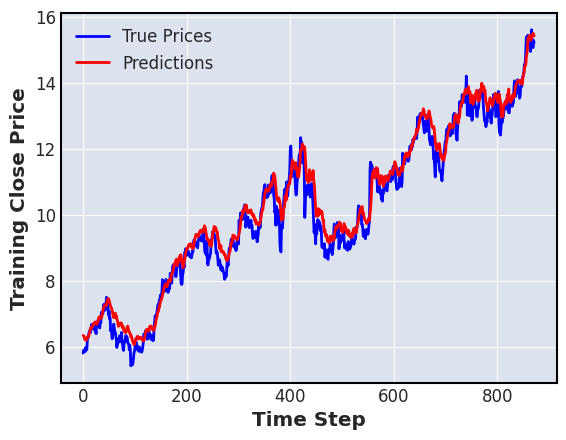

28/28 [==============================] - 0s 2ms/step


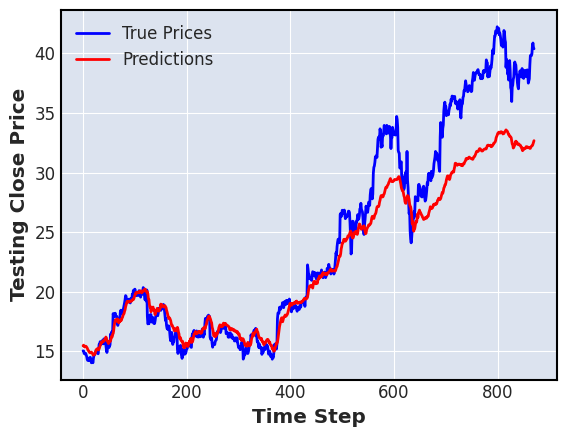

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 2s 18ms/step - loss: 1.7348e-05 - mae: 0.0029 - mse: 1.7348e-05 - mape: 4350.7646 - val_loss: 9.3990e-05 - val_mae: 0.0073 - val_mse: 9.3990e-05 - val_mape: 12.2532
Epoch 2/10
28/28 [==============================] - 0s 7ms/step - loss: 3.5609e-06 - mae: 0.0015 - mse: 3.5609e-06 - mape: 4898.3145 - val_loss: 8.6094e-05 - val_mae: 0.0069 - val_mse: 8.6094e-05 - val_mape: 11.7342
Epoch 3/10
28/28 [==============================] - 0s 6ms/step - loss: 2.6701e-06 - mae: 0.0013 - mse: 2.6701e-06 - mape: 3206.3987 - val_loss: 8.5456e-05 - val_mae: 0.0069 - val_mse: 8.5456e-05 - val_mape: 11.5117
Epoch 4/10
28/28 [==============================] - 0s 7ms/step - loss: 1.9112e-06 - mae: 0.0011 - mse: 1.9112e-06 - mape: 2961.0886 - val_loss: 7.6528e-05 - val_mae: 0.0064 - val_mse: 7.6528e-05 - val_mape: 10.8055
Epoch 5/10
28/28 [==============================] - 0s 7ms/st

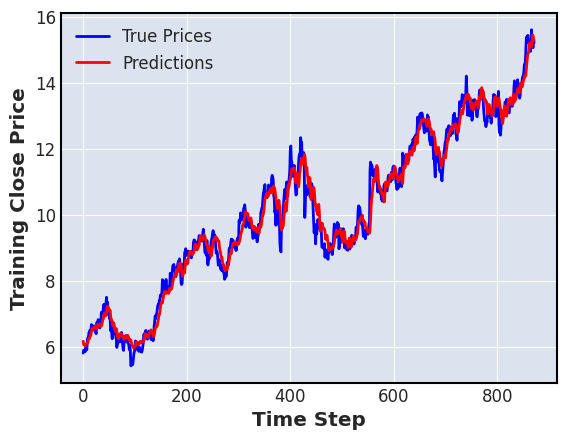

28/28 [==============================] - 0s 2ms/step


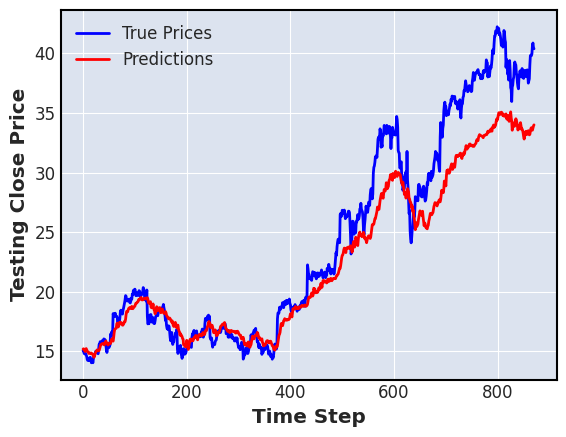

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 2s 17ms/step - loss: 1.1705e-05 - mae: 0.0024 - mse: 1.1705e-05 - mape: 5347.2896 - val_loss: 1.1931e-05 - val_mae: 0.0026 - val_mse: 1.1931e-05 - val_mape: 6.1091
Epoch 2/10
28/28 [==============================] - 0s 6ms/step - loss: 1.9905e-06 - mae: 0.0011 - mse: 1.9905e-06 - mape: 2512.3076 - val_loss: 9.4438e-06 - val_mae: 0.0023 - val_mse: 9.4438e-06 - val_mape: 4.9763
Epoch 3/10
28/28 [==============================] - 0s 7ms/step - loss: 1.5391e-06 - mae: 9.8365e-04 - mse: 1.5391e-06 - mape: 2400.3643 - val_loss: 8.9531e-06 - val_mae: 0.0022 - val_mse: 8.9531e-06 - val_mape: 5.0563
Epoch 4/10
28/28 [==============================] - 0s 7ms/step - loss: 1.3046e-06 - mae: 9.0874e-04 - mse: 1.3046e-06 - mape: 2759.7271 - val_loss: 9.2494e-06 - val_mae: 0.0023 - val_mse: 9.2494e-06 - val_mape: 4.9597
Epoch 5/10
28/28 [==============================] - 0s 6m

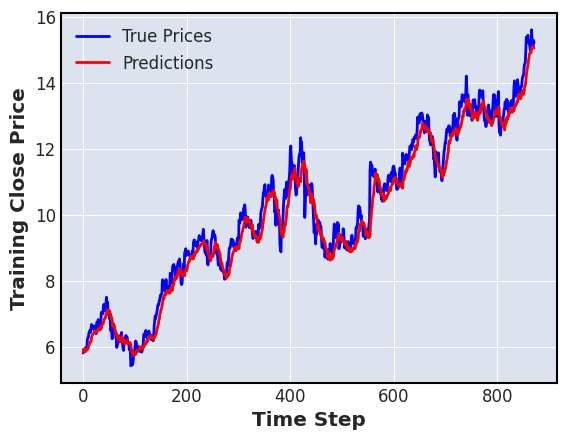

28/28 [==============================] - 0s 2ms/step


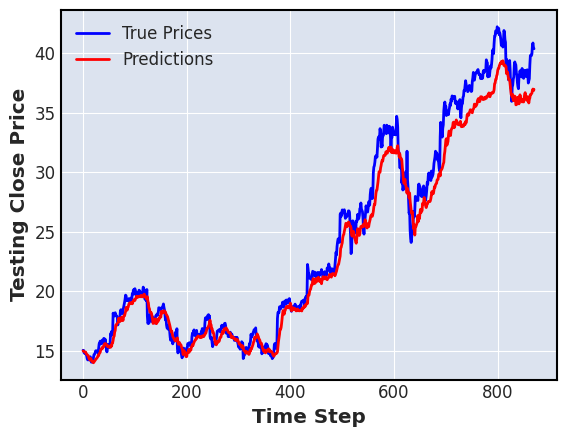

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 2s 9ms/step - loss: 1.1874e-04 - mae: 0.0056 - mse: 1.1874e-04 - mape: 2906.0203 - val_loss: 1.7621e-04 - val_mae: 0.0092 - val_mse: 1.7621e-04 - val_mape: 4.5462
Epoch 2/10
55/55 [==============================] - 0s 4ms/step - loss: 7.3379e-06 - mae: 0.0019 - mse: 7.3379e-06 - mape: 1229.7338 - val_loss: 1.2474e-04 - val_mae: 0.0075 - val_mse: 1.2474e-04 - val_mape: 3.5811
Epoch 3/10
55/55 [==============================] - 0s 5ms/step - loss: 4.4520e-06 - mae: 0.0015 - mse: 4.4520e-06 - mape: 894.3267 - val_loss: 1.1953e-04 - val_mae: 0.0076 - val_mse: 1.1953e-04 - val_mape: 3.5945
Epoch 4/10
55/55 [==============================] - 0s 4ms/step - loss: 3.5837e-06 - mae: 0.0013 - mse: 3.5837e-06 - mape: 994.8127 - val_loss: 1.0624e-04 - val_mae: 0.0070 - val_mse: 1.0624e-04 - val_mape: 3.2722
Epoch 5/10
55/55 [==============================] - 0

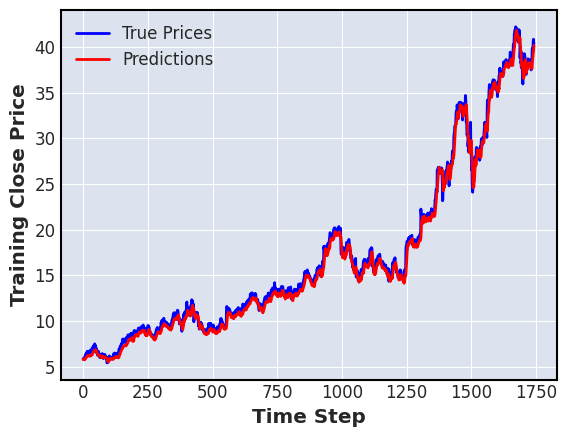

28/28 [==============================] - 0s 2ms/step


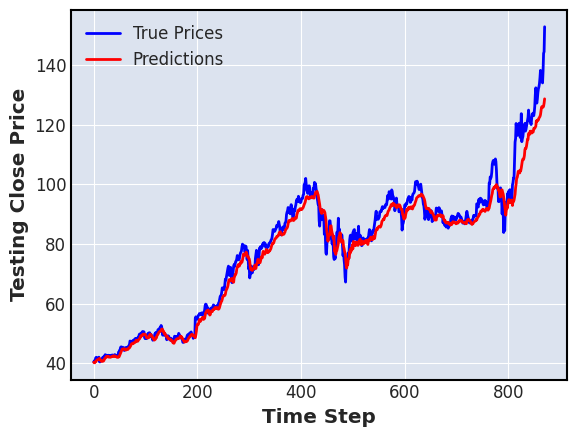

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 2s 9ms/step - loss: 6.4488e-05 - mae: 0.0051 - mse: 6.4488e-05 - mape: 9553.3525 - val_loss: 1.8637e-04 - val_mae: 0.0097 - val_mse: 1.8637e-04 - val_mape: 4.7001
Epoch 2/10
55/55 [==============================] - 0s 5ms/step - loss: 1.0566e-05 - mae: 0.0023 - mse: 1.0566e-05 - mape: 1536.1919 - val_loss: 2.0823e-04 - val_mae: 0.0106 - val_mse: 2.0823e-04 - val_mape: 5.0711
Epoch 3/10
55/55 [==============================] - 0s 5ms/step - loss: 8.1956e-06 - mae: 0.0020 - mse: 8.1956e-06 - mape: 1437.7656 - val_loss: 1.4942e-04 - val_mae: 0.0086 - val_mse: 1.4942e-04 - val_mape: 4.0868
Epoch 4/10
55/55 [==============================] - 0s 5ms/step - loss: 6.7623e-06 - mae: 0.0019 - mse: 6.7623e-06 - mape: 2267.5981 - val_loss: 1.5327e-04 - val_mae: 0.0087 - val_mse: 1.5327e-04 - val_mape: 4.0982
Epoch 5/10
55/55 [==============================] - 0s 5ms/step - 

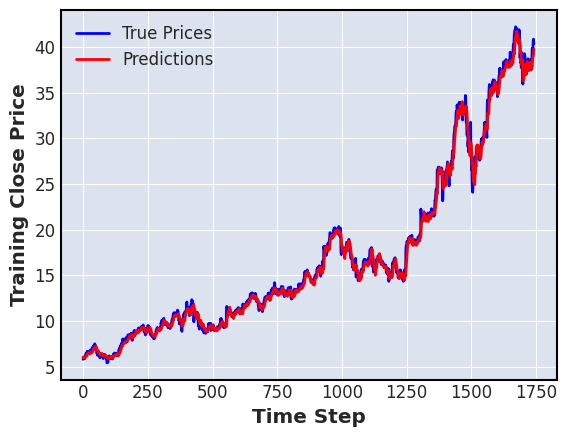

28/28 [==============================] - 0s 2ms/step


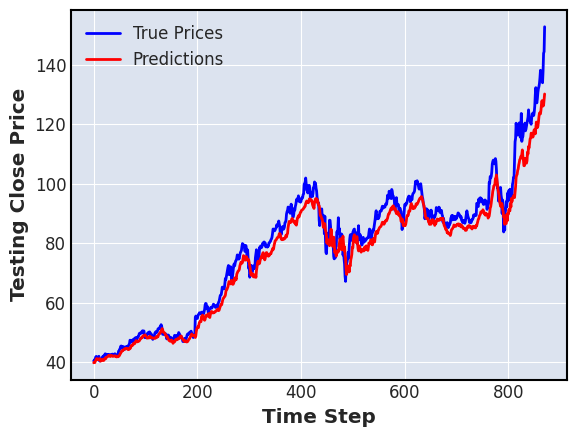

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 2s 10ms/step - loss: 4.6790e-05 - mae: 0.0037 - mse: 4.6790e-05 - mape: 4562.8667 - val_loss: 9.9101e-05 - val_mae: 0.0068 - val_mse: 9.9101e-05 - val_mape: 3.3639
Epoch 2/10
55/55 [==============================] - 0s 5ms/step - loss: 5.5359e-06 - mae: 0.0017 - mse: 5.5359e-06 - mape: 1790.5022 - val_loss: 9.2806e-05 - val_mae: 0.0068 - val_mse: 9.2806e-05 - val_mape: 3.3128
Epoch 3/10
55/55 [==============================] - 0s 5ms/step - loss: 4.4930e-06 - mae: 0.0015 - mse: 4.4930e-06 - mape: 975.8947 - val_loss: 8.3722e-05 - val_mae: 0.0064 - val_mse: 8.3722e-05 - val_mape: 3.1694
Epoch 4/10
55/55 [==============================] - 0s 5ms/step - loss: 4.4124e-06 - mae: 0.0015 - mse: 4.4124e-06 - mape: 1596.5251 - val_loss: 8.6664e-05 - val_mae: 0.0066 - val_mse: 8.6664e-05 - val_mape: 3.4125
Epoch 5/10
55/55 [==============================] - 0s 5ms/step - 

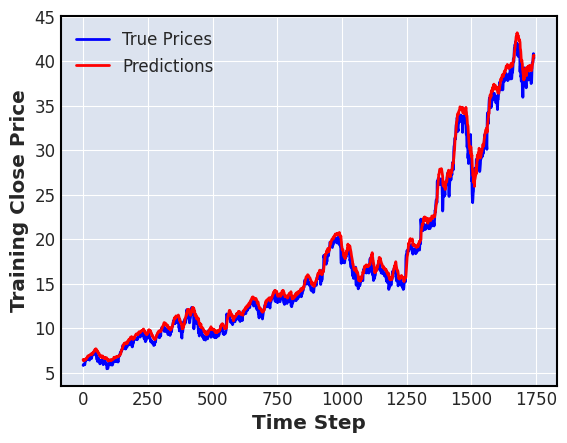

28/28 [==============================] - 0s 2ms/step


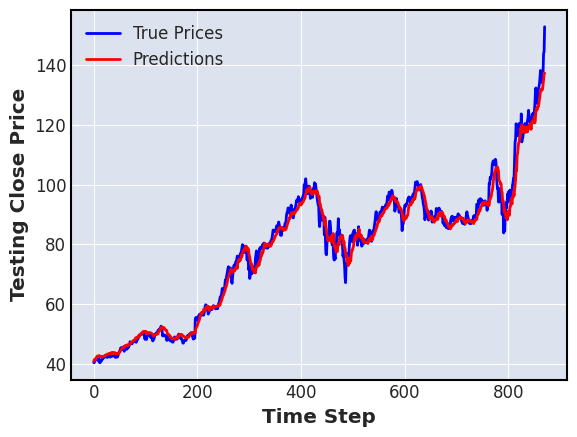

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 2s 7ms/step - loss: 0.0012 - mae: 0.0140 - mse: 0.0012 - mape: 9302.4434 - val_loss: 6.1369e-04 - val_mae: 0.0187 - val_mse: 6.1369e-04 - val_mape: 5.6068
Epoch 2/10
82/82 [==============================] - 0s 4ms/step - loss: 5.7649e-05 - mae: 0.0045 - mse: 5.7649e-05 - mape: 803.3757 - val_loss: 4.5267e-04 - val_mae: 0.0161 - val_mse: 4.5267e-04 - val_mape: 4.8057
Epoch 3/10
82/82 [==============================] - 0s 4ms/step - loss: 3.6807e-05 - mae: 0.0036 - mse: 3.6807e-05 - mape: 637.3829 - val_loss: 3.0078e-04 - val_mae: 0.0132 - val_mse: 3.0078e-04 - val_mape: 3.9233
Epoch 4/10
82/82 [==============================] - 0s 4ms/step - loss: 3.0244e-05 - mae: 0.0033 - mse: 3.0244e-05 - mape: 1376.9332 - val_loss: 2.4039e-04 - val_mae: 0.0117 - val_mse: 2.4039e-04 - val_mape: 3.4712
Epoch 5/10
82/82 [==============================] - 0s 4ms/st

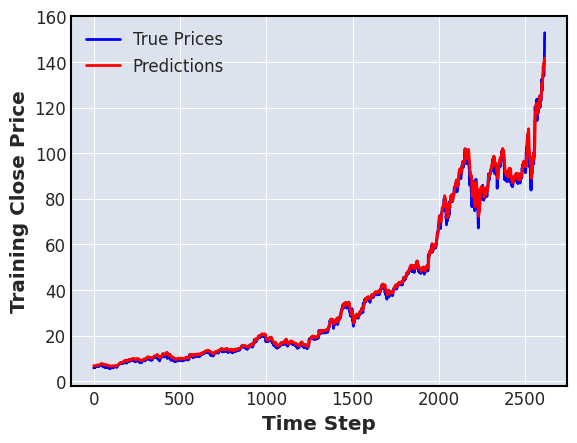

28/28 [==============================] - 0s 2ms/step


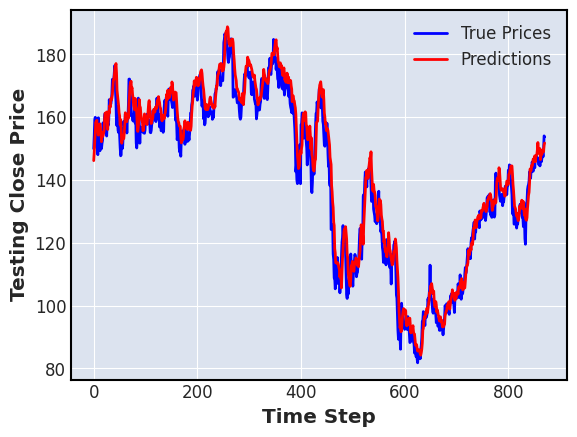

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 2s 8ms/step - loss: 5.6178e-04 - mae: 0.0123 - mse: 5.6178e-04 - mape: 10641.3301 - val_loss: 7.4792e-04 - val_mae: 0.0208 - val_mse: 7.4792e-04 - val_mape: 6.2811
Epoch 2/10
82/82 [==============================] - 0s 5ms/step - loss: 4.6819e-05 - mae: 0.0040 - mse: 4.6819e-05 - mape: 1455.0994 - val_loss: 3.1917e-04 - val_mae: 0.0135 - val_mse: 3.1917e-04 - val_mape: 3.9828
Epoch 3/10
82/82 [==============================] - 0s 4ms/step - loss: 2.8213e-05 - mae: 0.0031 - mse: 2.8213e-05 - mape: 631.0165 - val_loss: 2.3212e-04 - val_mae: 0.0113 - val_mse: 2.3212e-04 - val_mape: 3.3438
Epoch 4/10
82/82 [==============================] - 0s 4ms/step - loss: 2.1076e-05 - mae: 0.0027 - mse: 2.1076e-05 - mape: 973.6359 - val_loss: 3.4771e-04 - val_mae: 0.0147 - val_mse: 3.4771e-04 - val_mape: 4.3038
Epoch 5/10
82/82 [==============================] - 0s 4ms/step - l

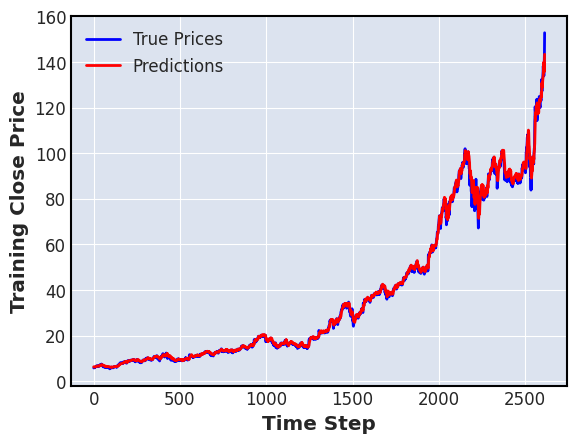

28/28 [==============================] - 0s 2ms/step


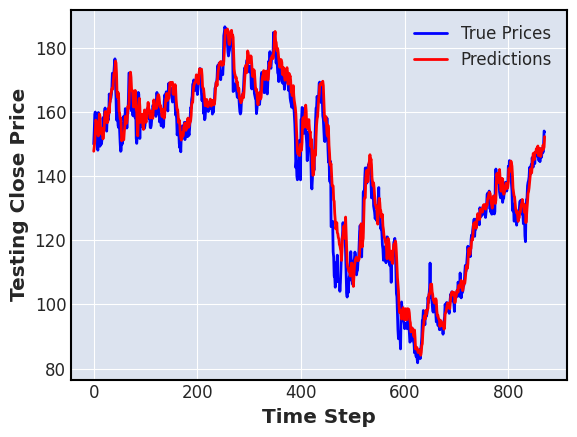

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 2s 7ms/step - loss: 3.4273e-04 - mae: 0.0085 - mse: 3.4273e-04 - mape: 1270.7218 - val_loss: 3.9147e-04 - val_mae: 0.0152 - val_mse: 3.9147e-04 - val_mape: 4.4415
Epoch 2/10
82/82 [==============================] - 0s 4ms/step - loss: 3.9148e-05 - mae: 0.0036 - mse: 3.9148e-05 - mape: 604.9985 - val_loss: 3.8791e-04 - val_mae: 0.0149 - val_mse: 3.8791e-04 - val_mape: 4.3986
Epoch 3/10
82/82 [==============================] - 0s 4ms/step - loss: 3.6299e-05 - mae: 0.0035 - mse: 3.6299e-05 - mape: 855.5425 - val_loss: 2.8217e-04 - val_mae: 0.0127 - val_mse: 2.8217e-04 - val_mape: 3.7197
Epoch 4/10
82/82 [==============================] - 0s 4ms/step - loss: 2.9946e-05 - mae: 0.0033 - mse: 2.9946e-05 - mape: 1271.0524 - val_loss: 3.5739e-04 - val_mae: 0.0145 - val_mse: 3.5739e-04 - val_mape: 4.2373
Epoch 5/10
82/82 [==============================] - 0s 4ms/step - lo

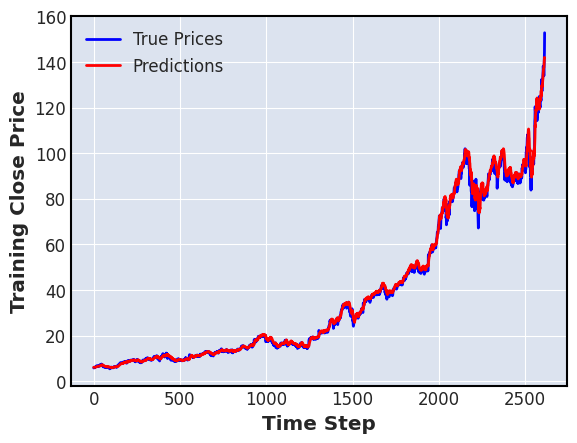

28/28 [==============================] - 0s 2ms/step


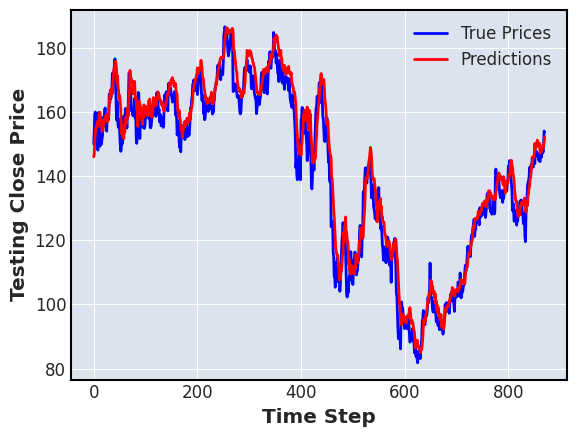

---------------------------------------------------------------
ticker_name :  IBM Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 2s 16ms/step - loss: 0.0151 - mae: 0.0915 - mse: 0.0151 - mape: 34.5433 - val_loss: 4.4376e-04 - val_mae: 0.0182 - val_mse: 4.4376e-04 - val_mape: 7.0364
Epoch 2/10
28/28 [==============================] - 0s 6ms/step - loss: 3.4310e-04 - mae: 0.0150 - mse: 3.4310e-04 - mape: 5.8530 - val_loss: 1.2114e-04 - val_mae: 0.0087 - val_mse: 1.2114e-04 - val_mape: 3.3498
Epoch 3/10
28/28 [==============================] - 0s 6ms/step - loss: 1.6446e-04 - mae: 0.0108 - mse: 1.6446e-04 - mape: 4.3399 - val_loss: 1.1740e-04 - val_mae: 0.0086 - val_mse: 1.1740e-04 - val_mape: 3.2880
Epoch 4/10
28/28 [==============================] - 0s 6ms/step - loss: 1.3726e-04 - mae: 0.0099 - mse: 1.3726e-04 - mape: 4.0430 - val_loss: 1.1424e-04 - val_mae: 0.0085 - val_mse: 1.1424e-04 - val_mape: 3.2506
Epoch 5/10
28/28 [========

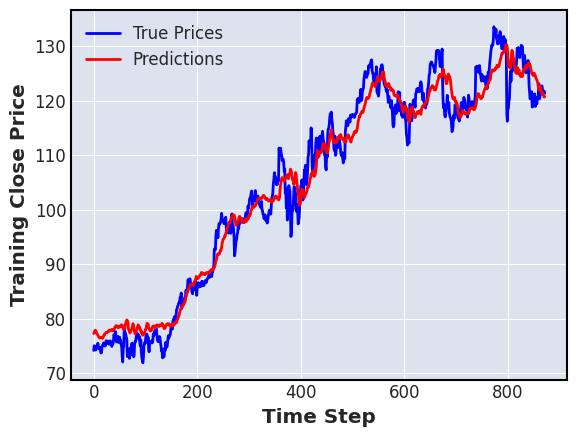

28/28 [==============================] - 0s 2ms/step


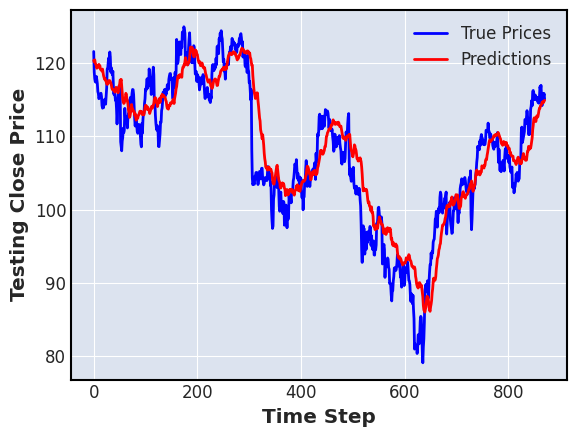

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 1s 14ms/step - loss: 0.0066 - mae: 0.0585 - mse: 0.0066 - mape: 22.2101 - val_loss: 5.1830e-04 - val_mae: 0.0203 - val_mse: 5.1830e-04 - val_mape: 7.3382
Epoch 2/10
28/28 [==============================] - 0s 6ms/step - loss: 2.3161e-04 - mae: 0.0123 - mse: 2.3161e-04 - mape: 4.8190 - val_loss: 1.3717e-04 - val_mae: 0.0093 - val_mse: 1.3717e-04 - val_mape: 3.5511
Epoch 3/10
28/28 [==============================] - 0s 5ms/step - loss: 1.2749e-04 - mae: 0.0096 - mse: 1.2749e-04 - mape: 3.7868 - val_loss: 1.5871e-04 - val_mae: 0.0099 - val_mse: 1.5871e-04 - val_mape: 3.8352
Epoch 4/10
28/28 [==============================] - 0s 5ms/step - loss: 1.2125e-04 - mae: 0.0094 - mse: 1.2125e-04 - mape: 3.7004 - val_loss: 1.3679e-04 - val_mae: 0.0092 - val_mse: 1.3679e-04 - val_mape: 3.5460
Epoch 5/10
28/28 [==============================] - 0s 6ms/step - loss: 1.1178e-04 -

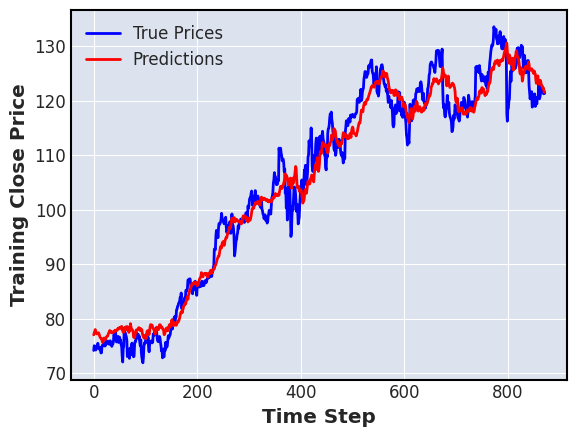

28/28 [==============================] - 0s 2ms/step


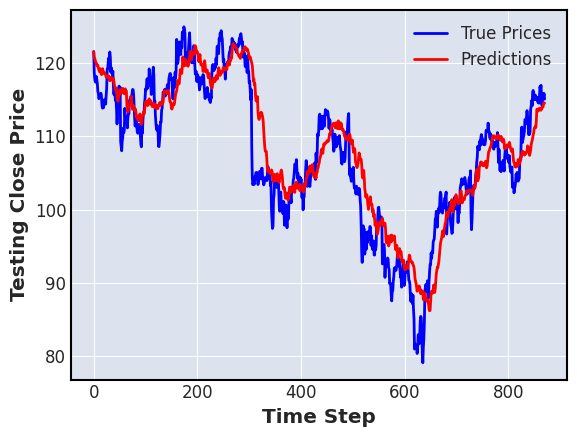

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 1s 14ms/step - loss: 0.0042 - mae: 0.0438 - mse: 0.0042 - mape: 16.6268 - val_loss: 2.2139e-04 - val_mae: 0.0126 - val_mse: 2.2139e-04 - val_mape: 4.8312
Epoch 2/10
28/28 [==============================] - 0s 7ms/step - loss: 1.2865e-04 - mae: 0.0091 - mse: 1.2865e-04 - mape: 3.6568 - val_loss: 7.0712e-05 - val_mae: 0.0066 - val_mse: 7.0712e-05 - val_mape: 2.5331
Epoch 3/10
28/28 [==============================] - 0s 7ms/step - loss: 6.9206e-05 - mae: 0.0068 - mse: 6.9206e-05 - mape: 2.7051 - val_loss: 6.6243e-05 - val_mae: 0.0064 - val_mse: 6.6243e-05 - val_mape: 2.4383
Epoch 4/10
28/28 [==============================] - 0s 6ms/step - loss: 6.5015e-05 - mae: 0.0065 - mse: 6.5015e-05 - mape: 2.5265 - val_loss: 6.4418e-05 - val_mae: 0.0064 - val_mse: 6.4418e-05 - val_mape: 2.4091
Epoch 5/10
28/28 [==============================] - 0s 6ms/step - loss: 6.2910e-05 -

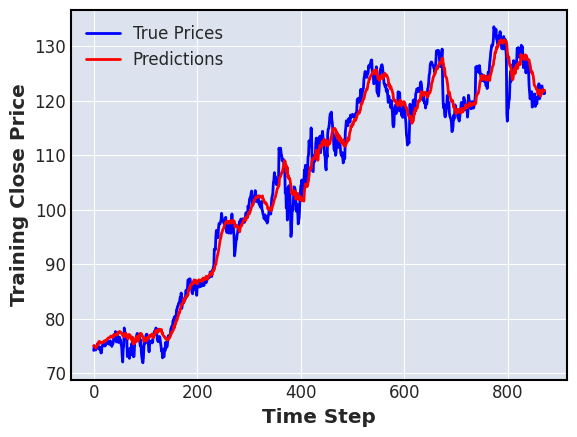

28/28 [==============================] - 0s 2ms/step


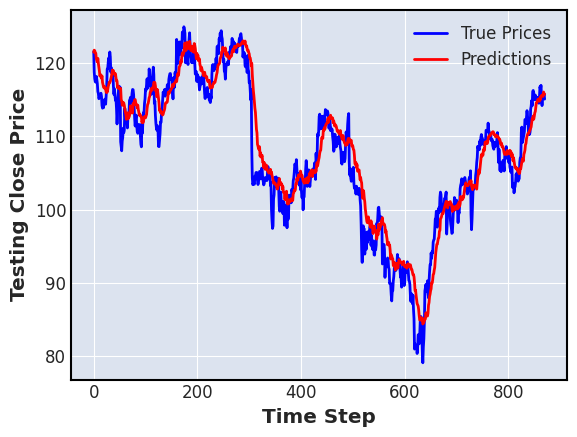

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 2s 10ms/step - loss: 0.0077 - mae: 0.0554 - mse: 0.0077 - mape: 20.7270 - val_loss: 3.2860e-04 - val_mae: 0.0129 - val_mse: 3.2860e-04 - val_mape: 5.1325
Epoch 2/10
55/55 [==============================] - 0s 5ms/step - loss: 1.6187e-04 - mae: 0.0104 - mse: 1.6187e-04 - mape: 4.1390 - val_loss: 2.5568e-04 - val_mae: 0.0108 - val_mse: 2.5568e-04 - val_mape: 4.2647
Epoch 3/10
55/55 [==============================] - 0s 4ms/step - loss: 1.4344e-04 - mae: 0.0099 - mse: 1.4344e-04 - mape: 3.8817 - val_loss: 2.5891e-04 - val_mae: 0.0109 - val_mse: 2.5891e-04 - val_mape: 4.2894
Epoch 4/10
55/55 [==============================] - 0s 7ms/step - loss: 1.3499e-04 - mae: 0.0096 - mse: 1.3499e-04 - mape: 3.7504 - val_loss: 2.4872e-04 - val_mae: 0.0107 - val_mse: 2.4872e-04 - val_mape: 4.2089
Epoch 5/10
55/55 [==============================] - 0s 5ms/step - los

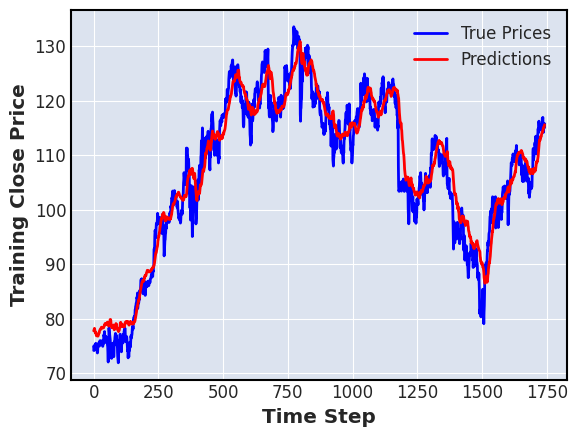

28/28 [==============================] - 0s 2ms/step


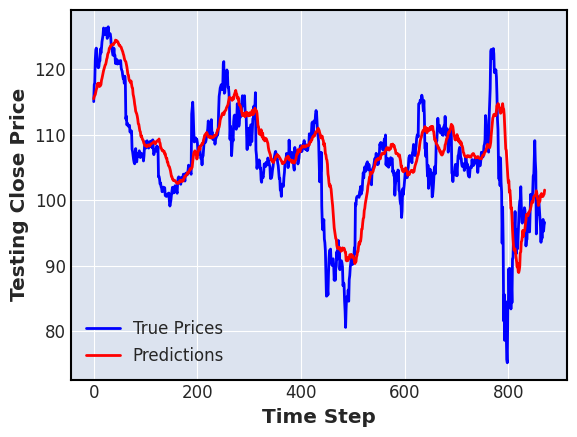

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 2s 9ms/step - loss: 0.0035 - mae: 0.0365 - mse: 0.0035 - mape: 13.7154 - val_loss: 2.5734e-04 - val_mae: 0.0114 - val_mse: 2.5734e-04 - val_mape: 4.4420
Epoch 2/10
55/55 [==============================] - 0s 4ms/step - loss: 1.2421e-04 - mae: 0.0091 - mse: 1.2421e-04 - mape: 3.5505 - val_loss: 2.5042e-04 - val_mae: 0.0110 - val_mse: 2.5042e-04 - val_mape: 4.3569
Epoch 3/10
55/55 [==============================] - 0s 4ms/step - loss: 1.0448e-04 - mae: 0.0083 - mse: 1.0448e-04 - mape: 3.2141 - val_loss: 2.3062e-04 - val_mae: 0.0105 - val_mse: 2.3062e-04 - val_mape: 4.1695
Epoch 4/10
55/55 [==============================] - 0s 4ms/step - loss: 9.5543e-05 - mae: 0.0079 - mse: 9.5543e-05 - mape: 3.0406 - val_loss: 1.8752e-04 - val_mae: 0.0093 - val_mse: 1.8752e-04 - val_mape: 3.6806
Epoch 5/10
55/55 [==============================] - 0s 4ms/step - loss: 8.1143e-05 - 

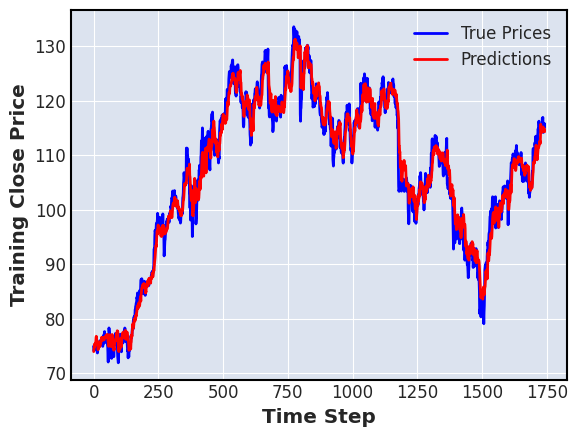

28/28 [==============================] - 0s 2ms/step


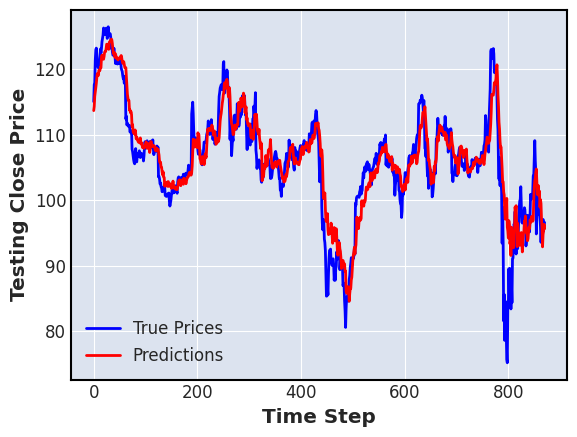

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 2s 9ms/step - loss: 0.0022 - mae: 0.0263 - mse: 0.0022 - mape: 9.8760 - val_loss: 1.4892e-04 - val_mae: 0.0089 - val_mse: 1.4892e-04 - val_mape: 3.4125
Epoch 2/10
55/55 [==============================] - 2s 36ms/step - loss: 7.9717e-05 - mae: 0.0072 - mse: 7.9717e-05 - mape: 2.8027 - val_loss: 1.4420e-04 - val_mae: 0.0081 - val_mse: 1.4420e-04 - val_mape: 3.1778
Epoch 3/10
55/55 [==============================] - 0s 5ms/step - loss: 6.8487e-05 - mae: 0.0066 - mse: 6.8487e-05 - mape: 2.5507 - val_loss: 1.4013e-04 - val_mae: 0.0080 - val_mse: 1.4013e-04 - val_mape: 3.1371
Epoch 4/10
55/55 [==============================] - 0s 5ms/step - loss: 6.5894e-05 - mae: 0.0064 - mse: 6.5894e-05 - mape: 2.4511 - val_loss: 1.3130e-04 - val_mae: 0.0078 - val_mse: 1.3130e-04 - val_mape: 3.0286
Epoch 5/10
55/55 [==============================] - 0s 5ms/step - loss: 5.7800e-05 - 

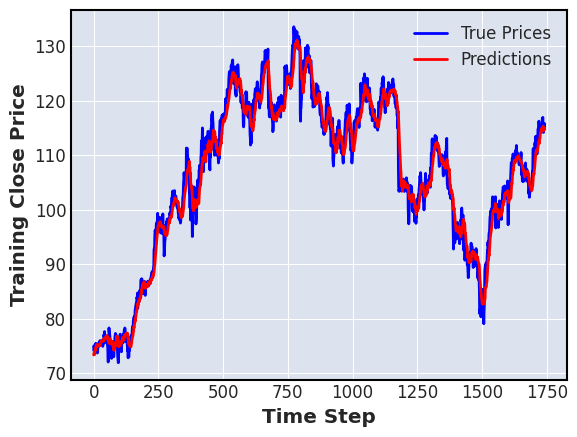

28/28 [==============================] - 0s 3ms/step


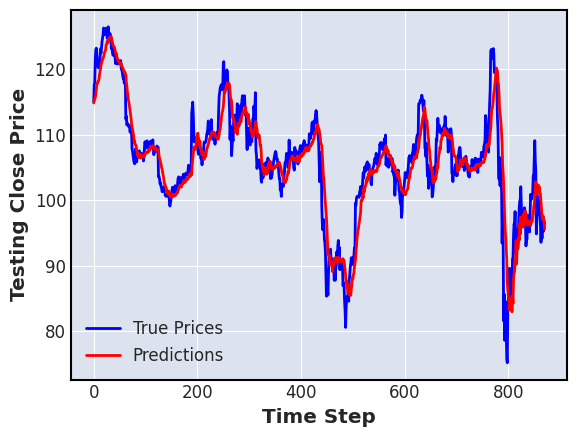

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 2s 9ms/step - loss: 0.0053 - mae: 0.0396 - mse: 0.0053 - mape: 14.8820 - val_loss: 4.0909e-04 - val_mae: 0.0158 - val_mse: 4.0909e-04 - val_mape: 4.9143
Epoch 2/10
82/82 [==============================] - 0s 6ms/step - loss: 1.5907e-04 - mae: 0.0096 - mse: 1.5907e-04 - mape: 3.7689 - val_loss: 2.5497e-04 - val_mae: 0.0123 - val_mse: 2.5497e-04 - val_mape: 3.8867
Epoch 3/10
82/82 [==============================] - 0s 6ms/step - loss: 1.3814e-04 - mae: 0.0089 - mse: 1.3814e-04 - mape: 3.4708 - val_loss: 2.4664e-04 - val_mae: 0.0122 - val_mse: 2.4664e-04 - val_mape: 3.8322
Epoch 4/10
82/82 [==============================] - 0s 6ms/step - loss: 1.1809e-04 - mae: 0.0081 - mse: 1.1809e-04 - mape: 3.1514 - val_loss: 1.8570e-04 - val_mae: 0.0106 - val_mse: 1.8570e-04 - val_mape: 3.3586
Epoch 5/10
82/82 [==============================] - 0s 6ms/step - loss

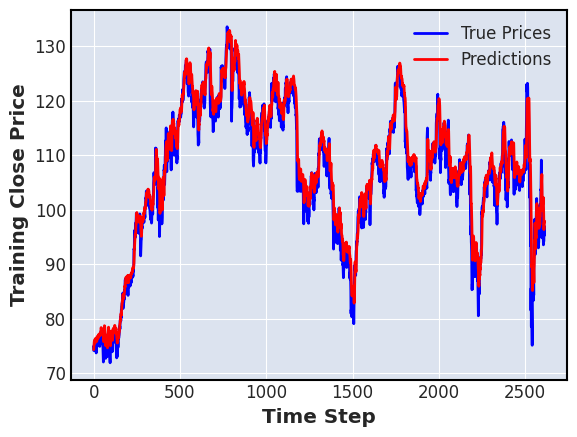

28/28 [==============================] - 0s 2ms/step


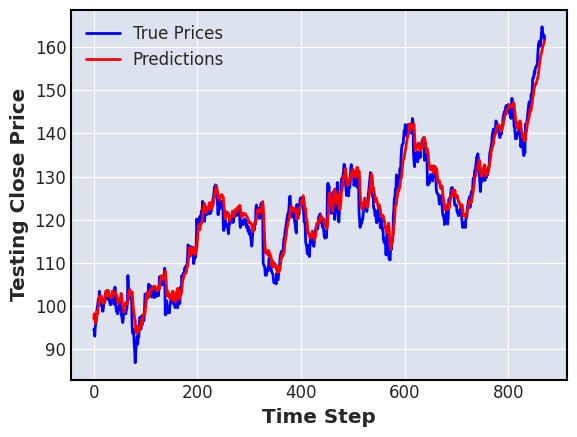

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 2s 10ms/step - loss: 0.0024 - mae: 0.0280 - mse: 0.0024 - mape: 10.5583 - val_loss: 2.7208e-04 - val_mae: 0.0126 - val_mse: 2.7208e-04 - val_mape: 4.0243
Epoch 2/10
82/82 [==============================] - 1s 7ms/step - loss: 1.5105e-04 - mae: 0.0093 - mse: 1.5105e-04 - mape: 3.6115 - val_loss: 2.7274e-04 - val_mae: 0.0127 - val_mse: 2.7274e-04 - val_mape: 4.0119
Epoch 3/10
82/82 [==============================] - 1s 7ms/step - loss: 1.3638e-04 - mae: 0.0088 - mse: 1.3638e-04 - mape: 3.3954 - val_loss: 2.8887e-04 - val_mae: 0.0132 - val_mse: 2.8887e-04 - val_mape: 4.1500
Epoch 4/10
82/82 [==============================] - 0s 6ms/step - loss: 1.2100e-04 - mae: 0.0082 - mse: 1.2100e-04 - mape: 3.1819 - val_loss: 1.8743e-04 - val_mae: 0.0105 - val_mse: 1.8743e-04 - val_mape: 3.3704
Epoch 5/10
82/82 [==============================] - 0s 5ms/step - loss: 1.0504e-04 -

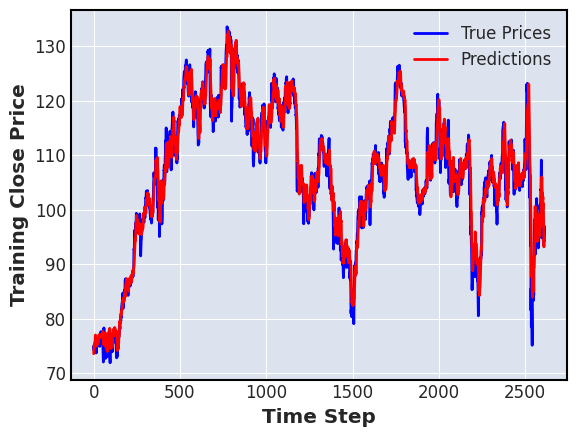

28/28 [==============================] - 0s 3ms/step


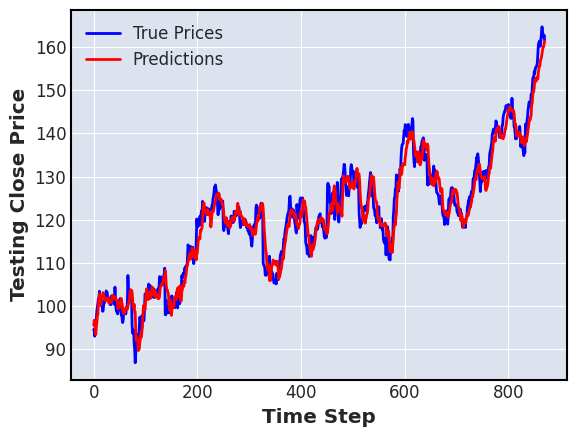

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 2s 10ms/step - loss: 0.0014 - mae: 0.0203 - mse: 0.0014 - mape: 7.7181 - val_loss: 1.9432e-04 - val_mae: 0.0109 - val_mse: 1.9432e-04 - val_mape: 3.4408
Epoch 2/10
82/82 [==============================] - 0s 5ms/step - loss: 8.2202e-05 - mae: 0.0068 - mse: 8.2202e-05 - mape: 2.6146 - val_loss: 1.1644e-04 - val_mae: 0.0084 - val_mse: 1.1644e-04 - val_mape: 2.6982
Epoch 3/10
82/82 [==============================] - 0s 4ms/step - loss: 6.8839e-05 - mae: 0.0061 - mse: 6.8839e-05 - mape: 2.3370 - val_loss: 1.1632e-04 - val_mae: 0.0084 - val_mse: 1.1632e-04 - val_mape: 2.7175
Epoch 4/10
82/82 [==============================] - 0s 6ms/step - loss: 6.1285e-05 - mae: 0.0057 - mse: 6.1285e-05 - mape: 2.1789 - val_loss: 9.0938e-05 - val_mae: 0.0075 - val_mse: 9.0938e-05 - val_mape: 2.4262
Epoch 5/10
82/82 [==============================] - 0s 4ms/step - loss: 5.6753e-05 - 

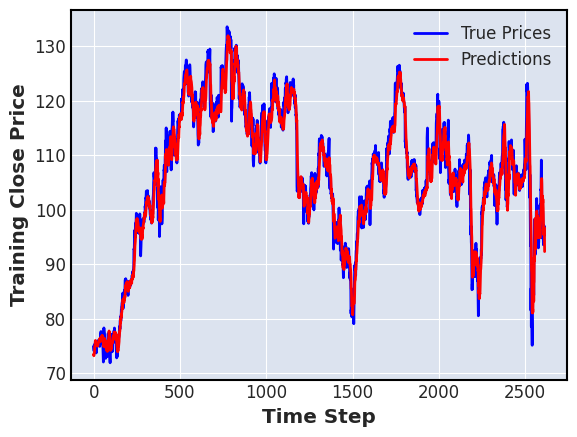

28/28 [==============================] - 0s 2ms/step


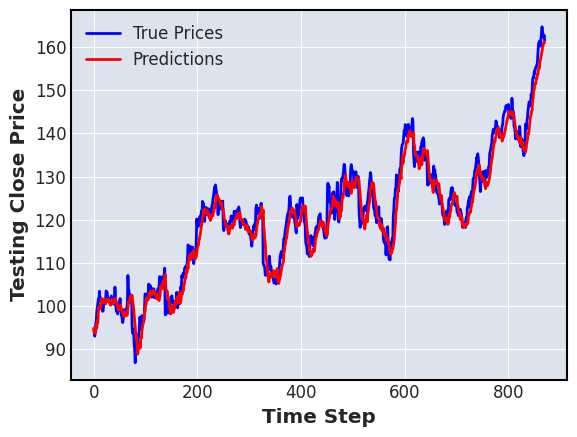

---------------------------------------------------------------
ticker_name :  KO Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 1s 16ms/step - loss: 3.2323e-04 - mae: 0.0127 - mse: 3.2323e-04 - mape: 27.2920 - val_loss: 2.1709e-04 - val_mae: 0.0143 - val_mse: 2.1709e-04 - val_mape: 20.4363
Epoch 2/10
28/28 [==============================] - 0s 6ms/step - loss: 2.7036e-05 - mae: 0.0042 - mse: 2.7036e-05 - mape: 9.7416 - val_loss: 4.7129e-05 - val_mae: 0.0062 - val_mse: 4.7129e-05 - val_mape: 8.7166
Epoch 3/10
28/28 [==============================] - 0s 7ms/step - loss: 1.5040e-05 - mae: 0.0031 - mse: 1.5040e-05 - mape: 7.2851 - val_loss: 4.4168e-05 - val_mae: 0.0061 - val_mse: 4.4168e-05 - val_mape: 8.5696
Epoch 4/10
28/28 [==============================] - 0s 7ms/step - loss: 8.7666e-06 - mae: 0.0024 - mse: 8.7666e-06 - mape: 5.4407 - val_loss: 2.6808e-05 - val_mae: 0.0047 - val_mse: 2.6808e-05 - val_mape: 6.5650
Epoch 5/10
28/28 [

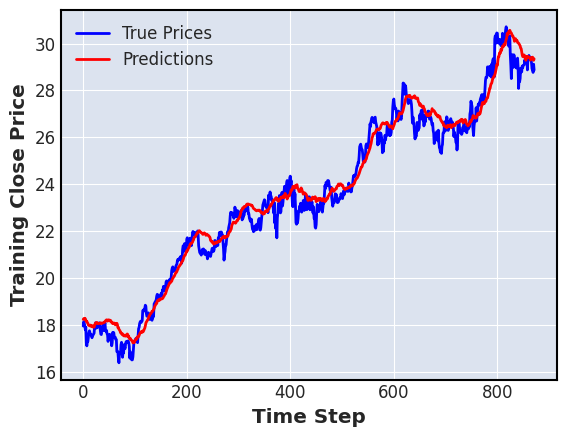

28/28 [==============================] - 0s 2ms/step


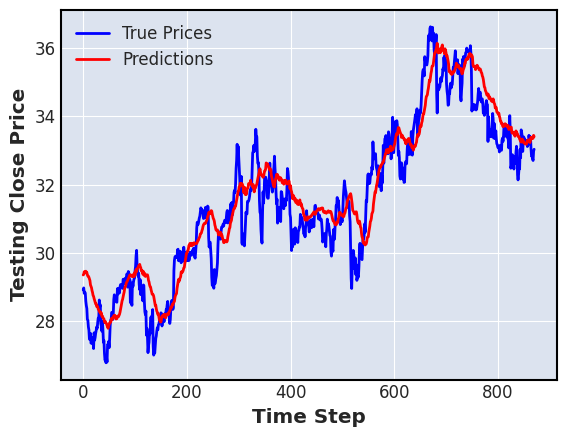

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 1s 14ms/step - loss: 1.9168e-04 - mae: 0.0101 - mse: 1.9168e-04 - mape: 21.7187 - val_loss: 7.5903e-06 - val_mae: 0.0021 - val_mse: 7.5903e-06 - val_mape: 3.0974
Epoch 2/10
28/28 [==============================] - 0s 6ms/step - loss: 1.3040e-05 - mae: 0.0029 - mse: 1.3040e-05 - mape: 6.5607 - val_loss: 3.2405e-05 - val_mae: 0.0051 - val_mse: 3.2405e-05 - val_mape: 7.2254
Epoch 3/10
28/28 [==============================] - 0s 7ms/step - loss: 6.6383e-06 - mae: 0.0020 - mse: 6.6383e-06 - mape: 4.5795 - val_loss: 1.0778e-05 - val_mae: 0.0027 - val_mse: 1.0778e-05 - val_mape: 3.7964
Epoch 4/10
28/28 [==============================] - 0s 6ms/step - loss: 4.2395e-06 - mae: 0.0016 - mse: 4.2395e-06 - mape: 3.5931 - val_loss: 5.6794e-06 - val_mae: 0.0019 - val_mse: 5.6794e-06 - val_mape: 2.6837
Epoch 5/10
28/28 [==============================] - 0s 6ms/step - loss: 3.51

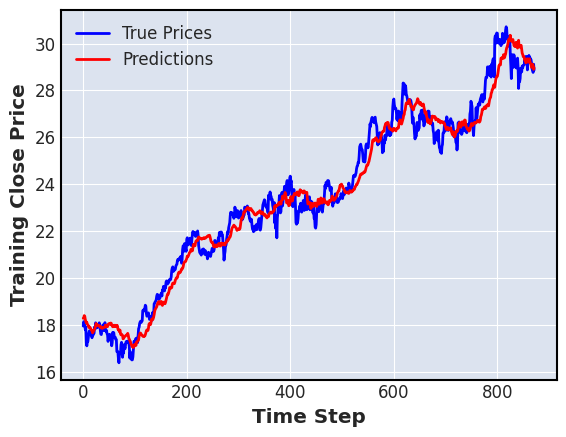

28/28 [==============================] - 0s 2ms/step


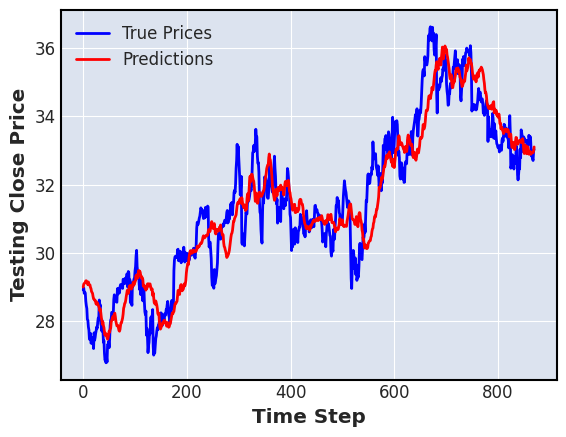

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 1s 16ms/step - loss: 1.2965e-04 - mae: 0.0080 - mse: 1.2965e-04 - mape: 17.2937 - val_loss: 1.1740e-04 - val_mae: 0.0105 - val_mse: 1.1740e-04 - val_mape: 15.0819
Epoch 2/10
28/28 [==============================] - 0s 6ms/step - loss: 8.7417e-06 - mae: 0.0023 - mse: 8.7417e-06 - mape: 5.2245 - val_loss: 1.1988e-05 - val_mae: 0.0030 - val_mse: 1.1988e-05 - val_mape: 4.2348
Epoch 3/10
28/28 [==============================] - 0s 6ms/step - loss: 2.9126e-06 - mae: 0.0014 - mse: 2.9126e-06 - mape: 3.0171 - val_loss: 6.0211e-06 - val_mae: 0.0020 - val_mse: 6.0211e-06 - val_mape: 2.9077
Epoch 4/10
28/28 [==============================] - 0s 6ms/step - loss: 1.7990e-06 - mae: 0.0011 - mse: 1.7990e-06 - mape: 2.2660 - val_loss: 3.2079e-06 - val_mae: 0.0014 - val_mse: 3.2079e-06 - val_mape: 2.0253
Epoch 5/10
28/28 [==============================] - 0s 5ms/step - loss: 1.7

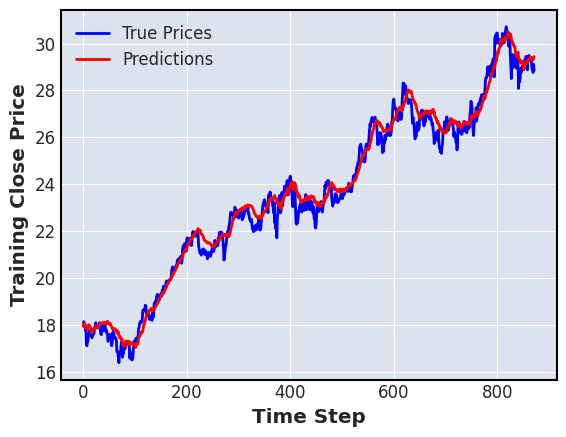

28/28 [==============================] - 0s 2ms/step


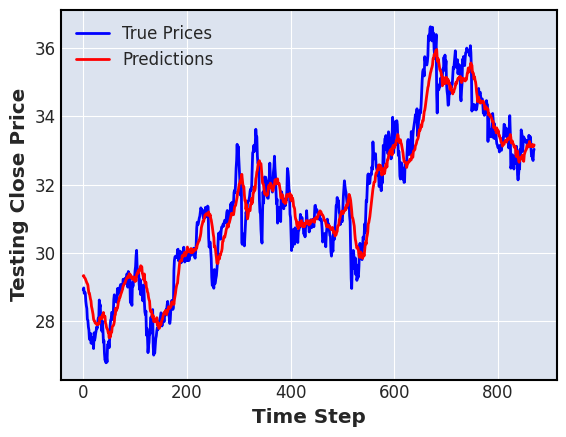

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 2s 9ms/step - loss: 2.7033e-04 - mae: 0.0106 - mse: 2.7033e-04 - mape: 19.2003 - val_loss: 1.2842e-04 - val_mae: 0.0102 - val_mse: 1.2842e-04 - val_mape: 10.6488
Epoch 2/10
55/55 [==============================] - 0s 4ms/step - loss: 1.1263e-05 - mae: 0.0027 - mse: 1.1263e-05 - mape: 5.2651 - val_loss: 3.7582e-05 - val_mae: 0.0051 - val_mse: 3.7582e-05 - val_mape: 5.3795
Epoch 3/10
55/55 [==============================] - 0s 4ms/step - loss: 3.4560e-06 - mae: 0.0015 - mse: 3.4560e-06 - mape: 2.6017 - val_loss: 1.7371e-05 - val_mae: 0.0027 - val_mse: 1.7371e-05 - val_mape: 2.8484
Epoch 4/10
55/55 [==============================] - 0s 4ms/step - loss: 3.1610e-06 - mae: 0.0014 - mse: 3.1610e-06 - mape: 2.4540 - val_loss: 1.8279e-05 - val_mae: 0.0029 - val_mse: 1.8279e-05 - val_mape: 3.0817
Epoch 5/10
55/55 [==============================] - 0s 4ms/st

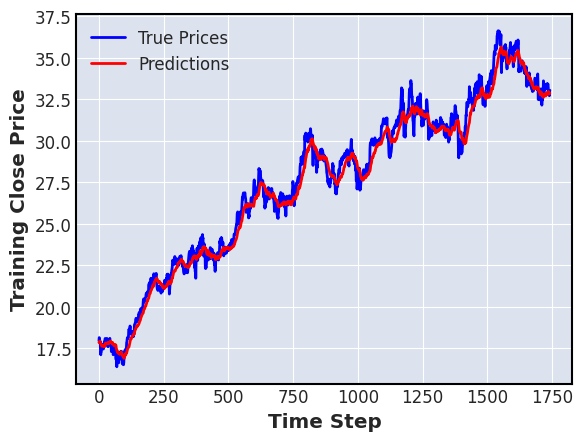

28/28 [==============================] - 0s 2ms/step


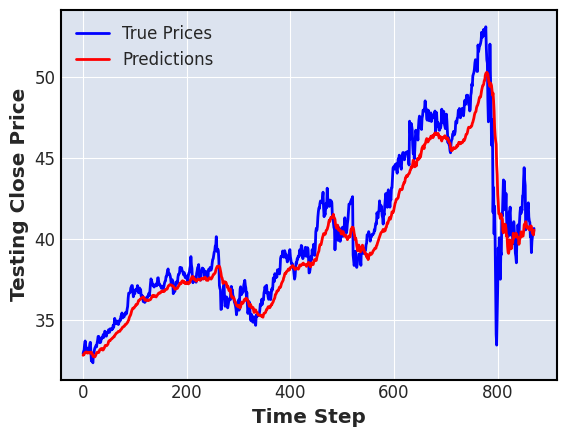

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 2s 10ms/step - loss: 1.5029e-04 - mae: 0.0081 - mse: 1.5029e-04 - mape: 14.8617 - val_loss: 9.6595e-05 - val_mae: 0.0089 - val_mse: 9.6595e-05 - val_mape: 9.3153
Epoch 2/10
55/55 [==============================] - 0s 5ms/step - loss: 7.4111e-06 - mae: 0.0022 - mse: 7.4111e-06 - mape: 4.0505 - val_loss: 2.8937e-05 - val_mae: 0.0040 - val_mse: 2.8937e-05 - val_mape: 4.1759
Epoch 3/10
55/55 [==============================] - 0s 5ms/step - loss: 4.3409e-06 - mae: 0.0017 - mse: 4.3409e-06 - mape: 2.9414 - val_loss: 2.2631e-05 - val_mae: 0.0029 - val_mse: 2.2631e-05 - val_mape: 3.1365
Epoch 4/10
55/55 [==============================] - 0s 5ms/step - loss: 4.0080e-06 - mae: 0.0016 - mse: 4.0080e-06 - mape: 2.8241 - val_loss: 2.2626e-05 - val_mae: 0.0030 - val_mse: 2.2626e-05 - val_mape: 3.2406
Epoch 5/10
55/55 [==============================] - 0s 4ms/step - loss: 3.98

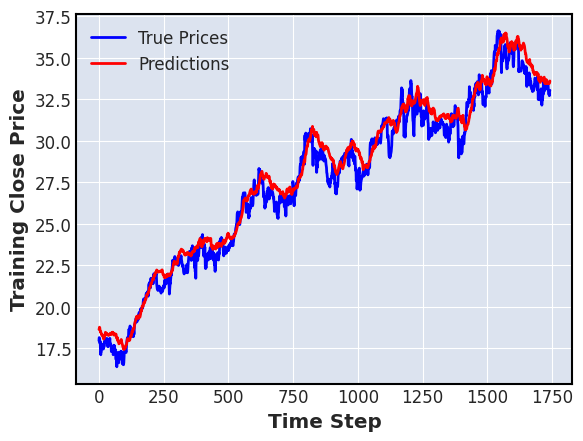

28/28 [==============================] - 0s 2ms/step


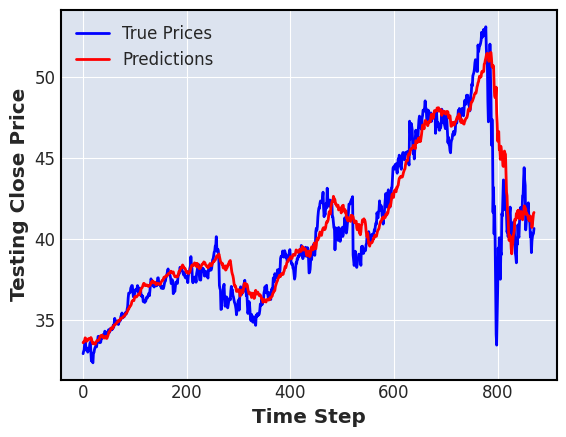

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 2s 9ms/step - loss: 9.7274e-05 - mae: 0.0058 - mse: 9.7274e-05 - mape: 10.5171 - val_loss: 3.2922e-05 - val_mae: 0.0049 - val_mse: 3.2922e-05 - val_mape: 5.1541
Epoch 2/10
55/55 [==============================] - 0s 7ms/step - loss: 3.0100e-06 - mae: 0.0014 - mse: 3.0100e-06 - mape: 2.4436 - val_loss: 1.3460e-05 - val_mae: 0.0022 - val_mse: 1.3460e-05 - val_mape: 2.3803
Epoch 3/10
55/55 [==============================] - 0s 5ms/step - loss: 2.5427e-06 - mae: 0.0012 - mse: 2.5427e-06 - mape: 2.1700 - val_loss: 1.3541e-05 - val_mae: 0.0024 - val_mse: 1.3541e-05 - val_mape: 2.5379
Epoch 4/10
55/55 [==============================] - 0s 5ms/step - loss: 2.7125e-06 - mae: 0.0013 - mse: 2.7125e-06 - mape: 2.2597 - val_loss: 1.2669e-05 - val_mae: 0.0022 - val_mse: 1.2669e-05 - val_mape: 2.3744
Epoch 5/10
55/55 [==============================] - 0s 5ms/step - loss: 2.399

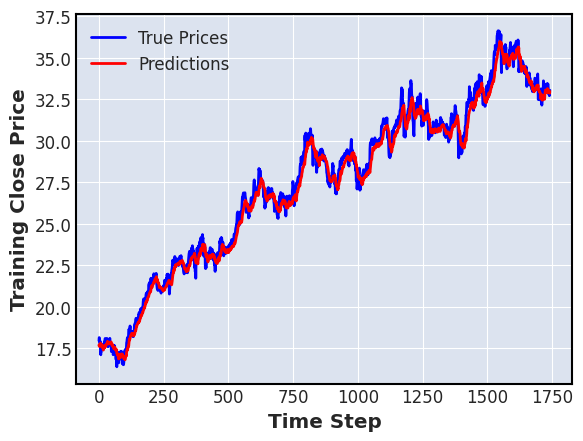

28/28 [==============================] - 0s 2ms/step


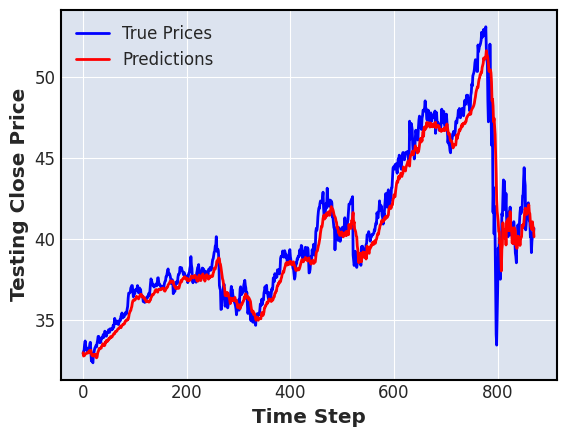

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 2s 8ms/step - loss: 3.3027e-04 - mae: 0.0106 - mse: 3.3027e-04 - mape: 16.2028 - val_loss: 8.6322e-05 - val_mae: 0.0082 - val_mse: 8.6322e-05 - val_mape: 6.1739
Epoch 2/10
82/82 [==============================] - 0s 4ms/step - loss: 9.5147e-06 - mae: 0.0020 - mse: 9.5147e-06 - mape: 2.8398 - val_loss: 4.2664e-05 - val_mae: 0.0054 - val_mse: 4.2664e-05 - val_mape: 3.9925
Epoch 3/10
82/82 [==============================] - 0s 4ms/step - loss: 7.4969e-06 - mae: 0.0018 - mse: 7.4969e-06 - mape: 2.5238 - val_loss: 3.6300e-05 - val_mae: 0.0051 - val_mse: 3.6300e-05 - val_mape: 3.8524
Epoch 4/10
82/82 [==============================] - 0s 4ms/step - loss: 6.5054e-06 - mae: 0.0017 - mse: 6.5054e-06 - mape: 2.4356 - val_loss: 2.3422e-05 - val_mae: 0.0039 - val_mse: 2.3422e-05 - val_mape: 2.9478
Epoch 5/10
82/82 [==============================] - 0s 5ms/ste

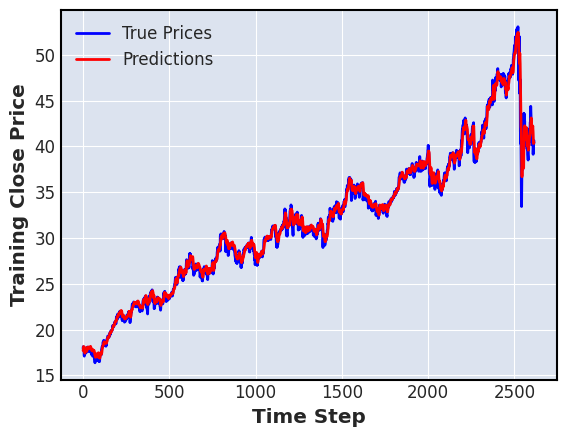

28/28 [==============================] - 0s 2ms/step


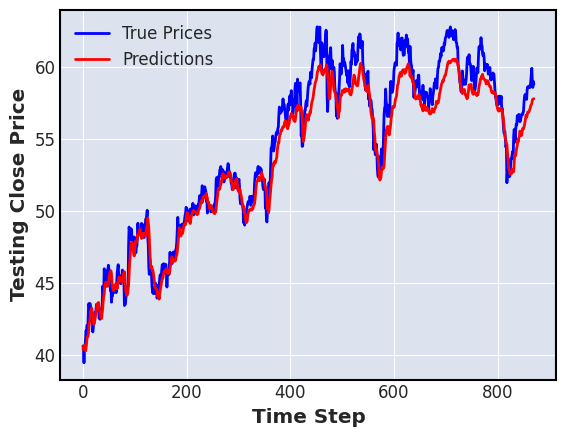

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 2s 7ms/step - loss: 1.6768e-04 - mae: 0.0078 - mse: 1.6768e-04 - mape: 12.0370 - val_loss: 4.4416e-05 - val_mae: 0.0056 - val_mse: 4.4416e-05 - val_mape: 4.2719
Epoch 2/10
82/82 [==============================] - 0s 4ms/step - loss: 1.0274e-05 - mae: 0.0021 - mse: 1.0274e-05 - mape: 3.0482 - val_loss: 3.5397e-05 - val_mae: 0.0050 - val_mse: 3.5397e-05 - val_mape: 3.8681
Epoch 3/10
82/82 [==============================] - 0s 5ms/step - loss: 9.5059e-06 - mae: 0.0020 - mse: 9.5059e-06 - mape: 2.8716 - val_loss: 2.1588e-05 - val_mae: 0.0037 - val_mse: 2.1588e-05 - val_mape: 2.8412
Epoch 4/10
82/82 [==============================] - 0s 4ms/step - loss: 8.8821e-06 - mae: 0.0019 - mse: 8.8821e-06 - mape: 2.7884 - val_loss: 2.4625e-05 - val_mae: 0.0041 - val_mse: 2.4625e-05 - val_mape: 3.1523
Epoch 5/10
82/82 [==============================] - 0s 5ms/step - loss: 8.034

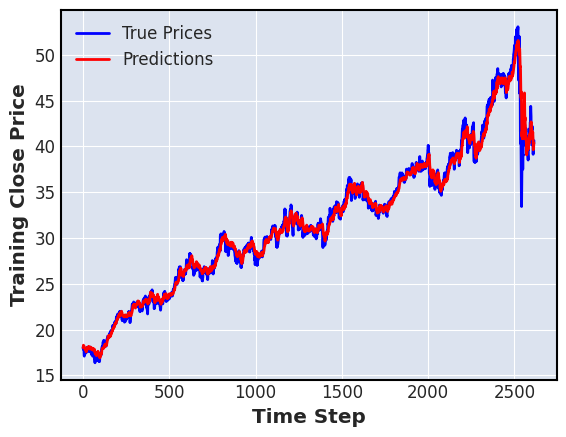

28/28 [==============================] - 0s 2ms/step


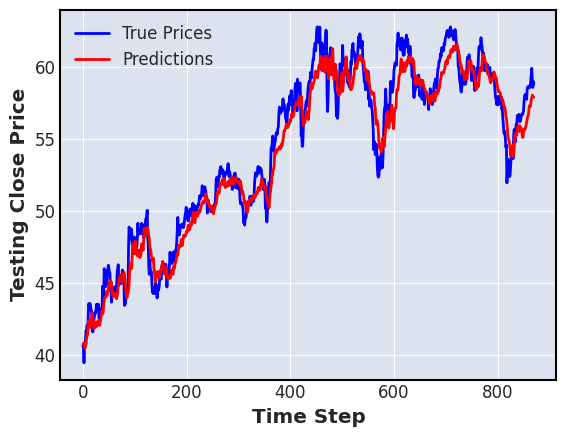

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 2s 7ms/step - loss: 1.0101e-04 - mae: 0.0052 - mse: 1.0101e-04 - mape: 8.0186 - val_loss: 1.4977e-05 - val_mae: 0.0031 - val_mse: 1.4977e-05 - val_mape: 2.3822
Epoch 2/10
82/82 [==============================] - 0s 4ms/step - loss: 6.9280e-06 - mae: 0.0017 - mse: 6.9280e-06 - mape: 2.5272 - val_loss: 1.3268e-05 - val_mae: 0.0029 - val_mse: 1.3268e-05 - val_mape: 2.2357
Epoch 3/10
82/82 [==============================] - 0s 4ms/step - loss: 5.8952e-06 - mae: 0.0016 - mse: 5.8952e-06 - mape: 2.2430 - val_loss: 1.2064e-05 - val_mae: 0.0027 - val_mse: 1.2064e-05 - val_mape: 2.0715
Epoch 4/10
82/82 [==============================] - 0s 5ms/step - loss: 5.3921e-06 - mae: 0.0015 - mse: 5.3921e-06 - mape: 2.1924 - val_loss: 1.0694e-05 - val_mae: 0.0025 - val_mse: 1.0694e-05 - val_mape: 1.9453
Epoch 5/10
82/82 [==============================] - 0s 4ms/step - loss: 5.1228

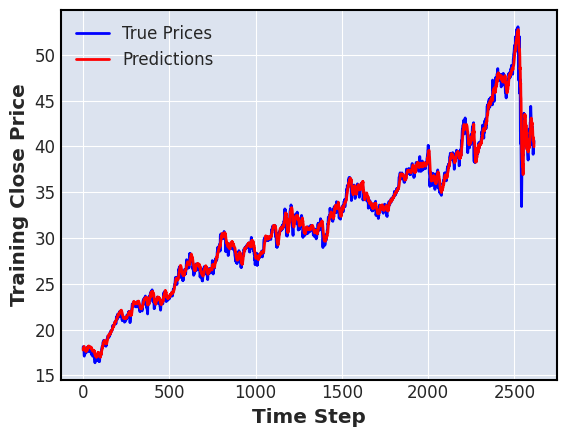

28/28 [==============================] - 0s 2ms/step


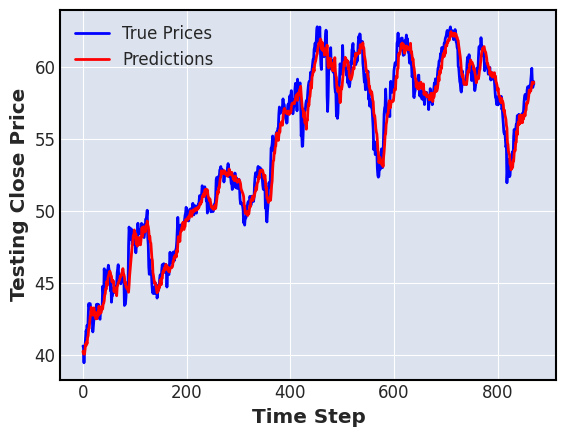

---------------------------------------------------------------
ticker_name :  AAPL Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 2s 19ms/step - loss: 5.6965e-05 - mae: 0.0051 - mse: 5.6965e-05 - mape: 39.1451 - val_loss: 1.0372e-05 - val_mae: 0.0025 - val_mse: 1.0372e-05 - val_mape: 5.6058
Epoch 2/10
28/28 [==============================] - 0s 7ms/step - loss: 6.4516e-06 - mae: 0.0019 - mse: 6.4516e-06 - mape: 12.7932 - val_loss: 1.8712e-05 - val_mae: 0.0036 - val_mse: 1.8712e-05 - val_mape: 7.3879
Epoch 3/10
28/28 [==============================] - 0s 6ms/step - loss: 4.4907e-06 - mae: 0.0016 - mse: 4.4907e-06 - mape: 10.7545 - val_loss: 1.3477e-05 - val_mae: 0.0030 - val_mse: 1.3477e-05 - val_mape: 6.1559
Epoch 4/10
28/28 [==============================] - 0s 6ms/step - loss: 3.8873e-06 - mae: 0.0015 - mse: 3.8873e-06 - mape: 9.7920 - val_loss: 1.5686e-05 - val_mae: 0.0033 - val_mse: 1.5686e-05 - val_mape: 6.7325
Epoch 5/10
28/2

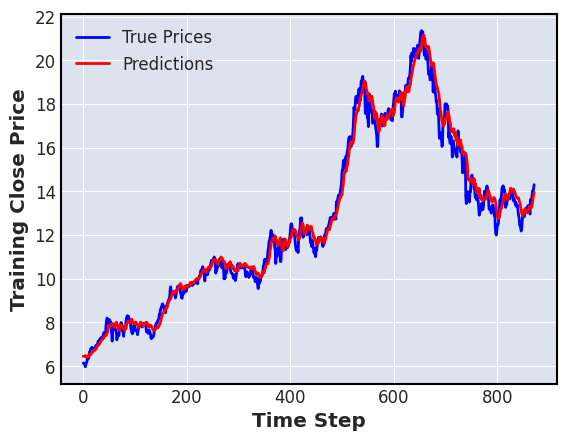

28/28 [==============================] - 0s 2ms/step


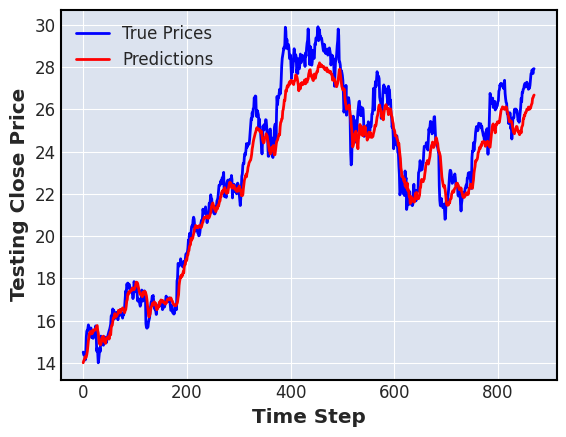

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 2s 17ms/step - loss: 4.6192e-05 - mae: 0.0047 - mse: 4.6192e-05 - mape: 34.9870 - val_loss: 2.2202e-05 - val_mae: 0.0040 - val_mse: 2.2202e-05 - val_mape: 8.6870
Epoch 2/10
28/28 [==============================] - 0s 6ms/step - loss: 6.0294e-06 - mae: 0.0019 - mse: 6.0294e-06 - mape: 11.7684 - val_loss: 1.5718e-05 - val_mae: 0.0033 - val_mse: 1.5718e-05 - val_mape: 7.0609
Epoch 3/10
28/28 [==============================] - 0s 8ms/step - loss: 5.2327e-06 - mae: 0.0017 - mse: 5.2327e-06 - mape: 10.5190 - val_loss: 9.2818e-06 - val_mae: 0.0024 - val_mse: 9.2818e-06 - val_mape: 5.1444
Epoch 4/10
28/28 [==============================] - 0s 10ms/step - loss: 4.2969e-06 - mae: 0.0016 - mse: 4.2969e-06 - mape: 10.0262 - val_loss: 1.1854e-05 - val_mae: 0.0028 - val_mse: 1.1854e-05 - val_mape: 5.8910
Epoch 5/10
28/28 [==============================] - 0s 10ms/step - loss:

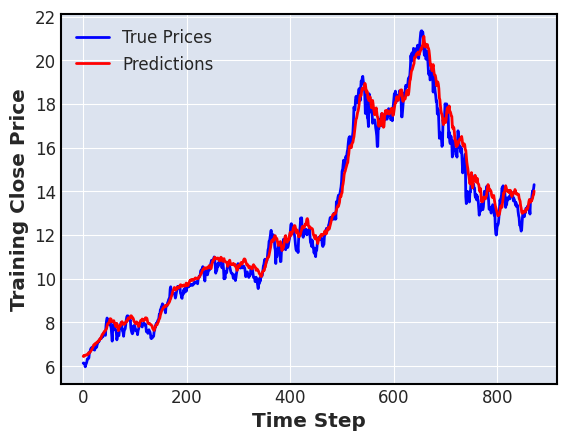

28/28 [==============================] - 0s 2ms/step


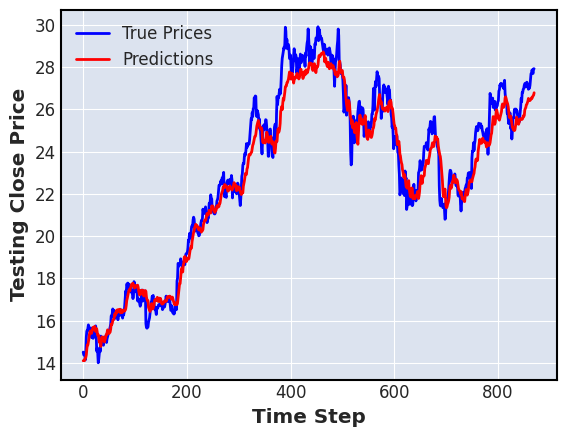

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 2s 17ms/step - loss: 2.4674e-05 - mae: 0.0033 - mse: 2.4674e-05 - mape: 26.6330 - val_loss: 1.3138e-05 - val_mae: 0.0028 - val_mse: 1.3138e-05 - val_mape: 6.0927
Epoch 2/10
28/28 [==============================] - 0s 7ms/step - loss: 4.0704e-06 - mae: 0.0016 - mse: 4.0704e-06 - mape: 11.8060 - val_loss: 6.3550e-06 - val_mae: 0.0020 - val_mse: 6.3550e-06 - val_mape: 4.4653
Epoch 3/10
28/28 [==============================] - 0s 10ms/step - loss: 3.1845e-06 - mae: 0.0014 - mse: 3.1845e-06 - mape: 9.9359 - val_loss: 5.5402e-06 - val_mae: 0.0018 - val_mse: 5.5402e-06 - val_mape: 4.0585
Epoch 4/10
28/28 [==============================] - 0s 7ms/step - loss: 2.8626e-06 - mae: 0.0013 - mse: 2.8626e-06 - mape: 8.3483 - val_loss: 5.1682e-06 - val_mae: 0.0018 - val_mse: 5.1682e-06 - val_mape: 3.9029
Epoch 5/10
28/28 [==============================] - 0s 7ms/step - loss: 3.

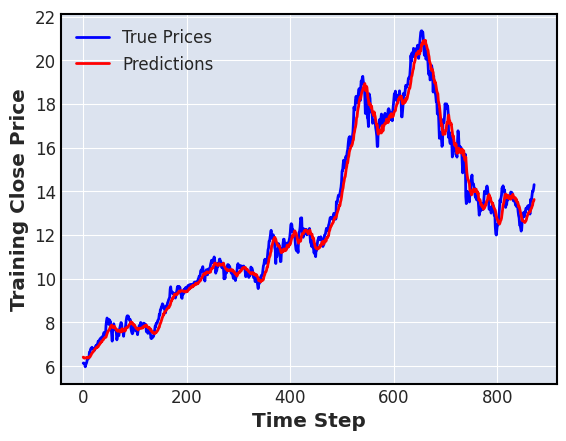

28/28 [==============================] - 0s 2ms/step


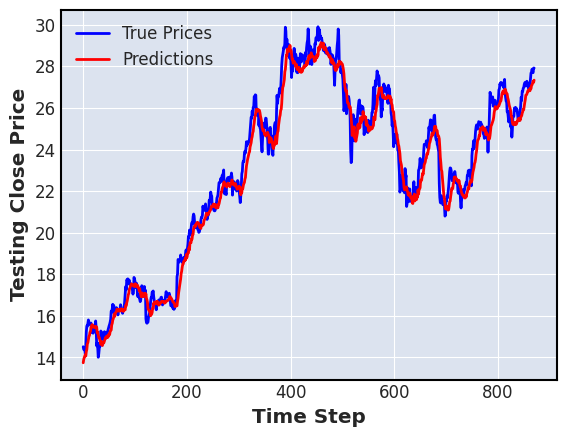

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 2s 10ms/step - loss: 8.5228e-05 - mae: 0.0050 - mse: 8.5228e-05 - mape: 23.8626 - val_loss: 1.0058e-04 - val_mae: 0.0072 - val_mse: 1.0058e-04 - val_mape: 5.7452
Epoch 2/10
55/55 [==============================] - 0s 5ms/step - loss: 4.7375e-06 - mae: 0.0016 - mse: 4.7375e-06 - mape: 6.6984 - val_loss: 7.4045e-05 - val_mae: 0.0060 - val_mse: 7.4045e-05 - val_mape: 4.7113
Epoch 3/10
55/55 [==============================] - 0s 5ms/step - loss: 3.3580e-06 - mae: 0.0014 - mse: 3.3580e-06 - mape: 5.7231 - val_loss: 6.1057e-05 - val_mae: 0.0053 - val_mse: 6.1057e-05 - val_mape: 4.0774
Epoch 4/10
55/55 [==============================] - 0s 5ms/step - loss: 2.5089e-06 - mae: 0.0012 - mse: 2.5089e-06 - mape: 5.0475 - val_loss: 4.7681e-05 - val_mae: 0.0044 - val_mse: 4.7681e-05 - val_mape: 3.3212
Epoch 5/10
55/55 [==============================] - 0s 4ms/st

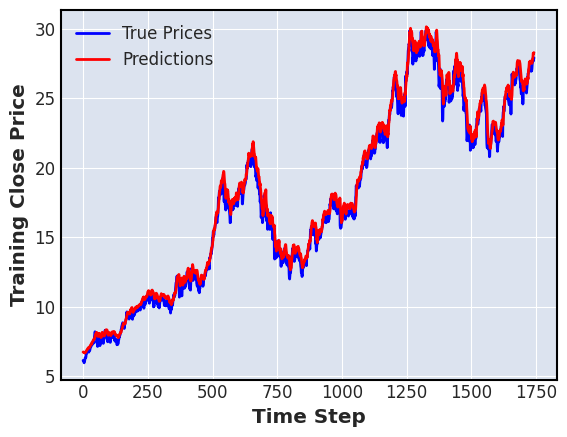

28/28 [==============================] - 0s 2ms/step


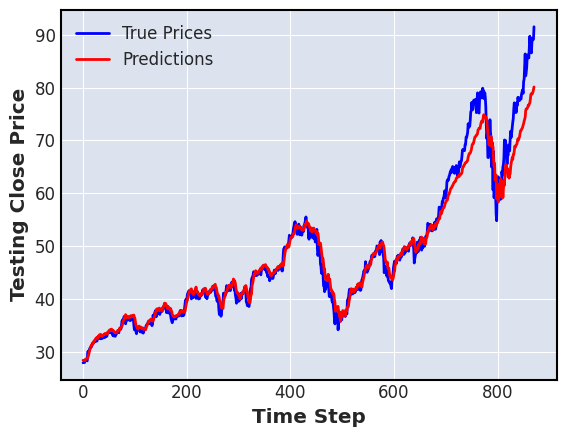

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 2s 9ms/step - loss: 5.7820e-05 - mae: 0.0049 - mse: 5.7820e-05 - mape: 23.4967 - val_loss: 2.0076e-04 - val_mae: 0.0110 - val_mse: 2.0076e-04 - val_mape: 8.8267
Epoch 2/10
55/55 [==============================] - 0s 5ms/step - loss: 6.5614e-06 - mae: 0.0020 - mse: 6.5614e-06 - mape: 7.8522 - val_loss: 1.5505e-04 - val_mae: 0.0098 - val_mse: 1.5505e-04 - val_mape: 7.8402
Epoch 3/10
55/55 [==============================] - 0s 4ms/step - loss: 5.6380e-06 - mae: 0.0018 - mse: 5.6380e-06 - mape: 7.2368 - val_loss: 1.1759e-04 - val_mae: 0.0084 - val_mse: 1.1759e-04 - val_mape: 6.7885
Epoch 4/10
55/55 [==============================] - 0s 4ms/step - loss: 4.4632e-06 - mae: 0.0016 - mse: 4.4632e-06 - mape: 6.5717 - val_loss: 9.1837e-05 - val_mae: 0.0073 - val_mse: 9.1837e-05 - val_mape: 5.8472
Epoch 5/10
55/55 [==============================] - 0s 4ms/step - loss: 3.565

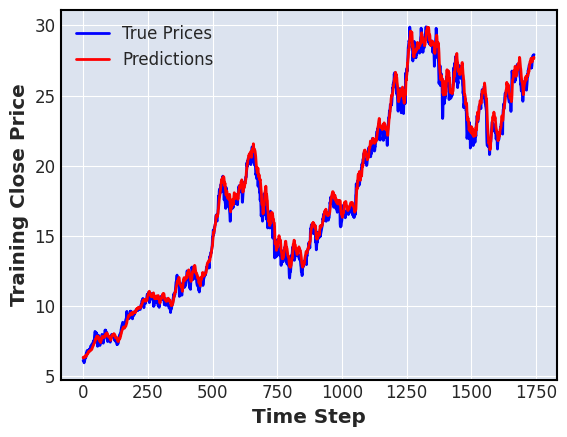

28/28 [==============================] - 0s 2ms/step


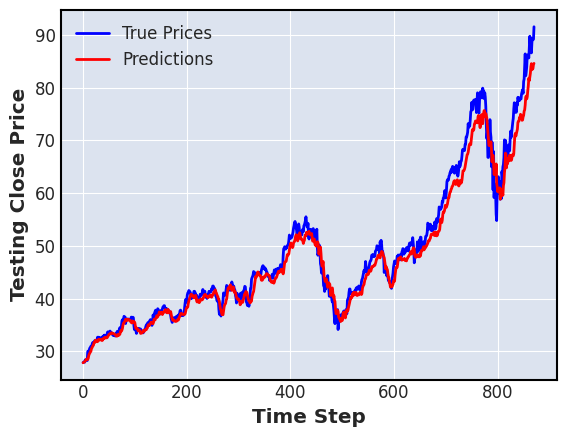

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 2s 9ms/step - loss: 3.3179e-05 - mae: 0.0035 - mse: 3.3179e-05 - mape: 17.4928 - val_loss: 4.5529e-05 - val_mae: 0.0048 - val_mse: 4.5529e-05 - val_mape: 3.9955
Epoch 2/10
55/55 [==============================] - 0s 4ms/step - loss: 3.5343e-06 - mae: 0.0014 - mse: 3.5343e-06 - mape: 6.1163 - val_loss: 4.7484e-05 - val_mae: 0.0051 - val_mse: 4.7484e-05 - val_mape: 4.0901
Epoch 3/10
55/55 [==============================] - 0s 5ms/step - loss: 3.1075e-06 - mae: 0.0014 - mse: 3.1075e-06 - mape: 5.8266 - val_loss: 6.8635e-05 - val_mae: 0.0064 - val_mse: 6.8635e-05 - val_mape: 5.1111
Epoch 4/10
55/55 [==============================] - 0s 5ms/step - loss: 3.5306e-06 - mae: 0.0015 - mse: 3.5306e-06 - mape: 6.5411 - val_loss: 4.1693e-05 - val_mae: 0.0046 - val_mse: 4.1693e-05 - val_mape: 3.6375
Epoch 5/10
55/55 [==============================] - 0s 5ms/step - loss: 2.454

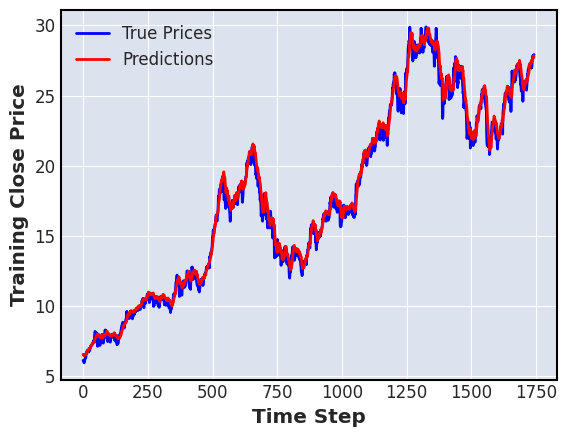

28/28 [==============================] - 0s 2ms/step


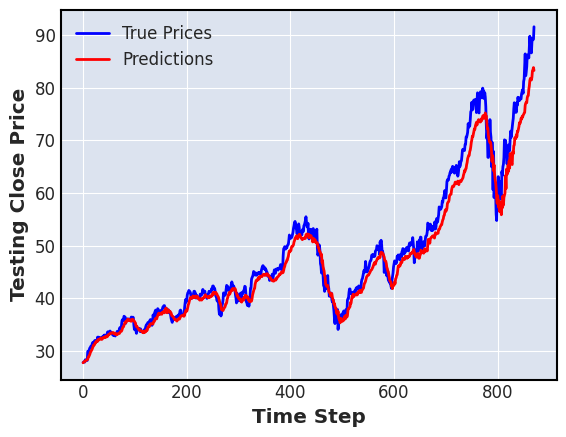

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 2s 7ms/step - loss: 4.2494e-04 - mae: 0.0098 - mse: 4.2494e-04 - mape: 26.6341 - val_loss: 3.7295e-04 - val_mae: 0.0154 - val_mse: 3.7295e-04 - val_mape: 4.1880
Epoch 2/10
82/82 [==============================] - 0s 4ms/step - loss: 2.0144e-05 - mae: 0.0028 - mse: 2.0144e-05 - mape: 6.6891 - val_loss: 2.2704e-04 - val_mae: 0.0124 - val_mse: 2.2704e-04 - val_mape: 3.3071
Epoch 3/10
82/82 [==============================] - 0s 4ms/step - loss: 1.0743e-05 - mae: 0.0021 - mse: 1.0743e-05 - mape: 4.9362 - val_loss: 1.6822e-04 - val_mae: 0.0105 - val_mse: 1.6822e-04 - val_mape: 2.8155
Epoch 4/10
82/82 [==============================] - 0s 4ms/step - loss: 9.9879e-06 - mae: 0.0022 - mse: 9.9879e-06 - mape: 5.4367 - val_loss: 1.6882e-04 - val_mae: 0.0105 - val_mse: 1.6882e-04 - val_mape: 2.8147
Epoch 5/10
82/82 [==============================] - 0s 4ms/ste

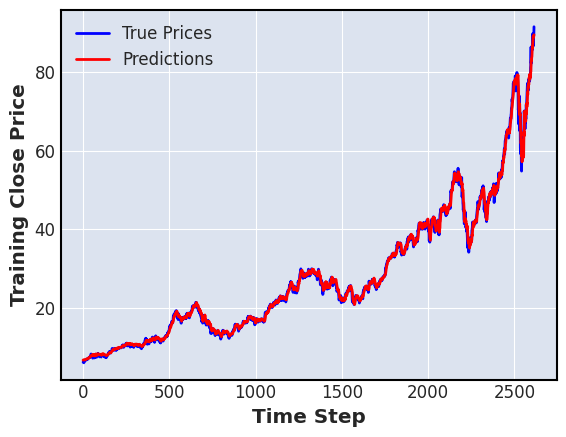

28/28 [==============================] - 0s 2ms/step


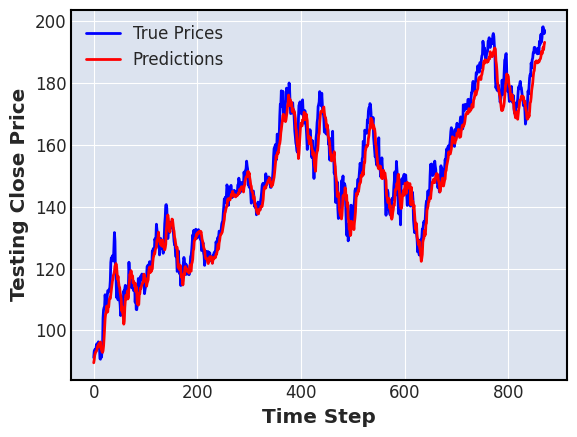

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 2s 7ms/step - loss: 2.1057e-04 - mae: 0.0084 - mse: 2.1057e-04 - mape: 23.2485 - val_loss: 5.0296e-04 - val_mae: 0.0178 - val_mse: 5.0296e-04 - val_mape: 4.8448
Epoch 2/10
82/82 [==============================] - 0s 4ms/step - loss: 3.0167e-05 - mae: 0.0034 - mse: 3.0167e-05 - mape: 7.7623 - val_loss: 3.7927e-04 - val_mae: 0.0158 - val_mse: 3.7927e-04 - val_mape: 4.2567
Epoch 3/10
82/82 [==============================] - 0s 4ms/step - loss: 2.2662e-05 - mae: 0.0030 - mse: 2.2662e-05 - mape: 6.7363 - val_loss: 4.1504e-04 - val_mae: 0.0157 - val_mse: 4.1504e-04 - val_mape: 4.2972
Epoch 4/10
82/82 [==============================] - 0s 4ms/step - loss: 1.6114e-05 - mae: 0.0026 - mse: 1.6114e-05 - mape: 6.1770 - val_loss: 4.8402e-04 - val_mae: 0.0177 - val_mse: 4.8402e-04 - val_mape: 4.8020
Epoch 5/10
82/82 [==============================] - 0s 4ms/step - loss: 1.329

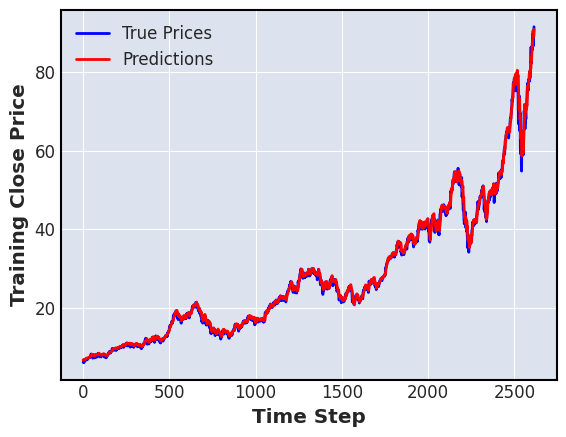

28/28 [==============================] - 0s 2ms/step


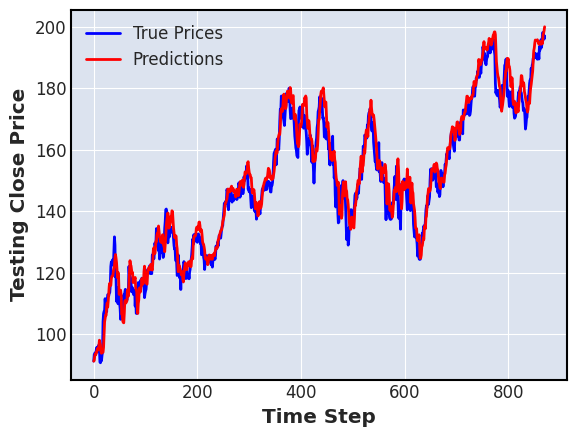

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 2s 7ms/step - loss: 1.1261e-04 - mae: 0.0053 - mse: 1.1261e-04 - mape: 15.9353 - val_loss: 2.8078e-04 - val_mae: 0.0129 - val_mse: 2.8078e-04 - val_mape: 3.5290
Epoch 2/10
82/82 [==============================] - 0s 4ms/step - loss: 1.4579e-05 - mae: 0.0026 - mse: 1.4579e-05 - mape: 7.6795 - val_loss: 1.9936e-04 - val_mae: 0.0111 - val_mse: 1.9936e-04 - val_mape: 3.0109
Epoch 3/10
82/82 [==============================] - 0s 4ms/step - loss: 1.0214e-05 - mae: 0.0021 - mse: 1.0214e-05 - mape: 5.8452 - val_loss: 1.8031e-04 - val_mae: 0.0105 - val_mse: 1.8031e-04 - val_mape: 2.8612
Epoch 4/10
82/82 [==============================] - 0s 4ms/step - loss: 9.0557e-06 - mae: 0.0020 - mse: 9.0557e-06 - mape: 5.3620 - val_loss: 2.0785e-04 - val_mae: 0.0113 - val_mse: 2.0785e-04 - val_mape: 3.0536
Epoch 5/10
82/82 [==============================] - 0s 4ms/step - loss: 1.134

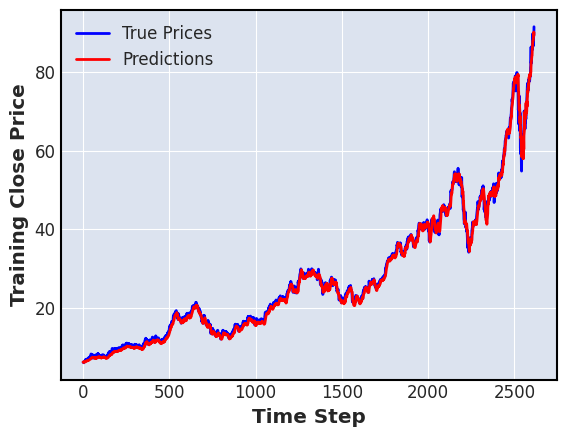

28/28 [==============================] - 0s 2ms/step


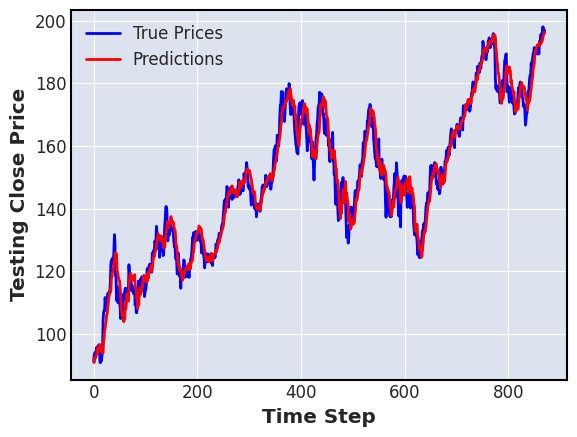

---------------------------------------------------------------
ticker_name :  MSFT Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 1s 15ms/step - loss: 2.7424e-04 - mae: 0.0119 - mse: 2.7424e-04 - mape: 26.8641 - val_loss: 0.0014 - val_mae: 0.0351 - val_mse: 0.0014 - val_mape: 35.9654
Epoch 2/10
28/28 [==============================] - 0s 6ms/step - loss: 2.6673e-05 - mae: 0.0041 - mse: 2.6673e-05 - mape: 9.1260 - val_loss: 9.9061e-04 - val_mae: 0.0289 - val_mse: 9.9061e-04 - val_mape: 29.2576
Epoch 3/10
28/28 [==============================] - 0s 7ms/step - loss: 1.9688e-05 - mae: 0.0035 - mse: 1.9688e-05 - mape: 7.7946 - val_loss: 7.8289e-04 - val_mae: 0.0255 - val_mse: 7.8289e-04 - val_mape: 25.6408
Epoch 4/10
28/28 [==============================] - 0s 6ms/step - loss: 1.8044e-05 - mae: 0.0033 - mse: 1.8044e-05 - mape: 7.5987 - val_loss: 6.7995e-04 - val_mae: 0.0238 - val_mse: 6.7995e-04 - val_mape: 23.9149
Epoch 5/10
28/28 [===

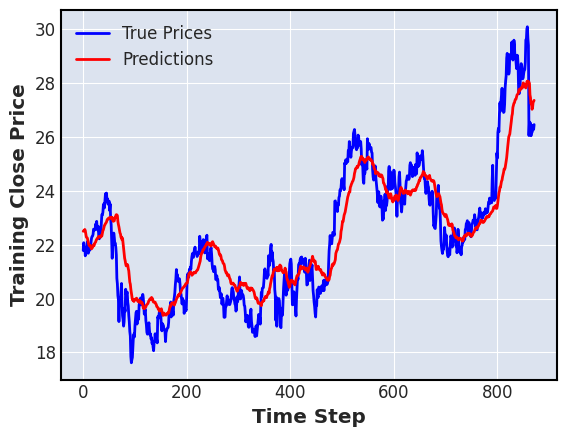

28/28 [==============================] - 0s 2ms/step


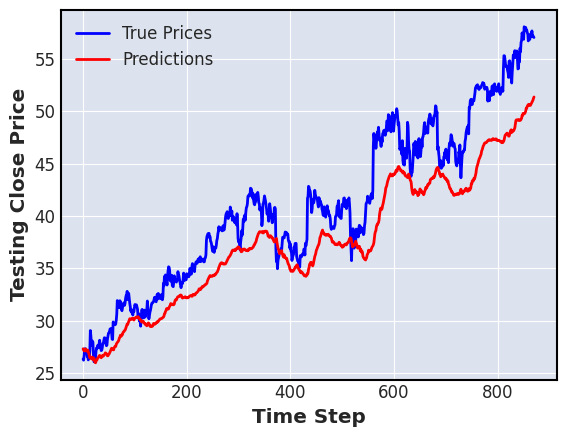

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 2s 16ms/step - loss: 1.6530e-04 - mae: 0.0094 - mse: 1.6530e-04 - mape: 21.2758 - val_loss: 2.7453e-04 - val_mae: 0.0141 - val_mse: 2.7453e-04 - val_mape: 13.7134
Epoch 2/10
28/28 [==============================] - 0s 6ms/step - loss: 1.6787e-05 - mae: 0.0032 - mse: 1.6787e-05 - mape: 7.1791 - val_loss: 3.6914e-04 - val_mae: 0.0172 - val_mse: 3.6914e-04 - val_mape: 17.2038
Epoch 3/10
28/28 [==============================] - 0s 6ms/step - loss: 1.2536e-05 - mae: 0.0028 - mse: 1.2536e-05 - mape: 6.2413 - val_loss: 2.8827e-04 - val_mae: 0.0152 - val_mse: 2.8827e-04 - val_mape: 15.2264
Epoch 4/10
28/28 [==============================] - 0s 7ms/step - loss: 1.0019e-05 - mae: 0.0024 - mse: 1.0019e-05 - mape: 5.4859 - val_loss: 1.3622e-04 - val_mae: 0.0099 - val_mse: 1.3622e-04 - val_mape: 9.7893
Epoch 5/10
28/28 [==============================] - 0s 6ms/step - loss: 8

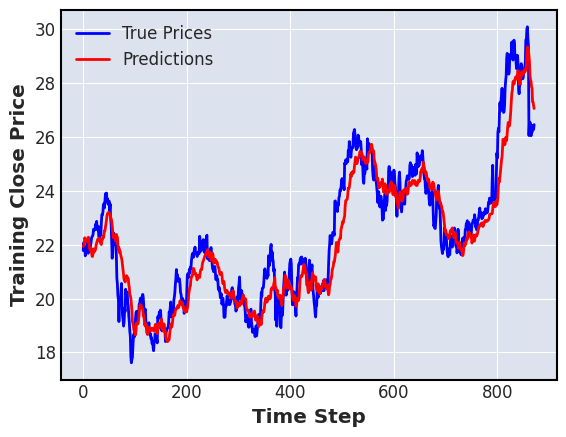

28/28 [==============================] - 0s 2ms/step


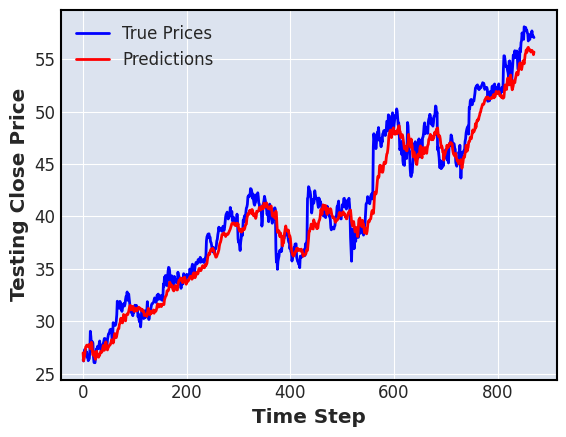

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 2s 16ms/step - loss: 1.0506e-04 - mae: 0.0071 - mse: 1.0506e-04 - mape: 16.1055 - val_loss: 5.6371e-04 - val_mae: 0.0222 - val_mse: 5.6371e-04 - val_mape: 22.7023
Epoch 2/10
28/28 [==============================] - 0s 9ms/step - loss: 9.7054e-06 - mae: 0.0024 - mse: 9.7054e-06 - mape: 5.4423 - val_loss: 2.4252e-04 - val_mae: 0.0142 - val_mse: 2.4252e-04 - val_mape: 14.3553
Epoch 3/10
28/28 [==============================] - 0s 6ms/step - loss: 6.5337e-06 - mae: 0.0020 - mse: 6.5337e-06 - mape: 4.5726 - val_loss: 1.0695e-04 - val_mae: 0.0090 - val_mse: 1.0695e-04 - val_mape: 9.0084
Epoch 4/10
28/28 [==============================] - 0s 6ms/step - loss: 5.3946e-06 - mae: 0.0018 - mse: 5.3946e-06 - mape: 4.1354 - val_loss: 6.6501e-05 - val_mae: 0.0070 - val_mse: 6.6501e-05 - val_mape: 6.9922
Epoch 5/10
28/28 [==============================] - 0s 6ms/step - loss: 4.

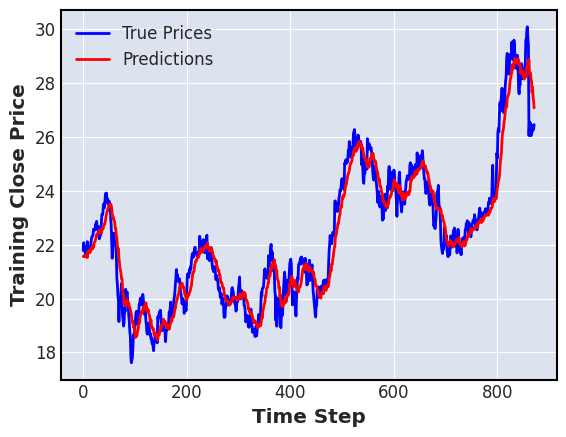

28/28 [==============================] - 0s 2ms/step


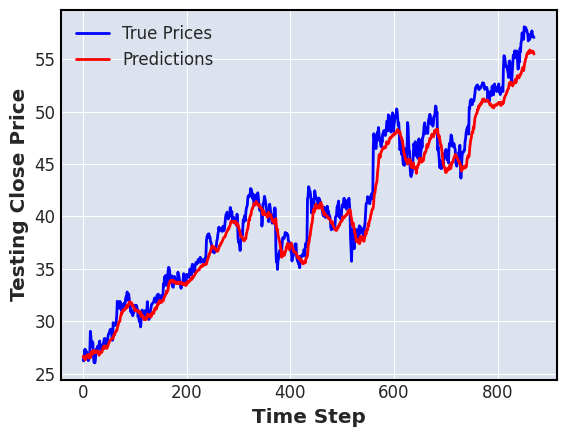

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 2s 9ms/step - loss: 4.7138e-04 - mae: 0.0131 - mse: 4.7138e-04 - mape: 20.3404 - val_loss: 3.8844e-04 - val_mae: 0.0135 - val_mse: 3.8844e-04 - val_mape: 4.2718
Epoch 2/10
55/55 [==============================] - 0s 6ms/step - loss: 1.3885e-05 - mae: 0.0027 - mse: 1.3885e-05 - mape: 4.1497 - val_loss: 2.5295e-04 - val_mae: 0.0099 - val_mse: 2.5295e-04 - val_mape: 3.1165
Epoch 3/10
55/55 [==============================] - 0s 5ms/step - loss: 1.3074e-05 - mae: 0.0027 - mse: 1.3074e-05 - mape: 4.0720 - val_loss: 2.4321e-04 - val_mae: 0.0097 - val_mse: 2.4321e-04 - val_mape: 3.0526
Epoch 4/10
55/55 [==============================] - 0s 5ms/step - loss: 1.2567e-05 - mae: 0.0026 - mse: 1.2567e-05 - mape: 3.9320 - val_loss: 2.4955e-04 - val_mae: 0.0100 - val_mse: 2.4955e-04 - val_mape: 3.1070
Epoch 5/10
55/55 [==============================] - 0s 5ms/ste

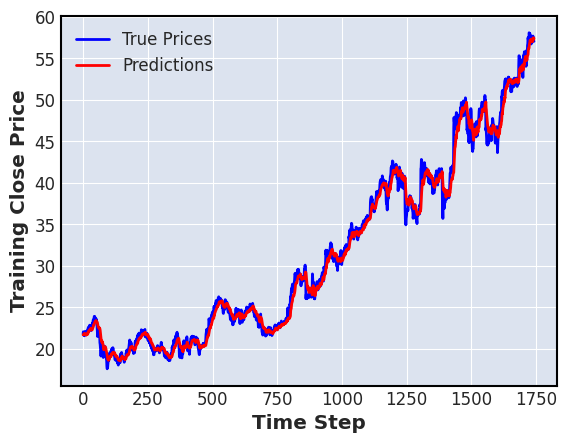

28/28 [==============================] - 0s 2ms/step


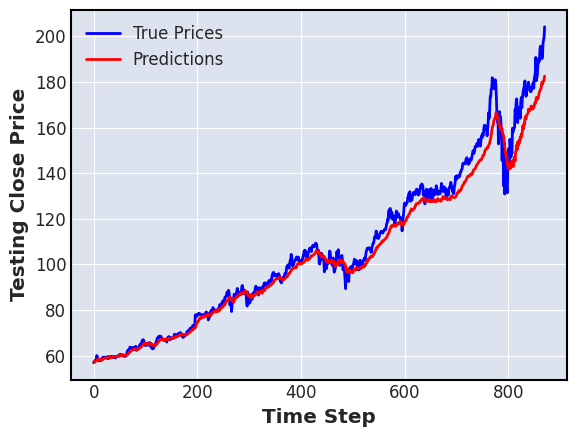

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 1s 8ms/step - loss: 2.3722e-04 - mae: 0.0097 - mse: 2.3722e-04 - mape: 15.5490 - val_loss: 2.4110e-04 - val_mae: 0.0096 - val_mse: 2.4110e-04 - val_mape: 3.1020
Epoch 2/10
55/55 [==============================] - 0s 5ms/step - loss: 1.7271e-05 - mae: 0.0031 - mse: 1.7271e-05 - mape: 4.6912 - val_loss: 2.4132e-04 - val_mae: 0.0098 - val_mse: 2.4132e-04 - val_mape: 3.1446
Epoch 3/10
55/55 [==============================] - 0s 5ms/step - loss: 1.6658e-05 - mae: 0.0031 - mse: 1.6658e-05 - mape: 4.6582 - val_loss: 2.0415e-04 - val_mae: 0.0089 - val_mse: 2.0415e-04 - val_mape: 3.0321
Epoch 4/10
55/55 [==============================] - 0s 4ms/step - loss: 1.4251e-05 - mae: 0.0028 - mse: 1.4251e-05 - mape: 4.2583 - val_loss: 3.0227e-04 - val_mae: 0.0117 - val_mse: 3.0227e-04 - val_mape: 3.7018
Epoch 5/10
55/55 [==============================] - 0s 5ms/step - loss: 1.341

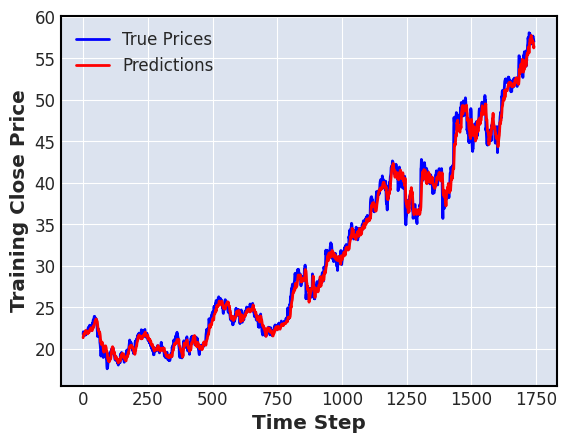

28/28 [==============================] - 0s 2ms/step


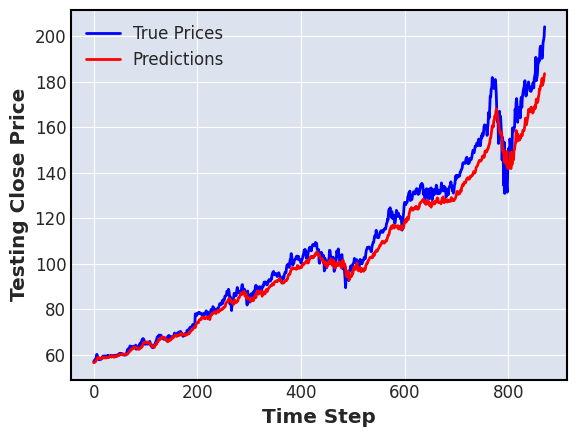

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 2s 9ms/step - loss: 1.6802e-04 - mae: 0.0077 - mse: 1.6802e-04 - mape: 12.0452 - val_loss: 1.3456e-04 - val_mae: 0.0067 - val_mse: 1.3456e-04 - val_mape: 2.3013
Epoch 2/10
55/55 [==============================] - 0s 4ms/step - loss: 8.2496e-06 - mae: 0.0021 - mse: 8.2496e-06 - mape: 3.2255 - val_loss: 1.2581e-04 - val_mae: 0.0069 - val_mse: 1.2581e-04 - val_mape: 2.2894
Epoch 3/10
55/55 [==============================] - 0s 4ms/step - loss: 7.1319e-06 - mae: 0.0019 - mse: 7.1319e-06 - mape: 2.9127 - val_loss: 1.1631e-04 - val_mae: 0.0067 - val_mse: 1.1631e-04 - val_mape: 2.2353
Epoch 4/10
55/55 [==============================] - 0s 4ms/step - loss: 6.5714e-06 - mae: 0.0018 - mse: 6.5714e-06 - mape: 2.7682 - val_loss: 1.0417e-04 - val_mae: 0.0062 - val_mse: 1.0417e-04 - val_mape: 2.2169
Epoch 5/10
55/55 [==============================] - 0s 4ms/step - loss: 6.532

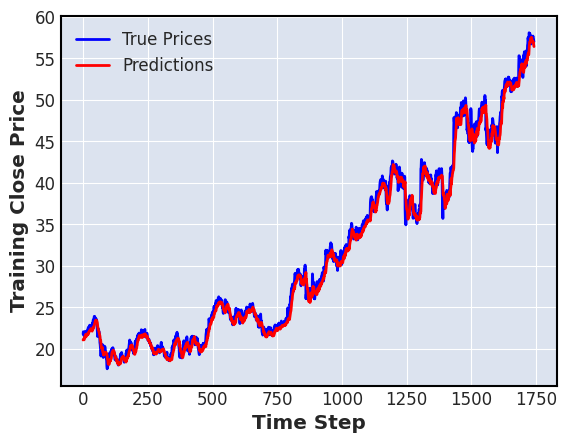

28/28 [==============================] - 0s 2ms/step


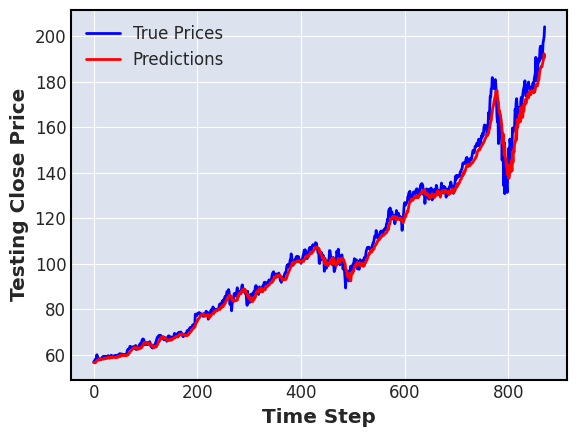

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 2s 6ms/step - loss: 0.0028 - mae: 0.0251 - mse: 0.0028 - mape: 22.6442 - val_loss: 0.0014 - val_mae: 0.0299 - val_mse: 0.0014 - val_mape: 4.1639
Epoch 2/10
82/82 [==============================] - 0s 4ms/step - loss: 8.6038e-05 - mae: 0.0051 - mse: 8.6038e-05 - mape: 4.3643 - val_loss: 0.0012 - val_mae: 0.0283 - val_mse: 0.0012 - val_mape: 4.0703
Epoch 3/10
82/82 [==============================] - 0s 4ms/step - loss: 7.6992e-05 - mae: 0.0048 - mse: 7.6992e-05 - mape: 4.1014 - val_loss: 0.0011 - val_mae: 0.0263 - val_mse: 0.0011 - val_mape: 3.7529
Epoch 4/10
82/82 [==============================] - 0s 4ms/step - loss: 6.5505e-05 - mae: 0.0047 - mse: 6.5505e-05 - mape: 4.2217 - val_loss: 9.4131e-04 - val_mae: 0.0244 - val_mse: 9.4131e-04 - val_mape: 3.4795
Epoch 5/10
82/82 [==============================] - 0s 4ms/step - loss: 5.4625e-05 - mae: 0.00

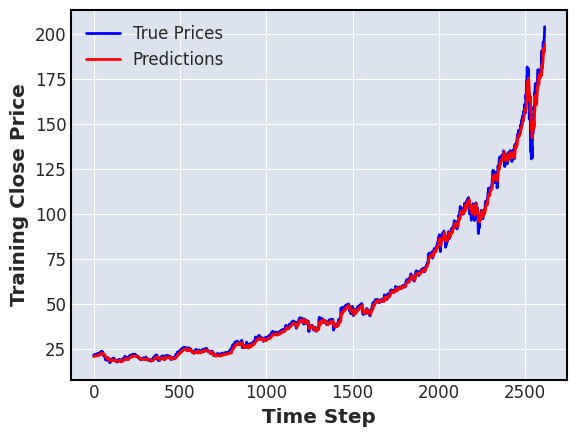

28/28 [==============================] - 0s 2ms/step


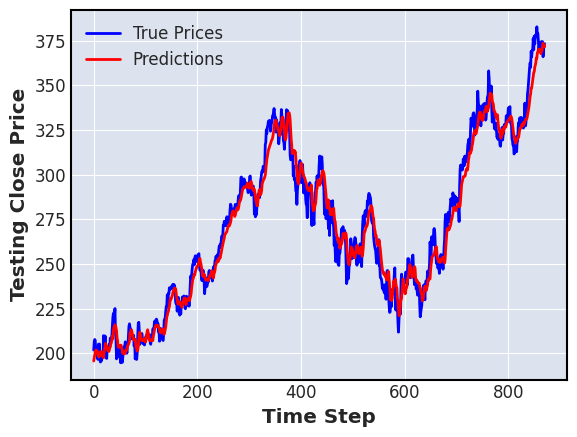

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 2s 7ms/step - loss: 0.0011 - mae: 0.0166 - mse: 0.0011 - mape: 15.1113 - val_loss: 0.0015 - val_mae: 0.0306 - val_mse: 0.0015 - val_mape: 4.4202
Epoch 2/10
82/82 [==============================] - 0s 3ms/step - loss: 7.4126e-05 - mae: 0.0049 - mse: 7.4126e-05 - mape: 4.0499 - val_loss: 0.0011 - val_mae: 0.0268 - val_mse: 0.0011 - val_mape: 3.7479
Epoch 3/10
82/82 [==============================] - 0s 4ms/step - loss: 4.7690e-05 - mae: 0.0039 - mse: 4.7690e-05 - mape: 3.2896 - val_loss: 8.5666e-04 - val_mae: 0.0227 - val_mse: 8.5666e-04 - val_mape: 3.3115
Epoch 4/10
82/82 [==============================] - 0s 4ms/step - loss: 4.6901e-05 - mae: 0.0041 - mse: 4.6901e-05 - mape: 3.3997 - val_loss: 0.0029 - val_mae: 0.0479 - val_mse: 0.0029 - val_mape: 6.9533
Epoch 5/10
82/82 [==============================] - 0s 4ms/step - loss: 4.3203e-05 - mae: 0.0041 - mse: 4.320

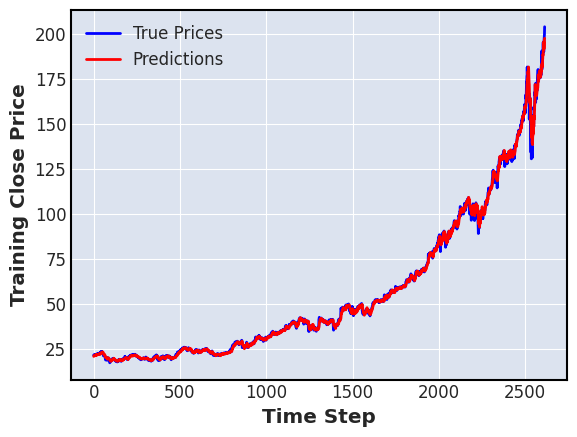

28/28 [==============================] - 0s 2ms/step


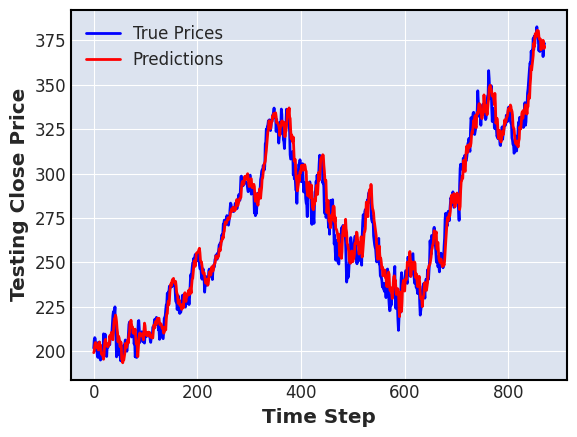

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 2s 7ms/step - loss: 6.7584e-04 - mae: 0.0113 - mse: 6.7584e-04 - mape: 10.4243 - val_loss: 6.0234e-04 - val_mae: 0.0193 - val_mse: 6.0234e-04 - val_mape: 2.7780
Epoch 2/10
82/82 [==============================] - 0s 4ms/step - loss: 5.2037e-05 - mae: 0.0044 - mse: 5.2037e-05 - mape: 3.6573 - val_loss: 6.4959e-04 - val_mae: 0.0201 - val_mse: 6.4959e-04 - val_mape: 2.9088
Epoch 3/10
82/82 [==============================] - 0s 4ms/step - loss: 4.1037e-05 - mae: 0.0038 - mse: 4.1037e-05 - mape: 3.3289 - val_loss: 5.6765e-04 - val_mae: 0.0188 - val_mse: 5.6765e-04 - val_mape: 2.7220
Epoch 4/10
82/82 [==============================] - 0s 4ms/step - loss: 3.3041e-05 - mae: 0.0034 - mse: 3.3041e-05 - mape: 2.9797 - val_loss: 8.6619e-04 - val_mae: 0.0233 - val_mse: 8.6619e-04 - val_mape: 3.4032
Epoch 5/10
82/82 [==============================] - 0s 4ms/step - loss: 3.409

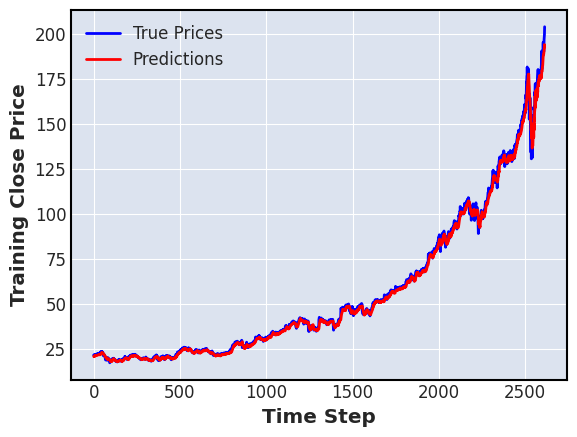

28/28 [==============================] - 0s 2ms/step


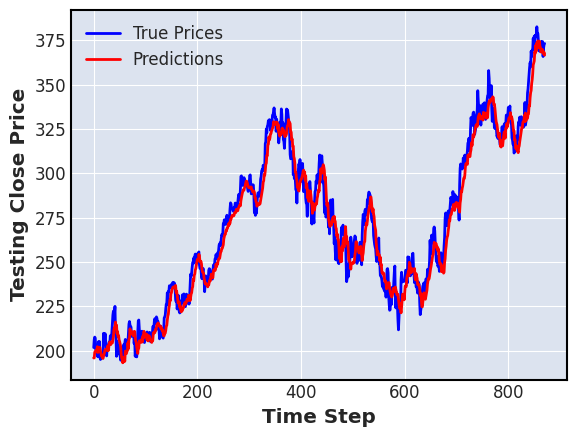

---------------------------------------------------------------


In [39]:
number_of_runs = 0
for ticker_index, ticker_name in enumerate(My_Tickers_SP500):
    full_data = x_tickers_sp500[ticker_index]
    target = y_tickers_sp500[ticker_index]
    print('ticker_name : ' ,ticker_name[0], ticker_name[1] , ' , length = ', len(full_data))
    
    # Time Series Split
    for j, (train_index, test_index) in enumerate(tss.split(full_data)):
        print('kth split : ', j)
        # Different Seeds
        for new_seed in range(3):
            print('seed : ', new_seed)
            seed_value = new_seed
            random.seed(seed_value)
            np.random.seed(seed_value)
            tf.random.set_seed(seed_value)
            utils.set_random_seed(seed_value)

            number_of_runs += 1
            
            X_train, X_val = full_data[train_index], full_data[test_index]
            y_train, y_val = target[train_index], target[test_index]

            mlp_model = StockPredictionMLPandCNN(input_size=full_data.shape[1], model='MLP')
            mlp_model.fit(X_train, y_train, X_val, y_val, epoch=10)


            train_pred = mlp_model.predict(X_train)
            train_pred = scaler.inverse_transform(train_pred.reshape(-1, 1))
            y_train = scaler.inverse_transform(y_train.reshape(-1, 1))
            plot_results(train_pred, y_train, 'Training')
            
            test_pred = mlp_model.predict(X_val)
            test_pred = scaler.inverse_transform(test_pred.reshape(-1, 1))
            y_val = scaler.inverse_transform(y_val.reshape(-1, 1))
            plot_results(test_pred, y_val, 'Testing')
            print('---------------------------------------------------------------')

### CNN

ticker_name :  AMZN Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 2s 18ms/step - loss: 1.8713e-05 - mae: 0.0033 - mse: 1.8713e-05 - mape: 4870.4102 - val_loss: 1.9798e-05 - val_mae: 0.0033 - val_mse: 1.9798e-05 - val_mape: 6.9575
Epoch 2/10
28/28 [==============================] - 0s 8ms/step - loss: 2.9304e-06 - mae: 0.0014 - mse: 2.9304e-06 - mape: 4639.0142 - val_loss: 2.4380e-05 - val_mae: 0.0034 - val_mse: 2.4380e-05 - val_mape: 6.7038
Epoch 3/10
28/28 [==============================] - 0s 8ms/step - loss: 2.0455e-06 - mae: 0.0011 - mse: 2.0455e-06 - mape: 2660.7676 - val_loss: 3.0064e-05 - val_mae: 0.0038 - val_mse: 3.0064e-05 - val_mape: 7.1851
Epoch 4/10
28/28 [==============================] - 0s 8ms/step - loss: 1.8105e-06 - mae: 0.0011 - mse: 1.8105e-06 - mape: 2377.8557 - val_loss: 2.8302e-05 - val_mae: 0.0037 - val_mse: 2.8302e-05 - val_mape: 6.9637
Epoch 5/10
28/28 [==============================] - 0s 11ms/step - los

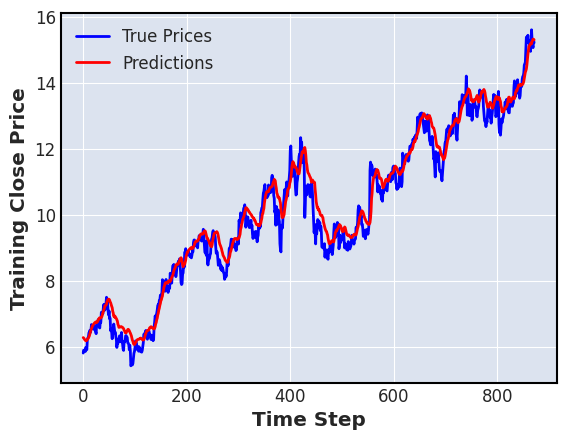

28/28 [==============================] - 0s 2ms/step


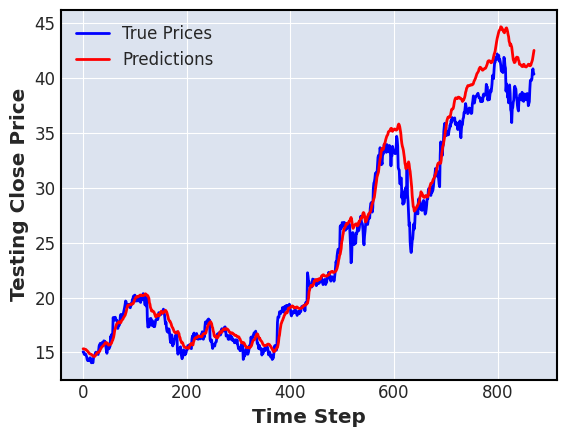

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 1s 19ms/step - loss: 2.9266e-05 - mae: 0.0039 - mse: 2.9266e-05 - mape: 11378.1768 - val_loss: 7.1734e-05 - val_mae: 0.0066 - val_mse: 7.1734e-05 - val_mape: 11.7525
Epoch 2/10
28/28 [==============================] - 0s 8ms/step - loss: 4.0196e-06 - mae: 0.0016 - mse: 4.0196e-06 - mape: 4632.2568 - val_loss: 3.0416e-05 - val_mae: 0.0044 - val_mse: 3.0416e-05 - val_mape: 8.6181
Epoch 3/10
28/28 [==============================] - 0s 8ms/step - loss: 3.3564e-06 - mae: 0.0015 - mse: 3.3564e-06 - mape: 4072.3682 - val_loss: 3.5838e-05 - val_mae: 0.0047 - val_mse: 3.5838e-05 - val_mape: 8.9894
Epoch 4/10
28/28 [==============================] - 0s 8ms/step - loss: 2.5223e-06 - mae: 0.0013 - mse: 2.5223e-06 - mape: 4103.1030 - val_loss: 3.0556e-05 - val_mae: 0.0044 - val_mse: 3.0556e-05 - val_mape: 8.3902
Epoch 5/10
28/28 [==============================] - 0s 8ms/step

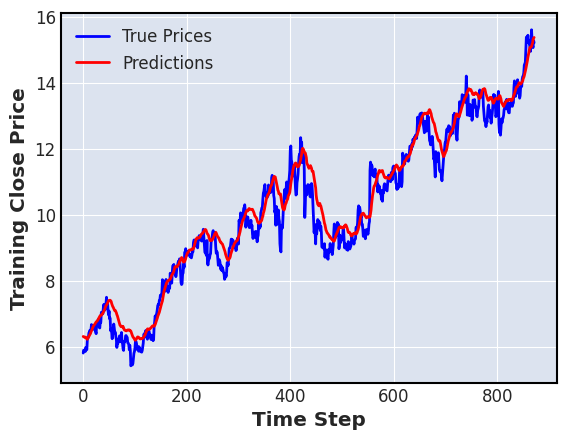

28/28 [==============================] - 0s 3ms/step


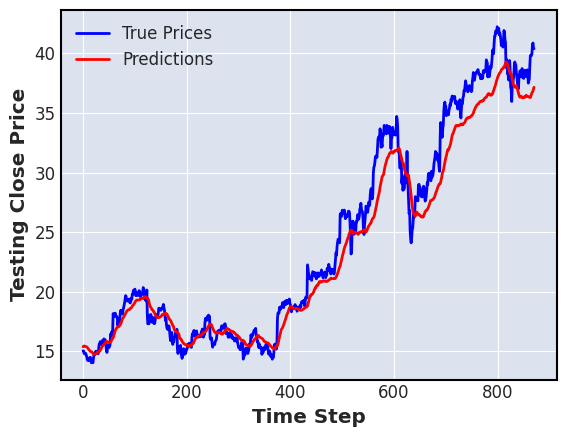

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 1s 18ms/step - loss: 1.5138e-05 - mae: 0.0028 - mse: 1.5138e-05 - mape: 6016.9238 - val_loss: 1.4404e-05 - val_mae: 0.0028 - val_mse: 1.4404e-05 - val_mape: 6.3746
Epoch 2/10
28/28 [==============================] - 0s 11ms/step - loss: 2.0539e-06 - mae: 0.0011 - mse: 2.0539e-06 - mape: 2184.4231 - val_loss: 1.3465e-05 - val_mae: 0.0027 - val_mse: 1.3465e-05 - val_mape: 5.8237
Epoch 3/10
28/28 [==============================] - 0s 7ms/step - loss: 1.8257e-06 - mae: 0.0011 - mse: 1.8257e-06 - mape: 2114.3933 - val_loss: 1.5602e-05 - val_mae: 0.0029 - val_mse: 1.5602e-05 - val_mape: 6.3402
Epoch 4/10
28/28 [==============================] - 0s 8ms/step - loss: 1.6878e-06 - mae: 0.0010 - mse: 1.6878e-06 - mape: 2415.0762 - val_loss: 1.3699e-05 - val_mae: 0.0027 - val_mse: 1.3699e-05 - val_mape: 5.8759
Epoch 5/10
28/28 [==============================] - 0s 8ms/step 

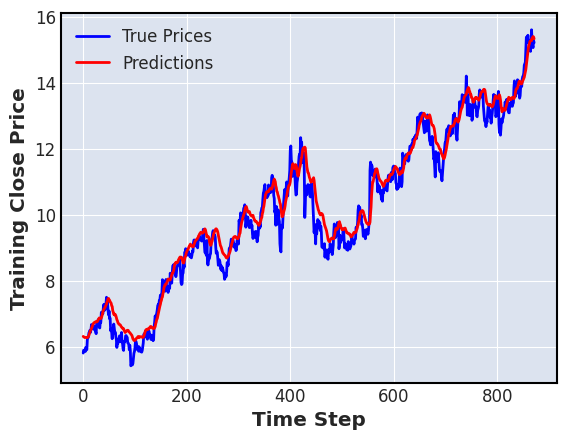

28/28 [==============================] - 0s 2ms/step


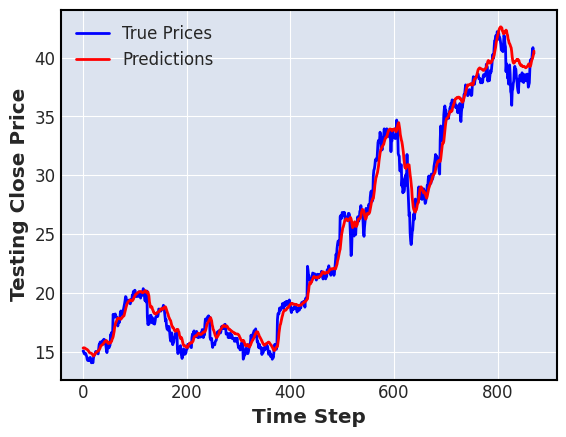

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 2s 13ms/step - loss: 5.8422e-05 - mae: 0.0046 - mse: 5.8422e-05 - mape: 3581.8420 - val_loss: 3.4184e-04 - val_mae: 0.0140 - val_mse: 3.4184e-04 - val_mape: 6.8119
Epoch 2/10
55/55 [==============================] - 0s 6ms/step - loss: 7.9643e-06 - mae: 0.0020 - mse: 7.9643e-06 - mape: 1995.9775 - val_loss: 2.0859e-04 - val_mae: 0.0103 - val_mse: 2.0859e-04 - val_mape: 5.0557
Epoch 3/10
55/55 [==============================] - 0s 6ms/step - loss: 6.5134e-06 - mae: 0.0017 - mse: 6.5134e-06 - mape: 1310.9669 - val_loss: 1.1524e-04 - val_mae: 0.0075 - val_mse: 1.1524e-04 - val_mape: 3.7825
Epoch 4/10
55/55 [==============================] - 0s 6ms/step - loss: 5.7951e-06 - mae: 0.0017 - mse: 5.7951e-06 - mape: 968.1364 - val_loss: 1.0364e-04 - val_mae: 0.0070 - val_mse: 1.0364e-04 - val_mape: 3.5513
Epoch 5/10
55/55 [==============================] -

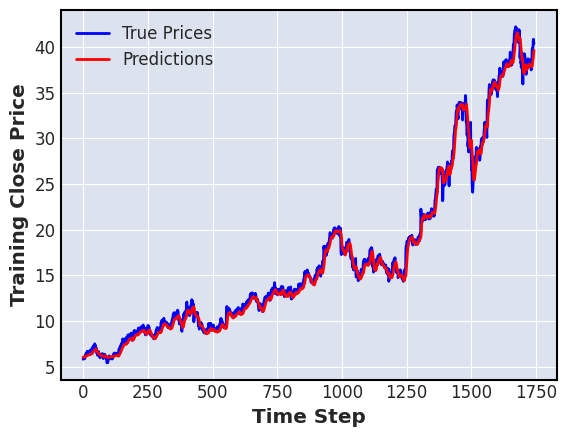

28/28 [==============================] - 0s 2ms/step


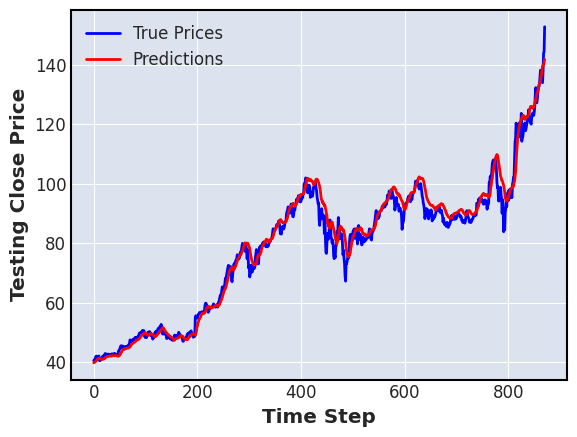

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 2s 12ms/step - loss: 8.2018e-05 - mae: 0.0054 - mse: 8.2018e-05 - mape: 12176.9746 - val_loss: 2.1395e-04 - val_mae: 0.0100 - val_mse: 2.1395e-04 - val_mape: 4.9922
Epoch 2/10
55/55 [==============================] - 0s 6ms/step - loss: 1.0940e-05 - mae: 0.0024 - mse: 1.0940e-05 - mape: 1607.7338 - val_loss: 1.8616e-04 - val_mae: 0.0100 - val_mse: 1.8616e-04 - val_mape: 4.9951
Epoch 3/10
55/55 [==============================] - 0s 7ms/step - loss: 9.4320e-06 - mae: 0.0022 - mse: 9.4320e-06 - mape: 1106.1359 - val_loss: 1.6676e-04 - val_mae: 0.0094 - val_mse: 1.6676e-04 - val_mape: 4.6003
Epoch 4/10
55/55 [==============================] - 0s 6ms/step - loss: 8.2882e-06 - mae: 0.0021 - mse: 8.2882e-06 - mape: 1988.7401 - val_loss: 1.4768e-04 - val_mae: 0.0088 - val_mse: 1.4768e-04 - val_mape: 4.3043
Epoch 5/10
55/55 [==============================] - 0s 8ms/step 

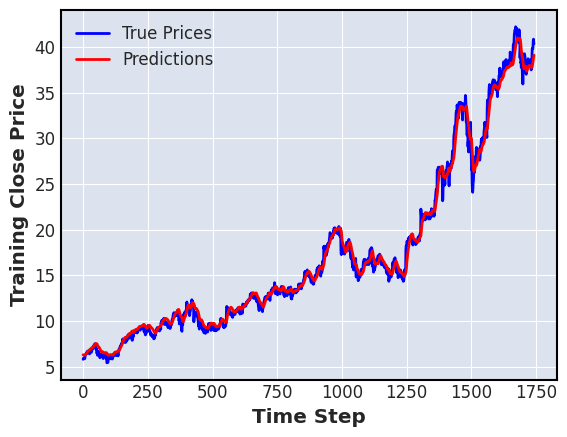

28/28 [==============================] - 0s 2ms/step


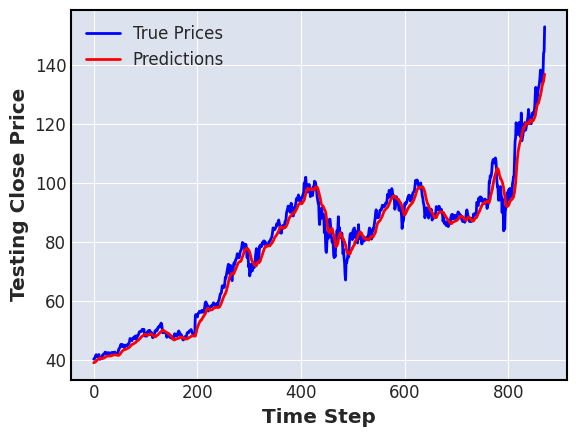

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 2s 10ms/step - loss: 6.2326e-05 - mae: 0.0048 - mse: 6.2326e-05 - mape: 1776.9420 - val_loss: 2.0431e-04 - val_mae: 0.0101 - val_mse: 2.0431e-04 - val_mape: 4.9886
Epoch 2/10
55/55 [==============================] - 0s 6ms/step - loss: 7.8955e-06 - mae: 0.0020 - mse: 7.8955e-06 - mape: 1606.7390 - val_loss: 1.4518e-04 - val_mae: 0.0083 - val_mse: 1.4518e-04 - val_mape: 4.1509
Epoch 3/10
55/55 [==============================] - 0s 7ms/step - loss: 6.4281e-06 - mae: 0.0017 - mse: 6.4281e-06 - mape: 1617.6235 - val_loss: 1.1236e-04 - val_mae: 0.0074 - val_mse: 1.1236e-04 - val_mape: 3.7412
Epoch 4/10
55/55 [==============================] - 0s 6ms/step - loss: 5.5806e-06 - mae: 0.0016 - mse: 5.5806e-06 - mape: 1873.8513 - val_loss: 1.2244e-04 - val_mae: 0.0076 - val_mse: 1.2244e-04 - val_mape: 3.7555
Epoch 5/10
55/55 [==============================] - 0s 7ms/step -

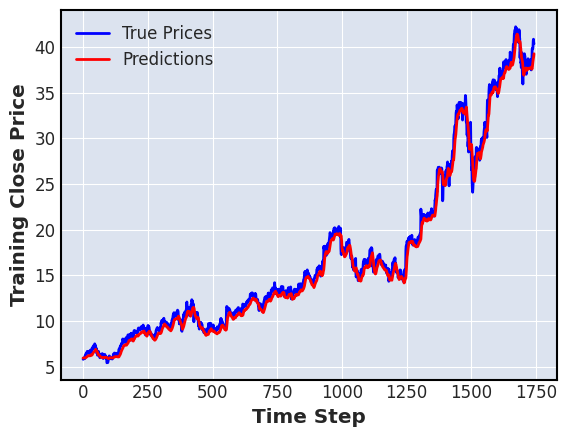

28/28 [==============================] - 0s 2ms/step


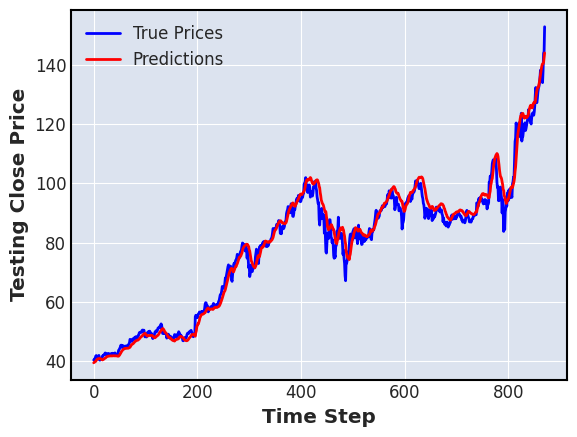

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 2s 9ms/step - loss: 3.9936e-04 - mae: 0.0103 - mse: 3.9936e-04 - mape: 4555.1509 - val_loss: 8.0756e-04 - val_mae: 0.0217 - val_mse: 8.0756e-04 - val_mape: 6.4578
Epoch 2/10
82/82 [==============================] - 0s 6ms/step - loss: 5.4402e-05 - mae: 0.0043 - mse: 5.4402e-05 - mape: 1693.2460 - val_loss: 5.6917e-04 - val_mae: 0.0180 - val_mse: 5.6917e-04 - val_mape: 5.3812
Epoch 3/10
82/82 [==============================] - 0s 6ms/step - loss: 4.4714e-05 - mae: 0.0039 - mse: 4.4714e-05 - mape: 878.3173 - val_loss: 4.7611e-04 - val_mae: 0.0165 - val_mse: 4.7611e-04 - val_mape: 4.9138
Epoch 4/10
82/82 [==============================] - 0s 6ms/step - loss: 3.7454e-05 - mae: 0.0037 - mse: 3.7454e-05 - mape: 1478.1141 - val_loss: 4.1678e-04 - val_mae: 0.0154 - val_mse: 4.1678e-04 - val_mape: 4.5758
Epoch 5/10
82/82 [==============================] - 

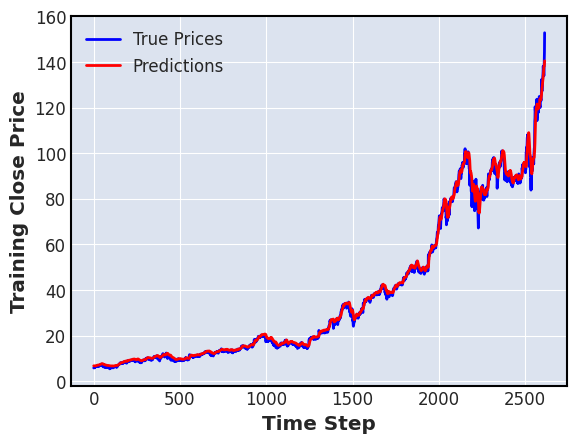

28/28 [==============================] - 0s 2ms/step


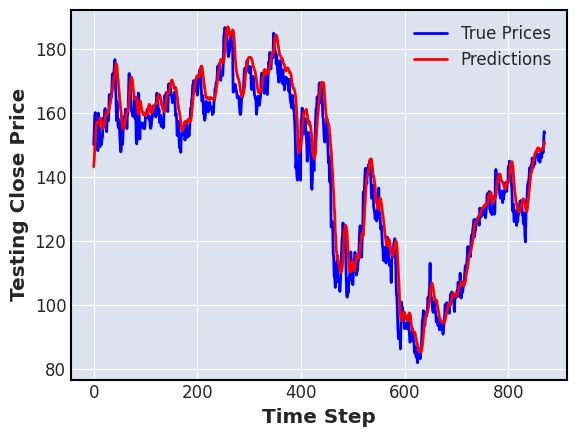

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 2s 9ms/step - loss: 7.1874e-04 - mae: 0.0141 - mse: 7.1874e-04 - mape: 14318.6855 - val_loss: 9.9125e-04 - val_mae: 0.0237 - val_mse: 9.9125e-04 - val_mape: 7.0945
Epoch 2/10
82/82 [==============================] - 1s 6ms/step - loss: 6.8645e-05 - mae: 0.0048 - mse: 6.8645e-05 - mape: 1427.6685 - val_loss: 8.4755e-04 - val_mae: 0.0219 - val_mse: 8.4755e-04 - val_mape: 6.5565
Epoch 3/10
82/82 [==============================] - 0s 6ms/step - loss: 6.4708e-05 - mae: 0.0049 - mse: 6.4708e-05 - mape: 1098.2950 - val_loss: 8.0660e-04 - val_mae: 0.0214 - val_mse: 8.0660e-04 - val_mape: 6.3808
Epoch 4/10
82/82 [==============================] - 0s 5ms/step - loss: 5.6142e-05 - mae: 0.0043 - mse: 5.6142e-05 - mape: 1567.9884 - val_loss: 5.6810e-04 - val_mae: 0.0182 - val_mse: 5.6810e-04 - val_mape: 5.3989
Epoch 5/10
82/82 [==============================] - 0s 6ms/step -

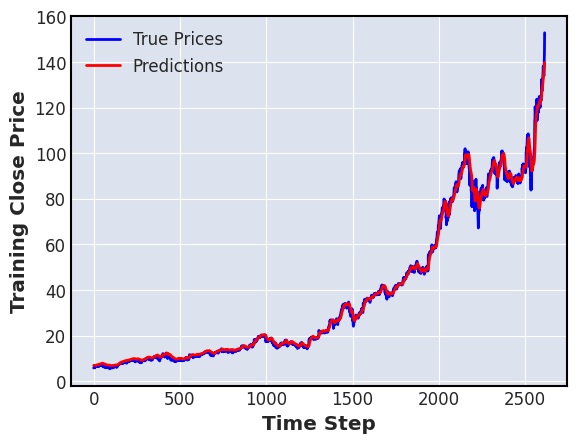

28/28 [==============================] - 0s 2ms/step


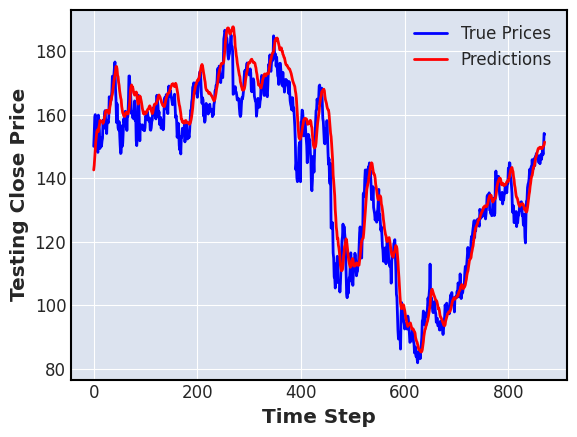

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 2s 9ms/step - loss: 3.9187e-04 - mae: 0.0098 - mse: 3.9187e-04 - mape: 3064.8562 - val_loss: 5.7360e-04 - val_mae: 0.0182 - val_mse: 5.7360e-04 - val_mape: 5.4454
Epoch 2/10
82/82 [==============================] - 0s 6ms/step - loss: 5.1852e-05 - mae: 0.0042 - mse: 5.1852e-05 - mape: 945.6167 - val_loss: 6.6286e-04 - val_mae: 0.0196 - val_mse: 6.6286e-04 - val_mape: 5.8189
Epoch 3/10
82/82 [==============================] - 1s 7ms/step - loss: 4.3147e-05 - mae: 0.0038 - mse: 4.3147e-05 - mape: 1079.8423 - val_loss: 5.7655e-04 - val_mae: 0.0183 - val_mse: 5.7655e-04 - val_mape: 5.3971
Epoch 4/10
82/82 [==============================] - 1s 7ms/step - loss: 3.7064e-05 - mae: 0.0036 - mse: 3.7064e-05 - mape: 1289.6428 - val_loss: 5.7323e-04 - val_mae: 0.0184 - val_mse: 5.7323e-04 - val_mape: 5.3685
Epoch 5/10
82/82 [==============================] - 1s 7ms/step - l

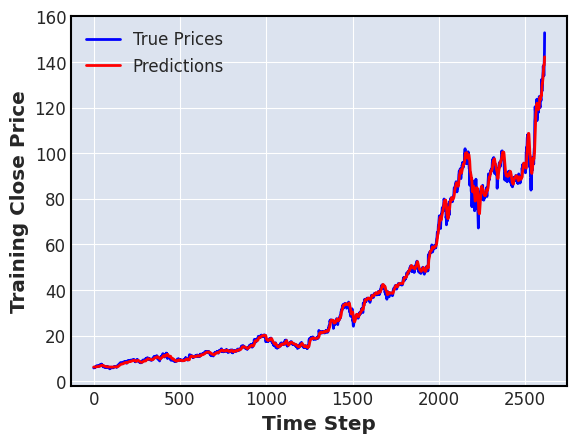

28/28 [==============================] - 0s 2ms/step


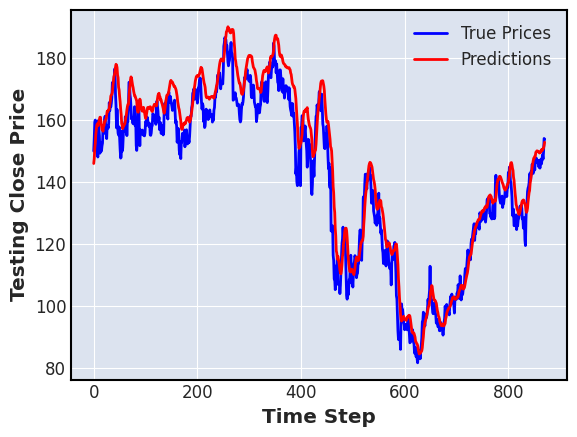

---------------------------------------------------------------
ticker_name :  IBM Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 2s 22ms/step - loss: 0.0054 - mae: 0.0540 - mse: 0.0054 - mape: 20.4802 - val_loss: 0.0013 - val_mae: 0.0342 - val_mse: 0.0013 - val_mape: 12.7686
Epoch 2/10
28/28 [==============================] - 0s 10ms/step - loss: 2.7872e-04 - mae: 0.0132 - mse: 2.7872e-04 - mape: 5.0115 - val_loss: 1.0211e-04 - val_mae: 0.0080 - val_mse: 1.0211e-04 - val_mape: 2.9976
Epoch 3/10
28/28 [==============================] - 0s 11ms/step - loss: 9.1911e-05 - mae: 0.0074 - mse: 9.1911e-05 - mape: 2.7479 - val_loss: 1.0263e-04 - val_mae: 0.0079 - val_mse: 1.0263e-04 - val_mape: 3.0236
Epoch 4/10
28/28 [==============================] - 0s 11ms/step - loss: 7.5122e-05 - mae: 0.0067 - mse: 7.5122e-05 - mape: 2.4984 - val_loss: 9.1406e-05 - val_mae: 0.0075 - val_mse: 9.1406e-05 - val_mape: 2.8619
Epoch 5/10
28/28 [============

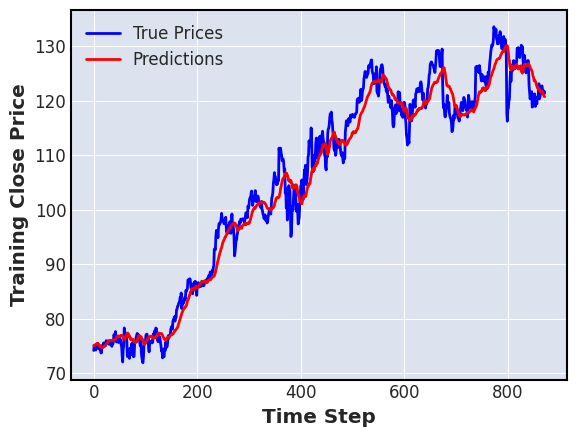

28/28 [==============================] - 0s 2ms/step


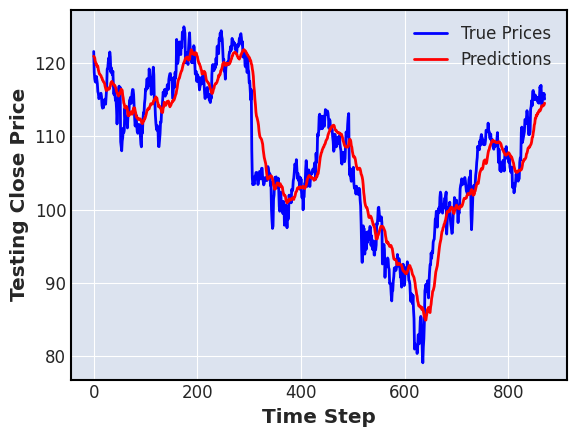

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 2s 21ms/step - loss: 0.0089 - mae: 0.0663 - mse: 0.0089 - mape: 25.1006 - val_loss: 5.2739e-04 - val_mae: 0.0207 - val_mse: 5.2739e-04 - val_mape: 7.5089
Epoch 2/10
28/28 [==============================] - 0s 9ms/step - loss: 2.6235e-04 - mae: 0.0129 - mse: 2.6235e-04 - mape: 4.9362 - val_loss: 1.5041e-04 - val_mae: 0.0097 - val_mse: 1.5041e-04 - val_mape: 3.7387
Epoch 3/10
28/28 [==============================] - 0s 11ms/step - loss: 1.0944e-04 - mae: 0.0084 - mse: 1.0944e-04 - mape: 3.2296 - val_loss: 1.5262e-04 - val_mae: 0.0098 - val_mse: 1.5262e-04 - val_mape: 3.7659
Epoch 4/10
28/28 [==============================] - 0s 12ms/step - loss: 1.0377e-04 - mae: 0.0082 - mse: 1.0377e-04 - mape: 3.1230 - val_loss: 1.2959e-04 - val_mae: 0.0090 - val_mse: 1.2959e-04 - val_mape: 3.4497
Epoch 5/10
28/28 [==============================] - 0s 12ms/step - loss: 1.0097e-0

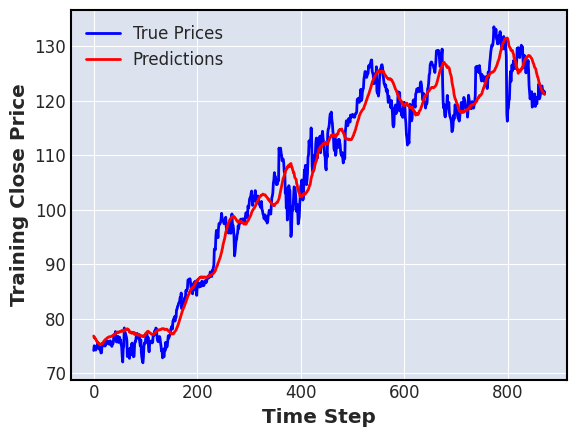

28/28 [==============================] - 0s 2ms/step


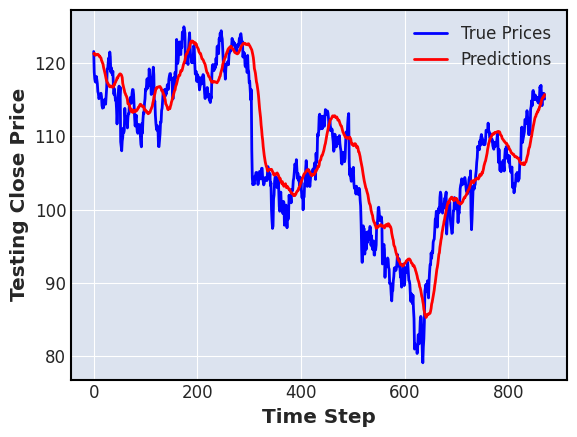

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 2s 20ms/step - loss: 0.0052 - mae: 0.0526 - mse: 0.0052 - mape: 19.8886 - val_loss: 0.0011 - val_mae: 0.0317 - val_mse: 0.0011 - val_mape: 11.8336
Epoch 2/10
28/28 [==============================] - 0s 9ms/step - loss: 2.1135e-04 - mae: 0.0112 - mse: 2.1135e-04 - mape: 4.2360 - val_loss: 1.0059e-04 - val_mae: 0.0079 - val_mse: 1.0059e-04 - val_mape: 2.9720
Epoch 3/10
28/28 [==============================] - 0s 9ms/step - loss: 7.8851e-05 - mae: 0.0068 - mse: 7.8851e-05 - mape: 2.5304 - val_loss: 9.2645e-05 - val_mae: 0.0076 - val_mse: 9.2645e-05 - val_mape: 2.8745
Epoch 4/10
28/28 [==============================] - 0s 9ms/step - loss: 7.7111e-05 - mae: 0.0068 - mse: 7.7111e-05 - mape: 2.5189 - val_loss: 9.8458e-05 - val_mae: 0.0077 - val_mse: 9.8458e-05 - val_mape: 2.9606
Epoch 5/10
28/28 [==============================] - 0s 9ms/step - loss: 7.5780e-05 - mae: 0

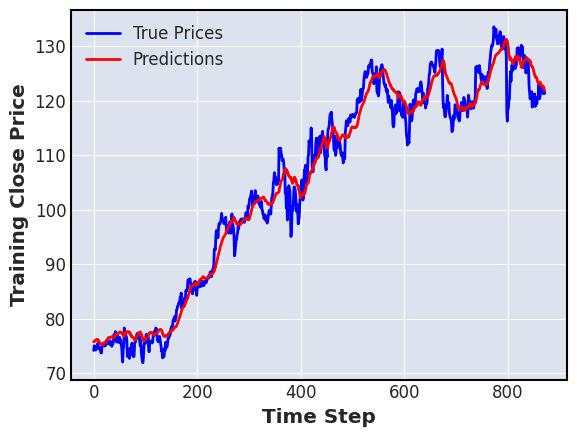

28/28 [==============================] - 0s 2ms/step


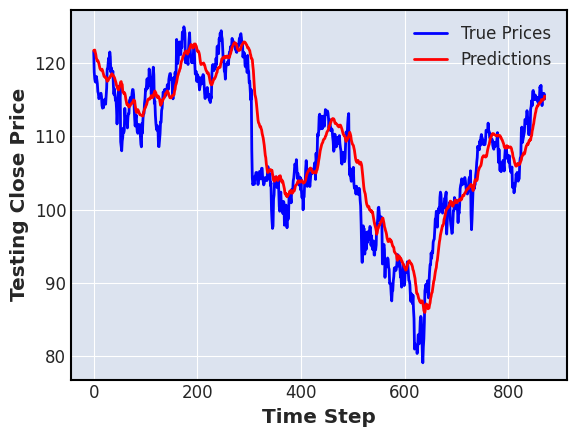

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 2s 13ms/step - loss: 0.0028 - mae: 0.0338 - mse: 0.0028 - mape: 12.6536 - val_loss: 2.0635e-04 - val_mae: 0.0104 - val_mse: 2.0635e-04 - val_mape: 4.0266
Epoch 2/10
55/55 [==============================] - 0s 9ms/step - loss: 9.0587e-05 - mae: 0.0075 - mse: 9.0587e-05 - mape: 2.8018 - val_loss: 1.9552e-04 - val_mae: 0.0097 - val_mse: 1.9552e-04 - val_mape: 3.7948
Epoch 3/10
55/55 [==============================] - 0s 9ms/step - loss: 8.1575e-05 - mae: 0.0070 - mse: 8.1575e-05 - mape: 2.6450 - val_loss: 1.9026e-04 - val_mae: 0.0095 - val_mse: 1.9026e-04 - val_mape: 3.7147
Epoch 4/10
55/55 [==============================] - 0s 7ms/step - loss: 8.0607e-05 - mae: 0.0070 - mse: 8.0607e-05 - mape: 2.6418 - val_loss: 1.8546e-04 - val_mae: 0.0093 - val_mse: 1.8546e-04 - val_mape: 3.6427
Epoch 5/10
55/55 [==============================] - 0s 8ms/step - los

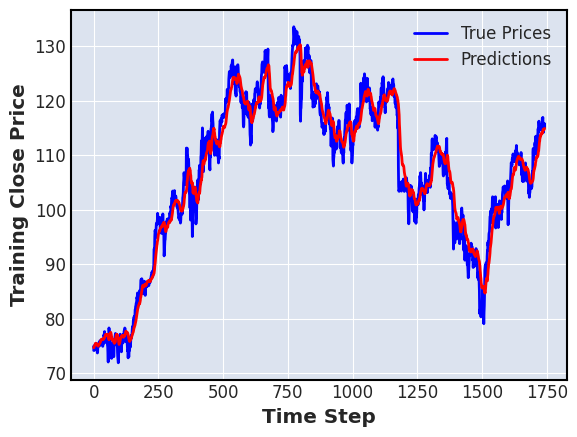

28/28 [==============================] - 0s 3ms/step


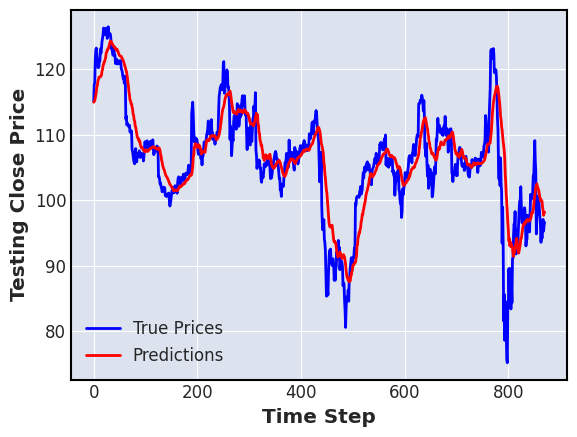

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 2s 12ms/step - loss: 0.0046 - mae: 0.0407 - mse: 0.0046 - mape: 15.2652 - val_loss: 2.9200e-04 - val_mae: 0.0116 - val_mse: 2.9200e-04 - val_mape: 4.5689
Epoch 2/10
55/55 [==============================] - 0s 8ms/step - loss: 1.2432e-04 - mae: 0.0089 - mse: 1.2432e-04 - mape: 3.3733 - val_loss: 3.0065e-04 - val_mae: 0.0117 - val_mse: 3.0065e-04 - val_mape: 4.6019
Epoch 3/10
55/55 [==============================] - 0s 8ms/step - loss: 1.1669e-04 - mae: 0.0086 - mse: 1.1669e-04 - mape: 3.2303 - val_loss: 2.9728e-04 - val_mae: 0.0116 - val_mse: 2.9728e-04 - val_mape: 4.5765
Epoch 4/10
55/55 [==============================] - 0s 7ms/step - loss: 1.1597e-04 - mae: 0.0085 - mse: 1.1597e-04 - mape: 3.2113 - val_loss: 2.8748e-04 - val_mae: 0.0114 - val_mse: 2.8748e-04 - val_mape: 4.5058
Epoch 5/10
55/55 [==============================] - 0s 6ms/step - loss: 1.1186e-04 -

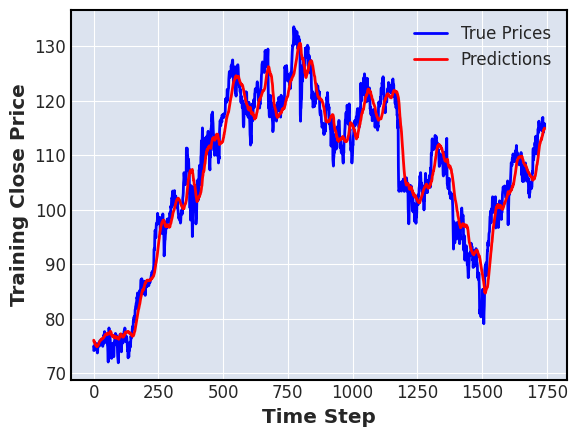

28/28 [==============================] - 0s 2ms/step


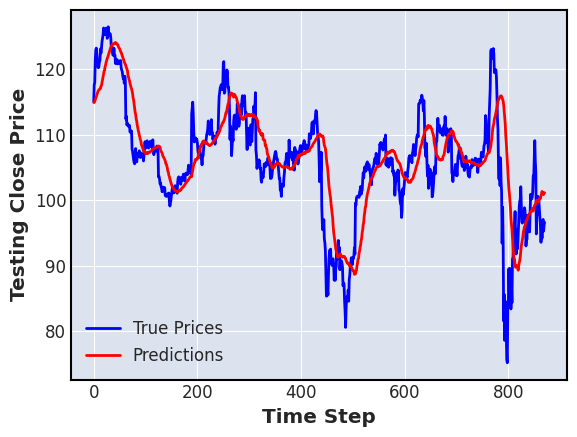

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 4s 14ms/step - loss: 0.0029 - mae: 0.0340 - mse: 0.0029 - mape: 12.7580 - val_loss: 2.3154e-04 - val_mae: 0.0116 - val_mse: 2.3154e-04 - val_mape: 4.4478
Epoch 2/10
55/55 [==============================] - 0s 8ms/step - loss: 9.7225e-05 - mae: 0.0077 - mse: 9.7225e-05 - mape: 2.8977 - val_loss: 2.1074e-04 - val_mae: 0.0098 - val_mse: 2.1074e-04 - val_mape: 3.8489
Epoch 3/10
55/55 [==============================] - 0s 8ms/step - loss: 8.3205e-05 - mae: 0.0071 - mse: 8.3205e-05 - mape: 2.6912 - val_loss: 2.0317e-04 - val_mae: 0.0096 - val_mse: 2.0317e-04 - val_mape: 3.7767
Epoch 4/10
55/55 [==============================] - 0s 7ms/step - loss: 8.3863e-05 - mae: 0.0072 - mse: 8.3863e-05 - mape: 2.7013 - val_loss: 1.8297e-04 - val_mae: 0.0096 - val_mse: 1.8297e-04 - val_mape: 3.7395
Epoch 5/10
55/55 [==============================] - 0s 7ms/step - loss: 7.6343e-05 -

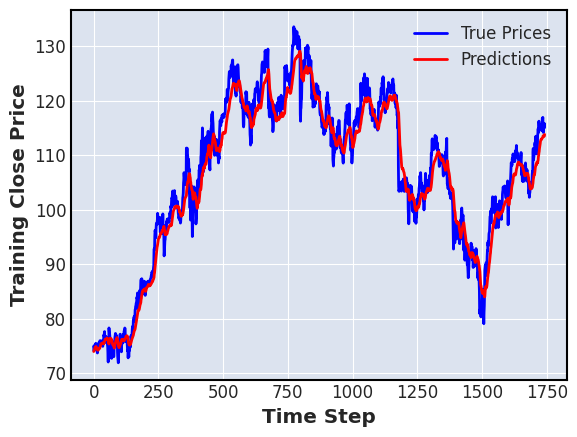

28/28 [==============================] - 0s 3ms/step


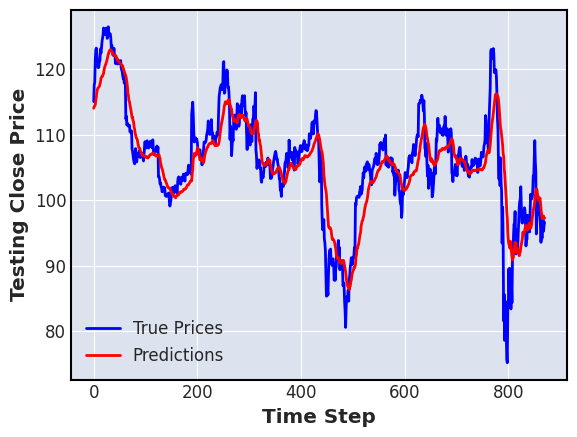

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 2s 11ms/step - loss: 0.0020 - mae: 0.0262 - mse: 0.0020 - mape: 9.8671 - val_loss: 1.7514e-04 - val_mae: 0.0107 - val_mse: 1.7514e-04 - val_mape: 3.4605
Epoch 2/10
82/82 [==============================] - 1s 6ms/step - loss: 1.2629e-04 - mae: 0.0082 - mse: 1.2629e-04 - mape: 3.1177 - val_loss: 1.7559e-04 - val_mae: 0.0106 - val_mse: 1.7559e-04 - val_mape: 3.4007
Epoch 3/10
82/82 [==============================] - 1s 6ms/step - loss: 1.1600e-04 - mae: 0.0078 - mse: 1.1600e-04 - mape: 2.9817 - val_loss: 2.0740e-04 - val_mae: 0.0114 - val_mse: 2.0740e-04 - val_mape: 3.6218
Epoch 4/10
82/82 [==============================] - 1s 6ms/step - loss: 1.0554e-04 - mae: 0.0075 - mse: 1.0554e-04 - mape: 2.8684 - val_loss: 1.4748e-04 - val_mae: 0.0096 - val_mse: 1.4748e-04 - val_mape: 3.0801
Epoch 5/10
82/82 [==============================] - 0s 6ms/step - loss

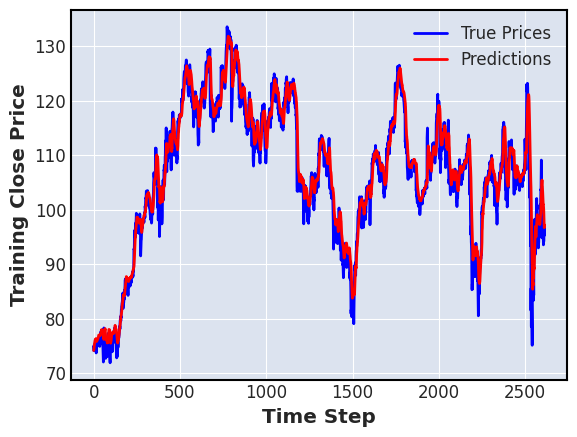

28/28 [==============================] - 0s 2ms/step


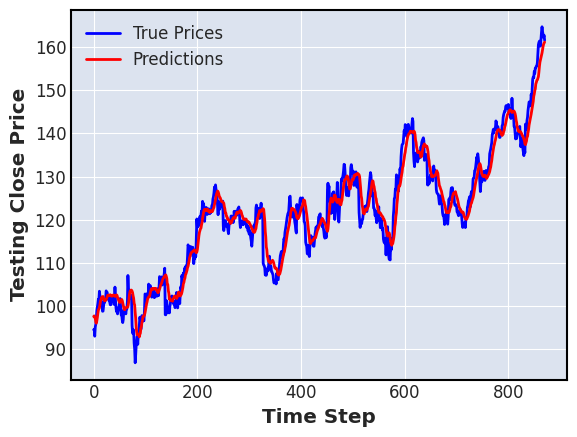

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 2s 9ms/step - loss: 0.0031 - mae: 0.0307 - mse: 0.0031 - mape: 11.5486 - val_loss: 2.5159e-04 - val_mae: 0.0127 - val_mse: 2.5159e-04 - val_mape: 4.0882
Epoch 2/10
82/82 [==============================] - 1s 6ms/step - loss: 1.7098e-04 - mae: 0.0096 - mse: 1.7098e-04 - mape: 3.6664 - val_loss: 2.6970e-04 - val_mae: 0.0130 - val_mse: 2.6970e-04 - val_mape: 4.1648
Epoch 3/10
82/82 [==============================] - 1s 6ms/step - loss: 1.6596e-04 - mae: 0.0094 - mse: 1.6596e-04 - mape: 3.5880 - val_loss: 2.8886e-04 - val_mae: 0.0134 - val_mse: 2.8886e-04 - val_mape: 4.2782
Epoch 4/10
82/82 [==============================] - 1s 7ms/step - loss: 1.5619e-04 - mae: 0.0091 - mse: 1.5619e-04 - mape: 3.4863 - val_loss: 2.2889e-04 - val_mae: 0.0120 - val_mse: 2.2889e-04 - val_mape: 3.8721
Epoch 5/10
82/82 [==============================] - 1s 7ms/step - loss: 1.4667e-04 - 

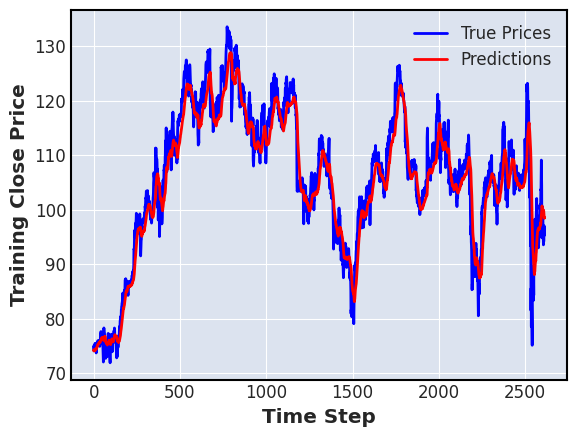

28/28 [==============================] - 0s 3ms/step


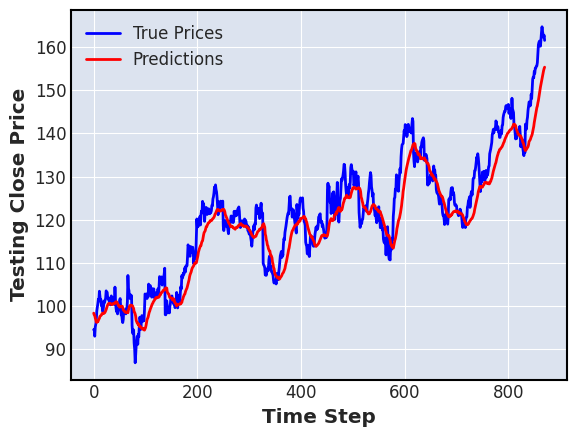

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 2s 10ms/step - loss: 0.0018 - mae: 0.0254 - mse: 0.0018 - mape: 9.6167 - val_loss: 1.5528e-04 - val_mae: 0.0100 - val_mse: 1.5528e-04 - val_mape: 3.2572
Epoch 2/10
82/82 [==============================] - 1s 7ms/step - loss: 1.1338e-04 - mae: 0.0078 - mse: 1.1338e-04 - mape: 2.9736 - val_loss: 1.4035e-04 - val_mae: 0.0094 - val_mse: 1.4035e-04 - val_mape: 3.0392
Epoch 3/10
82/82 [==============================] - 1s 8ms/step - loss: 9.3450e-05 - mae: 0.0070 - mse: 9.3450e-05 - mape: 2.6756 - val_loss: 1.2347e-04 - val_mae: 0.0088 - val_mse: 1.2347e-04 - val_mape: 2.8308
Epoch 4/10
82/82 [==============================] - 1s 8ms/step - loss: 8.0033e-05 - mae: 0.0065 - mse: 8.0033e-05 - mape: 2.4742 - val_loss: 1.2561e-04 - val_mae: 0.0088 - val_mse: 1.2561e-04 - val_mape: 2.8139
Epoch 5/10
82/82 [==============================] - 1s 7ms/step - loss: 7.0273e-05 - 

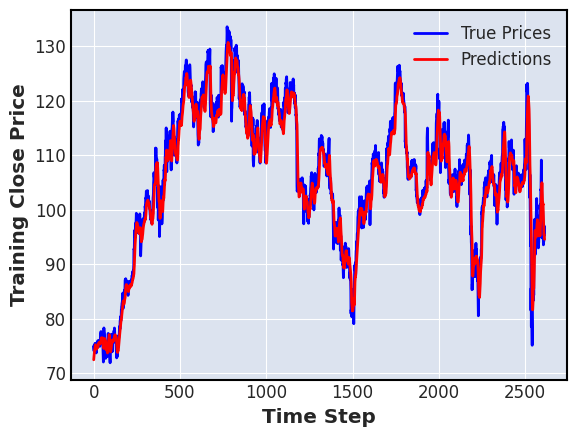

28/28 [==============================] - 0s 2ms/step


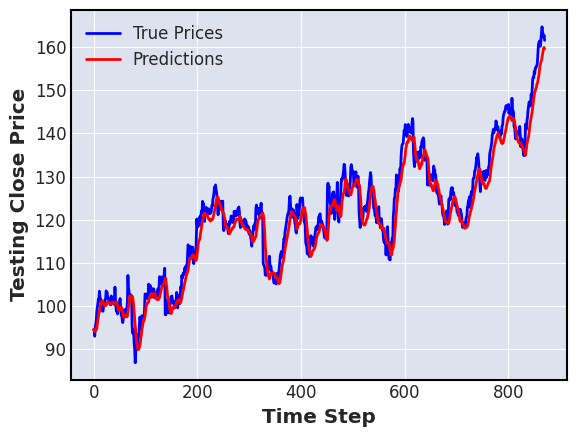

---------------------------------------------------------------
ticker_name :  KO Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 2s 21ms/step - loss: 1.5735e-04 - mae: 0.0088 - mse: 1.5735e-04 - mape: 19.0640 - val_loss: 5.5674e-05 - val_mae: 0.0071 - val_mse: 5.5674e-05 - val_mape: 10.2187
Epoch 2/10
28/28 [==============================] - 0s 10ms/step - loss: 6.5748e-06 - mae: 0.0020 - mse: 6.5748e-06 - mape: 4.4518 - val_loss: 4.2019e-06 - val_mae: 0.0016 - val_mse: 4.2019e-06 - val_mape: 2.3655
Epoch 3/10
28/28 [==============================] - 0s 12ms/step - loss: 2.5467e-06 - mae: 0.0013 - mse: 2.5467e-06 - mape: 2.7722 - val_loss: 3.8657e-06 - val_mae: 0.0016 - val_mse: 3.8657e-06 - val_mape: 2.2890
Epoch 4/10
28/28 [==============================] - 0s 10ms/step - loss: 2.2263e-06 - mae: 0.0012 - mse: 2.2263e-06 - mape: 2.5776 - val_loss: 3.9749e-06 - val_mae: 0.0016 - val_mse: 3.9749e-06 - val_mape: 2.3229
Epoch 5/10
28/2

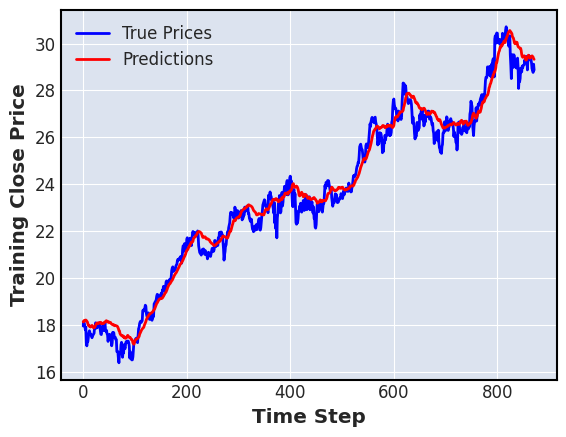

28/28 [==============================] - 0s 3ms/step


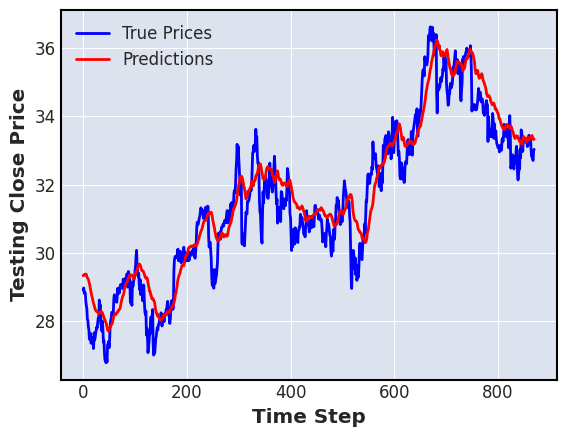

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 2s 18ms/step - loss: 2.6153e-04 - mae: 0.0113 - mse: 2.6153e-04 - mape: 24.0602 - val_loss: 6.9718e-06 - val_mae: 0.0021 - val_mse: 6.9718e-06 - val_mape: 3.0017
Epoch 2/10
28/28 [==============================] - 0s 9ms/step - loss: 1.2343e-05 - mae: 0.0028 - mse: 1.2343e-05 - mape: 6.1861 - val_loss: 1.3883e-05 - val_mae: 0.0032 - val_mse: 1.3883e-05 - val_mape: 4.4793
Epoch 3/10
28/28 [==============================] - 0s 9ms/step - loss: 3.8383e-06 - mae: 0.0016 - mse: 3.8383e-06 - mape: 3.4404 - val_loss: 5.1359e-06 - val_mae: 0.0018 - val_mse: 5.1359e-06 - val_mape: 2.6576
Epoch 4/10
28/28 [==============================] - 0s 12ms/step - loss: 2.8818e-06 - mae: 0.0014 - mse: 2.8818e-06 - mape: 2.9133 - val_loss: 6.0834e-06 - val_mae: 0.0020 - val_mse: 6.0834e-06 - val_mape: 2.9124
Epoch 5/10
28/28 [==============================] - 0s 9ms/step - loss: 2.9

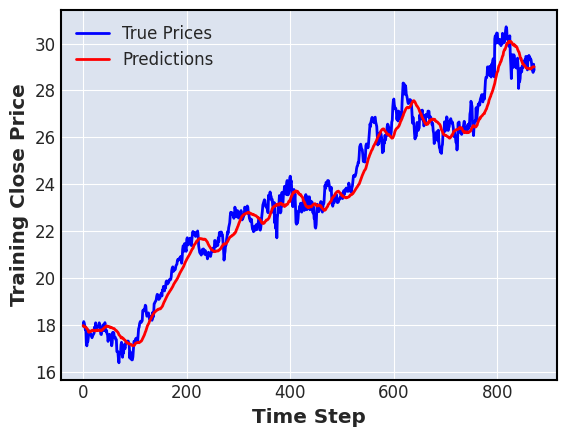

28/28 [==============================] - 0s 3ms/step


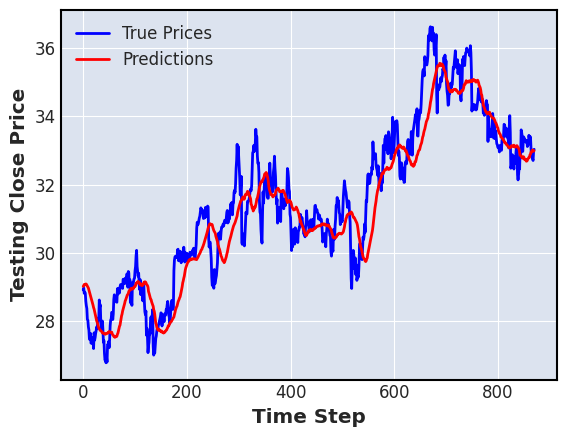

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 2s 20ms/step - loss: 1.5374e-04 - mae: 0.0088 - mse: 1.5374e-04 - mape: 18.7270 - val_loss: 5.6503e-05 - val_mae: 0.0072 - val_mse: 5.6503e-05 - val_mape: 10.3626
Epoch 2/10
28/28 [==============================] - 0s 9ms/step - loss: 6.3846e-06 - mae: 0.0020 - mse: 6.3846e-06 - mape: 4.5224 - val_loss: 4.0760e-06 - val_mae: 0.0016 - val_mse: 4.0760e-06 - val_mape: 2.3422
Epoch 3/10
28/28 [==============================] - 0s 9ms/step - loss: 2.2944e-06 - mae: 0.0012 - mse: 2.2944e-06 - mape: 2.6141 - val_loss: 3.6385e-06 - val_mae: 0.0015 - val_mse: 3.6385e-06 - val_mape: 2.2241
Epoch 4/10
28/28 [==============================] - 0s 11ms/step - loss: 1.9782e-06 - mae: 0.0011 - mse: 1.9782e-06 - mape: 2.3988 - val_loss: 4.0797e-06 - val_mae: 0.0016 - val_mse: 4.0797e-06 - val_mape: 2.3675
Epoch 5/10
28/28 [==============================] - 0s 8ms/step - loss: 2.

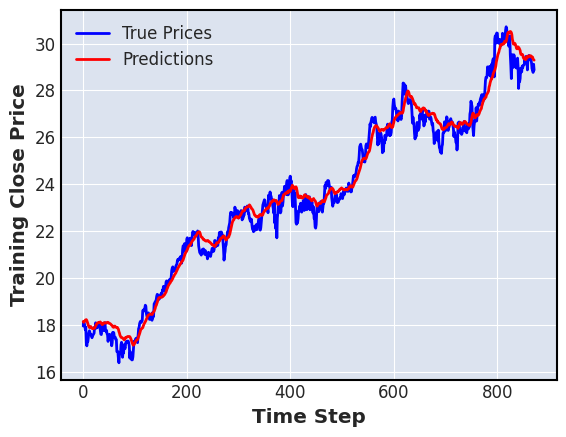

28/28 [==============================] - 0s 2ms/step


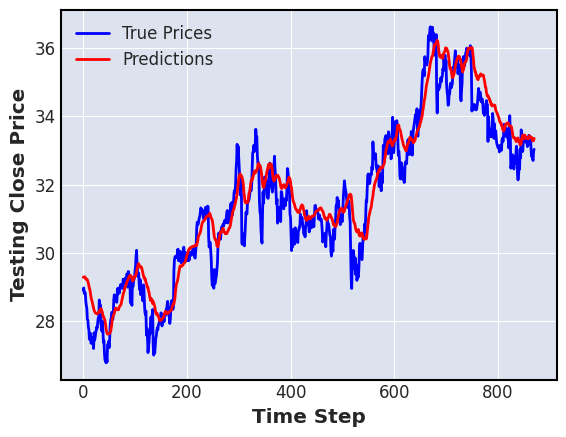

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 2s 13ms/step - loss: 1.1754e-04 - mae: 0.0065 - mse: 1.1754e-04 - mape: 11.6969 - val_loss: 2.1233e-05 - val_mae: 0.0028 - val_mse: 2.1233e-05 - val_mape: 3.0262
Epoch 2/10
55/55 [==============================] - 0s 7ms/step - loss: 3.6032e-06 - mae: 0.0015 - mse: 3.6032e-06 - mape: 2.7165 - val_loss: 1.9942e-05 - val_mae: 0.0026 - val_mse: 1.9942e-05 - val_mape: 2.8235
Epoch 3/10
55/55 [==============================] - 0s 7ms/step - loss: 3.2714e-06 - mae: 0.0014 - mse: 3.2714e-06 - mape: 2.5485 - val_loss: 1.9412e-05 - val_mae: 0.0025 - val_mse: 1.9412e-05 - val_mape: 2.7457
Epoch 4/10
55/55 [==============================] - 0s 9ms/step - loss: 3.2723e-06 - mae: 0.0014 - mse: 3.2723e-06 - mape: 2.4906 - val_loss: 1.8357e-05 - val_mae: 0.0026 - val_mse: 1.8357e-05 - val_mape: 2.8373
Epoch 5/10
55/55 [==============================] - 0s 8ms/st

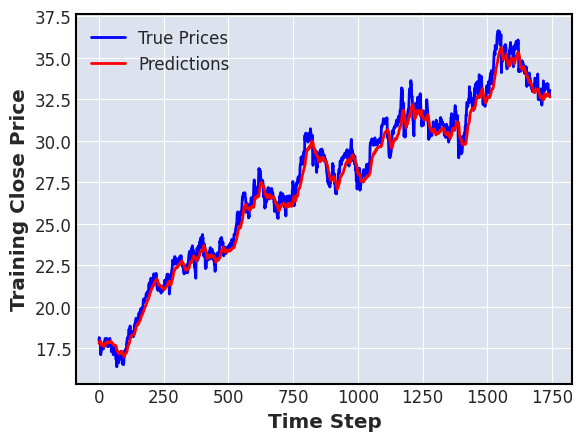

28/28 [==============================] - 0s 3ms/step


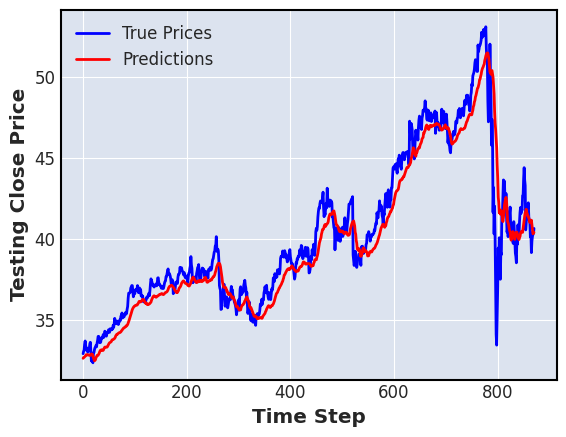

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 2s 13ms/step - loss: 2.0547e-04 - mae: 0.0090 - mse: 2.0547e-04 - mape: 16.3578 - val_loss: 8.8077e-05 - val_mae: 0.0085 - val_mse: 8.8077e-05 - val_mape: 8.9513
Epoch 2/10
55/55 [==============================] - 0s 6ms/step - loss: 5.7554e-06 - mae: 0.0019 - mse: 5.7554e-06 - mape: 3.4399 - val_loss: 2.6810e-05 - val_mae: 0.0032 - val_mse: 2.6810e-05 - val_mape: 3.4827
Epoch 3/10
55/55 [==============================] - 0s 7ms/step - loss: 4.4055e-06 - mae: 0.0017 - mse: 4.4055e-06 - mape: 2.9254 - val_loss: 2.5638e-05 - val_mae: 0.0029 - val_mse: 2.5638e-05 - val_mape: 3.1344
Epoch 4/10
55/55 [==============================] - 0s 7ms/step - loss: 4.1972e-06 - mae: 0.0016 - mse: 4.1972e-06 - mape: 2.8580 - val_loss: 2.5768e-05 - val_mae: 0.0032 - val_mse: 2.5768e-05 - val_mape: 3.4420
Epoch 5/10
55/55 [==============================] - 0s 8ms/step - loss: 3.89

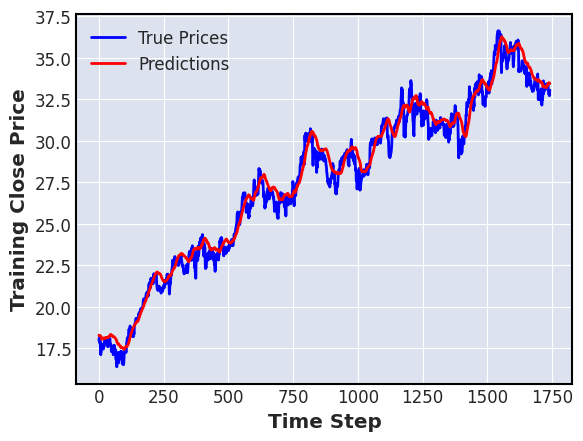

28/28 [==============================] - 0s 3ms/step


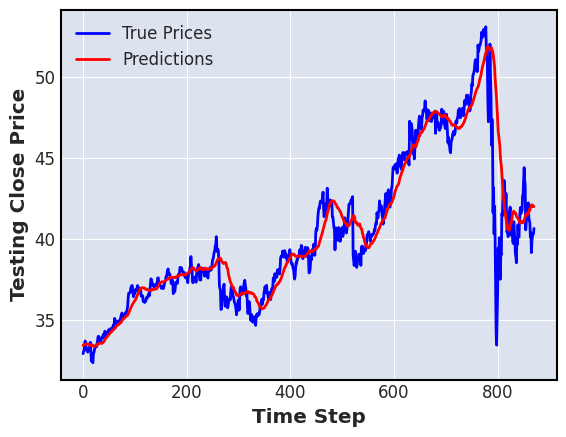

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 2s 11ms/step - loss: 1.1924e-04 - mae: 0.0065 - mse: 1.1924e-04 - mape: 11.3910 - val_loss: 2.2322e-05 - val_mae: 0.0035 - val_mse: 2.2322e-05 - val_mape: 3.6964
Epoch 2/10
55/55 [==============================] - 0s 6ms/step - loss: 3.4128e-06 - mae: 0.0015 - mse: 3.4128e-06 - mape: 2.6082 - val_loss: 1.8248e-05 - val_mae: 0.0027 - val_mse: 1.8248e-05 - val_mape: 2.8996
Epoch 3/10
55/55 [==============================] - 0s 6ms/step - loss: 2.8811e-06 - mae: 0.0013 - mse: 2.8811e-06 - mape: 2.3771 - val_loss: 1.7502e-05 - val_mae: 0.0026 - val_mse: 1.7502e-05 - val_mape: 2.7505
Epoch 4/10
55/55 [==============================] - 0s 6ms/step - loss: 2.7970e-06 - mae: 0.0013 - mse: 2.7970e-06 - mape: 2.3498 - val_loss: 1.7021e-05 - val_mae: 0.0025 - val_mse: 1.7021e-05 - val_mape: 2.7169
Epoch 5/10
55/55 [==============================] - 0s 7ms/step - loss: 2.73

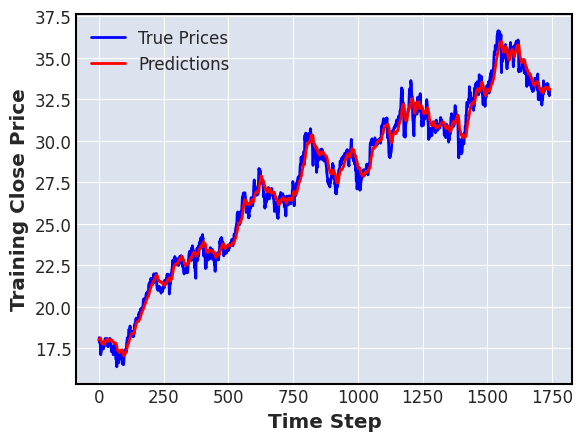

28/28 [==============================] - 0s 3ms/step


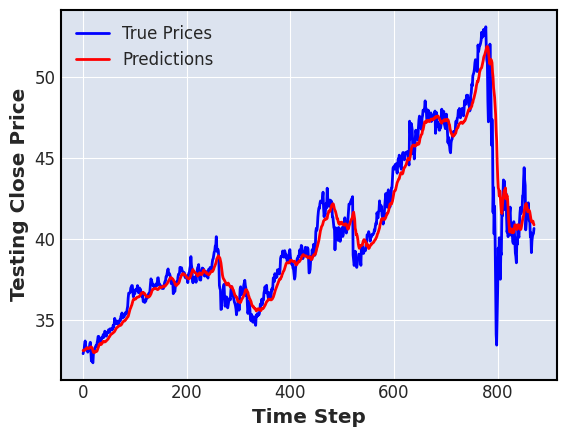

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 2s 9ms/step - loss: 1.3406e-04 - mae: 0.0062 - mse: 1.3406e-04 - mape: 9.2824 - val_loss: 2.0784e-05 - val_mae: 0.0037 - val_mse: 2.0784e-05 - val_mape: 2.8641
Epoch 2/10
82/82 [==============================] - 1s 7ms/step - loss: 8.8623e-06 - mae: 0.0019 - mse: 8.8623e-06 - mape: 2.7749 - val_loss: 1.8455e-05 - val_mae: 0.0034 - val_mse: 1.8455e-05 - val_mape: 2.6634
Epoch 3/10
82/82 [==============================] - 0s 6ms/step - loss: 8.4744e-06 - mae: 0.0019 - mse: 8.4744e-06 - mape: 2.7019 - val_loss: 2.3373e-05 - val_mae: 0.0041 - val_mse: 2.3373e-05 - val_mape: 3.1245
Epoch 4/10
82/82 [==============================] - 0s 6ms/step - loss: 7.6302e-06 - mae: 0.0018 - mse: 7.6302e-06 - mape: 2.5867 - val_loss: 1.5176e-05 - val_mae: 0.0031 - val_mse: 1.5176e-05 - val_mape: 2.4111
Epoch 5/10
82/82 [==============================] - 0s 6ms/step

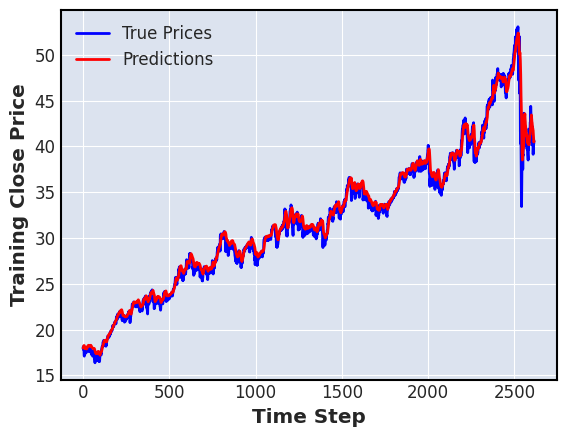

28/28 [==============================] - 0s 2ms/step


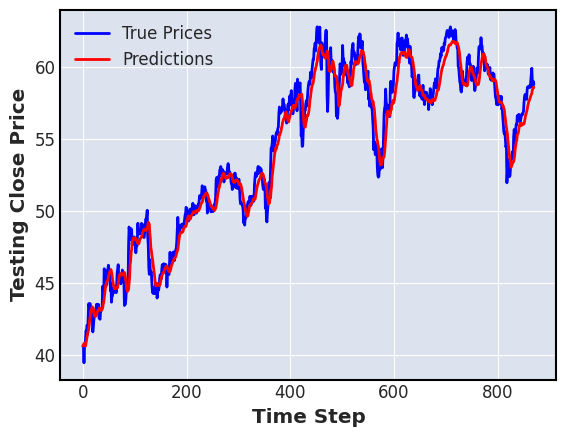

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 2s 10ms/step - loss: 2.1630e-04 - mae: 0.0082 - mse: 2.1630e-04 - mape: 12.4802 - val_loss: 2.7918e-05 - val_mae: 0.0043 - val_mse: 2.7918e-05 - val_mape: 3.3391
Epoch 2/10
82/82 [==============================] - 1s 6ms/step - loss: 1.2185e-05 - mae: 0.0022 - mse: 1.2185e-05 - mape: 3.1999 - val_loss: 4.1949e-05 - val_mae: 0.0055 - val_mse: 4.1949e-05 - val_mape: 4.2734
Epoch 3/10
82/82 [==============================] - 1s 6ms/step - loss: 1.1270e-05 - mae: 0.0021 - mse: 1.1270e-05 - mape: 3.0728 - val_loss: 2.6587e-05 - val_mae: 0.0040 - val_mse: 2.6587e-05 - val_mape: 3.0786
Epoch 4/10
82/82 [==============================] - 1s 6ms/step - loss: 1.0535e-05 - mae: 0.0021 - mse: 1.0535e-05 - mape: 2.9560 - val_loss: 2.1737e-05 - val_mae: 0.0038 - val_mse: 2.1737e-05 - val_mape: 2.9302
Epoch 5/10
82/82 [==============================] - 1s 6ms/step - loss: 9.74

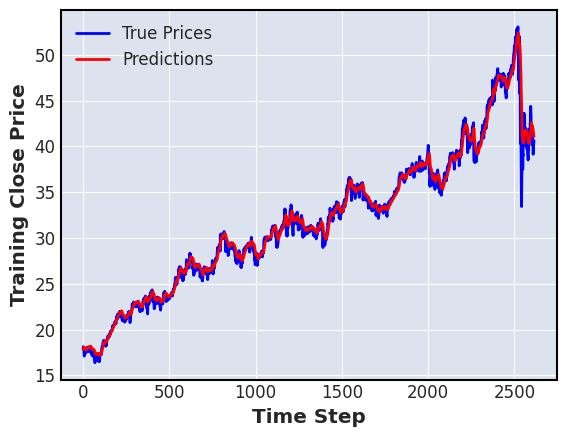

28/28 [==============================] - 0s 2ms/step


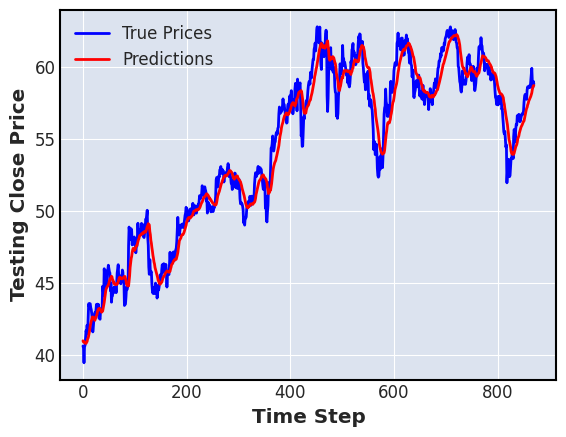

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 2s 10ms/step - loss: 1.2334e-04 - mae: 0.0058 - mse: 1.2334e-04 - mape: 8.6660 - val_loss: 1.9024e-05 - val_mae: 0.0036 - val_mse: 1.9024e-05 - val_mape: 2.7619
Epoch 2/10
82/82 [==============================] - 1s 7ms/step - loss: 7.7426e-06 - mae: 0.0018 - mse: 7.7426e-06 - mape: 2.6148 - val_loss: 1.8457e-05 - val_mae: 0.0033 - val_mse: 1.8457e-05 - val_mape: 2.5314
Epoch 3/10
82/82 [==============================] - 1s 6ms/step - loss: 6.8685e-06 - mae: 0.0016 - mse: 6.8685e-06 - mape: 2.3627 - val_loss: 1.4832e-05 - val_mae: 0.0030 - val_mse: 1.4832e-05 - val_mape: 2.3460
Epoch 4/10
82/82 [==============================] - 1s 7ms/step - loss: 6.3111e-06 - mae: 0.0016 - mse: 6.3111e-06 - mape: 2.2878 - val_loss: 1.5592e-05 - val_mae: 0.0033 - val_mse: 1.5592e-05 - val_mape: 2.5080
Epoch 5/10
82/82 [==============================] - 1s 7ms/step - loss: 5.760

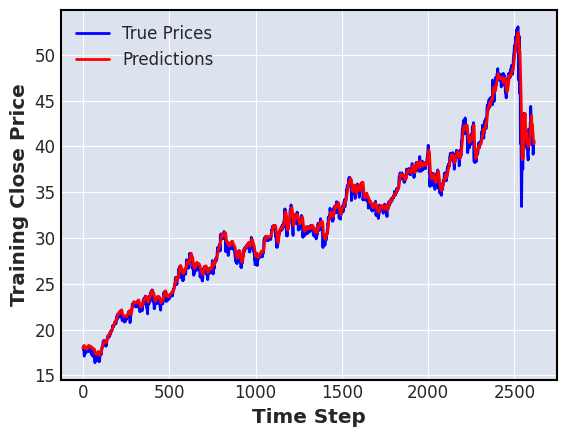

28/28 [==============================] - 0s 3ms/step


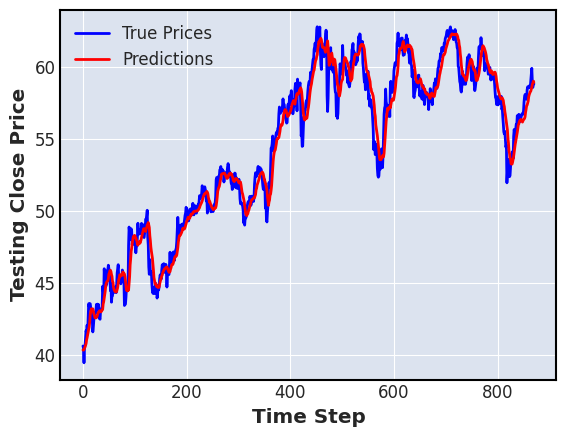

---------------------------------------------------------------
ticker_name :  AAPL Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 2s 21ms/step - loss: 3.5475e-05 - mae: 0.0042 - mse: 3.5475e-05 - mape: 33.9331 - val_loss: 2.2447e-05 - val_mae: 0.0037 - val_mse: 2.2447e-05 - val_mape: 7.6224
Epoch 2/10
28/28 [==============================] - 0s 10ms/step - loss: 5.5356e-06 - mae: 0.0018 - mse: 5.5356e-06 - mape: 12.7005 - val_loss: 9.4239e-06 - val_mae: 0.0024 - val_mse: 9.4239e-06 - val_mape: 5.1079
Epoch 3/10
28/28 [==============================] - 0s 9ms/step - loss: 3.7013e-06 - mae: 0.0015 - mse: 3.7013e-06 - mape: 10.2865 - val_loss: 7.6072e-06 - val_mae: 0.0021 - val_mse: 7.6072e-06 - val_mape: 4.6408
Epoch 4/10
28/28 [==============================] - 0s 11ms/step - loss: 3.1235e-06 - mae: 0.0013 - mse: 3.1235e-06 - mape: 8.7530 - val_loss: 6.9950e-06 - val_mae: 0.0021 - val_mse: 6.9950e-06 - val_mape: 4.6482
Epoch 5/10
28

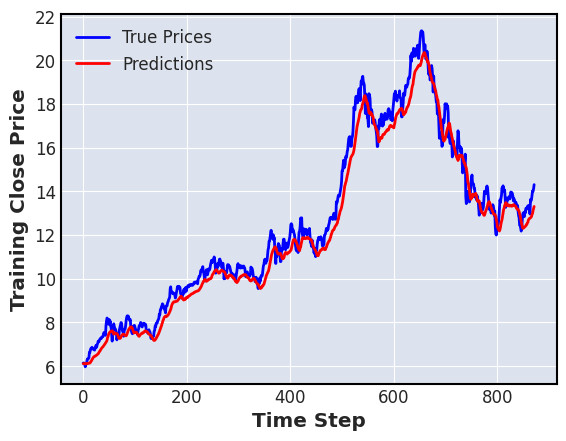

28/28 [==============================] - 0s 3ms/step


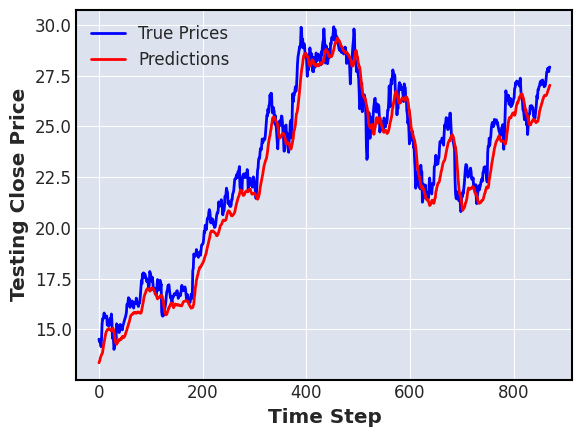

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 2s 18ms/step - loss: 6.8677e-05 - mae: 0.0058 - mse: 6.8677e-05 - mape: 48.5467 - val_loss: 3.3363e-05 - val_mae: 0.0051 - val_mse: 3.3363e-05 - val_mape: 11.2796
Epoch 2/10
28/28 [==============================] - 0s 8ms/step - loss: 6.3488e-06 - mae: 0.0019 - mse: 6.3488e-06 - mape: 14.9938 - val_loss: 1.0761e-05 - val_mae: 0.0025 - val_mse: 1.0761e-05 - val_mape: 5.5308
Epoch 3/10
28/28 [==============================] - 0s 10ms/step - loss: 5.3355e-06 - mae: 0.0018 - mse: 5.3355e-06 - mape: 11.8878 - val_loss: 1.1351e-05 - val_mae: 0.0027 - val_mse: 1.1351e-05 - val_mape: 5.7728
Epoch 4/10
28/28 [==============================] - 0s 8ms/step - loss: 4.7352e-06 - mae: 0.0016 - mse: 4.7352e-06 - mape: 10.4521 - val_loss: 1.8051e-05 - val_mae: 0.0036 - val_mse: 1.8051e-05 - val_mape: 7.6675
Epoch 5/10
28/28 [==============================] - 0s 8ms/step - loss:

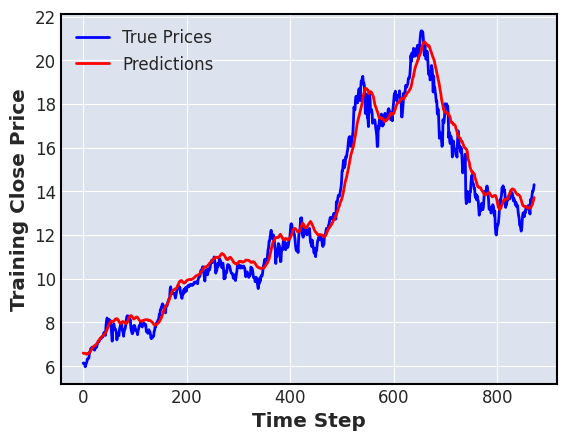

28/28 [==============================] - 0s 2ms/step


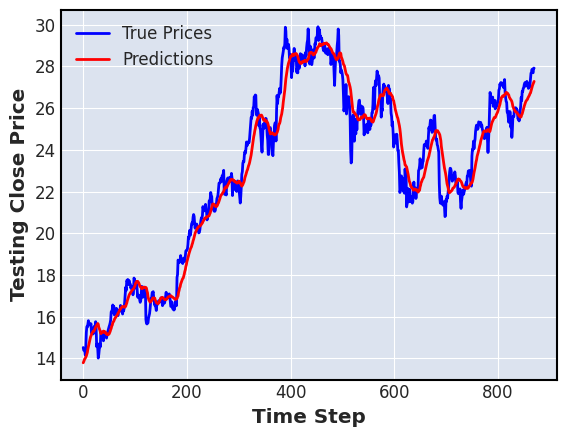

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 2s 21ms/step - loss: 2.9342e-05 - mae: 0.0037 - mse: 2.9342e-05 - mape: 29.9662 - val_loss: 1.1479e-05 - val_mae: 0.0026 - val_mse: 1.1479e-05 - val_mape: 5.6775
Epoch 2/10
28/28 [==============================] - 0s 12ms/step - loss: 4.3930e-06 - mae: 0.0016 - mse: 4.3930e-06 - mape: 11.0694 - val_loss: 1.2452e-05 - val_mae: 0.0030 - val_mse: 1.2452e-05 - val_mape: 6.8293
Epoch 3/10
28/28 [==============================] - 0s 8ms/step - loss: 3.9119e-06 - mae: 0.0015 - mse: 3.9119e-06 - mape: 9.9591 - val_loss: 6.4086e-06 - val_mae: 0.0020 - val_mse: 6.4086e-06 - val_mape: 4.3869
Epoch 4/10
28/28 [==============================] - 2s 66ms/step - loss: 3.0788e-06 - mae: 0.0013 - mse: 3.0788e-06 - mape: 8.0951 - val_loss: 5.4132e-06 - val_mae: 0.0018 - val_mse: 5.4132e-06 - val_mape: 3.9630
Epoch 5/10
28/28 [==============================] - 0s 9ms/step - loss: 3

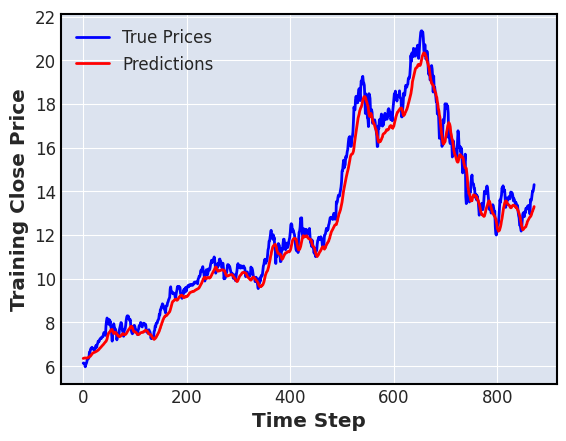

28/28 [==============================] - 0s 2ms/step


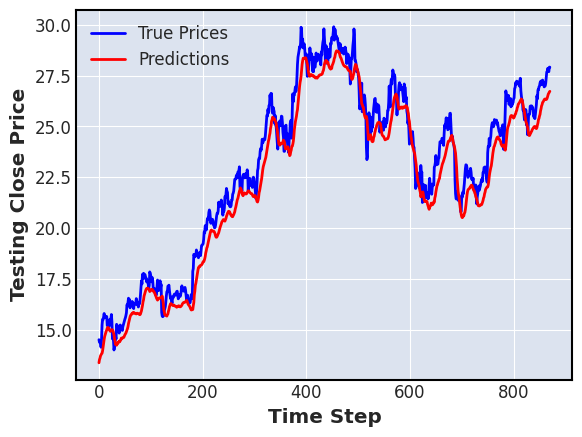

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 2s 11ms/step - loss: 5.2384e-05 - mae: 0.0049 - mse: 5.2384e-05 - mape: 23.3187 - val_loss: 1.8467e-04 - val_mae: 0.0095 - val_mse: 1.8467e-04 - val_mape: 8.2192
Epoch 2/10
55/55 [==============================] - 0s 8ms/step - loss: 5.8681e-06 - mae: 0.0018 - mse: 5.8681e-06 - mape: 8.2820 - val_loss: 9.6825e-05 - val_mae: 0.0060 - val_mse: 9.6825e-05 - val_mape: 5.3481
Epoch 3/10
55/55 [==============================] - 0s 6ms/step - loss: 5.0148e-06 - mae: 0.0017 - mse: 5.0148e-06 - mape: 7.0078 - val_loss: 5.9938e-05 - val_mae: 0.0048 - val_mse: 5.9938e-05 - val_mape: 4.3702
Epoch 4/10
55/55 [==============================] - 0s 7ms/step - loss: 4.3994e-06 - mae: 0.0016 - mse: 4.3994e-06 - mape: 6.3133 - val_loss: 5.4556e-05 - val_mae: 0.0045 - val_mse: 5.4556e-05 - val_mape: 4.0120
Epoch 5/10
55/55 [==============================] - 0s 6ms/st

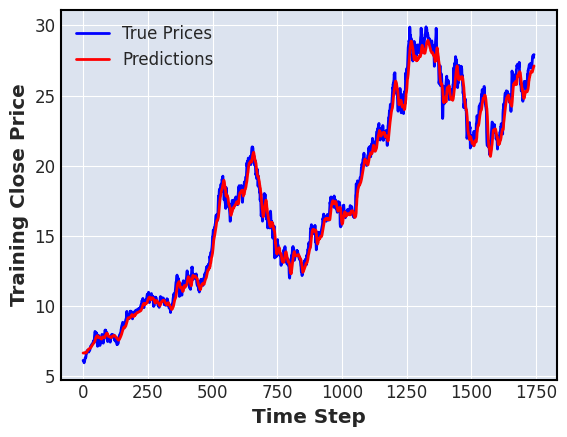

28/28 [==============================] - 0s 3ms/step


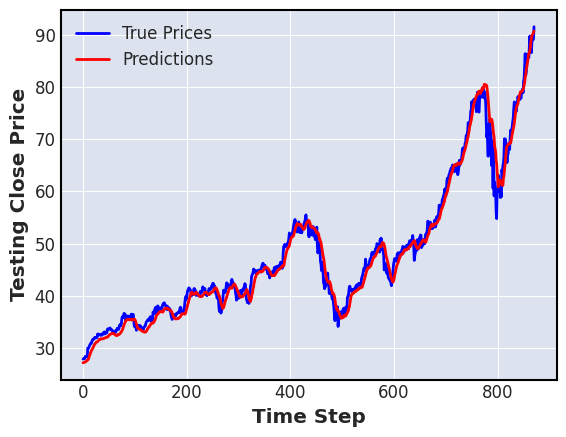

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 2s 12ms/step - loss: 8.0156e-05 - mae: 0.0054 - mse: 8.0156e-05 - mape: 30.0881 - val_loss: 1.0134e-04 - val_mae: 0.0073 - val_mse: 1.0134e-04 - val_mape: 6.2229
Epoch 2/10
55/55 [==============================] - 0s 7ms/step - loss: 7.9848e-06 - mae: 0.0021 - mse: 7.9848e-06 - mape: 9.4986 - val_loss: 1.0272e-04 - val_mae: 0.0078 - val_mse: 1.0272e-04 - val_mape: 6.5316
Epoch 3/10
55/55 [==============================] - 0s 7ms/step - loss: 7.0467e-06 - mae: 0.0020 - mse: 7.0467e-06 - mape: 8.3052 - val_loss: 8.2338e-05 - val_mae: 0.0068 - val_mse: 8.2338e-05 - val_mape: 5.6877
Epoch 4/10
55/55 [==============================] - 0s 7ms/step - loss: 6.3109e-06 - mae: 0.0019 - mse: 6.3109e-06 - mape: 7.8765 - val_loss: 7.7835e-05 - val_mae: 0.0067 - val_mse: 7.7835e-05 - val_mape: 5.5899
Epoch 5/10
55/55 [==============================] - 0s 8ms/step - loss: 4.80

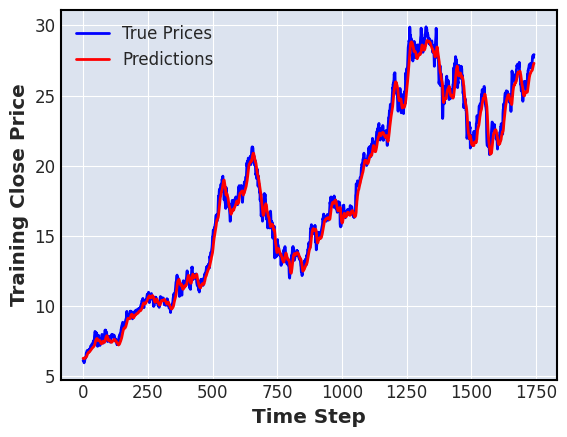

28/28 [==============================] - 0s 3ms/step


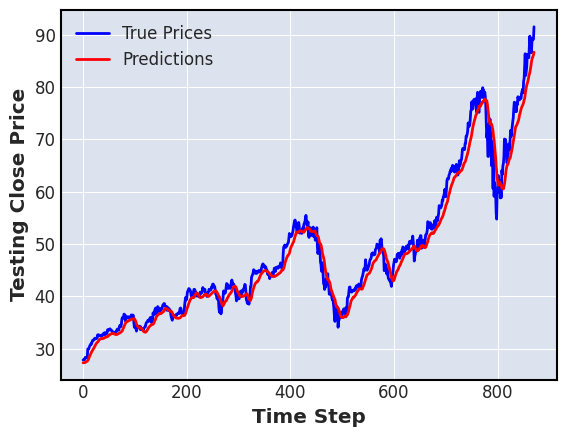

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 2s 11ms/step - loss: 3.9712e-05 - mae: 0.0040 - mse: 3.9712e-05 - mape: 19.7253 - val_loss: 7.7525e-05 - val_mae: 0.0054 - val_mse: 7.7525e-05 - val_mape: 4.8210
Epoch 2/10
55/55 [==============================] - 0s 6ms/step - loss: 5.2573e-06 - mae: 0.0017 - mse: 5.2573e-06 - mape: 6.9781 - val_loss: 5.9044e-05 - val_mae: 0.0050 - val_mse: 5.9044e-05 - val_mape: 4.4280
Epoch 3/10
55/55 [==============================] - 0s 6ms/step - loss: 4.5826e-06 - mae: 0.0016 - mse: 4.5826e-06 - mape: 6.5571 - val_loss: 7.7240e-05 - val_mae: 0.0073 - val_mse: 7.7240e-05 - val_mape: 6.2786
Epoch 4/10
55/55 [==============================] - 0s 6ms/step - loss: 4.5171e-06 - mae: 0.0016 - mse: 4.5171e-06 - mape: 6.7091 - val_loss: 4.0117e-05 - val_mae: 0.0044 - val_mse: 4.0117e-05 - val_mape: 3.7028
Epoch 5/10
55/55 [==============================] - 0s 7ms/step - loss: 3.11

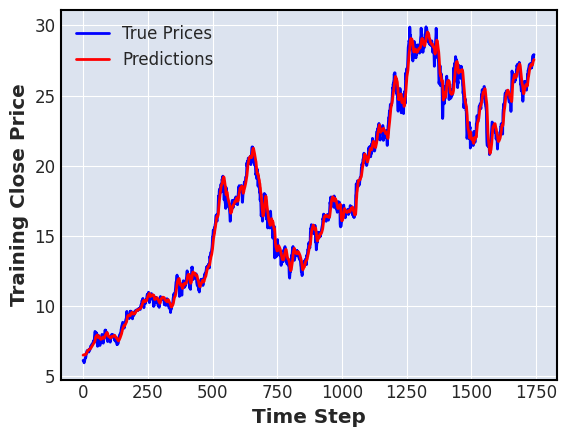

28/28 [==============================] - 0s 3ms/step


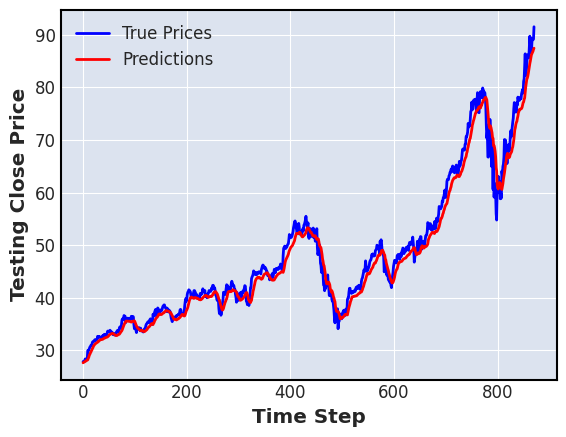

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 2s 9ms/step - loss: 1.6274e-04 - mae: 0.0066 - mse: 1.6274e-04 - mape: 19.2998 - val_loss: 7.1136e-04 - val_mae: 0.0213 - val_mse: 7.1136e-04 - val_mape: 5.7757
Epoch 2/10
82/82 [==============================] - 1s 7ms/step - loss: 2.4764e-05 - mae: 0.0031 - mse: 2.4764e-05 - mape: 7.8606 - val_loss: 2.7450e-04 - val_mae: 0.0134 - val_mse: 2.7450e-04 - val_mape: 3.6326
Epoch 3/10
82/82 [==============================] - 1s 6ms/step - loss: 1.7927e-05 - mae: 0.0027 - mse: 1.7927e-05 - mape: 6.6791 - val_loss: 2.7210e-04 - val_mae: 0.0138 - val_mse: 2.7210e-04 - val_mape: 3.6755
Epoch 4/10
82/82 [==============================] - 1s 6ms/step - loss: 1.4018e-05 - mae: 0.0024 - mse: 1.4018e-05 - mape: 6.4032 - val_loss: 2.0614e-04 - val_mae: 0.0114 - val_mse: 2.0614e-04 - val_mape: 3.0908
Epoch 5/10
82/82 [==============================] - 1s 6ms/ste

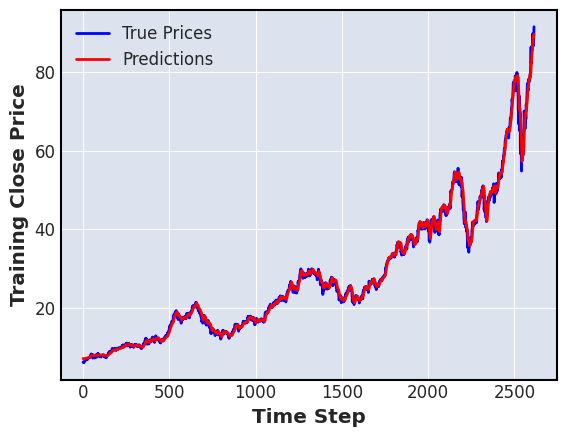

28/28 [==============================] - 0s 2ms/step


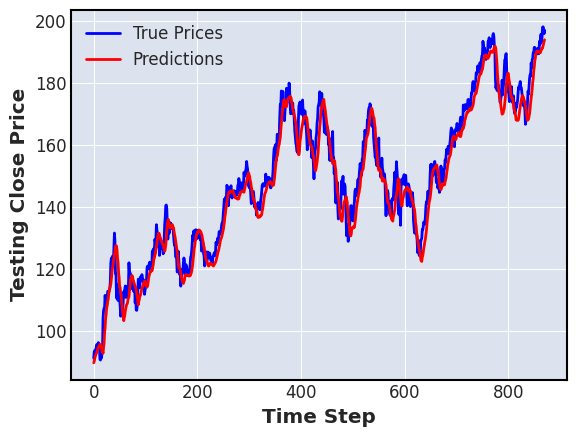

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 2s 9ms/step - loss: 2.6962e-04 - mae: 0.0095 - mse: 2.6962e-04 - mape: 29.7186 - val_loss: 7.6333e-04 - val_mae: 0.0215 - val_mse: 7.6333e-04 - val_mape: 5.8833
Epoch 2/10
82/82 [==============================] - 1s 6ms/step - loss: 3.5799e-05 - mae: 0.0037 - mse: 3.5799e-05 - mape: 8.9192 - val_loss: 4.9130e-04 - val_mae: 0.0179 - val_mse: 4.9130e-04 - val_mape: 4.8691
Epoch 3/10
82/82 [==============================] - 0s 6ms/step - loss: 3.0162e-05 - mae: 0.0034 - mse: 3.0162e-05 - mape: 7.9551 - val_loss: 5.7661e-04 - val_mae: 0.0187 - val_mse: 5.7661e-04 - val_mape: 5.1085
Epoch 4/10
82/82 [==============================] - 0s 6ms/step - loss: 2.4753e-05 - mae: 0.0032 - mse: 2.4753e-05 - mape: 7.6328 - val_loss: 5.0882e-04 - val_mae: 0.0176 - val_mse: 5.0882e-04 - val_mape: 4.7993
Epoch 5/10
82/82 [==============================] - 1s 7ms/step - loss: 2.203

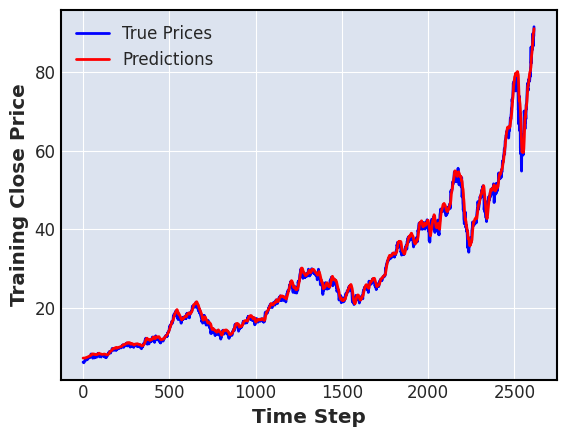

28/28 [==============================] - 0s 3ms/step


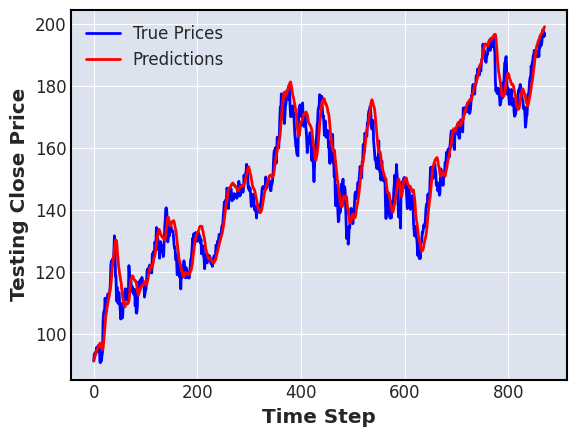

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 2s 10ms/step - loss: 1.3315e-04 - mae: 0.0060 - mse: 1.3315e-04 - mape: 17.3694 - val_loss: 5.7915e-04 - val_mae: 0.0188 - val_mse: 5.7915e-04 - val_mape: 5.1142
Epoch 2/10
82/82 [==============================] - 1s 6ms/step - loss: 2.2528e-05 - mae: 0.0031 - mse: 2.2528e-05 - mape: 7.7533 - val_loss: 8.4696e-04 - val_mae: 0.0246 - val_mse: 8.4696e-04 - val_mape: 6.5577
Epoch 3/10
82/82 [==============================] - 1s 7ms/step - loss: 1.4656e-05 - mae: 0.0025 - mse: 1.4656e-05 - mape: 6.2951 - val_loss: 6.4509e-04 - val_mae: 0.0213 - val_mse: 6.4509e-04 - val_mape: 5.6827
Epoch 4/10
82/82 [==============================] - 1s 7ms/step - loss: 1.2763e-05 - mae: 0.0023 - mse: 1.2763e-05 - mape: 5.9465 - val_loss: 2.0647e-04 - val_mae: 0.0110 - val_mse: 2.0647e-04 - val_mape: 2.9993
Epoch 5/10
82/82 [==============================] - 0s 6ms/step - loss: 1.14

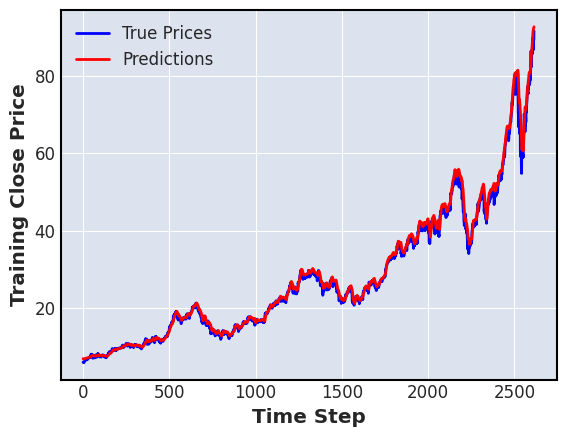

28/28 [==============================] - 0s 2ms/step


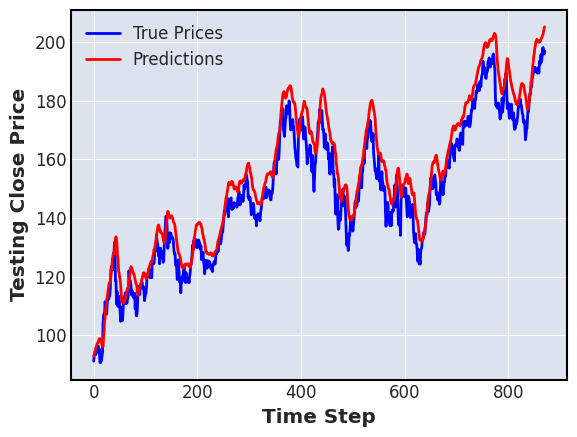

---------------------------------------------------------------
ticker_name :  MSFT Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 2s 21ms/step - loss: 1.3823e-04 - mae: 0.0085 - mse: 1.3823e-04 - mape: 19.2152 - val_loss: 3.2349e-04 - val_mae: 0.0168 - val_mse: 3.2349e-04 - val_mape: 17.3619
Epoch 2/10
28/28 [==============================] - 0s 11ms/step - loss: 1.1316e-05 - mae: 0.0027 - mse: 1.1316e-05 - mape: 6.0428 - val_loss: 9.5296e-05 - val_mae: 0.0085 - val_mse: 9.5296e-05 - val_mape: 8.5940
Epoch 3/10
28/28 [==============================] - 0s 11ms/step - loss: 7.1644e-06 - mae: 0.0021 - mse: 7.1644e-06 - mape: 4.5966 - val_loss: 3.3717e-05 - val_mae: 0.0046 - val_mse: 3.3717e-05 - val_mape: 4.7148
Epoch 4/10
28/28 [==============================] - 0s 11ms/step - loss: 6.2029e-06 - mae: 0.0019 - mse: 6.2029e-06 - mape: 4.3686 - val_loss: 2.6079e-05 - val_mae: 0.0040 - val_mse: 2.6079e-05 - val_mape: 4.1721
Epoch 5/10
28

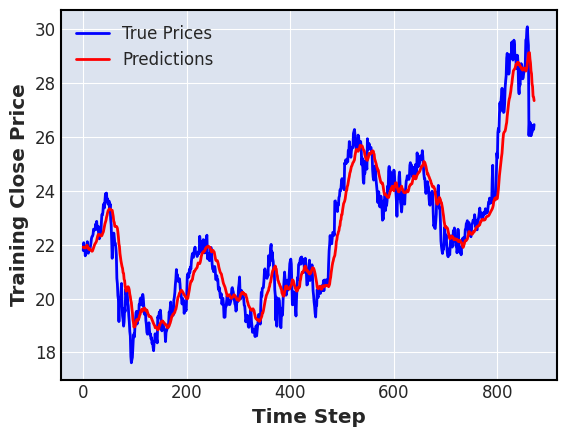

28/28 [==============================] - 0s 2ms/step


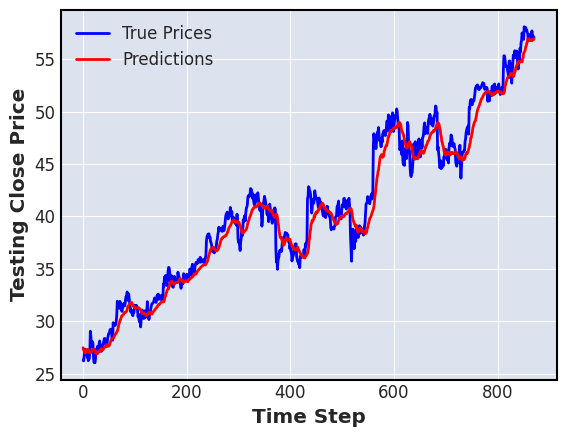

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 2s 19ms/step - loss: 2.2094e-04 - mae: 0.0103 - mse: 2.2094e-04 - mape: 23.1786 - val_loss: 2.1944e-04 - val_mae: 0.0126 - val_mse: 2.1944e-04 - val_mape: 12.4220
Epoch 2/10
28/28 [==============================] - 0s 8ms/step - loss: 1.6746e-05 - mae: 0.0032 - mse: 1.6746e-05 - mape: 7.1669 - val_loss: 2.9289e-04 - val_mae: 0.0154 - val_mse: 2.9289e-04 - val_mape: 15.5089
Epoch 3/10
28/28 [==============================] - 0s 8ms/step - loss: 1.1345e-05 - mae: 0.0026 - mse: 1.1345e-05 - mape: 5.9752 - val_loss: 1.8166e-04 - val_mae: 0.0119 - val_mse: 1.8166e-04 - val_mape: 12.0085
Epoch 4/10
28/28 [==============================] - 0s 8ms/step - loss: 9.1936e-06 - mae: 0.0024 - mse: 9.1936e-06 - mape: 5.3497 - val_loss: 6.2476e-05 - val_mae: 0.0063 - val_mse: 6.2476e-05 - val_mape: 6.2191
Epoch 5/10
28/28 [==============================] - 0s 8ms/step - loss: 8

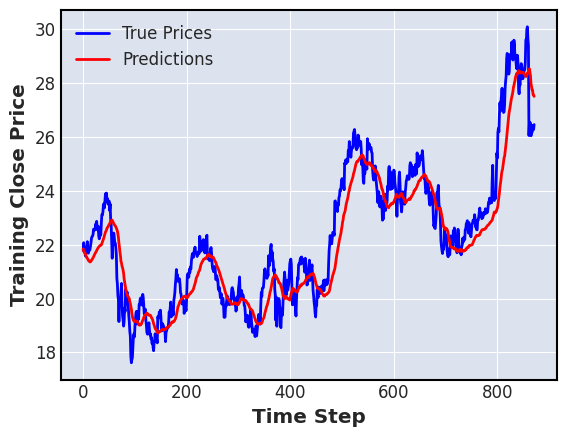

28/28 [==============================] - 0s 3ms/step


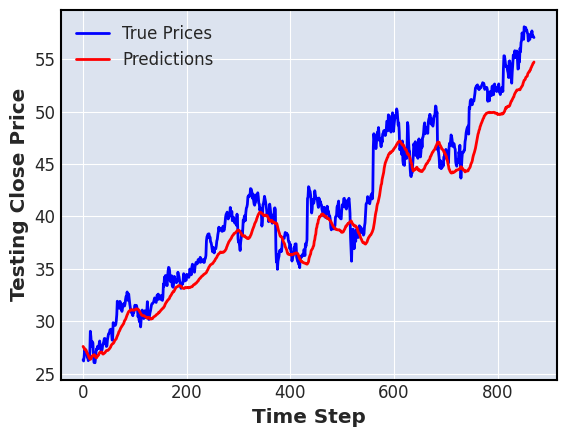

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 2s 20ms/step - loss: 1.3450e-04 - mae: 0.0082 - mse: 1.3450e-04 - mape: 18.6379 - val_loss: 3.3652e-04 - val_mae: 0.0170 - val_mse: 3.3652e-04 - val_mape: 17.4856
Epoch 2/10
28/28 [==============================] - 0s 9ms/step - loss: 1.0127e-05 - mae: 0.0025 - mse: 1.0127e-05 - mape: 5.5797 - val_loss: 1.0998e-04 - val_mae: 0.0092 - val_mse: 1.0998e-04 - val_mape: 9.4044
Epoch 3/10
28/28 [==============================] - 0s 10ms/step - loss: 7.0047e-06 - mae: 0.0021 - mse: 7.0047e-06 - mape: 4.7001 - val_loss: 3.4258e-05 - val_mae: 0.0047 - val_mse: 3.4258e-05 - val_mape: 4.8176
Epoch 4/10
28/28 [==============================] - 0s 12ms/step - loss: 6.1182e-06 - mae: 0.0019 - mse: 6.1182e-06 - mape: 4.3316 - val_loss: 2.2523e-05 - val_mae: 0.0037 - val_mse: 2.2523e-05 - val_mape: 3.8796
Epoch 5/10
28/28 [==============================] - 0s 9ms/step - loss: 5

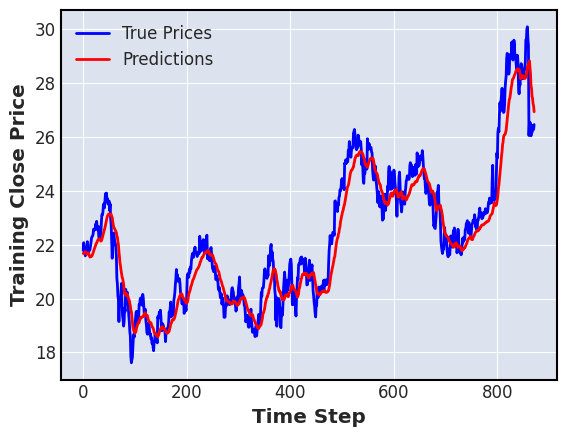

28/28 [==============================] - 0s 2ms/step


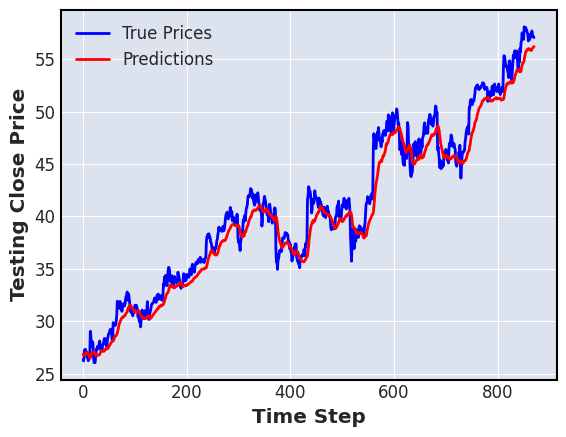

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 2s 12ms/step - loss: 1.9624e-04 - mae: 0.0087 - mse: 1.9624e-04 - mape: 13.4727 - val_loss: 2.5151e-04 - val_mae: 0.0089 - val_mse: 2.5151e-04 - val_mape: 3.0373
Epoch 2/10
55/55 [==============================] - 0s 6ms/step - loss: 1.2784e-05 - mae: 0.0026 - mse: 1.2784e-05 - mape: 4.0188 - val_loss: 2.8108e-04 - val_mae: 0.0102 - val_mse: 2.8108e-04 - val_mape: 3.5701
Epoch 3/10
55/55 [==============================] - 0s 6ms/step - loss: 1.1443e-05 - mae: 0.0025 - mse: 1.1443e-05 - mape: 3.8191 - val_loss: 2.0494e-04 - val_mae: 0.0079 - val_mse: 2.0494e-04 - val_mape: 2.7359
Epoch 4/10
55/55 [==============================] - 0s 7ms/step - loss: 1.1022e-05 - mae: 0.0024 - mse: 1.1022e-05 - mape: 3.6581 - val_loss: 1.9513e-04 - val_mae: 0.0078 - val_mse: 1.9513e-04 - val_mape: 2.7154
Epoch 5/10
55/55 [==============================] - 0s 6ms/st

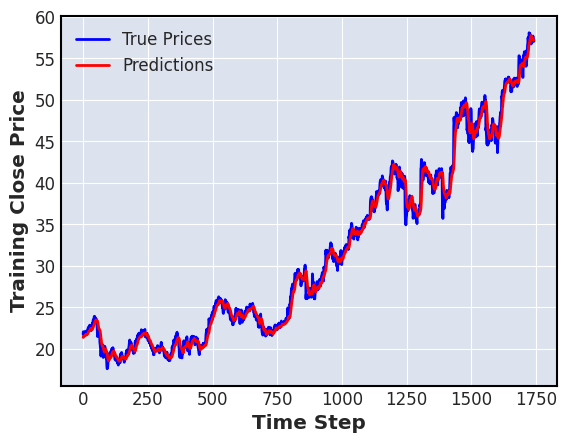

28/28 [==============================] - 0s 2ms/step


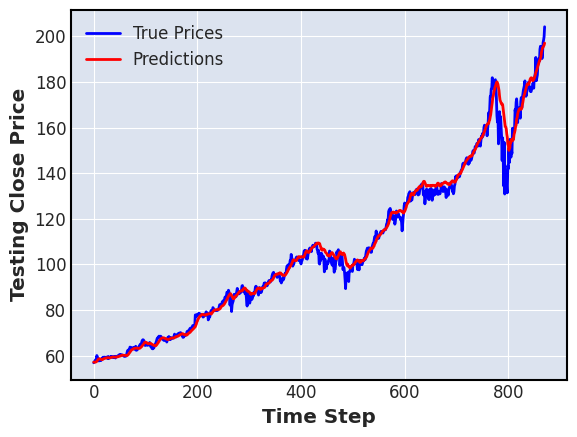

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 2s 12ms/step - loss: 3.0239e-04 - mae: 0.0104 - mse: 3.0239e-04 - mape: 16.5585 - val_loss: 2.6938e-04 - val_mae: 0.0095 - val_mse: 2.6938e-04 - val_mape: 3.2900
Epoch 2/10
55/55 [==============================] - 0s 8ms/step - loss: 1.8185e-05 - mae: 0.0032 - mse: 1.8185e-05 - mape: 4.8457 - val_loss: 3.0392e-04 - val_mae: 0.0095 - val_mse: 3.0392e-04 - val_mape: 3.2978
Epoch 3/10
55/55 [==============================] - 0s 7ms/step - loss: 1.6537e-05 - mae: 0.0030 - mse: 1.6537e-05 - mape: 4.6022 - val_loss: 3.1717e-04 - val_mae: 0.0103 - val_mse: 3.1717e-04 - val_mape: 3.6417
Epoch 4/10
55/55 [==============================] - 0s 8ms/step - loss: 1.5664e-05 - mae: 0.0029 - mse: 1.5664e-05 - mape: 4.4697 - val_loss: 2.5370e-04 - val_mae: 0.0086 - val_mse: 2.5370e-04 - val_mape: 2.9284
Epoch 5/10
55/55 [==============================] - 0s 8ms/step - loss: 1.53

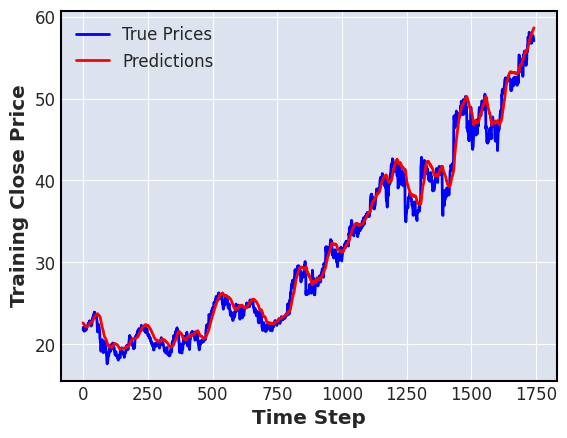

28/28 [==============================] - 0s 3ms/step


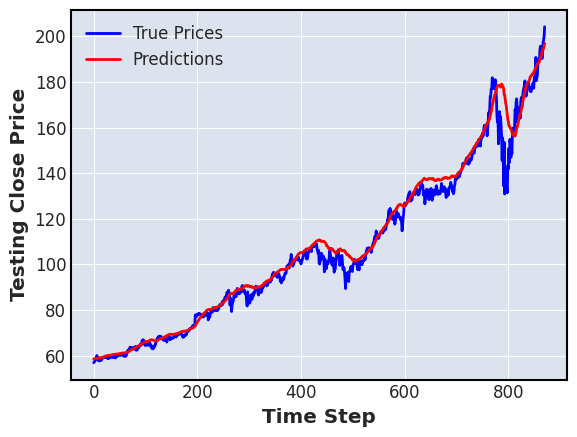

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 2s 13ms/step - loss: 1.9252e-04 - mae: 0.0081 - mse: 1.9252e-04 - mape: 12.4217 - val_loss: 3.0506e-04 - val_mae: 0.0107 - val_mse: 3.0506e-04 - val_mape: 3.6874
Epoch 2/10
55/55 [==============================] - 0s 6ms/step - loss: 1.1695e-05 - mae: 0.0025 - mse: 1.1695e-05 - mape: 3.8861 - val_loss: 2.9545e-04 - val_mae: 0.0106 - val_mse: 2.9545e-04 - val_mape: 3.6229
Epoch 3/10
55/55 [==============================] - 0s 6ms/step - loss: 1.0510e-05 - mae: 0.0024 - mse: 1.0510e-05 - mape: 3.6412 - val_loss: 3.3452e-04 - val_mae: 0.0120 - val_mse: 3.3452e-04 - val_mape: 4.1849
Epoch 4/10
55/55 [==============================] - 0s 7ms/step - loss: 1.0148e-05 - mae: 0.0023 - mse: 1.0148e-05 - mape: 3.5613 - val_loss: 4.0793e-04 - val_mae: 0.0144 - val_mse: 4.0793e-04 - val_mape: 5.0680
Epoch 5/10
55/55 [==============================] - 0s 6ms/step - loss: 9.45

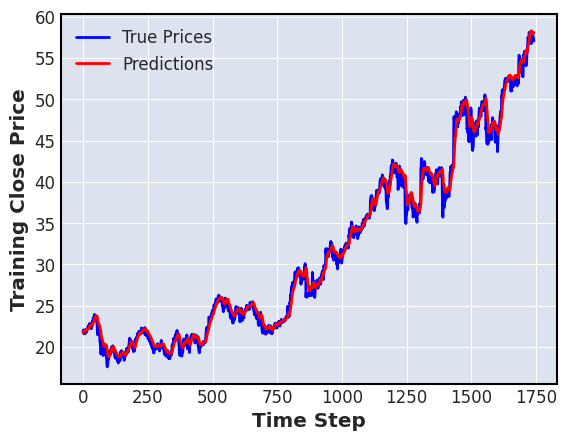

28/28 [==============================] - 0s 2ms/step


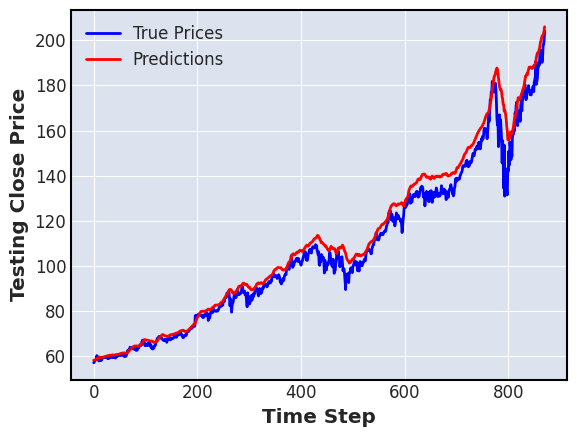

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 2s 10ms/step - loss: 8.3866e-04 - mae: 0.0133 - mse: 8.3866e-04 - mape: 11.4550 - val_loss: 0.0011 - val_mae: 0.0268 - val_mse: 0.0011 - val_mape: 3.8466
Epoch 2/10
82/82 [==============================] - 0s 5ms/step - loss: 8.3331e-05 - mae: 0.0050 - mse: 8.3331e-05 - mape: 4.0132 - val_loss: 9.6940e-04 - val_mae: 0.0250 - val_mse: 9.6940e-04 - val_mape: 3.5366
Epoch 3/10
82/82 [==============================] - 0s 6ms/step - loss: 9.1864e-05 - mae: 0.0057 - mse: 9.1864e-05 - mape: 4.5842 - val_loss: 8.4651e-04 - val_mae: 0.0234 - val_mse: 8.4651e-04 - val_mape: 3.3124
Epoch 4/10
82/82 [==============================] - 0s 5ms/step - loss: 6.0081e-05 - mae: 0.0045 - mse: 6.0081e-05 - mape: 3.8239 - val_loss: 0.0010 - val_mae: 0.0247 - val_mse: 0.0010 - val_mape: 3.6075
Epoch 5/10
82/82 [==============================] - 1s 6ms/step - loss: 5.842

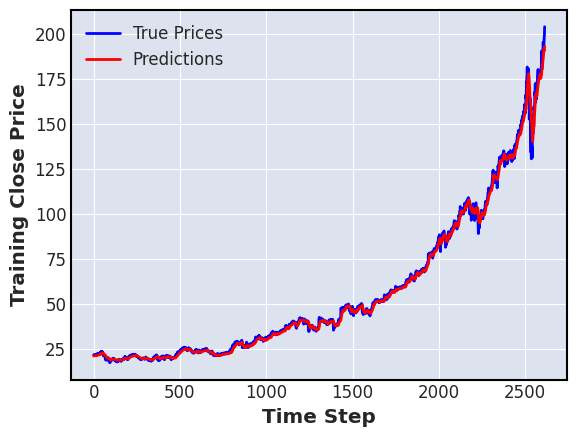

28/28 [==============================] - 0s 2ms/step


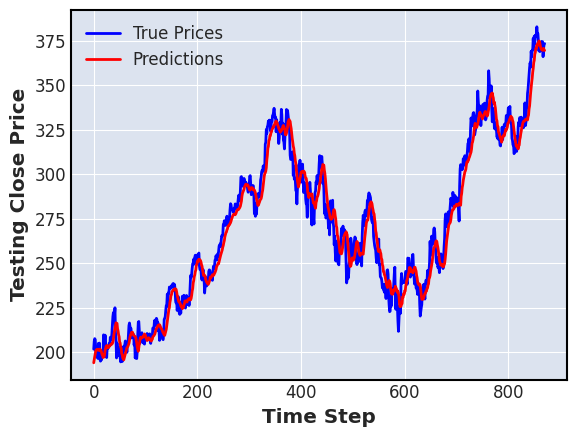

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 2s 10ms/step - loss: 0.0013 - mae: 0.0182 - mse: 0.0013 - mape: 16.1407 - val_loss: 0.0022 - val_mae: 0.0375 - val_mse: 0.0022 - val_mape: 5.4308
Epoch 2/10
82/82 [==============================] - 0s 6ms/step - loss: 1.0064e-04 - mae: 0.0053 - mse: 1.0064e-04 - mape: 4.5107 - val_loss: 0.0014 - val_mae: 0.0304 - val_mse: 0.0014 - val_mape: 4.3276
Epoch 3/10
82/82 [==============================] - 0s 6ms/step - loss: 9.5132e-05 - mae: 0.0053 - mse: 9.5132e-05 - mape: 4.4754 - val_loss: 0.0016 - val_mae: 0.0319 - val_mse: 0.0016 - val_mape: 4.5963
Epoch 4/10
82/82 [==============================] - 1s 6ms/step - loss: 9.2601e-05 - mae: 0.0052 - mse: 9.2601e-05 - mape: 4.3266 - val_loss: 0.0013 - val_mae: 0.0291 - val_mse: 0.0013 - val_mape: 4.0962
Epoch 5/10
82/82 [==============================] - 0s 6ms/step - loss: 8.9154e-05 - mae: 0.0052 - mse: 8.9154e-05 -

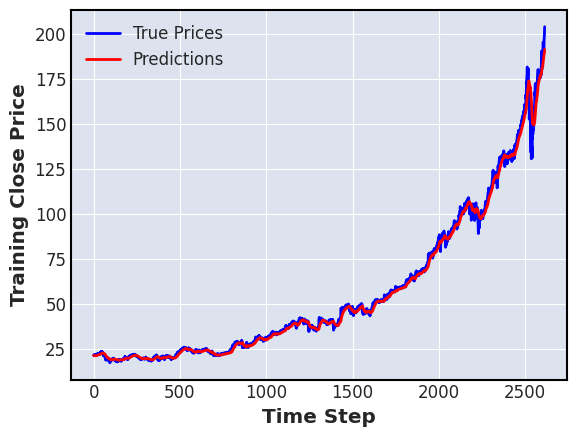

28/28 [==============================] - 0s 2ms/step


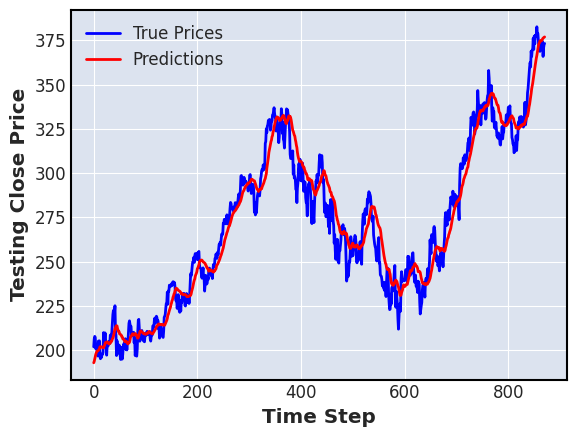

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 2s 8ms/step - loss: 8.0841e-04 - mae: 0.0134 - mse: 8.0841e-04 - mape: 11.7914 - val_loss: 0.0011 - val_mae: 0.0268 - val_mse: 0.0011 - val_mape: 3.7836
Epoch 2/10
82/82 [==============================] - 0s 5ms/step - loss: 8.7333e-05 - mae: 0.0052 - mse: 8.7333e-05 - mape: 4.3921 - val_loss: 0.0016 - val_mae: 0.0313 - val_mse: 0.0016 - val_mape: 4.5487
Epoch 3/10
82/82 [==============================] - 0s 5ms/step - loss: 7.0011e-05 - mae: 0.0047 - mse: 7.0011e-05 - mape: 3.9877 - val_loss: 0.0015 - val_mae: 0.0310 - val_mse: 0.0015 - val_mape: 4.5086
Epoch 4/10
82/82 [==============================] - 1s 7ms/step - loss: 5.7976e-05 - mae: 0.0042 - mse: 5.7976e-05 - mape: 3.5425 - val_loss: 9.3530e-04 - val_mae: 0.0240 - val_mse: 9.3530e-04 - val_mape: 3.4767
Epoch 5/10
82/82 [==============================] - 0s 6ms/step - loss: 5.7694e-05 - mae: 0.0042 - ms

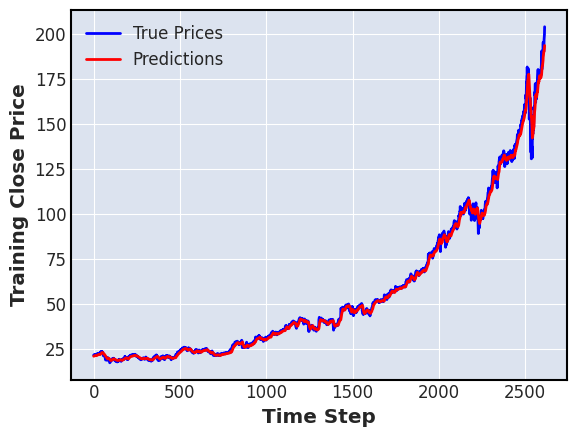

28/28 [==============================] - 0s 2ms/step


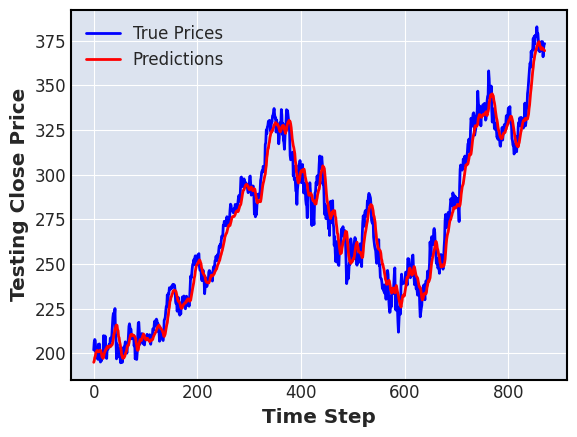

---------------------------------------------------------------


In [40]:
number_of_runs = 0
for ticker_index, ticker_name in enumerate(My_Tickers_SP500):
    full_data = x_tickers_sp500[ticker_index]
    target = y_tickers_sp500[ticker_index]
    print('ticker_name : ' ,ticker_name[0], ticker_name[1] , ' , length = ', len(full_data))
    
    # Time Series Split
    for j, (train_index, test_index) in enumerate(tss.split(full_data)):
        print('kth split : ', j)
        # Different Seeds
        for new_seed in range(3):
            print('seed : ', new_seed)
            seed_value = new_seed
            random.seed(seed_value)
            np.random.seed(seed_value)
            tf.random.set_seed(seed_value)
            utils.set_random_seed(seed_value)

            number_of_runs += 1
            full_data = np.reshape(full_data, (full_data.shape[0], full_data.shape[1], 1))
            
            X_train, X_val = full_data[train_index], full_data[test_index]
            y_train, y_val = target[train_index], target[test_index]

            cnn_model = StockPredictionMLPandCNN(input_size=full_data.shape[1], model='CNN')
            cnn_model.fit(X_train, y_train, X_val, y_val, epoch=10)
            
            train_pred = cnn_model.predict(X_train)
            train_pred = scaler.inverse_transform(train_pred.reshape(-1, 1))
            y_train = scaler.inverse_transform(y_train.reshape(-1, 1))
            plot_results(train_pred, y_train, 'Training')
            test_pred = cnn_model.predict(X_val)
            test_pred = scaler.inverse_transform(test_pred.reshape(-1, 1))
            y_val = scaler.inverse_transform(y_val.reshape(-1, 1))
            plot_results(test_pred, y_val, 'Testing')
            print('---------------------------------------------------------------')

### Conv_LSTM

ticker_name :  AMZN Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 7s 58ms/step - loss: 4.3769e-05 - mae: 0.0053 - mse: 4.3769e-05 - mape: 12911.9209 - val_loss: 0.0014 - val_mae: 0.0307 - val_mse: 0.0014 - val_mape: 55.2694
Epoch 2/10
28/28 [==============================] - 1s 40ms/step - loss: 2.4878e-05 - mae: 0.0041 - mse: 2.4878e-05 - mape: 11893.9609 - val_loss: 0.0012 - val_mae: 0.0298 - val_mse: 0.0012 - val_mape: 55.6987
Epoch 3/10
28/28 [==============================] - 1s 40ms/step - loss: 1.5762e-05 - mae: 0.0033 - mse: 1.5762e-05 - mape: 7703.4268 - val_loss: 7.6366e-04 - val_mae: 0.0221 - val_mse: 7.6366e-04 - val_mape: 37.8364
Epoch 4/10
28/28 [==============================] - 1s 40ms/step - loss: 3.6555e-06 - mae: 0.0015 - mse: 3.6555e-06 - mape: 5537.8813 - val_loss: 4.8355e-04 - val_mae: 0.0160 - val_mse: 4.8355e-04 - val_mape: 24.5768
Epoch 5/10
28/28 [==============================] - 1s 43ms/step - loss: 1.56

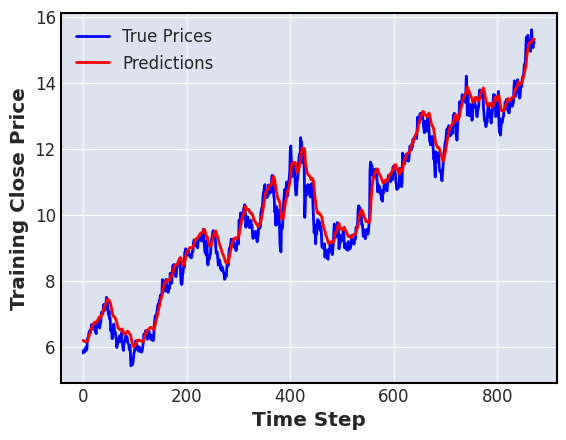

28/28 [==============================] - 0s 8ms/step


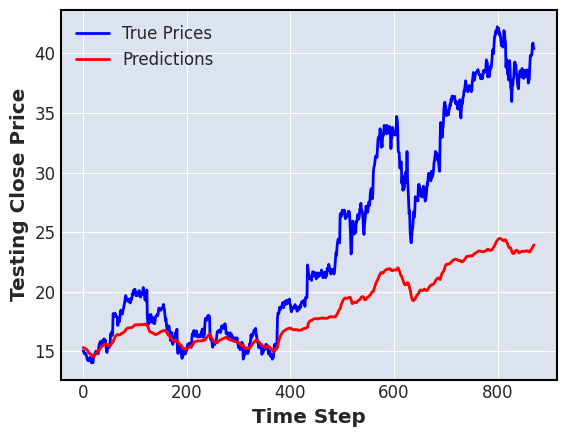

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 6s 58ms/step - loss: 4.7713e-05 - mae: 0.0055 - mse: 4.7713e-05 - mape: 11543.6328 - val_loss: 0.0014 - val_mae: 0.0315 - val_mse: 0.0014 - val_mape: 58.3785
Epoch 2/10
28/28 [==============================] - 1s 45ms/step - loss: 2.2252e-05 - mae: 0.0039 - mse: 2.2252e-05 - mape: 11346.2705 - val_loss: 0.0010 - val_mae: 0.0265 - val_mse: 0.0010 - val_mape: 48.3094
Epoch 3/10
28/28 [==============================] - 1s 46ms/step - loss: 8.2997e-06 - mae: 0.0023 - mse: 8.2997e-06 - mape: 8908.7705 - val_loss: 4.7727e-04 - val_mae: 0.0152 - val_mse: 4.7727e-04 - val_mape: 22.3900
Epoch 4/10
28/28 [==============================] - 1s 40ms/step - loss: 2.0949e-06 - mae: 0.0012 - mse: 2.0949e-06 - mape: 1998.8479 - val_loss: 4.5434e-04 - val_mae: 0.0149 - val_mse: 4.5434e-04 - val_mape: 21.9851
Epoch 5/10
28/28 [==============================] - 1s 43ms/step - loss:

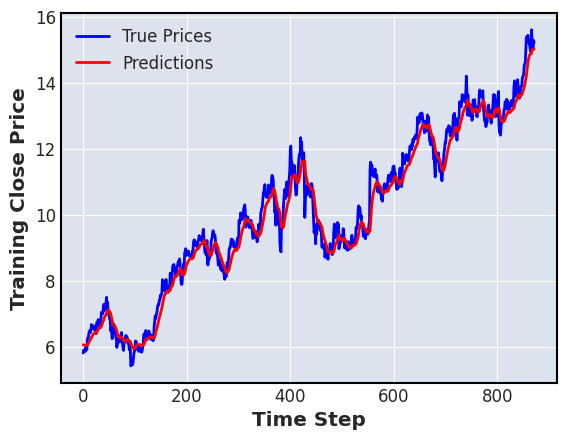

28/28 [==============================] - 0s 9ms/step


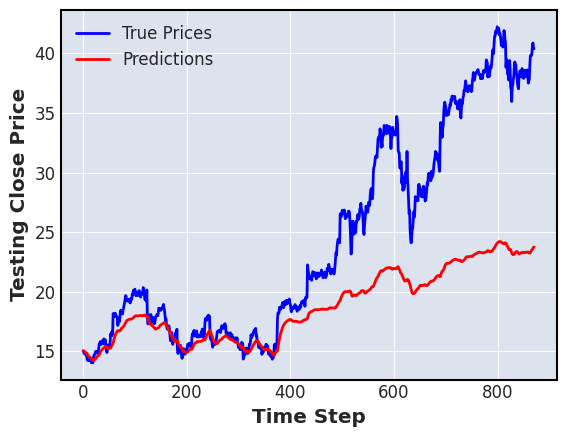

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 6s 64ms/step - loss: 4.0471e-05 - mae: 0.0050 - mse: 4.0471e-05 - mape: 13915.6709 - val_loss: 0.0012 - val_mae: 0.0299 - val_mse: 0.0012 - val_mape: 54.8362
Epoch 2/10
28/28 [==============================] - 1s 43ms/step - loss: 2.0035e-05 - mae: 0.0037 - mse: 2.0035e-05 - mape: 10528.6514 - val_loss: 7.7648e-04 - val_mae: 0.0229 - val_mse: 7.7648e-04 - val_mape: 40.6243
Epoch 3/10
28/28 [==============================] - 1s 42ms/step - loss: 8.2223e-06 - mae: 0.0023 - mse: 8.2223e-06 - mape: 4788.3311 - val_loss: 2.6675e-04 - val_mae: 0.0123 - val_mse: 2.6675e-04 - val_mape: 19.6273
Epoch 4/10
28/28 [==============================] - 1s 43ms/step - loss: 1.2279e-06 - mae: 8.6360e-04 - mse: 1.2279e-06 - mape: 4595.2339 - val_loss: 1.7947e-04 - val_mae: 0.0097 - val_mse: 1.7947e-04 - val_mape: 15.0768
Epoch 5/10
28/28 [==============================] - 1s 44ms/

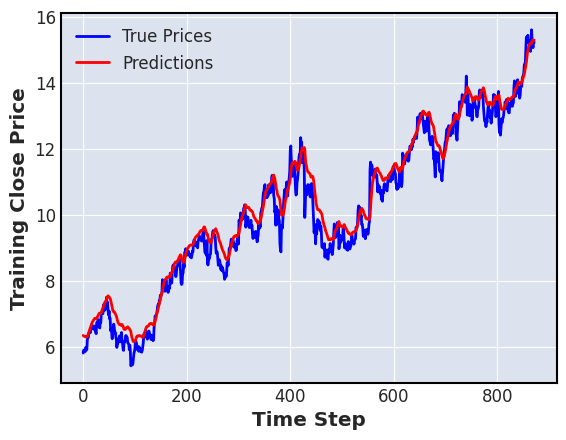

28/28 [==============================] - 0s 8ms/step


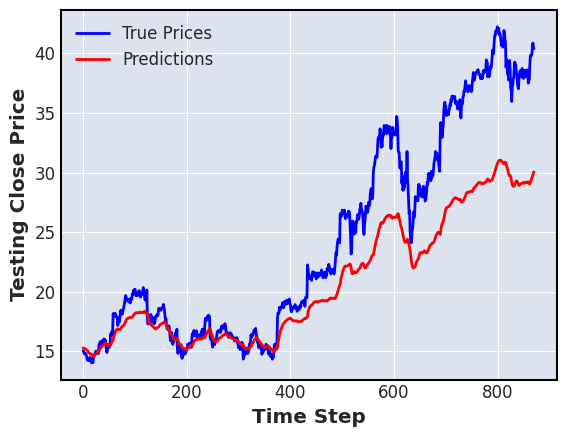

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 6s 46ms/step - loss: 3.2606e-04 - mae: 0.0125 - mse: 3.2606e-04 - mape: 5436.8398 - val_loss: 0.0034 - val_mae: 0.0481 - val_mse: 0.0034 - val_mape: 21.3730
Epoch 2/10
55/55 [==============================] - 2s 38ms/step - loss: 5.5808e-06 - mae: 0.0017 - mse: 5.5808e-06 - mape: 2109.2004 - val_loss: 0.0039 - val_mae: 0.0535 - val_mse: 0.0039 - val_mape: 24.2972
Epoch 3/10
55/55 [==============================] - 2s 39ms/step - loss: 3.7705e-06 - mae: 0.0014 - mse: 3.7705e-06 - mape: 1893.2638 - val_loss: 0.0039 - val_mae: 0.0530 - val_mse: 0.0039 - val_mape: 23.9892
Epoch 4/10
55/55 [==============================] - 2s 37ms/step - loss: 4.0977e-06 - mae: 0.0015 - mse: 4.0977e-06 - mape: 1734.2434 - val_loss: 0.0037 - val_mae: 0.0515 - val_mse: 0.0037 - val_mape: 23.2305
Epoch 5/10
55/55 [==============================] - 2s 36ms/step - loss: 3.

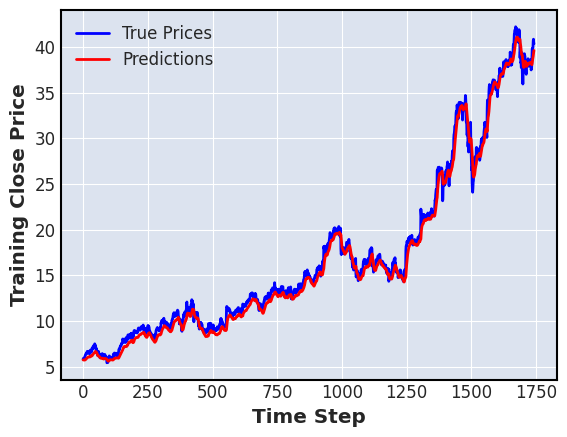

28/28 [==============================] - 0s 8ms/step


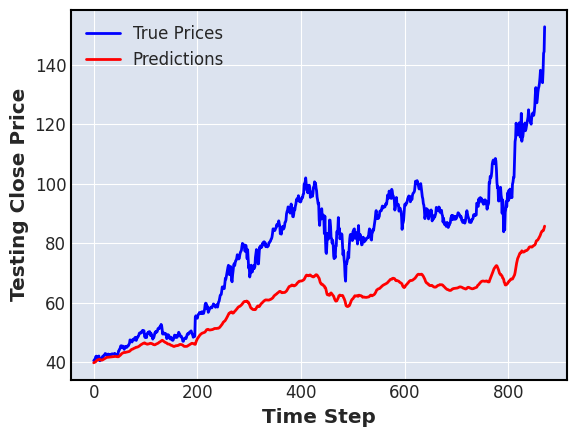

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 6s 46ms/step - loss: 2.7328e-04 - mae: 0.0108 - mse: 2.7328e-04 - mape: 13763.6387 - val_loss: 0.0064 - val_mae: 0.0700 - val_mse: 0.0064 - val_mape: 32.3628
Epoch 2/10
55/55 [==============================] - 2s 36ms/step - loss: 5.0205e-06 - mae: 0.0016 - mse: 5.0205e-06 - mape: 2663.3640 - val_loss: 0.0055 - val_mae: 0.0636 - val_mse: 0.0055 - val_mape: 28.9380
Epoch 3/10
55/55 [==============================] - 2s 38ms/step - loss: 3.6974e-06 - mae: 0.0013 - mse: 3.6974e-06 - mape: 1813.7755 - val_loss: 0.0054 - val_mae: 0.0627 - val_mse: 0.0054 - val_mape: 28.4713
Epoch 4/10
55/55 [==============================] - 2s 38ms/step - loss: 4.4188e-06 - mae: 0.0016 - mse: 4.4188e-06 - mape: 2378.2488 - val_loss: 0.0055 - val_mae: 0.0638 - val_mse: 0.0055 - val_mape: 29.1134
Epoch 5/10
55/55 [==============================] - 2s 39ms/step - loss: 3.5682e-06 - mae

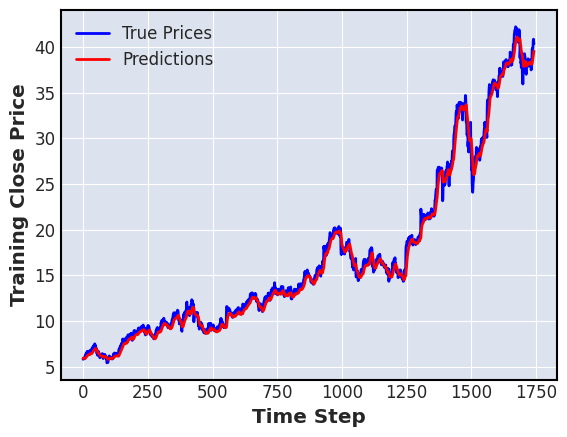

28/28 [==============================] - 0s 9ms/step


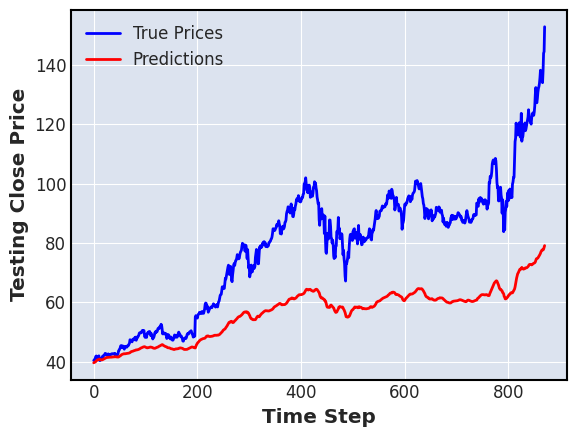

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 6s 45ms/step - loss: 2.7464e-04 - mae: 0.0116 - mse: 2.7464e-04 - mape: 18044.9473 - val_loss: 8.5638e-05 - val_mae: 0.0069 - val_mse: 8.5638e-05 - val_mape: 3.7446
Epoch 2/10
55/55 [==============================] - 2s 37ms/step - loss: 5.6317e-06 - mae: 0.0017 - mse: 5.6317e-06 - mape: 3852.5151 - val_loss: 4.8007e-04 - val_mae: 0.0177 - val_mse: 4.8007e-04 - val_mape: 7.9775
Epoch 3/10
55/55 [==============================] - 2s 39ms/step - loss: 3.2132e-06 - mae: 0.0012 - mse: 3.2132e-06 - mape: 1115.5670 - val_loss: 4.7379e-04 - val_mae: 0.0175 - val_mse: 4.7379e-04 - val_mape: 7.8896
Epoch 4/10
55/55 [==============================] - 2s 43ms/step - loss: 3.2783e-06 - mae: 0.0013 - mse: 3.2783e-06 - mape: 1061.5331 - val_loss: 4.0425e-04 - val_mae: 0.0158 - val_mse: 4.0425e-04 - val_mape: 6.9839
Epoch 5/10
55/55 [==============================] - 2s 45ms/s

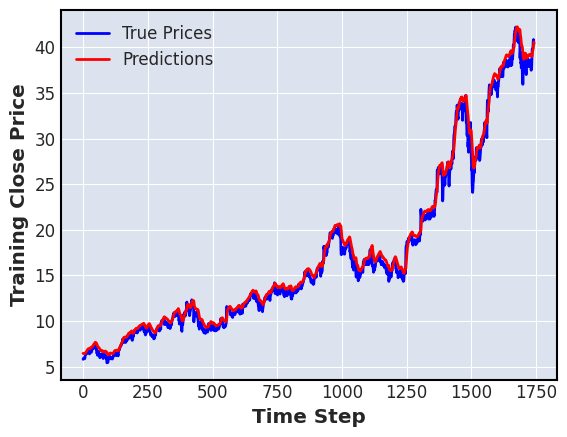

28/28 [==============================] - 0s 8ms/step


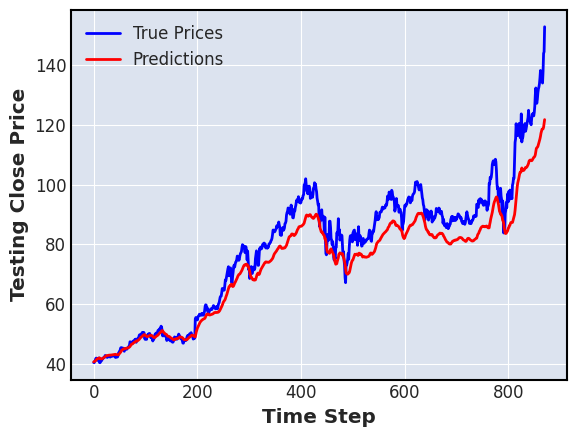

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 9s 70ms/step - loss: 0.0026 - mae: 0.0272 - mse: 0.0026 - mape: 15786.7754 - val_loss: 4.9212e-04 - val_mae: 0.0184 - val_mse: 4.9212e-04 - val_mape: 4.9831
Epoch 2/10
82/82 [==============================] - 3s 34ms/step - loss: 2.6964e-05 - mae: 0.0033 - mse: 2.6964e-05 - mape: 927.8525 - val_loss: 2.3098e-04 - val_mae: 0.0117 - val_mse: 2.3098e-04 - val_mape: 3.3848
Epoch 3/10
82/82 [==============================] - 3s 35ms/step - loss: 2.5487e-05 - mae: 0.0032 - mse: 2.5487e-05 - mape: 196.2393 - val_loss: 2.2360e-04 - val_mae: 0.0114 - val_mse: 2.2360e-04 - val_mape: 3.3191
Epoch 4/10
82/82 [==============================] - 3s 35ms/step - loss: 2.7384e-05 - mae: 0.0034 - mse: 2.7384e-05 - mape: 227.0876 - val_loss: 3.1934e-04 - val_mae: 0.0138 - val_mse: 3.1934e-04 - val_mape: 3.9696
Epoch 5/10
82/82 [==============================] - 3s 35

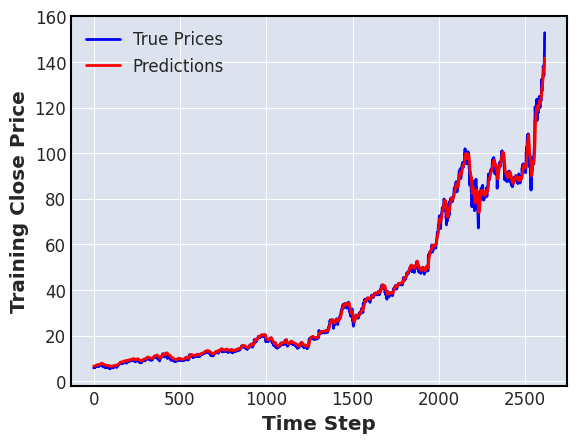

28/28 [==============================] - 0s 8ms/step


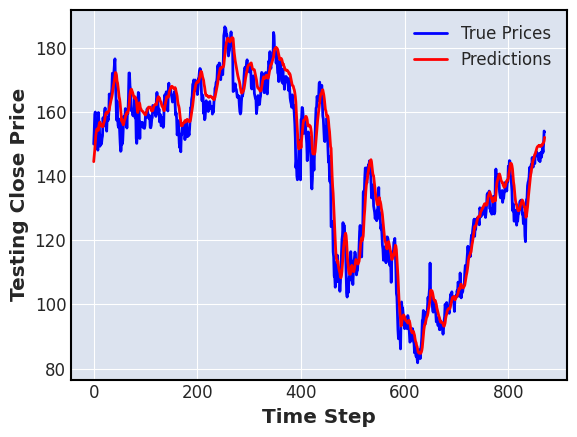

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 8s 47ms/step - loss: 0.0027 - mae: 0.0292 - mse: 0.0027 - mape: 15730.3154 - val_loss: 4.0768e-04 - val_mae: 0.0161 - val_mse: 4.0768e-04 - val_mape: 4.5043
Epoch 2/10
82/82 [==============================] - 3s 40ms/step - loss: 2.8169e-05 - mae: 0.0034 - mse: 2.8169e-05 - mape: 2561.8271 - val_loss: 2.8298e-04 - val_mae: 0.0126 - val_mse: 2.8298e-04 - val_mape: 3.7297
Epoch 3/10
82/82 [==============================] - 3s 37ms/step - loss: 2.6060e-05 - mae: 0.0032 - mse: 2.6060e-05 - mape: 1309.0515 - val_loss: 2.6332e-04 - val_mae: 0.0123 - val_mse: 2.6332e-04 - val_mape: 3.5850
Epoch 4/10
82/82 [==============================] - 3s 36ms/step - loss: 2.5085e-05 - mae: 0.0030 - mse: 2.5085e-05 - mape: 1308.2040 - val_loss: 2.8942e-04 - val_mae: 0.0128 - val_mse: 2.8942e-04 - val_mape: 3.7880
Epoch 5/10
82/82 [==============================] - 3s 38ms/step - lo

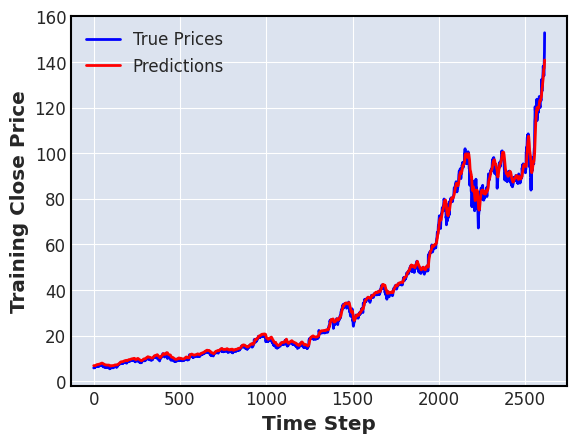

28/28 [==============================] - 0s 8ms/step


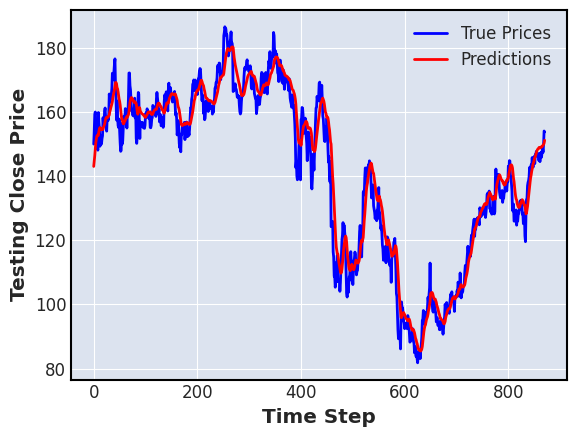

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 7s 41ms/step - loss: 0.0017 - mae: 0.0220 - mse: 0.0017 - mape: 8311.4619 - val_loss: 3.8659e-04 - val_mae: 0.0161 - val_mse: 3.8659e-04 - val_mape: 4.4713
Epoch 2/10
82/82 [==============================] - 3s 35ms/step - loss: 2.5900e-05 - mae: 0.0032 - mse: 2.5900e-05 - mape: 1106.6395 - val_loss: 3.7085e-04 - val_mae: 0.0149 - val_mse: 3.7085e-04 - val_mape: 4.3067
Epoch 3/10
82/82 [==============================] - 3s 35ms/step - loss: 2.5058e-05 - mae: 0.0031 - mse: 2.5058e-05 - mape: 1510.3846 - val_loss: 5.1875e-04 - val_mae: 0.0183 - val_mse: 5.1875e-04 - val_mape: 5.2178
Epoch 4/10
82/82 [==============================] - 3s 40ms/step - loss: 2.4916e-05 - mae: 0.0031 - mse: 2.4916e-05 - mape: 1625.3627 - val_loss: 3.7446e-04 - val_mae: 0.0151 - val_mse: 3.7446e-04 - val_mape: 4.2975
Epoch 5/10
82/82 [==============================] - 3s 36ms/step - los

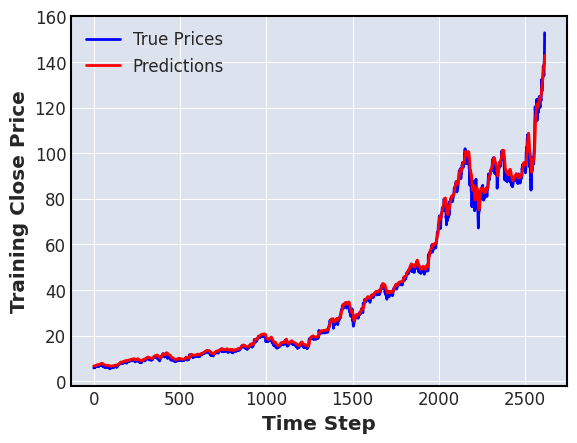

28/28 [==============================] - 0s 9ms/step


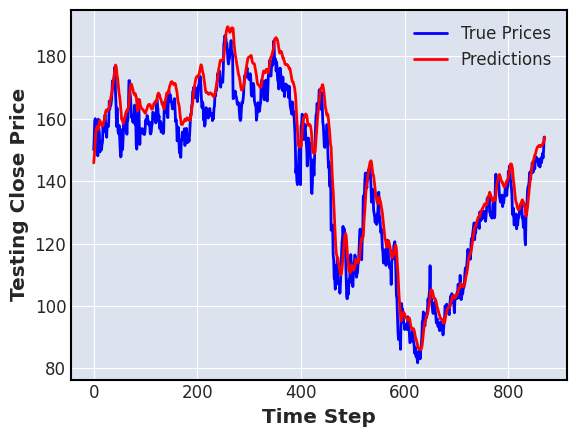

---------------------------------------------------------------
ticker_name :  IBM Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 6s 63ms/step - loss: 0.0297 - mae: 0.1491 - mse: 0.0297 - mape: 55.6547 - val_loss: 0.0020 - val_mae: 0.0429 - val_mse: 0.0020 - val_mape: 16.5132
Epoch 2/10
28/28 [==============================] - 1s 44ms/step - loss: 0.0018 - mae: 0.0366 - mse: 0.0018 - mape: 14.9836 - val_loss: 3.1109e-04 - val_mae: 0.0141 - val_mse: 3.1109e-04 - val_mape: 5.5496
Epoch 3/10
28/28 [==============================] - 1s 44ms/step - loss: 9.5889e-04 - mae: 0.0264 - mse: 9.5889e-04 - mape: 11.2108 - val_loss: 2.6505e-04 - val_mae: 0.0131 - val_mse: 2.6505e-04 - val_mape: 5.1245
Epoch 4/10
28/28 [==============================] - 1s 43ms/step - loss: 8.1049e-04 - mae: 0.0242 - mse: 8.1049e-04 - mape: 10.2642 - val_loss: 2.2499e-04 - val_mae: 0.0121 - val_mse: 2.2499e-04 - val_mape: 4.7087
Epoch 5/10
28/28 [=================

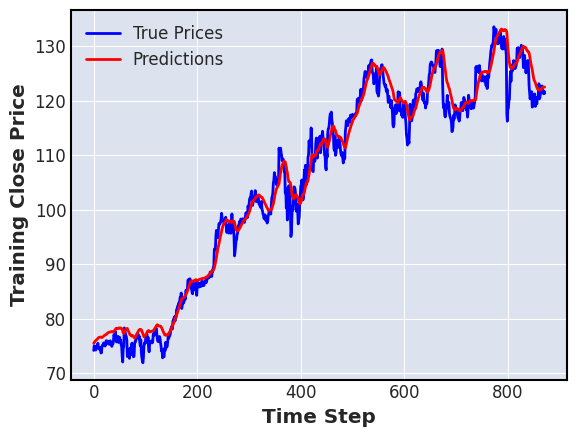

28/28 [==============================] - 0s 8ms/step


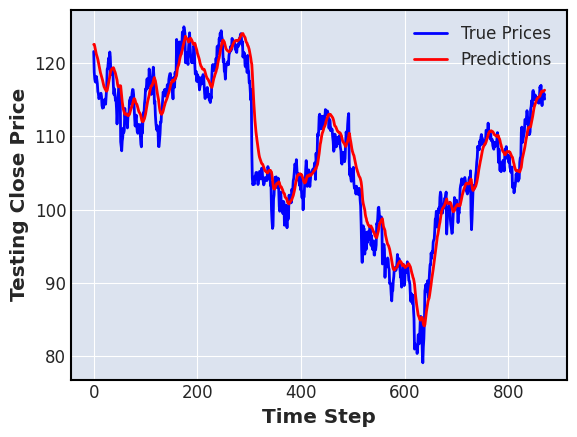

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 5s 56ms/step - loss: 0.0354 - mae: 0.1684 - mse: 0.0354 - mape: 62.9017 - val_loss: 5.7995e-04 - val_mae: 0.0195 - val_mse: 5.7995e-04 - val_mape: 7.8068
Epoch 2/10
28/28 [==============================] - 1s 39ms/step - loss: 0.0018 - mae: 0.0362 - mse: 0.0018 - mape: 14.8051 - val_loss: 3.2975e-04 - val_mae: 0.0149 - val_mse: 3.2975e-04 - val_mape: 5.5124
Epoch 3/10
28/28 [==============================] - 1s 40ms/step - loss: 0.0010 - mae: 0.0271 - mse: 0.0010 - mape: 11.5051 - val_loss: 2.8963e-04 - val_mae: 0.0140 - val_mse: 2.8963e-04 - val_mape: 5.2069
Epoch 4/10
28/28 [==============================] - 1s 40ms/step - loss: 8.8066e-04 - mae: 0.0252 - mse: 8.8066e-04 - mape: 10.7123 - val_loss: 2.6082e-04 - val_mae: 0.0132 - val_mse: 2.6082e-04 - val_mape: 4.9374
Epoch 5/10
28/28 [==============================] - 1s 40ms/step - loss: 7.6606e-04 - mae: 0.0

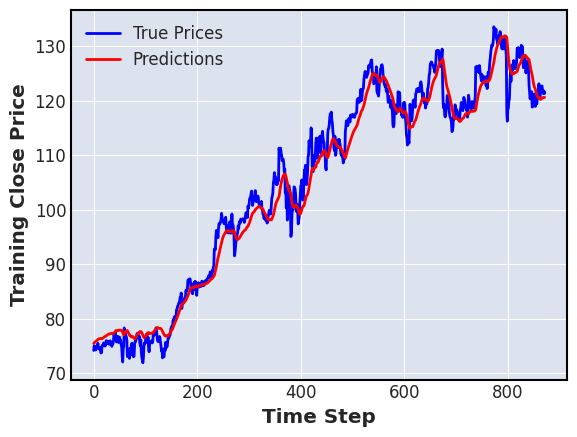

28/28 [==============================] - 0s 8ms/step


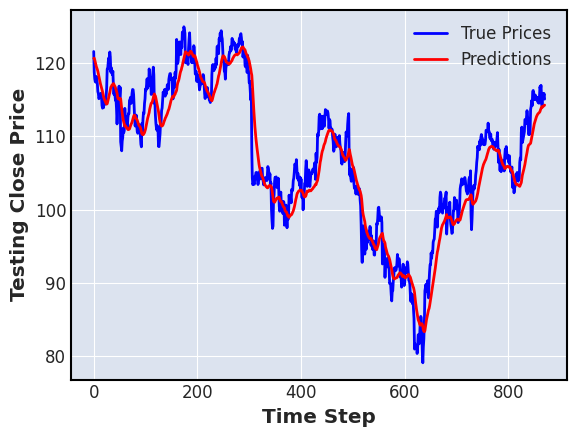

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 5s 55ms/step - loss: 0.0199 - mae: 0.1147 - mse: 0.0199 - mape: 43.8456 - val_loss: 3.3212e-04 - val_mae: 0.0143 - val_mse: 3.3212e-04 - val_mape: 5.7353
Epoch 2/10
28/28 [==============================] - 1s 42ms/step - loss: 9.7281e-04 - mae: 0.0258 - mse: 9.7281e-04 - mape: 10.3929 - val_loss: 1.8991e-04 - val_mae: 0.0112 - val_mse: 1.8991e-04 - val_mape: 4.3074
Epoch 3/10
28/28 [==============================] - 1s 39ms/step - loss: 5.9417e-04 - mae: 0.0209 - mse: 5.9417e-04 - mape: 8.7928 - val_loss: 1.6688e-04 - val_mae: 0.0105 - val_mse: 1.6688e-04 - val_mape: 3.9921
Epoch 4/10
28/28 [==============================] - 1s 44ms/step - loss: 4.9114e-04 - mae: 0.0189 - mse: 4.9114e-04 - mape: 7.9750 - val_loss: 1.4281e-04 - val_mae: 0.0097 - val_mse: 1.4281e-04 - val_mape: 3.6425
Epoch 5/10
28/28 [==============================] - 1s 43ms/step - loss: 3.7048e

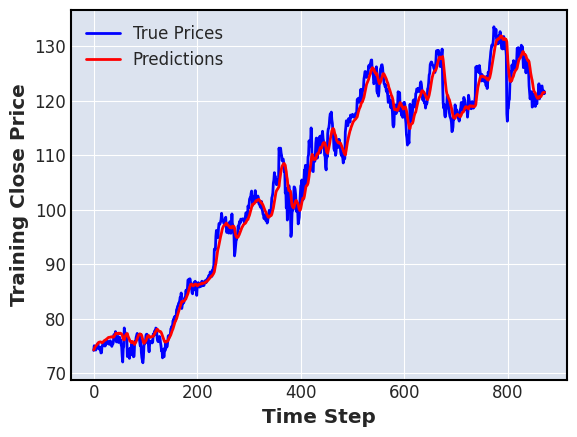

28/28 [==============================] - 0s 8ms/step


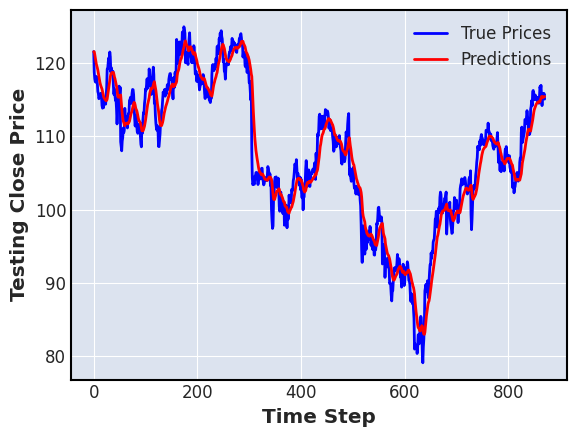

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 6s 44ms/step - loss: 0.0158 - mae: 0.0919 - mse: 0.0158 - mape: 34.3339 - val_loss: 2.3894e-04 - val_mae: 0.0109 - val_mse: 2.3894e-04 - val_mape: 4.2388
Epoch 2/10
55/55 [==============================] - 2s 35ms/step - loss: 5.9936e-04 - mae: 0.0196 - mse: 5.9936e-04 - mape: 8.0852 - val_loss: 2.1780e-04 - val_mae: 0.0104 - val_mse: 2.1780e-04 - val_mape: 4.0383
Epoch 3/10
55/55 [==============================] - 2s 36ms/step - loss: 4.9265e-04 - mae: 0.0179 - mse: 4.9265e-04 - mape: 7.3252 - val_loss: 2.0032e-04 - val_mae: 0.0102 - val_mse: 2.0032e-04 - val_mape: 4.0255
Epoch 4/10
55/55 [==============================] - 2s 36ms/step - loss: 3.4372e-04 - mae: 0.0148 - mse: 3.4372e-04 - mape: 6.0644 - val_loss: 1.4008e-04 - val_mae: 0.0084 - val_mse: 1.4008e-04 - val_mape: 3.2350
Epoch 5/10
55/55 [==============================] - 2s 35ms/step -

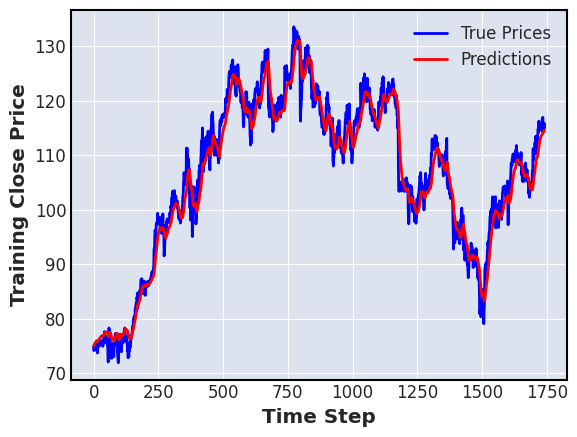

28/28 [==============================] - 0s 10ms/step


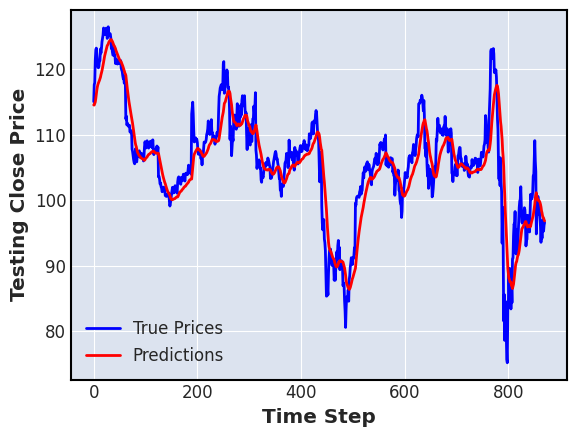

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 10s 48ms/step - loss: 0.0189 - mae: 0.1031 - mse: 0.0189 - mape: 38.5507 - val_loss: 3.5491e-04 - val_mae: 0.0153 - val_mse: 3.5491e-04 - val_mape: 5.6680
Epoch 2/10
55/55 [==============================] - 2s 36ms/step - loss: 6.5519e-04 - mae: 0.0206 - mse: 6.5519e-04 - mape: 8.4403 - val_loss: 2.3302e-04 - val_mae: 0.0109 - val_mse: 2.3302e-04 - val_mape: 4.2667
Epoch 3/10
55/55 [==============================] - 2s 36ms/step - loss: 5.5447e-04 - mae: 0.0190 - mse: 5.5447e-04 - mape: 7.7995 - val_loss: 2.2293e-04 - val_mae: 0.0108 - val_mse: 2.2293e-04 - val_mape: 4.2976
Epoch 4/10
55/55 [==============================] - 2s 37ms/step - loss: 4.5109e-04 - mae: 0.0171 - mse: 4.5109e-04 - mape: 7.0127 - val_loss: 1.8723e-04 - val_mae: 0.0098 - val_mse: 1.8723e-04 - val_mape: 3.8851
Epoch 5/10
55/55 [==============================] - 2s 38ms/step - loss: 3.2712e

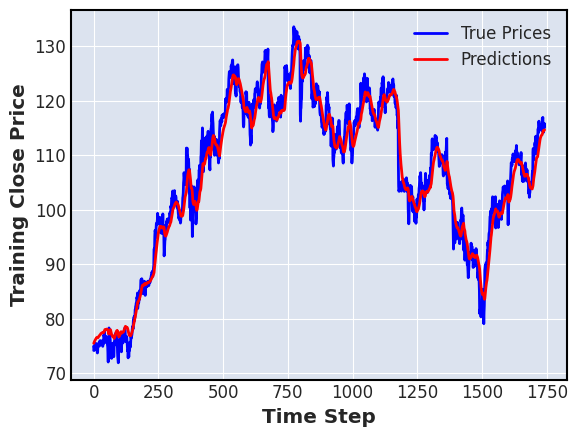

28/28 [==============================] - 0s 8ms/step


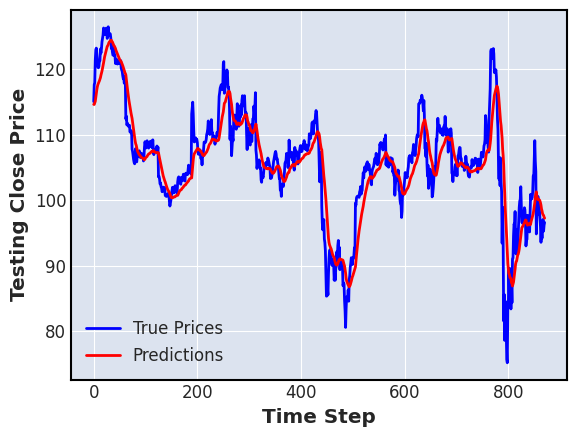

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 7s 47ms/step - loss: 0.0104 - mae: 0.0685 - mse: 0.0104 - mape: 25.8467 - val_loss: 2.0492e-04 - val_mae: 0.0106 - val_mse: 2.0492e-04 - val_mape: 4.2282
Epoch 2/10
55/55 [==============================] - 2s 38ms/step - loss: 4.0011e-04 - mae: 0.0162 - mse: 4.0011e-04 - mape: 6.5906 - val_loss: 1.8407e-04 - val_mae: 0.0101 - val_mse: 1.8407e-04 - val_mape: 4.0211
Epoch 3/10
55/55 [==============================] - 2s 37ms/step - loss: 3.1576e-04 - mae: 0.0143 - mse: 3.1576e-04 - mape: 5.8553 - val_loss: 1.3894e-04 - val_mae: 0.0084 - val_mse: 1.3894e-04 - val_mape: 3.3414
Epoch 4/10
55/55 [==============================] - 2s 37ms/step - loss: 2.0249e-04 - mae: 0.0113 - mse: 2.0249e-04 - mape: 4.6232 - val_loss: 9.4824e-05 - val_mae: 0.0068 - val_mse: 9.4824e-05 - val_mape: 2.6404
Epoch 5/10
55/55 [==============================] - 2s 37ms/step - loss: 9.4243e-

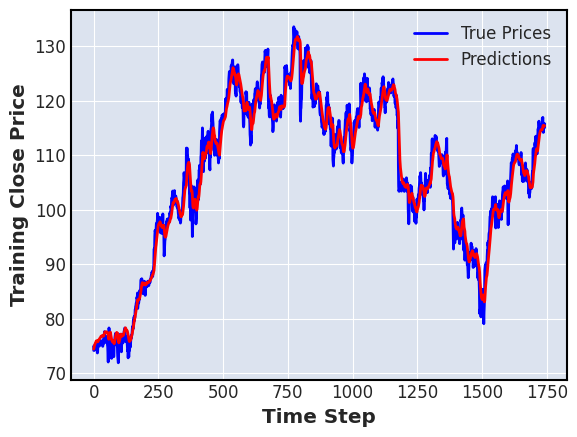

28/28 [==============================] - 0s 8ms/step


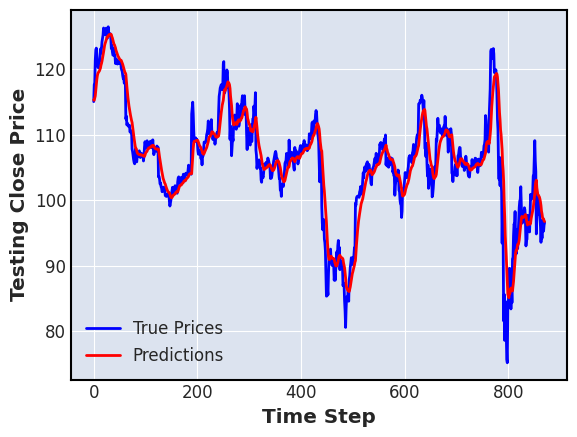

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 7s 41ms/step - loss: 0.0107 - mae: 0.0667 - mse: 0.0107 - mape: 25.0948 - val_loss: 0.0012 - val_mae: 0.0281 - val_mse: 0.0012 - val_mape: 8.6111
Epoch 2/10
82/82 [==============================] - 3s 35ms/step - loss: 3.8763e-04 - mae: 0.0152 - mse: 3.8763e-04 - mape: 6.1277 - val_loss: 6.1624e-04 - val_mae: 0.0201 - val_mse: 6.1624e-04 - val_mape: 6.1735
Epoch 3/10
82/82 [==============================] - 3s 36ms/step - loss: 1.3503e-04 - mae: 0.0087 - mse: 1.3503e-04 - mape: 3.4304 - val_loss: 2.5988e-04 - val_mae: 0.0124 - val_mse: 2.5988e-04 - val_mape: 3.8649
Epoch 4/10
82/82 [==============================] - 3s 40ms/step - loss: 7.3263e-05 - mae: 0.0063 - mse: 7.3263e-05 - mape: 2.4126 - val_loss: 1.7003e-04 - val_mae: 0.0097 - val_mse: 1.7003e-04 - val_mape: 3.0387
Epoch 5/10
82/82 [==============================] - 3s 41ms/step - loss: 6

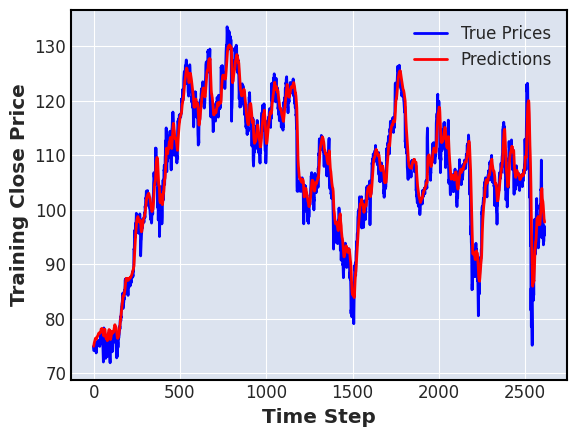

28/28 [==============================] - 0s 8ms/step


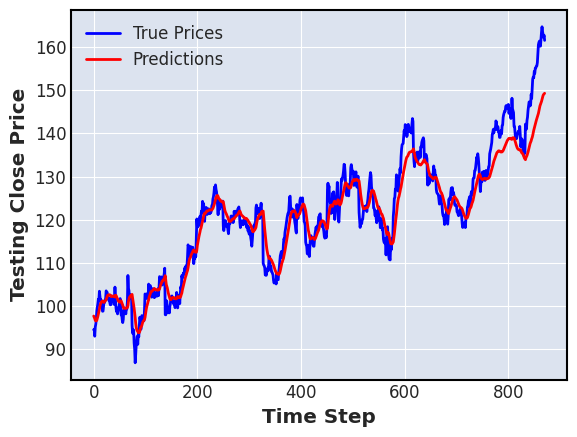

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 7s 40ms/step - loss: 0.0124 - mae: 0.0733 - mse: 0.0124 - mape: 27.6340 - val_loss: 0.0014 - val_mae: 0.0307 - val_mse: 0.0014 - val_mape: 9.3954
Epoch 2/10
82/82 [==============================] - 3s 33ms/step - loss: 4.6163e-04 - mae: 0.0166 - mse: 4.6163e-04 - mape: 6.7044 - val_loss: 8.4316e-04 - val_mae: 0.0236 - val_mse: 8.4316e-04 - val_mape: 7.3018
Epoch 3/10
82/82 [==============================] - 3s 33ms/step - loss: 3.7858e-04 - mae: 0.0150 - mse: 3.7858e-04 - mape: 6.0644 - val_loss: 8.2967e-04 - val_mae: 0.0235 - val_mse: 8.2967e-04 - val_mape: 7.2123
Epoch 4/10
82/82 [==============================] - 3s 35ms/step - loss: 2.6754e-04 - mae: 0.0125 - mse: 2.6754e-04 - mape: 5.0775 - val_loss: 4.1688e-04 - val_mae: 0.0165 - val_mse: 4.1688e-04 - val_mape: 5.0943
Epoch 5/10
82/82 [==============================] - 3s 33ms/step - loss: 1.4023e-04 - mae

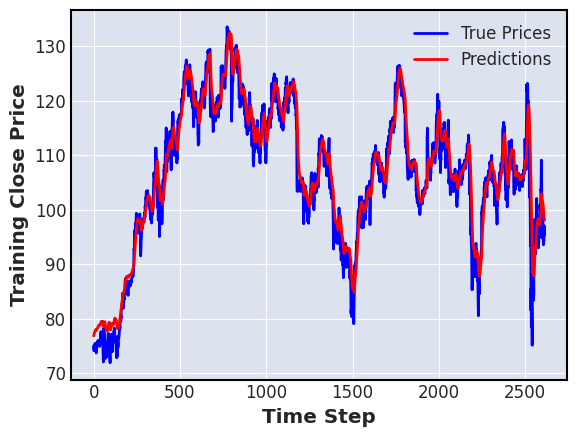

28/28 [==============================] - 0s 7ms/step


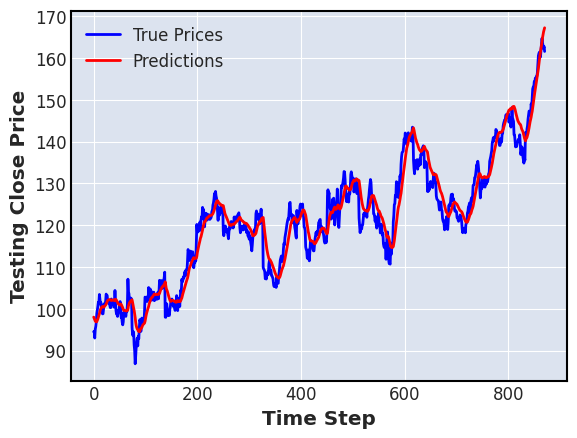

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 7s 45ms/step - loss: 0.0068 - mae: 0.0495 - mse: 0.0068 - mape: 18.8434 - val_loss: 8.2552e-04 - val_mae: 0.0234 - val_mse: 8.2552e-04 - val_mape: 7.1793
Epoch 2/10
82/82 [==============================] - 3s 38ms/step - loss: 2.9690e-04 - mae: 0.0133 - mse: 2.9690e-04 - mape: 5.3650 - val_loss: 4.3828e-04 - val_mae: 0.0167 - val_mse: 4.3828e-04 - val_mape: 5.2043
Epoch 3/10
82/82 [==============================] - 3s 37ms/step - loss: 1.9757e-04 - mae: 0.0108 - mse: 1.9757e-04 - mape: 4.3558 - val_loss: 2.8939e-04 - val_mae: 0.0135 - val_mse: 2.8939e-04 - val_mape: 4.1892
Epoch 4/10
82/82 [==============================] - 3s 33ms/step - loss: 9.5799e-05 - mae: 0.0074 - mse: 9.5799e-05 - mape: 2.9578 - val_loss: 1.2065e-04 - val_mae: 0.0087 - val_mse: 1.2065e-04 - val_mape: 2.7600
Epoch 5/10
82/82 [==============================] - 3s 35ms/step - loss: 5.4642e-

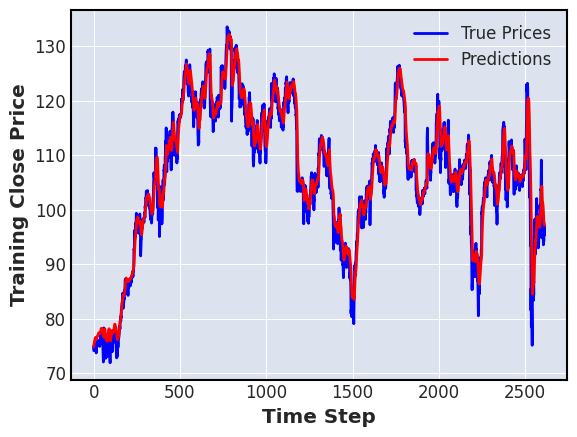

28/28 [==============================] - 0s 7ms/step


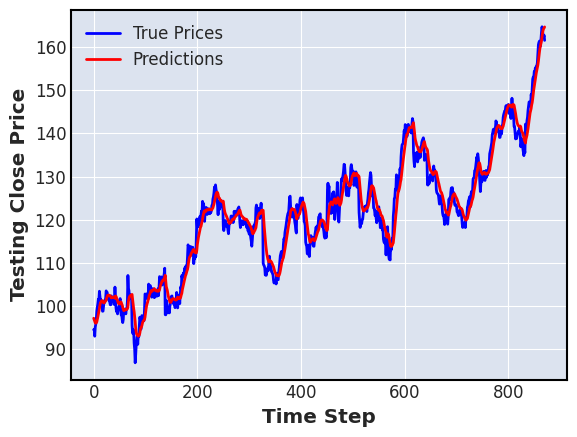

---------------------------------------------------------------
ticker_name :  KO Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 5s 54ms/step - loss: 4.5158e-04 - mae: 0.0163 - mse: 4.5158e-04 - mape: 35.8983 - val_loss: 5.2987e-04 - val_mae: 0.0224 - val_mse: 5.2987e-04 - val_mape: 31.9404
Epoch 2/10
28/28 [==============================] - 1s 42ms/step - loss: 7.9247e-05 - mae: 0.0073 - mse: 7.9247e-05 - mape: 16.3970 - val_loss: 3.5654e-04 - val_mae: 0.0181 - val_mse: 3.5654e-04 - val_mape: 25.6839
Epoch 3/10
28/28 [==============================] - 1s 38ms/step - loss: 7.2546e-05 - mae: 0.0070 - mse: 7.2546e-05 - mape: 15.9373 - val_loss: 2.9766e-04 - val_mae: 0.0164 - val_mse: 2.9766e-04 - val_mape: 23.2654
Epoch 4/10
28/28 [==============================] - 1s 38ms/step - loss: 7.0380e-05 - mae: 0.0069 - mse: 7.0380e-05 - mape: 15.8292 - val_loss: 3.0750e-04 - val_mae: 0.0168 - val_mse: 3.0750e-04 - val_mape: 23.7902
Epoch 5/1

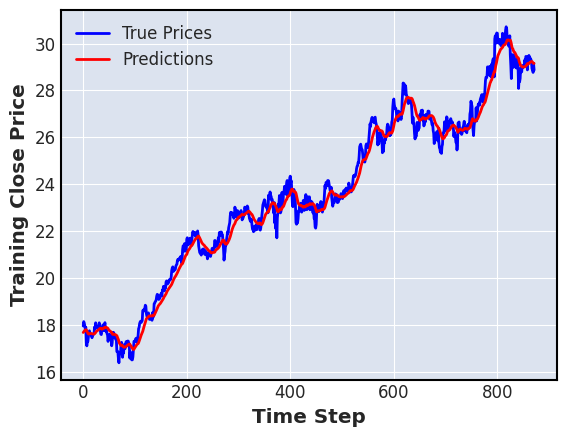

28/28 [==============================] - 0s 7ms/step


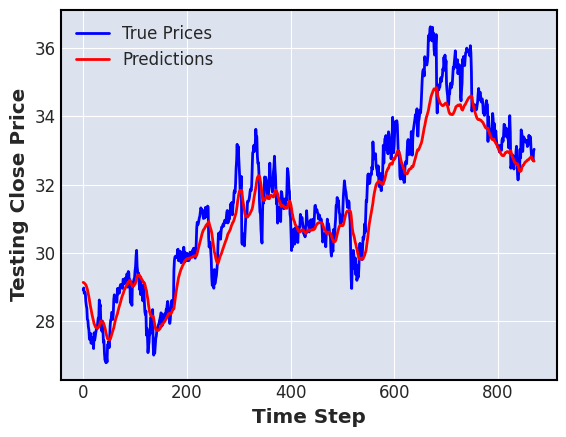

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 5s 54ms/step - loss: 5.0451e-04 - mae: 0.0170 - mse: 5.0451e-04 - mape: 36.9955 - val_loss: 4.2598e-04 - val_mae: 0.0199 - val_mse: 4.2598e-04 - val_mape: 28.2794
Epoch 2/10
28/28 [==============================] - 1s 38ms/step - loss: 8.4976e-05 - mae: 0.0076 - mse: 8.4976e-05 - mape: 16.8688 - val_loss: 3.7127e-04 - val_mae: 0.0185 - val_mse: 3.7127e-04 - val_mape: 26.2077
Epoch 3/10
28/28 [==============================] - 1s 38ms/step - loss: 7.5961e-05 - mae: 0.0072 - mse: 7.5961e-05 - mape: 16.2646 - val_loss: 3.5725e-04 - val_mae: 0.0181 - val_mse: 3.5725e-04 - val_mape: 25.7037
Epoch 4/10
28/28 [==============================] - 1s 39ms/step - loss: 7.2706e-05 - mae: 0.0070 - mse: 7.2706e-05 - mape: 16.0654 - val_loss: 3.6227e-04 - val_mae: 0.0183 - val_mse: 3.6227e-04 - val_mape: 25.9823
Epoch 5/10
28/28 [==============================] - 1s 44ms/step -

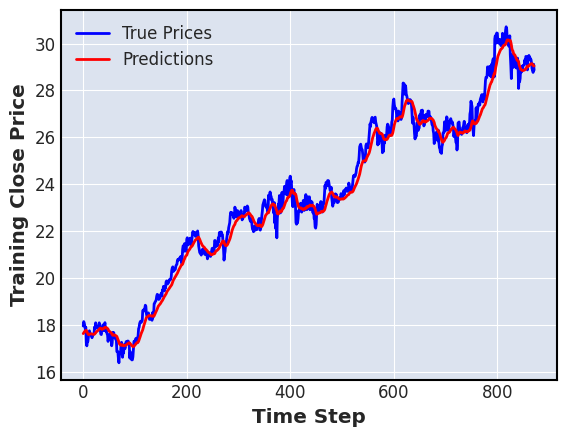

28/28 [==============================] - 0s 7ms/step


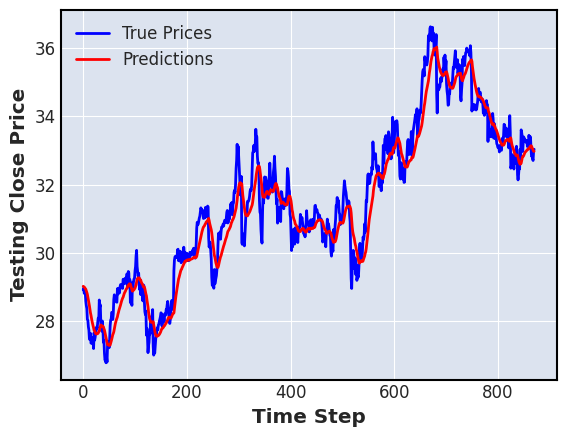

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 5s 56ms/step - loss: 3.4766e-04 - mae: 0.0138 - mse: 3.4766e-04 - mape: 29.8337 - val_loss: 4.4405e-04 - val_mae: 0.0205 - val_mse: 4.4405e-04 - val_mape: 29.2334
Epoch 2/10
28/28 [==============================] - 1s 38ms/step - loss: 6.1516e-05 - mae: 0.0065 - mse: 6.1516e-05 - mape: 14.7321 - val_loss: 2.8664e-04 - val_mae: 0.0162 - val_mse: 2.8664e-04 - val_mape: 23.0607
Epoch 3/10
28/28 [==============================] - 1s 39ms/step - loss: 5.6084e-05 - mae: 0.0062 - mse: 5.6084e-05 - mape: 14.2749 - val_loss: 2.3773e-04 - val_mae: 0.0147 - val_mse: 2.3773e-04 - val_mape: 20.8884
Epoch 4/10
28/28 [==============================] - 1s 38ms/step - loss: 5.0691e-05 - mae: 0.0059 - mse: 5.0691e-05 - mape: 13.3108 - val_loss: 2.1370e-04 - val_mae: 0.0140 - val_mse: 2.1370e-04 - val_mape: 19.8614
Epoch 5/10
28/28 [==============================] - 1s 42ms/step -

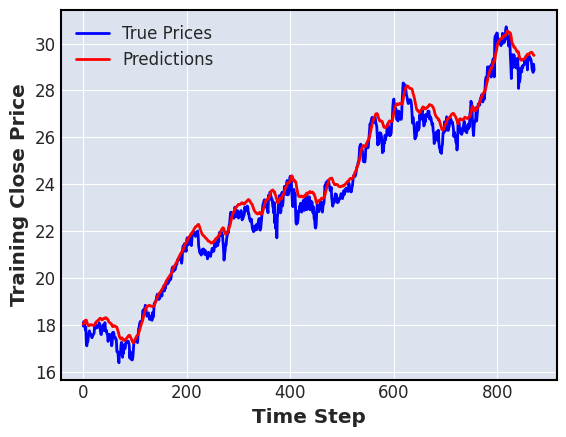

28/28 [==============================] - 0s 7ms/step


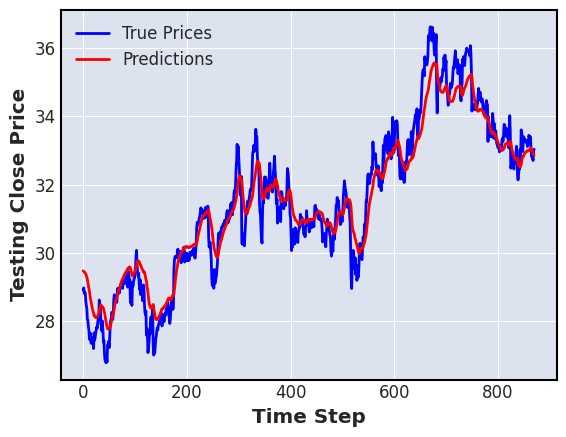

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 6s 43ms/step - loss: 4.4707e-04 - mae: 0.0156 - mse: 4.4707e-04 - mape: 29.1176 - val_loss: 0.0011 - val_mae: 0.0310 - val_mse: 0.0011 - val_mape: 32.7190
Epoch 2/10
55/55 [==============================] - 2s 34ms/step - loss: 1.1217e-04 - mae: 0.0089 - mse: 1.1217e-04 - mape: 17.4842 - val_loss: 6.1564e-04 - val_mae: 0.0230 - val_mse: 6.1564e-04 - val_mape: 24.1580
Epoch 3/10
55/55 [==============================] - 2s 36ms/step - loss: 4.0118e-05 - mae: 0.0047 - mse: 4.0118e-05 - mape: 9.2523 - val_loss: 6.5357e-05 - val_mae: 0.0059 - val_mse: 6.5357e-05 - val_mape: 5.8545
Epoch 4/10
55/55 [==============================] - 2s 35ms/step - loss: 2.4773e-06 - mae: 0.0012 - mse: 2.4773e-06 - mape: 2.2103 - val_loss: 6.8427e-05 - val_mae: 0.0061 - val_mse: 6.8427e-05 - val_mape: 6.0446
Epoch 5/10
55/55 [==============================] - 2s 35ms/ste

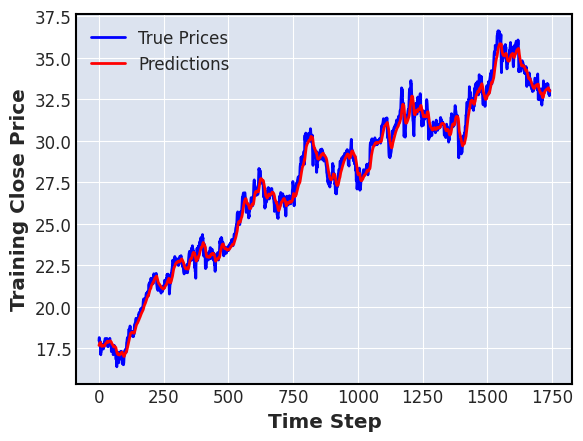

28/28 [==============================] - 0s 8ms/step


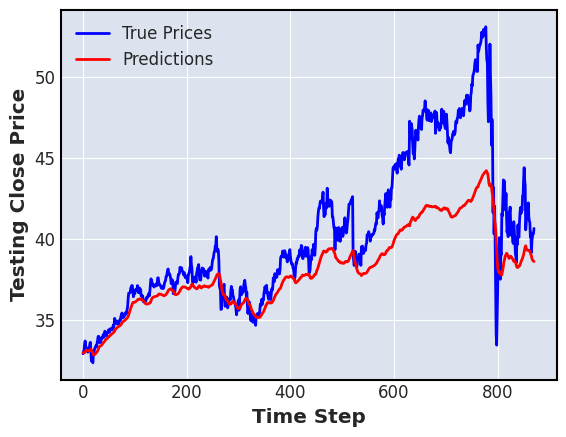

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 6s 44ms/step - loss: 4.9346e-04 - mae: 0.0164 - mse: 4.9346e-04 - mape: 30.2821 - val_loss: 8.5285e-04 - val_mae: 0.0272 - val_mse: 8.5285e-04 - val_mape: 28.4833
Epoch 2/10
55/55 [==============================] - 2s 40ms/step - loss: 1.2792e-04 - mae: 0.0094 - mse: 1.2792e-04 - mape: 18.7097 - val_loss: 7.3245e-04 - val_mae: 0.0252 - val_mse: 7.3245e-04 - val_mape: 26.4237
Epoch 3/10
55/55 [==============================] - 2s 42ms/step - loss: 7.3958e-05 - mae: 0.0068 - mse: 7.3958e-05 - mape: 13.6435 - val_loss: 6.7677e-05 - val_mae: 0.0067 - val_mse: 6.7677e-05 - val_mape: 6.8408
Epoch 4/10
55/55 [==============================] - 2s 42ms/step - loss: 3.1526e-06 - mae: 0.0014 - mse: 3.1526e-06 - mape: 2.5332 - val_loss: 3.7314e-05 - val_mae: 0.0046 - val_mse: 3.7314e-05 - val_mape: 4.6016
Epoch 5/10
55/55 [==============================] - 2s 39ms/step - lo

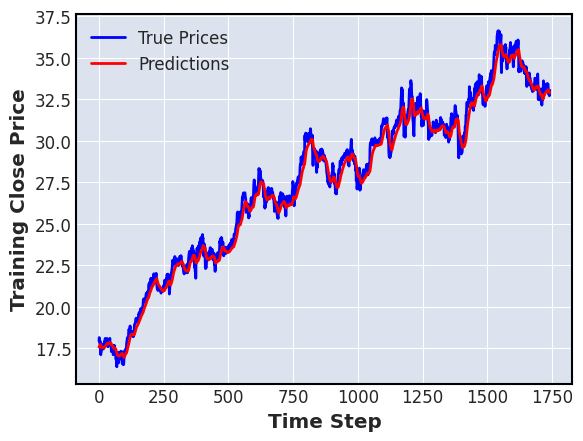

28/28 [==============================] - 0s 7ms/step


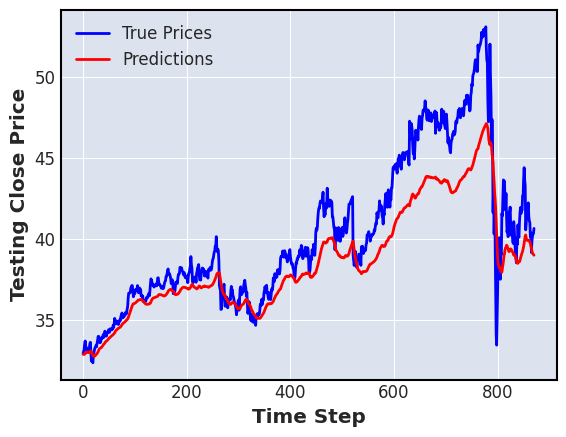

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 6s 44ms/step - loss: 3.4378e-04 - mae: 0.0133 - mse: 3.4378e-04 - mape: 24.6385 - val_loss: 6.0640e-04 - val_mae: 0.0229 - val_mse: 6.0640e-04 - val_mape: 24.0122
Epoch 2/10
55/55 [==============================] - 2s 35ms/step - loss: 7.0979e-05 - mae: 0.0069 - mse: 7.0979e-05 - mape: 13.8082 - val_loss: 2.1943e-04 - val_mae: 0.0133 - val_mse: 2.1943e-04 - val_mape: 13.7669
Epoch 3/10
55/55 [==============================] - 2s 35ms/step - loss: 6.8816e-06 - mae: 0.0019 - mse: 6.8816e-06 - mape: 3.5393 - val_loss: 8.0183e-05 - val_mae: 0.0069 - val_mse: 8.0183e-05 - val_mape: 6.8435
Epoch 4/10
55/55 [==============================] - 2s 37ms/step - loss: 2.0527e-06 - mae: 0.0011 - mse: 2.0527e-06 - mape: 1.9744 - val_loss: 5.6263e-05 - val_mae: 0.0053 - val_mse: 5.6263e-05 - val_mape: 5.1226
Epoch 5/10
55/55 [==============================] - 2s 37ms/step - los

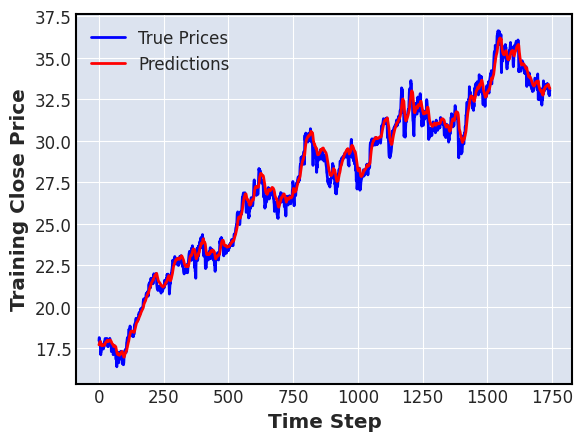

28/28 [==============================] - 0s 8ms/step


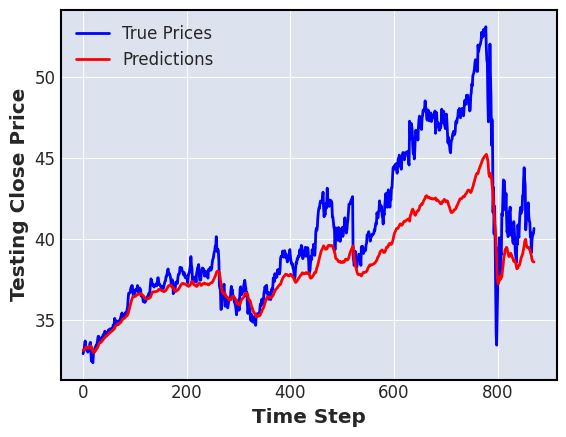

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 7s 40ms/step - loss: 5.9174e-04 - mae: 0.0173 - mse: 5.9174e-04 - mape: 27.2632 - val_loss: 0.0011 - val_mae: 0.0315 - val_mse: 0.0011 - val_mape: 23.8339
Epoch 2/10
82/82 [==============================] - 3s 35ms/step - loss: 1.7044e-05 - mae: 0.0026 - mse: 1.7044e-05 - mape: 4.1416 - val_loss: 6.9330e-05 - val_mae: 0.0068 - val_mse: 6.9330e-05 - val_mape: 4.9303
Epoch 3/10
82/82 [==============================] - 3s 35ms/step - loss: 4.2048e-06 - mae: 0.0013 - mse: 4.2048e-06 - mape: 1.8830 - val_loss: 7.2942e-05 - val_mae: 0.0071 - val_mse: 7.2942e-05 - val_mape: 5.1409
Epoch 4/10
82/82 [==============================] - 3s 34ms/step - loss: 4.2070e-06 - mae: 0.0014 - mse: 4.2070e-06 - mape: 1.9861 - val_loss: 5.8678e-05 - val_mae: 0.0061 - val_mse: 5.8678e-05 - val_mape: 4.4276
Epoch 5/10
82/82 [==============================] - 3s 34ms/step 

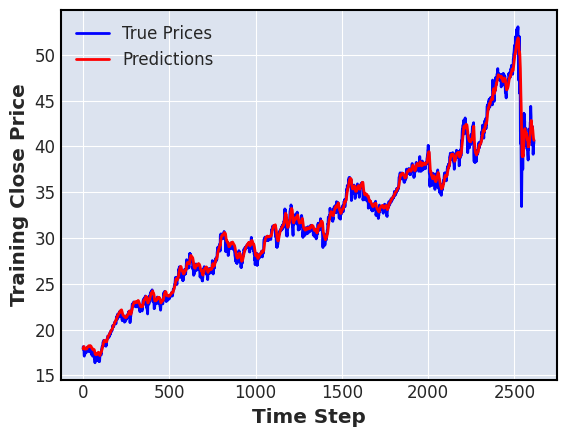

28/28 [==============================] - 0s 7ms/step


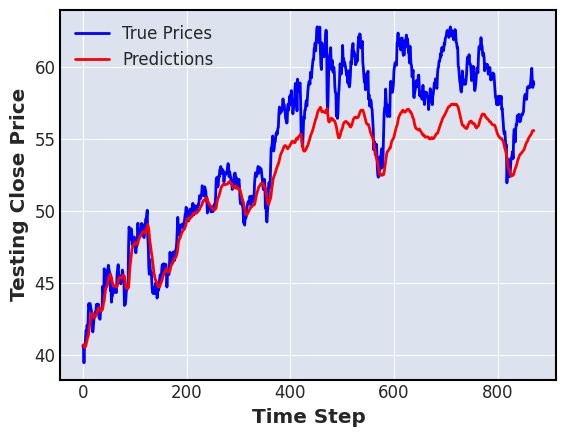

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 7s 40ms/step - loss: 7.2272e-04 - mae: 0.0198 - mse: 7.2272e-04 - mape: 31.4302 - val_loss: 0.0022 - val_mae: 0.0459 - val_mse: 0.0022 - val_mape: 34.7528
Epoch 2/10
82/82 [==============================] - 3s 33ms/step - loss: 7.9748e-05 - mae: 0.0058 - mse: 7.9748e-05 - mape: 9.6634 - val_loss: 9.9991e-05 - val_mae: 0.0085 - val_mse: 9.9991e-05 - val_mape: 6.2129
Epoch 3/10
82/82 [==============================] - 3s 33ms/step - loss: 4.9078e-06 - mae: 0.0014 - mse: 4.9078e-06 - mape: 2.0721 - val_loss: 6.6412e-05 - val_mae: 0.0068 - val_mse: 6.6412e-05 - val_mape: 4.9353
Epoch 4/10
82/82 [==============================] - 3s 36ms/step - loss: 4.8654e-06 - mae: 0.0015 - mse: 4.8654e-06 - mape: 2.1172 - val_loss: 1.0430e-04 - val_mae: 0.0090 - val_mse: 1.0430e-04 - val_mape: 6.5796
Epoch 5/10
82/82 [==============================] - 3s 35ms/step - loss: 4.7746e

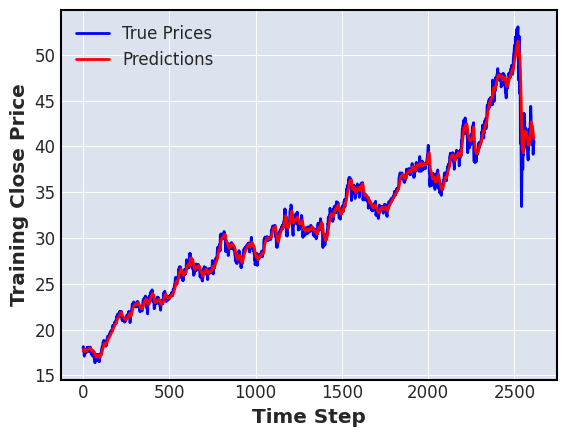

28/28 [==============================] - 0s 7ms/step


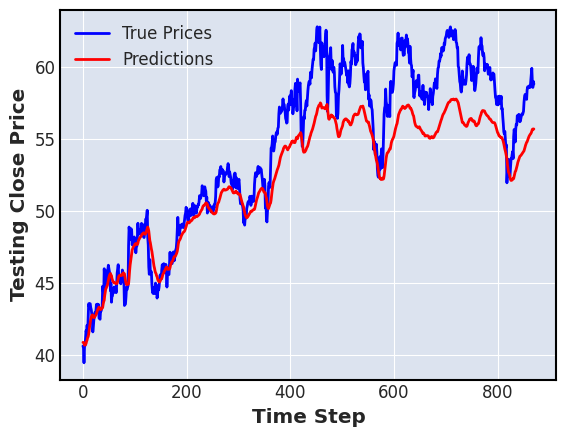

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 7s 38ms/step - loss: 4.4004e-04 - mae: 0.0148 - mse: 4.4004e-04 - mape: 23.7857 - val_loss: 6.3851e-04 - val_mae: 0.0241 - val_mse: 6.3851e-04 - val_mape: 18.1794
Epoch 2/10
82/82 [==============================] - 3s 35ms/step - loss: 1.1334e-05 - mae: 0.0021 - mse: 1.1334e-05 - mape: 3.3338 - val_loss: 5.3811e-05 - val_mae: 0.0059 - val_mse: 5.3811e-05 - val_mape: 4.2888
Epoch 3/10
82/82 [==============================] - 3s 40ms/step - loss: 3.8377e-06 - mae: 0.0013 - mse: 3.8377e-06 - mape: 1.9276 - val_loss: 4.8769e-05 - val_mae: 0.0056 - val_mse: 4.8769e-05 - val_mape: 4.0780
Epoch 4/10
82/82 [==============================] - 3s 42ms/step - loss: 3.4763e-06 - mae: 0.0012 - mse: 3.4763e-06 - mape: 1.7227 - val_loss: 5.2388e-05 - val_mae: 0.0059 - val_mse: 5.2388e-05 - val_mape: 4.3063
Epoch 5/10
82/82 [==============================] - 3s 37ms/step - loss:

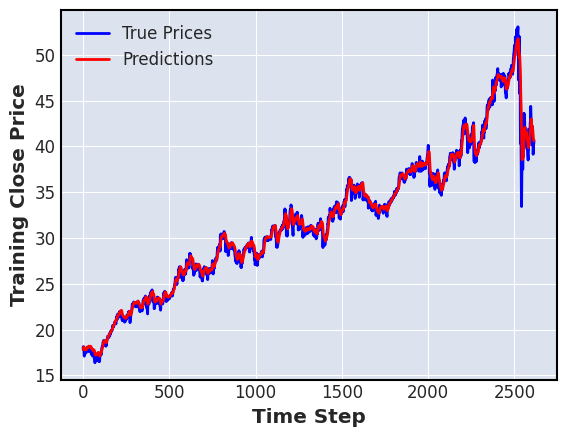

28/28 [==============================] - 0s 7ms/step


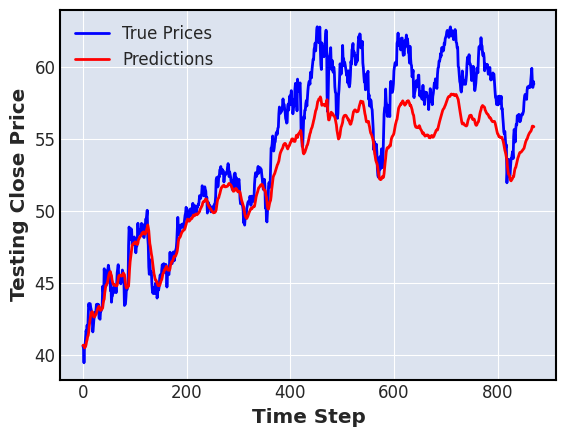

---------------------------------------------------------------
ticker_name :  AAPL Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 5s 57ms/step - loss: 1.1897e-04 - mae: 0.0087 - mse: 1.1897e-04 - mape: 74.8411 - val_loss: 6.2146e-04 - val_mae: 0.0232 - val_mse: 6.2146e-04 - val_mape: 47.3517
Epoch 2/10
28/28 [==============================] - 1s 39ms/step - loss: 5.8843e-05 - mae: 0.0064 - mse: 5.8843e-05 - mape: 59.1919 - val_loss: 3.1563e-04 - val_mae: 0.0164 - val_mse: 3.1563e-04 - val_mape: 33.2933
Epoch 3/10
28/28 [==============================] - 1s 43ms/step - loss: 1.4120e-05 - mae: 0.0028 - mse: 1.4120e-05 - mape: 26.3294 - val_loss: 1.3470e-05 - val_mae: 0.0031 - val_mse: 1.3470e-05 - val_mape: 6.6066
Epoch 4/10
28/28 [==============================] - 1s 41ms/step - loss: 2.8944e-06 - mae: 0.0013 - mse: 2.8944e-06 - mape: 9.1895 - val_loss: 3.8967e-05 - val_mae: 0.0052 - val_mse: 3.8967e-05 - val_mape: 10.1369
Epoch 5/1

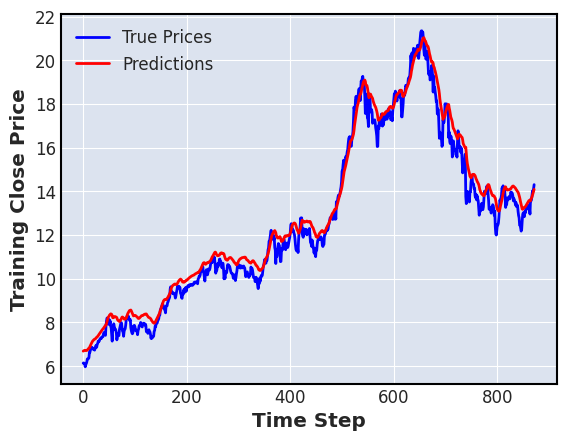

28/28 [==============================] - 0s 7ms/step


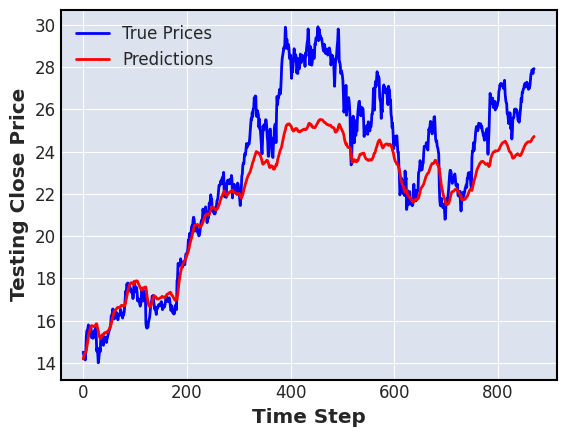

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 8s 58ms/step - loss: 1.2417e-04 - mae: 0.0087 - mse: 1.2417e-04 - mape: 74.9014 - val_loss: 5.2278e-04 - val_mae: 0.0212 - val_mse: 5.2278e-04 - val_mape: 43.3754
Epoch 2/10
28/28 [==============================] - 1s 43ms/step - loss: 3.2262e-05 - mae: 0.0045 - mse: 3.2262e-05 - mape: 42.6659 - val_loss: 1.1713e-04 - val_mae: 0.0092 - val_mse: 1.1713e-04 - val_mape: 17.7438
Epoch 3/10
28/28 [==============================] - 1s 39ms/step - loss: 3.6350e-06 - mae: 0.0015 - mse: 3.6350e-06 - mape: 10.2351 - val_loss: 7.9150e-05 - val_mae: 0.0072 - val_mse: 7.9150e-05 - val_mape: 13.6468
Epoch 4/10
28/28 [==============================] - 1s 39ms/step - loss: 3.1344e-06 - mae: 0.0014 - mse: 3.1344e-06 - mape: 10.3697 - val_loss: 8.5231e-05 - val_mae: 0.0075 - val_mse: 8.5231e-05 - val_mape: 14.3188
Epoch 5/10
28/28 [==============================] - 1s 38ms/step -

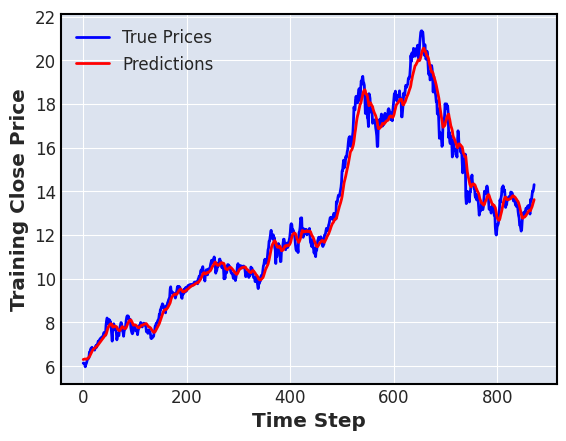

28/28 [==============================] - 0s 7ms/step


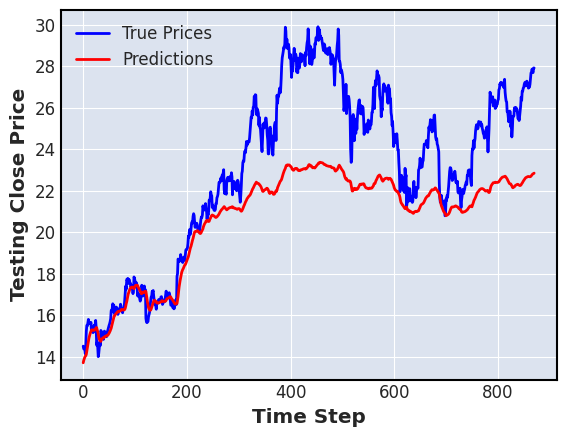

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 5s 57ms/step - loss: 1.0151e-04 - mae: 0.0081 - mse: 1.0151e-04 - mape: 72.7756 - val_loss: 5.8542e-04 - val_mae: 0.0226 - val_mse: 5.8542e-04 - val_mape: 46.3967
Epoch 2/10
28/28 [==============================] - 1s 38ms/step - loss: 4.5643e-05 - mae: 0.0055 - mse: 4.5643e-05 - mape: 50.5388 - val_loss: 1.6668e-04 - val_mae: 0.0116 - val_mse: 1.6668e-04 - val_mape: 23.2213
Epoch 3/10
28/28 [==============================] - 1s 39ms/step - loss: 6.6112e-06 - mae: 0.0020 - mse: 6.6112e-06 - mape: 17.4212 - val_loss: 1.6484e-05 - val_mae: 0.0032 - val_mse: 1.6484e-05 - val_mape: 6.1836
Epoch 4/10
28/28 [==============================] - 1s 41ms/step - loss: 2.3266e-06 - mae: 0.0012 - mse: 2.3266e-06 - mape: 8.5493 - val_loss: 2.4887e-05 - val_mae: 0.0040 - val_mse: 2.4887e-05 - val_mape: 7.6111
Epoch 5/10
28/28 [==============================] - 1s 42ms/step - lo

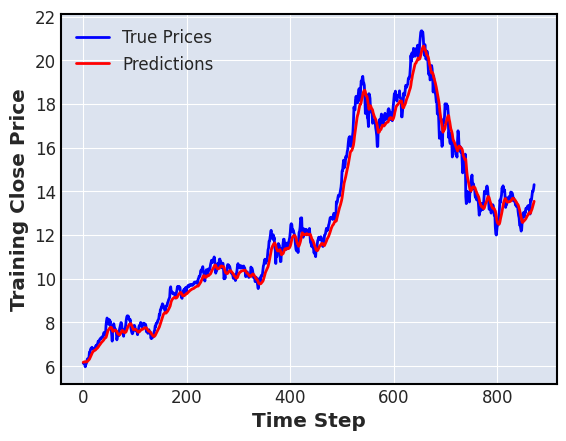

28/28 [==============================] - 0s 8ms/step


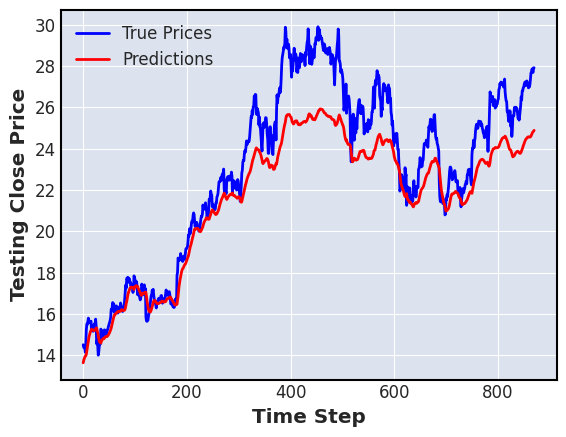

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 6s 43ms/step - loss: 2.3059e-04 - mae: 0.0120 - mse: 2.3059e-04 - mape: 71.1651 - val_loss: 0.0022 - val_mae: 0.0388 - val_mse: 0.0022 - val_mape: 30.9006
Epoch 2/10
55/55 [==============================] - 2s 36ms/step - loss: 4.0924e-06 - mae: 0.0015 - mse: 4.0924e-06 - mape: 7.4508 - val_loss: 0.0014 - val_mae: 0.0289 - val_mse: 0.0014 - val_mape: 21.8700
Epoch 3/10
55/55 [==============================] - 2s 37ms/step - loss: 2.3606e-06 - mae: 0.0012 - mse: 2.3606e-06 - mape: 4.9791 - val_loss: 0.0014 - val_mae: 0.0294 - val_mse: 0.0014 - val_mape: 22.2999
Epoch 4/10
55/55 [==============================] - 2s 38ms/step - loss: 2.2896e-06 - mae: 0.0012 - mse: 2.2896e-06 - mape: 4.8208 - val_loss: 0.0014 - val_mae: 0.0287 - val_mse: 0.0014 - val_mape: 21.6246
Epoch 5/10
55/55 [==============================] - 2s 36ms/step - loss: 2.6078e-06 - 

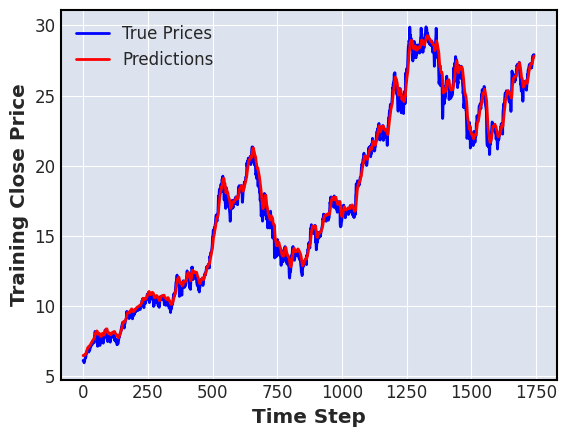

28/28 [==============================] - 0s 7ms/step


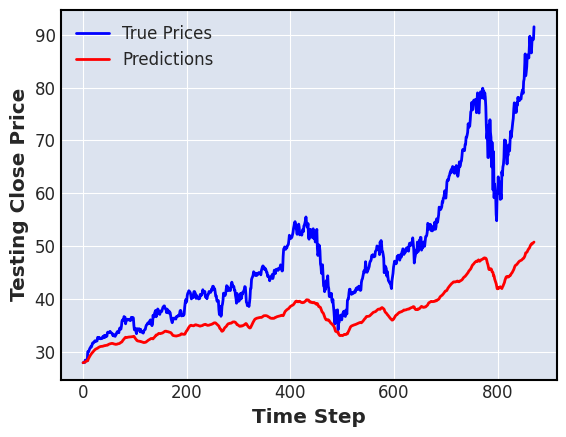

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 7s 51ms/step - loss: 2.2319e-04 - mae: 0.0113 - mse: 2.2319e-04 - mape: 66.6366 - val_loss: 0.0018 - val_mae: 0.0333 - val_mse: 0.0018 - val_mape: 25.5101
Epoch 2/10
55/55 [==============================] - 2s 42ms/step - loss: 4.3658e-06 - mae: 0.0016 - mse: 4.3658e-06 - mape: 7.3563 - val_loss: 0.0016 - val_mae: 0.0307 - val_mse: 0.0016 - val_mape: 23.1743
Epoch 3/10
55/55 [==============================] - 2s 41ms/step - loss: 2.8487e-06 - mae: 0.0013 - mse: 2.8487e-06 - mape: 5.6693 - val_loss: 0.0016 - val_mae: 0.0305 - val_mse: 0.0016 - val_mape: 23.0149
Epoch 4/10
55/55 [==============================] - 2s 41ms/step - loss: 2.5753e-06 - mae: 0.0012 - mse: 2.5753e-06 - mape: 5.2041 - val_loss: 0.0016 - val_mae: 0.0305 - val_mse: 0.0016 - val_mape: 23.0306
Epoch 5/10
55/55 [==============================] - 2s 36ms/step - loss: 2.5364e-06 - mae: 0.0012 - m

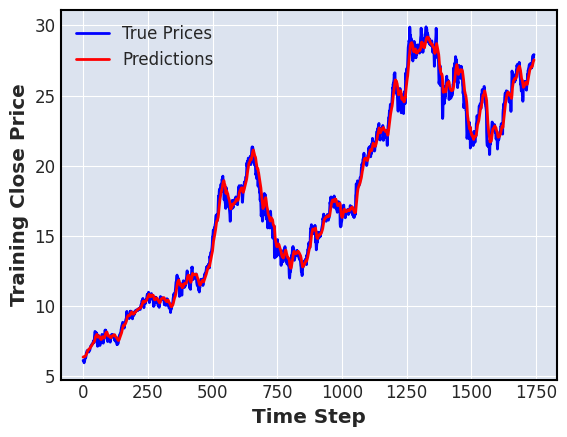

28/28 [==============================] - 0s 7ms/step


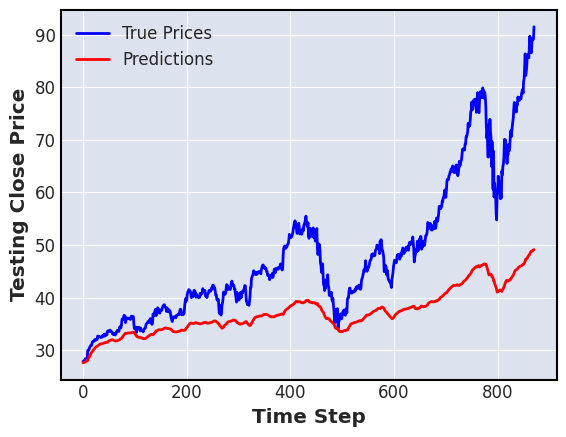

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 6s 43ms/step - loss: 1.7048e-04 - mae: 0.0100 - mse: 1.7048e-04 - mape: 59.0433 - val_loss: 7.6022e-04 - val_mae: 0.0217 - val_mse: 7.6022e-04 - val_mape: 16.7024
Epoch 2/10
55/55 [==============================] - 2s 37ms/step - loss: 3.9399e-06 - mae: 0.0015 - mse: 3.9399e-06 - mape: 7.3536 - val_loss: 6.2038e-04 - val_mae: 0.0195 - val_mse: 6.2038e-04 - val_mape: 14.9286
Epoch 3/10
55/55 [==============================] - 2s 34ms/step - loss: 2.4327e-06 - mae: 0.0012 - mse: 2.4327e-06 - mape: 4.8744 - val_loss: 6.8548e-04 - val_mae: 0.0210 - val_mse: 6.8548e-04 - val_mape: 16.4324
Epoch 4/10
55/55 [==============================] - 2s 38ms/step - loss: 3.8970e-06 - mae: 0.0016 - mse: 3.8970e-06 - mape: 7.2783 - val_loss: 5.6962e-04 - val_mae: 0.0184 - val_mse: 5.6962e-04 - val_mape: 13.9337
Epoch 5/10
55/55 [==============================] - 2s 40ms/step - lo

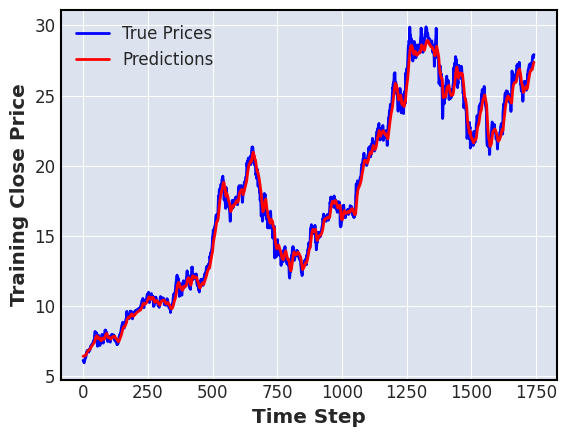

28/28 [==============================] - 0s 8ms/step


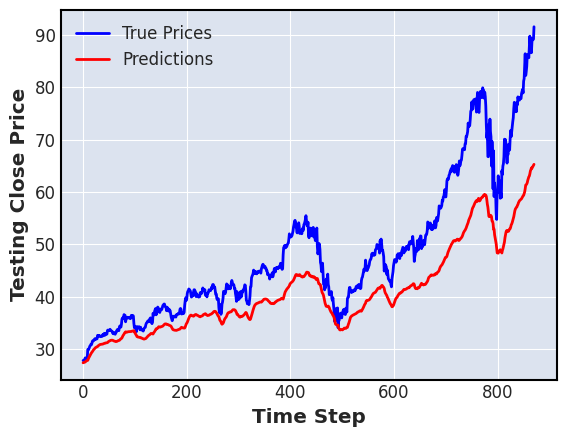

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 8s 46ms/step - loss: 9.0202e-04 - mae: 0.0168 - mse: 9.0202e-04 - mape: 56.6779 - val_loss: 0.0027 - val_mae: 0.0469 - val_mse: 0.0027 - val_mape: 11.8138
Epoch 2/10
82/82 [==============================] - 3s 34ms/step - loss: 1.0751e-05 - mae: 0.0021 - mse: 1.0751e-05 - mape: 5.9632 - val_loss: 0.0025 - val_mae: 0.0445 - val_mse: 0.0025 - val_mape: 11.1238
Epoch 3/10
82/82 [==============================] - 3s 34ms/step - loss: 1.0181e-05 - mae: 0.0021 - mse: 1.0181e-05 - mape: 5.6352 - val_loss: 0.0029 - val_mae: 0.0481 - val_mse: 0.0029 - val_mape: 12.0400
Epoch 4/10
82/82 [==============================] - 3s 33ms/step - loss: 9.8776e-06 - mae: 0.0022 - mse: 9.8776e-06 - mape: 5.9070 - val_loss: 0.0025 - val_mae: 0.0440 - val_mse: 0.0025 - val_mape: 10.9686
Epoch 5/10
82/82 [==============================] - 3s 38ms/step - loss: 8.5224e-06 - 

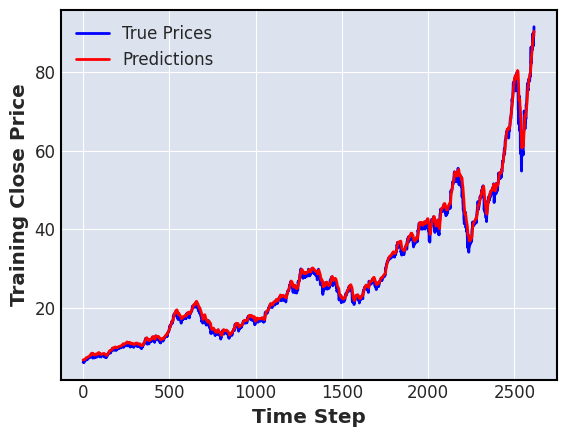

28/28 [==============================] - 0s 7ms/step


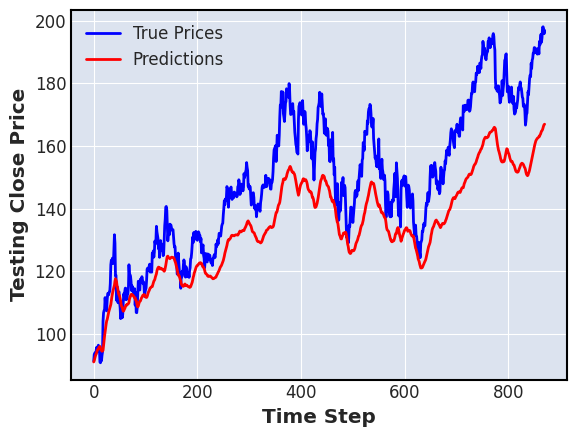

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 7s 37ms/step - loss: 9.1997e-04 - mae: 0.0182 - mse: 9.1997e-04 - mape: 62.4336 - val_loss: 0.0058 - val_mae: 0.0711 - val_mse: 0.0058 - val_mape: 18.1130
Epoch 2/10
82/82 [==============================] - 3s 32ms/step - loss: 1.3023e-05 - mae: 0.0024 - mse: 1.3023e-05 - mape: 7.6976 - val_loss: 0.0042 - val_mae: 0.0596 - val_mse: 0.0042 - val_mape: 15.0661
Epoch 3/10
82/82 [==============================] - 3s 34ms/step - loss: 1.0781e-05 - mae: 0.0021 - mse: 1.0781e-05 - mape: 6.0958 - val_loss: 0.0037 - val_mae: 0.0560 - val_mse: 0.0037 - val_mape: 14.1100
Epoch 4/10
82/82 [==============================] - 3s 37ms/step - loss: 1.1573e-05 - mae: 0.0023 - mse: 1.1573e-05 - mape: 6.3741 - val_loss: 0.0035 - val_mae: 0.0535 - val_mse: 0.0035 - val_mape: 13.4555
Epoch 5/10
82/82 [==============================] - 3s 34ms/step - loss: 1.0106e-05 - mae: 0.0021 - m

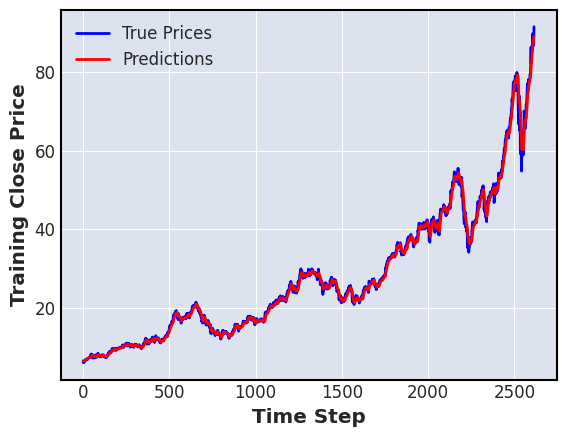

28/28 [==============================] - 0s 12ms/step


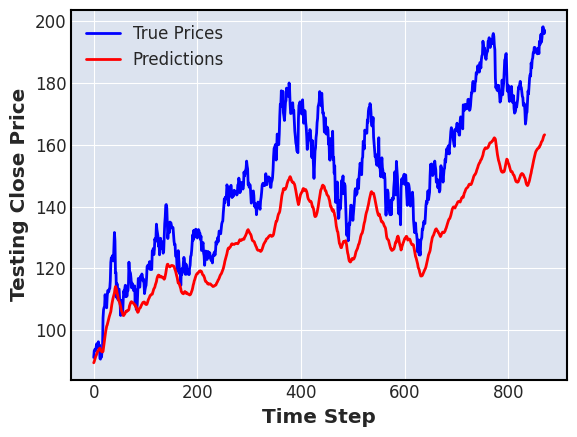

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 9s 40ms/step - loss: 5.6737e-04 - mae: 0.0131 - mse: 5.6737e-04 - mape: 49.6881 - val_loss: 4.2669e-04 - val_mae: 0.0172 - val_mse: 4.2669e-04 - val_mape: 4.3523
Epoch 2/10
82/82 [==============================] - 3s 34ms/step - loss: 1.0548e-05 - mae: 0.0022 - mse: 1.0548e-05 - mape: 6.1926 - val_loss: 6.1920e-04 - val_mae: 0.0212 - val_mse: 6.1920e-04 - val_mape: 5.3463
Epoch 3/10
82/82 [==============================] - 3s 35ms/step - loss: 9.7414e-06 - mae: 0.0020 - mse: 9.7414e-06 - mape: 5.3980 - val_loss: 7.4592e-04 - val_mae: 0.0236 - val_mse: 7.4592e-04 - val_mape: 5.9784
Epoch 4/10
82/82 [==============================] - 3s 34ms/step - loss: 8.9839e-06 - mae: 0.0020 - mse: 8.9839e-06 - mape: 5.1980 - val_loss: 9.9280e-04 - val_mae: 0.0279 - val_mse: 9.9280e-04 - val_mape: 7.0808
Epoch 5/10
82/82 [==============================] - 3s 35ms/step - loss: 

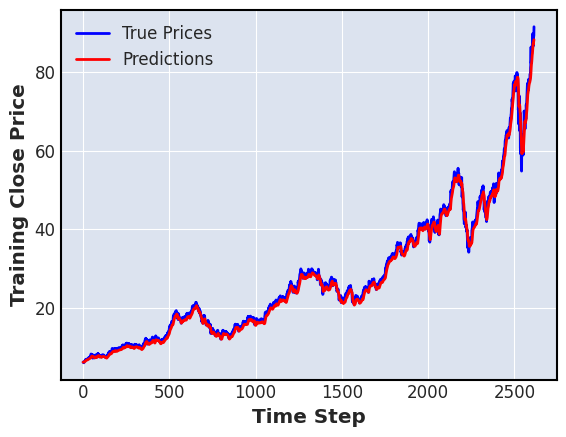

28/28 [==============================] - 0s 8ms/step


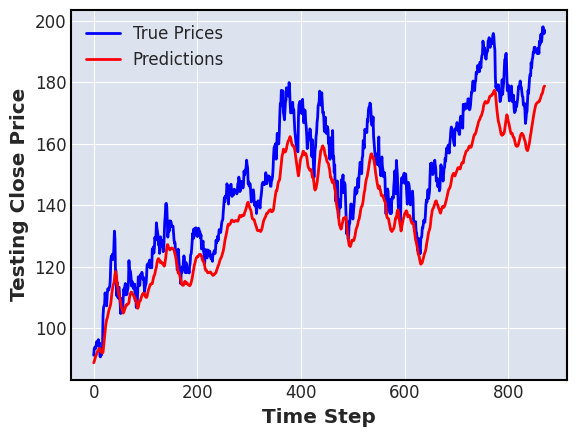

---------------------------------------------------------------
ticker_name :  MSFT Close  , length =  3485
kth split :  0
seed :  0
Epoch 1/10
28/28 [==============================] - 6s 60ms/step - loss: 3.5050e-04 - mae: 0.0141 - mse: 3.5050e-04 - mape: 31.9079 - val_loss: 0.0027 - val_mae: 0.0489 - val_mse: 0.0027 - val_mape: 50.0050
Epoch 2/10
28/28 [==============================] - 1s 40ms/step - loss: 4.0350e-05 - mae: 0.0051 - mse: 4.0350e-05 - mape: 11.2542 - val_loss: 0.0020 - val_mae: 0.0407 - val_mse: 0.0020 - val_mape: 40.9914
Epoch 3/10
28/28 [==============================] - 1s 39ms/step - loss: 3.4038e-05 - mae: 0.0047 - mse: 3.4038e-05 - mape: 10.4379 - val_loss: 0.0018 - val_mae: 0.0389 - val_mse: 0.0018 - val_mape: 39.1186
Epoch 4/10
28/28 [==============================] - 1s 43ms/step - loss: 3.2156e-05 - mae: 0.0046 - mse: 3.2156e-05 - mape: 10.4164 - val_loss: 0.0019 - val_mae: 0.0400 - val_mse: 0.0019 - val_mape: 40.5731
Epoch 5/10
28/28 [=====================

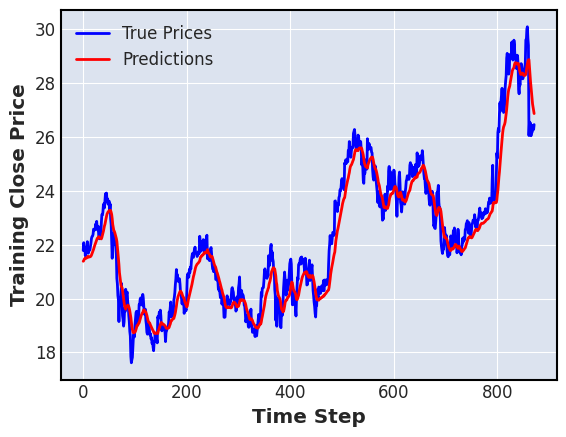

28/28 [==============================] - 0s 8ms/step


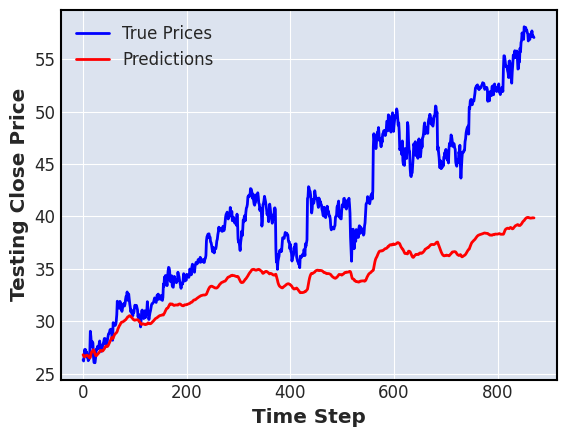

---------------------------------------------------------------
seed :  1
Epoch 1/10
28/28 [==============================] - 5s 61ms/step - loss: 4.1069e-04 - mae: 0.0156 - mse: 4.1069e-04 - mape: 35.3961 - val_loss: 0.0025 - val_mae: 0.0460 - val_mse: 0.0025 - val_mape: 46.5995
Epoch 2/10
28/28 [==============================] - 1s 40ms/step - loss: 4.9070e-05 - mae: 0.0055 - mse: 4.9070e-05 - mape: 12.0518 - val_loss: 0.0023 - val_mae: 0.0442 - val_mse: 0.0023 - val_mape: 44.5995
Epoch 3/10
28/28 [==============================] - 1s 51ms/step - loss: 4.0347e-05 - mae: 0.0051 - mse: 4.0347e-05 - mape: 11.4282 - val_loss: 0.0023 - val_mae: 0.0438 - val_mse: 0.0023 - val_mape: 44.2069
Epoch 4/10
28/28 [==============================] - 1s 43ms/step - loss: 3.9348e-05 - mae: 0.0051 - mse: 3.9348e-05 - mape: 11.4199 - val_loss: 0.0024 - val_mae: 0.0448 - val_mse: 0.0024 - val_mape: 45.3047
Epoch 5/10
28/28 [==============================] - 1s 44ms/step - loss: 3.8843e-05 - mae: 0.0051 

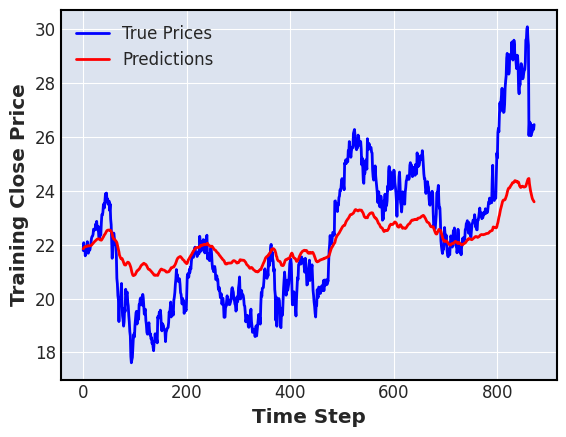

28/28 [==============================] - 0s 8ms/step


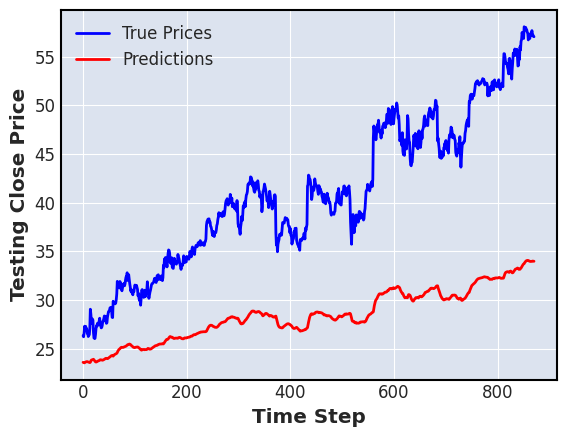

---------------------------------------------------------------
seed :  2
Epoch 1/10
28/28 [==============================] - 5s 60ms/step - loss: 2.7260e-04 - mae: 0.0120 - mse: 2.7260e-04 - mape: 27.0206 - val_loss: 0.0022 - val_mae: 0.0438 - val_mse: 0.0022 - val_mape: 44.5881
Epoch 2/10
28/28 [==============================] - 1s 40ms/step - loss: 3.4462e-05 - mae: 0.0047 - mse: 3.4462e-05 - mape: 10.6510 - val_loss: 0.0019 - val_mae: 0.0402 - val_mse: 0.0019 - val_mape: 40.6335
Epoch 3/10
28/28 [==============================] - 1s 39ms/step - loss: 3.1263e-05 - mae: 0.0045 - mse: 3.1263e-05 - mape: 10.2147 - val_loss: 0.0018 - val_mae: 0.0386 - val_mse: 0.0018 - val_mape: 38.9604
Epoch 4/10
28/28 [==============================] - 1s 41ms/step - loss: 3.0363e-05 - mae: 0.0044 - mse: 3.0363e-05 - mape: 9.8864 - val_loss: 0.0017 - val_mae: 0.0382 - val_mse: 0.0017 - val_mape: 38.6695
Epoch 5/10
28/28 [==============================] - 1s 42ms/step - loss: 2.8208e-05 - mae: 0.0043 -

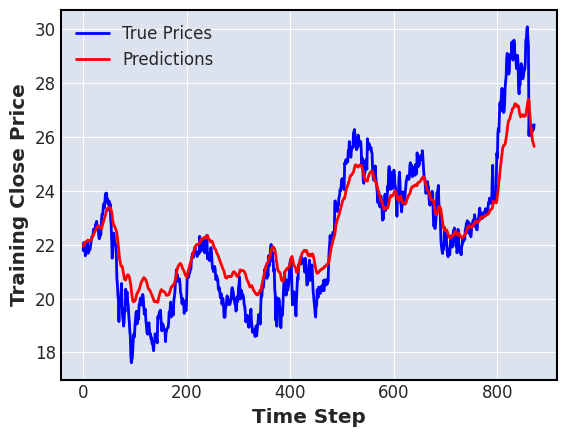

28/28 [==============================] - 0s 7ms/step


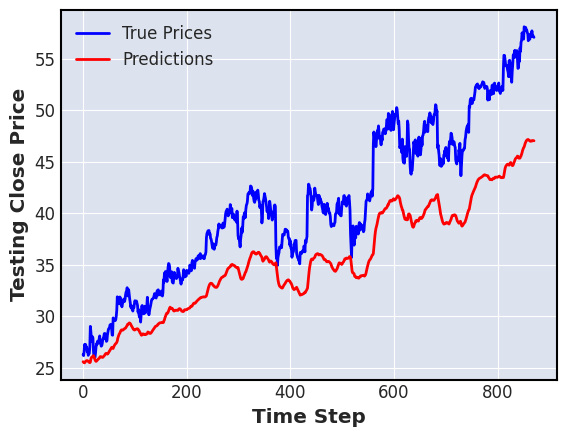

---------------------------------------------------------------
kth split :  1
seed :  0
Epoch 1/10
55/55 [==============================] - 6s 45ms/step - loss: 0.0010 - mae: 0.0256 - mse: 0.0010 - mape: 40.5306 - val_loss: 0.0235 - val_mae: 0.1370 - val_mse: 0.0235 - val_mape: 48.2780
Epoch 2/10
55/55 [==============================] - 2s 35ms/step - loss: 7.9866e-05 - mae: 0.0061 - mse: 7.9866e-05 - mape: 9.9629 - val_loss: 0.0062 - val_mae: 0.0650 - val_mse: 0.0062 - val_mape: 21.2470
Epoch 3/10
55/55 [==============================] - 2s 35ms/step - loss: 6.8592e-06 - mae: 0.0019 - mse: 6.8592e-06 - mape: 2.8961 - val_loss: 0.0052 - val_mae: 0.0580 - val_mse: 0.0052 - val_mape: 18.6872
Epoch 4/10
55/55 [==============================] - 2s 36ms/step - loss: 7.4921e-06 - mae: 0.0020 - mse: 7.4921e-06 - mape: 3.0477 - val_loss: 0.0048 - val_mae: 0.0558 - val_mse: 0.0048 - val_mape: 17.8162
Epoch 5/10
55/55 [==============================] - 2s 36ms/step - loss: 6.9006e-06 - mae: 0.0

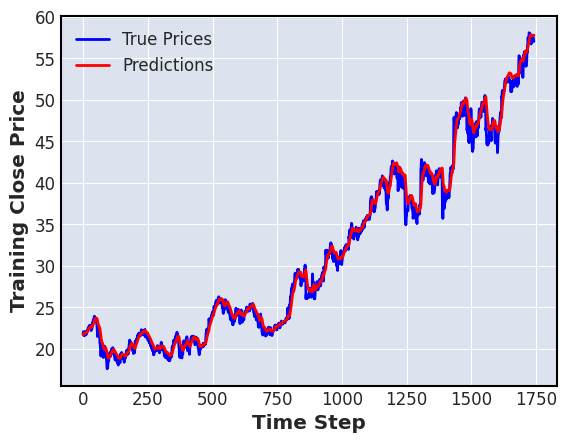

28/28 [==============================] - 0s 8ms/step


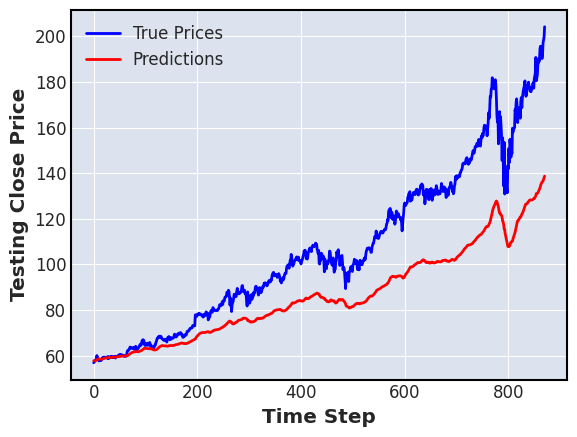

---------------------------------------------------------------
seed :  1
Epoch 1/10
55/55 [==============================] - 6s 50ms/step - loss: 0.0011 - mae: 0.0269 - mse: 0.0011 - mape: 43.1692 - val_loss: 0.0259 - val_mae: 0.1442 - val_mse: 0.0259 - val_mape: 50.8786
Epoch 2/10
55/55 [==============================] - 2s 41ms/step - loss: 1.4049e-04 - mae: 0.0083 - mse: 1.4049e-04 - mape: 13.7595 - val_loss: 0.0031 - val_mae: 0.0467 - val_mse: 0.0031 - val_mape: 15.6189
Epoch 3/10
55/55 [==============================] - 2s 40ms/step - loss: 8.3161e-06 - mae: 0.0021 - mse: 8.3161e-06 - mape: 3.2793 - val_loss: 0.0029 - val_mae: 0.0446 - val_mse: 0.0029 - val_mape: 14.6896
Epoch 4/10
55/55 [==============================] - 2s 42ms/step - loss: 8.2415e-06 - mae: 0.0021 - mse: 8.2415e-06 - mape: 3.2446 - val_loss: 0.0027 - val_mae: 0.0426 - val_mse: 0.0027 - val_mape: 13.8746
Epoch 5/10
55/55 [==============================] - 2s 36ms/step - loss: 7.5805e-06 - mae: 0.0020 - mse: 7.5

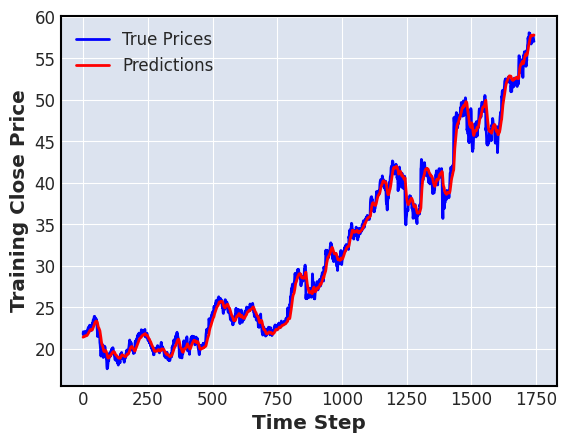

28/28 [==============================] - 0s 7ms/step


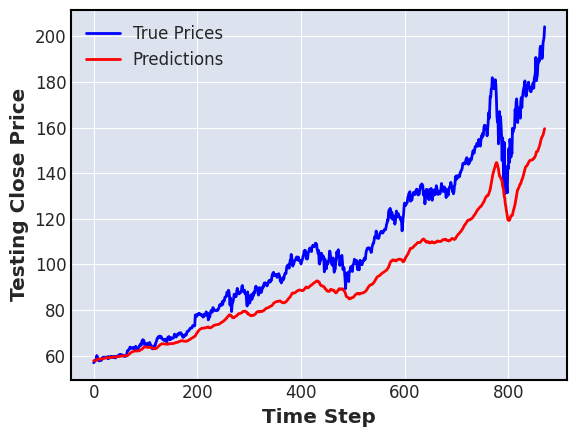

---------------------------------------------------------------
seed :  2
Epoch 1/10
55/55 [==============================] - 6s 43ms/step - loss: 8.2523e-04 - mae: 0.0223 - mse: 8.2523e-04 - mape: 35.9154 - val_loss: 0.0148 - val_mae: 0.1094 - val_mse: 0.0148 - val_mape: 38.7296
Epoch 2/10
55/55 [==============================] - 2s 34ms/step - loss: 6.8251e-05 - mae: 0.0056 - mse: 6.8251e-05 - mape: 9.3062 - val_loss: 0.0013 - val_mae: 0.0299 - val_mse: 0.0013 - val_mape: 9.9746
Epoch 3/10
55/55 [==============================] - 2s 35ms/step - loss: 6.0946e-06 - mae: 0.0018 - mse: 6.0946e-06 - mape: 2.7261 - val_loss: 0.0011 - val_mae: 0.0274 - val_mse: 0.0011 - val_mape: 9.0296
Epoch 4/10
55/55 [==============================] - 2s 34ms/step - loss: 5.7123e-06 - mae: 0.0017 - mse: 5.7123e-06 - mape: 2.6458 - val_loss: 9.2126e-04 - val_mae: 0.0243 - val_mse: 9.2126e-04 - val_mape: 7.8698
Epoch 5/10
55/55 [==============================] - 2s 36ms/step - loss: 6.0119e-06 - mae: 0.001

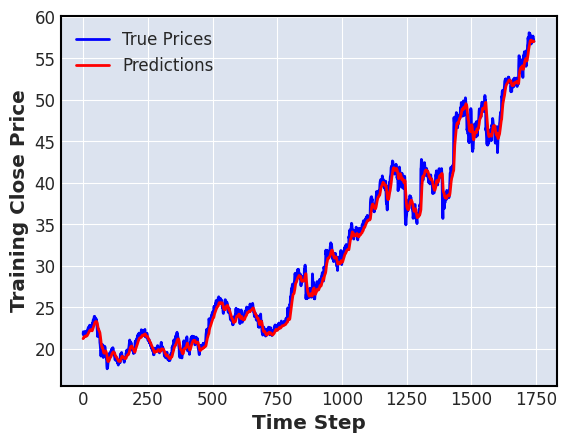

28/28 [==============================] - 0s 8ms/step


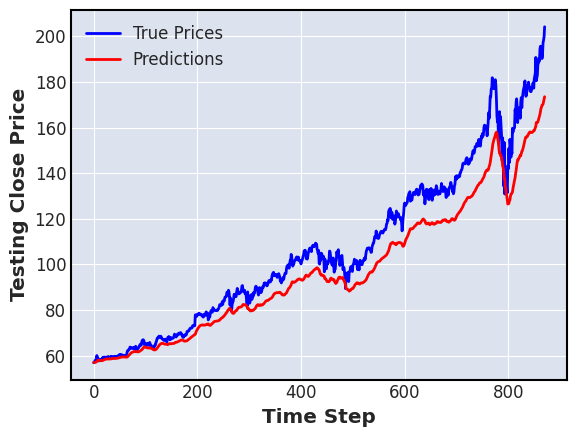

---------------------------------------------------------------
kth split :  2
seed :  0
Epoch 1/10
82/82 [==============================] - 10s 40ms/step - loss: 0.0060 - mae: 0.0432 - mse: 0.0060 - mape: 41.9750 - val_loss: 0.1201 - val_mae: 0.2624 - val_mse: 0.1201 - val_mape: 33.8219
Epoch 2/10
82/82 [==============================] - 3s 33ms/step - loss: 4.8366e-05 - mae: 0.0041 - mse: 4.8366e-05 - mape: 3.6637 - val_loss: 0.0376 - val_mae: 0.1419 - val_mse: 0.0376 - val_mape: 18.1347
Epoch 3/10
82/82 [==============================] - 3s 34ms/step - loss: 4.8408e-05 - mae: 0.0045 - mse: 4.8408e-05 - mape: 4.3322 - val_loss: 0.0183 - val_mae: 0.0954 - val_mse: 0.0183 - val_mape: 12.1246
Epoch 4/10
82/82 [==============================] - 3s 34ms/step - loss: 4.1536e-05 - mae: 0.0039 - mse: 4.1536e-05 - mape: 3.6527 - val_loss: 0.0307 - val_mae: 0.1361 - val_mse: 0.0307 - val_mape: 17.7152
Epoch 5/10
82/82 [==============================] - 3s 35ms/step - loss: 4.0690e-05 - mae: 0.

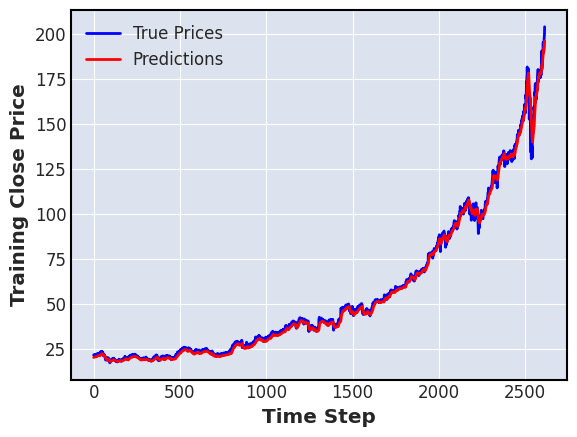

28/28 [==============================] - 0s 7ms/step


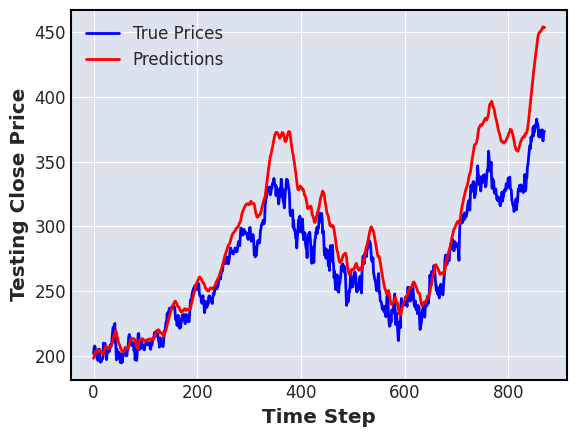

---------------------------------------------------------------
seed :  1
Epoch 1/10
82/82 [==============================] - 7s 39ms/step - loss: 0.0066 - mae: 0.0504 - mse: 0.0066 - mape: 51.0105 - val_loss: 2.3703 - val_mae: 0.8141 - val_mse: 2.3703 - val_mape: 99.6019
Epoch 2/10
82/82 [==============================] - 3s 34ms/step - loss: 6.4103e-05 - mae: 0.0048 - mse: 6.4103e-05 - mape: 4.3796 - val_loss: 0.0488 - val_mae: 0.1592 - val_mse: 0.0488 - val_mape: 20.2338
Epoch 3/10
82/82 [==============================] - 3s 34ms/step - loss: 4.0673e-05 - mae: 0.0035 - mse: 4.0673e-05 - mape: 3.0104 - val_loss: 0.0291 - val_mae: 0.1271 - val_mse: 0.0291 - val_mape: 16.3441
Epoch 4/10
82/82 [==============================] - 3s 33ms/step - loss: 4.5169e-05 - mae: 0.0038 - mse: 4.5169e-05 - mape: 3.2249 - val_loss: 0.0214 - val_mae: 0.1128 - val_mse: 0.0214 - val_mape: 14.6670
Epoch 5/10
82/82 [==============================] - 3s 33ms/step - loss: 4.9894e-05 - mae: 0.0045 - mse: 4.98

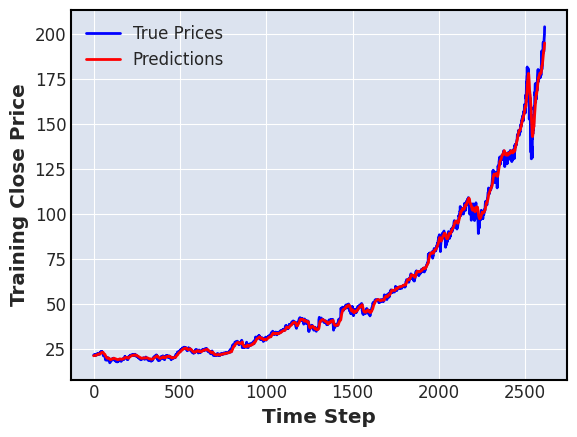

28/28 [==============================] - 0s 7ms/step


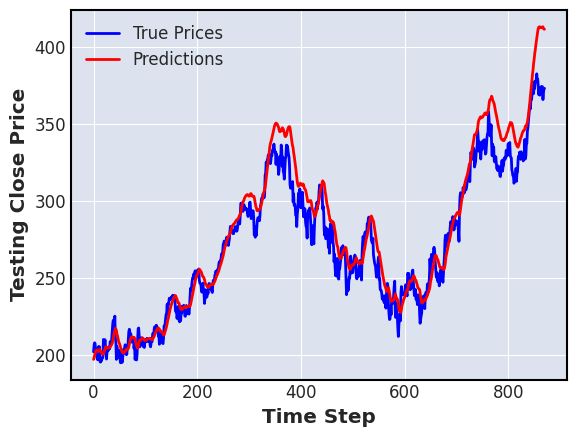

---------------------------------------------------------------
seed :  2
Epoch 1/10
82/82 [==============================] - 7s 40ms/step - loss: 0.0037 - mae: 0.0346 - mse: 0.0037 - mape: 36.6198 - val_loss: 0.0274 - val_mae: 0.1364 - val_mse: 0.0274 - val_mape: 17.9945
Epoch 2/10
82/82 [==============================] - 3s 35ms/step - loss: 4.8338e-05 - mae: 0.0043 - mse: 4.8338e-05 - mape: 4.3581 - val_loss: 0.0132 - val_mae: 0.0969 - val_mse: 0.0132 - val_mape: 12.9514
Epoch 3/10
82/82 [==============================] - 3s 34ms/step - loss: 3.3442e-05 - mae: 0.0033 - mse: 3.3442e-05 - mape: 2.9430 - val_loss: 0.0055 - val_mae: 0.0609 - val_mse: 0.0055 - val_mape: 8.1511
Epoch 4/10
82/82 [==============================] - 3s 33ms/step - loss: 3.2426e-05 - mae: 0.0034 - mse: 3.2426e-05 - mape: 3.1057 - val_loss: 0.0039 - val_mae: 0.0513 - val_mse: 0.0039 - val_mape: 6.9058
Epoch 5/10
82/82 [==============================] - 3s 38ms/step - loss: 3.0787e-05 - mae: 0.0031 - mse: 3.0787

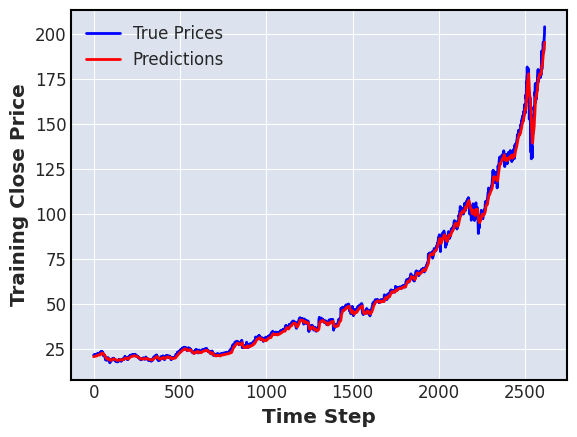

28/28 [==============================] - 0s 7ms/step


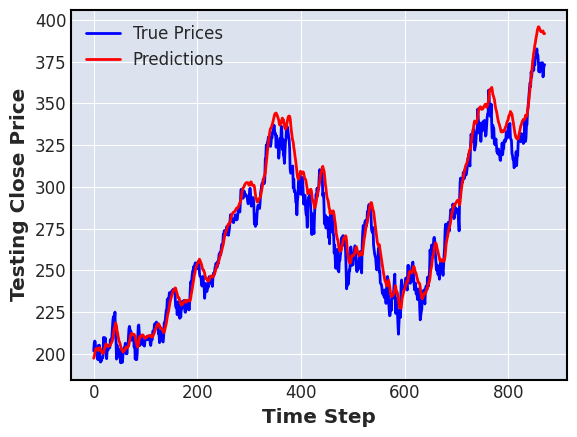

---------------------------------------------------------------


In [41]:
number_of_runs = 0
for ticker_index, ticker_name in enumerate(My_Tickers_SP500):
    full_data = x_tickers_sp500[ticker_index] 
    target = y_tickers_sp500[ticker_index] 
    print('ticker_name : ' ,ticker_name[0], ticker_name[1] , ' , length = ', len(full_data))
    
    # Time Series Split
    for j, (train_index, test_index) in enumerate(tss.split(full_data)):
        print('kth split : ', j)
        # Different Seeds
        for new_seed in range(3):
            print('seed : ', new_seed)
            seed_value = new_seed
            random.seed(seed_value)
            np.random.seed(seed_value)
            tf.random.set_seed(seed_value)
            utils.set_random_seed(seed_value)

            number_of_runs += 1
            full_data = np.reshape(full_data, (full_data.shape[0], full_data.shape[1], 1, 1, 1))
            
            X_train, X_val = full_data[train_index], full_data[test_index]
            y_train, y_val = target[train_index], target[test_index]
            conv_lstm_model = StockPredictionMLPandCNN((full_data.shape[1], 1, 1, 1), model='Conv_LSTM')
            conv_lstm_model.fit(X_train, y_train, X_val, y_val, epoch=10)

            train_pred = conv_lstm_model.predict(X_train)
            train_pred = scaler.inverse_transform(train_pred.reshape(-1, 1))
            y_train = scaler.inverse_transform(y_train.reshape(-1, 1))
            plot_results(train_pred, y_train, 'Training')
            test_pred = conv_lstm_model.predict(X_val)
            test_pred = scaler.inverse_transform(test_pred.reshape(-1, 1))
            y_val = scaler.inverse_transform(y_val.reshape(-1, 1))
            plot_results(test_pred, y_val, 'Testing')
            print('---------------------------------------------------------------')

### Evaluate the Models

In [42]:
models = [lstm_model, bi_lstm_model, gru_model]
models_names =['LSTM', 'Bi_LSTM', 'GRU']

6/6 [==============================] - 0s 8ms/step - loss: 7.6233e-05 - mae: 0.0068 - mse: 7.6233e-05 - mape: 2.0949


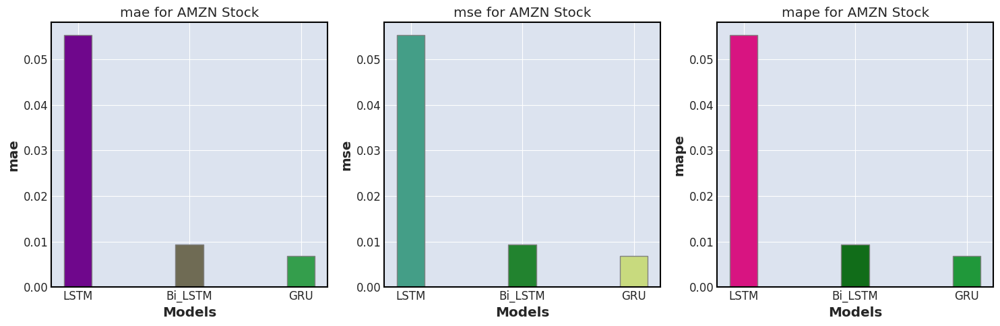


6/6 [==============================] - 0s 7ms/step - loss: 3.0133e-05 - mae: 0.0045 - mse: 3.0133e-05 - mape: 1.2765


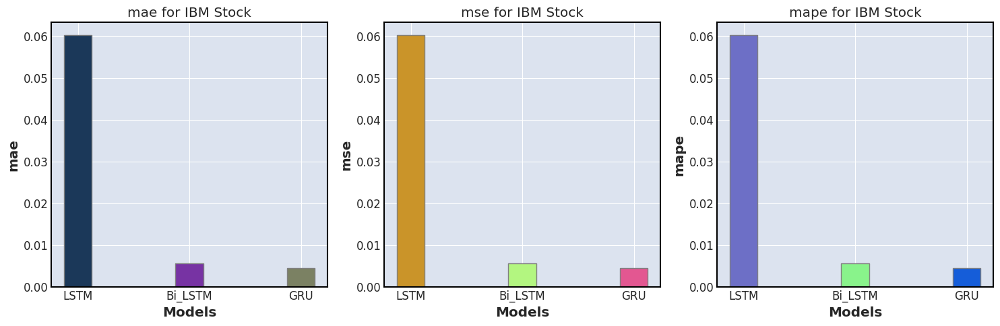


6/6 [==============================] - 0s 8ms/step - loss: 4.5497e-06 - mae: 0.0017 - mse: 4.5497e-06 - mape: 1.2476


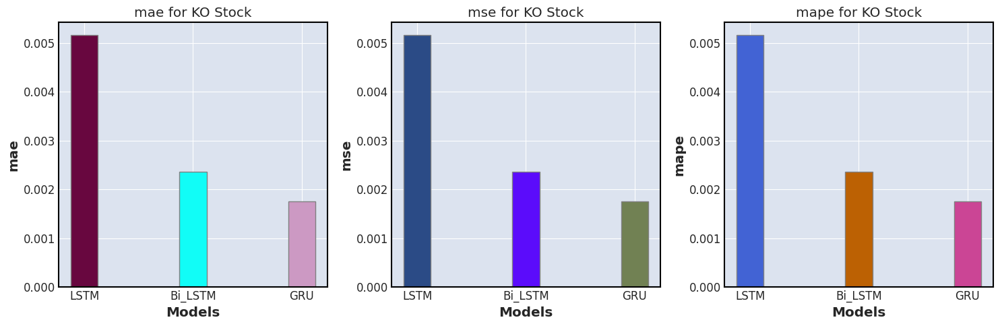


6/6 [==============================] - 0s 8ms/step - loss: 7.2747e-05 - mae: 0.0067 - mse: 7.2747e-05 - mape: 1.4491


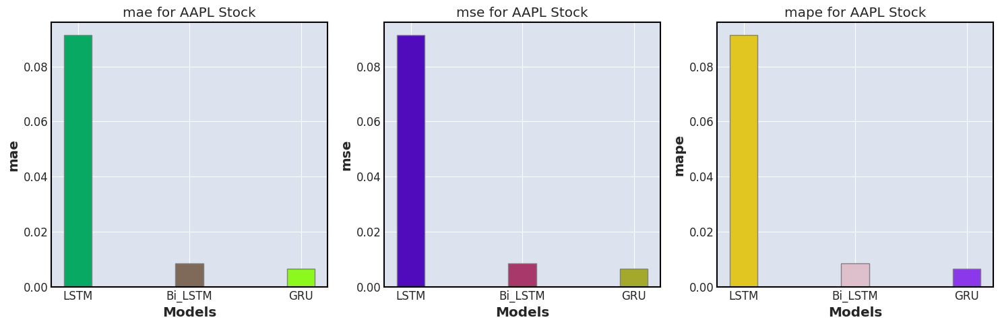


6/6 [==============================] - 0s 7ms/step - loss: 5.3619e-04 - mae: 0.0190 - mse: 5.3619e-04 - mape: 2.1711


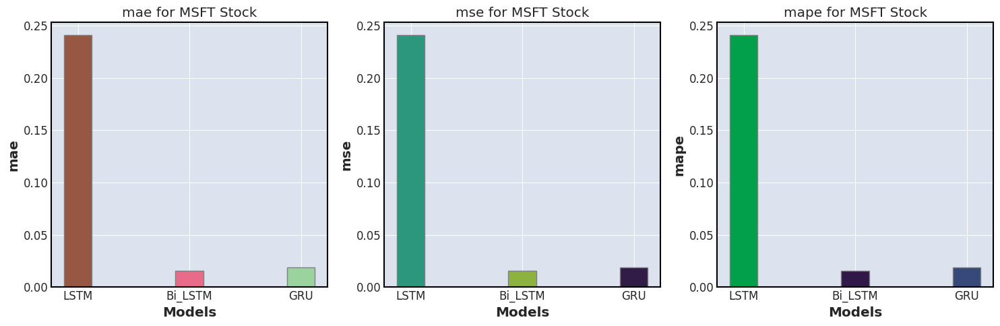

In [43]:
for ticker_index, ticker_name in enumerate(My_Tickers_SP500):
    metrics = {
        'mae': [],
        'mse': [],
        'mape': []
    }
    full_data = x_tickers_sp500[ticker_index] 
    target = y_tickers_sp500[ticker_index]
    for i, model in enumerate(models):
        full_data = np.reshape(full_data, (full_data.shape[0], full_data.shape[1], 1))

        train_len = int(len(full_data)* .95)
        X_val = full_data[train_len:]
        y_val = target[train_len:]
    
        evaluation_results = model.evaluate(X_val, y_val)
        metrics['mae'].append(evaluation_results[1])
        metrics['mse'].append(evaluation_results[2])
        metrics['mape'].append(evaluation_results[3])
            
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    for i, metric in enumerate(metrics):
        r = range(len(models))
        color = np.random.rand(len(models), 3)
        barWidth = 0.25
        axs[i].bar(r, metrics['mae'], color=color, width=barWidth, edgecolor='grey')

        # Adding labels
        axs[i].set_xlabel('Models')
        axs[i].set_xticks([r for r in range(len(models))], models_names)
        axs[i].set_ylabel(metric)
        axs[i].set_title(f'{metric} for ' + ticker_name[0] + ' Stock')

    plt.tight_layout()
    plt.show()
    print()

In [44]:
models = [mlp_model, cnn_model, conv_lstm_model]
models_names =['MLP', 'CNN', 'Conv_LSTM']

6/6 [==============================] - 0s 8ms/step - loss: 1.2111e-04 - mae: 0.0090 - mse: 1.2111e-04 - mape: 2.7264


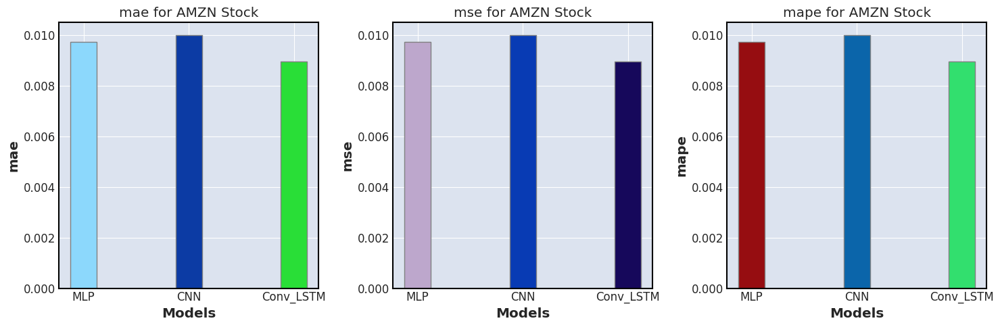


6/6 [==============================] - 0s 9ms/step - loss: 6.2562e-05 - mae: 0.0066 - mse: 6.2562e-05 - mape: 1.8482


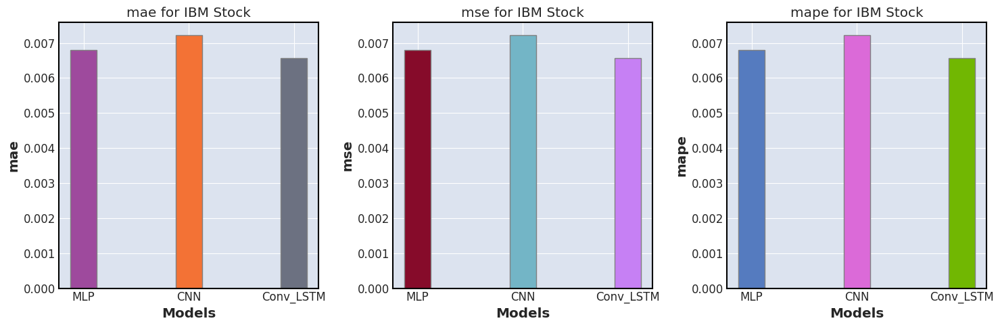


6/6 [==============================] - 0s 8ms/step - loss: 6.5646e-06 - mae: 0.0021 - mse: 6.5646e-06 - mape: 1.4936


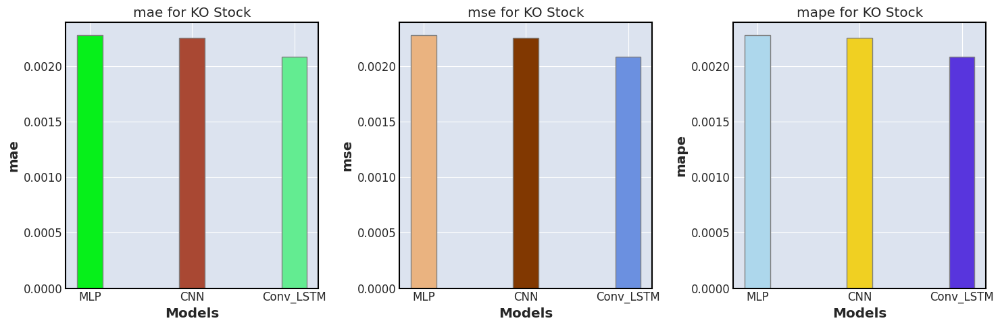


6/6 [==============================] - 0s 9ms/step - loss: 1.1348e-04 - mae: 0.0083 - mse: 1.1348e-04 - mape: 1.8076


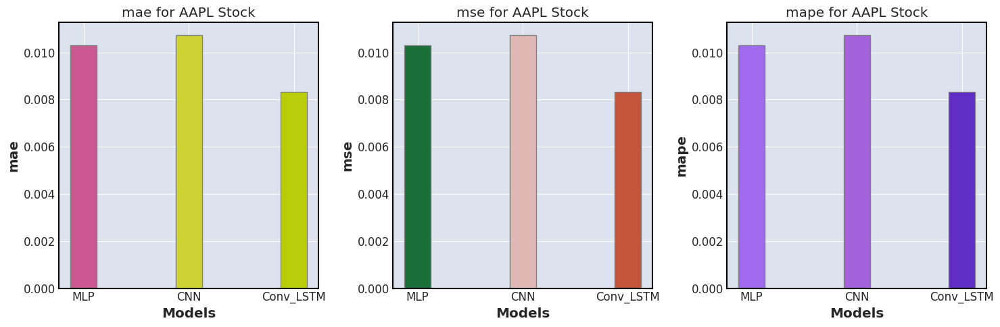


6/6 [==============================] - 0s 9ms/step - loss: 0.0012 - mae: 0.0284 - mse: 0.0012 - mape: 3.2693    


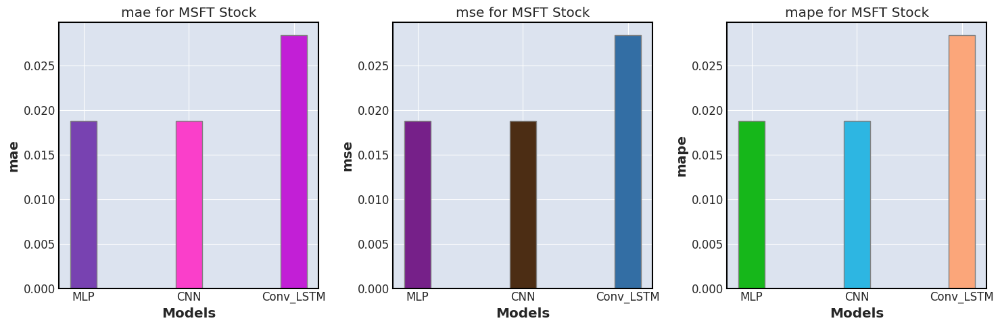

In [45]:
for ticker_index, ticker_name in enumerate(My_Tickers_SP500):
    metrics = {
        'mae': [],
        'mse': [],
        'mape': []
    }
    full_data = x_tickers_sp500[ticker_index] 
    target = y_tickers_sp500[ticker_index]
    for i, model in enumerate(models):
        if i == 0:
            full_data = full_data
        elif i == 2:
            full_data = np.reshape(full_data, (full_data.shape[0], full_data.shape[1], 1, 1, 1))
        else:
            full_data = np.reshape(full_data, (full_data.shape[0], full_data.shape[1], 1))
            
        train_len = int(len(full_data)* .95)
        X_val = full_data[train_len:]
        y_val = target[train_len:]
    
        evaluation_results = model.evaluate(X_val, y_val)
        metrics['mae'].append(evaluation_results[1])
        metrics['mse'].append(evaluation_results[2])
        metrics['mape'].append(evaluation_results[3])
            
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    for i, metric in enumerate(metrics):
        r = range(len(models))
        color = np.random.rand(len(models), 3)
        barWidth = 0.25
        axs[i].bar(r, metrics['mae'], color=color, width=barWidth, edgecolor='grey')

        # Adding labels
        axs[i].set_xlabel('Models')
        axs[i].set_xticks([r for r in range(len(models))], models_names)
        axs[i].set_ylabel(metric)
        axs[i].set_title(f'{metric} for ' + ticker_name[0] + ' Stock')

    plt.tight_layout()
    plt.show()
    print()

## Naïve Forecast

### Random Walk

In [ ]:
def random_walk_forecast(data):
    first_observed_value = data.iloc[0]
    return data.shift(1).fillna(first_observed_value) + np.random.normal(size=len(data))

for ticker_index, ticker_name in enumerate(My_Tickers_SP500):
    predictions = random_walk_forecast(My_Tickers_SP500[ticker_name])

    mae = mean_absolute_error(My_Tickers_SP500[ticker_name], predictions)
    mse = mean_squared_error(My_Tickers_SP500[ticker_name], predictions)
    mape = np.mean(np.abs((My_Tickers_SP500[ticker_name] - predictions) / My_Tickers_SP500[ticker_name])) * 100

    name = ticker_name[0]
    print(f'Mean Absolute Error (MAE) for {name} : {mae:.2f}')
    print(f'Mean Squared Error (MSE)  for {name}: {mse:.2f}')
    print(f'Mean Absolute Percentage Error (MAPE)  for {name}: {mape:.2f}%')


Mean Absolute Error (MAE) for AMZN : 1.38
Mean Squared Error (MSE)  for AMZN: 4.21
Mean Absolute Percentage Error (MAPE)  for AMZN: 4.16%
Mean Absolute Error (MAE) for IBM : 1.31
Mean Squared Error (MSE)  for IBM: 3.17
Mean Absolute Percentage Error (MAPE)  for IBM: 1.23%
Mean Absolute Error (MAE) for KO : 0.88
Mean Squared Error (MSE)  for KO: 1.24
Mean Absolute Percentage Error (MAPE)  for KO: 2.60%
Mean Absolute Error (MAE) for AAPL : 1.22
Mean Squared Error (MSE)  for AAPL: 3.04
Mean Absolute Percentage Error (MAPE)  for AAPL: 3.76%
Mean Absolute Error (MAE) for MSFT : 1.74
Mean Squared Error (MSE)  for MSFT: 7.97
Mean Absolute Percentage Error (MAPE)  for MSFT: 2.23%
